## Evaluate VAE (no RL)

# Training agent using DDPG

Model-free, off-policy RL method.

Two networks here:
 - Actor: Proposes an action
 - Critic: Evaluates action based on new state, reward

In [1]:
import tensorflow as tf
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt

In [2]:
class OUActionNoise:
    def __init__(self, mean, std_deviation, theta=0.15, dt=1e-2, x_initial=None):
        self.theta = theta
        self.mean = mean
        self.std_dev = std_deviation
        self.dt = dt
        self.x_initial = x_initial
        self.reset()

    def __call__(self):
        # Formula taken from https://www.wikipedia.org/wiki/Ornstein-Uhlenbeck_process.
        x = (
            self.x_prev
            + self.theta * (self.mean - self.x_prev) * self.dt
            + self.std_dev * np.sqrt(self.dt) * np.random.normal(size=self.mean.shape)
        )
        # Store x into x_prev
        # Makes next noise dependent on current one
        self.x_prev = x
        return x

    def reset(self):
        if self.x_initial is not None:
            self.x_prev = self.x_initial
        else:
            self.x_prev = np.zeros_like(self.mean)

In [3]:
# Experience Replay

class Buffer:
    def __init__(self, buffer_capacity=100000, batch_size=64):
        # Number of "experiences" to store at max
        self.buffer_capacity = buffer_capacity
        # Num of tuples to train on.
        self.batch_size = batch_size

        # Its tells us num of times record() was called.
        self.buffer_counter = 0

        # Instead of list of tuples as the exp.replay concept go
        # We use different np.arrays for each tuple element
        self.state_buffer = np.zeros((self.buffer_capacity, num_states))
        self.action_buffer = np.zeros((self.buffer_capacity, num_actions))
        self.reward_buffer = np.zeros((self.buffer_capacity, 1))
        self.next_state_buffer = np.zeros((self.buffer_capacity, num_states))

    # Takes (s,a,r,s') obervation tuple as input
    def record(self, obs_tuple):
        # Set index to zero if buffer_capacity is exceeded,
        # replacing old records
        index = self.buffer_counter % self.buffer_capacity

        self.state_buffer[index] = obs_tuple[0]
        self.action_buffer[index] = obs_tuple[1]
        self.reward_buffer[index] = obs_tuple[2]
        self.next_state_buffer[index] = obs_tuple[3]

        self.buffer_counter += 1

    # Eager execution is turned on by default in TensorFlow 2. Decorating with tf.function allows
    # TensorFlow to build a static graph out of the logic and computations in our function.
    # This provides a large speed up for blocks of code that contain many small TensorFlow operations such as this one.
    @tf.function
    def update(
        self, state_batch, action_batch, reward_batch, next_state_batch,
    ):
        # Training and updating Actor & Critic networks.
        # See Pseudo Code.
        with tf.GradientTape() as tape:
            target_actions = target_actor(next_state_batch, training=True)
            y = reward_batch + gamma * target_critic(
                [next_state_batch, target_actions], training=True
            )
            critic_value = critic_model([state_batch, action_batch], training=True)
            critic_loss = tf.math.reduce_mean(tf.math.square(y - critic_value))

        critic_grad = tape.gradient(critic_loss, critic_model.trainable_variables)
        critic_optimizer.apply_gradients(
            zip(critic_grad, critic_model.trainable_variables)
        )

        with tf.GradientTape() as tape:
            actions = actor_model(state_batch, training=True)
            critic_value = critic_model([state_batch, actions], training=True)
            # Used `-value` as we want to maximize the value given
            # by the critic for our actions
            actor_loss = -tf.math.reduce_mean(critic_value)

        actor_grad = tape.gradient(actor_loss, actor_model.trainable_variables)
        actor_optimizer.apply_gradients(
            zip(actor_grad, actor_model.trainable_variables)
        )

    # We compute the loss and update parameters
    def learn(self):
        # Get sampling range
        record_range = min(self.buffer_counter, self.buffer_capacity)
        # Randomly sample indices
        batch_indices = np.random.choice(record_range, self.batch_size)

        # Convert to tensors
        state_batch = tf.convert_to_tensor(self.state_buffer[batch_indices])
        action_batch = tf.convert_to_tensor(self.action_buffer[batch_indices])
        reward_batch = tf.convert_to_tensor(self.reward_buffer[batch_indices])
        reward_batch = tf.cast(reward_batch, dtype=tf.float32)
        next_state_batch = tf.convert_to_tensor(self.next_state_buffer[batch_indices])

        self.update(state_batch, action_batch, reward_batch, next_state_batch)


# This update target parameters slowly
# Based on rate `tau`, which is much less than one.
@tf.function
def update_target(target_weights, weights, tau):
    for (a, b) in zip(target_weights, weights):
        a.assign(b * tau + a * (1 - tau))

In [4]:
# Here we define the Actor and Critic networks. 

def get_actor():
    # Initialize weights between -3e-3 and 3-e3
    last_init = tf.random_uniform_initializer(minval=-0.003, maxval=0.003)

    inputs = layers.Input(shape=(num_states,))
    out = layers.Dense(256, activation="relu")(inputs)
    out = layers.Dense(256, activation="relu")(out)
    outputs = layers.Dense(1, activation="sigmoid", kernel_initializer=last_init)(out)

    # Our upper bound is 10.0 for x.
    outputs = outputs * upper_bound
    model = tf.keras.Model(inputs, outputs)
    return model


def get_critic():
    # State as input
    state_input = layers.Input(shape=(num_states))
    state_out = layers.Dense(16, activation="relu")(state_input)
    state_out = layers.Dense(32, activation="relu")(state_out)

    # Action as input
    action_input = layers.Input(shape=(num_actions))
    action_out = layers.Dense(32, activation="relu")(action_input)

    # Both are passed through seperate layer before concatenating
    concat = layers.Concatenate()([state_out, action_out])

    out = layers.Dense(256, activation="relu")(concat)
    out = layers.Dense(256, activation="relu")(out)
    outputs = layers.Dense(1)(out)

    # Outputs single value for give state-action
    model = tf.keras.Model([state_input, action_input], outputs)

    return model

In [5]:
# Returns an action sampled from our Actor network plus some noise for exploration.
def policy(state, noise_object):
    sampled_actions = tf.squeeze(actor_model(state))
    noise = noise_object()
    # Adding noise to action
    sampled_actions = sampled_actions.numpy() + noise

    # We make sure action is within bounds
    legal_action = np.clip(sampled_actions, lower_bound, upper_bound)

    return np.asarray([np.squeeze(legal_action)])

## Training hyperparameters

In [6]:
from config import Config
from data_prep import DataPrep
from env import CMAPSSEnv
from VAE_dense import VAE

In [7]:
import pickle

const = Config()
neurons = const.VAE_neurons

# Data prep
data = DataPrep(file = const.file_path,
                num_settings = const.num_settings,
                num_sensors = const.num_sensors,
                num_units = const.num_units[1],
                prev_step_units = const.prev_step_units[1],
                step = const.step[1],
                normalization_type="01")

df = data.ReadData()

In [8]:
df.head()

,Unit,NormTime,OpSetting1,OpSetting2,OpSetting3,Sensor1,Sensor2,Sensor3,Sensor4,Sensor5,...,Sensor12,Sensor13,Sensor14,Sensor15,Sensor16,Sensor17,Sensor18,Sensor19,Sensor20,Sensor21
0,201,0.994764,0.595106,0.738717,0.0,0.238089,0.005994,0.012804,0.000695,0.293184,...,0.089541,0.001241,0.055955,0.932427,0.0,0.010638,0.000000,0.0,0.145072,0.143796
1,201,0.989529,0.999902,0.997625,1.0,0.000000,0.118580,0.280447,0.219349,0.000000,...,0.003173,0.993546,0.578168,0.364798,0.0,0.287234,0.627907,1.0,0.015851,0.015329
2,201,0.984293,0.999814,0.999050,1.0,0.000000,0.122361,0.277253,0.222625,0.000000,...,0.002640,0.993518,0.582280,0.366169,0.0,0.276596,0.627907,1.0,0.016196,0.010621
3,201,0.979058,0.476162,0.831829,1.0,0.626985,0.655141,0.630586,0.542614,0.507937,...,0.472095,0.993629,0.522036,0.305635,0.0,0.648936,0.864693,1.0,0.495865,0.490478
4,201,0.973822,0.833194,0.997862,1.0,0.060269,0.176579,0.301457,0.222451,0.146592,...,0.135631,0.993684,0.542546,0.336198,0.0,0.297872,0.651163,1.0,0.158167,0.171099


In [9]:
# List of engine lifetimes
engine_lives = df.groupby(df['Unit']).size().tolist()
num_engines = len(engine_lives)

# Load decoder
vae = VAE(latent_dim=1,image_size=25)

with open('/Users/erotokritosskordilis/git-repos/RL_Reliability/model_decoder.pkl', 'rb') as f:
    decoder = pickle.load(f)

##########################################
env_config = {
    "df": df,
    "timestep": 0,
    "obs_size": const.num_settings+const.num_sensors+1,
    "engines": num_engines,
    "engine_lives": engine_lives, 
    "decoder_model": decoder,
}

env = CMAPSSEnv(**env_config)

num_states = env.observation_space.shape[0]
print("Size of State Space ->  {}".format(num_states))
num_actions = env.action_space.shape[0]
print("Size of Action Space ->  {}".format(num_actions))

upper_bound = env.action_space.high[0]
lower_bound = env.action_space.low[0]

print(upper_bound, lower_bound)

Size of State Space ->  25
Size of Action Space ->  1
1.0 0.0


2022-05-13 13:47:45.478751: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [10]:
std_dev = 0.2
ou_noise = OUActionNoise(mean=np.zeros(1), std_deviation=float(std_dev) * np.ones(1))

actor_model = get_actor()
critic_model = get_critic()

target_actor = get_actor()
target_critic = get_critic()

# Making the weights equal initially
target_actor.set_weights(actor_model.get_weights())
target_critic.set_weights(critic_model.get_weights())

# Learning rate for actor-critic models
critic_lr = 0.02
actor_lr = 0.01

critic_optimizer = tf.keras.optimizers.Adam(critic_lr)
actor_optimizer = tf.keras.optimizers.Adam(actor_lr)

total_episodes = 10000
# Discount factor for future rewards
gamma = 0.9
# Used to update target networks
tau = 0.05

buffer = Buffer(50000, 64)

In [ ]:
# To store reward history of each episode
ep_reward_list = []
# To store average reward history of last few episodes
avg_reward_list = []

for ep in range(total_episodes):

    episodic_reward = 0        
    prev_state = env.reset()
    
    done = False

    while not done:

        tf_prev_state = tf.reshape(prev_state, [1, -1])#tf.expand_dims(tf.convert_to_tensor(prev_state), 0)

        action = policy(tf_prev_state, ou_noise)
        # Receive state and reward from environment.
        state, reward, done, _ = env.step(action)

        buffer.record((prev_state, action, reward, state))
        episodic_reward += reward

        buffer.learn()
        update_target(target_actor.variables, actor_model.variables, tau)
        update_target(target_critic.variables, critic_model.variables, tau)

        # End this episode when `done` is True
        if done:
            break

        prev_state = state

    ep_reward_list.append(episodic_reward)

    # Mean of last 40 episodes
    avg_reward = np.mean(ep_reward_list[-40:])
    #print("Episode * {} * Avg Reward is ==> {}".format(ep, avg_reward))
    avg_reward_list.append(avg_reward)

0.5017053 0.8109452736318408
0.49799797 0.8059701492537313
0.4962629 0.8009950248756219
0.49598843 0.7960199004975125
0.49236992 0.7910447761194029
0.29183984 0.7860696517412935
0.29183984 0.7810945273631841
0.29183984 0.7761194029850746
0.29183984 0.7711442786069652
0.29183984 0.7661691542288557
0.29183984 0.7611940298507462
0.48878953 0.7562189054726368
0.49956387 0.7512437810945274
0.466421 0.746268656716418
0.4781138 0.7412935323383084
0.4942714 0.736318407960199
0.46254805 0.7313432835820896
0.48951522 0.7263681592039801
0.47988674 0.7213930348258707
0.46801358 0.7164179104477612
0.48044536 0.7114427860696517
0.48357058 0.7064676616915423
0.477705 0.7014925373134329
0.50279903 0.6965174129353234
0.48621917 0.6915422885572139
0.49964878 0.6865671641791045
0.29183984 0.681592039800995
0.47864017 0.6766169154228856
0.47695506 0.6716417910447762
0.29183984 0.6666666666666666
0.48447275 0.6616915422885572
0.46398902 0.6567164179104478
0.466892 0.6517412935323383
0.48964706 0.6467661691

0.29183984 0.9076923076923077
0.29183984 0.9025641025641026
0.29183984 0.8974358974358975
0.29183984 0.8923076923076924
0.29183984 0.8871794871794871
0.29183984 0.882051282051282
0.29183984 0.8769230769230769
0.29183984 0.8717948717948718
0.29183984 0.8666666666666667
0.29183984 0.8615384615384616
0.29183984 0.8564102564102564
0.29183984 0.8512820512820513
0.29183984 0.8461538461538461
0.29183984 0.841025641025641
0.29183984 0.8358974358974359
0.29183984 0.8307692307692308
0.29183984 0.8256410256410256
0.29183984 0.8205128205128205
0.29183984 0.8153846153846154
0.29183984 0.8102564102564103
0.29183984 0.8051282051282052
0.29183984 0.8
0.29183984 0.7948717948717948
0.29183984 0.7897435897435897
0.29183984 0.7846153846153846
0.29183984 0.7794871794871795
0.29183984 0.7743589743589744
0.29183984 0.7692307692307693
0.29183984 0.764102564102564
0.29183984 0.7589743589743589
0.29183984 0.7538461538461538
0.29183984 0.7487179487179487
0.29183984 0.7435897435897436
0.29183984 0.738461538461538

0.29183984 0.7586206896551724
0.29183984 0.7528735632183908
0.29183984 0.7471264367816092
0.29183984 0.7413793103448276
0.29183984 0.735632183908046
0.29183984 0.7298850574712644
0.29183984 0.7241379310344828
0.29183984 0.7183908045977011
0.29183984 0.7126436781609196
0.29183984 0.7068965517241379
0.29183984 0.7011494252873564
0.29183984 0.6954022988505747
0.29183984 0.6896551724137931
0.29183984 0.6839080459770115
0.29183984 0.6781609195402298
0.29183984 0.6724137931034483
0.29183984 0.6666666666666666
0.29183984 0.6609195402298851
0.29183984 0.6551724137931034
0.29183984 0.6494252873563219
0.29183984 0.6436781609195402
0.29183984 0.6379310344827587
0.29183984 0.632183908045977
0.29183984 0.6264367816091954
0.29183984 0.6206896551724138
0.29183984 0.6149425287356322
0.29183984 0.6091954022988506
0.29183984 0.603448275862069
0.29183984 0.5977011494252874
0.29183984 0.5919540229885057
0.29183984 0.5862068965517241
0.29183984 0.5804597701149425
0.29183984 0.5747126436781609
0.29183984 0.

0.29183984 0.14213197969543148
0.29183984 0.13705583756345177
0.29183984 0.1319796954314721
0.29183984 0.12690355329949238
0.29183984 0.1218274111675127
0.29183984 0.116751269035533
0.29183984 0.1116751269035533
0.29183984 0.1065989847715736
0.29183984 0.10152284263959391
0.29183984 0.09644670050761421
0.29183984 0.09137055837563451
0.29183984 0.08629441624365482
0.29183984 0.08121827411167512
0.29183984 0.07614213197969544
0.29183984 0.07106598984771574
0.29183984 0.06598984771573604
0.29183984 0.06091370558375635
0.29183984 0.05583756345177665
0.29183984 0.050761421319796954
0.29183984 0.04568527918781726
0.29183984 0.04060913705583756
0.29183984 0.03553299492385787
0.29183984 0.030456852791878174
0.29183984 0.025380710659898477
0.29183984 0.02030456852791878
0.29183984 0.015228426395939087
0.29183984 0.01015228426395939
0.29183984 0.005076142131979695
0.29183984 0.3622448979591837
0.29183984 0.35714285714285715
0.29183984 0.3520408163265306
0.29183984 0.3469387755102041
0.29183984 0

0.29183984 0.08163265306122448
0.29183984 0.07653061224489796
0.29183984 0.07142857142857142
0.29183984 0.0663265306122449
0.29183984 0.061224489795918366
0.29183984 0.05612244897959184
0.29183984 0.05102040816326531
0.29183984 0.04591836734693878
0.29183984 0.04081632653061224
0.29183984 0.03571428571428571
0.29183984 0.030612244897959183
0.29183984 0.025510204081632654
0.29183984 0.02040816326530612
0.29183984 0.015306122448979591
0.29183984 0.01020408163265306
0.29183984 0.00510204081632653
0.29183984 0.8551401869158879
0.29183984 0.8504672897196262
0.29183984 0.8457943925233645
0.29183984 0.8411214953271028
0.29183984 0.8364485981308412
0.29183984 0.8317757009345794
0.29183984 0.8271028037383178
0.29183984 0.822429906542056
0.29183984 0.8177570093457944
0.29183984 0.8130841121495327
0.29183984 0.8084112149532711
0.29183984 0.8037383177570093
0.29183984 0.7990654205607477
0.29183984 0.794392523364486
0.29183984 0.7897196261682243
0.29183984 0.7850467289719626
0.29183984 0.7803738317

0.29183984 0.0440251572327044
0.29183984 0.03773584905660377
0.29183984 0.031446540880503145
0.29183984 0.025157232704402517
0.29183984 0.018867924528301886
0.29183984 0.012578616352201259
0.29183984 0.006289308176100629
0.29183984 0.24786324786324787
0.29183984 0.24358974358974358
0.29183984 0.23931623931623933
0.29183984 0.23504273504273504
0.29183984 0.23076923076923078
0.29183984 0.2264957264957265
0.29183984 0.2222222222222222
0.29183984 0.21794871794871795
0.29183984 0.21367521367521367
0.29183984 0.2094017094017094
0.29183984 0.20512820512820512
0.29183984 0.20085470085470086
0.29183984 0.19658119658119658
0.29183984 0.19230769230769232
0.29183984 0.18803418803418803
0.29183984 0.18376068376068377
0.29183984 0.1794871794871795
0.29183984 0.1752136752136752
0.29183984 0.17094017094017094
0.29183984 0.16666666666666666
0.29183984 0.1623931623931624
0.29183984 0.1581196581196581
0.29183984 0.15384615384615385
0.29183984 0.14957264957264957
0.29183984 0.1452991452991453
0.29183984 0

0.29183984 0.5267175572519084
0.29183984 0.5229007633587787
0.29183984 0.5190839694656488
0.29183984 0.5152671755725191
0.29183984 0.5114503816793893
0.29183984 0.5076335877862596
0.29183984 0.5038167938931297
0.29183984 0.5
0.29183984 0.4961832061068702
0.29183984 0.49236641221374045
0.29183984 0.48854961832061067
0.29183984 0.4847328244274809
0.29183984 0.48091603053435117
0.29183984 0.4770992366412214
0.29183984 0.4732824427480916
0.29183984 0.46946564885496184
0.29183984 0.46564885496183206
0.29183984 0.4618320610687023
0.29183984 0.4580152671755725
0.29183984 0.4541984732824427
0.29183984 0.45038167938931295
0.29183984 0.44656488549618323
0.29183984 0.44274809160305345
0.29183984 0.4389312977099237
0.29183984 0.4351145038167939
0.29183984 0.4312977099236641
0.29183984 0.42748091603053434
0.29183984 0.42366412213740456
0.29183984 0.4198473282442748
0.29183984 0.41603053435114506
0.29183984 0.4122137404580153
0.29183984 0.4083969465648855
0.29183984 0.40458015267175573
0.29183984 0.

0.29183984 0.043668122270742356
0.29183984 0.039301310043668124
0.29183984 0.034934497816593885
0.29183984 0.03056768558951965
0.29183984 0.026200873362445413
0.29183984 0.021834061135371178
0.29183984 0.017467248908296942
0.29183984 0.013100436681222707
0.29183984 0.008733624454148471
0.29183984 0.004366812227074236
0.29183984 0.24875621890547264
0.29183984 0.24378109452736318
0.29183984 0.23880597014925373
0.29183984 0.23383084577114427
0.29183984 0.22885572139303484
0.29183984 0.22388059701492538
0.29183984 0.21890547263681592
0.29183984 0.21393034825870647
0.29183984 0.208955223880597
0.29183984 0.20398009950248755
0.29183984 0.19900497512437812
0.29183984 0.19402985074626866
0.29183984 0.1890547263681592
0.29183984 0.18407960199004975
0.29183984 0.1791044776119403
0.29183984 0.17412935323383086
0.29183984 0.1691542288557214
0.29183984 0.16417910447761194
0.29183984 0.15920398009950248
0.29183984 0.15422885572139303
0.29183984 0.14925373134328357
0.29183984 0.14427860696517414
0.29

0.29183984 0.36324786324786323
0.29183984 0.358974358974359
0.29183984 0.3547008547008547
0.29183984 0.3504273504273504
0.29183984 0.34615384615384615
0.29183984 0.3418803418803419
0.29183984 0.33760683760683763
0.29183984 0.3333333333333333
0.29183984 0.32905982905982906
0.29183984 0.3247863247863248
0.29183984 0.32051282051282054
0.29183984 0.3162393162393162
0.29183984 0.31196581196581197
0.29183984 0.3076923076923077
0.29183984 0.3034188034188034
0.29183984 0.29914529914529914
0.29183984 0.2948717948717949
0.29183984 0.2905982905982906
0.29183984 0.2863247863247863
0.29183984 0.28205128205128205
0.29183984 0.2777777777777778
0.29183984 0.27350427350427353
0.29183984 0.2692307692307692
0.29183984 0.26495726495726496
0.29183984 0.2606837606837607
0.29183984 0.2564102564102564
0.29183984 0.25213675213675213
0.29183984 0.24786324786324787
0.29183984 0.24358974358974358
0.29183984 0.23931623931623933
0.29183984 0.23504273504273504
0.29183984 0.23076923076923078
0.29183984 0.226495726495

0.27005482 0.7592592592592593
0.25762534 0.7530864197530864
0.5043345 0.7469135802469136
0.47329366 0.7407407407407407
0.47133142 0.7345679012345679
0.29183984 0.7283950617283951
0.29183984 0.7222222222222222
0.29183984 0.7160493827160493
0.29183984 0.7098765432098766
0.29183984 0.7037037037037037
0.29183984 0.6975308641975309
0.29183984 0.691358024691358
0.29183984 0.6851851851851852
0.29183984 0.6790123456790124
0.29183984 0.6728395061728395
0.29183984 0.6666666666666666
0.29183984 0.6604938271604939
0.29183984 0.654320987654321
0.29183984 0.6481481481481481
0.29183984 0.6419753086419753
0.29183984 0.6358024691358025
0.29183984 0.6296296296296297
0.29183984 0.6234567901234568
0.29183984 0.6172839506172839
0.29183984 0.6111111111111112
0.29183984 0.6049382716049383
0.29183984 0.5987654320987654
0.29183984 0.5925925925925926
0.29183984 0.5864197530864198
0.29183984 0.5802469135802469
0.29183984 0.5740740740740741
0.29183984 0.5679012345679012
0.29183984 0.5617283950617284
0.29183984 0.

0.29183984 0.3940520446096654
0.29183984 0.3903345724907063
0.29183984 0.38661710037174724
0.29183984 0.3828996282527881
0.29183984 0.379182156133829
0.29183984 0.3754646840148699
0.29183984 0.37174721189591076
0.29183984 0.3680297397769517
0.29183984 0.3643122676579926
0.29183984 0.36059479553903345
0.29183984 0.35687732342007433
0.29183984 0.35315985130111527
0.29183984 0.34944237918215615
0.29183984 0.34572490706319703
0.29183984 0.3420074349442379
0.29183984 0.3382899628252788
0.29183984 0.3345724907063197
0.29183984 0.3308550185873606
0.29183984 0.3271375464684015
0.29183984 0.32342007434944237
0.29183984 0.31970260223048325
0.29183984 0.3159851301115242
0.29183984 0.31226765799256506
0.29183984 0.30855018587360594
0.29183984 0.3048327137546468
0.29183984 0.30111524163568776
0.29183984 0.29739776951672864
0.29183984 0.2936802973977695
0.29183984 0.2899628252788104
0.29183984 0.2862453531598513
0.29183984 0.2825278810408922
0.29183984 0.2788104089219331
0.29183984 0.275092936802974

0.29183984 0.5958904109589042
0.29183984 0.589041095890411
0.29183984 0.5821917808219178
0.29183984 0.5753424657534246
0.29183984 0.5684931506849316
0.29183984 0.5616438356164384
0.29183984 0.5547945205479452
0.29183984 0.547945205479452
0.29183984 0.541095890410959
0.29183984 0.5342465753424658
0.29183984 0.5273972602739726
0.29183984 0.5205479452054794
0.29183984 0.5136986301369864
0.29183984 0.5068493150684932
0.29183984 0.5
0.29183984 0.4931506849315068
0.29183984 0.4863013698630137
0.29183984 0.4794520547945205
0.29183984 0.4726027397260274
0.29183984 0.4657534246575342
0.29183984 0.4589041095890411
0.29183984 0.4520547945205479
0.29183984 0.4452054794520548
0.29183984 0.4383561643835616
0.29183984 0.4315068493150685
0.29183984 0.4246575342465753
0.29183984 0.4178082191780822
0.29183984 0.410958904109589
0.29183984 0.4041095890410959
0.29183984 0.3972602739726027
0.29183984 0.3904109589041096
0.29183984 0.3835616438356164
0.29183984 0.3767123287671233
0.29183984 0.3698630136986301

0.29183984 0.12345679012345678
0.29183984 0.11728395061728394
0.29183984 0.1111111111111111
0.29183984 0.10493827160493827
0.29183984 0.09876543209876543
0.29183984 0.09259259259259259
0.29183984 0.08641975308641975
0.29183984 0.08024691358024691
0.29183984 0.07407407407407407
0.29183984 0.06790123456790123
0.29183984 0.06172839506172839
0.29183984 0.05555555555555555
0.29183984 0.04938271604938271
0.29183984 0.043209876543209874
0.29183984 0.037037037037037035
0.29183984 0.030864197530864196
0.29183984 0.024691358024691357
0.29183984 0.018518518518518517
0.29183984 0.012345679012345678
0.29183984 0.006172839506172839
0.29183984 0.5247148288973384
0.29183984 0.5209125475285171
0.29183984 0.5171102661596958
0.29183984 0.5133079847908745
0.29183984 0.5095057034220533
0.29183984 0.5057034220532319
0.29183984 0.5019011406844106
0.29183984 0.49809885931558934
0.29183984 0.49429657794676807
0.29183984 0.49049429657794674
0.29183984 0.4866920152091255
0.29183984 0.4828897338403042
0.29183984 

0.29183984 0.375
0.29183984 0.3695652173913043
0.29183984 0.3641304347826087
0.29183984 0.358695652173913
0.29183984 0.3532608695652174
0.29183984 0.34782608695652173
0.29183984 0.3423913043478261
0.29183984 0.33695652173913043
0.29183984 0.33152173913043476
0.29183984 0.32608695652173914
0.29183984 0.32065217391304346
0.29183984 0.31521739130434784
0.29183984 0.30978260869565216
0.29183984 0.30434782608695654
0.29183984 0.29891304347826086
0.29183984 0.29347826086956524
0.29183984 0.28804347826086957
0.29183984 0.2826086956521739
0.29183984 0.27717391304347827
0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.195652

0.29183984 0.19444444444444445
0.29183984 0.1875
0.492674 0.18055555555555555
0.48479056 0.1736111111111111
0.4938445 0.16666666666666666
0.49410355 0.1597222222222222
0.48796448 0.1527777777777778
0.23776007 0.14583333333333334
0.35118973 0.1388888888888889
0.3214689 0.13194444444444445
0.3439048 0.125
0.40823358 0.11805555555555555
0.26631355 0.1111111111111111
0.2702059 0.10416666666666667
0.26599345 0.09722222222222222
0.27660736 0.09027777777777778
0.26610053 0.08333333333333333
0.26917028 0.0763888888888889
0.49145615 0.06944444444444445
0.36806354 0.0625
0.4534371 0.05555555555555555
0.33690277 0.04861111111111111
0.26142532 0.041666666666666664
0.4164535 0.034722222222222224
0.4297797 0.027777777777777776
0.56701446 0.020833333333333332
0.59005076 0.013888888888888888
0.33182502 0.006944444444444444
0.30178362 0.6149425287356322
0.26151097 0.6091954022988506
0.23777527 0.603448275862069
0.3879835 0.5977011494252874
0.2923352 0.5919540229885057
0.38287917 0.5862068965517241
0.27

0.29183984 0.35406698564593303
0.29183984 0.3492822966507177
0.29183984 0.3444976076555024
0.29183984 0.3397129186602871
0.29183984 0.3349282296650718
0.29183984 0.33014354066985646
0.29183984 0.3253588516746411
0.29183984 0.32057416267942584
0.29183984 0.3157894736842105
0.29183984 0.31100478468899523
0.29183984 0.3062200956937799
0.29183984 0.3014354066985646
0.29183984 0.2966507177033493
0.29183984 0.291866028708134
0.29183984 0.28708133971291866
0.29183984 0.2822966507177033
0.29183984 0.27751196172248804
0.29183984 0.2727272727272727
0.29183984 0.2679425837320574
0.29183984 0.2631578947368421
0.29183984 0.2583732057416268
0.29183984 0.2535885167464115
0.29183984 0.24880382775119617
0.29183984 0.24401913875598086
0.29183984 0.23923444976076555
0.29183984 0.23444976076555024
0.29183984 0.22966507177033493
0.29183984 0.22488038277511962
0.29183984 0.22009569377990432
0.29183984 0.215311004784689
0.29183984 0.21052631578947367
0.29183984 0.20574162679425836
0.29183984 0.20095693779904

0.29183984 0.17647058823529413
0.29183984 0.17194570135746606
0.29183984 0.167420814479638
0.29183984 0.16289592760180996
0.29183984 0.1583710407239819
0.29183984 0.15384615384615385
0.29183984 0.1493212669683258
0.29183984 0.14479638009049775
0.29183984 0.14027149321266968
0.29183984 0.13574660633484162
0.29183984 0.13122171945701358
0.29183984 0.12669683257918551
0.29183984 0.12217194570135746
0.29183984 0.11764705882352941
0.4703532 0.11312217194570136
0.29183984 0.1085972850678733
0.29183984 0.10407239819004525
0.4864999 0.09954751131221719
0.4998173 0.09502262443438914
0.50076306 0.09049773755656108
0.49998304 0.08597285067873303
0.4931955 0.08144796380090498
0.45234913 0.07692307692307693
0.29183984 0.07239819004524888
0.29183984 0.06787330316742081
0.29183984 0.06334841628959276
0.29183984 0.058823529411764705
0.29183984 0.05429864253393665
0.29183984 0.049773755656108594
0.29183984 0.04524886877828054
0.29183984 0.04072398190045249
0.46625307 0.03619909502262444
0.48973626 0.03

0.5665827 0.31645569620253167
0.55772287 0.31223628691983124
0.2595569 0.3080168776371308
0.43289778 0.3037974683544304
0.38196778 0.29957805907172996
0.40868238 0.29535864978902954
0.4896107 0.2911392405063291
0.38963407 0.2869198312236287
0.39529628 0.28270042194092826
0.5016235 0.27848101265822783
0.49559295 0.2742616033755274
0.49265358 0.270042194092827
0.50375485 0.26582278481012656
0.5005315 0.2616033755274262
0.48645988 0.25738396624472576
0.48906645 0.25316455696202533
0.48927218 0.2489451476793249
0.4964396 0.24472573839662448
0.48905617 0.24050632911392406
0.49834403 0.23628691983122363
0.4977612 0.2320675105485232
0.2976249 0.22784810126582278
0.47186226 0.22362869198312235
0.49294183 0.21940928270042195
0.5037728 0.21518987341772153
0.5044135 0.2109704641350211
0.48451477 0.20675105485232068
0.41865304 0.20253164556962025
0.5024446 0.19831223628691982
0.49881035 0.1940928270042194
0.4980251 0.189873417721519
0.4897905 0.18565400843881857
0.24146596 0.18143459915611815
0.44

0.4910078 0.10780669144981413
0.4875299 0.10408921933085502
0.4964996 0.10037174721189591
0.50083685 0.09665427509293681
0.49945766 0.09293680297397769
0.4816395 0.08921933085501858
0.48413718 0.08550185873605948
0.48652124 0.08178438661710037
0.49824122 0.07806691449814127
0.50188303 0.07434944237918216
0.4960012 0.07063197026022305
0.48254883 0.06691449814126393
0.29183984 0.06319702602230483
0.29183984 0.05947955390334572
0.29183984 0.055762081784386616
0.29183984 0.05204460966542751
0.29183984 0.048327137546468404
0.29183984 0.04460966542750929
0.29183984 0.040892193308550186
0.42964262 0.03717472118959108
0.29183984 0.03345724907063197
0.29183984 0.02973977695167286
0.46582943 0.026022304832713755
0.4891225 0.022304832713754646
0.29183984 0.01858736059479554
0.29183984 0.01486988847583643
0.29183984 0.011152416356877323
0.29183984 0.007434944237918215
0.29183984 0.0037174721189591076
0.29183984 0.8764044943820225
0.29183984 0.8707865168539326
0.29183984 0.8651685393258427
0.291839

0.29183984 0.2981651376146789
0.29183984 0.29357798165137616
0.29183984 0.2889908256880734
0.29183984 0.28440366972477066
0.29183984 0.2798165137614679
0.29183984 0.27522935779816515
0.29183984 0.2706422018348624
0.29183984 0.26605504587155965
0.29183984 0.26146788990825687
0.29183984 0.25688073394495414
0.29183984 0.25229357798165136
0.29183984 0.24770642201834864
0.29183984 0.24311926605504589
0.29183984 0.23853211009174313
0.29183984 0.23394495412844038
0.29183984 0.22935779816513763
0.29183984 0.22477064220183487
0.29183984 0.22018348623853212
0.29183984 0.21559633027522937
0.29183984 0.21100917431192662
0.29183984 0.20642201834862386
0.29183984 0.2018348623853211
0.29183984 0.19724770642201836
0.29183984 0.1926605504587156
0.29183984 0.18807339449541285
0.29183984 0.1834862385321101
0.29183984 0.17889908256880735
0.29183984 0.1743119266055046
0.29183984 0.16972477064220184
0.29183984 0.1651376146788991
0.29183984 0.16055045871559634
0.29183984 0.1559633027522936
0.29183984 0.15137

0.29183984 0.13389121338912133
0.29183984 0.1297071129707113
0.29183984 0.12552301255230125
0.29183984 0.12133891213389121
0.29183984 0.11715481171548117
0.29183984 0.11297071129707113
0.29183984 0.1087866108786611
0.29183984 0.10460251046025104
0.29183984 0.100418410041841
0.29183984 0.09623430962343096
0.29183984 0.09205020920502092
0.29183984 0.08786610878661087
0.29183984 0.08368200836820083
0.29183984 0.0794979079497908
0.29183984 0.07531380753138076
0.29183984 0.07112970711297072
0.29183984 0.06694560669456066
0.29183984 0.06276150627615062
0.29183984 0.058577405857740586
0.29183984 0.05439330543933055
0.29183984 0.0502092050209205
0.29183984 0.04602510460251046
0.29183984 0.04184100418410042
0.29183984 0.03765690376569038
0.29183984 0.03347280334728033
0.29183984 0.029288702928870293
0.29183984 0.02510460251046025
0.29183984 0.02092050209205021
0.29183984 0.016736401673640166
0.29183984 0.012552301255230125
0.29183984 0.008368200836820083
0.29183984 0.0041841004184100415
0.29183

0.29183984 0.1520912547528517
0.29183984 0.1482889733840304
0.29183984 0.1444866920152091
0.29183984 0.14068441064638784
0.29183984 0.13688212927756654
0.29183984 0.13307984790874525
0.29183984 0.12927756653992395
0.29183984 0.12547528517110265
0.29183984 0.12167300380228137
0.29183984 0.11787072243346007
0.29183984 0.11406844106463879
0.29183984 0.11026615969581749
0.29183984 0.10646387832699619
0.29183984 0.10266159695817491
0.29183984 0.09885931558935361
0.29183984 0.09505703422053231
0.29183984 0.09125475285171103
0.29183984 0.08745247148288973
0.29183984 0.08365019011406843
0.29183984 0.07984790874524715
0.29183984 0.07604562737642585
0.29183984 0.07224334600760456
0.29183984 0.06844106463878327
0.29183984 0.06463878326996197
0.29183984 0.060836501901140684
0.29183984 0.057034220532319393
0.29183984 0.053231939163498096
0.29183984 0.049429657794676805
0.29183984 0.045627376425855515
0.29183984 0.04182509505703422
0.29183984 0.03802281368821293
0.29183984 0.034220532319391636
0.291

0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.0380434782

0.29183984 0.08178438661710037
0.29183984 0.07806691449814127
0.29183984 0.07434944237918216
0.29183984 0.07063197026022305
0.29183984 0.06691449814126393
0.29183984 0.06319702602230483
0.29183984 0.05947955390334572
0.29183984 0.055762081784386616
0.29183984 0.05204460966542751
0.29183984 0.048327137546468404
0.29183984 0.04460966542750929
0.29183984 0.040892193308550186
0.29183984 0.03717472118959108
0.29183984 0.03345724907063197
0.29183984 0.02973977695167286
0.29183984 0.026022304832713755
0.29183984 0.022304832713754646
0.29183984 0.01858736059479554
0.29183984 0.01486988847583643
0.29183984 0.011152416356877323
0.29183984 0.007434944237918215
0.29183984 0.0037174721189591076
0.29183984 0.8165137614678899
0.29183984 0.8119266055045872
0.29183984 0.8073394495412844
0.29183984 0.8027522935779816
0.29183984 0.7981651376146789
0.29183984 0.7935779816513762
0.29183984 0.7889908256880734
0.29183984 0.7844036697247706
0.29183984 0.7798165137614679
0.29183984 0.7752293577981652
0.2918398

0.29183984 0.0945273631840796
0.29183984 0.08955223880597014
0.29183984 0.0845771144278607
0.29183984 0.07960199004975124
0.29183984 0.07462686567164178
0.29183984 0.06965174129353234
0.29183984 0.06467661691542288
0.29183984 0.05970149253731343
0.29183984 0.05472636815920398
0.29183984 0.04975124378109453
0.29183984 0.04477611940298507
0.29183984 0.03980099502487562
0.29183984 0.03482587064676617
0.29183984 0.029850746268656716
0.29183984 0.024875621890547265
0.29183984 0.01990049751243781
0.29183984 0.014925373134328358
0.29183984 0.009950248756218905
0.29183984 0.004975124378109453
0.29183984 0.678082191780822
0.29183984 0.6712328767123288
0.29183984 0.6643835616438356
0.29183984 0.6575342465753424
0.29183984 0.6506849315068494
0.29183984 0.6438356164383562
0.29183984 0.636986301369863
0.29183984 0.6301369863013698
0.29183984 0.6232876712328768
0.29183984 0.6164383561643836
0.29183984 0.6095890410958904
0.29183984 0.6027397260273972
0.29183984 0.5958904109589042
0.29183984 0.5890410

0.29183984 0.1044776119402985
0.29183984 0.09950248756218906
0.29183984 0.0945273631840796
0.29183984 0.08955223880597014
0.29183984 0.0845771144278607
0.29183984 0.07960199004975124
0.29183984 0.07462686567164178
0.29183984 0.06965174129353234
0.29183984 0.06467661691542288
0.29183984 0.05970149253731343
0.29183984 0.05472636815920398
0.29183984 0.04975124378109453
0.29183984 0.04477611940298507
0.29183984 0.03980099502487562
0.29183984 0.03482587064676617
0.29183984 0.029850746268656716
0.29183984 0.024875621890547265
0.29183984 0.01990049751243781
0.29183984 0.014925373134328358
0.29183984 0.009950248756218905
0.29183984 0.004975124378109453
0.29183984 0.1076923076923077
0.29183984 0.10256410256410256
0.29183984 0.09743589743589744
0.29183984 0.09230769230769231
0.29183984 0.08717948717948718
0.29183984 0.08205128205128205
0.29183984 0.07692307692307693
0.29183984 0.07179487179487179
0.29183984 0.06666666666666667
0.29183984 0.06153846153846154
0.29183984 0.05641025641025641
0.29183

0.29183984 0.7816593886462883
0.29183984 0.777292576419214
0.29183984 0.7729257641921398
0.29183984 0.7685589519650655
0.29183984 0.7641921397379913
0.29183984 0.759825327510917
0.29183984 0.7554585152838428
0.29183984 0.7510917030567685
0.29183984 0.7467248908296943
0.29183984 0.74235807860262
0.29183984 0.7379912663755459
0.29183984 0.7336244541484717
0.29183984 0.7292576419213974
0.29183984 0.7248908296943232
0.29183984 0.7205240174672489
0.29183984 0.7161572052401747
0.29183984 0.7117903930131004
0.29183984 0.7074235807860262
0.29183984 0.7030567685589519
0.29183984 0.6986899563318777
0.29183984 0.6943231441048034
0.29183984 0.6899563318777293
0.29183984 0.6855895196506551
0.29183984 0.6812227074235808
0.29183984 0.6768558951965066
0.29183984 0.6724890829694323
0.29183984 0.6681222707423581
0.29183984 0.6637554585152838
0.29183984 0.6593886462882096
0.29183984 0.6550218340611353
0.29183984 0.6506550218340611
0.29183984 0.6462882096069869
0.29183984 0.6419213973799127
0.29183984 0.6

0.31011492 0.6165413533834586
0.28703582 0.6127819548872181
0.26398927 0.6090225563909775
0.2759781 0.6052631578947368
0.47836486 0.6015037593984962
0.2935926 0.5977443609022557
0.2645145 0.5939849624060151
0.24292263 0.5902255639097744
0.46592742 0.5864661654135338
0.5009324 0.5827067669172933
0.504753 0.5789473684210527
0.496447 0.575187969924812
0.30355534 0.5714285714285714
0.24453774 0.5676691729323309
0.4858256 0.5639097744360902
0.50479215 0.5601503759398496
0.48963138 0.556390977443609
0.4898512 0.5526315789473685
0.49470344 0.5488721804511278
0.410542 0.5451127819548872
0.5043616 0.5413533834586466
0.501235 0.5375939849624061
0.49816802 0.5338345864661654
0.35128284 0.5300751879699248
0.27641037 0.5263157894736842
0.3654856 0.5225563909774437
0.5271031 0.518796992481203
0.2559415 0.5150375939849624
0.3213139 0.5112781954887218
0.5970776 0.5075187969924813
0.29959446 0.5037593984962406
0.49103576 0.5
0.49271935 0.49624060150375937
0.38217542 0.4924812030075188
0.4938997 0.48872

0.498348 0.016853932584269662
0.4990589 0.011235955056179775
0.49795407 0.0056179775280898875
0.5036285 0.019083969465648856
0.4948651 0.015267175572519083
0.4954459 0.011450381679389313
0.49576938 0.007633587786259542
0.4957601 0.003816793893129771
0.495383 0.3390804597701149
0.49592334 0.3333333333333333
0.49616817 0.3275862068965517
0.49631304 0.3218390804597701
0.49607566 0.3160919540229885
0.49589753 0.3103448275862069
0.49590042 0.3045977011494253
0.4952887 0.2988505747126437
0.49542862 0.29310344827586204
0.4960951 0.28735632183908044
0.49670064 0.28160919540229884
0.49711862 0.27586206896551724
0.49728096 0.27011494252873564
0.4967173 0.26436781609195403
0.49673828 0.25862068965517243
0.49657524 0.25287356321839083
0.49626076 0.2471264367816092
0.49624065 0.2413793103448276
0.49618676 0.23563218390804597
0.49641812 0.22988505747126436
0.4958976 0.22413793103448276
0.4962738 0.21839080459770116
0.49627534 0.21264367816091953
0.4967727 0.20689655172413793
0.4965777 0.201149425287

0.4971666 0.34615384615384615
0.49706304 0.33974358974358976
0.49604616 0.3333333333333333
0.49565044 0.3269230769230769
0.49483022 0.32051282051282054
0.49484375 0.3141025641025641
0.49517894 0.3076923076923077
0.4980686 0.30128205128205127
0.54588395 0.2948717948717949
0.5734523 0.28846153846153844
0.57986236 0.28205128205128205
0.58342 0.27564102564102566
0.575775 0.2692307692307692
0.53707457 0.26282051282051283
0.589486 0.2564102564102564
0.5970522 0.25
0.5806843 0.24358974358974358
0.58976364 0.23717948717948717
0.527684 0.23076923076923078
0.59764796 0.22435897435897437
0.5572152 0.21794871794871795
0.5973371 0.21153846153846154
0.5835479 0.20512820512820512
0.50268394 0.1987179487179487
0.4934105 0.19230769230769232
0.4903813 0.1858974358974359
0.497051 0.1794871794871795
0.49591407 0.17307692307692307
0.49501988 0.16666666666666666
0.49808913 0.16025641025641027
0.49635798 0.15384615384615385
0.5964484 0.14743589743589744
0.36391562 0.14102564102564102
0.5892933 0.134615384615

0.49734715 0.5189873417721519
0.49361596 0.5147679324894515
0.49116075 0.510548523206751
0.4985776 0.5063291139240507
0.4961608 0.5021097046413502
0.4981127 0.4978902953586498
0.49626783 0.4936708860759494
0.4988559 0.48945147679324896
0.4974462 0.48523206751054854
0.49620774 0.4810126582278481
0.49491376 0.4767932489451477
0.49499628 0.47257383966244726
0.49527323 0.46835443037974683
0.49530756 0.4641350210970464
0.4955348 0.459915611814346
0.4955347 0.45569620253164556
0.49525702 0.45147679324894513
0.4972689 0.4472573839662447
0.4986144 0.4430379746835443
0.49890622 0.4388185654008439
0.49849105 0.4345991561181435
0.585693 0.43037974683544306
0.28455967 0.42616033755274263
0.2689869 0.4219409282700422
0.27267426 0.4177215189873418
0.2934541 0.41350210970464135
0.24075389 0.4092827004219409
0.30476844 0.4050632911392405
0.44966996 0.4008438818565401
0.24182051 0.39662447257383965
0.48922673 0.3924050632911392
0.42828172 0.3881856540084388
0.2557541 0.38396624472573837
0.27458197 0.37

0.47073433 0.035398230088495575
0.31414342 0.030973451327433628
0.30667353 0.02654867256637168
0.5583853 0.022123893805309734
0.590372 0.017699115044247787
0.59573275 0.01327433628318584
0.589873 0.008849557522123894
0.5027627 0.004424778761061947
0.5852121 0.8296943231441049
0.56468874 0.8253275109170306
0.5887382 0.8209606986899564
0.57358754 0.8165938864628821
0.5636868 0.8122270742358079
0.5542258 0.8078602620087336
0.5446919 0.8034934497816594
0.58818334 0.7991266375545851
0.55870306 0.7947598253275109
0.5674962 0.7903930131004366
0.57450426 0.7860262008733624
0.5736821 0.7816593886462883
0.30247498 0.777292576419214
0.24042577 0.7729257641921398
0.25083458 0.7685589519650655
0.40260646 0.7641921397379913
0.49522784 0.759825327510917
0.41712195 0.7554585152838428
0.49999303 0.7510917030567685
0.49200153 0.7467248908296943
0.31114367 0.74235807860262
0.3367105 0.7379912663755459
0.25488135 0.7336244541484717
0.4916452 0.7292576419213974
0.4665525 0.7248908296943232
0.5018101 0.7205

0.4948763 0.028735632183908046
0.4980013 0.022988505747126436
0.4914336 0.017241379310344827
0.49457696 0.011494252873563218
0.5910093 0.005747126436781609
0.5466546 0.41422594142259417
0.5833824 0.4100418410041841
0.5820019 0.40585774058577406
0.56851274 0.401673640167364
0.47955477 0.39748953974895396
0.56517047 0.39330543933054396
0.5820135 0.3891213389121339
0.5274967 0.38493723849372385
0.5771539 0.3807531380753138
0.5616303 0.37656903765690375
0.26747477 0.3723849372384937
0.41573822 0.3682008368200837
0.24913993 0.36401673640167365
0.24049017 0.3598326359832636
0.25048468 0.35564853556485354
0.5671613 0.3514644351464435
0.5718543 0.3472803347280335
0.5807719 0.34309623430962344
0.42814755 0.3389121338912134
0.28046516 0.33472803347280333
0.46436355 0.3305439330543933
0.5316891 0.3263598326359833
0.55623835 0.32217573221757323
0.2857527 0.3179916317991632
0.2844439 0.3138075313807531
0.34569064 0.30962343096234307
0.37038702 0.3054393305439331
0.3146425 0.301255230125523
0.583267

0.34663114 0.5730337078651685
0.49045184 0.5674157303370787
0.4791543 0.5617977528089888
0.47527367 0.5561797752808989
0.29183984 0.550561797752809
0.4899601 0.5449438202247191
0.4784298 0.5393258426966292
0.50295335 0.5337078651685393
0.49586454 0.5280898876404494
0.29183984 0.5224719101123596
0.46937346 0.5168539325842697
0.29183984 0.5112359550561798
0.46843243 0.5056179775280899
0.4801447 0.5
0.4937913 0.4943820224719101
0.45244604 0.4887640449438202
0.5027932 0.48314606741573035
0.3550013 0.47752808988764045
0.26719397 0.47191011235955055
0.48854932 0.46629213483146065
0.50434166 0.4606741573033708
0.3014207 0.4550561797752809
0.24572954 0.449438202247191
0.26859528 0.4438202247191011
0.30487037 0.43820224719101125
0.57452106 0.43258426966292135
0.58470994 0.42696629213483145
0.5802936 0.42134831460674155
0.4991487 0.4157303370786517
0.49856028 0.4101123595505618
0.5639507 0.4044943820224719
0.524364 0.398876404494382
0.5972786 0.39325842696629215
0.5958916 0.38764044943820225
0.5

0.49934328 0.13307984790874525
0.50121915 0.12927756653992395
0.5005843 0.12547528517110265
0.5028155 0.12167300380228137
0.50437236 0.11787072243346007
0.5033238 0.11406844106463879
0.5046885 0.11026615969581749
0.505556 0.10646387832699619
0.5054136 0.10266159695817491
0.5043588 0.09885931558935361
0.5048513 0.09505703422053231
0.5057454 0.09125475285171103
0.50507826 0.08745247148288973
0.5068934 0.08365019011406843
0.5049026 0.07984790874524715
0.5034666 0.07604562737642585
0.5027726 0.07224334600760456
0.50280374 0.06844106463878327
0.5034311 0.06463878326996197
0.5038236 0.060836501901140684
0.5042305 0.057034220532319393
0.50575227 0.053231939163498096
0.5049586 0.049429657794676805
0.50685227 0.045627376425855515
0.5079867 0.04182509505703422
0.51047665 0.03802281368821293
0.51076406 0.034220532319391636
0.5106074 0.030418250950570342
0.5094434 0.026615969581749048
0.5112887 0.022813688212927757
0.5100825 0.019011406844106463
0.5107389 0.015209125475285171
0.5102338 0.011406844

0.49509907 0.35398230088495575
0.49524012 0.3495575221238938
0.49563476 0.34513274336283184
0.49499524 0.3407079646017699
0.49835056 0.336283185840708
0.496994 0.33185840707964603
0.50782835 0.3274336283185841
0.49356496 0.3230088495575221
0.49387482 0.3185840707964602
0.5966681 0.3141592920353982
0.5650046 0.30973451327433627
0.47357315 0.3053097345132743
0.398517 0.3008849557522124
0.5284557 0.29646017699115046
0.56970614 0.2920353982300885
0.5783026 0.28761061946902655
0.5798075 0.2831858407079646
0.37657648 0.27876106194690264
0.34005636 0.2743362831858407
0.47091058 0.26991150442477874
0.49150562 0.26548672566371684
0.49319264 0.2610619469026549
0.49732172 0.25663716814159293
0.46977207 0.252212389380531
0.29183984 0.24778761061946902
0.29183984 0.24336283185840707
0.29183984 0.23893805309734514
0.29183984 0.2345132743362832
0.29183984 0.23008849557522124
0.29183984 0.22566371681415928
0.29183984 0.22123893805309736
0.29183984 0.2168141592920354
0.29183984 0.21238938053097345
0.29

0.44202453 0.34513274336283184
0.50282574 0.3407079646017699
0.49664977 0.336283185840708
0.48904854 0.33185840707964603
0.29183984 0.3274336283185841
0.29183984 0.3230088495575221
0.29183984 0.3185840707964602
0.29183984 0.3141592920353982
0.29183984 0.30973451327433627
0.29183984 0.3053097345132743
0.29183984 0.3008849557522124
0.29183984 0.29646017699115046
0.29183984 0.2920353982300885
0.29183984 0.28761061946902655
0.29183984 0.2831858407079646
0.29183984 0.27876106194690264
0.29183984 0.2743362831858407
0.29183984 0.26991150442477874
0.29183984 0.26548672566371684
0.29183984 0.2610619469026549
0.29183984 0.25663716814159293
0.29183984 0.252212389380531
0.29183984 0.24778761061946902
0.29183984 0.24336283185840707
0.29183984 0.23893805309734514
0.29183984 0.2345132743362832
0.29183984 0.23008849557522124
0.29183984 0.22566371681415928
0.29183984 0.22123893805309736
0.29183984 0.2168141592920354
0.29183984 0.21238938053097345
0.29183984 0.2079646017699115
0.29183984 0.2035398230088

0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.7239819004524887
0.29183984 0.7194570135746606
0.29183984 0.7149321266968326
0.29183984 0.7104072398190046
0.29183984 0.7058823529411765
0.29183984 0.7013574660633484
0.29183984 0.6968325791855203
0.29183984 0.6923076923076923
0.29183984 0.6877828054298643
0.29183984 0.6832579185520362
0.29183984 0.6787330316742082
0.29183984 0.6742081447963801
0.29183984 0.669683257918552
0.29183984 0.665158371040724
0.29183984 0.6606334841628959
0.4421293 0.6561085972850679
0.29183984 0.6515837104072398
0.29183984 0.6470588235294118
0.29183984 0.6425339366515838
0.29183984 0.638009049773

0.29183984 0.4336283185840708
0.29183984 0.42920353982300885
0.29183984 0.4247787610619469
0.29183984 0.42035398230088494
0.29183984 0.415929203539823
0.29183984 0.41150442477876104
0.29183984 0.40707964601769914
0.29183984 0.4026548672566372
0.29183984 0.39823008849557523
0.29183984 0.3938053097345133
0.29183984 0.3893805309734513
0.29183984 0.38495575221238937
0.29183984 0.3805309734513274
0.29183984 0.37610619469026546
0.29183984 0.37168141592920356
0.29183984 0.3672566371681416
0.29183984 0.36283185840707965
0.29183984 0.3584070796460177
0.29183984 0.35398230088495575
0.29183984 0.3495575221238938
0.29183984 0.34513274336283184
0.29183984 0.3407079646017699
0.29183984 0.336283185840708
0.29183984 0.33185840707964603
0.29183984 0.3274336283185841
0.29183984 0.3230088495575221
0.29183984 0.3185840707964602
0.29183984 0.3141592920353982
0.29183984 0.30973451327433627
0.29183984 0.3053097345132743
0.29183984 0.3008849557522124
0.29183984 0.29646017699115046
0.29183984 0.292035398230088

0.29183984 0.5911949685534591
0.29183984 0.5849056603773585
0.29183984 0.5786163522012578
0.29183984 0.5723270440251572
0.29183984 0.5660377358490566
0.29183984 0.559748427672956
0.29183984 0.5534591194968553
0.29183984 0.5471698113207547
0.29183984 0.5408805031446541
0.29183984 0.5345911949685535
0.29183984 0.5283018867924528
0.29183984 0.5220125786163522
0.29183984 0.5157232704402516
0.29183984 0.5094339622641509
0.29183984 0.5031446540880503
0.29183984 0.4968553459119497
0.29183984 0.49056603773584906
0.29183984 0.48427672955974843
0.29183984 0.4779874213836478
0.29183984 0.4716981132075472
0.29183984 0.46540880503144655
0.29183984 0.4591194968553459
0.29183984 0.4528301886792453
0.29183984 0.44654088050314467
0.29183984 0.44025157232704404
0.29183984 0.4339622641509434
0.29183984 0.4276729559748428
0.29183984 0.42138364779874216
0.29183984 0.41509433962264153
0.29183984 0.4088050314465409
0.29183984 0.4025157232704403
0.29183984 0.39622641509433965
0.29183984 0.389937106918239
0.29

0.24816585 0.39923954372623577
0.49212185 0.39543726235741444
0.49018326 0.3916349809885932
0.49420404 0.38783269961977185
0.49345362 0.3840304182509506
0.5025696 0.38022813688212925
0.48890427 0.376425855513308
0.49708405 0.3726235741444867
0.3042249 0.3688212927756654
0.33477983 0.3650190114068441
0.47426778 0.3612167300380228
0.34086776 0.3574144486692015
0.29726556 0.35361216730038025
0.42191237 0.34980988593155893
0.4276756 0.34600760456273766
0.27333158 0.34220532319391633
0.25819516 0.33840304182509506
0.23747599 0.33460076045627374
0.39178532 0.33079847908745247
0.42732525 0.3269961977186312
0.49000263 0.3231939163498099
0.49247608 0.3193916349809886
0.43894774 0.3155893536121673
0.29183984 0.311787072243346
0.29183984 0.30798479087452474
0.49057272 0.3041825095057034
0.5010414 0.30038022813688214
0.4899286 0.2965779467680608
0.49757838 0.29277566539923955
0.24838686 0.2889733840304182
0.32735547 0.28517110266159695
0.5031219 0.2813688212927757
0.4891774 0.27756653992395436
0.3

0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.29183984 0.04487179487179487
0.29183984 0.038461538461538464
0.29183984 0.03205128205128205
0.29183984 0.02564102564102564
0.29183984 0.019230769230769232
0.29183984 0.01282051282051282
0.29183984 0.00641025641025641
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984

0.29183984 0.20786516853932585
0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.29183984 0.1853932584269663
0.29183984 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.29183984 0.12921348314606743
0.29183984 0.12359550561797752
0.29183984 0.11797752808988764
0.29183984 0.11235955056179775
0.29183984 0.10674157303370786
0.29183984 0.10112359550561797
0.29183984 0.09550561797752809
0.29183984 0.0898876404494382
0.29183984 0.08426966292134831
0.29183984 0.07865168539325842
0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0

0.29183984 0.06698564593301436
0.29183984 0.06220095693779904
0.29183984 0.05741626794258373
0.29183984 0.05263157894736842
0.29183984 0.04784688995215311
0.29183984 0.0430622009569378
0.29183984 0.03827751196172249
0.29183984 0.03349282296650718
0.29183984 0.028708133971291867
0.29183984 0.023923444976076555
0.29183984 0.019138755980861243
0.29183984 0.014354066985645933
0.29183984 0.009569377990430622
0.29183984 0.004784688995215311
0.29183984 0.1218274111675127
0.29183984 0.116751269035533
0.29183984 0.1116751269035533
0.29183984 0.1065989847715736
0.29183984 0.10152284263959391
0.29183984 0.09644670050761421
0.29183984 0.09137055837563451
0.29183984 0.08629441624365482
0.29183984 0.08121827411167512
0.29183984 0.07614213197969544
0.29183984 0.07106598984771574
0.29183984 0.06598984771573604
0.29183984 0.06091370558375635
0.29183984 0.05583756345177665
0.29183984 0.050761421319796954
0.29183984 0.04568527918781726
0.29183984 0.04060913705583756
0.29183984 0.03553299492385787
0.29183

0.29183984 0.5576923076923077
0.29183984 0.5512820512820513
0.29183984 0.5448717948717948
0.29183984 0.5384615384615384
0.29183984 0.532051282051282
0.29183984 0.5256410256410257
0.29183984 0.5192307692307693
0.29183984 0.5128205128205128
0.29183984 0.5064102564102564
0.29183984 0.5
0.29183984 0.4935897435897436
0.29183984 0.48717948717948717
0.29183984 0.4807692307692308
0.29183984 0.47435897435897434
0.29183984 0.46794871794871795
0.29183984 0.46153846153846156
0.29183984 0.4551282051282051
0.29183984 0.44871794871794873
0.29183984 0.4423076923076923
0.29183984 0.4358974358974359
0.29183984 0.42948717948717946
0.29183984 0.4230769230769231
0.29183984 0.4166666666666667
0.29183984 0.41025641025641024
0.29183984 0.40384615384615385
0.29183984 0.3974358974358974
0.29183984 0.391025641025641
0.29183984 0.38461538461538464
0.29183984 0.3782051282051282
0.29183984 0.3717948717948718
0.29183984 0.36538461538461536
0.29183984 0.358974358974359
0.29183984 0.3525641025641026
0.29183984 0.34615

0.29183984 0.6724137931034483
0.29183984 0.6666666666666666
0.29183984 0.6609195402298851
0.29183984 0.6551724137931034
0.29183984 0.6494252873563219
0.29183984 0.6436781609195402
0.29183984 0.6379310344827587
0.29183984 0.632183908045977
0.29183984 0.6264367816091954
0.29183984 0.6206896551724138
0.29183984 0.6149425287356322
0.29183984 0.6091954022988506
0.29183984 0.603448275862069
0.29183984 0.5977011494252874
0.29183984 0.5919540229885057
0.29183984 0.5862068965517241
0.29183984 0.5804597701149425
0.29183984 0.5747126436781609
0.29183984 0.5689655172413793
0.29183984 0.5632183908045977
0.29183984 0.5574712643678161
0.29183984 0.5517241379310345
0.29183984 0.5459770114942529
0.29183984 0.5402298850574713
0.29183984 0.5344827586206896
0.29183984 0.5287356321839081
0.29183984 0.5229885057471264
0.29183984 0.5172413793103449
0.29183984 0.5114942528735632
0.29183984 0.5057471264367817
0.29183984 0.5
0.29183984 0.4942528735632184
0.29183984 0.4885057471264368
0.29183984 0.48275862068965

0.29183984 0.07079646017699115
0.29183984 0.06637168141592921
0.29183984 0.061946902654867256
0.29183984 0.05752212389380531
0.29183984 0.05309734513274336
0.29183984 0.048672566371681415
0.29183984 0.04424778761061947
0.29183984 0.03982300884955752
0.29183984 0.035398230088495575
0.29183984 0.030973451327433628
0.29183984 0.02654867256637168
0.29183984 0.022123893805309734
0.29183984 0.017699115044247787
0.29183984 0.01327433628318584
0.29183984 0.008849557522123894
0.29183984 0.004424778761061947
0.29183984 0.00904977375565611
0.29183984 0.004524886877828055
0.29183984 0.42920353982300885
0.29183984 0.4247787610619469
0.29183984 0.42035398230088494
0.29183984 0.415929203539823
0.29183984 0.41150442477876104
0.29183984 0.40707964601769914
0.29183984 0.4026548672566372
0.29183984 0.39823008849557523
0.29183984 0.3938053097345133
0.29183984 0.3893805309734513
0.29183984 0.38495575221238937
0.29183984 0.3805309734513274
0.29183984 0.37610619469026546
0.29183984 0.37168141592920356
0.2918

0.29183984 0.06172839506172839
0.29183984 0.05555555555555555
0.29183984 0.04938271604938271
0.29183984 0.043209876543209874
0.29183984 0.037037037037037035
0.29183984 0.030864197530864196
0.29183984 0.024691358024691357
0.29183984 0.018518518518518517
0.29183984 0.012345679012345678
0.29183984 0.006172839506172839
0.29183984 0.26903553299492383
0.29183984 0.2639593908629442
0.29183984 0.25888324873096447
0.29183984 0.25380710659898476
0.29183984 0.24873096446700507
0.29183984 0.2436548223350254
0.29183984 0.23857868020304568
0.29183984 0.233502538071066
0.29183984 0.22842639593908629
0.29183984 0.2233502538071066
0.29183984 0.2182741116751269
0.29183984 0.2131979695431472
0.29183984 0.20812182741116753
0.29183984 0.20304568527918782
0.29183984 0.19796954314720813
0.29183984 0.19289340101522842
0.29183984 0.18781725888324874
0.29183984 0.18274111675126903
0.29183984 0.17766497461928935
0.29183984 0.17258883248730963
0.29183984 0.16751269035532995
0.29183984 0.16243654822335024
0.291839

0.29183984 0.07692307692307693
0.29183984 0.07179487179487179
0.29183984 0.06666666666666667
0.29183984 0.06153846153846154
0.29183984 0.05641025641025641
0.29183984 0.05128205128205128
0.29183984 0.046153846153846156
0.29183984 0.041025641025641026
0.29183984 0.035897435897435895
0.29183984 0.03076923076923077
0.29183984 0.02564102564102564
0.29183984 0.020512820512820513
0.29183984 0.015384615384615385
0.29183984 0.010256410256410256
0.29183984 0.005128205128205128
0.29183984 0.6540084388185654
0.29183984 0.6497890295358649
0.29183984 0.6455696202531646
0.29183984 0.6413502109704642
0.29183984 0.6371308016877637
0.29183984 0.6329113924050633
0.29183984 0.6286919831223629
0.29183984 0.6244725738396625
0.29183984 0.620253164556962
0.29183984 0.6160337552742616
0.29183984 0.6118143459915611
0.29183984 0.6075949367088608
0.29183984 0.6033755274261603
0.29183984 0.5991561181434599
0.29183984 0.5949367088607594
0.29183984 0.5907172995780591
0.29183984 0.5864978902953587
0.29183984 0.582278

0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.29183984 0.04487179487179487
0.29183984 0.038461538461538464
0.29183984 0.03205128205128205
0.29183984 0.02564102564102564
0.29183984 0.019230769230769232
0.29183984 0.01282051282051282
0.29183984 0.00641025641025641
0.29183984 0.12844036697247707
0.29183984 0.12385321100917432
0.29183984 0.11926605504587157
0.29183984 0.11467889908256881
0.29183984 0.11009174311926606
0.29183984 0.10550458715596331
0.291839

0.39875865 0.24691358024691357
0.48182696 0.24074074074074073
0.35339445 0.2345679012345679
0.3671572 0.22839506172839505
0.46159708 0.2222222222222222
0.4942521 0.21604938271604937
0.504477 0.20987654320987653
0.50077575 0.2037037037037037
0.47103292 0.19753086419753085
0.29183984 0.19135802469135801
0.29183984 0.18518518518518517
0.29183984 0.17901234567901234
0.29183984 0.1728395061728395
0.29183984 0.16666666666666666
0.29183984 0.16049382716049382
0.29183984 0.15432098765432098
0.29183984 0.14814814814814814
0.29183984 0.1419753086419753
0.29183984 0.13580246913580246
0.29183984 0.12962962962962962
0.29183984 0.12345679012345678
0.29183984 0.11728395061728394
0.29183984 0.1111111111111111
0.29183984 0.10493827160493827
0.29183984 0.09876543209876543
0.29183984 0.09259259259259259
0.29183984 0.08641975308641975
0.29183984 0.08024691358024691
0.29183984 0.07407407407407407
0.29183984 0.06790123456790123
0.29183984 0.06172839506172839
0.29183984 0.05555555555555555
0.29183984 0.04938

0.29183984 0.41379310344827586
0.29183984 0.40804597701149425
0.29183984 0.40229885057471265
0.448487 0.39655172413793105
0.49146065 0.39080459770114945
0.47628868 0.3850574712643678
0.29183984 0.3793103448275862
0.29183984 0.3735632183908046
0.4652485 0.367816091954023
0.4805036 0.3620689655172414
0.49365658 0.3563218390804598
0.4975326 0.3505747126436782
0.34208947 0.3448275862068966
0.48495102 0.3390804597701149
0.48106405 0.3333333333333333
0.49350676 0.3275862068965517
0.50110584 0.3218390804597701
0.42231 0.3160919540229885
0.45609295 0.3103448275862069
0.36473054 0.3045977011494253
0.49100247 0.2988505747126437
0.26976997 0.29310344827586204
0.49618185 0.28735632183908044
0.342364 0.28160919540229884
0.3908308 0.27586206896551724
0.2870398 0.27011494252873564
0.26244906 0.26436781609195403
0.34062254 0.25862068965517243
0.29258406 0.25287356321839083
0.27078688 0.2471264367816092
0.3550141 0.2413793103448276
0.46269447 0.23563218390804597
0.26881504 0.22988505747126436
0.4804028

0.24920174 0.3206751054852321
0.26423654 0.31645569620253167
0.31141073 0.31223628691983124
0.4381298 0.3080168776371308
0.50082594 0.3037974683544304
0.49610284 0.29957805907172996
0.48992217 0.29535864978902954
0.46853343 0.2911392405063291
0.5012278 0.2869198312236287
0.48605815 0.28270042194092826
0.4969748 0.27848101265822783
0.5019886 0.2742616033755274
0.43762478 0.270042194092827
0.49670762 0.26582278481012656
0.24898916 0.2616033755274262
0.25804764 0.25738396624472576
0.2442612 0.25316455696202533
0.30305701 0.2489451476793249
0.27327842 0.24472573839662448
0.34427968 0.24050632911392406
0.40534666 0.23628691983122363
0.29673672 0.2320675105485232
0.26432443 0.22784810126582278
0.24216542 0.22362869198312235
0.26124698 0.21940928270042195
0.25689626 0.21518987341772153
0.31935602 0.2109704641350211
0.25863504 0.20675105485232068
0.49967605 0.20253164556962025
0.44277024 0.19831223628691982
0.50297827 0.1940928270042194
0.4717129 0.189873417721519
0.49052185 0.1856540084388185

0.2906593 0.13440860215053763
0.2506493 0.12903225806451613
0.3036672 0.12365591397849462
0.37832993 0.11827956989247312
0.252567 0.11290322580645161
0.28146243 0.10752688172043011
0.25122005 0.10215053763440861
0.4716001 0.0967741935483871
0.583498 0.0913978494623656
0.5602479 0.08602150537634409
0.26644123 0.08064516129032258
0.40446603 0.07526881720430108
0.5001315 0.06989247311827956
0.29183984 0.06451612903225806
0.30161333 0.05913978494623656
0.4781599 0.053763440860215055
0.48183665 0.04838709677419355
0.46385998 0.043010752688172046
0.4659539 0.03763440860215054
0.29183984 0.03225806451612903
0.29183984 0.026881720430107527
0.29183984 0.021505376344086023
0.29183984 0.016129032258064516
0.29183984 0.010752688172043012
0.48894355 0.005376344086021506
0.49544296 0.42391304347826086
0.47423345 0.41847826086956524
0.49626717 0.41304347826086957
0.24480891 0.4076086956521739
0.5343521 0.40217391304347827
0.58386713 0.3967391304347826
0.5633665 0.391304347826087
0.33408988 0.38586956

0.56874776 0.1634980988593156
0.34245884 0.1596958174904943
0.54122734 0.155893536121673
0.56245494 0.1520912547528517
0.58684427 0.1482889733840304
0.49837008 0.1444866920152091
0.498398 0.14068441064638784
0.4970544 0.13688212927756654
0.49857783 0.13307984790874525
0.5978114 0.12927756653992395
0.2627579 0.12547528517110265
0.54399705 0.12167300380228137
0.55415094 0.11787072243346007
0.59891623 0.11406844106463879
0.592826 0.11026615969581749
0.52515745 0.10646387832699619
0.3578912 0.10266159695817491
0.47658455 0.09885931558935361
0.30532974 0.09505703422053231
0.2589652 0.09125475285171103
0.24085939 0.08745247148288973
0.24017644 0.08365019011406843
0.45976973 0.07984790874524715
0.29796052 0.07604562737642585
0.24095523 0.07224334600760456
0.44914392 0.06844106463878327
0.31240636 0.06463878326996197
0.47979805 0.060836501901140684
0.32407582 0.057034220532319393
0.41029838 0.053231939163498096
0.2622916 0.049429657794676805
0.39583877 0.045627376425855515
0.49972 0.0418250950

0.4647679 0.2099236641221374
0.47940302 0.20610687022900764
0.48939294 0.20229007633587787
0.34216994 0.1984732824427481
0.46588847 0.1946564885496183
0.5023962 0.19083969465648856
0.24702191 0.18702290076335878
0.49670947 0.183206106870229
0.49055678 0.17938931297709923
0.48174626 0.17557251908396945
0.29183984 0.1717557251908397
0.29183984 0.16793893129770993
0.29183984 0.16412213740458015
0.29183984 0.16030534351145037
0.29183984 0.15648854961832062
0.29183984 0.15267175572519084
0.29183984 0.14885496183206107
0.29183984 0.1450381679389313
0.29183984 0.14122137404580154
0.29183984 0.13740458015267176
0.29183984 0.13358778625954199
0.29183984 0.1297709923664122
0.47882062 0.12595419847328243
0.29183984 0.12213740458015267
0.29183984 0.1183206106870229
0.48296294 0.11450381679389313
0.46861774 0.11068702290076336
0.46960324 0.10687022900763359
0.29183984 0.10305343511450382
0.29183984 0.09923664122137404
0.29183984 0.09541984732824428
0.29183984 0.0916030534351145
0.29183984 0.0877862

0.29183984 0.8416289592760181
0.29183984 0.8371040723981901
0.29183984 0.832579185520362
0.29183984 0.8280542986425339
0.29183984 0.8235294117647058
0.29183984 0.8190045248868778
0.29183984 0.8144796380090498
0.29183984 0.8099547511312217
0.29183984 0.8054298642533937
0.29183984 0.8009049773755657
0.29183984 0.7963800904977375
0.29183984 0.7918552036199095
0.29183984 0.7873303167420814
0.29183984 0.7828054298642534
0.29183984 0.7782805429864253
0.29183984 0.7737556561085973
0.29183984 0.7692307692307693
0.29183984 0.7647058823529411
0.29183984 0.7601809954751131
0.29183984 0.755656108597285
0.29183984 0.751131221719457
0.29183984 0.746606334841629
0.29183984 0.7420814479638009
0.29183984 0.7375565610859729
0.29183984 0.7330316742081447
0.29183984 0.7285067873303167
0.29183984 0.7239819004524887
0.29183984 0.7194570135746606
0.29183984 0.7149321266968326
0.29183984 0.7104072398190046
0.29183984 0.7058823529411765
0.29183984 0.7013574660633484
0.29183984 0.6968325791855203
0.29183984 0.6

0.49697903 0.025252525252525252
0.49665526 0.020202020202020204
0.49716195 0.015151515151515152
0.496924 0.010101010101010102
0.4973317 0.005050505050505051
0.49712616 0.8043478260869565
0.49725467 0.7989130434782609
0.49750322 0.7934782608695652
0.496963 0.7880434782608695
0.49734905 0.782608695652174
0.49815074 0.7771739130434783
0.49793792 0.7717391304347826
0.49839315 0.7663043478260869
0.49840736 0.7608695652173914
0.49826747 0.7554347826086957
0.49890757 0.75
0.49868962 0.7445652173913043
0.49863183 0.7391304347826086
0.49853465 0.7336956521739131
0.49842373 0.7282608695652174
0.49823844 0.7228260869565217
0.4976128 0.717391304347826
0.49741516 0.7119565217391305
0.49742523 0.7065217391304348
0.49776483 0.7010869565217391
0.498196 0.6956521739130435
0.498011 0.6902173913043478
0.4980576 0.6847826086956522
0.49896464 0.6793478260869565
0.49889818 0.6739130434782609
0.50022274 0.6684782608695652
0.5012313 0.6630434782608695
0.49959695 0.657608695652174
0.5011117 0.6521739130434783


0.51308304 0.2835820895522388
0.51422584 0.27860696517412936
0.51156557 0.2736318407960199
0.5123163 0.26865671641791045
0.5112863 0.263681592039801
0.5115486 0.25870646766169153
0.5102936 0.2537313432835821
0.5103457 0.24875621890547264
0.51301247 0.24378109452736318
0.5125107 0.23880597014925373
0.5126651 0.23383084577114427
0.51269776 0.22885572139303484
0.5145087 0.22388059701492538
0.5140771 0.21890547263681592
0.5141813 0.21393034825870647
0.51523733 0.208955223880597
0.5160568 0.20398009950248755
0.5185864 0.19900497512437812
0.5184091 0.19402985074626866
0.51666135 0.1890547263681592
0.5148976 0.18407960199004975
0.51572406 0.1791044776119403
0.5160326 0.17412935323383086
0.5145155 0.1691542288557214
0.51444507 0.16417910447761194
0.5150731 0.15920398009950248
0.513385 0.15422885572139303
0.51296675 0.14925373134328357
0.51491356 0.14427860696517414
0.51660866 0.13930348258706468
0.5150572 0.13432835820895522
0.5136441 0.12935323383084577
0.5121324 0.12437810945273632
0.5133025

0.52034605 0.7415730337078652
0.51985687 0.7359550561797753
0.51939464 0.7303370786516854
0.51716346 0.7247191011235955
0.5157442 0.7191011235955056
0.5136243 0.7134831460674157
0.512465 0.7078651685393258
0.5120505 0.702247191011236
0.51156723 0.6966292134831461
0.5107581 0.6910112359550562
0.5106505 0.6853932584269663
0.5106429 0.6797752808988764
0.5105093 0.6741573033707865
0.50984097 0.6685393258426966
0.50945157 0.6629213483146067
0.5087805 0.6573033707865169
0.50725836 0.651685393258427
0.5069968 0.6460674157303371
0.5067999 0.6404494382022472
0.50682396 0.6348314606741573
0.50754344 0.6292134831460674
0.5090903 0.6235955056179775
0.5075375 0.6179775280898876
0.5090594 0.6123595505617978
0.50626594 0.6067415730337079
0.5046456 0.601123595505618
0.5038403 0.5955056179775281
0.502413 0.5898876404494382
0.50037885 0.5842696629213483
0.5002841 0.5786516853932584
0.49944654 0.5730337078651685
0.4993457 0.5674157303370787
0.5018884 0.5617977528089888
0.5020632 0.5561797752808989
0.5014

0.4972551 0.18584070796460178
0.49734765 0.18141592920353983
0.4973876 0.17699115044247787
0.4970413 0.17256637168141592
0.4970148 0.168141592920354
0.4967711 0.16371681415929204
0.4966755 0.1592920353982301
0.49689433 0.15486725663716813
0.49668202 0.1504424778761062
0.4955818 0.14601769911504425
0.49586698 0.1415929203539823
0.49671844 0.13716814159292035
0.49653497 0.13274336283185842
0.49728957 0.12831858407079647
0.4970191 0.12389380530973451
0.49722248 0.11946902654867257
0.4970255 0.11504424778761062
0.4975917 0.11061946902654868
0.49745774 0.10619469026548672
0.49757773 0.10176991150442478
0.49726173 0.09734513274336283
0.49750838 0.09292035398230089
0.49770638 0.08849557522123894
0.49729088 0.084070796460177
0.49753597 0.07964601769911504
0.49743783 0.0752212389380531
0.49821472 0.07079646017699115
0.49894363 0.06637168141592921
0.49929214 0.061946902654867256
0.49829277 0.05752212389380531
0.4980096 0.05309734513274336
0.4983623 0.048672566371681415
0.49805334 0.0442477876106

0.29183984 0.41743119266055045
0.29183984 0.41284403669724773
0.29183984 0.40825688073394495
0.29183984 0.4036697247706422
0.29183984 0.39908256880733944
0.29183984 0.3944954128440367
0.29183984 0.38990825688073394
0.29183984 0.3853211009174312
0.29183984 0.38073394495412843
0.29183984 0.3761467889908257
0.29183984 0.37155963302752293
0.29183984 0.3669724770642202
0.29183984 0.3623853211009174
0.29183984 0.3577981651376147
0.29183984 0.3532110091743119
0.29183984 0.3486238532110092
0.29183984 0.3440366972477064
0.29183984 0.3394495412844037
0.29183984 0.3348623853211009
0.29183984 0.3302752293577982
0.29183984 0.3256880733944954
0.29183984 0.3211009174311927
0.29183984 0.3165137614678899
0.29183984 0.3119266055045872
0.29183984 0.3073394495412844
0.29183984 0.30275229357798167
0.29183984 0.2981651376146789
0.29183984 0.29357798165137616
0.29183984 0.2889908256880734
0.29183984 0.28440366972477066
0.29183984 0.2798165137614679
0.29183984 0.27522935779816515
0.29183984 0.2706422018348624

0.46973333 0.43283582089552236
0.4884507 0.42786069651741293
0.50073373 0.4228855721393035
0.4927639 0.417910447761194
0.50406003 0.4129353233830846
0.49676797 0.4079601990049751
0.46568772 0.40298507462686567
0.48945037 0.39800995024875624
0.49942583 0.39303482587064675
0.49665865 0.3880597014925373
0.48837152 0.38308457711442784
0.24365404 0.3781094527363184
0.28486472 0.373134328358209
0.2546453 0.3681592039800995
0.25068015 0.36318407960199006
0.35873863 0.3582089552238806
0.49856982 0.35323383084577115
0.58477104 0.3482587064676617
0.4318204 0.34328358208955223
0.28997955 0.3383084577114428
0.5619449 0.3333333333333333
0.5539159 0.3283582089552239
0.25403774 0.32338308457711445
0.27686125 0.31840796019900497
0.2543258 0.31343283582089554
0.2924223 0.30845771144278605
0.30666226 0.3034825870646766
0.32012898 0.29850746268656714
0.2452926 0.2935323383084577
0.25475222 0.2885572139303483
0.48872304 0.2835820895522388
0.49411154 0.27860696517412936
0.4887684 0.2736318407960199
0.29183

0.5780896 0.18324607329842932
0.5782056 0.17801047120418848
0.55879784 0.17277486910994763
0.28013593 0.16753926701570682
0.4432147 0.16230366492146597
0.5032933 0.15706806282722513
0.48612458 0.1518324607329843
0.46558142 0.14659685863874344
0.29183984 0.14136125654450263
0.47548875 0.13612565445026178
0.46544585 0.13089005235602094
0.29183984 0.1256544502617801
0.29183984 0.12041884816753927
0.29183984 0.11518324607329843
0.36957026 0.1099476439790576
0.29183984 0.10471204188481675
0.29183984 0.09947643979057591
0.29183984 0.09424083769633508
0.29183984 0.08900523560209424
0.29183984 0.08376963350785341
0.29183984 0.07853403141361257
0.29183984 0.07329842931937172
0.29183984 0.06806282722513089
0.29183984 0.06282722513089005
0.29183984 0.05759162303664921
0.29183984 0.05235602094240838
0.29183984 0.04712041884816754
0.29183984 0.041884816753926704
0.29183984 0.03664921465968586
0.29183984 0.031413612565445025
0.29183984 0.02617801047120419
0.29183984 0.020942408376963352
0.29183984 0

0.29183984 0.7782426778242678
0.29183984 0.7740585774058577
0.29183984 0.7698744769874477
0.29183984 0.7656903765690377
0.29183984 0.7615062761506276
0.29183984 0.7573221757322176
0.29183984 0.7531380753138075
0.29183984 0.7489539748953975
0.29183984 0.7447698744769874
0.29183984 0.7405857740585774
0.29183984 0.7364016736401674
0.29183984 0.7322175732217573
0.29183984 0.7280334728033473
0.29183984 0.7238493723849372
0.29183984 0.7196652719665272
0.29183984 0.7154811715481172
0.29183984 0.7112970711297071
0.29183984 0.7071129707112971
0.29183984 0.702928870292887
0.29183984 0.698744769874477
0.29183984 0.694560669456067
0.29183984 0.6903765690376569
0.29183984 0.6861924686192469
0.29183984 0.6820083682008368
0.29183984 0.6778242677824268
0.29183984 0.6736401673640168
0.29183984 0.6694560669456067
0.29183984 0.6652719665271967
0.29183984 0.6610878661087866
0.29183984 0.6569037656903766
0.29183984 0.6527196652719666
0.29183984 0.6485355648535565
0.29183984 0.6443514644351465
0.29183984 0.

0.29183984 0.5133079847908745
0.29183984 0.5095057034220533
0.29183984 0.5057034220532319
0.29183984 0.5019011406844106
0.29183984 0.49809885931558934
0.29183984 0.49429657794676807
0.29183984 0.49049429657794674
0.29183984 0.4866920152091255
0.29183984 0.4828897338403042
0.29183984 0.4790874524714829
0.29183984 0.4752851711026616
0.29183984 0.4714828897338403
0.29183984 0.467680608365019
0.29183984 0.46387832699619774
0.29183984 0.4600760456273764
0.29183984 0.45627376425855515
0.29183984 0.4524714828897338
0.29183984 0.44866920152091255
0.29183984 0.4448669201520912
0.29183984 0.44106463878326996
0.29183984 0.4372623574144487
0.29183984 0.43346007604562736
0.29183984 0.4296577946768061
0.29183984 0.42585551330798477
0.29183984 0.4220532319391635
0.29183984 0.41825095057034223
0.29183984 0.4144486692015209
0.29183984 0.41064638783269963
0.29183984 0.4068441064638783
0.29183984 0.40304182509505704
0.29183984 0.39923954372623577
0.29183984 0.39543726235741444
0.29183984 0.39163498098859

0.29183984 0.37104072398190047
0.29183984 0.3665158371040724
0.29183984 0.36199095022624433
0.29183984 0.3574660633484163
0.29183984 0.35294117647058826
0.29183984 0.34841628959276016
0.29183984 0.3438914027149321
0.29183984 0.3393665158371041
0.29183984 0.334841628959276
0.29183984 0.33031674208144796
0.29183984 0.3257918552036199
0.29183984 0.3212669683257919
0.29183984 0.3167420814479638
0.29183984 0.31221719457013575
0.29183984 0.3076923076923077
0.29183984 0.3031674208144796
0.29183984 0.2986425339366516
0.29183984 0.29411764705882354
0.29183984 0.2895927601809955
0.29183984 0.2850678733031674
0.29183984 0.28054298642533937
0.29183984 0.27601809954751133
0.29183984 0.27149321266968324
0.29183984 0.2669683257918552
0.29183984 0.26244343891402716
0.29183984 0.2579185520361991
0.29183984 0.25339366515837103
0.29183984 0.248868778280543
0.29183984 0.24434389140271492
0.29183984 0.2398190045248869
0.29183984 0.23529411764705882
0.29183984 0.23076923076923078
0.29183984 0.22624434389140

0.29183984 0.09292035398230089
0.29183984 0.08849557522123894
0.29183984 0.084070796460177
0.29183984 0.07964601769911504
0.29183984 0.0752212389380531
0.29183984 0.07079646017699115
0.29183984 0.06637168141592921
0.29183984 0.061946902654867256
0.29183984 0.05752212389380531
0.29183984 0.05309734513274336
0.29183984 0.048672566371681415
0.29183984 0.04424778761061947
0.29183984 0.03982300884955752
0.29183984 0.035398230088495575
0.29183984 0.030973451327433628
0.29183984 0.02654867256637168
0.29183984 0.022123893805309734
0.29183984 0.017699115044247787
0.29183984 0.01327433628318584
0.29183984 0.008849557522123894
0.29183984 0.004424778761061947
0.29183984 0.7431693989071039
0.29183984 0.7377049180327869
0.29183984 0.73224043715847
0.29183984 0.726775956284153
0.29183984 0.7213114754098361
0.29183984 0.7158469945355191
0.29183984 0.7103825136612022
0.29183984 0.7049180327868853
0.29183984 0.6994535519125683
0.29183984 0.6939890710382514
0.29183984 0.6885245901639344
0.29183984 0.6830

0.29183984 0.42857142857142855
0.29183984 0.424812030075188
0.29183984 0.42105263157894735
0.29183984 0.41729323308270677
0.29183984 0.41353383458646614
0.29183984 0.40977443609022557
0.29183984 0.40601503759398494
0.29183984 0.40225563909774437
0.29183984 0.39849624060150374
0.29183984 0.39473684210526316
0.29183984 0.39097744360902253
0.29183984 0.38721804511278196
0.29183984 0.38345864661654133
0.29183984 0.37969924812030076
0.29183984 0.37593984962406013
0.29183984 0.37218045112781956
0.29183984 0.3684210526315789
0.29183984 0.36466165413533835
0.29183984 0.3609022556390977
0.29183984 0.35714285714285715
0.29183984 0.3533834586466165
0.29183984 0.34962406015037595
0.29183984 0.3458646616541353
0.29183984 0.34210526315789475
0.29183984 0.3383458646616541
0.29183984 0.33458646616541354
0.29183984 0.3308270676691729
0.29183984 0.32706766917293234
0.29183984 0.3233082706766917
0.29183984 0.31954887218045114
0.29183984 0.3157894736842105
0.29183984 0.31203007518796994
0.29183984 0.30827

0.29183984 0.2894736842105263
0.29183984 0.28421052631578947
0.29183984 0.2789473684210526
0.29183984 0.2736842105263158
0.29183984 0.26842105263157895
0.29183984 0.2631578947368421
0.29183984 0.2578947368421053
0.29183984 0.25263157894736843
0.29183984 0.24736842105263157
0.29183984 0.24210526315789474
0.29183984 0.23684210526315788
0.29183984 0.23157894736842105
0.29183984 0.22631578947368422
0.29183984 0.22105263157894736
0.29183984 0.21578947368421053
0.29183984 0.21052631578947367
0.29183984 0.20526315789473684
0.29183984 0.2
0.29183984 0.19473684210526315
0.29183984 0.18947368421052632
0.29183984 0.18421052631578946
0.29183984 0.17894736842105263
0.29183984 0.1736842105263158
0.29183984 0.16842105263157894
0.29183984 0.1631578947368421
0.29183984 0.15789473684210525
0.29183984 0.15263157894736842
0.29183984 0.14736842105263157
0.29183984 0.14210526315789473
0.29183984 0.1368421052631579
0.29183984 0.13157894736842105
0.29183984 0.12631578947368421
0.29183984 0.12105263157894737
0

0.24158114 0.16230366492146597
0.28433156 0.15706806282722513
0.31044412 0.1518324607329843
0.2917192 0.14659685863874344
0.54728657 0.14136125654450263
0.289049 0.13612565445026178
0.2853205 0.13089005235602094
0.4079538 0.1256544502617801
0.5467594 0.12041884816753927
0.5597671 0.11518324607329843
0.25029847 0.1099476439790576
0.27986807 0.10471204188481675
0.25566715 0.09947643979057591
0.2982729 0.09424083769633508
0.40510812 0.08900523560209424
0.30176353 0.08376963350785341
0.32957023 0.07853403141361257
0.54818964 0.07329842931937172
0.30820855 0.06806282722513089
0.5135766 0.06282722513089005
0.38007116 0.05759162303664921
0.47561857 0.05235602094240838
0.25295445 0.04712041884816754
0.30110347 0.041884816753926704
0.41750225 0.03664921465968586
0.5888292 0.031413612565445025
0.5798575 0.02617801047120419
0.5120117 0.020942408376963352
0.49317127 0.015706806282722512
0.55482733 0.010471204188481676
0.28282487 0.005235602094240838
0.33198923 0.919831223628692
0.34391412 0.915611

0.29183984 0.7134831460674157
0.29183984 0.7078651685393258
0.29183984 0.702247191011236
0.29183984 0.6966292134831461
0.29183984 0.6910112359550562
0.29183984 0.6853932584269663
0.29183984 0.6797752808988764
0.29183984 0.6741573033707865
0.29183984 0.6685393258426966
0.29183984 0.6629213483146067
0.29183984 0.6573033707865169
0.29183984 0.651685393258427
0.29183984 0.6460674157303371
0.29183984 0.6404494382022472
0.29183984 0.6348314606741573
0.29183984 0.6292134831460674
0.29183984 0.6235955056179775
0.29183984 0.6179775280898876
0.29183984 0.6123595505617978
0.29183984 0.6067415730337079
0.29183984 0.601123595505618
0.29183984 0.5955056179775281
0.29183984 0.5898876404494382
0.29183984 0.5842696629213483
0.29183984 0.5786516853932584
0.29183984 0.5730337078651685
0.29183984 0.5674157303370787
0.29183984 0.5617977528089888
0.29183984 0.5561797752808989
0.45946497 0.550561797752809
0.29183984 0.5449438202247191
0.29183984 0.5393258426966292
0.29183984 0.5337078651685393
0.29183984 0.5

0.29183984 0.007633587786259542
0.29183984 0.003816793893129771
0.29183984 0.391025641025641
0.29183984 0.38461538461538464
0.29183984 0.3782051282051282
0.29183984 0.3717948717948718
0.29183984 0.36538461538461536
0.29183984 0.358974358974359
0.29183984 0.3525641025641026
0.29183984 0.34615384615384615
0.29183984 0.33974358974358976
0.29183984 0.3333333333333333
0.29183984 0.3269230769230769
0.29183984 0.32051282051282054
0.29183984 0.3141025641025641
0.29183984 0.3076923076923077
0.29183984 0.30128205128205127
0.29183984 0.2948717948717949
0.29183984 0.28846153846153844
0.29183984 0.28205128205128205
0.29183984 0.27564102564102566
0.29183984 0.2692307692307692
0.29183984 0.26282051282051283
0.29183984 0.2564102564102564
0.29183984 0.25
0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.291

0.29183984 0.2737642585551331
0.29183984 0.26996197718631176
0.29183984 0.2661596958174905
0.29183984 0.2623574144486692
0.29183984 0.2585551330798479
0.29183984 0.25475285171102663
0.29183984 0.2509505703422053
0.29183984 0.24714828897338403
0.29183984 0.24334600760456274
0.29183984 0.23954372623574144
0.29183984 0.23574144486692014
0.29183984 0.23193916349809887
0.29183984 0.22813688212927757
0.29183984 0.22433460076045628
0.29183984 0.22053231939163498
0.29183984 0.21673003802281368
0.29183984 0.21292775665399238
0.29183984 0.20912547528517111
0.29183984 0.20532319391634982
0.29183984 0.20152091254752852
0.29183984 0.19771863117870722
0.29183984 0.19391634980988592
0.29183984 0.19011406844106463
0.29183984 0.18631178707224336
0.29183984 0.18250950570342206
0.29183984 0.17870722433460076
0.29183984 0.17490494296577946
0.29183984 0.17110266159695817
0.29183984 0.16730038022813687
0.29183984 0.1634980988593156
0.29183984 0.1596958174904943
0.29183984 0.155893536121673
0.29183984 0.1520

0.29183984 0.5375939849624061
0.29183984 0.5338345864661654
0.29183984 0.5300751879699248
0.29183984 0.5263157894736842
0.29183984 0.5225563909774437
0.29183984 0.518796992481203
0.29183984 0.5150375939849624
0.29183984 0.5112781954887218
0.29183984 0.5075187969924813
0.29183984 0.5037593984962406
0.29183984 0.5
0.29183984 0.49624060150375937
0.29183984 0.4924812030075188
0.29183984 0.48872180451127817
0.29183984 0.4849624060150376
0.29183984 0.48120300751879697
0.29183984 0.4774436090225564
0.29183984 0.47368421052631576
0.29183984 0.4699248120300752
0.29183984 0.46616541353383456
0.29183984 0.462406015037594
0.29183984 0.45864661654135336
0.29183984 0.4548872180451128
0.29183984 0.45112781954887216
0.29183984 0.4473684210526316
0.29183984 0.44360902255639095
0.29183984 0.4398496240601504
0.29183984 0.43609022556390975
0.29183984 0.4323308270676692
0.29183984 0.42857142857142855
0.29183984 0.424812030075188
0.29183984 0.42105263157894735
0.29183984 0.41729323308270677
0.29183984 0.413

0.29183984 0.1366120218579235
0.4782036 0.13114754098360656
0.50387096 0.12568306010928962
0.49473166 0.12021857923497267
0.28288254 0.11475409836065574
0.32232442 0.1092896174863388
0.49606472 0.10382513661202186
0.4924868 0.09836065573770492
0.47429785 0.09289617486338798
0.49560896 0.08743169398907104
0.48399597 0.08196721311475409
0.3910025 0.07650273224043716
0.5005596 0.07103825136612021
0.2922644 0.06557377049180328
0.41289166 0.060109289617486336
0.48860472 0.0546448087431694
0.46475756 0.04918032786885246
0.5004378 0.04371584699453552
0.4970402 0.03825136612021858
0.49235532 0.03278688524590164
0.49137706 0.0273224043715847
0.49792597 0.02185792349726776
0.49037957 0.01639344262295082
0.5041222 0.01092896174863388
0.500768 0.00546448087431694
0.29183984 0.45263157894736844
0.29183984 0.4473684210526316
0.29183984 0.4421052631578947
0.29183984 0.4368421052631579
0.29183984 0.43157894736842106
0.29183984 0.4263157894736842
0.29183984 0.42105263157894735
0.29183984 0.415789473684

0.4951426 0.033707865168539325
0.49510315 0.028089887640449437
0.49502158 0.02247191011235955
0.4953812 0.016853932584269662
0.4951245 0.011235955056179775
0.49560988 0.0056179775280898875
0.4959263 0.6442953020134228
0.49557936 0.6375838926174496
0.49550667 0.6308724832214765
0.49568096 0.6241610738255033
0.49570715 0.6174496644295302
0.49531364 0.610738255033557
0.49512693 0.6040268456375839
0.496012 0.5973154362416108
0.49590716 0.5906040268456376
0.49573213 0.5838926174496645
0.49525258 0.5771812080536913
0.49484876 0.5704697986577181
0.4949285 0.5637583892617449
0.49514264 0.5570469798657718
0.49586743 0.5503355704697986
0.49699432 0.5436241610738255
0.49651438 0.5369127516778524
0.4947991 0.5302013422818792
0.4950475 0.5234899328859061
0.4948338 0.5167785234899329
0.49497384 0.5100671140939598
0.49537858 0.5033557046979866
0.4949718 0.4966442953020134
0.49640778 0.4899328859060403
0.49726048 0.48322147651006714
0.49474743 0.47651006711409394
0.51209795 0.4697986577181208
0.593057

0.5163666 0.023923444976076555
0.51644135 0.019138755980861243
0.51676065 0.014354066985645933
0.5153778 0.009569377990430622
0.51447207 0.004784688995215311
0.5157602 0.3482587064676617
0.5165677 0.34328358208955223
0.5190907 0.3383084577114428
0.5202957 0.3333333333333333
0.52019316 0.3283582089552239
0.5208951 0.32338308457711445
0.5209791 0.31840796019900497
0.5220027 0.31343283582089554
0.52251613 0.30845771144278605
0.5218222 0.3034825870646766
0.52160496 0.29850746268656714
0.5236059 0.2935323383084577
0.5243192 0.2885572139303483
0.52345514 0.2835820895522388
0.5216093 0.27860696517412936
0.5225743 0.2736318407960199
0.5198429 0.26865671641791045
0.5189685 0.263681592039801
0.51792073 0.25870646766169153
0.5189802 0.2537313432835821
0.5197828 0.24875621890547264
0.51967204 0.24378109452736318
0.51766896 0.23880597014925373
0.5175145 0.23383084577114427
0.5174084 0.22885572139303484
0.51783884 0.22388059701492538
0.5185247 0.21890547263681592
0.5173997 0.21393034825870647
0.5164

0.49754602 0.4772727272727273
0.49795133 0.4715909090909091
0.4985408 0.4659090909090909
0.49882105 0.4602272727272727
0.49857858 0.45454545454545453
0.49804813 0.44886363636363635
0.49845502 0.4431818181818182
0.49843246 0.4375
0.4987554 0.4318181818181818
0.49896482 0.42613636363636365
0.49974468 0.42045454545454547
0.4992715 0.4147727272727273
0.49892727 0.4090909090909091
0.49884838 0.4034090909090909
0.49887425 0.3977272727272727
0.4998239 0.39204545454545453
0.50128406 0.38636363636363635
0.5015092 0.3806818181818182
0.5003265 0.375
0.50122356 0.3693181818181818
0.49896294 0.36363636363636365
0.4988915 0.35795454545454547
0.499109 0.3522727272727273
0.5012249 0.3465909090909091
0.5008798 0.3409090909090909
0.5011258 0.3352272727272727
0.50352854 0.32954545454545453
0.50317705 0.32386363636363635
0.50099266 0.3181818181818182
0.500413 0.3125
0.49861664 0.3068181818181818
0.4994666 0.30113636363636365
0.49991733 0.29545454545454547
0.50058305 0.2897727272727273
0.4989797 0.28409090

0.5242798 0.06751054852320675
0.52308947 0.06329113924050633
0.5234227 0.05907172995780591
0.52618 0.05485232067510549
0.5257149 0.05063291139240506
0.5275126 0.046413502109704644
0.5049225 0.04219409282700422
0.49873176 0.0379746835443038
0.52758247 0.03375527426160337
0.5256524 0.029535864978902954
0.5258879 0.02531645569620253
0.52646446 0.02109704641350211
0.5255035 0.016877637130801686
0.5262382 0.012658227848101266
0.5261035 0.008438818565400843
0.5245769 0.004219409282700422
0.52471054 0.26136363636363635
0.5238503 0.2556818181818182
0.5233826 0.25
0.52300084 0.24431818181818182
0.5210814 0.23863636363636365
0.52177304 0.23295454545454544
0.52275044 0.22727272727272727
0.52279466 0.2215909090909091
0.5218632 0.2159090909090909
0.52124274 0.21022727272727273
0.5198174 0.20454545454545456
0.5197127 0.19886363636363635
0.5200773 0.19318181818181818
0.5183361 0.1875
0.52069724 0.18181818181818182
0.52074933 0.17613636363636365
0.51819974 0.17045454545454544
0.5176574 0.1647727272727

0.51993585 0.04794520547945205
0.51771164 0.0410958904109589
0.51606685 0.03424657534246575
0.5162513 0.0273972602739726
0.5148961 0.02054794520547945
0.5157182 0.0136986301369863
0.5132426 0.00684931506849315
0.5125801 0.6095890410958904
0.5126906 0.6027397260273972
0.51386523 0.5958904109589042
0.5145068 0.589041095890411
0.51455146 0.5821917808219178
0.5142861 0.5753424657534246
0.5139185 0.5684931506849316
0.51436347 0.5616438356164384
0.5141451 0.5547945205479452
0.5159037 0.547945205479452
0.51556444 0.541095890410959
0.5143368 0.5342465753424658
0.51550364 0.5273972602739726
0.513513 0.5205479452054794
0.5134398 0.5136986301369864
0.51170397 0.5068493150684932
0.5102072 0.5
0.5105123 0.4931506849315068
0.509929 0.4863013698630137
0.50851125 0.4794520547945205
0.51033723 0.4726027397260274
0.5100459 0.4657534246575342
0.5092776 0.4589041095890411
0.5085141 0.4520547945205479
0.5078781 0.4452054794520548
0.50911844 0.4383561643835616
0.51142645 0.4315068493150685
0.51047397 0.4246

0.50963056 0.27586206896551724
0.50963056 0.27011494252873564
0.50963056 0.26436781609195403
0.50963056 0.25862068965517243
0.50963056 0.25287356321839083
0.50963056 0.2471264367816092
0.50963056 0.2413793103448276
0.50963056 0.23563218390804597
0.50963056 0.22988505747126436
0.50963056 0.22413793103448276
0.50963056 0.21839080459770116
0.50963056 0.21264367816091953
0.50963056 0.20689655172413793
0.50963056 0.20114942528735633
0.50963056 0.19540229885057472
0.50963056 0.1896551724137931
0.50963056 0.1839080459770115
0.50963056 0.1781609195402299
0.50963056 0.1724137931034483
0.50963056 0.16666666666666666
0.50963056 0.16091954022988506
0.50963056 0.15517241379310345
0.50963056 0.14942528735632185
0.50963056 0.14367816091954022
0.50963056 0.13793103448275862
0.50963056 0.13218390804597702
0.50963056 0.12643678160919541
0.50963056 0.1206896551724138
0.50963056 0.11494252873563218
0.50963056 0.10919540229885058
0.50963056 0.10344827586206896
0.50963056 0.09770114942528736
0.50963056 0.09

0.52717775 0.5062761506276151
0.5042472 0.502092050209205
0.51547754 0.497907949790795
0.49829486 0.49372384937238495
0.50464886 0.4895397489539749
0.51318824 0.48535564853556484
0.48882562 0.4811715481171548
0.49683392 0.4769874476987448
0.49959123 0.47280334728033474
0.502227 0.4686192468619247
0.49716267 0.46443514644351463
0.5030312 0.4602510460251046
0.50508654 0.4560669456066946
0.4980724 0.45188284518828453
0.4969986 0.4476987447698745
0.5051369 0.4435146443514644
0.5071894 0.4393305439330544
0.5070143 0.4351464435146444
0.49300283 0.4309623430962343
0.4969689 0.42677824267782427
0.527786 0.4225941422594142
0.50722504 0.41841004184100417
0.4944385 0.41422594142259417
0.5003864 0.4100418410041841
0.50717354 0.40585774058577406
0.5067271 0.401673640167364
0.50670505 0.39748953974895396
0.49156222 0.39330543933054396
0.4887179 0.3891213389121339
0.50963056 0.38493723849372385
0.49286947 0.3807531380753138
0.5049242 0.37656903765690375
0.49479648 0.3723849372384937
0.5065715 0.36820

0.52155966 0.05759162303664921
0.52249 0.05235602094240838
0.5233915 0.04712041884816754
0.52337074 0.041884816753926704
0.5236101 0.03664921465968586
0.52490354 0.031413612565445025
0.5256637 0.02617801047120419
0.52688223 0.020942408376963352
0.5260642 0.015706806282722512
0.52615064 0.010471204188481676
0.5267722 0.005235602094240838
0.52773345 0.5893536121673004
0.52599233 0.5855513307984791
0.52364486 0.5817490494296578
0.5227849 0.5779467680608364
0.5205407 0.5741444866920152
0.521272 0.5703422053231939
0.5201692 0.5665399239543726
0.52023816 0.5627376425855514
0.52005047 0.55893536121673
0.5220358 0.5551330798479087
0.5235987 0.5513307984790875
0.52337134 0.5475285171102662
0.52237076 0.5437262357414449
0.5215208 0.5399239543726235
0.52279705 0.5361216730038023
0.52302915 0.532319391634981
0.522272 0.5285171102661597
0.5217108 0.5247148288973384
0.5231795 0.5209125475285171
0.52598566 0.5171102661596958
0.52743167 0.5133079847908745
0.5272145 0.5095057034220533
0.52550584 0.5057

0.51678795 0.13247863247863248
0.5165645 0.1282051282051282
0.51592094 0.12393162393162394
0.5143706 0.11965811965811966
0.513444 0.11538461538461539
0.5122079 0.1111111111111111
0.51031077 0.10683760683760683
0.50843877 0.10256410256410256
0.5097957 0.09829059829059829
0.5085797 0.09401709401709402
0.50950265 0.08974358974358974
0.5102231 0.08547008547008547
0.511427 0.0811965811965812
0.51168674 0.07692307692307693
0.510604 0.07264957264957266
0.51027095 0.06837606837606838
0.5118513 0.0641025641025641
0.51056314 0.05982905982905983
0.5108142 0.05555555555555555
0.5134093 0.05128205128205128
0.51420915 0.04700854700854701
0.5123236 0.042735042735042736
0.5112315 0.038461538461538464
0.5107205 0.03418803418803419
0.511561 0.029914529914529916
0.5111405 0.02564102564102564
0.51205146 0.021367521367521368
0.5125825 0.017094017094017096
0.5156513 0.01282051282051282
0.515669 0.008547008547008548
0.51737773 0.004273504273504274
0.51542366 0.9238578680203046
0.5152084 0.9187817258883249
0.

0.56765175 0.4266666666666667
0.2658028 0.42
0.25609398 0.41333333333333333
0.2732696 0.4066666666666667
0.2853802 0.4
0.27672106 0.3933333333333333
0.24297205 0.38666666666666666
0.30167776 0.38
0.26361257 0.37333333333333335
0.32058072 0.36666666666666664
0.24502432 0.36
0.27857703 0.35333333333333333
0.24373063 0.3466666666666667
0.3974682 0.34
0.3071709 0.3333333333333333
0.3130024 0.32666666666666666
0.5620847 0.32
0.52270716 0.31333333333333335
0.56796914 0.30666666666666664
0.30649346 0.3
0.51205444 0.29333333333333333
0.5559413 0.2866666666666667
0.56391907 0.28
0.58990955 0.2733333333333333
0.5920511 0.26666666666666666
0.5663463 0.26
0.2381174 0.25333333333333335
0.2571081 0.24666666666666667
0.44114208 0.24
0.47453827 0.23333333333333334
0.46453282 0.22666666666666666
0.49844578 0.22
0.49479708 0.21333333333333335
0.48803616 0.20666666666666667
0.49126503 0.2
0.503059 0.19333333333333333
0.38688886 0.18666666666666668
0.32447457 0.18
0.4114233 0.17333333333333334
0.3634519 0

0.29183984 0.3172043010752688
0.29183984 0.3118279569892473
0.29183984 0.3064516129032258
0.29183984 0.3010752688172043
0.29183984 0.2956989247311828
0.29183984 0.2903225806451613
0.29183984 0.2849462365591398
0.29183984 0.27956989247311825
0.29183984 0.27419354838709675
0.29183984 0.26881720430107525
0.29183984 0.26344086021505375
0.29183984 0.25806451612903225
0.29183984 0.25268817204301075
0.29183984 0.24731182795698925
0.29183984 0.24193548387096775
0.29183984 0.23655913978494625
0.29183984 0.23118279569892472
0.29183984 0.22580645161290322
0.29183984 0.22043010752688172
0.29183984 0.21505376344086022
0.29183984 0.20967741935483872
0.29183984 0.20430107526881722
0.29183984 0.1989247311827957
0.29183984 0.1935483870967742
0.29183984 0.1881720430107527
0.29183984 0.1827956989247312
0.29183984 0.1774193548387097
0.29183984 0.17204301075268819
0.29183984 0.16666666666666666
0.29183984 0.16129032258064516
0.29183984 0.15591397849462366
0.29183984 0.15053763440860216
0.29183984 0.1451612

0.29183984 0.2932330827067669
0.50060356 0.2894736842105263
0.48906904 0.2857142857142857
0.5040587 0.2819548872180451
0.47216585 0.2781954887218045
0.29183984 0.2744360902255639
0.4731187 0.2706766917293233
0.49108744 0.2669172932330827
0.49654382 0.2631578947368421
0.4960574 0.2593984962406015
0.4997895 0.2556390977443609
0.34557152 0.2518796992481203
0.2984873 0.24812030075187969
0.4171931 0.24436090225563908
0.4370655 0.24060150375939848
0.2816929 0.23684210526315788
0.2458807 0.23308270676691728
0.46205604 0.22932330827067668
0.32701808 0.22556390977443608
0.37608472 0.22180451127819548
0.23799697 0.21804511278195488
0.23775291 0.21428571428571427
0.4277458 0.21052631578947367
0.5669542 0.20676691729323307
0.5573298 0.20300751879699247
0.41405195 0.19924812030075187
0.45518243 0.19548872180451127
0.259407 0.19172932330827067
0.29250473 0.18796992481203006
0.27661747 0.18421052631578946
0.49710214 0.18045112781954886
0.30555373 0.17669172932330826
0.23762095 0.17293233082706766
0.2

0.29183984 0.0547945205479452
0.29183984 0.04794520547945205
0.29183984 0.0410958904109589
0.29183984 0.03424657534246575
0.29183984 0.0273972602739726
0.29183984 0.02054794520547945
0.29183984 0.0136986301369863
0.29183984 0.00684931506849315
0.29183984 0.3352272727272727
0.29183984 0.32954545454545453
0.29183984 0.32386363636363635
0.29183984 0.3181818181818182
0.29183984 0.3125
0.29183984 0.3068181818181818
0.29183984 0.30113636363636365
0.29183984 0.29545454545454547
0.29183984 0.2897727272727273
0.29183984 0.2840909090909091
0.29183984 0.2784090909090909
0.29183984 0.2727272727272727
0.29183984 0.26704545454545453
0.29183984 0.26136363636363635
0.29183984 0.2556818181818182
0.29183984 0.25
0.29183984 0.24431818181818182
0.29183984 0.23863636363636365
0.29183984 0.23295454545454544
0.29183984 0.22727272727272727
0.29183984 0.2215909090909091
0.29183984 0.2159090909090909
0.29183984 0.21022727272727273
0.29183984 0.20454545454545456
0.29183984 0.19886363636363635
0.29183984 0.193181

0.29183984 0.10780669144981413
0.29183984 0.10408921933085502
0.29183984 0.10037174721189591
0.29183984 0.09665427509293681
0.29183984 0.09293680297397769
0.29183984 0.08921933085501858
0.29183984 0.08550185873605948
0.29183984 0.08178438661710037
0.29183984 0.07806691449814127
0.29183984 0.07434944237918216
0.29183984 0.07063197026022305
0.29183984 0.06691449814126393
0.29183984 0.06319702602230483
0.29183984 0.05947955390334572
0.29183984 0.055762081784386616
0.29183984 0.05204460966542751
0.29183984 0.048327137546468404
0.29183984 0.04460966542750929
0.29183984 0.040892193308550186
0.29183984 0.03717472118959108
0.29183984 0.03345724907063197
0.4678289 0.02973977695167286
0.47171506 0.026022304832713755
0.29183984 0.022304832713754646
0.29183984 0.01858736059479554
0.29183984 0.01486988847583643
0.29183984 0.011152416356877323
0.29183984 0.007434944237918215
0.29183984 0.0037174721189591076
0.29183984 0.4767932489451477
0.29183984 0.47257383966244726
0.46525776 0.46835443037974683
0

0.29183984 0.12831858407079647
0.29183984 0.12389380530973451
0.29183984 0.11946902654867257
0.29183984 0.11504424778761062
0.29183984 0.11061946902654868
0.29183984 0.10619469026548672
0.29183984 0.10176991150442478
0.29183984 0.09734513274336283
0.29183984 0.09292035398230089
0.29183984 0.08849557522123894
0.29183984 0.084070796460177
0.29183984 0.07964601769911504
0.29183984 0.0752212389380531
0.29183984 0.07079646017699115
0.29183984 0.06637168141592921
0.29183984 0.061946902654867256
0.29183984 0.05752212389380531
0.29183984 0.05309734513274336
0.29183984 0.048672566371681415
0.29183984 0.04424778761061947
0.29183984 0.03982300884955752
0.29183984 0.035398230088495575
0.29183984 0.030973451327433628
0.29183984 0.02654867256637168
0.29183984 0.022123893805309734
0.29183984 0.017699115044247787
0.29183984 0.01327433628318584
0.29183984 0.008849557522123894
0.29183984 0.004424778761061947
0.29183984 0.5068493150684932
0.29183984 0.5
0.29183984 0.4931506849315068
0.29183984 0.48630136

0.29183984 0.6632653061224489
0.29183984 0.6581632653061225
0.29183984 0.6530612244897959
0.29183984 0.6479591836734694
0.29183984 0.6428571428571429
0.29183984 0.6377551020408163
0.29183984 0.6326530612244898
0.29183984 0.6275510204081632
0.29183984 0.6224489795918368
0.29183984 0.6173469387755102
0.29183984 0.6122448979591837
0.29183984 0.6071428571428571
0.29183984 0.6020408163265306
0.29183984 0.5969387755102041
0.29183984 0.5918367346938775
0.29183984 0.5867346938775511
0.29183984 0.5816326530612245
0.29183984 0.576530612244898
0.29183984 0.5714285714285714
0.29183984 0.5663265306122449
0.29183984 0.5612244897959183
0.29183984 0.5561224489795918
0.29183984 0.5510204081632653
0.29183984 0.5459183673469388
0.29183984 0.5408163265306123
0.29183984 0.5357142857142857
0.29183984 0.5306122448979592
0.29183984 0.5255102040816326
0.29183984 0.5204081632653061
0.29183984 0.5153061224489796
0.29183984 0.5102040816326531
0.29183984 0.5051020408163265
0.29183984 0.5
0.29183984 0.4948979591836

0.29183984 0.5596330275229358
0.29183984 0.555045871559633
0.29183984 0.5504587155963303
0.29183984 0.5458715596330275
0.29183984 0.5412844036697247
0.29183984 0.536697247706422
0.29183984 0.5321100917431193
0.29183984 0.5275229357798165
0.29183984 0.5229357798165137
0.29183984 0.518348623853211
0.29183984 0.5137614678899083
0.29183984 0.5091743119266054
0.29183984 0.5045871559633027
0.29183984 0.5
0.29183984 0.4954128440366973
0.29183984 0.4908256880733945
0.29183984 0.48623853211009177
0.29183984 0.481651376146789
0.29183984 0.47706422018348627
0.29183984 0.4724770642201835
0.29183984 0.46788990825688076
0.29183984 0.463302752293578
0.29183984 0.45871559633027525
0.29183984 0.4541284403669725
0.29183984 0.44954128440366975
0.29183984 0.44495412844036697
0.29183984 0.44036697247706424
0.29183984 0.43577981651376146
0.29183984 0.43119266055045874
0.29183984 0.42660550458715596
0.29183984 0.42201834862385323
0.29183984 0.41743119266055045
0.29183984 0.41284403669724773
0.29183984 0.4082

0.29183984 0.4336734693877551
0.29183984 0.42857142857142855
0.29183984 0.42346938775510207
0.29183984 0.41836734693877553
0.29183984 0.413265306122449
0.29183984 0.40816326530612246
0.29183984 0.4030612244897959
0.29183984 0.3979591836734694
0.29183984 0.39285714285714285
0.29183984 0.3877551020408163
0.29183984 0.3826530612244898
0.29183984 0.37755102040816324
0.29183984 0.37244897959183676
0.29183984 0.3673469387755102
0.29183984 0.3622448979591837
0.29183984 0.35714285714285715
0.29183984 0.3520408163265306
0.29183984 0.3469387755102041
0.29183984 0.34183673469387754
0.29183984 0.336734693877551
0.29183984 0.33163265306122447
0.29183984 0.32653061224489793
0.29183984 0.32142857142857145
0.29183984 0.3163265306122449
0.29183984 0.3112244897959184
0.29183984 0.30612244897959184
0.29183984 0.3010204081632653
0.29183984 0.29591836734693877
0.29183984 0.29081632653061223
0.29183984 0.2857142857142857
0.29183984 0.28061224489795916
0.29183984 0.2755102040816326
0.29183984 0.2704081632653

0.29183984 0.15263157894736842
0.29183984 0.14736842105263157
0.29183984 0.14210526315789473
0.29183984 0.1368421052631579
0.29183984 0.13157894736842105
0.29183984 0.12631578947368421
0.29183984 0.12105263157894737
0.29183984 0.11578947368421053
0.29183984 0.11052631578947368
0.29183984 0.10526315789473684
0.29183984 0.1
0.29183984 0.09473684210526316
0.29183984 0.08947368421052632
0.29183984 0.08421052631578947
0.29183984 0.07894736842105263
0.29183984 0.07368421052631578
0.29183984 0.06842105263157895
0.29183984 0.06315789473684211
0.29183984 0.05789473684210526
0.29183984 0.05263157894736842
0.29183984 0.04736842105263158
0.29183984 0.042105263157894736
0.29183984 0.03684210526315789
0.29183984 0.031578947368421054
0.29183984 0.02631578947368421
0.29183984 0.021052631578947368
0.29183984 0.015789473684210527
0.29183984 0.010526315789473684
0.29183984 0.005263157894736842
0.29183984 0.8924731182795699
0.29183984 0.8870967741935484
0.29183984 0.8817204301075269
0.29183984 0.876344086

0.4701273 0.15436241610738255
0.48202336 0.1476510067114094
0.4979199 0.14093959731543623
0.49295974 0.1342281879194631
0.32299876 0.12751677852348994
0.29183984 0.12080536912751678
0.29183984 0.11409395973154363
0.48134446 0.10738255033557047
0.4866567 0.10067114093959731
0.49925756 0.09395973154362416
0.4650929 0.087248322147651
0.47330156 0.08053691275167785
0.48235533 0.0738255033557047
0.48990202 0.06711409395973154
0.4901485 0.06040268456375839
0.49644864 0.053691275167785234
0.49224907 0.04697986577181208
0.49914002 0.040268456375838924
0.31584036 0.03355704697986577
0.40698016 0.026845637583892617
0.24524948 0.020134228187919462
0.34374148 0.013422818791946308
0.31627542 0.006711409395973154
0.49273357 0.8834586466165414
0.487372 0.8796992481203008
0.29183984 0.8759398496240601
0.48996207 0.8721804511278195
0.37034404 0.868421052631579
0.4735695 0.8646616541353384
0.29183984 0.8609022556390977
0.47333458 0.8571428571428571
0.5024255 0.8533834586466166
0.49649912 0.8496240601503

0.5684899 0.2264957264957265
0.55091995 0.2222222222222222
0.5713828 0.21794871794871795
0.2638983 0.21367521367521367
0.29851928 0.2094017094017094
0.23974091 0.20512820512820512
0.49514052 0.20085470085470086
0.4534746 0.19658119658119658
0.50467527 0.19230769230769232
0.5017463 0.18803418803418803
0.4888555 0.18376068376068377
0.5011336 0.1794871794871795
0.48192158 0.1752136752136752
0.29183984 0.17094017094017094
0.29183984 0.16666666666666666
0.29183984 0.1623931623931624
0.29183984 0.1581196581196581
0.29183984 0.15384615384615385
0.29183984 0.14957264957264957
0.29183984 0.1452991452991453
0.29183984 0.14102564102564102
0.29183984 0.13675213675213677
0.47969854 0.13247863247863248
0.47962075 0.1282051282051282
0.4928813 0.12393162393162394
0.46904767 0.11965811965811966
0.29183984 0.11538461538461539
0.46538785 0.1111111111111111
0.29183984 0.10683760683760683
0.29183984 0.10256410256410256
0.29183984 0.09829059829059829
0.29183984 0.09401709401709402
0.29183984 0.0897435897435

0.49591306 0.08745247148288973
0.49662536 0.08365019011406843
0.49711516 0.07984790874524715
0.49519116 0.07604562737642585
0.495113 0.07224334600760456
0.49764425 0.06844106463878327
0.49604213 0.06463878326996197
0.49655023 0.060836501901140684
0.49550644 0.057034220532319393
0.49726725 0.053231939163498096
0.49476284 0.049429657794676805
0.4950017 0.045627376425855515
0.49480316 0.04182509505703422
0.49499103 0.03802281368821293
0.49497104 0.034220532319391636
0.49518788 0.030418250950570342
0.4949931 0.026615969581749048
0.494805 0.022813688212927757
0.49750483 0.019011406844106463
0.49492824 0.015209125475285171
0.49568272 0.011406844106463879
0.4987762 0.0076045627376425855
0.4938464 0.0038022813688212928
0.49577025 0.5
0.49725112 0.4946236559139785
0.4964879 0.489247311827957
0.49476105 0.4838709677419355
0.4986681 0.478494623655914
0.56846803 0.4731182795698925
0.5361656 0.46774193548387094
0.5981014 0.46236559139784944
0.57584894 0.45698924731182794
0.5864352 0.451612903225806

0.5635054 0.22435897435897437
0.5843523 0.21794871794871795
0.5608705 0.21153846153846154
0.59338343 0.20512820512820512
0.5854938 0.1987179487179487
0.58973414 0.19230769230769232
0.57956207 0.1858974358974359
0.58071613 0.1794871794871795
0.5583086 0.17307692307692307
0.24741966 0.16666666666666666
0.37882546 0.16025641025641027
0.30647016 0.15384615384615385
0.3229239 0.14743589743589744
0.53649825 0.14102564102564102
0.539389 0.1346153846153846
0.49713084 0.1282051282051282
0.4983999 0.12179487179487179
0.49832493 0.11538461538461539
0.5505153 0.10897435897435898
0.49883208 0.10256410256410256
0.49488053 0.09615384615384616
0.49692142 0.08974358974358974
0.4949145 0.08333333333333333
0.49499878 0.07692307692307693
0.4953187 0.07051282051282051
0.49517268 0.0641025641025641
0.4957154 0.057692307692307696
0.4959789 0.05128205128205128
0.4959771 0.04487179487179487
0.4957828 0.038461538461538464
0.49615932 0.03205128205128205
0.49563324 0.02564102564102564
0.49632025 0.019230769230769

0.5054773 0.10674157303370786
0.50397885 0.10112359550561797
0.5031019 0.09550561797752809
0.503861 0.0898876404494382
0.50444305 0.08426966292134831
0.5051178 0.07865168539325842
0.50454015 0.07303370786516854
0.5042711 0.06741573033707865
0.50274074 0.06179775280898876
0.5041074 0.056179775280898875
0.50524074 0.05056179775280899
0.506399 0.0449438202247191
0.5050931 0.03932584269662921
0.50373393 0.033707865168539325
0.50505847 0.028089887640449437
0.5037672 0.02247191011235955
0.50288016 0.016853932584269662
0.5004867 0.011235955056179775
0.5023902 0.0056179775280898875
0.5025919 0.8397435897435898
0.50292915 0.8333333333333334
0.5026033 0.8269230769230769
0.50205916 0.8205128205128205
0.5001472 0.8141025641025641
0.50027514 0.8076923076923077
0.4997625 0.8012820512820513
0.49861595 0.7948717948717948
0.49811766 0.7884615384615384
0.49842903 0.782051282051282
0.49799767 0.7756410256410257
0.4978669 0.7692307692307693
0.49760124 0.7628205128205128
0.4973391 0.7564102564102564
0.4971

0.5130253 0.9557522123893806
0.522076 0.9513274336283186
0.52077 0.9469026548672567
0.52683634 0.9424778761061947
0.52772415 0.9380530973451328
0.5123272 0.9336283185840708
0.48960063 0.9292035398230089
0.48531702 0.9247787610619469
0.48528558 0.9203539823008849
0.48768568 0.915929203539823
0.48983926 0.911504424778761
0.50260836 0.9070796460176991
0.5037342 0.9026548672566371
0.5030378 0.8982300884955752
0.5077022 0.8938053097345132
0.50054765 0.8893805309734514
0.5090686 0.8849557522123894
0.50963056 0.8805309734513275
0.50963056 0.8761061946902655
0.50963056 0.8716814159292036
0.50963056 0.8672566371681416
0.50963056 0.8628318584070797
0.49958393 0.8584070796460177
0.5021956 0.8539823008849557
0.50770617 0.8495575221238938
0.49691224 0.8451327433628318
0.5066834 0.8407079646017699
0.5047633 0.8362831858407079
0.48531345 0.831858407079646
0.4851095 0.827433628318584
0.5008029 0.8230088495575221
0.49770924 0.8185840707964602
0.50726146 0.8141592920353983
0.5072108 0.8097345132743363
0

0.50451434 0.45698924731182794
0.5046806 0.45161290322580644
0.5051417 0.44623655913978494
0.5044907 0.44086021505376344
0.50772303 0.43548387096774194
0.5084514 0.43010752688172044
0.50847584 0.42473118279569894
0.50912 0.41935483870967744
0.51010877 0.41397849462365593
0.5126829 0.40860215053763443
0.5132885 0.4032258064516129
0.5112771 0.3978494623655914
0.5129723 0.3924731182795699
0.5109582 0.3870967741935484
0.51281035 0.3817204301075269
0.5131231 0.3763440860215054
0.5144819 0.3709677419354839
0.51657546 0.3655913978494624
0.5151334 0.3602150537634409
0.5164692 0.3548387096774194
0.514979 0.34946236559139787
0.5167236 0.34408602150537637
0.51647407 0.3387096774193548
0.51686823 0.3333333333333333
0.5166622 0.3279569892473118
0.51546544 0.3225806451612903
0.5150121 0.3172043010752688
0.5155179 0.3118279569892473
0.5133961 0.3064516129032258
0.51233256 0.3010752688172043
0.5122459 0.2956989247311828
0.515822 0.2903225806451613
0.51744306 0.2849462365591398
0.51588094 0.27956989247

0.49865884 0.2191780821917808
0.49818397 0.21232876712328766
0.49743548 0.2054794520547945
0.4977233 0.19863013698630136
0.49825162 0.1917808219178082
0.49825072 0.18493150684931506
0.4983518 0.1780821917808219
0.49784708 0.17123287671232876
0.4978541 0.1643835616438356
0.49800023 0.15753424657534246
0.49786356 0.1506849315068493
0.49778047 0.14383561643835616
0.49748152 0.136986301369863
0.497109 0.13013698630136986
0.49709305 0.1232876712328767
0.49795327 0.11643835616438356
0.4979386 0.1095890410958904
0.49829736 0.10273972602739725
0.49783218 0.0958904109589041
0.49800408 0.08904109589041095
0.49757358 0.0821917808219178
0.49761817 0.07534246575342465
0.4977398 0.0684931506849315
0.49777618 0.06164383561643835
0.49791393 0.0547945205479452
0.49812067 0.04794520547945205
0.49844086 0.0410958904109589
0.4988154 0.03424657534246575
0.49861133 0.0273972602739726
0.49882004 0.02054794520547945
0.5011298 0.0136986301369863
0.50051206 0.00684931506849315
0.5015567 0.19724770642201836
0.49

0.29183984 0.32065217391304346
0.29183984 0.31521739130434784
0.29183984 0.30978260869565216
0.29183984 0.30434782608695654
0.29183984 0.29891304347826086
0.29183984 0.29347826086956524
0.29183984 0.28804347826086957
0.29183984 0.2826086956521739
0.29183984 0.27717391304347827
0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0

0.29183984 0.2808988764044944
0.29183984 0.2752808988764045
0.29183984 0.2696629213483146
0.29183984 0.2640449438202247
0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.2303370786516854
0.29183984 0.2247191011235955
0.29183984 0.21910112359550563
0.29183984 0.21348314606741572
0.29183984 0.20786516853932585
0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.29183984 0.1853932584269663
0.29183984 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.29183984 0.12921348314606743
0.29183984 0.12359550561797752
0.29183984 0.11797752808988764
0.29183984 0.11235955056179775
0.29183984 0.10674157303370786
0.29183984 0.10112

0.29183984 0.30991735537190085
0.29183984 0.30578512396694213
0.29183984 0.30165289256198347
0.29183984 0.2975206611570248
0.29183984 0.29338842975206614
0.29183984 0.2892561983471074
0.29183984 0.28512396694214875
0.29183984 0.2809917355371901
0.29183984 0.2768595041322314
0.29183984 0.2727272727272727
0.29183984 0.26859504132231404
0.29183984 0.2644628099173554
0.29183984 0.2603305785123967
0.29183984 0.256198347107438
0.29183984 0.25206611570247933
0.29183984 0.24793388429752067
0.29183984 0.24380165289256198
0.29183984 0.2396694214876033
0.29183984 0.23553719008264462
0.29183984 0.23140495867768596
0.29183984 0.22727272727272727
0.29183984 0.2231404958677686
0.47767535 0.2190082644628099
0.29183984 0.21487603305785125
0.29183984 0.21074380165289255
0.47513366 0.2066115702479339
0.29183984 0.2024793388429752
0.29183984 0.19834710743801653
0.29183984 0.19421487603305784
0.29183984 0.19008264462809918
0.29183984 0.1859504132231405
0.29183984 0.18181818181818182
0.29183984 0.1776859504

0.29468232 0.25
0.3704083 0.24358974358974358
0.296669 0.23717948717948717
0.33547726 0.23076923076923078
0.26587656 0.22435897435897437
0.4229931 0.21794871794871795
0.4864814 0.21153846153846154
0.5370628 0.20512820512820512
0.4074244 0.1987179487179487
0.51841104 0.19230769230769232
0.45373768 0.1858974358974359
0.56378055 0.1794871794871795
0.5733662 0.17307692307692307
0.571514 0.16666666666666666
0.5905492 0.16025641025641027
0.59047776 0.15384615384615385
0.5805822 0.14743589743589744
0.5828644 0.14102564102564102
0.5373692 0.1346153846153846
0.49650103 0.1282051282051282
0.5502992 0.12179487179487179
0.5413764 0.11538461538461539
0.4934276 0.10897435897435898
0.57328904 0.10256410256410256
0.3443402 0.09615384615384616
0.5003731 0.08974358974358974
0.47889027 0.08333333333333333
0.47176665 0.07692307692307693
0.29505447 0.07051282051282051
0.29846385 0.0641025641025641
0.33734465 0.057692307692307696
0.30516434 0.05128205128205128
0.29749382 0.04487179487179487
0.2699217 0.0384

0.4954319 0.31297709923664124
0.4953244 0.30916030534351147
0.49545965 0.3053435114503817
0.49554235 0.3015267175572519
0.49598354 0.29770992366412213
0.49550647 0.29389312977099236
0.49506423 0.2900763358778626
0.49519852 0.2862595419847328
0.4950517 0.2824427480916031
0.49601144 0.2786259541984733
0.4969087 0.2748091603053435
0.49523225 0.27099236641221375
0.4961584 0.26717557251908397
0.497562 0.2633587786259542
0.49643508 0.2595419847328244
0.49530452 0.25572519083969464
0.4950511 0.25190839694656486
0.4952539 0.2480916030534351
0.49529597 0.24427480916030533
0.4954657 0.24045801526717558
0.49555954 0.2366412213740458
0.49487305 0.23282442748091603
0.49513575 0.22900763358778625
0.49476996 0.22519083969465647
0.49651542 0.22137404580152673
0.49492374 0.21755725190839695
0.49742228 0.21374045801526717
0.4948459 0.2099236641221374
0.49636215 0.20610687022900764
0.49481055 0.20229007633587787
0.49635607 0.1984732824427481
0.49781653 0.1946564885496183
0.49728328 0.19083969465648856
0.

0.5846437 0.5434782608695652
0.5822311 0.5380434782608695
0.59163743 0.532608695652174
0.59153914 0.5271739130434783
0.59917927 0.5217391304347826
0.5984062 0.5163043478260869
0.5688243 0.5108695652173914
0.5569058 0.5054347826086957
0.4949933 0.5
0.496846 0.4945652173913043
0.498332 0.4891304347826087
0.49888197 0.483695652173913
0.49239424 0.4782608695652174
0.4986752 0.47282608695652173
0.49790975 0.4673913043478261
0.49632698 0.46195652173913043
0.4968436 0.45652173913043476
0.49797058 0.45108695652173914
0.49836794 0.44565217391304346
0.4988809 0.44021739130434784
0.49477613 0.43478260869565216
0.49645033 0.42934782608695654
0.495368 0.42391304347826086
0.495247 0.41847826086956524
0.4954321 0.41304347826086957
0.49553335 0.4076086956521739
0.4954122 0.40217391304347827
0.4952694 0.3967391304347826
0.49600205 0.391304347826087
0.49607855 0.3858695652173913
0.49560636 0.3804347826086957
0.49542287 0.375
0.49529144 0.3695652173913043
0.49583477 0.3641304347826087
0.4953331 0.3586956

0.49692592 0.1752136752136752
0.49689713 0.17094017094017094
0.49748093 0.16666666666666666
0.4971455 0.1623931623931624
0.49664956 0.1581196581196581
0.4968987 0.15384615384615385
0.49643263 0.14957264957264957
0.4962358 0.1452991452991453
0.496193 0.14102564102564102
0.49625245 0.13675213675213677
0.49734548 0.13247863247863248
0.49750316 0.1282051282051282
0.49776512 0.12393162393162394
0.49749506 0.11965811965811966
0.49726167 0.11538461538461539
0.49636725 0.1111111111111111
0.49634066 0.10683760683760683
0.496093 0.10256410256410256
0.49638242 0.09829059829059829
0.4959624 0.09401709401709402
0.49584213 0.08974358974358974
0.49627537 0.08547008547008547
0.49579987 0.0811965811965812
0.49607667 0.07692307692307693
0.4959726 0.07264957264957266
0.49585372 0.06837606837606838
0.49582794 0.0641025641025641
0.49602896 0.05982905982905983
0.49605367 0.05555555555555555
0.49600846 0.05128205128205128
0.4960719 0.04700854700854701
0.4956187 0.042735042735042736
0.49540308 0.0384615384615

0.29183984 0.09917355371900827
0.29183984 0.09504132231404959
0.29183984 0.09090909090909091
0.29183984 0.08677685950413223
0.29183984 0.08264462809917356
0.29183984 0.07851239669421488
0.29183984 0.0743801652892562
0.29183984 0.07024793388429752
0.29183984 0.06611570247933884
0.29183984 0.06198347107438017
0.29183984 0.05785123966942149
0.29183984 0.05371900826446281
0.29183984 0.049586776859504134
0.29183984 0.045454545454545456
0.29183984 0.04132231404958678
0.29183984 0.0371900826446281
0.29183984 0.03305785123966942
0.29183984 0.028925619834710745
0.29183984 0.024793388429752067
0.29183984 0.02066115702479339
0.29183984 0.01652892561983471
0.29183984 0.012396694214876033
0.29183984 0.008264462809917356
0.29183984 0.004132231404958678
0.29183984 0.35537190082644626
0.29183984 0.3512396694214876
0.29183984 0.34710743801652894
0.29183984 0.34297520661157027
0.29183984 0.33884297520661155
0.29183984 0.3347107438016529
0.29183984 0.3305785123966942
0.29183984 0.32644628099173556
0.2918

0.29183984 0.16942148760330578
0.29183984 0.1652892561983471
0.29183984 0.16115702479338842
0.29183984 0.15702479338842976
0.29183984 0.15289256198347106
0.29183984 0.1487603305785124
0.29183984 0.1446280991735537
0.29183984 0.14049586776859505
0.29183984 0.13636363636363635
0.29183984 0.1322314049586777
0.29183984 0.128099173553719
0.29183984 0.12396694214876033
0.29183984 0.11983471074380166
0.29183984 0.11570247933884298
0.29183984 0.1115702479338843
0.29183984 0.10743801652892562
0.29183984 0.10330578512396695
0.29183984 0.09917355371900827
0.29183984 0.09504132231404959
0.29183984 0.09090909090909091
0.29183984 0.08677685950413223
0.29183984 0.08264462809917356
0.29183984 0.07851239669421488
0.29183984 0.0743801652892562
0.29183984 0.07024793388429752
0.29183984 0.06611570247933884
0.29183984 0.06198347107438017
0.29183984 0.05785123966942149
0.29183984 0.05371900826446281
0.29183984 0.049586776859504134
0.29183984 0.045454545454545456
0.29183984 0.04132231404958678
0.29183984 0.0

0.29183984 0.7608695652173914
0.29183984 0.7554347826086957
0.29183984 0.75
0.29183984 0.7445652173913043
0.29183984 0.7391304347826086
0.29183984 0.7336956521739131
0.29183984 0.7282608695652174
0.29183984 0.7228260869565217
0.29183984 0.717391304347826
0.29183984 0.7119565217391305
0.29183984 0.7065217391304348
0.29183984 0.7010869565217391
0.29183984 0.6956521739130435
0.29183984 0.6902173913043478
0.29183984 0.6847826086956522
0.29183984 0.6793478260869565
0.29183984 0.6739130434782609
0.29183984 0.6684782608695652
0.29183984 0.6630434782608695
0.29183984 0.657608695652174
0.29183984 0.6521739130434783
0.29183984 0.6467391304347826
0.29183984 0.6413043478260869
0.29183984 0.6358695652173914
0.29183984 0.6304347826086957
0.29183984 0.625
0.29183984 0.6195652173913043
0.29183984 0.6141304347826086
0.29183984 0.6086956521739131
0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984 0.5869565217391305
0.29183984 0.5815217391304348
0.29183984

0.29183984 0.12406015037593984
0.29183984 0.12030075187969924
0.29183984 0.11654135338345864
0.29183984 0.11278195488721804
0.29183984 0.10902255639097744
0.29183984 0.10526315789473684
0.29183984 0.10150375939849623
0.29183984 0.09774436090225563
0.29183984 0.09398496240601503
0.29183984 0.09022556390977443
0.29183984 0.08646616541353383
0.29183984 0.08270676691729323
0.29183984 0.07894736842105263
0.29183984 0.07518796992481203
0.29183984 0.07142857142857142
0.29183984 0.06766917293233082
0.29183984 0.06390977443609022
0.29183984 0.06015037593984962
0.29183984 0.05639097744360902
0.29183984 0.05263157894736842
0.29183984 0.04887218045112782
0.29183984 0.045112781954887216
0.29183984 0.041353383458646614
0.29183984 0.03759398496240601
0.29183984 0.03383458646616541
0.29183984 0.03007518796992481
0.29183984 0.02631578947368421
0.29183984 0.022556390977443608
0.29183984 0.018796992481203006
0.29183984 0.015037593984962405
0.29183984 0.011278195488721804
0.29183984 0.007518796992481203
0

0.29183984 0.8008849557522124
0.29183984 0.7964601769911505
0.29183984 0.7920353982300885
0.29183984 0.7876106194690266
0.29183984 0.7831858407079646
0.29183984 0.7787610619469026
0.29183984 0.7743362831858407
0.29183984 0.7699115044247787
0.29183984 0.7654867256637168
0.29183984 0.7610619469026548
0.29183984 0.7566371681415929
0.29183984 0.7522123893805309
0.29183984 0.7477876106194691
0.29183984 0.7433628318584071
0.29183984 0.7389380530973452
0.29183984 0.7345132743362832
0.29183984 0.7300884955752213
0.29183984 0.7256637168141593
0.29183984 0.7212389380530974
0.29183984 0.7168141592920354
0.29183984 0.7123893805309734
0.29183984 0.7079646017699115
0.29183984 0.7035398230088495
0.29183984 0.6991150442477876
0.29183984 0.6946902654867256
0.29183984 0.6902654867256637
0.29183984 0.6858407079646017
0.29183984 0.6814159292035398
0.29183984 0.6769911504424779
0.29183984 0.672566371681416
0.29183984 0.668141592920354
0.29183984 0.6637168141592921
0.29183984 0.6592920353982301
0.29183984 0

0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755

0.29183984 0.489247311827957
0.29183984 0.4838709677419355
0.29183984 0.478494623655914
0.29183984 0.4731182795698925
0.29183984 0.46774193548387094
0.29183984 0.46236559139784944
0.29183984 0.45698924731182794
0.29183984 0.45161290322580644
0.29183984 0.44623655913978494
0.29183984 0.44086021505376344
0.29183984 0.43548387096774194
0.29183984 0.43010752688172044
0.29183984 0.42473118279569894
0.29183984 0.41935483870967744
0.29183984 0.41397849462365593
0.29183984 0.40860215053763443
0.29183984 0.4032258064516129
0.29183984 0.3978494623655914
0.29183984 0.3924731182795699
0.29183984 0.3870967741935484
0.29183984 0.3817204301075269
0.29183984 0.3763440860215054
0.29183984 0.3709677419354839
0.29183984 0.3655913978494624
0.29183984 0.3602150537634409
0.29183984 0.3548387096774194
0.29183984 0.34946236559139787
0.29183984 0.34408602150537637
0.29183984 0.3387096774193548
0.29183984 0.3333333333333333
0.29183984 0.3279569892473118
0.29183984 0.3225806451612903
0.29183984 0.317204301075268

0.29183984 0.30246913580246915
0.29183984 0.2962962962962963
0.29183984 0.29012345679012347
0.29183984 0.2839506172839506
0.29183984 0.2777777777777778
0.29183984 0.2716049382716049
0.29183984 0.2654320987654321
0.29183984 0.25925925925925924
0.29183984 0.25308641975308643
0.29183984 0.24691358024691357
0.29183984 0.24074074074074073
0.29183984 0.2345679012345679
0.29183984 0.22839506172839505
0.29183984 0.2222222222222222
0.29183984 0.21604938271604937
0.29183984 0.20987654320987653
0.29183984 0.2037037037037037
0.29183984 0.19753086419753085
0.29183984 0.19135802469135801
0.29183984 0.18518518518518517
0.29183984 0.17901234567901234
0.29183984 0.1728395061728395
0.29183984 0.16666666666666666
0.29183984 0.16049382716049382
0.29183984 0.15432098765432098
0.29183984 0.14814814814814814
0.29183984 0.1419753086419753
0.29183984 0.13580246913580246
0.29183984 0.12962962962962962
0.29183984 0.12345679012345678
0.29183984 0.11728395061728394
0.29183984 0.1111111111111111
0.29183984 0.104938

0.29183984 0.18461538461538463
0.29183984 0.1794871794871795
0.29183984 0.17435897435897435
0.29183984 0.16923076923076924
0.29183984 0.1641025641025641
0.29183984 0.15897435897435896
0.29183984 0.15384615384615385
0.29183984 0.14871794871794872
0.29183984 0.14358974358974358
0.29183984 0.13846153846153847
0.29183984 0.13333333333333333
0.29183984 0.1282051282051282
0.29183984 0.12307692307692308
0.29183984 0.11794871794871795
0.29183984 0.11282051282051282
0.29183984 0.1076923076923077
0.29183984 0.10256410256410256
0.29183984 0.09743589743589744
0.29183984 0.09230769230769231
0.29183984 0.08717948717948718
0.29183984 0.08205128205128205
0.29183984 0.07692307692307693
0.29183984 0.07179487179487179
0.29183984 0.06666666666666667
0.29183984 0.06153846153846154
0.29183984 0.05641025641025641
0.29183984 0.05128205128205128
0.29183984 0.046153846153846156
0.29183984 0.041025641025641026
0.29183984 0.035897435897435895
0.29183984 0.03076923076923077
0.29183984 0.02564102564102564
0.2918398

0.29183984 0.05612244897959184
0.29183984 0.05102040816326531
0.29183984 0.04591836734693878
0.29183984 0.04081632653061224
0.29183984 0.03571428571428571
0.29183984 0.030612244897959183
0.29183984 0.025510204081632654
0.29183984 0.02040816326530612
0.29183984 0.015306122448979591
0.29183984 0.01020408163265306
0.29183984 0.00510204081632653
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869

0.29183984 0.2518796992481203
0.29183984 0.24812030075187969
0.29183984 0.24436090225563908
0.29183984 0.24060150375939848
0.29183984 0.23684210526315788
0.29183984 0.23308270676691728
0.29183984 0.22932330827067668
0.29183984 0.22556390977443608
0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.19548872180451127
0.29183984 0.19172932330827067
0.29183984 0.18796992481203006
0.29183984 0.18421052631578946
0.29183984 0.18045112781954886
0.29183984 0.17669172932330826
0.29183984 0.17293233082706766
0.29183984 0.16917293233082706
0.29183984 0.16541353383458646
0.29183984 0.16165413533834586
0.29183984 0.15789473684210525
0.29183984 0.15413533834586465
0.29183984 0.15037593984962405
0.29183984 0.14661654135338345
0.29183984 0.14285714285714285
0.29183984 0.13909774436090225
0.29183984 0.13533834586466165
0.2918398

0.29183984 0.07960199004975124
0.29183984 0.07462686567164178
0.29183984 0.06965174129353234
0.29183984 0.06467661691542288
0.29183984 0.05970149253731343
0.29183984 0.05472636815920398
0.29183984 0.04975124378109453
0.29183984 0.04477611940298507
0.29183984 0.03980099502487562
0.29183984 0.03482587064676617
0.29183984 0.029850746268656716
0.29183984 0.024875621890547265
0.29183984 0.01990049751243781
0.29183984 0.014925373134328358
0.29183984 0.009950248756218905
0.29183984 0.004975124378109453
0.29183984 0.4092827004219409
0.29183984 0.4050632911392405
0.29183984 0.4008438818565401
0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.341

0.29183984 0.021834061135371178
0.29183984 0.017467248908296942
0.29183984 0.013100436681222707
0.29183984 0.008733624454148471
0.29183984 0.004366812227074236
0.29183984 0.7934782608695652
0.29183984 0.7880434782608695
0.29183984 0.782608695652174
0.29183984 0.7771739130434783
0.29183984 0.7717391304347826
0.29183984 0.7663043478260869
0.29183984 0.7608695652173914
0.29183984 0.7554347826086957
0.29183984 0.75
0.29183984 0.7445652173913043
0.29183984 0.7391304347826086
0.29183984 0.7336956521739131
0.29183984 0.7282608695652174
0.29183984 0.7228260869565217
0.29183984 0.717391304347826
0.29183984 0.7119565217391305
0.29183984 0.7065217391304348
0.29183984 0.7010869565217391
0.29183984 0.6956521739130435
0.29183984 0.6902173913043478
0.29183984 0.6847826086956522
0.29183984 0.6793478260869565
0.29183984 0.6739130434782609
0.29183984 0.6684782608695652
0.29183984 0.6630434782608695
0.29183984 0.657608695652174
0.29183984 0.6521739130434783
0.29183984 0.6467391304347826
0.29183984 0.6413

0.29183984 0.32786885245901637
0.29183984 0.3224043715846995
0.29183984 0.31693989071038253
0.29183984 0.3114754098360656
0.29183984 0.30601092896174864
0.29183984 0.3005464480874317
0.29183984 0.29508196721311475
0.29183984 0.2896174863387978
0.29183984 0.28415300546448086
0.29183984 0.2786885245901639
0.29183984 0.273224043715847
0.29183984 0.2677595628415301
0.29183984 0.26229508196721313
0.29183984 0.2568306010928962
0.29183984 0.25136612021857924
0.29183984 0.2459016393442623
0.48943308 0.24043715846994534
0.48255774 0.23497267759562843
0.30054295 0.22950819672131148
0.29183984 0.22404371584699453
0.47547093 0.2185792349726776
0.46422875 0.21311475409836064
0.29183984 0.20765027322404372
0.29183984 0.20218579234972678
0.29183984 0.19672131147540983
0.29183984 0.1912568306010929
0.29183984 0.18579234972677597
0.29183984 0.18032786885245902
0.29183984 0.17486338797814208
0.29183984 0.16939890710382513
0.29183984 0.16393442622950818
0.29183984 0.15846994535519127
0.29183984 0.1530054

0.29183984 0.4336734693877551
0.29183984 0.42857142857142855
0.29183984 0.42346938775510207
0.29183984 0.41836734693877553
0.29183984 0.413265306122449
0.46658015 0.40816326530612246
0.29183984 0.4030612244897959
0.29183984 0.3979591836734694
0.29183984 0.39285714285714285
0.29183984 0.3877551020408163
0.29183984 0.3826530612244898
0.29183984 0.37755102040816324
0.29183984 0.37244897959183676
0.29183984 0.3673469387755102
0.29183984 0.3622448979591837
0.29183984 0.35714285714285715
0.29183984 0.3520408163265306
0.29183984 0.3469387755102041
0.29183984 0.34183673469387754
0.29183984 0.336734693877551
0.29183984 0.33163265306122447
0.29183984 0.32653061224489793
0.29183984 0.32142857142857145
0.29183984 0.3163265306122449
0.29183984 0.3112244897959184
0.29183984 0.30612244897959184
0.29183984 0.3010204081632653
0.29183984 0.29591836734693877
0.29183984 0.29081632653061223
0.29183984 0.2857142857142857
0.29183984 0.28061224489795916
0.29183984 0.2755102040816326
0.29183984 0.2704081632653

0.4941273 0.48598130841121495
0.49217463 0.48130841121495327
0.46497917 0.4766355140186916
0.29183984 0.4719626168224299
0.47901493 0.4672897196261682
0.4677753 0.46261682242990654
0.4818843 0.45794392523364486
0.4641971 0.4532710280373832
0.29183984 0.4485981308411215
0.29183984 0.4439252336448598
0.29183984 0.4392523364485981
0.47191048 0.43457943925233644
0.29183984 0.42990654205607476
0.29183984 0.4252336448598131
0.29183984 0.4205607476635514
0.29183984 0.4158878504672897
0.29183984 0.411214953271028
0.29183984 0.40654205607476634
0.29183984 0.40186915887850466
0.29183984 0.397196261682243
0.29183984 0.3925233644859813
0.29183984 0.3878504672897196
0.29183984 0.38317757009345793
0.29183984 0.37850467289719625
0.29183984 0.37383177570093457
0.29183984 0.3691588785046729
0.29183984 0.3644859813084112
0.29183984 0.3598130841121495
0.29183984 0.35514018691588783
0.29183984 0.35046728971962615
0.29183984 0.34579439252336447
0.29183984 0.3411214953271028
0.29183984 0.3364485981308411
0.

0.29183984 0.3073394495412844
0.29183984 0.30275229357798167
0.29183984 0.2981651376146789
0.29183984 0.29357798165137616
0.29183984 0.2889908256880734
0.29183984 0.28440366972477066
0.29183984 0.2798165137614679
0.29183984 0.27522935779816515
0.29183984 0.2706422018348624
0.29183984 0.26605504587155965
0.29183984 0.26146788990825687
0.29183984 0.25688073394495414
0.29183984 0.25229357798165136
0.29183984 0.24770642201834864
0.29183984 0.24311926605504589
0.29183984 0.23853211009174313
0.29183984 0.23394495412844038
0.29183984 0.22935779816513763
0.29183984 0.22477064220183487
0.29183984 0.22018348623853212
0.29183984 0.21559633027522937
0.29183984 0.21100917431192662
0.29183984 0.20642201834862386
0.29183984 0.2018348623853211
0.29183984 0.19724770642201836
0.29183984 0.1926605504587156
0.29183984 0.18807339449541285
0.29183984 0.1834862385321101
0.29183984 0.17889908256880735
0.29183984 0.1743119266055046
0.29183984 0.16972477064220184
0.29183984 0.1651376146788991
0.29183984 0.16055

0.48612982 0.6717557251908397
0.47084203 0.6679389312977099
0.29183984 0.6641221374045801
0.29183984 0.6603053435114504
0.29183984 0.6564885496183206
0.29183984 0.6526717557251909
0.29183984 0.648854961832061
0.29183984 0.6450381679389313
0.29183984 0.6412213740458015
0.4079481 0.6374045801526718
0.47571433 0.6335877862595419
0.29183984 0.6297709923664122
0.29183984 0.6259541984732825
0.47757527 0.6221374045801527
0.29183984 0.6183206106870229
0.29183984 0.6145038167938931
0.29183984 0.6106870229007634
0.29183984 0.6068702290076335
0.29183984 0.6030534351145038
0.29183984 0.5992366412213741
0.29183984 0.5954198473282443
0.29183984 0.5916030534351145
0.29183984 0.5877862595419847
0.29183984 0.583969465648855
0.29183984 0.5801526717557252
0.29183984 0.5763358778625954
0.29183984 0.5725190839694656
0.29183984 0.5687022900763359
0.29183984 0.5648854961832062
0.29183984 0.5610687022900763
0.29183984 0.5572519083969466
0.29183984 0.5534351145038168
0.29183984 0.549618320610687
0.29183984 0.5

0.29183984 0.5619469026548672
0.29183984 0.5575221238938053
0.29183984 0.5530973451327433
0.29183984 0.5486725663716814
0.29183984 0.5442477876106194
0.29183984 0.5398230088495575
0.29183984 0.5353982300884956
0.29183984 0.5309734513274337
0.29183984 0.5265486725663717
0.29183984 0.5221238938053098
0.29183984 0.5176991150442478
0.29183984 0.5132743362831859
0.29183984 0.5088495575221239
0.29183984 0.504424778761062
0.29183984 0.5
0.29183984 0.49557522123893805
0.29183984 0.4911504424778761
0.29183984 0.48672566371681414
0.29183984 0.4823008849557522
0.29183984 0.4778761061946903
0.29183984 0.47345132743362833
0.29183984 0.4690265486725664
0.29183984 0.4646017699115044
0.29183984 0.46017699115044247
0.29183984 0.4557522123893805
0.29183984 0.45132743362831856
0.29183984 0.4469026548672566
0.29183984 0.4424778761061947
0.29183984 0.43805309734513276
0.29183984 0.4336283185840708
0.29183984 0.42920353982300885
0.29183984 0.4247787610619469
0.29183984 0.42035398230088494
0.29183984 0.41592

0.29183984 0.1366120218579235
0.29183984 0.13114754098360656
0.29183984 0.12568306010928962
0.29183984 0.12021857923497267
0.29183984 0.11475409836065574
0.29183984 0.1092896174863388
0.29183984 0.10382513661202186
0.29183984 0.09836065573770492
0.29183984 0.09289617486338798
0.29183984 0.08743169398907104
0.29183984 0.08196721311475409
0.29183984 0.07650273224043716
0.29183984 0.07103825136612021
0.29183984 0.06557377049180328
0.29183984 0.060109289617486336
0.29183984 0.0546448087431694
0.29183984 0.04918032786885246
0.29183984 0.04371584699453552
0.29183984 0.03825136612021858
0.29183984 0.03278688524590164
0.29183984 0.0273224043715847
0.29183984 0.02185792349726776
0.29183984 0.01639344262295082
0.29183984 0.01092896174863388
0.29183984 0.00546448087431694
0.29183984 0.8761467889908257
0.29183984 0.8715596330275229
0.29183984 0.8669724770642202
0.29183984 0.8623853211009175
0.29183984 0.8577981651376146
0.29183984 0.8532110091743119
0.29183984 0.8486238532110092
0.29183984 0.84403

0.29183984 0.6390977443609023
0.29183984 0.6353383458646616
0.29183984 0.631578947368421
0.29183984 0.6278195488721805
0.29183984 0.6240601503759399
0.29183984 0.6203007518796992
0.29183984 0.6165413533834586
0.29183984 0.6127819548872181
0.29183984 0.6090225563909775
0.29183984 0.6052631578947368
0.29183984 0.6015037593984962
0.29183984 0.5977443609022557
0.29183984 0.5939849624060151
0.29183984 0.5902255639097744
0.29183984 0.5864661654135338
0.29183984 0.5827067669172933
0.29183984 0.5789473684210527
0.29183984 0.575187969924812
0.29183984 0.5714285714285714
0.29183984 0.5676691729323309
0.29183984 0.5639097744360902
0.29183984 0.5601503759398496
0.29183984 0.556390977443609
0.29183984 0.5526315789473685
0.29183984 0.5488721804511278
0.29183984 0.5451127819548872
0.29183984 0.5413533834586466
0.29183984 0.5375939849624061
0.29183984 0.5338345864661654
0.29183984 0.5300751879699248
0.29183984 0.5263157894736842
0.29183984 0.5225563909774437
0.29183984 0.518796992481203
0.29183984 0.5

0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.02247191011235955
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266


0.29183984 0.17669172932330826
0.29183984 0.17293233082706766
0.29183984 0.16917293233082706
0.29183984 0.16541353383458646
0.29183984 0.16165413533834586
0.29183984 0.15789473684210525
0.29183984 0.15413533834586465
0.29183984 0.15037593984962405
0.29183984 0.14661654135338345
0.29183984 0.14285714285714285
0.29183984 0.13909774436090225
0.29183984 0.13533834586466165
0.29183984 0.13157894736842105
0.29183984 0.12781954887218044
0.29183984 0.12406015037593984
0.29183984 0.12030075187969924
0.29183984 0.11654135338345864
0.29183984 0.11278195488721804
0.29183984 0.10902255639097744
0.29183984 0.10526315789473684
0.29183984 0.10150375939849623
0.29183984 0.09774436090225563
0.29183984 0.09398496240601503
0.29183984 0.09022556390977443
0.29183984 0.08646616541353383
0.29183984 0.08270676691729323
0.29183984 0.07894736842105263
0.29183984 0.07518796992481203
0.29183984 0.07142857142857142
0.29183984 0.06766917293233082
0.29183984 0.06390977443609022
0.29183984 0.06015037593984962
0.291839

0.29183984 0.6822429906542056
0.29183984 0.677570093457944
0.29183984 0.6728971962616822
0.29183984 0.6682242990654206
0.29183984 0.6635514018691588
0.29183984 0.6588785046728972
0.29183984 0.6542056074766355
0.29183984 0.6495327102803738
0.29183984 0.6448598130841121
0.29183984 0.6401869158878505
0.29183984 0.6355140186915887
0.29183984 0.6308411214953271
0.29183984 0.6261682242990654
0.29183984 0.6214953271028038
0.29183984 0.616822429906542
0.29183984 0.6121495327102804
0.29183984 0.6074766355140186
0.29183984 0.602803738317757
0.29183984 0.5981308411214953
0.29183984 0.5934579439252337
0.29183984 0.5887850467289719
0.29183984 0.5841121495327103
0.29183984 0.5794392523364486
0.29183984 0.5747663551401869
0.29183984 0.5700934579439252
0.29183984 0.5654205607476636
0.29183984 0.5607476635514018
0.29183984 0.5560747663551402
0.29183984 0.5514018691588785
0.29183984 0.5467289719626168
0.29183984 0.5420560747663551
0.29183984 0.5373831775700935
0.29183984 0.5327102803738317
0.29183984 0.

0.29183984 0.28205128205128205
0.29183984 0.2777777777777778
0.29183984 0.27350427350427353
0.29183984 0.2692307692307692
0.29183984 0.26495726495726496
0.29183984 0.2606837606837607
0.29183984 0.2564102564102564
0.29183984 0.25213675213675213
0.29183984 0.24786324786324787
0.29183984 0.24358974358974358
0.29183984 0.23931623931623933
0.29183984 0.23504273504273504
0.29183984 0.23076923076923078
0.29183984 0.2264957264957265
0.29183984 0.2222222222222222
0.29183984 0.21794871794871795
0.29183984 0.21367521367521367
0.29183984 0.2094017094017094
0.29183984 0.20512820512820512
0.29183984 0.20085470085470086
0.29183984 0.19658119658119658
0.29183984 0.19230769230769232
0.29183984 0.18803418803418803
0.29183984 0.18376068376068377
0.29183984 0.1794871794871795
0.29183984 0.1752136752136752
0.29183984 0.17094017094017094
0.29183984 0.16666666666666666
0.29183984 0.1623931623931624
0.29183984 0.1581196581196581
0.29183984 0.15384615384615385
0.29183984 0.14957264957264957
0.29183984 0.145299

0.29183984 0.11235955056179775
0.29183984 0.10674157303370786
0.29183984 0.10112359550561797
0.29183984 0.09550561797752809
0.29183984 0.0898876404494382
0.29183984 0.08426966292134831
0.29183984 0.07865168539325842
0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.02247191011235955
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.4930555555555556
0.29183984 0.4861111111111111
0.29183984 0.4791666666666667
0.29183984 0.4722222222222222
0.29183984 0.4652777777777778
0.29183984 0.4583333333333333
0.29183984 0.4513888888888889
0.29183984 0.4444444444444444
0.29183984 0.4375
0.29183984 0.4305555555555556
0.29183984 0.4236111111111111
0.29183984 0.4166666666666667
0.29183984 0.40972222222222

0.29183984 0.2920353982300885
0.29183984 0.28761061946902655
0.29183984 0.2831858407079646
0.29183984 0.27876106194690264
0.29183984 0.2743362831858407
0.29183984 0.26991150442477874
0.29183984 0.26548672566371684
0.29183984 0.2610619469026549
0.29183984 0.25663716814159293
0.29183984 0.252212389380531
0.29183984 0.24778761061946902
0.29183984 0.24336283185840707
0.29183984 0.23893805309734514
0.29183984 0.2345132743362832
0.29183984 0.23008849557522124
0.29183984 0.22566371681415928
0.29183984 0.22123893805309736
0.29183984 0.2168141592920354
0.29183984 0.21238938053097345
0.29183984 0.2079646017699115
0.29183984 0.20353982300884957
0.29183984 0.19911504424778761
0.29183984 0.19469026548672566
0.29183984 0.1902654867256637
0.29183984 0.18584070796460178
0.29183984 0.18141592920353983
0.29183984 0.17699115044247787
0.29183984 0.17256637168141592
0.29183984 0.168141592920354
0.29183984 0.16371681415929204
0.29183984 0.1592920353982301
0.29183984 0.15486725663716813
0.29183984 0.15044247

0.29183984 0.8256880733944955
0.29183984 0.8211009174311926
0.29183984 0.8165137614678899
0.29183984 0.8119266055045872
0.29183984 0.8073394495412844
0.29183984 0.8027522935779816
0.4950412 0.7981651376146789
0.49646932 0.7935779816513762
0.48080575 0.7889908256880734
0.48642963 0.7844036697247706
0.31670284 0.7798165137614679
0.3769701 0.7752293577981652
0.5033632 0.7706422018348624
0.48536375 0.7660550458715596
0.49988896 0.7614678899082569
0.50065666 0.7568807339449541
0.49876595 0.7522935779816514
0.49334005 0.7477064220183486
0.5000794 0.7431192660550459
0.4954528 0.7385321100917431
0.48896763 0.7339449541284404
0.4982424 0.7293577981651376
0.50305015 0.7247706422018348
0.5043688 0.7201834862385321
0.49978182 0.7155963302752294
0.49476612 0.7110091743119266
0.49275738 0.7064220183486238
0.50039464 0.7018348623853211
0.47165892 0.6972477064220184
0.49295682 0.6926605504587156
0.4265657 0.6880733944954128
0.34697935 0.6834862385321101
0.48446003 0.6788990825688074
0.2864716 0.674311

0.50963056 0.07547169811320754
0.50963056 0.06918238993710692
0.50963056 0.06289308176100629
0.50963056 0.05660377358490566
0.50963056 0.050314465408805034
0.50963056 0.0440251572327044
0.50963056 0.03773584905660377
0.50963056 0.031446540880503145
0.50963056 0.025157232704402517
0.50963056 0.018867924528301886
0.50963056 0.012578616352201259
0.50963056 0.006289308176100629
0.50963056 0.8438818565400844
0.50963056 0.8396624472573839
0.50963056 0.8354430379746836
0.50963056 0.8312236286919831
0.50963056 0.8270042194092827
0.50963056 0.8227848101265823
0.50963056 0.8185654008438819
0.50963056 0.8143459915611815
0.50963056 0.810126582278481
0.50963056 0.8059071729957806
0.50963056 0.8016877637130801
0.50963056 0.7974683544303798
0.50963056 0.7932489451476793
0.50963056 0.7890295358649789
0.50963056 0.7848101265822784
0.50963056 0.7805907172995781
0.50963056 0.7763713080168776
0.50963056 0.7721518987341772
0.50963056 0.7679324894514767
0.50963056 0.7637130801687764
0.50963056 0.75949367088

0.50963056 0.5645161290322581
0.50963056 0.5591397849462365
0.50963056 0.553763440860215
0.50963056 0.5483870967741935
0.50963056 0.543010752688172
0.50963056 0.5376344086021505
0.50963056 0.532258064516129
0.50963056 0.5268817204301075
0.50963056 0.521505376344086
0.50963056 0.5161290322580645
0.50963056 0.510752688172043
0.50963056 0.5053763440860215
0.50963056 0.5
0.50963056 0.4946236559139785
0.50963056 0.489247311827957
0.50963056 0.4838709677419355
0.50963056 0.478494623655914
0.50963056 0.4731182795698925
0.50963056 0.46774193548387094
0.50963056 0.46236559139784944
0.50963056 0.45698924731182794
0.50963056 0.45161290322580644
0.50963056 0.44623655913978494
0.50963056 0.44086021505376344
0.50963056 0.43548387096774194
0.50963056 0.43010752688172044
0.50963056 0.42473118279569894
0.50963056 0.41935483870967744
0.50963056 0.41397849462365593
0.50963056 0.40860215053763443
0.50621516 0.4032258064516129
0.49366307 0.3978494623655914
0.5065901 0.3924731182795699
0.48488024 0.38709677

0.51084983 0.06319702602230483
0.512939 0.05947955390334572
0.5122346 0.055762081784386616
0.51003504 0.05204460966542751
0.5088169 0.048327137546468404
0.5101173 0.04460966542750929
0.5074981 0.040892193308550186
0.5092324 0.03717472118959108
0.5098008 0.03345724907063197
0.50928724 0.02973977695167286
0.50995374 0.026022304832713755
0.5092958 0.022304832713754646
0.5096871 0.01858736059479554
0.5093654 0.01486988847583643
0.50785035 0.011152416356877323
0.5081298 0.007434944237918215
0.5099006 0.0037174721189591076
0.51102096 0.30978260869565216
0.510237 0.30434782608695654
0.51221615 0.29891304347826086
0.5125471 0.29347826086956524
0.512143 0.28804347826086957
0.5137062 0.2826086956521739
0.5147101 0.27717391304347827
0.5164245 0.2717391304347826
0.5170779 0.266304347826087
0.51552755 0.2608695652173913
0.5125382 0.2554347826086957
0.5111801 0.25
0.51038426 0.24456521739130435
0.50956243 0.2391304347826087
0.5088571 0.23369565217391305
0.50720316 0.22826086956521738
0.5072448 0.222

0.50360614 0.17391304347826086
0.502391 0.16847826086956522
0.5020928 0.16304347826086957
0.5031846 0.15760869565217392
0.5022144 0.15217391304347827
0.50090265 0.14673913043478262
0.50098443 0.14130434782608695
0.5012819 0.1358695652173913
0.5008104 0.13043478260869565
0.50174326 0.125
0.50252223 0.11956521739130435
0.50146514 0.11413043478260869
0.50143254 0.10869565217391304
0.49903643 0.10326086956521739
0.49879947 0.09782608695652174
0.4989716 0.09239130434782608
0.49892738 0.08695652173913043
0.49898475 0.08152173913043478
0.498763 0.07608695652173914
0.4992039 0.07065217391304347
0.49899843 0.06521739130434782
0.49861312 0.059782608695652176
0.4985318 0.05434782608695652
0.4989608 0.04891304347826087
0.49886724 0.043478260869565216
0.49978393 0.03804347826086957
0.4990508 0.03260869565217391
0.5013647 0.02717391304347826
0.5037455 0.021739130434782608
0.5036618 0.016304347826086956
0.5020806 0.010869565217391304
0.50239825 0.005434782608695652
0.5013644 0.8534031413612565
0.5023

0.4933627 0.07650273224043716
0.4670015 0.07103825136612021
0.30083936 0.06557377049180328
0.33944476 0.060109289617486336
0.3646549 0.0546448087431694
0.5648482 0.04918032786885246
0.55647236 0.04371584699453552
0.586755 0.03825136612021858
0.55468494 0.03278688524590164
0.51751584 0.0273224043715847
0.5029053 0.02185792349726776
0.5577154 0.01639344262295082
0.59581673 0.01092896174863388
0.49489063 0.00546448087431694
0.49807334 0.5826446280991735
0.5022376 0.5785123966942148
0.56088626 0.5743801652892562
0.5660672 0.5702479338842975
0.55328894 0.5661157024793388
0.57129014 0.5619834710743802
0.5894868 0.5578512396694215
0.58688533 0.5537190082644629
0.5764895 0.5495867768595041
0.5875891 0.5454545454545454
0.5931232 0.5413223140495868
0.54426086 0.5371900826446281
0.59698164 0.5330578512396694
0.5453685 0.5289256198347108
0.5681953 0.5247933884297521
0.57747555 0.5206611570247934
0.5588919 0.5165289256198347
0.36571252 0.512396694214876
0.5749161 0.5082644628099173
0.5635128 0.5041

0.59551567 0.16923076923076924
0.49833357 0.1641025641025641
0.49895105 0.15897435897435896
0.4990855 0.15384615384615385
0.4961286 0.14871794871794872
0.4984931 0.14358974358974358
0.49773142 0.13846153846153847
0.49806246 0.13333333333333333
0.49871647 0.1282051282051282
0.5398989 0.12307692307692308
0.49603003 0.11794871794871795
0.4991181 0.11282051282051282
0.49841934 0.1076923076923077
0.49870297 0.10256410256410256
0.49661565 0.09743589743589744
0.5823117 0.09230769230769231
0.5788031 0.08717948717948718
0.5845214 0.08205128205128205
0.59322405 0.07692307692307693
0.58167934 0.07179487179487179
0.5191616 0.06666666666666667
0.40185052 0.06153846153846154
0.3924745 0.05641025641025641
0.26318574 0.05128205128205128
0.42900804 0.046153846153846156
0.24133554 0.041025641025641026
0.37437427 0.035897435897435895
0.50433075 0.03076923076923077
0.49428993 0.02564102564102564
0.49737772 0.020512820512820513
0.49589318 0.015384615384615385
0.49907595 0.010256410256410256
0.48941612 0.00

0.46185294 0.5248868778280543
0.32468143 0.5203619909502263
0.37938842 0.5158371040723982
0.49833363 0.5113122171945701
0.5033969 0.5067873303167421
0.39388114 0.502262443438914
0.49035802 0.497737556561086
0.37105653 0.49321266968325794
0.24569485 0.48868778280542985
0.37680832 0.4841628959276018
0.5460825 0.4796380090497738
0.3400728 0.4751131221719457
0.3005635 0.47058823529411764
0.36093903 0.4660633484162896
0.2912503 0.46153846153846156
0.27917188 0.45701357466063347
0.30840045 0.45248868778280543
0.2617842 0.4479638009049774
0.2715763 0.4434389140271493
0.28701615 0.43891402714932126
0.2918352 0.4343891402714932
0.25911453 0.4298642533936652
0.2786348 0.4253393665158371
0.24183086 0.42081447963800905
0.4939875 0.416289592760181
0.2768765 0.4117647058823529
0.3766812 0.4072398190045249
0.5000042 0.40271493212669685
0.47850326 0.39819004524886875
0.49434888 0.3936651583710407
0.29183984 0.3891402714932127
0.2945521 0.38461538461538464
0.29183984 0.38009049773755654
0.29183984 0.37

0.29183984 0.8011363636363636
0.29183984 0.7954545454545454
0.29183984 0.7897727272727273
0.29183984 0.7840909090909091
0.29183984 0.7784090909090909
0.29183984 0.7727272727272727
0.29183984 0.7670454545454546
0.29183984 0.7613636363636364
0.29183984 0.7556818181818182
0.29183984 0.75
0.29183984 0.7443181818181818
0.29183984 0.7386363636363636
0.29183984 0.7329545454545454
0.29183984 0.7272727272727273
0.29183984 0.7215909090909091
0.29183984 0.7159090909090909
0.29183984 0.7102272727272727
0.29183984 0.7045454545454546
0.29183984 0.6988636363636364
0.29183984 0.6931818181818182
0.29183984 0.6875
0.29183984 0.6818181818181818
0.29183984 0.6761363636363636
0.29183984 0.6704545454545454
0.29183984 0.6647727272727273
0.29183984 0.6590909090909091
0.29183984 0.6534090909090909
0.29183984 0.6477272727272727
0.29183984 0.6420454545454546
0.29183984 0.6363636363636364
0.29183984 0.6306818181818182
0.29183984 0.625
0.29183984 0.6193181818181818
0.29183984 0.6136363636363636
0.29183984 0.607954

0.29183984 0.41825095057034223
0.29183984 0.4144486692015209
0.29183984 0.41064638783269963
0.29183984 0.4068441064638783
0.29183984 0.40304182509505704
0.29183984 0.39923954372623577
0.29183984 0.39543726235741444
0.29183984 0.3916349809885932
0.29183984 0.38783269961977185
0.29183984 0.3840304182509506
0.29183984 0.38022813688212925
0.29183984 0.376425855513308
0.29183984 0.3726235741444867
0.29183984 0.3688212927756654
0.29183984 0.3650190114068441
0.29183984 0.3612167300380228
0.29183984 0.3574144486692015
0.29183984 0.35361216730038025
0.29183984 0.34980988593155893
0.29183984 0.34600760456273766
0.29183984 0.34220532319391633
0.29183984 0.33840304182509506
0.29183984 0.33460076045627374
0.29183984 0.33079847908745247
0.29183984 0.3269961977186312
0.29183984 0.3231939163498099
0.29183984 0.3193916349809886
0.29183984 0.3155893536121673
0.29183984 0.311787072243346
0.29183984 0.30798479087452474
0.29183984 0.3041825095057034
0.29183984 0.30038022813688214
0.29183984 0.2965779467680

0.29183984 0.3146067415730337
0.29183984 0.3089887640449438
0.29183984 0.30337078651685395
0.29183984 0.29775280898876405
0.29183984 0.29213483146067415
0.29183984 0.28651685393258425
0.29183984 0.2808988764044944
0.29183984 0.2752808988764045
0.29183984 0.2696629213483146
0.29183984 0.2640449438202247
0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.2303370786516854
0.29183984 0.2247191011235955
0.29183984 0.21910112359550563
0.29183984 0.21348314606741572
0.29183984 0.20786516853932585
0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.29183984 0.1853932584269663
0.29183984 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.134831

0.29183984 0.2692307692307692
0.29183984 0.26282051282051283
0.29183984 0.2564102564102564
0.29183984 0.25
0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641


0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.2918398

0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.0652173913043

0.29183984 0.10460251046025104
0.29183984 0.100418410041841
0.29183984 0.09623430962343096
0.29183984 0.09205020920502092
0.29183984 0.08786610878661087
0.29183984 0.08368200836820083
0.29183984 0.0794979079497908
0.29183984 0.07531380753138076
0.29183984 0.07112970711297072
0.29183984 0.06694560669456066
0.29183984 0.06276150627615062
0.29183984 0.058577405857740586
0.29183984 0.05439330543933055
0.29183984 0.0502092050209205
0.29183984 0.04602510460251046
0.29183984 0.04184100418410042
0.29183984 0.03765690376569038
0.29183984 0.03347280334728033
0.29183984 0.029288702928870293
0.29183984 0.02510460251046025
0.29183984 0.02092050209205021
0.29183984 0.016736401673640166
0.29183984 0.012552301255230125
0.29183984 0.008368200836820083
0.29183984 0.0041841004184100415
0.29183984 0.5789473684210527
0.29183984 0.5736842105263158
0.29183984 0.5684210526315789
0.29183984 0.5631578947368421
0.29183984 0.5578947368421052
0.29183984 0.5526315789473685
0.29183984 0.5473684210526316
0.29183984 0

0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.29183984 0.04487179487179487
0.29183984 0.038461538461538464
0.29183984 0.03205128205128205
0.29183984 0.02564102564102564
0.29183984 0.019230769230769232
0.29183984 0.01282051282051282
0.29183984 0.00641025641025641
0.29183984 0.6133828996282528
0.29183984 0.6096654275092936
0.29183984 0.6059479553903345
0.29183984 0.6022304832713755
0.29183984 0.5985130111524164
0.29183984 0.5947955390334573
0.29183984 0.5910780669144982
0.29183984 0.587360594795539
0.29183984 0.5836431226765799
0.29183984 0.5799256505576208
0.29183984 0.5762081784386617
0.29183984 0.5724907063197026
0.29183984 0.5687732

0.49515685 0.4262295081967213
0.4955272 0.4207650273224044
0.4960997 0.41530054644808745
0.49604762 0.4098360655737705
0.496575 0.40437158469945356
0.4968992 0.3989071038251366
0.49742842 0.39344262295081966
0.4975494 0.3879781420765027
0.49809527 0.3825136612021858
0.4982536 0.3770491803278688
0.49796027 0.37158469945355194
0.49741986 0.366120218579235
0.49797133 0.36065573770491804
0.49755463 0.3551912568306011
0.49771523 0.34972677595628415
0.49755707 0.3442622950819672
0.4974888 0.33879781420765026
0.49755314 0.3333333333333333
0.49764735 0.32786885245901637
0.4975883 0.3224043715846995
0.4968679 0.31693989071038253
0.49762106 0.3114754098360656
0.49826142 0.30601092896174864
0.4985134 0.3005464480874317
0.49871302 0.29508196721311475
0.49895948 0.2896174863387978
0.49863005 0.28415300546448086
0.49808747 0.2786885245901639
0.49774593 0.273224043715847
0.4974056 0.2677595628415301
0.49687666 0.26229508196721313
0.49656877 0.2568306010928962
0.49657613 0.25136612021857924
0.49683186

0.5083113 0.2191780821917808
0.5076081 0.21232876712328766
0.5072329 0.2054794520547945
0.5076371 0.19863013698630136
0.50661105 0.1917808219178082
0.5064137 0.18493150684931506
0.50476134 0.1780821917808219
0.5026926 0.17123287671232876
0.5027116 0.1643835616438356
0.50315154 0.15753424657534246
0.5013232 0.1506849315068493
0.5004286 0.14383561643835616
0.5004543 0.136986301369863
0.5007888 0.13013698630136986
0.49966997 0.1232876712328767
0.5005427 0.11643835616438356
0.49936855 0.1095890410958904
0.49936277 0.10273972602739725
0.4987256 0.0958904109589041
0.4993688 0.08904109589041095
0.5001333 0.0821917808219178
0.49884376 0.07534246575342465
0.4985317 0.0684931506849315
0.49827504 0.06164383561643835
0.4988377 0.0547945205479452
0.5012223 0.04794520547945205
0.50208926 0.0410958904109589
0.5033055 0.03424657534246575
0.5056175 0.0273972602739726
0.5036246 0.02054794520547945
0.50372875 0.0136986301369863
0.5029181 0.00684931506849315
0.5017371 0.22932330827067668
0.5026706 0.22556

0.4982861 0.6297709923664122
0.49537116 0.6259541984732825
0.4967587 0.6221374045801527
0.49608684 0.6183206106870229
0.49501252 0.6145038167938931
0.49548048 0.6106870229007634
0.4949796 0.6068702290076335
0.49515346 0.6030534351145038
0.4958604 0.5992366412213741
0.49598882 0.5954198473282443
0.49585813 0.5916030534351145
0.49611202 0.5877862595419847
0.49578136 0.583969465648855
0.49588665 0.5801526717557252
0.49602768 0.5763358778625954
0.49604338 0.5725190839694656
0.4959397 0.5687022900763359
0.49669418 0.5648854961832062
0.4967735 0.5610687022900763
0.4964539 0.5572519083969466
0.4964019 0.5534351145038168
0.4966962 0.549618320610687
0.4971232 0.5458015267175572
0.49637756 0.5419847328244275
0.4963562 0.5381679389312977
0.49655965 0.5343511450381679
0.49638566 0.5305343511450382
0.49600184 0.5267175572519084
0.49607843 0.5229007633587787
0.49612764 0.5190839694656488
0.49568918 0.5152671755725191
0.49541017 0.5114503816793893
0.49537826 0.5076335877862596
0.4948512 0.50381679389

0.29183984 0.336283185840708
0.29183984 0.33185840707964603
0.29183984 0.3274336283185841
0.29183984 0.3230088495575221
0.29183984 0.3185840707964602
0.29183984 0.3141592920353982
0.29183984 0.30973451327433627
0.29183984 0.3053097345132743
0.29183984 0.3008849557522124
0.29183984 0.29646017699115046
0.29183984 0.2920353982300885
0.29183984 0.28761061946902655
0.29183984 0.2831858407079646
0.29183984 0.27876106194690264
0.29183984 0.2743362831858407
0.29183984 0.26991150442477874
0.29183984 0.26548672566371684
0.29183984 0.2610619469026549
0.29183984 0.25663716814159293
0.29183984 0.252212389380531
0.29183984 0.24778761061946902
0.29183984 0.24336283185840707
0.29183984 0.23893805309734514
0.29183984 0.2345132743362832
0.29183984 0.23008849557522124
0.29183984 0.22566371681415928
0.29183984 0.22123893805309736
0.29183984 0.2168141592920354
0.29183984 0.21238938053097345
0.29183984 0.2079646017699115
0.29183984 0.20353982300884957
0.29183984 0.19911504424778761
0.29183984 0.194690265486

0.47636816 0.519650655021834
0.29183984 0.5152838427947598
0.29183984 0.5109170305676856
0.4817109 0.5065502183406113
0.48896 0.5021834061135371
0.4981195 0.4978165938864629
0.49021316 0.49344978165938863
0.4929008 0.4890829694323144
0.42038205 0.4847161572052402
0.49481174 0.48034934497816595
0.49789923 0.4759825327510917
0.50173414 0.47161572052401746
0.48903975 0.4672489082969432
0.49244782 0.462882096069869
0.49834794 0.4585152838427948
0.50231564 0.45414847161572053
0.4678821 0.4497816593886463
0.49939322 0.44541484716157204
0.5026687 0.4410480349344978
0.49788314 0.4366812227074236
0.46478373 0.43231441048034935
0.50330865 0.4279475982532751
0.30585447 0.42358078602620086
0.4111111 0.4192139737991266
0.42037535 0.4148471615720524
0.49389875 0.4104803493449782
0.46788713 0.40611353711790393
0.4896619 0.4017467248908297
0.48161775 0.39737991266375544
0.49541536 0.3930131004366812
0.49845776 0.388646288209607
0.49774063 0.38427947598253276
0.45583788 0.3799126637554585
0.45849445 0.

0.29183984 0.9011406844106464
0.29183984 0.8973384030418251
0.29183984 0.8935361216730038
0.29183984 0.8897338403041825
0.29183984 0.8859315589353612
0.29183984 0.8821292775665399
0.29183984 0.8783269961977186
0.29183984 0.8745247148288974
0.29183984 0.870722433460076
0.29183984 0.8669201520912547
0.29183984 0.8631178707224335
0.29183984 0.8593155893536122
0.29183984 0.8555133079847909
0.29183984 0.8517110266159695
0.29183984 0.8479087452471483
0.29183984 0.844106463878327
0.29183984 0.8403041825095057
0.29183984 0.8365019011406845
0.29183984 0.8326996197718631
0.29183984 0.8288973384030418
0.29183984 0.8250950570342205
0.29183984 0.8212927756653993
0.29183984 0.8174904942965779
0.29183984 0.8136882129277566
0.29183984 0.8098859315589354
0.29183984 0.8060836501901141
0.29183984 0.8022813688212928
0.29183984 0.7984790874524715
0.29183984 0.7946768060836502
0.29183984 0.7908745247148289
0.29183984 0.7870722433460076
0.29183984 0.7832699619771863
0.29183984 0.779467680608365
0.29183984 0.

0.29183984 0.5454545454545454
0.29183984 0.5413223140495868
0.29183984 0.5371900826446281
0.34033322 0.5330578512396694
0.5044524 0.5289256198347108
0.48693782 0.5247933884297521
0.428117 0.5206611570247934
0.29183984 0.5165289256198347
0.29183984 0.512396694214876
0.4842464 0.5082644628099173
0.29183984 0.5041322314049587
0.4660437 0.5
0.29183984 0.49586776859504134
0.29183984 0.49173553719008267
0.29183984 0.48760330578512395
0.29183984 0.4834710743801653
0.29183984 0.4793388429752066
0.29183984 0.47520661157024796
0.29183984 0.47107438016528924
0.29183984 0.4669421487603306
0.29183984 0.4628099173553719
0.29183984 0.45867768595041325
0.29183984 0.45454545454545453
0.47319344 0.45041322314049587
0.47175592 0.4462809917355372
0.4664579 0.44214876033057854
0.5018388 0.4380165289256198
0.47844034 0.43388429752066116
0.49860469 0.4297520661157025
0.4962108 0.4256198347107438
0.468874 0.4214876033057851
0.46417838 0.41735537190082644
0.4932228 0.4132231404958678
0.50088876 0.4090909090909

0.29183984 0.4966442953020134
0.29183984 0.4899328859060403
0.29183984 0.48322147651006714
0.29183984 0.47651006711409394
0.29183984 0.4697986577181208
0.29183984 0.46308724832214765
0.29183984 0.4563758389261745
0.29183984 0.44966442953020136
0.29183984 0.4429530201342282
0.29183984 0.436241610738255
0.29183984 0.42953020134228187
0.29183984 0.4228187919463087
0.29183984 0.4161073825503356
0.29183984 0.40939597315436244
0.29183984 0.40268456375838924
0.29183984 0.3959731543624161
0.29183984 0.38926174496644295
0.29183984 0.3825503355704698
0.29183984 0.37583892617449666
0.29183984 0.3691275167785235
0.29183984 0.3624161073825503
0.29183984 0.35570469798657717
0.29183984 0.348993288590604
0.29183984 0.3422818791946309
0.29183984 0.33557046979865773
0.29183984 0.3288590604026846
0.29183984 0.3221476510067114
0.29183984 0.31543624161073824
0.488112 0.3087248322147651
0.29183984 0.30201342281879195
0.47925994 0.2953020134228188
0.4751656 0.28859060402684567
0.47892463 0.28187919463087246


0.29183984 0.7947598253275109
0.29183984 0.7903930131004366
0.29183984 0.7860262008733624
0.29183984 0.7816593886462883
0.29183984 0.777292576419214
0.29183984 0.7729257641921398
0.29183984 0.7685589519650655
0.29183984 0.7641921397379913
0.29183984 0.759825327510917
0.29183984 0.7554585152838428
0.29183984 0.7510917030567685
0.29183984 0.7467248908296943
0.29183984 0.74235807860262
0.29183984 0.7379912663755459
0.29183984 0.7336244541484717
0.29183984 0.7292576419213974
0.29183984 0.7248908296943232
0.29183984 0.7205240174672489
0.29183984 0.7161572052401747
0.29183984 0.7117903930131004
0.29183984 0.7074235807860262
0.29183984 0.7030567685589519
0.29183984 0.6986899563318777
0.29183984 0.6943231441048034
0.29183984 0.6899563318777293
0.29183984 0.6855895196506551
0.29183984 0.6812227074235808
0.29183984 0.6768558951965066
0.29183984 0.6724890829694323
0.29183984 0.6681222707423581
0.29183984 0.6637554585152838
0.29183984 0.6593886462882096
0.29183984 0.6550218340611353
0.29183984 0.6

0.29183984 0.17766497461928935
0.29183984 0.17258883248730963
0.29183984 0.16751269035532995
0.29183984 0.16243654822335024
0.29183984 0.15736040609137056
0.29183984 0.15228426395939088
0.29183984 0.14720812182741116
0.29183984 0.14213197969543148
0.29183984 0.13705583756345177
0.29183984 0.1319796954314721
0.29183984 0.12690355329949238
0.29183984 0.1218274111675127
0.29183984 0.116751269035533
0.29183984 0.1116751269035533
0.29183984 0.1065989847715736
0.29183984 0.10152284263959391
0.29183984 0.09644670050761421
0.29183984 0.09137055837563451
0.29183984 0.08629441624365482
0.29183984 0.08121827411167512
0.29183984 0.07614213197969544
0.29183984 0.07106598984771574
0.29183984 0.06598984771573604
0.29183984 0.06091370558375635
0.29183984 0.05583756345177665
0.29183984 0.050761421319796954
0.29183984 0.04568527918781726
0.29183984 0.04060913705583756
0.29183984 0.03553299492385787
0.29183984 0.030456852791878174
0.29183984 0.025380710659898477
0.29183984 0.02030456852791878
0.29183984 

0.4969624 0.8160919540229885
0.4970783 0.8103448275862069
0.49670583 0.8045977011494253
0.49691615 0.7988505747126436
0.49650985 0.7931034482758621
0.496285 0.7873563218390804
0.49610904 0.7816091954022989
0.4957985 0.7758620689655172
0.49585173 0.7701149425287356
0.49523607 0.764367816091954
0.49575076 0.7586206896551724
0.4960757 0.7528735632183908
0.4957396 0.7471264367816092
0.49532506 0.7413793103448276
0.49485585 0.735632183908046
0.4949236 0.7298850574712644
0.49496982 0.7241379310344828
0.49532115 0.7183908045977011
0.49557298 0.7126436781609196
0.49491188 0.7068965517241379
0.49675962 0.7011494252873564
0.49826485 0.6954022988505747
0.495111 0.6896551724137931
0.49499258 0.6839080459770115
0.49520573 0.6781609195402298
0.4948905 0.6724137931034483
0.49739647 0.6666666666666666
0.49873158 0.6609195402298851
0.49497676 0.6551724137931034
0.49491462 0.6494252873563219
0.49503 0.6436781609195402
0.49501216 0.6379310344827587
0.49538383 0.632183908045977
0.49538878 0.62643678160919

0.29183984 0.7696335078534031
0.29183984 0.7643979057591623
0.29183984 0.7591623036649214
0.29183984 0.7539267015706806
0.29183984 0.7486910994764397
0.29183984 0.743455497382199
0.29183984 0.7382198952879581
0.29183984 0.7329842931937173
0.29183984 0.7277486910994765
0.29183984 0.7225130890052356
0.29183984 0.7172774869109948
0.29183984 0.7120418848167539
0.29183984 0.7068062827225131
0.29183984 0.7015706806282722
0.29183984 0.6963350785340314
0.29183984 0.6910994764397905
0.29183984 0.6858638743455497
0.29183984 0.680628272251309
0.29183984 0.675392670157068
0.29183984 0.6701570680628273
0.29183984 0.6649214659685864
0.29183984 0.6596858638743456
0.29183984 0.6544502617801047
0.29183984 0.6492146596858639
0.29183984 0.643979057591623
0.29183984 0.6387434554973822
0.29183984 0.6335078534031413
0.29183984 0.6282722513089005
0.29183984 0.6230366492146597
0.29183984 0.6178010471204188
0.29183984 0.612565445026178
0.29183984 0.6073298429319371
0.29183984 0.6020942408376964
0.29183984 0.59

0.29183984 0.18238993710691823
0.29183984 0.1761006289308176
0.29183984 0.16981132075471697
0.29183984 0.16352201257861634
0.29183984 0.15723270440251572
0.29183984 0.1509433962264151
0.29183984 0.14465408805031446
0.29183984 0.13836477987421383
0.29183984 0.1320754716981132
0.29183984 0.12578616352201258
0.29183984 0.11949685534591195
0.29183984 0.11320754716981132
0.29183984 0.1069182389937107
0.29183984 0.10062893081761007
0.29183984 0.09433962264150944
0.29183984 0.0880503144654088
0.29183984 0.08176100628930817
0.29183984 0.07547169811320754
0.29183984 0.06918238993710692
0.29183984 0.06289308176100629
0.29183984 0.05660377358490566
0.29183984 0.050314465408805034
0.29183984 0.0440251572327044
0.29183984 0.03773584905660377
0.29183984 0.031446540880503145
0.29183984 0.025157232704402517
0.29183984 0.018867924528301886
0.29183984 0.012578616352201259
0.29183984 0.006289308176100629
0.29183984 0.9401709401709402
0.29183984 0.9358974358974359
0.29183984 0.9316239316239316
0.29183984 

0.29183984 0.7099236641221374
0.29183984 0.7061068702290076
0.29183984 0.7022900763358778
0.29183984 0.6984732824427481
0.29183984 0.6946564885496184
0.29183984 0.6908396946564885
0.29183984 0.6870229007633588
0.29183984 0.683206106870229
0.29183984 0.6793893129770993
0.29183984 0.6755725190839694
0.29183984 0.6717557251908397
0.29183984 0.6679389312977099
0.29183984 0.6641221374045801
0.29183984 0.6603053435114504
0.29183984 0.6564885496183206
0.29183984 0.6526717557251909
0.29183984 0.648854961832061
0.29183984 0.6450381679389313
0.29183984 0.6412213740458015
0.29183984 0.6374045801526718
0.29183984 0.6335877862595419
0.29183984 0.6297709923664122
0.29183984 0.6259541984732825
0.29183984 0.6221374045801527
0.29183984 0.6183206106870229
0.29183984 0.6145038167938931
0.29183984 0.6106870229007634
0.29183984 0.6068702290076335
0.29183984 0.6030534351145038
0.29183984 0.5992366412213741
0.29183984 0.5954198473282443
0.29183984 0.5916030534351145
0.29183984 0.5877862595419847
0.29183984 0

0.29183984 0.5916030534351145
0.29183984 0.5877862595419847
0.29183984 0.583969465648855
0.29183984 0.5801526717557252
0.29183984 0.5763358778625954
0.29183984 0.5725190839694656
0.29183984 0.5687022900763359
0.29183984 0.5648854961832062
0.29183984 0.5610687022900763
0.29183984 0.5572519083969466
0.29183984 0.5534351145038168
0.29183984 0.549618320610687
0.29183984 0.5458015267175572
0.29183984 0.5419847328244275
0.29183984 0.5381679389312977
0.29183984 0.5343511450381679
0.29183984 0.5305343511450382
0.29183984 0.5267175572519084
0.29183984 0.5229007633587787
0.29183984 0.5190839694656488
0.29183984 0.5152671755725191
0.29183984 0.5114503816793893
0.29183984 0.5076335877862596
0.29183984 0.5038167938931297
0.29183984 0.5
0.29183984 0.4961832061068702
0.29183984 0.49236641221374045
0.29183984 0.48854961832061067
0.29183984 0.4847328244274809
0.29183984 0.48091603053435117
0.29183984 0.4770992366412214
0.29183984 0.4732824427480916
0.29183984 0.46946564885496184
0.29183984 0.4656488549

0.29183984 0.9782608695652174
0.29183984 0.9728260869565217
0.29183984 0.967391304347826
0.29183984 0.9619565217391305
0.29183984 0.9565217391304348
0.29183984 0.9510869565217391
0.29183984 0.9456521739130435
0.29183984 0.9402173913043478
0.29183984 0.9347826086956522
0.29183984 0.9293478260869565
0.29183984 0.9239130434782609
0.29183984 0.9184782608695652
0.29183984 0.9130434782608695
0.29183984 0.907608695652174
0.29183984 0.9021739130434783
0.29183984 0.8967391304347826
0.29183984 0.8913043478260869
0.29183984 0.8858695652173914
0.29183984 0.8804347826086957
0.29183984 0.875
0.29183984 0.8695652173913043
0.29183984 0.8641304347826086
0.29183984 0.8586956521739131
0.29183984 0.8532608695652174
0.29183984 0.8478260869565217
0.29183984 0.842391304347826
0.29183984 0.8369565217391305
0.29183984 0.8315217391304348
0.29183984 0.8260869565217391
0.29183984 0.8206521739130435
0.29183984 0.8152173913043478
0.29183984 0.8097826086956522
0.29183984 0.8043478260869565
0.29183984 0.7989130434782

0.29183984 0.13612565445026178
0.29183984 0.13089005235602094
0.29183984 0.1256544502617801
0.29183984 0.12041884816753927
0.29183984 0.11518324607329843
0.29183984 0.1099476439790576
0.29183984 0.10471204188481675
0.29183984 0.09947643979057591
0.29183984 0.09424083769633508
0.29183984 0.08900523560209424
0.29183984 0.08376963350785341
0.29183984 0.07853403141361257
0.29183984 0.07329842931937172
0.29183984 0.06806282722513089
0.29183984 0.06282722513089005
0.29183984 0.05759162303664921
0.29183984 0.05235602094240838
0.29183984 0.04712041884816754
0.29183984 0.041884816753926704
0.29183984 0.03664921465968586
0.29183984 0.031413612565445025
0.29183984 0.02617801047120419
0.29183984 0.020942408376963352
0.29183984 0.015706806282722512
0.29183984 0.010471204188481676
0.29183984 0.005235602094240838
0.29183984 0.9849624060150376
0.29183984 0.981203007518797
0.29183984 0.9774436090225563
0.29183984 0.9736842105263158
0.29183984 0.9699248120300752
0.29183984 0.9661654135338346
0.29183984 

0.25038165 0.05639097744360902
0.4400624 0.05263157894736842
0.4096115 0.04887218045112782
0.3055753 0.045112781954887216
0.2816655 0.041353383458646614
0.33211827 0.03759398496240601
0.28842652 0.03383458646616541
0.2597912 0.03007518796992481
0.25204456 0.02631578947368421
0.41217637 0.022556390977443608
0.2456483 0.018796992481203006
0.24563 0.015037593984962405
0.27121696 0.011278195488721804
0.42014578 0.007518796992481203
0.2922355 0.0037593984962406013
0.27790868 0.5053763440860215
0.24264178 0.5
0.24295053 0.4946236559139785
0.2836519 0.489247311827957
0.27112257 0.4838709677419355
0.33477932 0.478494623655914
0.28589776 0.4731182795698925
0.2924152 0.46774193548387094
0.25088972 0.46236559139784944
0.28254074 0.45698924731182794
0.371775 0.45161290322580644
0.26104233 0.44623655913978494
0.27120924 0.44086021505376344
0.4895967 0.43548387096774194
0.45331848 0.43010752688172044
0.56568253 0.42473118279569894
0.5875998 0.41935483870967744
0.56070906 0.41397849462365593
0.538646

0.5029563 0.21495327102803738
0.503396 0.2102803738317757
0.5050492 0.205607476635514
0.5047956 0.20093457943925233
0.5055404 0.19626168224299065
0.5040622 0.19158878504672897
0.50418496 0.18691588785046728
0.5011632 0.1822429906542056
0.49897087 0.17757009345794392
0.49862644 0.17289719626168223
0.49896207 0.16822429906542055
0.49982077 0.16355140186915887
0.49939477 0.1588785046728972
0.49916697 0.1542056074766355
0.49877957 0.14953271028037382
0.49994558 0.14485981308411214
0.49855295 0.14018691588785046
0.49883035 0.13551401869158877
0.49869162 0.1308411214953271
0.49812716 0.1261682242990654
0.4978215 0.12149532710280374
0.49769548 0.11682242990654206
0.4987328 0.11214953271028037
0.4987544 0.10747663551401869
0.49845585 0.102803738317757
0.49848187 0.09813084112149532
0.49837944 0.09345794392523364
0.49891618 0.08878504672897196
0.49873254 0.08411214953271028
0.49840674 0.0794392523364486
0.49770096 0.07476635514018691
0.49792302 0.07009345794392523
0.49825573 0.06542056074766354

0.48464623 0.8686868686868687
0.572001 0.8636363636363636
0.5869671 0.8585858585858586
0.55642456 0.8535353535353535
0.58307177 0.8484848484848485
0.57588774 0.8434343434343434
0.49871206 0.8383838383838383
0.49811804 0.8333333333333334
0.49449533 0.8282828282828283
0.4991184 0.8232323232323232
0.49546593 0.8181818181818182
0.49912503 0.8131313131313131
0.4983618 0.8080808080808081
0.49655896 0.803030303030303
0.49485803 0.797979797979798
0.4953498 0.7929292929292929
0.49613744 0.7878787878787878
0.49476552 0.7828282828282829
0.49800327 0.7777777777777778
0.49805498 0.7727272727272727
0.49085826 0.7676767676767676
0.49763918 0.7626262626262627
0.49298477 0.7575757575757576
0.55908906 0.7525252525252525
0.5779923 0.7474747474747475
0.36093178 0.7424242424242424
0.27187777 0.7373737373737373
0.26678032 0.7323232323232324
0.44357124 0.7272727272727273
0.5616648 0.7222222222222222
0.60021406 0.7171717171717171
0.57529026 0.7121212121212122
0.5973796 0.7070707070707071
0.54262906 0.70202020

0.4893485 0.46153846153846156
0.4704517 0.45701357466063347
0.29183984 0.45248868778280543
0.29183984 0.4479638009049774
0.29183984 0.4434389140271493
0.29183984 0.43891402714932126
0.29183984 0.4343891402714932
0.50138146 0.4298642533936652
0.26296267 0.4253393665158371
0.23961341 0.42081447963800905
0.302588 0.416289592760181
0.26339784 0.4117647058823529
0.2526994 0.4072398190045249
0.49006206 0.40271493212669685
0.489871 0.39819004524886875
0.35571983 0.3936651583710407
0.407979 0.3891402714932127
0.2553296 0.38461538461538464
0.31902027 0.38009049773755654
0.24365303 0.3755656108597285
0.28224236 0.37104072398190047
0.35486805 0.3665158371040724
0.46753082 0.36199095022624433
0.47571987 0.3574660633484163
0.31313652 0.35294117647058826
0.49179283 0.34841628959276016
0.49043843 0.3438914027149321
0.24423423 0.3393665158371041
0.44154114 0.334841628959276
0.567155 0.33031674208144796
0.51500213 0.3257918552036199
0.49124736 0.3212669683257919
0.5456617 0.3167420814479638
0.5716797 0

0.49268407 0.3609022556390977
0.5847057 0.35714285714285715
0.5940627 0.3533834586466165
0.49029788 0.34962406015037595
0.51339215 0.3458646616541353
0.49891895 0.34210526315789475
0.5747825 0.3383458646616541
0.49041727 0.33458646616541354
0.4989873 0.3308270676691729
0.49744922 0.32706766917293234
0.49574074 0.3233082706766917
0.49520922 0.31954887218045114
0.495563 0.3157894736842105
0.49588457 0.31203007518796994
0.49586275 0.3082706766917293
0.4958233 0.30451127819548873
0.49608934 0.3007518796992481
0.4969473 0.29699248120300753
0.4972449 0.2932330827067669
0.49712515 0.2894736842105263
0.49708384 0.2857142857142857
0.4970707 0.2819548872180451
0.4965623 0.2781954887218045
0.49710444 0.2744360902255639
0.49715018 0.2706766917293233
0.49710232 0.2669172932330827
0.49688658 0.2631578947368421
0.4963953 0.2593984962406015
0.49653232 0.2556390977443609
0.4961052 0.2518796992481203
0.49699697 0.24812030075187969
0.4969011 0.24436090225563908
0.4966687 0.24060150375939848
0.4966592 0.2

0.29183984 0.21238938053097345
0.47192058 0.2079646017699115
0.4919244 0.20353982300884957
0.47610798 0.19911504424778761
0.47443095 0.19469026548672566
0.49545956 0.1902654867256637
0.44157168 0.18584070796460178
0.29456925 0.18141592920353983
0.23803827 0.17699115044247787
0.45154566 0.17256637168141592
0.3476647 0.168141592920354
0.46355402 0.16371681415929204
0.4898553 0.1592920353982301
0.45268577 0.15486725663716813
0.32869735 0.1504424778761062
0.3502792 0.14601769911504425
0.35737473 0.1415929203539823
0.39445657 0.13716814159292035
0.49442905 0.13274336283185842
0.49277642 0.12831858407079647
0.49468362 0.12389380530973451
0.5032006 0.11946902654867257
0.4336555 0.11504424778761062
0.4292787 0.11061946902654868
0.24066657 0.10619469026548672
0.25795168 0.10176991150442478
0.36838055 0.09734513274336283
0.38656655 0.09292035398230089
0.28343046 0.08849557522123894
0.3000444 0.084070796460177
0.5655392 0.07964601769911504
0.57401896 0.0752212389380531
0.58647126 0.07079646017699

0.49615702 0.046413502109704644
0.4958462 0.04219409282700422
0.49642947 0.0379746835443038
0.49722612 0.03375527426160337
0.49689612 0.029535864978902954
0.49658793 0.02531645569620253
0.4969211 0.02109704641350211
0.49704114 0.016877637130801686
0.49729457 0.012658227848101266
0.49761474 0.008438818565400843
0.49765736 0.004219409282700422
0.49780375 0.3574660633484163
0.4977664 0.35294117647058826
0.49797595 0.34841628959276016
0.49791342 0.3438914027149321
0.4976516 0.3393665158371041
0.49774384 0.334841628959276
0.49840575 0.33031674208144796
0.49794105 0.3257918552036199
0.49767998 0.3212669683257919
0.49714452 0.3167420814479638
0.49768484 0.31221719457013575
0.4976099 0.3076923076923077
0.49706486 0.3031674208144796
0.49686548 0.2986425339366516
0.49681917 0.29411764705882354
0.4968748 0.2895927601809955
0.497006 0.2850678733031674
0.49689493 0.28054298642533937
0.49740615 0.27601809954751133
0.49702752 0.27149321266968324
0.49602053 0.2669683257918552
0.495988 0.26244343891402

0.48854452 0.731404958677686
0.4999143 0.7272727272727273
0.4677592 0.7231404958677686
0.46570244 0.71900826446281
0.49287835 0.7148760330578512
0.47579566 0.7107438016528925
0.4964392 0.7066115702479339
0.33448195 0.7024793388429752
0.29923102 0.6983471074380165
0.48632646 0.6942148760330579
0.389865 0.6900826446280992
0.2927072 0.6859504132231405
0.30027765 0.6818181818181818
0.31737536 0.6776859504132231
0.5772879 0.6735537190082644
0.583593 0.6694214876033058
0.5627396 0.6652892561983471
0.5831931 0.6611570247933884
0.5972578 0.6570247933884298
0.59237945 0.6528925619834711
0.5869834 0.6487603305785123
0.5175266 0.6446280991735537
0.5664194 0.640495867768595
0.28759366 0.6363636363636364
0.35597318 0.6322314049586777
0.552679 0.628099173553719
0.59491146 0.6239669421487604
0.5972061 0.6198347107438017
0.5857573 0.6157024793388429
0.5583347 0.6115702479338843
0.24161044 0.6074380165289256
0.2638815 0.6033057851239669
0.43374902 0.5991735537190083
0.24041528 0.5950413223140496
0.4661

0.50246674 0.38495575221238937
0.50115204 0.3805309734513274
0.50094163 0.37610619469026546
0.5024496 0.37168141592920356
0.5007766 0.3672566371681416
0.5016581 0.36283185840707965
0.50267947 0.3584070796460177
0.5023032 0.35398230088495575
0.50390565 0.3495575221238938
0.5035609 0.34513274336283184
0.5028859 0.3407079646017699
0.5030862 0.336283185840708
0.5020465 0.33185840707964603
0.50375336 0.3274336283185841
0.5060817 0.3230088495575221
0.5061093 0.3185840707964602
0.5065777 0.3141592920353982
0.50764084 0.30973451327433627
0.5077133 0.3053097345132743
0.50499743 0.3008849557522124
0.5055408 0.29646017699115046
0.50779045 0.2920353982300885
0.50595134 0.28761061946902655
0.5041484 0.2831858407079646
0.5061032 0.27876106194690264
0.5055584 0.2743362831858407
0.50543 0.26991150442477874
0.5059571 0.26548672566371684
0.5055127 0.2610619469026549
0.50403064 0.25663716814159293
0.5033882 0.252212389380531
0.50157654 0.24778761061946902
0.5035298 0.24336283185840707
0.5041601 0.2389380

0.50844437 0.13157894736842105
0.51079726 0.12631578947368421
0.5109275 0.12105263157894737
0.50785005 0.11578947368421053
0.5076132 0.11052631578947368
0.50670415 0.10526315789473684
0.5055649 0.1
0.5056902 0.09473684210526316
0.5056119 0.08947368421052632
0.5028455 0.08421052631578947
0.50210243 0.07894736842105263
0.500343 0.07368421052631578
0.5002514 0.06842105263157895
0.5012908 0.06315789473684211
0.5001687 0.05789473684210526
0.5018882 0.05263157894736842
0.5025678 0.04736842105263158
0.5017814 0.042105263157894736
0.49988207 0.03684210526315789
0.49894544 0.031578947368421054
0.50069195 0.02631578947368421
0.50077266 0.021052631578947368
0.50261897 0.015789473684210527
0.50214446 0.010526315789473684
0.50035214 0.005263157894736842
0.5004033 0.16477272727272727
0.50265217 0.1590909090909091
0.50422007 0.1534090909090909
0.50187397 0.14772727272727273
0.50042635 0.14204545454545456
0.501185 0.13636363636363635
0.5008355 0.13068181818181818
0.5012566 0.125
0.50115806 0.119318181

0.49791035 0.6914498141263941
0.49852797 0.6877323420074349
0.49897298 0.6840148698884758
0.49926886 0.6802973977695167
0.49874642 0.6765799256505576
0.49862695 0.6728624535315985
0.4999196 0.6691449814126395
0.499951 0.6654275092936803
0.50062704 0.6617100371747212
0.50297815 0.6579925650557621
0.5024392 0.654275092936803
0.5014502 0.6505576208178439
0.49970707 0.6468401486988847
0.50138754 0.6431226765799256
0.5019111 0.6394052044609665
0.5033165 0.6356877323420075
0.50383717 0.6319702602230484
0.50371885 0.6282527881040892
0.50441265 0.6245353159851301
0.5046335 0.620817843866171
0.50318277 0.6171003717472119
0.50321585 0.6133828996282528
0.5039894 0.6096654275092936
0.50359654 0.6059479553903345
0.5044408 0.6022304832713755
0.50477916 0.5985130111524164
0.5047829 0.5947955390334573
0.5043934 0.5910780669144982
0.5055177 0.587360594795539
0.50692195 0.5836431226765799
0.50777715 0.5799256505576208
0.51149243 0.5762081784386617
0.5116672 0.5724907063197026
0.5117988 0.568773234200743

0.5088555 0.1559633027522936
0.5096043 0.15137614678899083
0.5106214 0.14678899082568808
0.5111175 0.14220183486238533
0.5103659 0.13761467889908258
0.5115418 0.13302752293577982
0.50958014 0.12844036697247707
0.5066685 0.12385321100917432
0.50761503 0.11926605504587157
0.5065282 0.11467889908256881
0.5071829 0.11009174311926606
0.5051488 0.10550458715596331
0.5058687 0.10091743119266056
0.50351906 0.0963302752293578
0.50240624 0.09174311926605505
0.50248975 0.0871559633027523
0.50330335 0.08256880733944955
0.50267106 0.0779816513761468
0.5020456 0.07339449541284404
0.5008139 0.06880733944954129
0.50118005 0.06422018348623854
0.49891728 0.05963302752293578
0.49994716 0.05504587155963303
0.50235224 0.05045871559633028
0.50302374 0.045871559633027525
0.5034323 0.04128440366972477
0.5041969 0.03669724770642202
0.5062923 0.03211009174311927
0.50535786 0.027522935779816515
0.5058252 0.022935779816513763
0.50615245 0.01834862385321101
0.5059395 0.013761467889908258
0.5057755 0.00917431192660

0.50756747 0.14678899082568808
0.508658 0.14220183486238533
0.50851065 0.13761467889908258
0.5093872 0.13302752293577982
0.5107512 0.12844036697247707
0.50830317 0.12385321100917432
0.50759923 0.11926605504587157
0.5063088 0.11467889908256881
0.5061997 0.11009174311926606
0.5050068 0.10550458715596331
0.5065214 0.10091743119266056
0.5050327 0.0963302752293578
0.5043663 0.09174311926605505
0.5055658 0.0871559633027523
0.5036688 0.08256880733944955
0.50324833 0.0779816513761468
0.50322735 0.07339449541284404
0.50292677 0.06880733944954129
0.50401306 0.06422018348623854
0.50556797 0.05963302752293578
0.5040047 0.05504587155963303
0.504347 0.05045871559633028
0.503694 0.045871559633027525
0.50502646 0.04128440366972477
0.50584966 0.03669724770642202
0.5040666 0.03211009174311927
0.50257057 0.027522935779816515
0.5018645 0.022935779816513763
0.5022575 0.01834862385321101
0.50437796 0.013761467889908258
0.5049746 0.009174311926605505
0.50384647 0.0045871559633027525
0.5043869 0.2679425837320

0.29183984 0.20353982300884957
0.29183984 0.19911504424778761
0.29183984 0.19469026548672566
0.29183984 0.1902654867256637
0.29183984 0.18584070796460178
0.29183984 0.18141592920353983
0.29183984 0.17699115044247787
0.29183984 0.17256637168141592
0.29183984 0.168141592920354
0.29183984 0.16371681415929204
0.29183984 0.1592920353982301
0.29183984 0.15486725663716813
0.29183984 0.1504424778761062
0.29183984 0.14601769911504425
0.29183984 0.1415929203539823
0.29183984 0.13716814159292035
0.29183984 0.13274336283185842
0.29183984 0.12831858407079647
0.29183984 0.12389380530973451
0.29183984 0.11946902654867257
0.29183984 0.11504424778761062
0.29183984 0.11061946902654868
0.29183984 0.10619469026548672
0.29183984 0.10176991150442478
0.29183984 0.09734513274336283
0.29183984 0.09292035398230089
0.29183984 0.08849557522123894
0.29183984 0.084070796460177
0.29183984 0.07964601769911504
0.29183984 0.0752212389380531
0.29183984 0.07079646017699115
0.29183984 0.06637168141592921
0.29183984 0.0619

0.49858153 0.0916030534351145
0.5848158 0.08778625954198473
0.5285673 0.08396946564885496
0.49883756 0.08015267175572519
0.49811444 0.07633587786259542
0.4941039 0.07251908396946564
0.5970038 0.06870229007633588
0.59616274 0.0648854961832061
0.582692 0.061068702290076333
0.4152887 0.05725190839694656
0.2803402 0.05343511450381679
0.26804304 0.04961832061068702
0.26202375 0.04580152671755725
0.2591564 0.04198473282442748
0.26851898 0.03816793893129771
0.2746613 0.03435114503816794
0.24308598 0.030534351145038167
0.25878966 0.026717557251908396
0.28206533 0.022900763358778626
0.5252398 0.019083969465648856
0.3029944 0.015267175572519083
0.28525966 0.011450381679389313
0.29701573 0.007633587786259542
0.26467067 0.003816793893129771
0.2991738 0.8817204301075269
0.26280946 0.8763440860215054
0.2549574 0.8709677419354839
0.27072054 0.8655913978494624
0.31078693 0.8602150537634409
0.26052803 0.8548387096774194
0.25000334 0.8494623655913979
0.26394886 0.8440860215053764
0.24524787 0.8387096774

0.29183984 0.3141592920353982
0.29183984 0.30973451327433627
0.29183984 0.3053097345132743
0.29183984 0.3008849557522124
0.29183984 0.29646017699115046
0.29183984 0.2920353982300885
0.29183984 0.28761061946902655
0.29183984 0.2831858407079646
0.29183984 0.27876106194690264
0.29183984 0.2743362831858407
0.29183984 0.26991150442477874
0.29183984 0.26548672566371684
0.29183984 0.2610619469026549
0.29183984 0.25663716814159293
0.29183984 0.252212389380531
0.29183984 0.24778761061946902
0.29183984 0.24336283185840707
0.29183984 0.23893805309734514
0.29183984 0.2345132743362832
0.29183984 0.23008849557522124
0.29183984 0.22566371681415928
0.29183984 0.22123893805309736
0.29183984 0.2168141592920354
0.29183984 0.21238938053097345
0.29183984 0.2079646017699115
0.29183984 0.20353982300884957
0.29183984 0.19911504424778761
0.29183984 0.19469026548672566
0.29183984 0.1902654867256637
0.29183984 0.18584070796460178
0.29183984 0.18141592920353983
0.29183984 0.17699115044247787
0.29183984 0.17256637

0.4891888 0.3291139240506329
0.36823034 0.32489451476793246
0.2511201 0.3206751054852321
0.31484252 0.31645569620253167
0.5745671 0.31223628691983124
0.5952295 0.3080168776371308
0.5806663 0.3037974683544304
0.58133733 0.29957805907172996
0.5939289 0.29535864978902954
0.59994274 0.2911392405063291
0.57925814 0.2869198312236287
0.5647289 0.28270042194092826
0.4984607 0.27848101265822783
0.49489653 0.2742616033755274
0.4972613 0.270042194092827
0.4947689 0.26582278481012656
0.49540463 0.2616033755274262
0.495014 0.25738396624472576
0.49522647 0.25316455696202533
0.49517593 0.2489451476793249
0.49539244 0.24472573839662448
0.49562612 0.24050632911392406
0.49532875 0.23628691983122363
0.49522766 0.2320675105485232
0.49514276 0.22784810126582278
0.49526373 0.22362869198312235
0.49505767 0.21940928270042195
0.4950178 0.21518987341772153
0.49506974 0.2109704641350211
0.49827898 0.20675105485232068
0.49612823 0.20253164556962025
0.49666354 0.19831223628691982
0.4948645 0.1940928270042194
0.495

0.3878518 0.3584905660377358
0.3946391 0.3522012578616352
0.49249887 0.34591194968553457
0.38644463 0.33962264150943394
0.23984957 0.3333333333333333
0.2962366 0.3270440251572327
0.23882034 0.32075471698113206
0.48208508 0.31446540880503143
0.49556085 0.3081761006289308
0.5014888 0.3018867924528302
0.4934308 0.29559748427672955
0.47397316 0.2893081761006289
0.5016291 0.2830188679245283
0.35054472 0.27672955974842767
0.49129018 0.27044025157232704
0.49486044 0.2641509433962264
0.47337383 0.2578616352201258
0.29183984 0.25157232704402516
0.4800057 0.24528301886792453
0.29183984 0.2389937106918239
0.29183984 0.23270440251572327
0.29183984 0.22641509433962265
0.29183984 0.22012578616352202
0.29183984 0.2138364779874214
0.29183984 0.20754716981132076
0.29183984 0.20125786163522014
0.29183984 0.1949685534591195
0.29183984 0.18867924528301888
0.29183984 0.18238993710691823
0.29183984 0.1761006289308176
0.49120238 0.16981132075471697
0.47556242 0.16352201257861634
0.46626386 0.1572327044025157

0.29183984 0.21100917431192662
0.29183984 0.20642201834862386
0.29183984 0.2018348623853211
0.29183984 0.19724770642201836
0.29183984 0.1926605504587156
0.29183984 0.18807339449541285
0.29183984 0.1834862385321101
0.29183984 0.17889908256880735
0.29183984 0.1743119266055046
0.29183984 0.16972477064220184
0.29183984 0.1651376146788991
0.29183984 0.16055045871559634
0.29183984 0.1559633027522936
0.29183984 0.15137614678899083
0.29183984 0.14678899082568808
0.29183984 0.14220183486238533
0.29183984 0.13761467889908258
0.29183984 0.13302752293577982
0.29183984 0.12844036697247707
0.29183984 0.12385321100917432
0.29183984 0.11926605504587157
0.29183984 0.11467889908256881
0.29183984 0.11009174311926606
0.29183984 0.10550458715596331
0.29183984 0.10091743119266056
0.29183984 0.0963302752293578
0.29183984 0.09174311926605505
0.29183984 0.0871559633027523
0.29183984 0.08256880733944955
0.29183984 0.0779816513761468
0.29183984 0.07339449541284404
0.29183984 0.06880733944954129
0.29183984 0.0642

0.29183984 0.5907172995780591
0.29183984 0.5864978902953587
0.29183984 0.5822784810126582
0.29183984 0.5780590717299579
0.29183984 0.5738396624472574
0.29183984 0.569620253164557
0.29183984 0.5654008438818565
0.29183984 0.5611814345991561
0.29183984 0.5569620253164557
0.29183984 0.5527426160337553
0.29183984 0.5485232067510548
0.29183984 0.5443037974683544
0.29183984 0.540084388185654
0.29183984 0.5358649789029536
0.29183984 0.5316455696202531
0.29183984 0.5274261603375527
0.29183984 0.5232067510548524
0.29183984 0.5189873417721519
0.29183984 0.5147679324894515
0.29183984 0.510548523206751
0.29183984 0.5063291139240507
0.29183984 0.5021097046413502
0.29183984 0.4978902953586498
0.29183984 0.4936708860759494
0.29183984 0.48945147679324896
0.29183984 0.48523206751054854
0.29183984 0.4810126582278481
0.29183984 0.4767932489451477
0.29183984 0.47257383966244726
0.29183984 0.46835443037974683
0.29183984 0.4641350210970464
0.29183984 0.459915611814346
0.29183984 0.45569620253164556
0.2918398

0.29183984 0.08602150537634409
0.47332042 0.08064516129032258
0.29183984 0.07526881720430108
0.29183984 0.06989247311827956
0.29183984 0.06451612903225806
0.29183984 0.05913978494623656
0.29183984 0.053763440860215055
0.29183984 0.04838709677419355
0.29183984 0.043010752688172046
0.29183984 0.03763440860215054
0.29183984 0.03225806451612903
0.29183984 0.026881720430107527
0.29183984 0.021505376344086023
0.29183984 0.016129032258064516
0.29183984 0.010752688172043012
0.5023429 0.005376344086021506
0.5012616 0.5621890547263682
0.32070792 0.5572139303482587
0.3372022 0.5522388059701493
0.49133575 0.5472636815920398
0.49797523 0.5422885572139303
0.49931544 0.5373134328358209
0.49263045 0.5323383084577115
0.30232483 0.527363184079602
0.43882143 0.5223880597014925
0.49881333 0.5174129353233831
0.5007485 0.5124378109452736
0.5015151 0.5074626865671642
0.3680144 0.5024875621890548
0.29183984 0.4975124378109453
0.29183984 0.4925373134328358
0.29183984 0.48756218905472637
0.29183984 0.4825870646

0.39842469 0.12217194570135746
0.24400291 0.11764705882352941
0.43427557 0.11312217194570136
0.4906529 0.1085972850678733
0.4797566 0.10407239819004525
0.4928644 0.09954751131221719
0.49292842 0.09502262443438914
0.4989946 0.09049773755656108
0.49465317 0.08597285067873303
0.49971205 0.08144796380090498
0.4677121 0.07692307692307693
0.29183984 0.07239819004524888
0.47136378 0.06787330316742081
0.46841162 0.06334841628959276
0.3427816 0.058823529411764705
0.47224647 0.05429864253393665
0.29183984 0.049773755656108594
0.29183984 0.04524886877828054
0.29183984 0.04072398190045249
0.29183984 0.03619909502262444
0.29183984 0.03167420814479638
0.29183984 0.027149321266968326
0.29183984 0.02262443438914027
0.29183984 0.01809954751131222
0.29183984 0.013574660633484163
0.29183984 0.00904977375565611
0.29183984 0.004524886877828055
0.29183984 0.8493723849372385
0.29183984 0.8451882845188284
0.29183984 0.8410041841004184
0.29183984 0.8368200836820083
0.29183984 0.8326359832635983
0.29183984 0.82

0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.4421052631578947
0.29183984 0.4368421052631579
0.29183984 0.43157894736842106
0.29183984 0.4263157894736842
0.29183984 0.42105263157894735
0.29183984 0.41578947368421054
0.29183984 0.4105263157894737
0.29183984 0.4052631578947368
0.29183984 0.4
0.29183984 0.39473684210526316
0.29183984 0.3894736842105263
0.29183984 0.38421052631578945
0.29183984 0.37894736842105264
0.29183984 0.3736842105263158
0.29183984 0.3684210526315789
0.29183984 0.3631578947368421
0.29183984 0.35789473684210527
0.29183984 0.3526315789473684
0.29183984 0.3473684210526316
0.29183984 0.34210526315789475
0.29183984 0.3368421052631579

0.29183984 0.7990654205607477
0.29183984 0.794392523364486
0.29183984 0.7897196261682243
0.29183984 0.7850467289719626
0.29183984 0.780373831775701
0.29183984 0.7757009345794392
0.29183984 0.7710280373831776
0.29183984 0.7663551401869159
0.29183984 0.7616822429906542
0.29183984 0.7570093457943925
0.29183984 0.7523364485981309
0.29183984 0.7476635514018691
0.29183984 0.7429906542056075
0.29183984 0.7383177570093458
0.29183984 0.7336448598130841
0.29183984 0.7289719626168224
0.29183984 0.7242990654205608
0.29183984 0.719626168224299
0.29183984 0.7149532710280374
0.29183984 0.7102803738317757
0.29183984 0.705607476635514
0.29183984 0.7009345794392523
0.29183984 0.6962616822429907
0.29183984 0.6915887850467289
0.29183984 0.6869158878504673
0.29183984 0.6822429906542056
0.29183984 0.677570093457944
0.29183984 0.6728971962616822
0.29183984 0.6682242990654206
0.29183984 0.6635514018691588
0.29183984 0.6588785046728972
0.29183984 0.6542056074766355
0.29183984 0.6495327102803738
0.29183984 0.64

0.4963899 0.11312217194570136
0.49552947 0.1085972850678733
0.49556082 0.10407239819004525
0.49519524 0.09954751131221719
0.4978253 0.09502262443438914
0.49828544 0.09049773755656108
0.49807876 0.08597285067873303
0.49557793 0.08144796380090498
0.49480343 0.07692307692307693
0.49530965 0.07239819004524888
0.49534664 0.06787330316742081
0.49542624 0.06334841628959276
0.4953109 0.058823529411764705
0.49502507 0.05429864253393665
0.49653232 0.049773755656108594
0.49756667 0.04524886877828054
0.49905232 0.04072398190045249
0.49759427 0.03619909502262444
0.56988734 0.03167420814479638
0.52616185 0.027149321266968326
0.49524328 0.02262443438914027
0.49477556 0.01809954751131222
0.49540973 0.013574660633484163
0.4953137 0.00904977375565611
0.49485242 0.004524886877828055
0.49556786 0.00641025641025641
0.4924236 0.36363636363636365
0.497657 0.359504132231405
0.4960699 0.35537190082644626
0.49620205 0.3512396694214876
0.49640355 0.34710743801652894
0.49363196 0.34297520661157027
0.49888954 0.33

0.29472467 0.4049586776859504
0.29183984 0.40082644628099173
0.29183984 0.39669421487603307
0.29183984 0.3925619834710744
0.29183984 0.3884297520661157
0.29183984 0.384297520661157
0.29183984 0.38016528925619836
0.47157967 0.3760330578512397
0.48784795 0.371900826446281
0.49286726 0.3677685950413223
0.47286826 0.36363636363636365
0.29183984 0.359504132231405
0.476308 0.35537190082644626
0.29183984 0.3512396694214876
0.29183984 0.34710743801652894
0.29183984 0.34297520661157027
0.29183984 0.33884297520661155
0.29183984 0.3347107438016529
0.29183984 0.3305785123966942
0.29183984 0.32644628099173556
0.29183984 0.32231404958677684
0.29183984 0.3181818181818182
0.29183984 0.3140495867768595
0.29183984 0.30991735537190085
0.29183984 0.30578512396694213
0.29183984 0.30165289256198347
0.29183984 0.2975206611570248
0.29183984 0.29338842975206614
0.29183984 0.2892561983471074
0.29183984 0.28512396694214875
0.29183984 0.2809917355371901
0.29183984 0.2768595041322314
0.29183984 0.2727272727272727


0.5909562 0.32905982905982906
0.57479954 0.3247863247863248
0.55445683 0.32051282051282054
0.5886996 0.3162393162393162
0.57834285 0.31196581196581197
0.58995426 0.3076923076923077
0.579546 0.3034188034188034
0.5909116 0.29914529914529914
0.5768887 0.2948717948717949
0.44531658 0.2905982905982906
0.57836586 0.2863247863247863
0.5083495 0.28205128205128205
0.49100652 0.2777777777777778
0.5193706 0.27350427350427353
0.5767148 0.2692307692307692
0.57973117 0.26495726495726496
0.5618487 0.2606837606837607
0.5936012 0.2564102564102564
0.56974447 0.25213675213675213
0.5761399 0.24786324786324787
0.301745 0.24358974358974358
0.34523726 0.23931623931623933
0.2808838 0.23504273504273504
0.2479819 0.23076923076923078
0.26500002 0.2264957264957265
0.26650167 0.2222222222222222
0.33466887 0.21794871794871795
0.26280394 0.21367521367521367
0.43890527 0.2094017094017094
0.26550835 0.20512820512820512
0.2805742 0.20085470085470086
0.5904648 0.19658119658119658
0.5837178 0.19230769230769232
0.49166638

0.4903714 0.6923076923076923
0.46496865 0.6877828054298643
0.29183984 0.6832579185520362
0.47838455 0.6787330316742082
0.4683938 0.6742081447963801
0.29183984 0.669683257918552
0.29183984 0.665158371040724
0.29183984 0.6606334841628959
0.29183984 0.6561085972850679
0.29183984 0.6515837104072398
0.29183984 0.6470588235294118
0.29183984 0.6425339366515838
0.29183984 0.6380090497737556
0.29183984 0.6334841628959276
0.29183984 0.6289592760180995
0.29183984 0.6244343891402715
0.29183984 0.6199095022624435
0.29183984 0.6153846153846154
0.29183984 0.6108597285067874
0.29183984 0.6063348416289592
0.29183984 0.6018099547511312
0.29183984 0.5972850678733032
0.29183984 0.5927601809954751
0.29183984 0.5882352941176471
0.29183984 0.583710407239819
0.29183984 0.579185520361991
0.29183984 0.5746606334841629
0.29183984 0.5701357466063348
0.46661577 0.5656108597285068
0.46144792 0.5610859728506787
0.49115077 0.5565610859728507
0.243126 0.5520361990950227
0.28072762 0.5475113122171946
0.2682879 0.542986

0.2788382 0.6282051282051282
0.26693082 0.6217948717948718
0.4925907 0.6153846153846154
0.4160869 0.6089743589743589
0.28573632 0.6025641025641025
0.24621016 0.5961538461538461
0.49949202 0.5897435897435898
0.49868515 0.5833333333333334
0.47455487 0.5769230769230769
0.47896543 0.5705128205128205
0.46610588 0.5641025641025641
0.46702325 0.5576923076923077
0.48707098 0.5512820512820513
0.478096 0.5448717948717948
0.29183984 0.5384615384615384
0.29183984 0.532051282051282
0.29183984 0.5256410256410257
0.29183984 0.5192307692307693
0.29183984 0.5128205128205128
0.29183984 0.5064102564102564
0.4790235 0.5
0.4729209 0.4935897435897436
0.49907878 0.48717948717948717
0.44488728 0.4807692307692308
0.48729125 0.47435897435897434
0.37960303 0.46794871794871795
0.4670522 0.46153846153846156
0.4882323 0.4551282051282051
0.4912153 0.44871794871794873
0.4786368 0.4423076923076923
0.49024567 0.4358974358974359
0.29183984 0.42948717948717946
0.4649853 0.4230769230769231
0.48973992 0.4166666666666667
0.

0.5043021 0.5899581589958159
0.5041481 0.5857740585774058
0.5054175 0.5815899581589958
0.50379556 0.5774058577405857
0.5066136 0.5732217573221757
0.50638056 0.5690376569037657
0.502957 0.5648535564853556
0.5027978 0.5606694560669456
0.50055766 0.5564853556485355
0.49931338 0.5523012552301255
0.4985565 0.5481171548117155
0.4989875 0.5439330543933054
0.4995746 0.5397489539748954
0.5016347 0.5355648535564853
0.50199676 0.5313807531380753
0.50042176 0.5271966527196653
0.5011643 0.5230125523012552
0.50021833 0.5188284518828452
0.49973205 0.5146443514644351
0.50219893 0.5104602510460251
0.50021976 0.5062761506276151
0.49920583 0.502092050209205
0.49824885 0.497907949790795
0.49853683 0.49372384937238495
0.49853158 0.4895397489539749
0.49888986 0.48535564853556484
0.49964994 0.4811715481171548
0.49842018 0.4769874476987448
0.4984398 0.47280334728033474
0.4984501 0.4686192468619247
0.49791378 0.46443514644351463
0.49852878 0.4602510460251046
0.49975333 0.4560669456066946
0.50161004 0.451882845

0.49492347 0.8172043010752689
0.49740398 0.8118279569892473
0.49483225 0.8064516129032258
0.4948491 0.8010752688172043
0.49498543 0.7956989247311828
0.4951012 0.7903225806451613
0.49499258 0.7849462365591398
0.49498582 0.7795698924731183
0.49536148 0.7741935483870968
0.4956501 0.7688172043010753
0.49548241 0.7634408602150538
0.49528027 0.7580645161290323
0.49482495 0.7526881720430108
0.49494675 0.7473118279569892
0.4957007 0.7419354838709677
0.4959165 0.7365591397849462
0.4954919 0.7311827956989247
0.49647507 0.7258064516129032
0.4990963 0.7204301075268817
0.5967762 0.7150537634408602
0.5976329 0.7096774193548387
0.5854937 0.7043010752688172
0.5954856 0.6989247311827957
0.596268 0.6935483870967742
0.5843427 0.6881720430107527
0.56263983 0.6827956989247311
0.5171171 0.6774193548387096
0.24760425 0.6720430107526881
0.3544606 0.6666666666666666
0.29287198 0.6612903225806451
0.29566306 0.6559139784946236
0.3181072 0.6505376344086021
0.41360766 0.6451612903225806
0.3033558 0.639784946236559

0.5758937 0.4472573839662447
0.46044368 0.4430379746835443
0.577436 0.4388185654008439
0.59013474 0.4345991561181435
0.51044387 0.43037974683544306
0.4240266 0.42616033755274263
0.595575 0.4219409282700422
0.556309 0.4177215189873418
0.41342682 0.41350210970464135
0.561595 0.4092827004219409
0.5907871 0.4050632911392405
0.57474756 0.4008438818565401
0.57670116 0.39662447257383965
0.5981309 0.3924050632911392
0.5974664 0.3881856540084388
0.5399627 0.38396624472573837
0.586363 0.379746835443038
0.53285456 0.3755274261603376
0.46673208 0.37130801687763715
0.57083166 0.3670886075949367
0.5904995 0.3628691983122363
0.5650901 0.35864978902953587
0.27874064 0.35443037974683544
0.24121553 0.350210970464135
0.42053694 0.3459915611814346
0.3539511 0.34177215189873417
0.27143246 0.33755274261603374
0.27125672 0.3333333333333333
0.2506423 0.3291139240506329
0.36421645 0.32489451476793246
0.26615626 0.3206751054852321
0.24986169 0.31645569620253167
0.4350166 0.31223628691983124
0.25391054 0.3080168

0.5924967 0.18584070796460178
0.49210796 0.18141592920353983
0.49295792 0.17699115044247787
0.4980293 0.17256637168141592
0.4991064 0.168141592920354
0.49790573 0.16371681415929204
0.49891093 0.1592920353982301
0.49917385 0.15486725663716813
0.49902534 0.1504424778761062
0.49888465 0.14601769911504425
0.5187048 0.1415929203539823
0.49877197 0.13716814159292035
0.52205354 0.13274336283185842
0.49879616 0.12831858407079647
0.4964581 0.12389380530973451
0.49693903 0.11946902654867257
0.49792027 0.11504424778761062
0.49702102 0.11061946902654868
0.49486268 0.10619469026548672
0.49673593 0.10176991150442478
0.49783683 0.09734513274336283
0.49615422 0.09292035398230089
0.494836 0.08849557522123894
0.4985406 0.084070796460177
0.4983243 0.07964601769911504
0.4978226 0.0752212389380531
0.4987894 0.07079646017699115
0.5194848 0.06637168141592921
0.49343875 0.061946902654867256
0.4991241 0.05752212389380531
0.59527075 0.05309734513274336
0.5777915 0.048672566371681415
0.53134 0.04424778761061947


0.49613 0.5380710659898477
0.4969001 0.5329949238578681
0.49618337 0.5279187817258884
0.49669808 0.5228426395939086
0.49638647 0.5177664974619289
0.49614006 0.5126903553299492
0.4959108 0.5076142131979695
0.4961692 0.5025380710659898
0.49630108 0.49746192893401014
0.49641076 0.49238578680203043
0.49588758 0.4873096446700508
0.4956224 0.48223350253807107
0.49605867 0.47715736040609136
0.4961097 0.4720812182741117
0.49569678 0.467005076142132
0.4949338 0.4619289340101523
0.49504367 0.45685279187817257
0.49557903 0.4517766497461929
0.4952017 0.4467005076142132
0.49622926 0.4416243654822335
0.49628568 0.4365482233502538
0.49575323 0.43147208121827413
0.49563587 0.4263959390862944
0.49522832 0.4213197969543147
0.49489868 0.41624365482233505
0.49489895 0.41116751269035534
0.4949852 0.40609137055837563
0.4964195 0.4010152284263959
0.4971549 0.39593908629441626
0.4933285 0.39086294416243655
0.49833974 0.38578680203045684
0.49792272 0.38071065989847713
0.557379 0.3756345177664975
0.52608824 0.3

0.25129995 0.3054393305439331
0.49510688 0.301255230125523
0.50048184 0.29707112970711297
0.4878953 0.2928870292887029
0.4961879 0.28870292887029286
0.48595783 0.28451882845188287
0.47891337 0.2803347280334728
0.50393146 0.27615062761506276
0.5015904 0.2719665271966527
0.48905927 0.26778242677824265
0.46670628 0.26359832635983266
0.29183984 0.2594142259414226
0.29183984 0.25523012552301255
0.29183984 0.2510460251046025
0.29183984 0.24686192468619247
0.29183984 0.24267782426778242
0.29183984 0.2384937238493724
0.29183984 0.23430962343096234
0.29183984 0.2301255230125523
0.29183984 0.22594142259414227
0.29183984 0.2217573221757322
0.29183984 0.2175732217573222
0.29183984 0.21338912133891214
0.29183984 0.20920502092050208
0.29183984 0.20502092050209206
0.29183984 0.200836820083682
0.29183984 0.19665271966527198
0.29183984 0.19246861924686193
0.29183984 0.18828451882845187
0.29183984 0.18410041841004185
0.29183984 0.1799163179916318
0.29183984 0.17573221757322174
0.29183984 0.1715481171548

0.29183984 0.04736842105263158
0.29183984 0.042105263157894736
0.29183984 0.03684210526315789
0.29183984 0.031578947368421054
0.29183984 0.02631578947368421
0.29183984 0.021052631578947368
0.29183984 0.015789473684210527
0.29183984 0.010526315789473684
0.29183984 0.005263157894736842
0.29183984 0.7137546468401487
0.29183984 0.7100371747211895
0.29183984 0.7063197026022305
0.29183984 0.7026022304832714
0.29183984 0.6988847583643123
0.29183984 0.6951672862453532
0.29183984 0.6914498141263941
0.29183984 0.6877323420074349
0.29183984 0.6840148698884758
0.29183984 0.6802973977695167
0.29183984 0.6765799256505576
0.29183984 0.6728624535315985
0.29183984 0.6691449814126395
0.29183984 0.6654275092936803
0.29183984 0.6617100371747212
0.29183984 0.6579925650557621
0.29183984 0.654275092936803
0.29183984 0.6505576208178439
0.29183984 0.6468401486988847
0.29183984 0.6431226765799256
0.29183984 0.6394052044609665
0.29183984 0.6356877323420075
0.29183984 0.6319702602230484
0.29183984 0.6282527881040

0.29183984 0.8104089219330854
0.29183984 0.8066914498141264
0.29183984 0.8029739776951673
0.29183984 0.7992565055762082
0.29183984 0.7955390334572491
0.29183984 0.79182156133829
0.29183984 0.7881040892193308
0.29183984 0.7843866171003717
0.29183984 0.7806691449814126
0.29183984 0.7769516728624535
0.29183984 0.7732342007434945
0.29183984 0.7695167286245354
0.29183984 0.7657992565055762
0.29183984 0.7620817843866171
0.29183984 0.758364312267658
0.29183984 0.7546468401486989
0.29183984 0.7509293680297398
0.29183984 0.7472118959107806
0.29183984 0.7434944237918215
0.29183984 0.7397769516728625
0.29183984 0.7360594795539034
0.29183984 0.7323420074349443
0.29183984 0.7286245353159851
0.29183984 0.724907063197026
0.29183984 0.7211895910780669
0.29183984 0.7174721189591078
0.29183984 0.7137546468401487
0.29183984 0.7100371747211895
0.29183984 0.7063197026022305
0.29183984 0.7026022304832714
0.29183984 0.6988847583643123
0.29183984 0.6951672862453532
0.29183984 0.6914498141263941
0.29183984 0.6

0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.29183984 0.04487179487179487
0.29183984 0.038461538461538464
0.29183984 0

0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.227848101265

0.29183984 0.2932330827067669
0.29183984 0.2894736842105263
0.29183984 0.2857142857142857
0.29183984 0.2819548872180451
0.29183984 0.2781954887218045
0.29183984 0.2744360902255639
0.29183984 0.2706766917293233
0.29183984 0.2669172932330827
0.29183984 0.2631578947368421
0.29183984 0.2593984962406015
0.29183984 0.2556390977443609
0.29183984 0.2518796992481203
0.29183984 0.24812030075187969
0.29183984 0.24436090225563908
0.29183984 0.24060150375939848
0.29183984 0.23684210526315788
0.29183984 0.23308270676691728
0.29183984 0.22932330827067668
0.29183984 0.22556390977443608
0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.19548872180451127
0.29183984 0.19172932330827067
0.29183984 0.18796992481203006
0.29183984 0.18421052631578946
0.29183984 0.18045112781954886
0.29183984 0.17669172932330826
0.29183984 0.1729323

0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.9252873563218391
0.29183984 0.9195402298850575
0.29183984 0.9137931034482759
0.29183984 0.9080459770114943
0.29183984 0.9022988505747126
0.29183984 0.896551724137931
0.29183984 0.8908045977011494
0.29183984 0.8850574712643678
0.29183984 0.8793103448275862
0.29183984 0.8735632183908046
0.29183984 0.867816091954023
0.29183984 0.8620689655172413
0.29183984 0.8563218390804598
0.29183984 0.8505747126436781
0.29183984 0.8448275862068966
0.29183984 0.8390804597701149
0.29183984 0.8333333333333334
0.29183984 0.827586206

0.29183984 0.0794979079497908
0.29183984 0.07531380753138076
0.29183984 0.07112970711297072
0.29183984 0.06694560669456066
0.29183984 0.06276150627615062
0.29183984 0.058577405857740586
0.29183984 0.05439330543933055
0.29183984 0.0502092050209205
0.29183984 0.04602510460251046
0.29183984 0.04184100418410042
0.29183984 0.03765690376569038
0.29183984 0.03347280334728033
0.29183984 0.029288702928870293
0.29183984 0.02510460251046025
0.29183984 0.02092050209205021
0.29183984 0.016736401673640166
0.29183984 0.012552301255230125
0.29183984 0.008368200836820083
0.29183984 0.0041841004184100415
0.29183984 0.028037383177570093
0.29183984 0.02336448598130841
0.29183984 0.018691588785046728
0.29183984 0.014018691588785047
0.29183984 0.009345794392523364
0.29183984 0.004672897196261682
0.29183984 0.9186602870813397
0.29183984 0.9138755980861244
0.29183984 0.9090909090909091
0.29183984 0.9043062200956937
0.29183984 0.8995215311004785
0.29183984 0.8947368421052632
0.29183984 0.8899521531100478
0.291

0.52215016 0.6582278481012658
0.53821975 0.6540084388185654
0.5795537 0.6497890295358649
0.29893327 0.6455696202531646
0.36314023 0.6413502109704642
0.5822136 0.6371308016877637
0.2890275 0.6329113924050633
0.29578435 0.6286919831223629
0.27670646 0.6244725738396625
0.32743925 0.620253164556962
0.43229282 0.6160337552742616
0.3237739 0.6118143459915611
0.41760445 0.6075949367088608
0.3108926 0.6033755274261603
0.2670315 0.5991561181434599
0.25190437 0.5949367088607594
0.46574903 0.5907172995780591
0.5477483 0.5864978902953587
0.5478904 0.5822784810126582
0.31433624 0.5780590717299579
0.5648162 0.5738396624472574
0.5889398 0.569620253164557
0.5835656 0.5654008438818565
0.59210145 0.5611814345991561
0.5887228 0.5569620253164557
0.58142525 0.5527426160337553
0.59563106 0.5485232067510548
0.59603006 0.5443037974683544
0.5778768 0.540084388185654
0.39066613 0.5358649789029536
0.5596748 0.5316455696202531
0.5641541 0.5274261603375527
0.5580387 0.5232067510548524
0.59568787 0.5189873417721519

0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29183984 0.4092827004219409
0.29183984 0.4050632911392405
0.29183984 0.4008438818565401
0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.38707656 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.48194832 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.48834935 0.3206751054852321
0.5030063 0.31645569620253167
0.4925884 0.31223628691983124
0.49847782 0.3080168776371308
0.49187395 0.3037974683544304
0.4139086 0.29957805907172996
0.4005169 0.29535864978902954
0.2730615 0.2911392405063291
0.29505932 0.2869198312236287
0.32008833 0.28270042194092826
0.4

0.4981111 0.6859504132231405
0.570023 0.6818181818181818
0.489998 0.6776859504132231
0.5571577 0.6735537190082644
0.5895108 0.6694214876033058
0.5907469 0.6652892561983471
0.5995743 0.6611570247933884
0.5762858 0.6570247933884298
0.4950668 0.6528925619834711
0.4956577 0.6487603305785123
0.49729273 0.6446280991735537
0.5557121 0.640495867768595
0.59936553 0.6363636363636364
0.49494 0.6322314049586777
0.4947051 0.628099173553719
0.5984272 0.6239669421487604
0.5612141 0.6198347107438017
0.5933491 0.6157024793388429
0.5513864 0.6115702479338843
0.56307954 0.6074380165289256
0.4343539 0.6033057851239669
0.2914735 0.5991735537190083
0.58425033 0.5950413223140496
0.59322876 0.5909090909090909
0.4335817 0.5867768595041323
0.27305633 0.5826446280991735
0.24131536 0.5785123966942148
0.39576727 0.5743801652892562
0.46052298 0.5702479338842975
0.29556113 0.5661157024793388
0.2937578 0.5619834710743802
0.2801479 0.5578512396694215
0.3388608 0.5537190082644629
0.30473745 0.5495867768595041
0.2930063

0.29183984 0.30337078651685395
0.29183984 0.29775280898876405
0.29183984 0.29213483146067415
0.29183984 0.28651685393258425
0.29183984 0.2808988764044944
0.29183984 0.2752808988764045
0.29183984 0.2696629213483146
0.29183984 0.2640449438202247
0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.2303370786516854
0.29183984 0.2247191011235955
0.29183984 0.21910112359550563
0.29183984 0.21348314606741572
0.29183984 0.20786516853932585
0.49072123 0.20224719101123595
0.4816769 0.19662921348314608
0.46782184 0.19101123595505617
0.47016937 0.1853932584269663
0.4778345 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.46695268 0.12921348314606743
0.29183984 0.1235955

0.29183984 0.34579439252336447
0.29183984 0.3411214953271028
0.29183984 0.3364485981308411
0.29183984 0.3317757009345794
0.29183984 0.32710280373831774
0.29183984 0.32242990654205606
0.29183984 0.3177570093457944
0.29183984 0.3130841121495327
0.29183984 0.308411214953271
0.29183984 0.3037383177570093
0.29183984 0.29906542056074764
0.29183984 0.29439252336448596
0.29183984 0.2897196261682243
0.29183984 0.2850467289719626
0.29183984 0.2803738317757009
0.29183984 0.2757009345794392
0.29183984 0.27102803738317754
0.29183984 0.26635514018691586
0.29183984 0.2616822429906542
0.29183984 0.2570093457943925
0.29183984 0.2523364485981308
0.29183984 0.24766355140186916
0.29183984 0.24299065420560748
0.29183984 0.2383177570093458
0.29183984 0.2336448598130841
0.29183984 0.22897196261682243
0.29183984 0.22429906542056074
0.29183984 0.21962616822429906
0.29183984 0.21495327102803738
0.29183984 0.2102803738317757
0.29183984 0.205607476635514
0.29183984 0.20093457943925233
0.29183984 0.196261682242990

0.29183984 0.19172932330827067
0.29183984 0.18796992481203006
0.29183984 0.18421052631578946
0.29183984 0.18045112781954886
0.29183984 0.17669172932330826
0.29183984 0.17293233082706766
0.29183984 0.16917293233082706
0.29183984 0.16541353383458646
0.29183984 0.16165413533834586
0.29183984 0.15789473684210525
0.29183984 0.15413533834586465
0.29183984 0.15037593984962405
0.29183984 0.14661654135338345
0.29183984 0.14285714285714285
0.29183984 0.13909774436090225
0.29183984 0.13533834586466165
0.29183984 0.13157894736842105
0.29183984 0.12781954887218044
0.29183984 0.12406015037593984
0.29183984 0.12030075187969924
0.29183984 0.11654135338345864
0.29183984 0.11278195488721804
0.29183984 0.10902255639097744
0.29183984 0.10526315789473684
0.29183984 0.10150375939849623
0.29183984 0.09774436090225563
0.29183984 0.09398496240601503
0.29183984 0.09022556390977443
0.29183984 0.08646616541353383
0.29183984 0.08270676691729323
0.29183984 0.07894736842105263
0.29183984 0.07518796992481203
0.291839

0.29183984 0.4898989898989899
0.29183984 0.48484848484848486
0.29183984 0.4797979797979798
0.29183984 0.47474747474747475
0.29183984 0.4696969696969697
0.29183984 0.46464646464646464
0.29183984 0.4595959595959596
0.29183984 0.45454545454545453
0.29183984 0.4494949494949495
0.29183984 0.4444444444444444
0.29183984 0.4393939393939394
0.29183984 0.43434343434343436
0.29183984 0.4292929292929293
0.29183984 0.42424242424242425
0.29183984 0.41919191919191917
0.29183984 0.41414141414141414
0.29183984 0.4090909090909091
0.29183984 0.40404040404040403
0.29183984 0.398989898989899
0.29183984 0.3939393939393939
0.29183984 0.3888888888888889
0.29183984 0.3838383838383838
0.29183984 0.3787878787878788
0.29183984 0.37373737373737376
0.29183984 0.3686868686868687
0.29183984 0.36363636363636365
0.29183984 0.35858585858585856
0.29183984 0.35353535353535354
0.29183984 0.3484848484848485
0.29183984 0.3434343434343434
0.29183984 0.3383838383838384
0.29183984 0.3333333333333333
0.29183984 0.328282828282828

0.29183984 0.23048327137546468
0.29183984 0.22676579925650558
0.29183984 0.22304832713754646
0.29183984 0.21933085501858737
0.29183984 0.21561338289962825
0.29183984 0.21189591078066913
0.29183984 0.20817843866171004
0.29183984 0.20446096654275092
0.29183984 0.20074349442379183
0.29183984 0.1970260223048327
0.29183984 0.19330855018587362
0.29183984 0.1895910780669145
0.29183984 0.18587360594795538
0.29183984 0.1821561338289963
0.29183984 0.17843866171003717
0.29183984 0.17472118959107807
0.29183984 0.17100371747211895
0.29183984 0.16728624535315986
0.29183984 0.16356877323420074
0.29183984 0.15985130111524162
0.29183984 0.15613382899628253
0.29183984 0.1524163568773234
0.29183984 0.14869888475836432
0.29183984 0.1449814126394052
0.29183984 0.1412639405204461
0.29183984 0.137546468401487
0.29183984 0.13382899628252787
0.29183984 0.13011152416356878
0.29183984 0.12639405204460966
0.29183984 0.12267657992565056
0.29183984 0.11895910780669144
0.29183984 0.11524163568773234
0.29183984 0.111

0.29183984 0.8547008547008547
0.29183984 0.8504273504273504
0.29183984 0.8461538461538461
0.29183984 0.8418803418803419
0.29183984 0.8376068376068376
0.29183984 0.8333333333333334
0.29183984 0.8290598290598291
0.29183984 0.8247863247863247
0.29183984 0.8205128205128205
0.29183984 0.8162393162393162
0.29183984 0.811965811965812
0.29183984 0.8076923076923077
0.29183984 0.8034188034188035
0.29183984 0.7991452991452992
0.29183984 0.7948717948717948
0.29183984 0.7905982905982906
0.29183984 0.7863247863247863
0.29183984 0.782051282051282
0.29183984 0.7777777777777778
0.29183984 0.7735042735042735
0.29183984 0.7692307692307693
0.29183984 0.7649572649572649
0.29183984 0.7606837606837606
0.29183984 0.7564102564102564
0.29183984 0.7521367521367521
0.29183984 0.7478632478632479
0.29183984 0.7435897435897436
0.29183984 0.7393162393162394
0.29183984 0.7350427350427351
0.29183984 0.7307692307692307
0.29183984 0.7264957264957265
0.29183984 0.7222222222222222
0.29183984 0.717948717948718
0.29183984 0.

0.29183984 0.03827751196172249
0.29183984 0.03349282296650718
0.29183984 0.028708133971291867
0.29183984 0.023923444976076555
0.29183984 0.019138755980861243
0.29183984 0.014354066985645933
0.29183984 0.009569377990430622
0.29183984 0.004784688995215311
0.29183984 0.4358974358974359
0.29183984 0.42948717948717946
0.29183984 0.4230769230769231
0.29183984 0.4166666666666667
0.29183984 0.41025641025641024
0.29183984 0.40384615384615385
0.29183984 0.3974358974358974
0.29183984 0.391025641025641
0.29183984 0.38461538461538464
0.29183984 0.3782051282051282
0.29183984 0.3717948717948718
0.29183984 0.36538461538461536
0.29183984 0.358974358974359
0.29183984 0.3525641025641026
0.29183984 0.34615384615384615
0.29183984 0.33974358974358976
0.29183984 0.3333333333333333
0.29183984 0.3269230769230769
0.29183984 0.32051282051282054
0.29183984 0.3141025641025641
0.29183984 0.3076923076923077
0.29183984 0.30128205128205127
0.29183984 0.2948717948717949
0.29183984 0.28846153846153844
0.29183984 0.28205

0.29183984 0.2777777777777778
0.46633062 0.2708333333333333
0.4650776 0.2638888888888889
0.29183984 0.2569444444444444
0.29183984 0.25
0.29183984 0.24305555555555555
0.29183984 0.2361111111111111
0.4926266 0.22916666666666666
0.4995244 0.2222222222222222
0.4934183 0.2152777777777778
0.41138572 0.20833333333333334
0.4930985 0.2013888888888889
0.41498852 0.19444444444444445
0.40207517 0.1875
0.4813078 0.18055555555555555
0.3544951 0.1736111111111111
0.2886815 0.16666666666666666
0.34083915 0.1597222222222222
0.3686663 0.1527777777777778
0.49932066 0.14583333333333334
0.4831151 0.1388888888888889
0.29183984 0.13194444444444445
0.29183984 0.125
0.29183984 0.11805555555555555
0.29183984 0.1111111111111111
0.29183984 0.10416666666666667
0.29183984 0.09722222222222222
0.29183984 0.09027777777777778
0.29183984 0.08333333333333333
0.29183984 0.0763888888888889
0.29183984 0.06944444444444445
0.29183984 0.0625
0.29183984 0.05555555555555555
0.29183984 0.04861111111111111
0.29183984 0.041666666666

0.29183984 0.5610687022900763
0.29183984 0.5572519083969466
0.29183984 0.5534351145038168
0.29183984 0.549618320610687
0.29183984 0.5458015267175572
0.29183984 0.5419847328244275
0.29183984 0.5381679389312977
0.29183984 0.5343511450381679
0.29183984 0.5305343511450382
0.29183984 0.5267175572519084
0.29183984 0.5229007633587787
0.29183984 0.5190839694656488
0.29183984 0.5152671755725191
0.29183984 0.5114503816793893
0.29183984 0.5076335877862596
0.29183984 0.5038167938931297
0.29183984 0.5
0.29183984 0.4961832061068702
0.29183984 0.49236641221374045
0.29183984 0.48854961832061067
0.29183984 0.4847328244274809
0.29183984 0.48091603053435117
0.29183984 0.4770992366412214
0.29183984 0.4732824427480916
0.29183984 0.46946564885496184
0.29183984 0.46564885496183206
0.29183984 0.4618320610687023
0.29183984 0.4580152671755725
0.29183984 0.4541984732824427
0.29183984 0.45038167938931295
0.29183984 0.44656488549618323
0.29183984 0.44274809160305345
0.29183984 0.4389312977099237
0.29183984 0.43511

0.29183984 0.4758364312267658
0.29183984 0.4721189591078067
0.29183984 0.4684014869888476
0.29183984 0.4646840148698885
0.29183984 0.46096654275092935
0.29183984 0.45724907063197023
0.29183984 0.45353159851301117
0.29183984 0.44981412639405205
0.29183984 0.44609665427509293
0.29183984 0.4423791821561338
0.29183984 0.43866171003717475
0.29183984 0.4349442379182156
0.29183984 0.4312267657992565
0.29183984 0.4275092936802974
0.29183984 0.42379182156133827
0.29183984 0.4200743494423792
0.29183984 0.4163568773234201
0.29183984 0.41263940520446096
0.29183984 0.40892193308550184
0.29183984 0.4052044609665427
0.29183984 0.40148698884758366
0.29183984 0.39776951672862454
0.29183984 0.3940520446096654
0.29183984 0.3903345724907063
0.29183984 0.38661710037174724
0.29183984 0.3828996282527881
0.29183984 0.379182156133829
0.29183984 0.3754646840148699
0.29183984 0.37174721189591076
0.29183984 0.3680297397769517
0.29183984 0.3643122676579926
0.29183984 0.36059479553903345
0.29183984 0.35687732342007

0.29183984 0.26136363636363635
0.29183984 0.2556818181818182
0.29183984 0.25
0.29183984 0.24431818181818182
0.29183984 0.23863636363636365
0.29183984 0.23295454545454544
0.29183984 0.22727272727272727
0.29183984 0.2215909090909091
0.29183984 0.2159090909090909
0.29183984 0.21022727272727273
0.29183984 0.20454545454545456
0.29183984 0.19886363636363635
0.29183984 0.19318181818181818
0.29183984 0.1875
0.29183984 0.18181818181818182
0.29183984 0.17613636363636365
0.29183984 0.17045454545454544
0.29183984 0.16477272727272727
0.29183984 0.1590909090909091
0.29183984 0.1534090909090909
0.29183984 0.14772727272727273
0.29183984 0.14204545454545456
0.29183984 0.13636363636363635
0.29183984 0.13068181818181818
0.29183984 0.125
0.29183984 0.11931818181818182
0.29183984 0.11363636363636363
0.29183984 0.10795454545454546
0.29183984 0.10227272727272728
0.29183984 0.09659090909090909
0.29183984 0.09090909090909091
0.29183984 0.08522727272727272
0.29183984 0.07954545454545454
0.29183984 0.07386363636

0.29183984 0.1736842105263158
0.29183984 0.16842105263157894
0.29183984 0.1631578947368421
0.29183984 0.15789473684210525
0.29183984 0.15263157894736842
0.29183984 0.14736842105263157
0.29183984 0.14210526315789473
0.29183984 0.1368421052631579
0.29183984 0.13157894736842105
0.29183984 0.12631578947368421
0.29183984 0.12105263157894737
0.29183984 0.11578947368421053
0.29183984 0.11052631578947368
0.29183984 0.10526315789473684
0.29183984 0.1
0.29183984 0.09473684210526316
0.29183984 0.08947368421052632
0.29183984 0.08421052631578947
0.29183984 0.07894736842105263
0.29183984 0.07368421052631578
0.29183984 0.06842105263157895
0.29183984 0.06315789473684211
0.29183984 0.05789473684210526
0.29183984 0.05263157894736842
0.29183984 0.04736842105263158
0.29183984 0.042105263157894736
0.29183984 0.03684210526315789
0.29183984 0.031578947368421054
0.29183984 0.02631578947368421
0.29183984 0.021052631578947368
0.29183984 0.015789473684210527
0.29183984 0.010526315789473684
0.29183984 0.005263157

0.5009399 0.12831858407079647
0.49394682 0.12389380530973451
0.49908358 0.11946902654867257
0.5040174 0.11504424778761062
0.5004233 0.11061946902654868
0.48779017 0.10619469026548672
0.46553805 0.10176991150442478
0.29183984 0.09734513274336283
0.29183984 0.09292035398230089
0.29183984 0.08849557522123894
0.31881207 0.084070796460177
0.29183984 0.07964601769911504
0.29183984 0.0752212389380531
0.31459984 0.07079646017699115
0.4648643 0.06637168141592921
0.29183984 0.061946902654867256
0.4645403 0.05752212389380531
0.4895515 0.05309734513274336
0.5025714 0.048672566371681415
0.48577777 0.04424778761061947
0.27625445 0.03982300884955752
0.42681372 0.035398230088495575
0.5806625 0.030973451327433628
0.58670604 0.02654867256637168
0.5337788 0.022123893805309734
0.5761621 0.017699115044247787
0.5920245 0.01327433628318584
0.5762789 0.008849557522123894
0.5735381 0.004424778761061947
0.6000902 0.12149532710280374
0.5902399 0.11682242990654206
0.571008 0.11214953271028037
0.5464904 0.10747663

0.4971638 0.28440366972477066
0.4972385 0.2798165137614679
0.49712908 0.27522935779816515
0.4971879 0.2706422018348624
0.49764946 0.26605504587155965
0.49773133 0.26146788990825687
0.4975327 0.25688073394495414
0.4973555 0.25229357798165136
0.49702 0.24770642201834864
0.49662155 0.24311926605504589
0.49662188 0.23853211009174313
0.49689752 0.23394495412844038
0.4967267 0.22935779816513763
0.49723944 0.22477064220183487
0.4970509 0.22018348623853212
0.49704424 0.21559633027522937
0.4974659 0.21100917431192662
0.49681816 0.20642201834862386
0.49664423 0.2018348623853211
0.49676517 0.19724770642201836
0.4966658 0.1926605504587156
0.49644905 0.18807339449541285
0.496409 0.1834862385321101
0.49640507 0.17889908256880735
0.4957754 0.1743119266055046
0.4959552 0.16972477064220184
0.49614424 0.1651376146788991
0.4958395 0.16055045871559634
0.49551436 0.1559633027522936
0.49570143 0.15137614678899083
0.49606714 0.14678899082568808
0.4966303 0.14220183486238533
0.49667183 0.13761467889908258
0.4

0.49842894 0.7435897435897436
0.49758053 0.7371794871794872
0.49835235 0.7307692307692307
0.49891198 0.7243589743589743
0.49956724 0.717948717948718
0.499836 0.7115384615384616
0.49989706 0.7051282051282052
0.50044847 0.6987179487179487
0.5021686 0.6923076923076923
0.50099313 0.6858974358974359
0.50282884 0.6794871794871795
0.50193703 0.6730769230769231
0.5026662 0.6666666666666666
0.5018693 0.6602564102564102
0.5032044 0.6538461538461539
0.5038833 0.6474358974358975
0.5009083 0.6410256410256411
0.5000019 0.6346153846153846
0.49889046 0.6282051282051282
0.49848816 0.6217948717948718
0.49827635 0.6153846153846154
0.49857965 0.6089743589743589
0.4984504 0.6025641025641025
0.49871844 0.5961538461538461
0.49897894 0.5897435897435898
0.49902076 0.5833333333333334
0.49842435 0.5769230769230769
0.49925005 0.5705128205128205
0.49986216 0.5641025641025641
0.5002891 0.5576923076923077
0.5001579 0.5512820512820513
0.499229 0.5448717948717948
0.49900296 0.5384615384615384
0.49872392 0.532051282051

0.49576986 0.009950248756218905
0.49549532 0.004975124378109453
0.49570435 0.263681592039801
0.49607673 0.25870646766169153
0.4960876 0.2537313432835821
0.49645284 0.24875621890547264
0.49649832 0.24378109452736318
0.4969265 0.23880597014925373
0.4969413 0.23383084577114427
0.49734223 0.22885572139303484
0.49734676 0.22388059701492538
0.49718344 0.21890547263681592
0.4979733 0.21393034825870647
0.49836418 0.208955223880597
0.49845093 0.20398009950248755
0.49891683 0.19900497512437812
0.49862382 0.19402985074626866
0.49897313 0.1890547263681592
0.49864805 0.18407960199004975
0.4991702 0.1791044776119403
0.49899054 0.17412935323383086
0.49843183 0.1691542288557214
0.49829018 0.16417910447761194
0.49792758 0.15920398009950248
0.49801722 0.15422885572139303
0.4984786 0.14925373134328357
0.49828577 0.14427860696517414
0.4990246 0.13930348258706468
0.4990152 0.13432835820895522
0.50041103 0.12935323383084577
0.50209004 0.12437810945273632
0.50294006 0.11940298507462686
0.5042283 0.1144278606

0.519234 0.7277486910994765
0.5198811 0.7225130890052356
0.52006763 0.7172774869109948
0.51939034 0.7120418848167539
0.51865476 0.7068062827225131
0.5190101 0.7015706806282722
0.51990926 0.6963350785340314
0.5181466 0.6910994764397905
0.5173799 0.6858638743455497
0.5176374 0.680628272251309
0.51839143 0.675392670157068
0.51948774 0.6701570680628273
0.5217277 0.6649214659685864
0.5206633 0.6596858638743456
0.5190334 0.6544502617801047
0.51965857 0.6492146596858639
0.5211987 0.643979057591623
0.51996875 0.6387434554973822
0.5192095 0.6335078534031413
0.51841813 0.6282722513089005
0.5167247 0.6230366492146597
0.51619303 0.6178010471204188
0.5156028 0.612565445026178
0.51386666 0.6073298429319371
0.5122282 0.6020942408376964
0.511873 0.5968586387434555
0.5139218 0.5916230366492147
0.51366717 0.5863874345549738
0.5139635 0.581151832460733
0.51428145 0.5759162303664922
0.5142193 0.5706806282722513
0.51482236 0.5654450261780105
0.51283485 0.5602094240837696
0.51245725 0.5549738219895288
0.513

0.49854398 0.2892561983471074
0.49825504 0.28512396694214875
0.4980655 0.2809917355371901
0.49832347 0.2768595041322314
0.49853578 0.2727272727272727
0.49868578 0.26859504132231404
0.49911055 0.2644628099173554
0.49827832 0.2603305785123967
0.49765834 0.256198347107438
0.49763873 0.25206611570247933
0.49720216 0.24793388429752067
0.49675304 0.24380165289256198
0.4971687 0.2396694214876033
0.49756208 0.23553719008264462
0.4976898 0.23140495867768596
0.49798697 0.22727272727272727
0.4980137 0.2231404958677686
0.49850604 0.2190082644628099
0.49821874 0.21487603305785125
0.49846756 0.21074380165289255
0.49814758 0.2066115702479339
0.49833536 0.2024793388429752
0.4985832 0.19834710743801653
0.4980955 0.19421487603305784
0.4973441 0.19008264462809918
0.4973746 0.1859504132231405
0.4974898 0.18181818181818182
0.4978474 0.17768595041322313
0.49772584 0.17355371900826447
0.4974854 0.16942148760330578
0.49745962 0.1652892561983471
0.49735 0.16115702479338842
0.49730423 0.15702479338842976
0.4975

0.29183984 0.16728624535315986
0.29183984 0.16356877323420074
0.4668907 0.15985130111524162
0.4845815 0.15613382899628253
0.4928959 0.1524163568773234
0.49686858 0.14869888475836432
0.4973409 0.1449814126394052
0.25332713 0.1412639405204461
0.28213984 0.137546468401487
0.44480184 0.13382899628252787
0.5870087 0.13011152416356878
0.5842104 0.12639405204460966
0.5858982 0.12267657992565056
0.5763893 0.11895910780669144
0.59548146 0.11524163568773234
0.4985862 0.11152416356877323
0.49854863 0.10780669144981413
0.49605623 0.10408921933085502
0.49490103 0.10037174721189591
0.49563074 0.09665427509293681
0.49913675 0.09293680297397769
0.49741662 0.08921933085501858
0.4975569 0.08550185873605948
0.5474413 0.08178438661710037
0.5330359 0.07806691449814127
0.59325445 0.07434944237918216
0.5758662 0.07063197026022305
0.5720368 0.06691449814126393
0.5796304 0.06319702602230483
0.5790074 0.05947955390334572
0.5709808 0.055762081784386616
0.5808806 0.05204460966542751
0.41036728 0.04832713754646840

0.24375683 0.15706806282722513
0.2552023 0.1518324607329843
0.25281468 0.14659685863874344
0.2862324 0.14136125654450263
0.36768788 0.13612565445026178
0.43629164 0.13089005235602094
0.5499245 0.1256544502617801
0.59027195 0.12041884816753927
0.5999194 0.11518324607329843
0.5919581 0.1099476439790576
0.33912277 0.10471204188481675
0.5330763 0.09947643979057591
0.33876324 0.09424083769633508
0.38856804 0.08900523560209424
0.56606424 0.08376963350785341
0.5441424 0.07853403141361257
0.46817333 0.07329842931937172
0.5334684 0.06806282722513089
0.30500296 0.06282722513089005
0.27551955 0.05759162303664921
0.5047916 0.05235602094240838
0.4987599 0.04712041884816754
0.41956785 0.041884816753926704
0.2491993 0.03664921465968586
0.24029973 0.031413612565445025
0.25340554 0.02617801047120419
0.35080597 0.020942408376963352
0.2604571 0.015706806282722512
0.28627524 0.010471204188481676
0.26840955 0.005235602094240838
0.56524736 0.6375838926174496
0.2894721 0.6308724832214765
0.26389426 0.6241610

0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.172995780

0.497221 0.24401913875598086
0.49757656 0.23923444976076555
0.4973497 0.23444976076555024
0.49800315 0.22966507177033493
0.4980131 0.22488038277511962
0.49799997 0.22009569377990432
0.49783966 0.215311004784689
0.49795595 0.21052631578947367
0.49789754 0.20574162679425836
0.4979166 0.20095693779904306
0.4983687 0.19617224880382775
0.49799314 0.19138755980861244
0.49808252 0.18660287081339713
0.49801236 0.18181818181818182
0.49776432 0.17703349282296652
0.4981902 0.1722488038277512
0.49832314 0.1674641148325359
0.49848765 0.16267942583732056
0.4977545 0.15789473684210525
0.49737853 0.15311004784688995
0.49702787 0.14832535885167464
0.49693438 0.14354066985645933
0.49633604 0.13875598086124402
0.49637312 0.1339712918660287
0.4964395 0.1291866028708134
0.49642015 0.12440191387559808
0.496351 0.11961722488038277
0.49675578 0.11483253588516747
0.49611595 0.11004784688995216
0.4956836 0.10526315789473684
0.49554738 0.10047846889952153
0.49576536 0.09569377990430622
0.49587044 0.0909090909090

0.49706632 0.05309734513274336
0.49745953 0.048672566371681415
0.49805155 0.04424778761061947
0.4987143 0.03982300884955752
0.49872005 0.035398230088495575
0.50039995 0.030973451327433628
0.498771 0.02654867256637168
0.49924487 0.022123893805309734
0.4988005 0.017699115044247787
0.49888927 0.01327433628318584
0.4987741 0.008849557522123894
0.4989665 0.004424778761061947
0.50017405 0.8661710037174721
0.49893144 0.862453531598513
0.49897206 0.8587360594795539
0.4983855 0.8550185873605948
0.49795806 0.8513011152416357
0.49815178 0.8475836431226765
0.49796766 0.8438661710037175
0.49771428 0.8401486988847584
0.49751845 0.8364312267657993
0.49767002 0.8327137546468402
0.4975366 0.828996282527881
0.4971477 0.8252788104089219
0.49694633 0.8215613382899628
0.49654382 0.8178438661710037
0.4963385 0.8141263940520446
0.4962343 0.8104089219330854
0.49603847 0.8066914498141264
0.49518242 0.8029739776951673
0.49554223 0.7992565055762082
0.49510425 0.7955390334572491
0.49514157 0.79182156133829
0.4954

0.29183984 0.8102564102564103
0.29183984 0.8051282051282052
0.29183984 0.8
0.29183984 0.7948717948717948
0.29183984 0.7897435897435897
0.29183984 0.7846153846153846
0.29183984 0.7794871794871795
0.29183984 0.7743589743589744
0.29183984 0.7692307692307693
0.29183984 0.764102564102564
0.29183984 0.7589743589743589
0.46654233 0.7538461538461538
0.29183984 0.7487179487179487
0.29183984 0.7435897435897436
0.29183984 0.7384615384615385
0.29183984 0.7333333333333333
0.29183984 0.7282051282051282
0.29183984 0.7230769230769231
0.29183984 0.717948717948718
0.29183984 0.7128205128205128
0.29183984 0.7076923076923077
0.29183984 0.7025641025641025
0.29183984 0.6974358974358974
0.29183984 0.6923076923076923
0.29183984 0.6871794871794872
0.29183984 0.6820512820512821
0.29183984 0.676923076923077
0.29183984 0.6717948717948717
0.29183984 0.6666666666666666
0.29183984 0.6615384615384615
0.29183984 0.6564102564102564
0.29183984 0.6512820512820513
0.29183984 0.6461538461538462
0.29183984 0.641025641025641

0.29183984 0.5390334572490706
0.29183984 0.5353159851301115
0.29183984 0.5315985130111525
0.29183984 0.5278810408921933
0.29183984 0.5241635687732342
0.29183984 0.5204460966542751
0.29183984 0.516728624535316
0.29183984 0.5130111524163569
0.29183984 0.5092936802973977
0.29183984 0.5055762081784386
0.29183984 0.5018587360594795
0.29183984 0.49814126394052044
0.29183984 0.4944237918215613
0.29183984 0.49070631970260226
0.29183984 0.48698884758364314
0.29183984 0.483271375464684
0.29183984 0.4795539033457249
0.29183984 0.4758364312267658
0.29183984 0.4721189591078067
0.29183984 0.4684014869888476
0.29183984 0.4646840148698885
0.29183984 0.46096654275092935
0.29183984 0.45724907063197023
0.29183984 0.45353159851301117
0.29183984 0.44981412639405205
0.29183984 0.44609665427509293
0.29183984 0.4423791821561338
0.29183984 0.43866171003717475
0.29183984 0.4349442379182156
0.29183984 0.4312267657992565
0.29183984 0.4275092936802974
0.29183984 0.42379182156133827
0.29183984 0.4200743494423792
0.

0.29183984 0.7391304347826086
0.29183984 0.7336956521739131
0.29183984 0.7282608695652174
0.29183984 0.7228260869565217
0.29183984 0.717391304347826
0.29183984 0.7119565217391305
0.29183984 0.7065217391304348
0.29183984 0.7010869565217391
0.29183984 0.6956521739130435
0.29183984 0.6902173913043478
0.29183984 0.6847826086956522
0.29183984 0.6793478260869565
0.29183984 0.6739130434782609
0.29183984 0.6684782608695652
0.29183984 0.6630434782608695
0.29183984 0.657608695652174
0.29183984 0.6521739130434783
0.29183984 0.6467391304347826
0.29183984 0.6413043478260869
0.29183984 0.6358695652173914
0.29183984 0.6304347826086957
0.29183984 0.625
0.29183984 0.6195652173913043
0.29183984 0.6141304347826086
0.29183984 0.6086956521739131
0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984 0.5869565217391305
0.29183984 0.5815217391304348
0.29183984 0.5760869565217391
0.29183984 0.5706521739130435
0.29183984 0.5652173913043478
0.29183984 0.5597826086956

0.29183984 0.2803347280334728
0.29183984 0.27615062761506276
0.29183984 0.2719665271966527
0.29183984 0.26778242677824265
0.29183984 0.26359832635983266
0.29183984 0.2594142259414226
0.29183984 0.25523012552301255
0.29183984 0.2510460251046025
0.29183984 0.24686192468619247
0.29183984 0.24267782426778242
0.29183984 0.2384937238493724
0.29183984 0.23430962343096234
0.29183984 0.2301255230125523
0.29183984 0.22594142259414227
0.29183984 0.2217573221757322
0.29183984 0.2175732217573222
0.29183984 0.21338912133891214
0.29183984 0.20920502092050208
0.29183984 0.20502092050209206
0.29183984 0.200836820083682
0.29183984 0.19665271966527198
0.29183984 0.19246861924686193
0.29183984 0.18828451882845187
0.29183984 0.18410041841004185
0.29183984 0.1799163179916318
0.29183984 0.17573221757322174
0.29183984 0.17154811715481172
0.29183984 0.16736401673640167
0.29183984 0.16317991631799164
0.29183984 0.1589958158995816
0.29183984 0.15481171548117154
0.29183984 0.1506276150627615
0.29183984 0.14644351

0.29183984 0.46308724832214765
0.29183984 0.4563758389261745
0.29183984 0.44966442953020136
0.29183984 0.4429530201342282
0.29183984 0.436241610738255
0.29183984 0.42953020134228187
0.29183984 0.4228187919463087
0.29183984 0.4161073825503356
0.29183984 0.40939597315436244
0.29183984 0.40268456375838924
0.29183984 0.3959731543624161
0.29183984 0.38926174496644295
0.29183984 0.3825503355704698
0.29183984 0.37583892617449666
0.29183984 0.3691275167785235
0.29183984 0.3624161073825503
0.29183984 0.35570469798657717
0.29183984 0.348993288590604
0.29183984 0.3422818791946309
0.29183984 0.33557046979865773
0.29183984 0.3288590604026846
0.29183984 0.3221476510067114
0.29183984 0.31543624161073824
0.29183984 0.3087248322147651
0.29183984 0.30201342281879195
0.29183984 0.2953020134228188
0.29183984 0.28859060402684567
0.29183984 0.28187919463087246
0.29183984 0.2751677852348993
0.29183984 0.2684563758389262
0.29183984 0.26174496644295303
0.29183984 0.2550335570469799
0.29183984 0.248322147651006

0.29183984 0.21559633027522937
0.29183984 0.21100917431192662
0.29183984 0.20642201834862386
0.29183984 0.2018348623853211
0.29183984 0.19724770642201836
0.29183984 0.1926605504587156
0.29183984 0.18807339449541285
0.29183984 0.1834862385321101
0.29183984 0.17889908256880735
0.29183984 0.1743119266055046
0.29183984 0.16972477064220184
0.29183984 0.1651376146788991
0.29183984 0.16055045871559634
0.29183984 0.1559633027522936
0.29183984 0.15137614678899083
0.29183984 0.14678899082568808
0.29183984 0.14220183486238533
0.29183984 0.13761467889908258
0.29183984 0.13302752293577982
0.29183984 0.12844036697247707
0.29183984 0.12385321100917432
0.29183984 0.11926605504587157
0.29183984 0.11467889908256881
0.29183984 0.11009174311926606
0.29183984 0.10550458715596331
0.29183984 0.10091743119266056
0.29183984 0.0963302752293578
0.29183984 0.09174311926605505
0.29183984 0.0871559633027523
0.29183984 0.08256880733944955
0.29183984 0.0779816513761468
0.29183984 0.07339449541284404
0.29183984 0.0688

0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.0

0.4898891 0.3969465648854962
0.49343055 0.3931297709923664
0.46446207 0.3893129770992366
0.49118707 0.38549618320610685
0.4879964 0.3816793893129771
0.50191987 0.37786259541984735
0.49832052 0.37404580152671757
0.488641 0.3702290076335878
0.47077364 0.366412213740458
0.29183984 0.36259541984732824
0.29183984 0.35877862595419846
0.29183984 0.3549618320610687
0.29183984 0.3511450381679389
0.29183984 0.3473282442748092
0.46848962 0.3435114503816794
0.29183984 0.33969465648854963
0.29183984 0.33587786259541985
0.29183984 0.3320610687022901
0.29183984 0.3282442748091603
0.29183984 0.3244274809160305
0.29183984 0.32061068702290074
0.29183984 0.31679389312977096
0.29183984 0.31297709923664124
0.47252294 0.30916030534351147
0.48912975 0.3053435114503817
0.46934834 0.3015267175572519
0.44149846 0.29770992366412213
0.29183984 0.29389312977099236
0.29183984 0.2900763358778626
0.29183984 0.2862595419847328
0.29183984 0.2824427480916031
0.29183984 0.2786259541984733
0.29183984 0.2748091603053435
0.

0.49876297 0.3393665158371041
0.49698377 0.334841628959276
0.4952484 0.33031674208144796
0.4948003 0.3257918552036199
0.495083 0.3212669683257919
0.49519518 0.3167420814479638
0.49504167 0.31221719457013575
0.4951953 0.3076923076923077
0.4950131 0.3031674208144796
0.4948666 0.2986425339366516
0.49615076 0.29411764705882354
0.49517563 0.2895927601809955
0.4950687 0.2850678733031674
0.49501413 0.28054298642533937
0.49626595 0.27601809954751133
0.4968782 0.27149321266968324
0.4972241 0.2669683257918552
0.4967902 0.26244343891402716
0.49484828 0.2579185520361991
0.49494505 0.25339366515837103
0.4949081 0.248868778280543
0.4949332 0.24434389140271492
0.49510488 0.2398190045248869
0.49485707 0.23529411764705882
0.4976255 0.23076923076923078
0.4961305 0.22624434389140272
0.49481842 0.22171945701357465
0.49505267 0.2171945701357466
0.49516067 0.21266968325791855
0.49492028 0.2081447963800905
0.4952408 0.20361990950226244
0.49550468 0.19909502262443438
0.49584705 0.19457013574660634
0.49566215 

0.5109437 0.11392405063291139
0.5112707 0.10970464135021098
0.51281995 0.10548523206751055
0.5148091 0.10126582278481013
0.51458865 0.0970464135021097
0.51616657 0.09282700421940929
0.5154689 0.08860759493670886
0.51623046 0.08438818565400844
0.5152202 0.08016877637130802
0.5155261 0.0759493670886076
0.5141985 0.07172995780590717
0.51535076 0.06751054852320675
0.5171807 0.06329113924050633
0.5176529 0.05907172995780591
0.519963 0.05485232067510549
0.5180937 0.05063291139240506
0.5179794 0.046413502109704644
0.51810926 0.04219409282700422
0.51998234 0.0379746835443038
0.52091587 0.03375527426160337
0.52208215 0.029535864978902954
0.5223694 0.02531645569620253
0.5229193 0.02109704641350211
0.522452 0.016877637130801686
0.5230074 0.012658227848101266
0.51905006 0.008438818565400843
0.5179279 0.004219409282700422
0.51650065 0.64
0.5133766 0.6333333333333333
0.51387566 0.6266666666666667
0.51356614 0.62
0.5124766 0.6133333333333333
0.5124108 0.6066666666666667
0.511692 0.6
0.5116572 0.59333

0.51217765 0.26765799256505574
0.5126902 0.26394052044609667
0.5134104 0.26022304832713755
0.5160735 0.25650557620817843
0.51671547 0.2527881040892193
0.51816607 0.24907063197026022
0.5206268 0.24535315985130113
0.5208695 0.241635687732342
0.51870716 0.2379182156133829
0.51779187 0.2342007434944238
0.5196525 0.23048327137546468
0.5196782 0.22676579925650558
0.51719093 0.22304832713754646
0.515035 0.21933085501858737
0.51356834 0.21561338289962825
0.51527053 0.21189591078066913
0.5144917 0.20817843866171004
0.51401216 0.20446096654275092
0.5170573 0.20074349442379183
0.5178859 0.1970260223048327
0.5147414 0.19330855018587362
0.51445496 0.1895910780669145
0.5135844 0.18587360594795538
0.5127297 0.1821561338289963
0.5103806 0.17843866171003717
0.51125157 0.17472118959107807
0.5115307 0.17100371747211895
0.50995886 0.16728624535315986
0.5078885 0.16356877323420074
0.50876385 0.15985130111524162
0.50731605 0.15613382899628253
0.5057568 0.1524163568773234
0.50707805 0.14869888475836432
0.506

0.49488223 0.41452991452991456
0.4952331 0.41025641025641024
0.49538448 0.405982905982906
0.49673128 0.4017094017094017
0.49718678 0.3974358974358974
0.49476013 0.39316239316239315
0.49728462 0.3888888888888889
0.4950438 0.38461538461538464
0.4952575 0.3803418803418803
0.49478346 0.37606837606837606
0.49512324 0.3717948717948718
0.49500978 0.36752136752136755
0.49620166 0.36324786324786323
0.4948996 0.358974358974359
0.49482062 0.3547008547008547
0.49725187 0.3504273504273504
0.4980021 0.34615384615384615
0.49509144 0.3418803418803419
0.4951062 0.33760683760683763
0.4954277 0.3333333333333333
0.49516508 0.32905982905982906
0.4953562 0.3247863247863248
0.49524942 0.32051282051282054
0.49595362 0.3162393162393162
0.49593487 0.31196581196581197
0.49639842 0.3076923076923077
0.4960282 0.3034188034188034
0.4966628 0.29914529914529914
0.49697992 0.2948717948717949
0.49693155 0.2905982905982906
0.49685097 0.2863247863247863
0.49705046 0.28205128205128205
0.49687877 0.2777777777777778
0.496744

0.51338077 0.583732057416268
0.5139194 0.5789473684210527
0.5162005 0.5741626794258373
0.51467824 0.569377990430622
0.5154865 0.5645933014354066
0.51323104 0.5598086124401914
0.5151822 0.5550239234449761
0.51749927 0.5502392344497608
0.52011156 0.5454545454545454
0.5184077 0.5406698564593302
0.516521 0.5358851674641149
0.51787394 0.5311004784688995
0.5173024 0.5263157894736842
0.51617897 0.5215311004784688
0.516647 0.5167464114832536
0.51516247 0.5119617224880383
0.5149915 0.507177033492823
0.5162041 0.5023923444976076
0.51580685 0.49760765550239233
0.51582587 0.49282296650717705
0.51650566 0.4880382775119617
0.51726604 0.48325358851674644
0.51600695 0.4784688995215311
0.5173749 0.47368421052631576
0.5184395 0.4688995215311005
0.5164835 0.46411483253588515
0.51638126 0.45933014354066987
0.5159372 0.45454545454545453
0.5178188 0.44976076555023925
0.5189353 0.4449760765550239
0.5185752 0.44019138755980863
0.52108926 0.4354066985645933
0.5209709 0.430622009569378
0.5201258 0.4258373205741

0.4977715 0.32065217391304346
0.49744242 0.31521739130434784
0.49789798 0.30978260869565216
0.49824128 0.30434782608695654
0.49832568 0.29891304347826086
0.49865967 0.29347826086956524
0.4982101 0.28804347826086957
0.4983511 0.2826086956521739
0.4980933 0.27717391304347827
0.49819326 0.2717391304347826
0.49806046 0.266304347826087
0.4983486 0.2608695652173913
0.4982188 0.2554347826086957
0.49783164 0.25
0.4981534 0.24456521739130435
0.49845105 0.2391304347826087
0.49808076 0.23369565217391305
0.49861208 0.22826086956521738
0.49869376 0.22282608695652173
0.49815243 0.21739130434782608
0.49787238 0.21195652173913043
0.49715775 0.20652173913043478
0.49750772 0.20108695652173914
0.49734828 0.1956521739130435
0.496898 0.19021739130434784
0.49694687 0.18478260869565216
0.4963899 0.1793478260869565
0.49701968 0.17391304347826086
0.49768057 0.16847826086956522
0.4973159 0.16304347826086957
0.49668965 0.15760869565217392
0.4960348 0.15217391304347827
0.49551967 0.14673913043478262
0.49571145 0.

0.29183984 0.5616438356164384
0.29183984 0.5547945205479452
0.29183984 0.547945205479452
0.29183984 0.541095890410959
0.29183984 0.5342465753424658
0.29183984 0.5273972602739726
0.29183984 0.5205479452054794
0.29183984 0.5136986301369864
0.29183984 0.5068493150684932
0.29183984 0.5
0.29183984 0.4931506849315068
0.29183984 0.4863013698630137
0.29183984 0.4794520547945205
0.29183984 0.4726027397260274
0.29183984 0.4657534246575342
0.29183984 0.4589041095890411
0.29183984 0.4520547945205479
0.29183984 0.4452054794520548
0.29183984 0.4383561643835616
0.29183984 0.4315068493150685
0.29183984 0.4246575342465753
0.29183984 0.4178082191780822
0.29183984 0.410958904109589
0.29183984 0.4041095890410959
0.29183984 0.3972602739726027
0.29183984 0.3904109589041096
0.29183984 0.3835616438356164
0.29183984 0.3767123287671233
0.29183984 0.3698630136986301
0.29183984 0.363013698630137
0.29183984 0.3561643835616438
0.29183984 0.3493150684931507
0.29183984 0.3424657534246575
0.29183984 0.3356164383561644

0.32672507 0.06334841628959276
0.5700946 0.058823529411764705
0.32095385 0.05429864253393665
0.29220775 0.049773755656108594
0.28212512 0.04524886877828054
0.56610703 0.04072398190045249
0.35135588 0.03619909502262444
0.576211 0.03167420814479638
0.4952007 0.027149321266968326
0.5002653 0.02262443438914027
0.4922704 0.01809954751131222
0.49827483 0.013574660633484163
0.49826965 0.00904977375565611
0.49158126 0.004524886877828055
0.5838325 0.18631178707224336
0.5942233 0.18250950570342206
0.5657987 0.17870722433460076
0.52420527 0.17490494296577946
0.49879754 0.17110266159695817
0.53783226 0.16730038022813687
0.5680362 0.1634980988593156
0.5468744 0.1596958174904943
0.4901791 0.155893536121673
0.49875748 0.1520912547528517
0.49634233 0.1482889733840304
0.4979763 0.1444866920152091
0.5302753 0.14068441064638784
0.49233633 0.13688212927756654
0.49799883 0.13307984790874525
0.49839818 0.12927756653992395
0.49645603 0.12547528517110265
0.4948821 0.12167300380228137
0.49479902 0.117870722433

0.5025723 0.569620253164557
0.5039085 0.5654008438818565
0.50312626 0.5611814345991561
0.50157756 0.5569620253164557
0.5025627 0.5527426160337553
0.501568 0.5485232067510548
0.503377 0.5443037974683544
0.50370276 0.540084388185654
0.5026513 0.5358649789029536
0.5013485 0.5316455696202531
0.5034287 0.5274261603375527
0.50236845 0.5232067510548524
0.50329936 0.5189873417721519
0.5024221 0.5147679324894515
0.50390285 0.510548523206751
0.50405335 0.5063291139240507
0.503698 0.5021097046413502
0.5031351 0.4978902953586498
0.5016738 0.4936708860759494
0.49892166 0.48945147679324896
0.49917233 0.48523206751054854
0.4995188 0.4810126582278481
0.49887085 0.4767932489451477
0.500338 0.47257383966244726
0.50009114 0.46835443037974683
0.5005588 0.4641350210970464
0.498706 0.459915611814346
0.49883577 0.45569620253164556
0.50085276 0.45147679324894513
0.501316 0.4472573839662447
0.50134933 0.4430379746835443
0.50266856 0.4388185654008439
0.5040611 0.4345991561181435
0.5053607 0.43037974683544306
0.

0.4983181 0.08016877637130802
0.49842432 0.0759493670886076
0.49841234 0.07172995780590717
0.4986512 0.06751054852320675
0.4986714 0.06329113924050633
0.4986553 0.05907172995780591
0.4983481 0.05485232067510549
0.49859574 0.05063291139240506
0.498546 0.046413502109704644
0.49831608 0.04219409282700422
0.49892482 0.0379746835443038
0.500538 0.03375527426160337
0.49900696 0.029535864978902954
0.49874055 0.02531645569620253
0.49878266 0.02109704641350211
0.4989862 0.016877637130801686
0.5003521 0.012658227848101266
0.49855807 0.008438818565400843
0.49852845 0.004219409282700422
0.4987794 0.7230769230769231
0.49878427 0.717948717948718
0.49912965 0.7128205128205128
0.49887142 0.7076923076923077
0.49848667 0.7025641025641025
0.4993046 0.6974358974358974
0.49986854 0.6923076923076923
0.50103766 0.6871794871794872
0.49979442 0.6820512820512821
0.4996125 0.676923076923077
0.49866647 0.6717948717948717
0.50089073 0.6666666666666666
0.5009904 0.6615384615384615
0.5018264 0.6564102564102564
0.503

0.49507892 0.45038167938931295
0.49490735 0.44656488549618323
0.49488768 0.44274809160305345
0.4950398 0.4389312977099237
0.4954722 0.4351145038167939
0.49571833 0.4312977099236641
0.49599782 0.42748091603053434
0.49639547 0.42366412213740456
0.4963584 0.4198473282442748
0.4962846 0.41603053435114506
0.49653658 0.4122137404580153
0.49606478 0.4083969465648855
0.49619144 0.40458015267175573
0.49665064 0.40076335877862596
0.4963392 0.3969465648854962
0.49674278 0.3931297709923664
0.49690774 0.3893129770992366
0.4964552 0.38549618320610685
0.49664813 0.3816793893129771
0.496395 0.37786259541984735
0.4963391 0.37404580152671757
0.49666068 0.3702290076335878
0.49655378 0.366412213740458
0.49670282 0.36259541984732824
0.49709752 0.35877862595419846
0.49694183 0.3549618320610687
0.49691913 0.3511450381679389
0.49686247 0.3473282442748092
0.49678743 0.3435114503816794
0.49725345 0.33969465648854963
0.49789658 0.33587786259541985
0.49708298 0.3320610687022901
0.4976033 0.3282442748091603
0.4973

0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.7222222222222222
0.29183984 0.717948717948718
0.29183984 0.7136752

0.47563568 0.7978142076502732
0.4640789 0.7923497267759563
0.29183984 0.7868852459016393
0.29183984 0.7814207650273224
0.29183984 0.7759562841530054
0.29183984 0.7704918032786885
0.29183984 0.7650273224043715
0.29183984 0.7595628415300546
0.39907163 0.7540983606557377
0.29183984 0.7486338797814208
0.47795698 0.7431693989071039
0.29183984 0.7377049180327869
0.29183984 0.73224043715847
0.29183984 0.726775956284153
0.29183984 0.7213114754098361
0.29183984 0.7158469945355191
0.29183984 0.7103825136612022
0.29183984 0.7049180327868853
0.29183984 0.6994535519125683
0.29183984 0.6939890710382514
0.29183984 0.6885245901639344
0.29183984 0.6830601092896175
0.29183984 0.6775956284153005
0.29183984 0.6721311475409836
0.29183984 0.6666666666666666
0.29183984 0.6612021857923497
0.29183984 0.6557377049180327
0.29183984 0.6502732240437158
0.29183984 0.644808743169399
0.29183984 0.639344262295082
0.29183984 0.6338797814207651
0.29183984 0.6284153005464481
0.29183984 0.6229508196721312
0.29183984 0.617

0.48466372 0.6582278481012658
0.39241192 0.6540084388185654
0.3448609 0.6497890295358649
0.4993255 0.6455696202531646
0.49040803 0.6413502109704642
0.47334552 0.6371308016877637
0.29183984 0.6329113924050633
0.29183984 0.6286919831223629
0.29183984 0.6244725738396625
0.29183984 0.620253164556962
0.29183984 0.6160337552742616
0.29183984 0.6118143459915611
0.29183984 0.6075949367088608
0.29183984 0.6033755274261603
0.29183984 0.5991561181434599
0.29183984 0.5949367088607594
0.48641032 0.5907172995780591
0.49049038 0.5864978902953587
0.49284422 0.5822784810126582
0.49846634 0.5780590717299579
0.31810617 0.5738396624472574
0.49867353 0.569620253164557
0.2601586 0.5654008438818565
0.39447454 0.5611814345991561
0.3317245 0.5569620253164557
0.42369816 0.5527426160337553
0.25042772 0.5485232067510548
0.2686813 0.5443037974683544
0.44982636 0.540084388185654
0.5542699 0.5358649789029536
0.5591671 0.5316455696202531
0.30316502 0.5274261603375527
0.29822752 0.5232067510548524
0.32890043 0.5189873

0.5992128 0.010869565217391304
0.57994634 0.005434782608695652
0.59798336 0.15384615384615385
0.56275266 0.14743589743589744
0.4799257 0.14102564102564102
0.498967 0.1346153846153846
0.2835863 0.1282051282051282
0.24923256 0.12179487179487179
0.34031677 0.11538461538461539
0.40391132 0.10897435897435898
0.5855683 0.10256410256410256
0.33528143 0.09615384615384616
0.3720855 0.08974358974358974
0.3750496 0.08333333333333333
0.321648 0.07692307692307693
0.5580376 0.07051282051282051
0.5837031 0.0641025641025641
0.5718494 0.057692307692307696
0.59998715 0.05128205128205128
0.55379385 0.04487179487179487
0.58419186 0.038461538461538464
0.5993817 0.03205128205128205
0.55267316 0.02564102564102564
0.5979211 0.019230769230769232
0.5765878 0.01282051282051282
0.58425444 0.00641025641025641
0.5776943 0.34972677595628415
0.58075917 0.3442622950819672
0.595785 0.33879781420765026
0.534536 0.3333333333333333
0.58538204 0.32786885245901637
0.5949283 0.3224043715846995
0.5687916 0.31693989071038253
0

0.24850672 0.5632183908045977
0.27398372 0.5574712643678161
0.2810464 0.5517241379310345
0.24414682 0.5459770114942529
0.23809686 0.5402298850574713
0.24806127 0.5344827586206896
0.23877475 0.5287356321839081
0.36849523 0.5229885057471264
0.31964684 0.5172413793103449
0.44402397 0.5114942528735632
0.50913846 0.5057471264367817
0.3844765 0.5
0.27625924 0.4942528735632184
0.2891345 0.4885057471264368
0.49474698 0.4827586206896552
0.48916125 0.47701149425287354
0.48918658 0.47126436781609193
0.46551841 0.46551724137931033
0.29183984 0.45977011494252873
0.29183984 0.4540229885057471
0.29183984 0.4482758620689655
0.29183984 0.4425287356321839
0.29183984 0.4367816091954023
0.29183984 0.43103448275862066
0.29183984 0.42528735632183906
0.29183984 0.41954022988505746
0.29183984 0.41379310344827586
0.29183984 0.40804597701149425
0.29183984 0.40229885057471265
0.29183984 0.39655172413793105
0.29183984 0.39080459770114945
0.29183984 0.3850574712643678
0.29183984 0.3793103448275862
0.29183984 0.373

0.5628095 0.05982905982905983
0.57837015 0.05555555555555555
0.49172938 0.05128205128205128
0.49829367 0.04700854700854701
0.49811682 0.042735042735042736
0.4938914 0.038461538461538464
0.5713667 0.03418803418803419
0.48952588 0.029914529914529916
0.49865562 0.02564102564102564
0.4969196 0.021367521367521368
0.49867615 0.017094017094017096
0.49625373 0.01282051282051282
0.49500495 0.008547008547008548
0.4956158 0.004273504273504274
0.49500197 0.7981651376146789
0.49533042 0.7935779816513762
0.4954659 0.7889908256880734
0.49510518 0.7844036697247706
0.4952637 0.7798165137614679
0.49514714 0.7752293577981652
0.49776512 0.7706422018348624
0.49726766 0.7660550458715596
0.49753392 0.7614678899082569
0.4919849 0.7568807339449541
0.5888856 0.7522935779816514
0.50845623 0.7477064220183486
0.59831583 0.7431192660550459
0.49738702 0.7385321100917431
0.49777275 0.7339449541284404
0.49877226 0.7293577981651376
0.49802986 0.7247706422018348
0.4984565 0.7201834862385321
0.49334794 0.7155963302752294

0.491748 0.14516129032258066
0.3594256 0.13978494623655913
0.5002144 0.13440860215053763
0.48878962 0.12903225806451613
0.4855423 0.12365591397849462
0.48916128 0.11827956989247312
0.50207055 0.11290322580645161
0.48446366 0.10752688172043011
0.49452674 0.10215053763440861
0.4721099 0.0967741935483871
0.47847065 0.0913978494623656
0.4849207 0.08602150537634409
0.49761003 0.08064516129032258
0.29183984 0.07526881720430108
0.29183984 0.06989247311827956
0.29183984 0.06451612903225806
0.29183984 0.05913978494623656
0.29183984 0.053763440860215055
0.29183984 0.04838709677419355
0.29183984 0.043010752688172046
0.49105576 0.03763440860215054
0.48444188 0.03225806451612903
0.27638173 0.026881720430107527
0.48923242 0.021505376344086023
0.4967059 0.016129032258064516
0.49295884 0.010752688172043012
0.4886788 0.005376344086021506
0.47192326 0.9074074074074074
0.23957309 0.9012345679012346
0.37444675 0.8950617283950617
0.44889656 0.8888888888888888
0.29068804 0.8827160493827161
0.37643573 0.8765

0.50201 0.6115702479338843
0.5027487 0.6074380165289256
0.50220126 0.6033057851239669
0.5016942 0.5991735537190083
0.50025 0.5950413223140496
0.5013149 0.5909090909090909
0.50131387 0.5867768595041323
0.4991627 0.5826446280991735
0.50125176 0.5785123966942148
0.5015841 0.5743801652892562
0.500567 0.5702479338842975
0.50106287 0.5661157024793388
0.49986333 0.5619834710743802
0.50193346 0.5578512396694215
0.50164557 0.5537190082644629
0.50102913 0.5495867768595041
0.50176996 0.5454545454545454
0.49916282 0.5413223140495868
0.49870574 0.5371900826446281
0.49828857 0.5330578512396694
0.49894533 0.5289256198347108
0.50008667 0.5247933884297521
0.50035703 0.5206611570247934
0.49918607 0.5165289256198347
0.49825728 0.512396694214876
0.49828756 0.5082644628099173
0.49830142 0.5041322314049587
0.49840862 0.5
0.4977875 0.49586776859504134
0.497659 0.49173553719008267
0.4976611 0.48760330578512395
0.49768832 0.4834710743801653
0.49779677 0.4793388429752066
0.4974147 0.47520661157024796
0.49806103

0.4988091 0.7364016736401674
0.49857548 0.7322175732217573
0.4984544 0.7280334728033473
0.49958816 0.7238493723849372
0.5013625 0.7196652719665272
0.5023049 0.7154811715481172
0.5035003 0.7112970711297071
0.50279343 0.7071129707112971
0.5033471 0.702928870292887
0.50341904 0.698744769874477
0.5023084 0.694560669456067
0.5040046 0.6903765690376569
0.5042924 0.6861924686192469
0.5031175 0.6820083682008368
0.5013503 0.6778242677824268
0.50103146 0.6736401673640168
0.5015859 0.6694560669456067
0.49955323 0.6652719665271967
0.5002158 0.6610878661087866
0.49919418 0.6569037656903766
0.49901426 0.6527196652719666
0.4989139 0.6485355648535565
0.49848208 0.6443514644351465
0.4982772 0.6401673640167364
0.49803624 0.6359832635983264
0.4976807 0.6317991631799164
0.49716228 0.6276150627615062
0.49650228 0.6234309623430963
0.4969457 0.6192468619246861
0.49709114 0.6150627615062761
0.49674612 0.6108786610878661
0.49635807 0.606694560669456
0.49628162 0.602510460251046
0.49617592 0.5983263598326359
0.

0.5081982 0.6304347826086957
0.50957495 0.625
0.510905 0.6195652173913043
0.50957584 0.6141304347826086
0.508322 0.6086956521739131
0.50840646 0.6032608695652174
0.5092064 0.5978260869565217
0.50922376 0.592391304347826
0.5096603 0.5869565217391305
0.5090587 0.5815217391304348
0.5094677 0.5760869565217391
0.5115626 0.5706521739130435
0.51309794 0.5652173913043478
0.51469177 0.5597826086956522
0.51521873 0.5543478260869565
0.51332515 0.5489130434782609
0.51172864 0.5434782608695652
0.5132621 0.5380434782608695
0.5133656 0.532608695652174
0.51246667 0.5271739130434783
0.51285064 0.5217391304347826
0.5136968 0.5163043478260869
0.51379025 0.5108695652173914
0.51455355 0.5054347826086957
0.5146426 0.5
0.5152157 0.4945652173913043
0.5145944 0.4891304347826087
0.51439136 0.483695652173913
0.5148342 0.4782608695652174
0.51552826 0.47282608695652173
0.5125794 0.4673913043478261
0.51217175 0.46195652173913043
0.5128535 0.45652173913043476
0.5135613 0.45108695652173914
0.51089555 0.44565217391304

0.49002162 0.29914529914529914
0.4888538 0.2948717948717949
0.4945477 0.2905982905982906
0.48784688 0.2863247863247863
0.49461582 0.28205128205128205
0.4890082 0.2777777777777778
0.29183984 0.27350427350427353
0.29183984 0.2692307692307692
0.29183984 0.26495726495726496
0.29183984 0.2606837606837607
0.29183984 0.2564102564102564
0.29183984 0.25213675213675213
0.29183984 0.24786324786324787
0.29183984 0.24358974358974358
0.29183984 0.23931623931623933
0.29183984 0.23504273504273504
0.29183984 0.23076923076923078
0.29183984 0.2264957264957265
0.29183984 0.2222222222222222
0.29183984 0.21794871794871795
0.29183984 0.21367521367521367
0.29183984 0.2094017094017094
0.29183984 0.20512820512820512
0.29183984 0.20085470085470086
0.29183984 0.19658119658119658
0.29183984 0.19230769230769232
0.29183984 0.18803418803418803
0.29183984 0.18376068376068377
0.29183984 0.1794871794871795
0.29183984 0.1752136752136752
0.29183984 0.17094017094017094
0.29183984 0.16666666666666666
0.29183984 0.1623931623

0.29428285 0.14358974358974358
0.43085897 0.13846153846153847
0.23831815 0.13333333333333333
0.26802444 0.1282051282051282
0.28554356 0.12307692307692308
0.27852038 0.11794871794871795
0.25554115 0.11282051282051282
0.28741395 0.1076923076923077
0.32803228 0.10256410256410256
0.2957937 0.09743589743589744
0.5905955 0.09230769230769231
0.5420509 0.08717948717948718
0.55252135 0.08205128205128205
0.5908836 0.07692307692307693
0.51449156 0.07179487179487179
0.5066364 0.06666666666666667
0.5802638 0.06153846153846154
0.59241843 0.05641025641025641
0.58492106 0.05128205128205128
0.576039 0.046153846153846156
0.58791363 0.041025641025641026
0.5487982 0.035897435897435895
0.59428424 0.03076923076923077
0.4985299 0.02564102564102564
0.4981283 0.020512820512820513
0.4947573 0.015384615384615385
0.4949593 0.010256410256410256
0.49790928 0.005128205128205128
0.4962331 0.5485232067510548
0.49871522 0.5443037974683544
0.53955275 0.540084388185654
0.53208804 0.5358649789029536
0.5239062 0.5316455696

0.29183984 0.20754716981132076
0.29183984 0.20125786163522014
0.29183984 0.1949685534591195
0.29183984 0.18867924528301888
0.29183984 0.18238993710691823
0.29183984 0.1761006289308176
0.29183984 0.16981132075471697
0.29183984 0.16352201257861634
0.29183984 0.15723270440251572
0.29183984 0.1509433962264151
0.29183984 0.14465408805031446
0.29183984 0.13836477987421383
0.29183984 0.1320754716981132
0.29183984 0.12578616352201258
0.29183984 0.11949685534591195
0.29183984 0.11320754716981132
0.29183984 0.1069182389937107
0.29183984 0.10062893081761007
0.29183984 0.09433962264150944
0.29183984 0.0880503144654088
0.29183984 0.08176100628930817
0.29183984 0.07547169811320754
0.29183984 0.06918238993710692
0.29183984 0.06289308176100629
0.29183984 0.05660377358490566
0.29183984 0.050314465408805034
0.29183984 0.0440251572327044
0.29183984 0.03773584905660377
0.29183984 0.031446540880503145
0.29183984 0.025157232704402517
0.29183984 0.018867924528301886
0.29183984 0.012578616352201259
0.29183984

0.29183984 0.6089743589743589
0.29183984 0.6025641025641025
0.29183984 0.5961538461538461
0.29183984 0.5897435897435898
0.29183984 0.5833333333333334
0.29183984 0.5769230769230769
0.29183984 0.5705128205128205
0.29183984 0.5641025641025641
0.29183984 0.5576923076923077
0.29183984 0.5512820512820513
0.29183984 0.5448717948717948
0.29183984 0.5384615384615384
0.29183984 0.532051282051282
0.29183984 0.5256410256410257
0.29183984 0.5192307692307693
0.29183984 0.5128205128205128
0.29183984 0.5064102564102564
0.29183984 0.5
0.29183984 0.4935897435897436
0.29183984 0.48717948717948717
0.29183984 0.4807692307692308
0.29183984 0.47435897435897434
0.29183984 0.46794871794871795
0.29183984 0.46153846153846156
0.29183984 0.4551282051282051
0.29183984 0.44871794871794873
0.29183984 0.4423076923076923
0.29183984 0.4358974358974359
0.29183984 0.42948717948717946
0.29183984 0.4230769230769231
0.29183984 0.4166666666666667
0.29183984 0.41025641025641024
0.29183984 0.40384615384615385
0.29183984 0.39743

0.29183984 0.24766355140186916
0.29183984 0.24299065420560748
0.29183984 0.2383177570093458
0.29183984 0.2336448598130841
0.29183984 0.22897196261682243
0.29183984 0.22429906542056074
0.29183984 0.21962616822429906
0.29183984 0.21495327102803738
0.29183984 0.2102803738317757
0.29183984 0.205607476635514
0.29183984 0.20093457943925233
0.29183984 0.19626168224299065
0.29183984 0.19158878504672897
0.29183984 0.18691588785046728
0.29183984 0.1822429906542056
0.29183984 0.17757009345794392
0.29183984 0.17289719626168223
0.29183984 0.16822429906542055
0.29183984 0.16355140186915887
0.29183984 0.1588785046728972
0.29183984 0.1542056074766355
0.29183984 0.14953271028037382
0.29183984 0.14485981308411214
0.29183984 0.14018691588785046
0.29183984 0.13551401869158877
0.29183984 0.1308411214953271
0.29183984 0.1261682242990654
0.29183984 0.12149532710280374
0.29183984 0.11682242990654206
0.29183984 0.11214953271028037
0.29183984 0.10747663551401869
0.29183984 0.102803738317757
0.29183984 0.0981308

0.49654186 0.25806451612903225
0.49599084 0.25268817204301075
0.49553782 0.24731182795698925
0.49542603 0.24193548387096775
0.49593815 0.23655913978494625
0.49598318 0.23118279569892472
0.4956356 0.22580645161290322
0.49494287 0.22043010752688172
0.49490133 0.21505376344086022
0.49490255 0.20967741935483872
0.4948203 0.20430107526881722
0.4956997 0.1989247311827957
0.49537298 0.1935483870967742
0.4955247 0.1881720430107527
0.49557546 0.1827956989247312
0.4951226 0.1774193548387097
0.4951912 0.17204301075268819
0.4952096 0.16666666666666666
0.4954795 0.16129032258064516
0.49532056 0.15591397849462366
0.49534833 0.15053763440860216
0.49588048 0.14516129032258066
0.49593222 0.13978494623655913
0.49580792 0.13440860215053763
0.49558768 0.12903225806451613
0.49542218 0.12365591397849462
0.49551758 0.11827956989247312
0.49600267 0.11290322580645161
0.49590838 0.10752688172043011
0.49587825 0.10215053763440861
0.49543574 0.0967741935483871
0.49572566 0.0913978494623656
0.49547946 0.0860215053

0.49603257 0.41358024691358025
0.49619934 0.4074074074074074
0.49603263 0.4012345679012346
0.4957447 0.3950617283950617
0.49609756 0.3888888888888889
0.4962295 0.38271604938271603
0.49635842 0.3765432098765432
0.49648848 0.37037037037037035
0.49665284 0.36419753086419754
0.4966914 0.35802469135802467
0.49659792 0.35185185185185186
0.49648064 0.345679012345679
0.49620157 0.3395061728395062
0.49596754 0.3333333333333333
0.49604028 0.3271604938271605
0.49551725 0.32098765432098764
0.49577016 0.3148148148148148
0.49553236 0.30864197530864196
0.49526107 0.30246913580246915
0.4951445 0.2962962962962963
0.49498454 0.29012345679012347
0.49480295 0.2839506172839506
0.49503696 0.2777777777777778
0.49563977 0.2716049382716049
0.4961364 0.2654320987654321
0.49626318 0.25925925925925924
0.49555978 0.25308641975308643
0.49563983 0.24691358024691357
0.4954678 0.24074074074074073
0.49579173 0.2345679012345679
0.49602646 0.22839506172839505
0.49558413 0.2222222222222222
0.49501052 0.21604938271604937
0

0.4933527 0.07865168539325842
0.596804 0.07303370786516854
0.55309516 0.06741573033707865
0.4984742 0.06179775280898876
0.49914876 0.056179775280898875
0.49610838 0.05056179775280899
0.49554226 0.0449438202247191
0.4949235 0.03932584269662921
0.49483907 0.033707865168539325
0.49499348 0.028089887640449437
0.49521494 0.02247191011235955
0.49517292 0.016853932584269662
0.49599057 0.011235955056179775
0.49593323 0.0056179775280898875
0.4959739 0.949438202247191
0.49568662 0.9438202247191011
0.49634108 0.9382022471910112
0.49573502 0.9325842696629213
0.4956107 0.9269662921348315
0.49578196 0.9213483146067416
0.49625388 0.9157303370786517
0.49670058 0.9101123595505618
0.49619752 0.9044943820224719
0.49612778 0.898876404494382
0.49628362 0.8932584269662921
0.49646524 0.8876404494382022
0.496519 0.8820224719101124
0.49602357 0.8764044943820225
0.49615347 0.8707865168539326
0.4952152 0.8651685393258427
0.49559623 0.8595505617977528
0.49613988 0.8539325842696629
0.49619928 0.848314606741573
0.4

0.29183984 0.22813688212927757
0.29183984 0.22433460076045628
0.29183984 0.22053231939163498
0.29183984 0.21673003802281368
0.29183984 0.21292775665399238
0.29183984 0.20912547528517111
0.29183984 0.20532319391634982
0.29183984 0.20152091254752852
0.29183984 0.19771863117870722
0.29183984 0.19391634980988592
0.29183984 0.19011406844106463
0.29183984 0.18631178707224336
0.29183984 0.18250950570342206
0.29183984 0.17870722433460076
0.29183984 0.17490494296577946
0.29183984 0.17110266159695817
0.29183984 0.16730038022813687
0.29183984 0.1634980988593156
0.29183984 0.1596958174904943
0.29183984 0.155893536121673
0.29183984 0.1520912547528517
0.29183984 0.1482889733840304
0.29183984 0.1444866920152091
0.29183984 0.14068441064638784
0.29183984 0.13688212927756654
0.29183984 0.13307984790874525
0.29183984 0.12927756653992395
0.29183984 0.12547528517110265
0.29183984 0.12167300380228137
0.29183984 0.11787072243346007
0.29183984 0.11406844106463879
0.29183984 0.11026615969581749
0.29183984 0.10

0.29183984 0.625
0.29183984 0.6195652173913043
0.29183984 0.6141304347826086
0.29183984 0.6086956521739131
0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984 0.5869565217391305
0.29183984 0.5815217391304348
0.29183984 0.5760869565217391
0.29183984 0.5706521739130435
0.29183984 0.5652173913043478
0.29183984 0.5597826086956522
0.29183984 0.5543478260869565
0.29183984 0.5489130434782609
0.29183984 0.5434782608695652
0.29183984 0.5380434782608695
0.29183984 0.532608695652174
0.29183984 0.5271739130434783
0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.2918

0.4990069 0.4144486692015209
0.50024575 0.41064638783269963
0.5009665 0.4068441064638783
0.5021396 0.40304182509505704
0.50185835 0.39923954372623577
0.5008871 0.39543726235741444
0.49978468 0.3916349809885932
0.49942997 0.38783269961977185
0.4988972 0.3840304182509506
0.49896324 0.38022813688212925
0.49978137 0.376425855513308
0.4998921 0.3726235741444867
0.4989589 0.3688212927756654
0.49866313 0.3650190114068441
0.49860245 0.3612167300380228
0.49827963 0.3574144486692015
0.49839717 0.35361216730038025
0.49844187 0.34980988593155893
0.4979322 0.34600760456273766
0.49803227 0.34220532319391633
0.49791402 0.33840304182509506
0.49745646 0.33460076045627374
0.49841157 0.33079847908745247
0.49919355 0.3269961977186312
0.5014625 0.3231939163498099
0.503156 0.3193916349809886
0.5033099 0.3155893536121673
0.50254 0.311787072243346
0.5043467 0.30798479087452474
0.5016795 0.3041825095057034
0.5020012 0.30038022813688214
0.504456 0.2965779467680608
0.50562185 0.29277566539923955
0.5041997 0.2889

0.49580306 0.061068702290076333
0.49591365 0.05725190839694656
0.49596676 0.05343511450381679
0.49546152 0.04961832061068702
0.49596262 0.04580152671755725
0.49608028 0.04198473282442748
0.49616918 0.03816793893129771
0.4967051 0.03435114503816794
0.4967972 0.030534351145038167
0.49704513 0.026717557251908396
0.49710208 0.022900763358778626
0.49632615 0.019083969465648856
0.49636897 0.015267175572519083
0.49651393 0.011450381679389313
0.4970482 0.007633587786259542
0.49750572 0.003816793893129771
0.49788114 0.9798657718120806
0.49811167 0.9731543624161074
0.4982427 0.9664429530201343
0.49791035 0.959731543624161
0.49786004 0.9530201342281879
0.49724096 0.9463087248322147
0.49693838 0.9395973154362416
0.49698558 0.9328859060402684
0.4975362 0.9261744966442953
0.49820018 0.9194630872483222
0.4982804 0.912751677852349
0.4972897 0.9060402684563759
0.49753988 0.8993288590604027
0.4975005 0.8926174496644296
0.49780008 0.8859060402684564
0.49765858 0.8791946308724832
0.49742082 0.872483221476

0.51326954 0.3434343434343434
0.51404595 0.3383838383838384
0.51671475 0.3333333333333333
0.5173306 0.3282828282828283
0.5166374 0.32323232323232326
0.5170325 0.3181818181818182
0.5156905 0.31313131313131315
0.51459426 0.30808080808080807
0.51140136 0.30303030303030304
0.51191163 0.29797979797979796
0.5116242 0.29292929292929293
0.511352 0.2878787878787879
0.5130077 0.2828282828282828
0.5133809 0.2777777777777778
0.5121961 0.2727272727272727
0.513292 0.2676767676767677
0.5129111 0.26262626262626265
0.5124553 0.25757575757575757
0.51107246 0.25252525252525254
0.51090044 0.2474747474747475
0.51081276 0.24242424242424243
0.51207525 0.23737373737373738
0.5135372 0.23232323232323232
0.5133032 0.22727272727272727
0.5132325 0.2222222222222222
0.5108979 0.21717171717171718
0.5094369 0.21212121212121213
0.5084522 0.20707070707070707
0.5100959 0.20202020202020202
0.51053184 0.19696969696969696
0.5078585 0.1919191919191919
0.5101751 0.18686868686868688
0.5090456 0.18181818181818182
0.50602716 0.1

0.4887758 0.4811715481171548
0.29183984 0.4769874476987448
0.29183984 0.47280334728033474
0.29183984 0.4686192468619247
0.29183984 0.46443514644351463
0.29183984 0.4602510460251046
0.29183984 0.4560669456066946
0.29183984 0.45188284518828453
0.29183984 0.4476987447698745
0.29183984 0.4435146443514644
0.29183984 0.4393305439330544
0.29183984 0.4351464435146444
0.29183984 0.4309623430962343
0.29183984 0.42677824267782427
0.29183984 0.4225941422594142
0.29183984 0.41841004184100417
0.29183984 0.41422594142259417
0.3355398 0.4100418410041841
0.44201726 0.40585774058577406
0.3782398 0.401673640167364
0.29861897 0.39748953974895396
0.36219466 0.39330543933054396
0.2504773 0.3891213389121339
0.26365572 0.38493723849372385
0.27798322 0.3807531380753138
0.24639407 0.37656903765690375
0.269745 0.3723849372384937
0.44761053 0.3682008368200837
0.27091432 0.36401673640167365
0.5426994 0.3598326359832636
0.5388007 0.35564853556485354
0.5908567 0.3514644351464435
0.49741703 0.3472803347280335
0.49832

0.51292276 0.038461538461538464
0.5123766 0.03205128205128205
0.5140198 0.02564102564102564
0.5143825 0.019230769230769232
0.5167009 0.01282051282051282
0.5191433 0.00641025641025641
0.51850045 0.7247191011235955
0.51855534 0.7191011235955056
0.5182948 0.7134831460674157
0.5169352 0.7078651685393258
0.51548034 0.702247191011236
0.5147283 0.6966292134831461
0.51576406 0.6910112359550562
0.51736313 0.6853932584269663
0.51559246 0.6797752808988764
0.51476026 0.6741573033707865
0.5164701 0.6685393258426966
0.5148888 0.6629213483146067
0.5146039 0.6573033707865169
0.51376927 0.651685393258427
0.5177217 0.6460674157303371
0.51767004 0.6404494382022472
0.5169911 0.6348314606741573
0.51460856 0.6292134831460674
0.5135831 0.6235955056179775
0.51125526 0.6179775280898876
0.51101583 0.6123595505617978
0.5107244 0.6067415730337079
0.5095787 0.601123595505618
0.50839937 0.5955056179775281
0.50772184 0.5898876404494382
0.50800365 0.5842696629213483
0.5093063 0.5786516853932584
0.50981945 0.573033707

0.502235 0.11961722488038277
0.5006362 0.11483253588516747
0.5008584 0.11004784688995216
0.516676 0.10526315789473684
0.5268928 0.10047846889952153
0.5262332 0.09569377990430622
0.5262152 0.09090909090909091
0.5268925 0.0861244019138756
0.52689415 0.08133971291866028
0.52476466 0.07655502392344497
0.52274936 0.07177033492822966
0.5240359 0.06698564593301436
0.5237235 0.06220095693779904
0.5235158 0.05741626794258373
0.5216981 0.05263157894736842
0.521982 0.04784688995215311
0.52381253 0.0430622009569378
0.52352875 0.03827751196172249
0.5220883 0.03349282296650718
0.52305114 0.028708133971291867
0.5237031 0.023923444976076555
0.52343637 0.019138755980861243
0.52264243 0.014354066985645933
0.5247825 0.009569377990430622
0.5225806 0.004784688995215311
0.5234289 0.9157303370786517
0.52299315 0.9101123595505618
0.5207445 0.9044943820224719
0.5188752 0.898876404494382
0.5188364 0.8932584269662921
0.5190129 0.8876404494382022
0.5183388 0.8820224719101124
0.5196834 0.8764044943820225
0.5173593

0.50963056 0.5982905982905983
0.50963056 0.594017094017094
0.50963056 0.5897435897435898
0.50963056 0.5854700854700855
0.50963056 0.5811965811965812
0.50963056 0.5769230769230769
0.50963056 0.5726495726495726
0.50963056 0.5683760683760684
0.50963056 0.5641025641025641
0.50963056 0.5598290598290598
0.50750923 0.5555555555555556
0.49439293 0.5512820512820513
0.4931096 0.5470085470085471
0.49966392 0.5427350427350427
0.50698215 0.5384615384615384
0.493922 0.5341880341880342
0.5068168 0.5299145299145299
0.50661105 0.5256410256410257
0.50477797 0.5213675213675214
0.5093469 0.5170940170940171
0.50963056 0.5128205128205128
0.50963056 0.5085470085470085
0.50963056 0.5042735042735043
0.50963056 0.5
0.50963056 0.49572649572649574
0.50963056 0.49145299145299143
0.50963056 0.48717948717948717
0.50963056 0.4829059829059829
0.50963056 0.47863247863247865
0.50963056 0.47435897435897434
0.50963056 0.4700854700854701
0.50963056 0.4658119658119658
0.5082257 0.46153846153846156
0.50963056 0.4572649572649

0.50517493 0.07604562737642585
0.50540614 0.07224334600760456
0.50493985 0.06844106463878327
0.50263864 0.06463878326996197
0.502672 0.060836501901140684
0.5029946 0.057034220532319393
0.5027579 0.053231939163498096
0.50283206 0.049429657794676805
0.5015981 0.045627376425855515
0.50211275 0.04182509505703422
0.50301164 0.03802281368821293
0.5016068 0.034220532319391636
0.500134 0.030418250950570342
0.500944 0.026615969581749048
0.500542 0.022813688212927757
0.5015354 0.019011406844106463
0.5055707 0.015209125475285171
0.50715154 0.011406844106463879
0.50844157 0.0076045627376425855
0.50806576 0.0038022813688212928
0.50839823 0.6538461538461539
0.5094489 0.6495726495726496
0.5078153 0.6452991452991453
0.50774276 0.6410256410256411
0.50715995 0.6367521367521367
0.50856125 0.6324786324786325
0.5100199 0.6282051282051282
0.5092207 0.6239316239316239
0.50760907 0.6196581196581197
0.5043524 0.6153846153846154
0.5021787 0.6111111111111112
0.5007864 0.6068376068376068
0.5008288 0.6025641025641

0.52755606 0.45901639344262296
0.5409203 0.453551912568306
0.4971166 0.44808743169398907
0.49756685 0.4426229508196721
0.49913603 0.4371584699453552
0.49853233 0.43169398907103823
0.52494884 0.4262295081967213
0.5952148 0.4207650273224044
0.5795092 0.41530054644808745
0.5650427 0.4098360655737705
0.57160103 0.40437158469945356
0.59278965 0.3989071038251366
0.5925432 0.39344262295081966
0.56775635 0.3879781420765027
0.59989566 0.3825136612021858
0.59708333 0.3770491803278688
0.57744527 0.37158469945355194
0.58953446 0.366120218579235
0.59949344 0.36065573770491804
0.58375245 0.3551912568306011
0.49473557 0.34972677595628415
0.49607813 0.3442622950819672
0.49523652 0.33879781420765026
0.49484795 0.3333333333333333
0.4961059 0.32786885245901637
0.4968105 0.3224043715846995
0.4968993 0.31693989071038253
0.49504665 0.3114754098360656
0.49545744 0.30601092896174864
0.49548313 0.3005464480874317
0.4954503 0.29508196721311475
0.49574983 0.2896174863387978
0.49601087 0.28415300546448086
0.49625

0.29183984 0.14957264957264957
0.29183984 0.1452991452991453
0.29183984 0.14102564102564102
0.29183984 0.13675213675213677
0.29183984 0.13247863247863248
0.29183984 0.1282051282051282
0.29183984 0.12393162393162394
0.29183984 0.11965811965811966
0.29183984 0.11538461538461539
0.29183984 0.1111111111111111
0.29183984 0.10683760683760683
0.29183984 0.10256410256410256
0.29183984 0.09829059829059829
0.29183984 0.09401709401709402
0.29183984 0.08974358974358974
0.29183984 0.08547008547008547
0.29183984 0.0811965811965812
0.29183984 0.07692307692307693
0.29183984 0.07264957264957266
0.29183984 0.06837606837606838
0.29183984 0.0641025641025641
0.29183984 0.05982905982905983
0.29183984 0.05555555555555555
0.29183984 0.05128205128205128
0.29183984 0.04700854700854701
0.29183984 0.042735042735042736
0.29183984 0.038461538461538464
0.29183984 0.03418803418803419
0.29183984 0.029914529914529916
0.29183984 0.02564102564102564
0.29183984 0.021367521367521368
0.29183984 0.017094017094017096
0.291839

0.29183984 0.27350427350427353
0.49542904 0.2692307692307692
0.5029438 0.26495726495726496
0.49837884 0.2606837606837607
0.4985069 0.2564102564102564
0.4965044 0.25213675213675213
0.49096683 0.24786324786324787
0.49565756 0.24358974358974358
0.48079088 0.23931623931623933
0.5017165 0.23504273504273504
0.46816754 0.23076923076923078
0.47194186 0.2264957264957265
0.4888632 0.2222222222222222
0.29183984 0.21794871794871795
0.47112453 0.21367521367521367
0.49484652 0.2094017094017094
0.482613 0.20512820512820512
0.50028753 0.20085470085470086
0.496003 0.19658119658119658
0.42444688 0.19230769230769232
0.3101797 0.18803418803418803
0.4772827 0.18376068376068377
0.29183984 0.1794871794871795
0.29183984 0.1752136752136752
0.29183984 0.17094017094017094
0.29183984 0.16666666666666666
0.29183984 0.1623931623931624
0.29183984 0.1581196581196581
0.29183984 0.15384615384615385
0.29183984 0.14957264957264957
0.29183984 0.1452991452991453
0.29183984 0.14102564102564102
0.29183984 0.13675213675213677

0.38458654 0.5938864628820961
0.26558846 0.5895196506550219
0.25851572 0.5851528384279476
0.25408965 0.5807860262008734
0.3031773 0.5764192139737991
0.26982868 0.5720524017467249
0.5605688 0.5676855895196506
0.5797611 0.5633187772925764
0.49116015 0.5589519650655022
0.49865595 0.5545851528384279
0.49610794 0.5502183406113537
0.5435898 0.5458515283842795
0.49606797 0.5414847161572053
0.4966508 0.537117903930131
0.4978451 0.5327510917030568
0.4984327 0.5283842794759825
0.49791723 0.5240174672489083
0.49582183 0.519650655021834
0.49501133 0.5152838427947598
0.4976103 0.5109170305676856
0.49740443 0.5065502183406113
0.4975877 0.5021834061135371
0.49780494 0.4978165938864629
0.49625328 0.49344978165938863
0.4970507 0.4890829694323144
0.49757922 0.4847161572052402
0.5916323 0.48034934497816595
0.51066124 0.4759825327510917
0.59489435 0.47161572052401746
0.5776443 0.4672489082969432
0.5043346 0.462882096069869
0.596032 0.4585152838427948
0.49075457 0.45414847161572053
0.49707922 0.44978165938

0.4948369 0.14754098360655737
0.49497896 0.14207650273224043
0.49508592 0.1366120218579235
0.49551845 0.13114754098360656
0.49518678 0.12568306010928962
0.49491408 0.12021857923497267
0.4950012 0.11475409836065574
0.49493203 0.1092896174863388
0.49484107 0.10382513661202186
0.4947784 0.09836065573770492
0.49668202 0.09289617486338798
0.4952473 0.08743169398907104
0.4953039 0.08196721311475409
0.4950544 0.07650273224043716
0.495102 0.07103825136612021
0.49505287 0.06557377049180328
0.4956998 0.060109289617486336
0.49559367 0.0546448087431694
0.49540848 0.04918032786885246
0.4951558 0.04371584699453552
0.49480113 0.03825136612021858
0.49555066 0.03278688524590164
0.4966084 0.0273224043715847
0.49746802 0.02185792349726776
0.4980335 0.01639344262295082
0.5852797 0.01092896174863388
0.57064 0.00546448087431694
0.5651455 0.21839080459770116
0.2797956 0.21264367816091953
0.32820052 0.20689655172413793
0.2954641 0.20114942528735633
0.45830247 0.19540229885057472
0.5293596 0.1896551724137931
0

0.49669966 0.16289592760180996
0.49551916 0.1583710407239819
0.49536183 0.15384615384615385
0.49518198 0.1493212669683258
0.49596336 0.14479638009049775
0.4954484 0.14027149321266968
0.49479917 0.13574660633484162
0.4948802 0.13122171945701358
0.49671206 0.12669683257918551
0.49689588 0.12217194570135746
0.4913694 0.11764705882352941
0.5635948 0.11312217194570136
0.5233765 0.1085972850678733
0.54111 0.10407239819004525
0.47521096 0.09954751131221719
0.58379817 0.09502262443438914
0.5653087 0.09049773755656108
0.46973273 0.08597285067873303
0.26531923 0.08144796380090498
0.45085534 0.07692307692307693
0.26375324 0.07239819004524888
0.30821508 0.06787330316742081
0.562844 0.06334841628959276
0.33303314 0.058823529411764705
0.32872728 0.05429864253393665
0.3024009 0.049773755656108594
0.28229728 0.04524886877828054
0.5765506 0.04072398190045249
0.56954646 0.03619909502262444
0.59951293 0.03167420814479638
0.57054204 0.027149321266968326
0.57627666 0.02262443438914027
0.57215846 0.01809954

0.49682033 0.043668122270742356
0.4964994 0.039301310043668124
0.4963958 0.034934497816593885
0.49630874 0.03056768558951965
0.49679756 0.026200873362445413
0.4972856 0.021834061135371178
0.49759504 0.017467248908296942
0.49769938 0.013100436681222707
0.49758375 0.008733624454148471
0.49772346 0.004366812227074236
0.49804813 0.9794520547945206
0.4975984 0.9726027397260274
0.49722064 0.9657534246575342
0.49842748 0.958904109589041
0.49832505 0.952054794520548
0.49796036 0.9452054794520548
0.49825385 0.9383561643835616
0.49801263 0.9315068493150684
0.4981244 0.9246575342465754
0.49801874 0.9178082191780822
0.49765366 0.910958904109589
0.49743983 0.9041095890410958
0.49731347 0.8972602739726028
0.49737084 0.8904109589041096
0.49704304 0.8835616438356164
0.49665385 0.8767123287671232
0.49687728 0.8698630136986302
0.49671337 0.863013698630137
0.49601445 0.8561643835616438
0.49580196 0.8493150684931506
0.49558192 0.8424657534246576
0.49540883 0.8356164383561644
0.4960943 0.8287671232876712
0

0.5028865 0.1115702479338843
0.5039505 0.10743801652892562
0.5031088 0.10330578512396695
0.50286615 0.09917355371900827
0.50246805 0.09504132231404959
0.50399095 0.09090909090909091
0.50365025 0.08677685950413223
0.5087369 0.08264462809917356
0.51004463 0.07851239669421488
0.51163095 0.0743801652892562
0.51230705 0.07024793388429752
0.5126363 0.06611570247933884
0.51242936 0.06198347107438017
0.51195097 0.05785123966942149
0.51197845 0.05371900826446281
0.51071936 0.049586776859504134
0.51032555 0.045454545454545456
0.51098734 0.04132231404958678
0.5126777 0.0371900826446281
0.5140338 0.03305785123966942
0.51579934 0.028925619834710745
0.5167056 0.024793388429752067
0.5196656 0.02066115702479339
0.519702 0.01652892561983471
0.5185172 0.012396694214876033
0.5184481 0.008264462809917356
0.5178107 0.004132231404958678
0.5178871 0.2152777777777778
0.51857615 0.20833333333333334
0.5184917 0.2013888888888889
0.51881504 0.19444444444444445
0.52083975 0.1875
0.523353 0.18055555555555555
0.5250

0.50540894 0.8360655737704918
0.5055213 0.8306010928961749
0.50572616 0.825136612021858
0.5050921 0.819672131147541
0.5029884 0.8142076502732241
0.5010484 0.8087431693989071
0.5006341 0.8032786885245902
0.5018666 0.7978142076502732
0.5020693 0.7923497267759563
0.50292426 0.7868852459016393
0.50413585 0.7814207650273224
0.5031287 0.7759562841530054
0.5021143 0.7704918032786885
0.5039717 0.7650273224043715
0.50441664 0.7595628415300546
0.50593746 0.7540983606557377
0.5058837 0.7486338797814208
0.50697905 0.7431693989071039
0.5095389 0.7377049180327869
0.5086916 0.73224043715847
0.50809354 0.726775956284153
0.5090433 0.7213114754098361
0.5081434 0.7158469945355191
0.50921345 0.7103825136612022
0.5088752 0.7049180327868853
0.5086791 0.6994535519125683
0.50987756 0.6939890710382514
0.5100508 0.6885245901639344
0.51074207 0.6830601092896175
0.51069343 0.6775956284153005
0.5095184 0.6721311475409836
0.5085664 0.6666666666666666
0.5064908 0.6612021857923497
0.50704217 0.6557377049180327
0.5085

0.50008297 0.1377551020408163
0.500261 0.1326530612244898
0.5001797 0.12755102040816327
0.49918687 0.12244897959183673
0.5010137 0.11734693877551021
0.5026339 0.11224489795918367
0.5014897 0.10714285714285714
0.50298417 0.10204081632653061
0.50445694 0.09693877551020408
0.5041274 0.09183673469387756
0.50635 0.08673469387755102
0.50442064 0.08163265306122448
0.50317514 0.07653061224489796
0.50324005 0.07142857142857142
0.50288177 0.0663265306122449
0.5042542 0.061224489795918366
0.5030161 0.05612244897959184
0.50451505 0.05102040816326531
0.50277007 0.04591836734693878
0.50345635 0.04081632653061224
0.50233626 0.03571428571428571
0.50395596 0.030612244897959183
0.5026033 0.025510204081632654
0.5033069 0.02040816326530612
0.505013 0.015306122448979591
0.5045951 0.01020408163265306
0.5051396 0.00510204081632653
0.50594217 0.049429657794676805
0.506424 0.045627376425855515
0.5063364 0.04182509505703422
0.50748664 0.03802281368821293
0.507683 0.034220532319391636
0.5105215 0.030418250950570

0.4989546 0.007633587786259542
0.49866295 0.003816793893129771
0.4990294 0.7106598984771574
0.49885288 0.7055837563451777
0.49886593 0.700507614213198
0.49942327 0.6954314720812182
0.4988565 0.6903553299492385
0.49882174 0.6852791878172588
0.4988409 0.6802030456852792
0.49913937 0.6751269035532995
0.50200677 0.6700507614213198
0.5021499 0.6649746192893401
0.50565535 0.6598984771573604
0.50364184 0.6548223350253807
0.5043227 0.649746192893401
0.5051809 0.6446700507614214
0.50495803 0.6395939086294417
0.5048678 0.6345177664974619
0.5054828 0.6294416243654822
0.5060163 0.6243654822335025
0.5071393 0.6192893401015228
0.5106375 0.6142131979695431
0.5109849 0.6091370558375635
0.5086819 0.6040609137055838
0.5084241 0.5989847715736041
0.510314 0.5939086294416244
0.51002544 0.5888324873096447
0.50903416 0.583756345177665
0.5094984 0.5786802030456852
0.5102035 0.5736040609137056
0.5091752 0.5685279187817259
0.508878 0.5634517766497462
0.50928456 0.5583756345177665
0.5098244 0.5532994923857868
0.

0.49573556 0.13705583756345177
0.49630204 0.1319796954314721
0.4965665 0.12690355329949238
0.49616182 0.1218274111675127
0.49575385 0.116751269035533
0.49479714 0.1116751269035533
0.49501863 0.1065989847715736
0.49523532 0.10152284263959391
0.4956483 0.09644670050761421
0.49568224 0.09137055837563451
0.49594223 0.08629441624365482
0.4962775 0.08121827411167512
0.49636698 0.07614213197969544
0.49656898 0.07106598984771574
0.49685502 0.06598984771573604
0.4964396 0.06091370558375635
0.49623406 0.05583756345177665
0.49643967 0.050761421319796954
0.49710065 0.04568527918781726
0.49731797 0.04060913705583756
0.49741894 0.03553299492385787
0.49676892 0.030456852791878174
0.49713552 0.025380710659898477
0.49677798 0.02030456852791878
0.4968367 0.015228426395939087
0.4968716 0.01015228426395939
0.49745876 0.005076142131979695
0.49767128 0.2037037037037037
0.49713585 0.19753086419753085
0.4972941 0.19135802469135801
0.49763328 0.18518518518518517
0.49744678 0.17901234567901234
0.49772704 0.1728

0.49703455 0.5505050505050505
0.4970399 0.5454545454545454
0.49706998 0.5404040404040404
0.49718046 0.5353535353535354
0.49704558 0.5303030303030303
0.4973276 0.5252525252525253
0.4977567 0.5202020202020202
0.49773616 0.5151515151515151
0.49742076 0.51010101010101
0.49745363 0.5050505050505051
0.49758515 0.5
0.4973217 0.494949494949495
0.4974802 0.4898989898989899
0.49783018 0.48484848484848486
0.49764457 0.4797979797979798
0.49702162 0.47474747474747475
0.49705073 0.4696969696969697
0.4970115 0.46464646464646464
0.49669296 0.4595959595959596
0.496519 0.45454545454545453
0.4971583 0.4494949494949495
0.49749538 0.4444444444444444
0.49748868 0.4393939393939394
0.49756494 0.43434343434343436
0.49769303 0.4292929292929293
0.49816573 0.42424242424242425
0.49851948 0.41919191919191917
0.49874926 0.41414141414141414
0.49876553 0.4090909090909091
0.49818733 0.40404040404040403
0.49797887 0.398989898989899
0.497621 0.3939393939393939
0.49769258 0.3888888888888889
0.49724424 0.3838383838383838
0

0.49717662 0.10256410256410256
0.49854606 0.09615384615384616
0.49910828 0.08974358974358974
0.4973552 0.08333333333333333
0.49654785 0.07692307692307693
0.49481773 0.07051282051282051
0.49623555 0.0641025641025641
0.49438697 0.057692307692307696
0.5177431 0.05128205128205128
0.5274603 0.04487179487179487
0.5177804 0.038461538461538464
0.5995685 0.03205128205128205
0.56486005 0.02564102564102564
0.2506188 0.019230769230769232
0.50388217 0.01282051282051282
0.4955643 0.00641025641025641
0.4959352 0.5150375939849624
0.50150627 0.5112781954887218
0.49826694 0.5075187969924813
0.48882625 0.5037593984962406
0.48127773 0.5
0.4745678 0.49624060150375937
0.49769792 0.4924812030075188
0.48834103 0.48872180451127817
0.32406396 0.4849624060150376
0.44692552 0.48120300751879697
0.5037771 0.4774436090225564
0.29173583 0.47368421052631576
0.29920596 0.4699248120300752
0.581792 0.46616541353383456
0.53658974 0.462406015037594
0.521307 0.45864661654135336
0.5312123 0.4548872180451128
0.5088145 0.45112

0.29183984 0.20085470085470086
0.29183984 0.19658119658119658
0.29183984 0.19230769230769232
0.29183984 0.18803418803418803
0.29183984 0.18376068376068377
0.47513548 0.1794871794871795
0.29183984 0.1752136752136752
0.29183984 0.17094017094017094
0.29183984 0.16666666666666666
0.4857111 0.1623931623931624
0.5014589 0.1581196581196581
0.50152457 0.15384615384615385
0.4307727 0.14957264957264957
0.2555028 0.1452991452991453
0.3278334 0.14102564102564102
0.23877645 0.13675213675213677
0.25725862 0.13247863247863248
0.4993289 0.1282051282051282
0.48434824 0.12393162393162394
0.48149475 0.11965811965811966
0.4971934 0.11538461538461539
0.49249473 0.1111111111111111
0.31190574 0.10683760683760683
0.3814739 0.10256410256410256
0.50314873 0.09829059829059829
0.49654898 0.09401709401709402
0.26538447 0.08974358974358974
0.26178867 0.08547008547008547
0.29096895 0.0811965811965812
0.36463398 0.07692307692307693
0.26734912 0.07264957264957266
0.4505847 0.06837606837606838
0.5586449 0.0641025641025

0.29183984 0.6550218340611353
0.29183984 0.6506550218340611
0.29183984 0.6462882096069869
0.29183984 0.6419213973799127
0.29183984 0.6375545851528385
0.29183984 0.6331877729257642
0.29183984 0.62882096069869
0.29183984 0.6244541484716157
0.29183984 0.6200873362445415
0.29183984 0.6157205240174672
0.29183984 0.611353711790393
0.29183984 0.6069868995633187
0.29183984 0.6026200873362445
0.29183984 0.5982532751091703
0.29183984 0.5938864628820961
0.29183984 0.5895196506550219
0.29183984 0.5851528384279476
0.29183984 0.5807860262008734
0.29183984 0.5764192139737991
0.29183984 0.5720524017467249
0.29183984 0.5676855895196506
0.29183984 0.5633187772925764
0.29183984 0.5589519650655022
0.29183984 0.5545851528384279
0.29183984 0.5502183406113537
0.29183984 0.5458515283842795
0.29183984 0.5414847161572053
0.29183984 0.537117903930131
0.29183984 0.5327510917030568
0.29183984 0.5283842794759825
0.29183984 0.5240174672489083
0.29183984 0.519650655021834
0.29183984 0.5152838427947598
0.29183984 0.51

0.3658148 0.19289340101522842
0.28207737 0.18781725888324874
0.24656075 0.18274111675126903
0.2463206 0.17766497461928935
0.25684628 0.17258883248730963
0.4989451 0.16751269035532995
0.4874761 0.16243654822335024
0.486226 0.15736040609137056
0.29183984 0.15228426395939088
0.29183984 0.14720812182741116
0.29183984 0.14213197969543148
0.29183984 0.13705583756345177
0.29183984 0.1319796954314721
0.29183984 0.12690355329949238
0.29183984 0.1218274111675127
0.29183984 0.116751269035533
0.29183984 0.1116751269035533
0.29183984 0.1065989847715736
0.4913568 0.10152284263959391
0.47892797 0.09644670050761421
0.24635205 0.09137055837563451
0.4849813 0.08629441624365482
0.5009838 0.08121827411167512
0.5033464 0.07614213197969544
0.5032306 0.07106598984771574
0.31910914 0.06598984771573604
0.27400467 0.06091370558375635
0.25869846 0.05583756345177665
0.28301874 0.050761421319796954
0.33594802 0.04568527918781726
0.394324 0.04060913705583756
0.44481984 0.03553299492385787
0.29183984 0.0304568527918

0.500241 0.5208333333333334
0.3703796 0.5138888888888888
0.2577566 0.5069444444444444
0.24865714 0.5
0.2881465 0.4930555555555556
0.30460024 0.4861111111111111
0.30549377 0.4791666666666667
0.32892108 0.4722222222222222
0.34649426 0.4652777777777778
0.38420835 0.4583333333333333
0.4940929 0.4513888888888889
0.50175166 0.4444444444444444
0.48937142 0.4375
0.48837358 0.4305555555555556
0.473419 0.4236111111111111
0.46663254 0.4166666666666667
0.29183984 0.4097222222222222
0.29183984 0.4027777777777778
0.47396454 0.3958333333333333
0.47106963 0.3888888888888889
0.46585336 0.3819444444444444
0.48425633 0.375
0.49106386 0.3680555555555556
0.5045272 0.3611111111111111
0.50223595 0.3541666666666667
0.4897487 0.3472222222222222
0.46727428 0.3402777777777778
0.33444613 0.3333333333333333
0.29183984 0.3263888888888889
0.47498503 0.3194444444444444
0.4847832 0.3125
0.49151948 0.3055555555555556
0.48594764 0.2986111111111111
0.48299554 0.2916666666666667
0.29183984 0.2847222222222222
0.29183984 0.

0.56701297 0.0970464135021097
0.31754524 0.09282700421940929
0.29938707 0.08860759493670886
0.23833022 0.08438818565400844
0.31184763 0.08016877637130802
0.28142968 0.0759493670886076
0.55475914 0.07172995780590717
0.54944944 0.06751054852320675
0.58642584 0.06329113924050633
0.59740907 0.05907172995780591
0.5987289 0.05485232067510549
0.5670064 0.05063291139240506
0.49909672 0.046413502109704644
0.49856147 0.04219409282700422
0.49477392 0.0379746835443038
0.49512085 0.03375527426160337
0.49551815 0.029535864978902954
0.49584353 0.02531645569620253
0.49554786 0.02109704641350211
0.49574876 0.016877637130801686
0.49547467 0.012658227848101266
0.49545276 0.008438818565400843
0.4953695 0.004219409282700422
0.49506408 0.5771144278606966
0.49501052 0.572139303482587
0.49522063 0.5671641791044776
0.4954279 0.5621890547263682
0.49544007 0.5572139303482587
0.49544513 0.5522388059701493
0.4961826 0.5472636815920398
0.49603057 0.5422885572139303
0.49601206 0.5373134328358209
0.49668416 0.5323383

0.4989982 0.2742616033755274
0.5013556 0.270042194092827
0.50217944 0.26582278481012656
0.4995025 0.2616033755274262
0.5000119 0.25738396624472576
0.50021714 0.25316455696202533
0.49886373 0.2489451476793249
0.49826148 0.24472573839662448
0.49786085 0.24050632911392406
0.49797046 0.23628691983122363
0.4982869 0.2320675105485232
0.49835145 0.22784810126582278
0.4983109 0.22362869198312235
0.49781772 0.21940928270042195
0.4978317 0.21518987341772153
0.4969418 0.2109704641350211
0.49790525 0.20675105485232068
0.49799994 0.20253164556962025
0.49778324 0.19831223628691982
0.49738243 0.1940928270042194
0.49761343 0.189873417721519
0.4974254 0.18565400843881857
0.4975499 0.18143459915611815
0.49756956 0.17721518987341772
0.49760816 0.1729957805907173
0.49725053 0.16877637130801687
0.49749935 0.16455696202531644
0.49705142 0.16033755274261605
0.49677435 0.15611814345991562
0.49650612 0.1518987341772152
0.4966505 0.14767932489451477
0.49612796 0.14345991561181434
0.4957661 0.13924050632911392
0

0.28341484 0.5816326530612245
0.25830114 0.576530612244898
0.29242718 0.5714285714285714
0.48962775 0.5663265306122449
0.5799278 0.5612244897959183
0.5390831 0.5561224489795918
0.49755284 0.5510204081632653
0.53891647 0.5459183673469388
0.5684676 0.5408163265306123
0.29846695 0.5357142857142857
0.42082337 0.5306122448979592
0.46286595 0.5255102040816326
0.29605943 0.5204081632653061
0.5032475 0.5153061224489796
0.5887689 0.5102040816326531
0.5883421 0.5051020408163265
0.576308 0.5
0.29442924 0.49489795918367346
0.33417597 0.4897959183673469
0.32518822 0.4846938775510204
0.40475917 0.47959183673469385
0.5610269 0.4744897959183674
0.25106537 0.46938775510204084
0.47998336 0.4642857142857143
0.49446806 0.45918367346938777
0.48049897 0.45408163265306123
0.29183984 0.4489795918367347
0.29183984 0.44387755102040816
0.29183984 0.4387755102040816
0.29183984 0.4336734693877551
0.29183984 0.42857142857142855
0.29183984 0.42346938775510207
0.29183984 0.41836734693877553
0.29183984 0.4132653061224

0.48946786 0.046413502109704644
0.49730152 0.04219409282700422
0.48879647 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.46799564 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.41723824 0.012658227848101266
0.49788043 0.008438818565400843
0.46169662 0.004219409282700422
0.4955527 0.38636363636363635
0.49336082 0.3806818181818182
0.5010091 0.375
0.49021468 0.3693181818181818
0.49303246 0.36363636363636365
0.49109992 0.35795454545454547
0.29183984 0.3522727272727273
0.29183984 0.3465909090909091
0.29183984 0.3409090909090909
0.29183984 0.3352272727272727
0.29183984 0.32954545454545453
0.29183984 0.32386363636363635
0.35889158 0.3181818181818182
0.48827958 0.3125
0.47492823 0.3068181818181818
0.4201158 0.30113636363636365
0.26807365 0.29545454545454547
0.2775743 0.2897727272727273
0.25665522 0.2840909090909091
0.25447762 0.2784090909090909
0.29977733 0.2727272727272727
0.33272883 0.26704545454545453
0.26298392 0.26

0.3218696 0.13382899628252787
0.3868773 0.13011152416356878
0.26115748 0.12639405204460966
0.5388274 0.12267657992565056
0.5166514 0.11895910780669144
0.2969259 0.11524163568773234
0.33771375 0.11152416356877323
0.41505066 0.10780669144981413
0.58278656 0.10408921933085502
0.5959599 0.10037174721189591
0.5123949 0.09665427509293681
0.5841611 0.09293680297397769
0.50108016 0.08921933085501858
0.4985429 0.08550185873605948
0.49347693 0.08178438661710037
0.49333906 0.07806691449814127
0.58841187 0.07434944237918216
0.57655287 0.07063197026022305
0.5531194 0.06691449814126393
0.58177817 0.06319702602230483
0.3477745 0.05947955390334572
0.53015697 0.055762081784386616
0.5759309 0.05204460966542751
0.5774835 0.048327137546468404
0.56818926 0.04460966542750929
0.46674836 0.040892193308550186
0.57793564 0.03717472118959108
0.5677095 0.03345724907063197
0.5819703 0.02973977695167286
0.57050705 0.026022304832713755
0.49701485 0.022304832713754646
0.5263975 0.01858736059479554
0.49575278 0.014869

0.4981224 0.7614213197969543
0.49791613 0.7563451776649747
0.49789867 0.751269035532995
0.49774858 0.7461928934010152
0.49751985 0.7411167512690355
0.49743825 0.7360406091370558
0.49703583 0.7309644670050761
0.4963172 0.7258883248730964
0.4972827 0.7208121827411168
0.49748445 0.7157360406091371
0.49767315 0.7106598984771574
0.49786782 0.7055837563451777
0.49787733 0.700507614213198
0.49809217 0.6954314720812182
0.49829692 0.6903553299492385
0.49797285 0.6852791878172588
0.49782383 0.6802030456852792
0.49785146 0.6751269035532995
0.497116 0.6700507614213198
0.49711594 0.6649746192893401
0.49676174 0.6598984771573604
0.49701425 0.6548223350253807
0.49665987 0.649746192893401
0.49698654 0.6446700507614214
0.49699715 0.6395939086294417
0.49698818 0.6345177664974619
0.49640563 0.6294416243654822
0.49682945 0.6243654822335025
0.49709874 0.6192893401015228
0.4972277 0.6142131979695431
0.49753603 0.6091370558375635
0.49776727 0.6040609137055838
0.4979274 0.5989847715736041
0.49778083 0.5939086

0.49694034 0.09659090909090909
0.4986473 0.09090909090909091
0.59688956 0.08522727272727272
0.5548135 0.07954545454545454
0.49739105 0.07386363636363637
0.49843076 0.06818181818181818
0.49670076 0.0625
0.5649999 0.056818181818181816
0.48978597 0.05113636363636364
0.5997457 0.045454545454545456
0.49240687 0.03977272727272727
0.49914497 0.03409090909090909
0.49867684 0.028409090909090908
0.49804032 0.022727272727272728
0.5945417 0.017045454545454544
0.5990237 0.011363636363636364
0.5211301 0.005681818181818182
0.34095842 0.27225130890052357
0.5892316 0.2670157068062827
0.49641976 0.2617801047120419
0.4908397 0.25654450261780104
0.5993417 0.2513089005235602
0.5103531 0.24607329842931938
0.5904587 0.24083769633507854
0.58929104 0.2356020942408377
0.5965124 0.23036649214659685
0.58867234 0.225130890052356
0.5804533 0.2198952879581152
0.58580697 0.21465968586387435
0.58035004 0.2094240837696335
0.5774765 0.20418848167539266
0.5760403 0.19895287958115182
0.48471552 0.193717277486911
0.5819359

0.29183984 0.5067873303167421
0.29183984 0.502262443438914
0.29183984 0.497737556561086
0.29183984 0.49321266968325794
0.29183984 0.48868778280542985
0.29183984 0.4841628959276018
0.29183984 0.4796380090497738
0.29183984 0.4751131221719457
0.29183984 0.47058823529411764
0.29183984 0.4660633484162896
0.29183984 0.46153846153846156
0.29183984 0.45701357466063347
0.29183984 0.45248868778280543
0.29183984 0.4479638009049774
0.29183984 0.4434389140271493
0.29183984 0.43891402714932126
0.29183984 0.4343891402714932
0.29183984 0.4298642533936652
0.29183984 0.4253393665158371
0.29183984 0.42081447963800905
0.29183984 0.416289592760181
0.29183984 0.4117647058823529
0.29183984 0.4072398190045249
0.29183984 0.40271493212669685
0.29183984 0.39819004524886875
0.29183984 0.3936651583710407
0.29183984 0.3891402714932127
0.29183984 0.38461538461538464
0.29183984 0.38009049773755654
0.29183984 0.3755656108597285
0.29183984 0.37104072398190047
0.29183984 0.3665158371040724
0.29183984 0.36199095022624433

0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755

0.29183984 0.6837606837606838
0.29183984 0.6794871794871795
0.29183984 0.6752136752136753
0.29183984 0.6709401709401709
0.29183984 0.6666666666666666
0.29183984 0.6623931623931624
0.29183984 0.6581196581196581
0.29183984 0.6538461538461539
0.29183984 0.6495726495726496
0.29183984 0.6452991452991453
0.29183984 0.6410256410256411
0.29183984 0.6367521367521367
0.29183984 0.6324786324786325
0.29183984 0.6282051282051282
0.29183984 0.6239316239316239
0.29183984 0.6196581196581197
0.29183984 0.6153846153846154
0.29183984 0.6111111111111112
0.29183984 0.6068376068376068
0.29183984 0.6025641025641025
0.29183984 0.5982905982905983
0.29183984 0.594017094017094
0.29183984 0.5897435897435898
0.29183984 0.5854700854700855
0.29183984 0.5811965811965812
0.29183984 0.5769230769230769
0.29183984 0.5726495726495726
0.29183984 0.5683760683760684
0.29183984 0.5641025641025641
0.29183984 0.5598290598290598
0.29183984 0.5555555555555556
0.29183984 0.5512820512820513
0.29183984 0.5470085470085471
0.29183984 

0.518255 0.34615384615384615
0.59260964 0.33974358974358976
0.56466466 0.3333333333333333
0.28895792 0.3269230769230769
0.25491595 0.32051282051282054
0.5779921 0.3141025641025641
0.58475065 0.3076923076923077
0.5603936 0.30128205128205127
0.5815848 0.2948717948717949
0.5797089 0.28846153846153844
0.3046952 0.28205128205128205
0.27539158 0.27564102564102566
0.575435 0.2692307692307692
0.5665328 0.26282051282051283
0.5342939 0.2564102564102564
0.5628302 0.25
0.45341298 0.24358974358974358
0.40826735 0.23717948717948717
0.5768615 0.23076923076923078
0.5704394 0.22435897435897437
0.55686355 0.21794871794871795
0.31845683 0.21153846153846154
0.46798545 0.20512820512820512
0.4619788 0.1987179487179487
0.5677182 0.19230769230769232
0.58301735 0.1858974358974359
0.57272035 0.1794871794871795
0.5866277 0.17307692307692307
0.57729423 0.16666666666666666
0.34943318 0.16025641025641027
0.533325 0.15384615384615385
0.41891047 0.14743589743589744
0.41615206 0.14102564102564102
0.45250094 0.13461538

0.5671299 0.49344978165938863
0.5879631 0.4890829694323144
0.59296656 0.4847161572052402
0.5996163 0.48034934497816595
0.58899117 0.4759825327510917
0.5153016 0.47161572052401746
0.5899974 0.4672489082969432
0.49028847 0.462882096069869
0.598068 0.4585152838427948
0.5980444 0.45414847161572053
0.49568012 0.4497816593886463
0.49593616 0.44541484716157204
0.49122545 0.4410480349344978
0.59871894 0.4366812227074236
0.4898397 0.43231441048034935
0.49343383 0.4279475982532751
0.5325069 0.42358078602620086
0.5485565 0.4192139737991266
0.57961226 0.4148471615720524
0.5706595 0.4104803493449782
0.3066417 0.40611353711790393
0.5794813 0.4017467248908297
0.60018027 0.39737991266375544
0.49875903 0.3930131004366812
0.52788603 0.388646288209607
0.59700465 0.38427947598253276
0.5882562 0.3799126637554585
0.56129503 0.37554585152838427
0.43860868 0.37117903930131
0.25461012 0.36681222707423583
0.2738126 0.3624454148471616
0.5593955 0.35807860262008734
0.5599514 0.3537117903930131
0.3704074 0.3493449

0.29183984 0.7472118959107806
0.29183984 0.7434944237918215
0.29183984 0.7397769516728625
0.29183984 0.7360594795539034
0.29183984 0.7323420074349443
0.29183984 0.7286245353159851
0.29183984 0.724907063197026
0.29183984 0.7211895910780669
0.29183984 0.7174721189591078
0.29183984 0.7137546468401487
0.29183984 0.7100371747211895
0.29183984 0.7063197026022305
0.29183984 0.7026022304832714
0.29183984 0.6988847583643123
0.29183984 0.6951672862453532
0.29183984 0.6914498141263941
0.29183984 0.6877323420074349
0.29183984 0.6840148698884758
0.29183984 0.6802973977695167
0.29183984 0.6765799256505576
0.29183984 0.6728624535315985
0.29183984 0.6691449814126395
0.29183984 0.6654275092936803
0.29183984 0.6617100371747212
0.29183984 0.6579925650557621
0.29183984 0.654275092936803
0.29183984 0.6505576208178439
0.29183984 0.6468401486988847
0.29183984 0.6431226765799256
0.29183984 0.6394052044609665
0.29183984 0.6356877323420075
0.29183984 0.6319702602230484
0.29183984 0.6282527881040892
0.29183984 0

0.29183984 0.5283018867924528
0.29183984 0.5220125786163522
0.29183984 0.5157232704402516
0.29183984 0.5094339622641509
0.29183984 0.5031446540880503
0.29183984 0.4968553459119497
0.29183984 0.49056603773584906
0.29183984 0.48427672955974843
0.29183984 0.4779874213836478
0.29183984 0.4716981132075472
0.29183984 0.46540880503144655
0.29183984 0.4591194968553459
0.29183984 0.4528301886792453
0.29183984 0.44654088050314467
0.29183984 0.44025157232704404
0.29183984 0.4339622641509434
0.29183984 0.4276729559748428
0.29183984 0.42138364779874216
0.29183984 0.41509433962264153
0.29183984 0.4088050314465409
0.29183984 0.4025157232704403
0.29183984 0.39622641509433965
0.29183984 0.389937106918239
0.29183984 0.3836477987421384
0.29183984 0.37735849056603776
0.29183984 0.3710691823899371
0.29183984 0.36477987421383645
0.29183984 0.3584905660377358
0.29183984 0.3522012578616352
0.29183984 0.34591194968553457
0.29183984 0.33962264150943394
0.29183984 0.3333333333333333
0.29183984 0.3270440251572327

0.29183984 0.49321266968325794
0.29183984 0.48868778280542985
0.29183984 0.4841628959276018
0.29183984 0.4796380090497738
0.29183984 0.4751131221719457
0.29183984 0.47058823529411764
0.29183984 0.4660633484162896
0.29183984 0.46153846153846156
0.29183984 0.45701357466063347
0.29183984 0.45248868778280543
0.29183984 0.4479638009049774
0.29183984 0.4434389140271493
0.29183984 0.43891402714932126
0.29183984 0.4343891402714932
0.29183984 0.4298642533936652
0.29183984 0.4253393665158371
0.29183984 0.42081447963800905
0.29183984 0.416289592760181
0.29183984 0.4117647058823529
0.29183984 0.4072398190045249
0.29183984 0.40271493212669685
0.29183984 0.39819004524886875
0.29183984 0.3936651583710407
0.29183984 0.3891402714932127
0.29183984 0.38461538461538464
0.29183984 0.38009049773755654
0.29183984 0.3755656108597285
0.29183984 0.37104072398190047
0.29183984 0.3665158371040724
0.29183984 0.36199095022624433
0.29183984 0.3574660633484163
0.29183984 0.35294117647058826
0.29183984 0.3484162895927

0.29183984 0.16289592760180996
0.29183984 0.1583710407239819
0.29183984 0.15384615384615385
0.29183984 0.1493212669683258
0.29183984 0.14479638009049775
0.29183984 0.14027149321266968
0.29183984 0.13574660633484162
0.29183984 0.13122171945701358
0.29183984 0.12669683257918551
0.29183984 0.12217194570135746
0.29183984 0.11764705882352941
0.29183984 0.11312217194570136
0.29183984 0.1085972850678733
0.29183984 0.10407239819004525
0.29183984 0.09954751131221719
0.29183984 0.09502262443438914
0.29183984 0.09049773755656108
0.29183984 0.08597285067873303
0.29183984 0.08144796380090498
0.29183984 0.07692307692307693
0.29183984 0.07239819004524888
0.29183984 0.06787330316742081
0.29183984 0.06334841628959276
0.29183984 0.058823529411764705
0.29183984 0.05429864253393665
0.29183984 0.049773755656108594
0.29183984 0.04524886877828054
0.29183984 0.04072398190045249
0.29183984 0.03619909502262444
0.29183984 0.03167420814479638
0.29183984 0.027149321266968326
0.29183984 0.02262443438914027
0.291839

0.5790702 0.19021739130434784
0.5853679 0.18478260869565216
0.5781564 0.1793478260869565
0.54135907 0.17391304347826086
0.48951367 0.16847826086956522
0.49785936 0.16304347826086957
0.49710152 0.15760869565217392
0.49625888 0.15217391304347827
0.4949105 0.14673913043478262
0.49558145 0.14130434782608695
0.4961271 0.1358695652173913
0.49576536 0.13043478260869565
0.49579397 0.125
0.49533173 0.11956521739130435
0.49503583 0.11413043478260869
0.49597755 0.10869565217391304
0.49578938 0.10326086956521739
0.49649322 0.09782608695652174
0.4958445 0.09239130434782608
0.49596745 0.08695652173913043
0.495893 0.08152173913043478
0.49566576 0.07608695652173914
0.49558324 0.07065217391304347
0.495226 0.06521739130434782
0.4949441 0.059782608695652176
0.49557474 0.05434782608695652
0.4960604 0.04891304347826087
0.49552953 0.043478260869565216
0.49589905 0.03804347826086957
0.4964273 0.03260869565217391
0.49648216 0.02717391304347826
0.49661595 0.021739130434782608
0.49648985 0.016304347826086956
0.

0.49775675 0.0967741935483871
0.49744156 0.0913978494623656
0.49767718 0.08602150537634409
0.49746495 0.08064516129032258
0.49819627 0.07526881720430108
0.49824354 0.06989247311827956
0.4986774 0.06451612903225806
0.49830258 0.05913978494623656
0.49849522 0.053763440860215055
0.49946684 0.04838709677419355
0.49853113 0.043010752688172046
0.4977923 0.03763440860215054
0.497789 0.03225806451612903
0.4971031 0.026881720430107527
0.4967463 0.021505376344086023
0.497542 0.016129032258064516
0.4976703 0.010752688172043012
0.49721986 0.005376344086021506
0.4970565 0.7412935323383084
0.49719918 0.736318407960199
0.49797782 0.7313432835820896
0.49794117 0.7263681592039801
0.49799165 0.7213930348258707
0.49808285 0.7164179104477612
0.4978359 0.7114427860696517
0.4984676 0.7064676616915423
0.49950236 0.7014925373134329
0.4994609 0.6965174129353234
0.49873087 0.6915422885572139
0.49870825 0.6865671641791045
0.4984262 0.681592039800995
0.4987698 0.6766169154228856
0.498531 0.6716417910447762
0.4980

0.51371324 0.08786610878661087
0.5125112 0.08368200836820083
0.51185983 0.0794979079497908
0.51305145 0.07531380753138076
0.5129236 0.07112970711297072
0.5118675 0.06694560669456066
0.5099132 0.06276150627615062
0.5110047 0.058577405857740586
0.5112475 0.05439330543933055
0.5093679 0.0502092050209205
0.5101372 0.04602510460251046
0.50811976 0.04184100418410042
0.5069074 0.03765690376569038
0.5075401 0.03347280334728033
0.5093648 0.029288702928870293
0.50906813 0.02510460251046025
0.5104058 0.02092050209205021
0.5100912 0.016736401673640166
0.5096113 0.012552301255230125
0.5079839 0.008368200836820083
0.50797087 0.0041841004184100415
0.5071535 0.7435897435897436
0.5079266 0.7371794871794872
0.5094009 0.7307692307692307
0.5060255 0.7243589743589743
0.5073212 0.717948717948718
0.50768536 0.7115384615384616
0.50682443 0.7051282051282052
0.506094 0.6987179487179487
0.5079377 0.6923076923076923
0.507376 0.6858974358974359
0.50855005 0.6794871794871795
0.50916696 0.6730769230769231
0.50929505

0.47184682 0.28761061946902655
0.44617933 0.2831858407079646
0.32636356 0.27876106194690264
0.5576938 0.2743362831858407
0.50610125 0.26991150442477874
0.48067722 0.26548672566371684
0.5867023 0.2610619469026549
0.58836097 0.25663716814159293
0.5638058 0.252212389380531
0.5863086 0.24778761061946902
0.49349022 0.24336283185840707
0.49759483 0.23893805309734514
0.4968135 0.2345132743362832
0.49493563 0.23008849557522124
0.4951236 0.22566371681415928
0.49549392 0.22123893805309736
0.49538943 0.2168141592920354
0.4957567 0.21238938053097345
0.49563137 0.2079646017699115
0.49490047 0.20353982300884957
0.49534214 0.19911504424778761
0.49527338 0.19469026548672566
0.4954358 0.1902654867256637
0.49530157 0.18584070796460178
0.49546313 0.18141592920353983
0.49509117 0.17699115044247787
0.49548754 0.17256637168141592
0.4950129 0.168141592920354
0.4948588 0.16371681415929204
0.49724138 0.1592920353982301
0.49680555 0.15486725663716813
0.495607 0.1504424778761062
0.49651805 0.14601769911504425
0.

0.49819255 0.3364485981308411
0.49773335 0.3317757009345794
0.49732903 0.32710280373831774
0.4970075 0.32242990654205606
0.4967433 0.3177570093457944
0.4967447 0.3130841121495327
0.497001 0.308411214953271
0.4968679 0.3037383177570093
0.4970453 0.29906542056074764
0.49705592 0.29439252336448596
0.4974481 0.2897196261682243
0.4977004 0.2850467289719626
0.49702933 0.2803738317757009
0.4970907 0.2757009345794392
0.4973887 0.27102803738317754
0.4973689 0.26635514018691586
0.49746665 0.2616822429906542
0.49776098 0.2570093457943925
0.4975161 0.2523364485981308
0.49722254 0.24766355140186916
0.4975221 0.24299065420560748
0.49753013 0.2383177570093458
0.4969936 0.2336448598130841
0.49696982 0.22897196261682243
0.4970789 0.22429906542056074
0.49721134 0.21962616822429906
0.49720004 0.21495327102803738
0.49678358 0.2102803738317757
0.49709025 0.205607476635514
0.49752632 0.20093457943925233
0.4974607 0.19626168224299065
0.49688464 0.19158878504672897
0.49703443 0.18691588785046728
0.4971526 0.1

0.5290246 0.6308411214953271
0.29859552 0.6261682242990654
0.4495005 0.6214953271028038
0.35412908 0.616822429906542
0.4103153 0.6121495327102804
0.36916336 0.6074766355140186
0.29169104 0.602803738317757
0.32406485 0.5981308411214953
0.46931458 0.5934579439252337
0.49665928 0.5887850467289719
0.43572217 0.5841121495327103
0.50059444 0.5794392523364486
0.49262092 0.5747663551401869
0.50012505 0.5700934579439252
0.5043838 0.5654205607476636
0.49682212 0.5607476635514018
0.50281376 0.5560747663551402
0.35542035 0.5514018691588785
0.2460675 0.5467289719626168
0.26435712 0.5420560747663551
0.23828986 0.5373831775700935
0.25592804 0.5327102803738317
0.27162588 0.5280373831775701
0.25631666 0.5233644859813084
0.26164657 0.5186915887850467
0.4657688 0.514018691588785
0.4731278 0.5093457943925234
0.5570176 0.5046728971962616
0.5641593 0.5
0.59136325 0.4953271028037383
0.59959745 0.49065420560747663
0.49108168 0.48598130841121495
0.4985763 0.48130841121495327
0.49572927 0.4766355140186916
0.494

0.49991608 0.263681592039801
0.44370633 0.25870646766169153
0.45656922 0.2537313432835821
0.33148354 0.24875621890547264
0.52605754 0.24378109452736318
0.5754759 0.23880597014925373
0.308132 0.23383084577114427
0.5601554 0.22885572139303484
0.33820218 0.22388059701492538
0.25761008 0.21890547263681592
0.25457036 0.21393034825870647
0.24281123 0.208955223880597
0.25549838 0.20398009950248755
0.35959768 0.19900497512437812
0.5739721 0.19402985074626866
0.58426607 0.1890547263681592
0.37278622 0.18407960199004975
0.26887023 0.1791044776119403
0.49698982 0.17412935323383086
0.42966944 0.1691542288557214
0.38630697 0.16417910447761194
0.5025158 0.15920398009950248
0.49631497 0.15422885572139303
0.50271684 0.14925373134328357
0.49190676 0.14427860696517414
0.49486452 0.13930348258706468
0.49021825 0.13432835820895522
0.4800272 0.12935323383084577
0.48503798 0.12437810945273632
0.29183984 0.11940298507462686
0.29183984 0.11442786069651742
0.29183984 0.10945273631840796
0.29183984 0.1044776119

0.29183984 0.1444866920152091
0.29183984 0.14068441064638784
0.29183984 0.13688212927756654
0.29183984 0.13307984790874525
0.29183984 0.12927756653992395
0.29183984 0.12547528517110265
0.29183984 0.12167300380228137
0.29183984 0.11787072243346007
0.29183984 0.11406844106463879
0.29183984 0.11026615969581749
0.29183984 0.10646387832699619
0.29183984 0.10266159695817491
0.29183984 0.09885931558935361
0.29183984 0.09505703422053231
0.29183984 0.09125475285171103
0.29183984 0.08745247148288973
0.29183984 0.08365019011406843
0.29183984 0.07984790874524715
0.29183984 0.07604562737642585
0.29183984 0.07224334600760456
0.29183984 0.06844106463878327
0.29183984 0.06463878326996197
0.29183984 0.060836501901140684
0.29183984 0.057034220532319393
0.29183984 0.053231939163498096
0.29183984 0.049429657794676805
0.29183984 0.045627376425855515
0.29183984 0.04182509505703422
0.29183984 0.03802281368821293
0.29183984 0.034220532319391636
0.29183984 0.030418250950570342
0.29183984 0.026615969581749048
0

0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.054

0.5160842 0.8272251308900523
0.53274804 0.8219895287958116
0.5285982 0.8167539267015707
0.49558392 0.8115183246073299
0.4946646 0.806282722513089
0.4948945 0.8010471204188482
0.4989957 0.7958115183246073
0.4975469 0.7905759162303665
0.4989584 0.7853403141361257
0.50343007 0.7801047120418848
0.49812612 0.774869109947644
0.49895224 0.7696335078534031
0.5445406 0.7643979057591623
0.5960542 0.7591623036649214
0.5267163 0.7539267015706806
0.5742807 0.7486910994764397
0.32095617 0.743455497382199
0.490033 0.7382198952879581
0.28924757 0.7329842931937173
0.28638804 0.7277486910994765
0.3109392 0.7225130890052356
0.56649387 0.7172774869109948
0.5645442 0.7120418848167539
0.52712375 0.7068062827225131
0.30596036 0.7015706806282722
0.26857364 0.6963350785340314
0.31847596 0.6910994764397905
0.30434293 0.6858638743455497
0.29068106 0.680628272251309
0.251518 0.675392670157068
0.26500207 0.6701570680628273
0.2678622 0.6649214659685864
0.2496216 0.6596858638743456
0.26974458 0.6544502617801047
0.28

0.29183984 0.8586956521739131
0.29183984 0.8532608695652174
0.29183984 0.8478260869565217
0.29183984 0.842391304347826
0.29183984 0.8369565217391305
0.29183984 0.8315217391304348
0.29183984 0.8260869565217391
0.29183984 0.8206521739130435
0.29183984 0.8152173913043478
0.29183984 0.8097826086956522
0.29183984 0.8043478260869565
0.29183984 0.7989130434782609
0.29183984 0.7934782608695652
0.29183984 0.7880434782608695
0.29183984 0.782608695652174
0.29183984 0.7771739130434783
0.29183984 0.7717391304347826
0.29183984 0.7663043478260869
0.29183984 0.7608695652173914
0.29183984 0.7554347826086957
0.29183984 0.75
0.29183984 0.7445652173913043
0.29183984 0.7391304347826086
0.29183984 0.7336956521739131
0.29183984 0.7282608695652174
0.29183984 0.7228260869565217
0.29183984 0.717391304347826
0.29183984 0.7119565217391305
0.29183984 0.7065217391304348
0.29183984 0.7010869565217391
0.29183984 0.6956521739130435
0.29183984 0.6902173913043478
0.29183984 0.6847826086956522
0.29183984 0.67934782608695

0.29183984 0.2066115702479339
0.29183984 0.2024793388429752
0.29183984 0.19834710743801653
0.29183984 0.19421487603305784
0.29183984 0.19008264462809918
0.29183984 0.1859504132231405
0.29183984 0.18181818181818182
0.29183984 0.17768595041322313
0.29183984 0.17355371900826447
0.29183984 0.16942148760330578
0.29183984 0.1652892561983471
0.29183984 0.16115702479338842
0.29183984 0.15702479338842976
0.29183984 0.15289256198347106
0.29183984 0.1487603305785124
0.29183984 0.1446280991735537
0.29183984 0.14049586776859505
0.29183984 0.13636363636363635
0.29183984 0.1322314049586777
0.29183984 0.128099173553719
0.29183984 0.12396694214876033
0.29183984 0.11983471074380166
0.29183984 0.11570247933884298
0.29183984 0.1115702479338843
0.29183984 0.10743801652892562
0.29183984 0.10330578512396695
0.29183984 0.09917355371900827
0.29183984 0.09504132231404959
0.29183984 0.09090909090909091
0.29183984 0.08677685950413223
0.29183984 0.08264462809917356
0.29183984 0.07851239669421488
0.29183984 0.07438

0.29183984 0.5277777777777778
0.29183984 0.5208333333333334
0.29183984 0.5138888888888888
0.29183984 0.5069444444444444
0.29183984 0.5
0.29183984 0.4930555555555556
0.29183984 0.4861111111111111
0.29183984 0.4791666666666667
0.29183984 0.4722222222222222
0.29183984 0.4652777777777778
0.29183984 0.4583333333333333
0.29183984 0.4513888888888889
0.29183984 0.4444444444444444
0.29183984 0.4375
0.29183984 0.4305555555555556
0.29183984 0.4236111111111111
0.29183984 0.4166666666666667
0.29183984 0.4097222222222222
0.29183984 0.4027777777777778
0.29183984 0.3958333333333333
0.29183984 0.3888888888888889
0.29183984 0.3819444444444444
0.29183984 0.375
0.29183984 0.3680555555555556
0.29183984 0.3611111111111111
0.29183984 0.3541666666666667
0.29183984 0.3472222222222222
0.29183984 0.3402777777777778
0.29183984 0.3333333333333333
0.29183984 0.3263888888888889
0.29183984 0.3194444444444444
0.29183984 0.3125
0.29183984 0.3055555555555556
0.29183984 0.2986111111111111
0.29183984 0.2916666666666667
0.

0.31941047 0.40939597315436244
0.28579283 0.40268456375838924
0.2593494 0.3959731543624161
0.23763087 0.38926174496644295
0.35846472 0.3825503355704698
0.29163635 0.37583892617449666
0.4337191 0.3691275167785235
0.5028573 0.3624161073825503
0.49724376 0.35570469798657717
0.49020836 0.348993288590604
0.50308925 0.3422818791946309
0.49550068 0.33557046979865773
0.4812369 0.3288590604026846
0.49786314 0.3221476510067114
0.42080718 0.31543624161073824
0.49327692 0.3087248322147651
0.49497887 0.30201342281879195
0.49984384 0.2953020134228188
0.47718805 0.28859060402684567
0.47336456 0.28187919463087246
0.47816426 0.2751677852348993
0.49364516 0.2684563758389262
0.4742464 0.26174496644295303
0.48991913 0.2550335570469799
0.49030113 0.2483221476510067
0.48091465 0.24161073825503357
0.29183984 0.2348993288590604
0.47124836 0.22818791946308725
0.4852668 0.2214765100671141
0.48530427 0.21476510067114093
0.47977972 0.2080536912751678
0.46583462 0.20134228187919462
0.49503955 0.19463087248322147
0

0.50006086 0.09550561797752809
0.5009431 0.0898876404494382
0.49986592 0.08426966292134831
0.5017 0.07865168539325842
0.5041619 0.07303370786516854
0.50407815 0.06741573033707865
0.5048564 0.06179775280898876
0.5062175 0.056179775280898875
0.5052452 0.05056179775280899
0.50409085 0.0449438202247191
0.5045037 0.03932584269662921
0.5041752 0.033707865168539325
0.5047164 0.028089887640449437
0.5063908 0.02247191011235955
0.50353914 0.016853932584269662
0.5046356 0.011235955056179775
0.5030372 0.0056179775280898875
0.504532 0.6153846153846154
0.5037556 0.6108597285067874
0.5042562 0.6063348416289592
0.5030376 0.6018099547511312
0.5045427 0.5972850678733032
0.5037167 0.5927601809954751
0.5051958 0.5882352941176471
0.50332683 0.583710407239819
0.5044373 0.579185520361991
0.5034551 0.5746606334841629
0.5004782 0.5701357466063348
0.4988198 0.5656108597285068
0.4988356 0.5610859728506787
0.49850136 0.5565610859728507
0.49844658 0.5520361990950227
0.49768347 0.5475113122171946
0.4974439 0.542986

0.4975231 0.25
0.49587646 0.24456521739130435
0.4971076 0.2391304347826087
0.49851048 0.23369565217391305
0.49475846 0.22826086956521738
0.49533096 0.22282608695652173
0.49516383 0.21739130434782608
0.49544212 0.21195652173913043
0.49545985 0.20652173913043478
0.4954733 0.20108695652173914
0.49498224 0.1956521739130435
0.4951154 0.19021739130434784
0.49509242 0.18478260869565216
0.49539936 0.1793478260869565
0.49538022 0.17391304347826086
0.49492365 0.16847826086956522
0.49547964 0.16304347826086957
0.49562678 0.15760869565217392
0.49606064 0.15217391304347827
0.4958503 0.14673913043478262
0.49565193 0.14130434782608695
0.49573538 0.1358695652173913
0.49592066 0.13043478260869565
0.4957872 0.125
0.49564728 0.11956521739130435
0.4958542 0.11413043478260869
0.49584556 0.10869565217391304
0.49544933 0.10326086956521739
0.49547592 0.09782608695652174
0.49553204 0.09239130434782608
0.4953976 0.08695652173913043
0.49581486 0.08152173913043478
0.4953275 0.07608695652173914
0.49510932 0.070652

0.49899957 0.4550561797752809
0.4989358 0.449438202247191
0.49803165 0.4438202247191011
0.49772933 0.43820224719101125
0.498069 0.43258426966292135
0.4985092 0.42696629213483145
0.4983 0.42134831460674155
0.4980492 0.4157303370786517
0.49783668 0.4101123595505618
0.4976045 0.4044943820224719
0.49748793 0.398876404494382
0.49724954 0.39325842696629215
0.49776477 0.38764044943820225
0.4973598 0.38202247191011235
0.49788254 0.37640449438202245
0.49731377 0.3707865168539326
0.49732623 0.3651685393258427
0.4971013 0.3595505617977528
0.49668506 0.3539325842696629
0.49595994 0.34831460674157305
0.4958836 0.34269662921348315
0.49621063 0.33707865168539325
0.4966173 0.33146067415730335
0.49631798 0.3258426966292135
0.4962492 0.3202247191011236
0.4955802 0.3146067415730337
0.49549627 0.3089887640449438
0.4948622 0.30337078651685395
0.49496713 0.29775280898876405
0.49485517 0.29213483146067415
0.4948624 0.28651685393258425
0.49599272 0.2808988764044944
0.49529648 0.2752808988764045
0.49512002 0.2

0.49533316 0.28761061946902655
0.49488908 0.2831858407079646
0.4964049 0.27876106194690264
0.49728206 0.2743362831858407
0.49553287 0.26991150442477874
0.49553752 0.26548672566371684
0.49542007 0.2610619469026549
0.49736616 0.25663716814159293
0.49601758 0.252212389380531
0.49714646 0.24778761061946902
0.49678102 0.24336283185840707
0.5044037 0.23893805309734514
0.4940994 0.2345132743362832
0.49317202 0.23008849557522124
0.49503005 0.22566371681415928
0.49601454 0.22123893805309736
0.49491438 0.2168141592920354
0.49539834 0.21238938053097345
0.49632323 0.2079646017699115
0.49592382 0.20353982300884957
0.49617422 0.19911504424778761
0.4953282 0.19469026548672566
0.49500307 0.1902654867256637
0.49534982 0.18584070796460178
0.49514514 0.18141592920353983
0.49585786 0.17699115044247787
0.49585873 0.17256637168141592
0.49571347 0.168141592920354
0.49576834 0.16371681415929204
0.4960986 0.1592920353982301
0.4959417 0.15486725663716813
0.49638328 0.1504424778761062
0.49576592 0.14601769911504

0.4988765 0.2054794520547945
0.49502108 0.19863013698630136
0.4953986 0.1917808219178082
0.49483472 0.18493150684931506
0.49499667 0.1780821917808219
0.4960785 0.17123287671232876
0.49590868 0.1643835616438356
0.49525085 0.15753424657534246
0.49519113 0.1506849315068493
0.49491677 0.14383561643835616
0.49572763 0.136986301369863
0.4951599 0.13013698630136986
0.4955263 0.1232876712328767
0.49489146 0.11643835616438356
0.49527222 0.1095890410958904
0.49561045 0.10273972602739725
0.4959772 0.0958904109589041
0.496686 0.08904109589041095
0.49714434 0.0821917808219178
0.49697232 0.07534246575342465
0.49715158 0.0684931506849315
0.49648997 0.06164383561643835
0.49634206 0.0547945205479452
0.49634877 0.04794520547945205
0.4970942 0.0410958904109589
0.49690583 0.03424657534246575
0.4964793 0.0273972602739726
0.49676982 0.02054794520547945
0.49643382 0.0136986301369863
0.4959763 0.00684931506849315
0.49563798 0.5561224489795918
0.49539518 0.5510204081632653
0.49509978 0.5459183673469388
0.49497

0.48139355 0.11363636363636363
0.48494834 0.10795454545454546
0.48463488 0.10227272727272728
0.49619958 0.09659090909090909
0.37210754 0.09090909090909091
0.25492907 0.08522727272727272
0.44794163 0.07954545454545454
0.4850349 0.07386363636363637
0.29038274 0.06818181818181818
0.36430413 0.0625
0.26275986 0.056818181818181816
0.27614534 0.05113636363636364
0.4883629 0.045454545454545456
0.27156234 0.03977272727272727
0.3144655 0.03409090909090909
0.2788809 0.028409090909090908
0.25158593 0.022727272727272728
0.37461075 0.017045454545454544
0.459596 0.011363636363636364
0.4460907 0.005681818181818182
0.4910438 0.27522935779816515
0.4750071 0.2706422018348624
0.4984625 0.26605504587155965
0.44814432 0.26146788990825687
0.35671857 0.25688073394495414
0.37572637 0.25229357798165136
0.587678 0.24770642201834864
0.5616882 0.24311926605504589
0.5698846 0.23853211009174313
0.57986516 0.23394495412844038
0.3650713 0.22935779816513763
0.5996261 0.22477064220183487
0.57727593 0.22018348623853212


0.5008828 0.5705128205128205
0.50092256 0.5641025641025641
0.5012556 0.5576923076923077
0.5001821 0.5512820512820513
0.4993051 0.5448717948717948
0.49990043 0.5384615384615384
0.5010227 0.532051282051282
0.5010184 0.5256410256410257
0.50219035 0.5192307692307693
0.5021315 0.5128205128205128
0.50247574 0.5064102564102564
0.50161195 0.5
0.5015456 0.4935897435897436
0.5006159 0.48717948717948717
0.50337416 0.4807692307692308
0.50150764 0.47435897435897434
0.50035965 0.46794871794871795
0.5014739 0.46153846153846156
0.5013746 0.4551282051282051
0.50021654 0.44871794871794873
0.50016075 0.4423076923076923
0.49881974 0.4358974358974359
0.4984462 0.42948717948717946
0.49847174 0.4230769230769231
0.4974598 0.4166666666666667
0.49721852 0.41025641025641024
0.49775943 0.40384615384615385
0.49823254 0.3974358974358974
0.4980666 0.391025641025641
0.49807072 0.38461538461538464
0.4983004 0.3782051282051282
0.49797767 0.3717948717948718
0.49758497 0.36538461538461536
0.49695718 0.358974358974359
0.4

0.4959238 0.5375939849624061
0.49497563 0.5338345864661654
0.49586487 0.5300751879699248
0.4960141 0.5263157894736842
0.4954483 0.5225563909774437
0.49546307 0.518796992481203
0.4968399 0.5150375939849624
0.496914 0.5112781954887218
0.49651363 0.5075187969924813
0.49877977 0.5037593984962406
0.49013114 0.5
0.5997336 0.49624060150375937
0.58982944 0.4924812030075188
0.5995081 0.48872180451127817
0.550466 0.4849624060150376
0.5433529 0.48120300751879697
0.49915498 0.4774436090225564
0.49751714 0.47368421052631576
0.49843147 0.4699248120300752
0.49548385 0.46616541353383456
0.4913522 0.462406015037594
0.49797115 0.45864661654135336
0.49493846 0.4548872180451128
0.59308237 0.45112781954887216
0.49066377 0.4473684210526316
0.4967033 0.44360902255639095
0.49290657 0.4398496240601504
0.5713259 0.43609022556390975
0.5180171 0.4323308270676692
0.4953387 0.42857142857142855
0.4952633 0.424812030075188
0.49612236 0.42105263157894735
0.49651843 0.41729323308270677
0.49612957 0.41353383458646614
0.

0.49718454 0.4132231404958678
0.5384105 0.4090909090909091
0.58378 0.4049586776859504
0.56542635 0.40082644628099173
0.5897092 0.39669421487603307
0.5996687 0.3925619834710744
0.51882976 0.3884297520661157
0.59868866 0.384297520661157
0.5966078 0.38016528925619836
0.5656929 0.3760330578512397
0.578661 0.371900826446281
0.5653403 0.3677685950413223
0.5325766 0.36363636363636365
0.27870387 0.359504132231405
0.2713401 0.35537190082644626
0.30358312 0.3512396694214876
0.3745529 0.34710743801652894
0.3064996 0.34297520661157027
0.2575217 0.33884297520661155
0.2812469 0.3347107438016529
0.3014447 0.3305785123966942
0.26359278 0.32644628099173556
0.2847281 0.32231404958677684
0.24715576 0.3181818181818182
0.37400645 0.3140495867768595
0.25994354 0.30991735537190085
0.3087927 0.30578512396694213
0.29654682 0.30165289256198347
0.44311365 0.2975206611570248
0.2740348 0.29338842975206614
0.2827135 0.2892561983471074
0.24198693 0.28512396694214875
0.30793536 0.2809917355371901
0.26982966 0.2768595

0.49571925 0.043668122270742356
0.49518356 0.039301310043668124
0.49497133 0.034934497816593885
0.49709186 0.03056768558951965
0.4970811 0.026200873362445413
0.49476606 0.021834061135371178
0.4963888 0.017467248908296942
0.49522695 0.013100436681222707
0.4952527 0.008733624454148471
0.4955558 0.004366812227074236
0.49648303 0.18803418803418803
0.49634945 0.18376068376068377
0.49690142 0.1794871794871795
0.49690196 0.1752136752136752
0.49697983 0.17094017094017094
0.4971748 0.16666666666666666
0.49734157 0.1623931623931624
0.49779564 0.1581196581196581
0.4976632 0.15384615384615385
0.49724296 0.14957264957264957
0.4967484 0.1452991452991453
0.4966802 0.14102564102564102
0.49637732 0.13675213675213677
0.4960106 0.13247863247863248
0.49567652 0.1282051282051282
0.49577934 0.12393162393162394
0.49583805 0.11965811965811966
0.49536887 0.11538461538461539
0.49543008 0.1111111111111111
0.4952477 0.10683760683760683
0.49551743 0.10256410256410256
0.49558288 0.09829059829059829
0.49575058 0.094

0.5755616 0.060109289617486336
0.48997357 0.0546448087431694
0.49823213 0.04918032786885246
0.53979665 0.04371584699453552
0.49367568 0.03825136612021858
0.4901182 0.03278688524590164
0.56306833 0.0273224043715847
0.5665624 0.02185792349726776
0.57134116 0.01639344262295082
0.5949931 0.01092896174863388
0.5920137 0.00546448087431694
0.5989024 0.04891304347826087
0.48972854 0.043478260869565216
0.52353793 0.03804347826086957
0.57118344 0.03260869565217391
0.5831436 0.02717391304347826
0.583458 0.021739130434782608
0.59999335 0.016304347826086956
0.5642212 0.010869565217391304
0.36771223 0.005434782608695652
0.28129604 0.7384615384615385
0.41289723 0.7333333333333333
0.2585364 0.7282051282051282
0.30126572 0.7230769230769231
0.516546 0.717948717948718
0.5931555 0.7128205128205128
0.5693385 0.7076923076923077
0.5850218 0.7025641025641025
0.56208897 0.6974358974358974
0.51580834 0.6923076923076923
0.57459134 0.6871794871794872
0.59233415 0.6820512820512821
0.28967357 0.676923076923077
0.56

0.49605092 0.06844106463878327
0.4960979 0.06463878326996197
0.4967463 0.060836501901140684
0.4969023 0.057034220532319393
0.49693888 0.053231939163498096
0.4976806 0.049429657794676805
0.4972042 0.045627376425855515
0.49740797 0.04182509505703422
0.4968369 0.03802281368821293
0.4967811 0.034220532319391636
0.4973543 0.030418250950570342
0.4967179 0.026615969581749048
0.4964674 0.022813688212927757
0.4962123 0.019011406844106463
0.49593642 0.015209125475285171
0.4953639 0.011406844106463879
0.4953861 0.0076045627376425855
0.49519888 0.0038022813688212928
0.49538 0.895397489539749
0.49505487 0.891213389121339
0.49537665 0.8870292887029289
0.4953786 0.8828451882845189
0.4955767 0.8786610878661087
0.49538308 0.8744769874476988
0.49621016 0.8702928870292888
0.49825543 0.8661087866108786
0.4979371 0.8619246861924686
0.49782974 0.8577405857740585
0.49488664 0.8535564853556485
0.495692 0.8493723849372385
0.49747363 0.8451882845188284
0.49842864 0.8410041841004184
0.4972687 0.8368200836820083


0.29183984 0.4366812227074236
0.29183984 0.43231441048034935
0.29183984 0.4279475982532751
0.29183984 0.42358078602620086
0.29183984 0.4192139737991266
0.29183984 0.4148471615720524
0.29183984 0.4104803493449782
0.29183984 0.40611353711790393
0.29183984 0.4017467248908297
0.29183984 0.39737991266375544
0.29183984 0.3930131004366812
0.29183984 0.388646288209607
0.29183984 0.38427947598253276
0.29183984 0.3799126637554585
0.29183984 0.37554585152838427
0.29183984 0.37117903930131
0.29183984 0.36681222707423583
0.29183984 0.3624454148471616
0.29183984 0.35807860262008734
0.29183984 0.3537117903930131
0.29183984 0.34934497816593885
0.29183984 0.34497816593886466
0.29183984 0.3406113537117904
0.29183984 0.33624454148471616
0.29183984 0.3318777292576419
0.29183984 0.32751091703056767
0.29183984 0.3231441048034934
0.29183984 0.31877729257641924
0.29183984 0.314410480349345
0.29183984 0.31004366812227074
0.29183984 0.3056768558951965
0.29183984 0.30131004366812225
0.29183984 0.2969432314410480

0.4978781 0.3938053097345133
0.49783367 0.3893805309734513
0.49811828 0.38495575221238937
0.4977836 0.3805309734513274
0.49711198 0.37610619469026546
0.4972234 0.37168141592920356
0.4962949 0.3672566371681416
0.49694124 0.36283185840707965
0.49686804 0.3584070796460177
0.49702606 0.35398230088495575
0.49646837 0.3495575221238938
0.49667066 0.34513274336283184
0.49650365 0.3407079646017699
0.49668035 0.336283185840708
0.49627453 0.33185840707964603
0.4964811 0.3274336283185841
0.49675968 0.3230088495575221
0.49637517 0.3185840707964602
0.49614763 0.3141592920353982
0.4964912 0.30973451327433627
0.49593246 0.3053097345132743
0.49588284 0.3008849557522124
0.49552777 0.29646017699115046
0.49645817 0.2920353982300885
0.49657604 0.28761061946902655
0.4963104 0.2831858407079646
0.49672914 0.27876106194690264
0.49626362 0.2743362831858407
0.49662447 0.26991150442477874
0.495809 0.26548672566371684
0.4960688 0.2610619469026549
0.49559194 0.25663716814159293
0.4955034 0.252212389380531
0.4952676

0.49651736 0.8160919540229885
0.4963524 0.8103448275862069
0.49661693 0.8045977011494253
0.49751106 0.7988505747126436
0.4969835 0.7931034482758621
0.4971806 0.7873563218390804
0.49739847 0.7816091954022989
0.4974487 0.7758620689655172
0.4974427 0.7701149425287356
0.4974304 0.764367816091954
0.49743965 0.7586206896551724
0.4975606 0.7528735632183908
0.49688044 0.7471264367816092
0.496993 0.7413793103448276
0.49717665 0.735632183908046
0.49732858 0.7298850574712644
0.4982606 0.7241379310344828
0.4974476 0.7183908045977011
0.4976251 0.7126436781609196
0.4972714 0.7068965517241379
0.49678463 0.7011494252873564
0.49769852 0.6954022988505747
0.49802032 0.6896551724137931
0.49737197 0.6839080459770115
0.49707726 0.6781609195402298
0.49680138 0.6724137931034483
0.49646863 0.6666666666666666
0.49639747 0.6609195402298851
0.4960409 0.6551724137931034
0.49581373 0.6494252873563219
0.49610868 0.6436781609195402
0.49557284 0.6379310344827587
0.4950364 0.632183908045977
0.4950593 0.6264367816091954

0.50163686 0.4641350210970464
0.50030464 0.459915611814346
0.49348667 0.45569620253164556
0.49172395 0.45147679324894513
0.3693434 0.4472573839662447
0.26113725 0.4430379746835443
0.49054995 0.4388185654008439
0.49890378 0.4345991561181435
0.4892954 0.43037974683544306
0.5020244 0.42616033755274263
0.48844224 0.4219409282700422
0.49490932 0.4177215189873418
0.25432634 0.41350210970464135
0.39821723 0.4092827004219409
0.27412876 0.4050632911392405
0.31539294 0.4008438818565401
0.31642342 0.39662447257383965
0.50340265 0.3924050632911392
0.4979682 0.3881856540084388
0.4334128 0.38396624472573837
0.4050425 0.379746835443038
0.49843562 0.3755274261603376
0.2809968 0.37130801687763715
0.26842785 0.3670886075949367
0.2777393 0.3628691983122363
0.38997996 0.35864978902953587
0.262396 0.35443037974683544
0.36340448 0.350210970464135
0.56383955 0.3459915611814346
0.5844436 0.34177215189873417
0.55112725 0.33755274261603374
0.5516512 0.3333333333333333
0.50542754 0.3291139240506329
0.49710163 0.

0.5046053 0.004132231404958678
0.50178534 0.6179775280898876
0.49505123 0.6123595505617978
0.4797539 0.6067415730337079
0.492793 0.601123595505618
0.5032432 0.5955056179775281
0.35701948 0.5898876404494382
0.49209297 0.5842696629213483
0.50263256 0.5786516853932584
0.49979797 0.5730337078651685
0.5017079 0.5674157303370787
0.49591944 0.5617977528089888
0.49287632 0.5561797752808989
0.29183984 0.550561797752809
0.29183984 0.5449438202247191
0.29183984 0.5393258426966292
0.33866292 0.5337078651685393
0.4853848 0.5280898876404494
0.49003586 0.5224719101123596
0.4823479 0.5168539325842697
0.49265754 0.5112359550561798
0.49024126 0.5056179775280899
0.50264806 0.5
0.4893752 0.4943820224719101
0.5004915 0.4887640449438202
0.48931137 0.48314606741573035
0.49992177 0.47752808988764045
0.45783526 0.47191011235955055
0.29183984 0.46629213483146065
0.29183984 0.4606741573033708
0.29183984 0.4550561797752809
0.29183984 0.449438202247191
0.29183984 0.4438202247191011
0.4786332 0.43820224719101125
0.

0.29183984 0.39487179487179486
0.29183984 0.38974358974358975
0.29183984 0.38461538461538464
0.29183984 0.37948717948717947
0.29183984 0.37435897435897436
0.29183984 0.36923076923076925
0.29183984 0.3641025641025641
0.29183984 0.358974358974359
0.29183984 0.35384615384615387
0.29183984 0.3487179487179487
0.29183984 0.3435897435897436
0.29183984 0.3384615384615385
0.29183984 0.3333333333333333
0.29183984 0.3282051282051282
0.29183984 0.3230769230769231
0.29183984 0.31794871794871793
0.29183984 0.3128205128205128
0.29183984 0.3076923076923077
0.29183984 0.30256410256410254
0.29183984 0.29743589743589743
0.29183984 0.2923076923076923
0.29183984 0.28717948717948716
0.29183984 0.28205128205128205
0.29183984 0.27692307692307694
0.29183984 0.2717948717948718
0.29183984 0.26666666666666666
0.29183984 0.26153846153846155
0.29183984 0.2564102564102564
0.29183984 0.2512820512820513
0.29183984 0.24615384615384617
0.29183984 0.24102564102564103
0.29183984 0.2358974358974359
0.29183984 0.23076923076

0.29183984 0.009174311926605505
0.29183984 0.0045871559633027525
0.29183984 0.47280334728033474
0.29183984 0.4686192468619247
0.29183984 0.46443514644351463
0.29183984 0.4602510460251046
0.29183984 0.4560669456066946
0.29183984 0.45188284518828453
0.29183984 0.4476987447698745
0.29183984 0.4435146443514644
0.29183984 0.4393305439330544
0.29183984 0.4351464435146444
0.29183984 0.4309623430962343
0.47856423 0.42677824267782427
0.29183984 0.4225941422594142
0.4641108 0.41841004184100417
0.48948768 0.41422594142259417
0.48866197 0.4100418410041841
0.4928913 0.40585774058577406
0.39985186 0.401673640167364
0.25522625 0.39748953974895396
0.47797352 0.39330543933054396
0.49609455 0.3891213389121339
0.49412766 0.38493723849372385
0.4878641 0.3807531380753138
0.4901902 0.37656903765690375
0.4948012 0.3723849372384937
0.47706938 0.3682008368200837
0.29183984 0.36401673640167365
0.48993874 0.3598326359832636
0.46715313 0.35564853556485354
0.50366926 0.3514644351464435
0.47118458 0.347280334728033

0.23980483 0.1346153846153846
0.27658108 0.1282051282051282
0.28466916 0.12179487179487179
0.55618095 0.11538461538461539
0.5714308 0.10897435897435898
0.5706421 0.10256410256410256
0.5968692 0.09615384615384616
0.49610597 0.08974358974358974
0.49581832 0.08333333333333333
0.49487385 0.07692307692307693
0.4950178 0.07051282051282051
0.49512804 0.0641025641025641
0.4948769 0.057692307692307696
0.49481255 0.05128205128205128
0.49511996 0.04487179487179487
0.49532607 0.038461538461538464
0.4954179 0.03205128205128205
0.495201 0.02564102564102564
0.4956305 0.019230769230769232
0.49550042 0.01282051282051282
0.49526924 0.00641025641025641
0.4958954 0.9409282700421941
0.49585438 0.9367088607594937
0.49604857 0.9324894514767933
0.4958648 0.9282700421940928
0.4958031 0.9240506329113924
0.49586478 0.919831223628692
0.49547964 0.9156118143459916
0.49551702 0.9113924050632911
0.4960294 0.9071729957805907
0.49590626 0.9029535864978903
0.49604496 0.8987341772151899
0.49589676 0.8945147679324894
0.4

0.29183984 0.6685393258426966
0.29183984 0.6629213483146067
0.29183984 0.6573033707865169
0.29183984 0.651685393258427
0.29183984 0.6460674157303371
0.29183984 0.6404494382022472
0.29183984 0.6348314606741573
0.29183984 0.6292134831460674
0.29183984 0.6235955056179775
0.29183984 0.6179775280898876
0.29183984 0.6123595505617978
0.29183984 0.6067415730337079
0.29183984 0.601123595505618
0.29183984 0.5955056179775281
0.29183984 0.5898876404494382
0.4908797 0.5842696629213483
0.5011459 0.5786516853932584
0.49949697 0.5730337078651685
0.48986426 0.5674157303370787
0.4696495 0.5617977528089888
0.48947972 0.5561797752808989
0.48449937 0.550561797752809
0.46872047 0.5449438202247191
0.47503456 0.5393258426966292
0.44701523 0.5337078651685393
0.29183984 0.5280898876404494
0.4347775 0.5224719101123596
0.29183984 0.5168539325842697
0.29183984 0.5112359550561798
0.29183984 0.5056179775280899
0.29183984 0.5
0.3538121 0.4943820224719101
0.4698766 0.4887640449438202
0.48989463 0.48314606741573035
0.4

0.29183984 0.29707112970711297
0.29183984 0.2928870292887029
0.46585882 0.28870292887029286
0.50325954 0.28451882845188287
0.49024725 0.2803347280334728
0.49465027 0.27615062761506276
0.47288582 0.2719665271966527
0.4829291 0.26778242677824265
0.4865477 0.26359832635983266
0.47266588 0.2594142259414226
0.4942331 0.25523012552301255
0.50072885 0.2510460251046025
0.50178134 0.24686192468619247
0.40765855 0.24267782426778242
0.49398446 0.2384937238493724
0.31243563 0.23430962343096234
0.49908215 0.2301255230125523
0.49996138 0.22594142259414227
0.49098957 0.2217573221757322
0.4700916 0.2175732217573222
0.29183984 0.21338912133891214
0.49201873 0.20920502092050208
0.49874985 0.20502092050209206
0.44777215 0.200836820083682
0.26981783 0.19665271966527198
0.2604038 0.19246861924686193
0.26631021 0.18828451882845187
0.2702701 0.18410041841004185
0.2596714 0.1799163179916318
0.2646492 0.17573221757322174
0.47093987 0.17154811715481172
0.34387776 0.16736401673640167
0.49798498 0.163179916317991

0.29183984 0.3681592039800995
0.29183984 0.36318407960199006
0.29183984 0.3582089552238806
0.29183984 0.35323383084577115
0.29183984 0.3482587064676617
0.29183984 0.34328358208955223
0.29183984 0.3383084577114428
0.29183984 0.3333333333333333
0.29183984 0.3283582089552239
0.29183984 0.32338308457711445
0.29183984 0.31840796019900497
0.29183984 0.31343283582089554
0.29183984 0.30845771144278605
0.29183984 0.3034825870646766
0.29183984 0.29850746268656714
0.29183984 0.2935323383084577
0.29183984 0.2885572139303483
0.29183984 0.2835820895522388
0.29183984 0.27860696517412936
0.29183984 0.2736318407960199
0.29183984 0.26865671641791045
0.29183984 0.263681592039801
0.29183984 0.25870646766169153
0.29183984 0.2537313432835821
0.29183984 0.24875621890547264
0.29183984 0.24378109452736318
0.29183984 0.23880597014925373
0.29183984 0.23383084577114427
0.29183984 0.22885572139303484
0.29183984 0.22388059701492538
0.29183984 0.21890547263681592
0.29183984 0.21393034825870647
0.29183984 0.208955223

0.29183984 0.5489130434782609
0.29183984 0.5434782608695652
0.29183984 0.5380434782608695
0.29183984 0.532608695652174
0.29183984 0.5271739130434783
0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.42391304347826086
0.29183984 0.41847826086956524
0.29183984 0.41304347826086957
0.29183984 0.4076086956521739
0.29183984 0.40217391304347827
0.29183984 0.3967391304347826
0.29183984 0.391304347826087
0.29183984 0.3858695652173913
0.29183984 0.3804347826086957
0.29183984 0.375
0.29183984 0.3695652173913043

0.471893 0.5406698564593302
0.48322332 0.5358851674641149
0.31755954 0.5311004784688995
0.40819722 0.5263157894736842
0.50171113 0.5215311004784688
0.49195236 0.5167464114832536
0.49044418 0.5119617224880383
0.33109754 0.507177033492823
0.4892103 0.5023923444976076
0.49809223 0.49760765550239233
0.46715227 0.49282296650717705
0.25764328 0.4880382775119617
0.49688312 0.48325358851674644
0.4759327 0.4784688995215311
0.4888079 0.47368421052631576
0.40746093 0.4688995215311005
0.4963054 0.46411483253588515
0.47974136 0.45933014354066987
0.5023766 0.45454545454545453
0.4642496 0.44976076555023925
0.50089294 0.4449760765550239
0.49234244 0.44019138755980863
0.3115741 0.4354066985645933
0.4935528 0.430622009569378
0.24190256 0.4258373205741627
0.24427864 0.42105263157894735
0.3586106 0.41626794258373206
0.24367008 0.41148325358851673
0.33113492 0.40669856459330145
0.27109253 0.4019138755980861
0.30783588 0.39712918660287083
0.3958211 0.3923444976076555
0.5916222 0.3875598086124402
0.57754034 

0.50904584 0.10738255033557047
0.5094076 0.10067114093959731
0.51070285 0.09395973154362416
0.5108706 0.087248322147651
0.5113203 0.08053691275167785
0.5121324 0.0738255033557047
0.5141034 0.06711409395973154
0.5144235 0.06040268456375839
0.5148255 0.053691275167785234
0.5143513 0.04697986577181208
0.5156912 0.040268456375838924
0.5140939 0.03355704697986577
0.5139808 0.026845637583892617
0.5131524 0.020134228187919462
0.5141244 0.013422818791946308
0.5124163 0.006711409395973154
0.5143673 0.2383177570093458
0.51769537 0.2336448598130841
0.51834285 0.22897196261682243
0.5158278 0.22429906542056074
0.5169673 0.21962616822429906
0.5175702 0.21495327102803738
0.51764166 0.2102803738317757
0.5178696 0.205607476635514
0.51835406 0.20093457943925233
0.51801556 0.19626168224299065
0.51831514 0.19158878504672897
0.51857805 0.18691588785046728
0.5166465 0.1822429906542056
0.51571697 0.17757009345794392
0.51411045 0.17289719626168223
0.5144611 0.16822429906542055
0.5120342 0.16355140186915887
0.

0.5110732 0.02717391304347826
0.5108912 0.021739130434782608
0.5106904 0.016304347826086956
0.511763 0.010869565217391304
0.51245123 0.005434782608695652
0.5135791 0.5694444444444444
0.5160117 0.5625
0.51763946 0.5555555555555556
0.51655245 0.5486111111111112
0.5202047 0.5416666666666666
0.5200556 0.5347222222222222
0.5173057 0.5277777777777778
0.51575977 0.5208333333333334
0.51386803 0.5138888888888888
0.5146596 0.5069444444444444
0.5150097 0.5
0.51144785 0.4930555555555556
0.5112401 0.4861111111111111
0.51124007 0.4791666666666667
0.5094464 0.4722222222222222
0.5094739 0.4652777777777778
0.50958997 0.4583333333333333
0.5078997 0.4513888888888889
0.5069887 0.4444444444444444
0.5079612 0.4375
0.5058026 0.4305555555555556
0.5080138 0.4236111111111111
0.5062105 0.4166666666666667
0.50603056 0.4097222222222222
0.5048677 0.4027777777777778
0.5044574 0.3958333333333333
0.50400317 0.3888888888888889
0.5029396 0.3819444444444444
0.50153 0.375
0.502441 0.3680555555555556
0.5043473 0.3611111111

0.5075578 0.3444976076555024
0.50787544 0.3397129186602871
0.50443506 0.3349282296650718
0.50414103 0.33014354066985646
0.5044197 0.3253588516746411
0.5064181 0.32057416267942584
0.5063671 0.3157894736842105
0.50858414 0.31100478468899523
0.50770354 0.3062200956937799
0.50497884 0.3014354066985646
0.5020695 0.2966507177033493
0.50299525 0.291866028708134
0.50503683 0.28708133971291866
0.5065454 0.2822966507177033
0.507064 0.27751196172248804
0.5051708 0.2727272727272727
0.5050875 0.2679425837320574
0.5085676 0.2631578947368421
0.50903857 0.2583732057416268
0.50809246 0.2535885167464115
0.5086437 0.24880382775119617
0.5086366 0.24401913875598086
0.50692797 0.23923444976076555
0.5074662 0.23444976076555024
0.5088974 0.22966507177033493
0.5102985 0.22488038277511962
0.51066244 0.22009569377990432
0.5122915 0.215311004784689
0.5144196 0.21052631578947367
0.51363647 0.20574162679425836
0.5128012 0.20095693779904306
0.5129417 0.19617224880382775
0.51068646 0.19138755980861244
0.51165134 0.18

0.49864933 0.005235602094240838
0.49910828 0.8252788104089219
0.50014204 0.8215613382899628
0.49998412 0.8178438661710037
0.49978784 0.8141263940520446
0.49996272 0.8104089219330854
0.5016863 0.8066914498141264
0.5031899 0.8029739776951673
0.50218606 0.7992565055762082
0.5034218 0.7955390334572491
0.50314623 0.79182156133829
0.50205296 0.7881040892193308
0.5022923 0.7843866171003717
0.5043497 0.7806691449814126
0.5031897 0.7769516728624535
0.49896696 0.7732342007434945
0.5011603 0.7695167286245354
0.49974337 0.7657992565055762
0.49992236 0.7620817843866171
0.4984527 0.758364312267658
0.49806288 0.7546468401486989
0.49821728 0.7509293680297398
0.49824458 0.7472118959107806
0.49855903 0.7434944237918215
0.49881402 0.7397769516728625
0.49843052 0.7360594795539034
0.49848306 0.7323420074349443
0.49846068 0.7286245353159851
0.49837154 0.724907063197026
0.49997953 0.7211895910780669
0.49906394 0.7174721189591078
0.49876967 0.7137546468401487
0.4987328 0.7100371747211895
0.4995823 0.706319702

0.50963056 0.7336448598130841
0.50963056 0.7289719626168224
0.50963056 0.7242990654205608
0.50963056 0.719626168224299
0.50963056 0.7149532710280374
0.50963056 0.7102803738317757
0.50963056 0.705607476635514
0.50963056 0.7009345794392523
0.50963056 0.6962616822429907
0.50963056 0.6915887850467289
0.50963056 0.6869158878504673
0.50963056 0.6822429906542056
0.50963056 0.677570093457944
0.50963056 0.6728971962616822
0.50963056 0.6682242990654206
0.50963056 0.6635514018691588
0.50963056 0.6588785046728972
0.50963056 0.6542056074766355
0.50963056 0.6495327102803738
0.50963056 0.6448598130841121
0.50963056 0.6401869158878505
0.50963056 0.6355140186915887
0.50963056 0.6308411214953271
0.50963056 0.6261682242990654
0.50963056 0.6214953271028038
0.50963056 0.616822429906542
0.50963056 0.6121495327102804
0.50963056 0.6074766355140186
0.50963056 0.602803738317757
0.50963056 0.5981308411214953
0.50963056 0.5934579439252337
0.50963056 0.5887850467289719
0.50963056 0.5841121495327103
0.50963056 0.57

0.4964867 0.21367521367521367
0.49611428 0.2094017094017094
0.49550635 0.20512820512820512
0.4949566 0.20085470085470086
0.49498603 0.19658119658119658
0.49503556 0.19230769230769232
0.49517146 0.18803418803418803
0.49481285 0.18376068376068377
0.49552888 0.1794871794871795
0.49621642 0.1752136752136752
0.49619773 0.17094017094017094
0.4948331 0.16666666666666666
0.49502558 0.1623931623931624
0.49552783 0.1581196581196581
0.49548227 0.15384615384615385
0.4955694 0.14957264957264957
0.49516976 0.1452991452991453
0.49499846 0.14102564102564102
0.49525127 0.13675213675213677
0.49753526 0.13247863247863248
0.49672726 0.1282051282051282
0.4977072 0.12393162393162394
0.497233 0.11965811965811966
0.494932 0.11538461538461539
0.49631998 0.1111111111111111
0.49004164 0.10683760683760683
0.49761963 0.10256410256410256
0.49765465 0.09829059829059829
0.49714264 0.09401709401709402
0.49265116 0.08974358974358974
0.4970492 0.08547008547008547
0.4968042 0.0811965811965812
0.49847114 0.076923076923076

0.48841515 0.472636815920398
0.28185245 0.46766169154228854
0.25323406 0.4626865671641791
0.26867515 0.4577114427860697
0.30032232 0.4527363184079602
0.3163299 0.44776119402985076
0.48878005 0.4427860696517413
0.46286452 0.43781094527363185
0.49792427 0.43283582089552236
0.4929871 0.42786069651741293
0.4723643 0.4228855721393035
0.24143648 0.417910447761194
0.2614697 0.4129353233830846
0.27896523 0.4079601990049751
0.2708369 0.40298507462686567
0.24397877 0.39800995024875624
0.43935767 0.39303482587064675
0.24540147 0.3880597014925373
0.27104512 0.38308457711442784
0.24773008 0.3781094527363184
0.49659622 0.373134328358209
0.49845058 0.3681592039800995
0.43164375 0.36318407960199006
0.40236214 0.3582089552238806
0.2992844 0.35323383084577115
0.285155 0.3482587064676617
0.31625557 0.34328358208955223
0.26652694 0.3383084577114428
0.48891664 0.3333333333333333
0.29183984 0.3283582089552239
0.29183984 0.32338308457711445
0.46860564 0.31840796019900497
0.29183984 0.31343283582089554
0.2918

0.29183984 0.28846153846153844
0.29183984 0.28205128205128205
0.29183984 0.27564102564102566
0.29183984 0.2692307692307692
0.29183984 0.26282051282051283
0.29183984 0.2564102564102564
0.29183984 0.25
0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333

0.4989765 0.9157303370786517
0.2595178 0.9101123595505618
0.35324943 0.9044943820224719
0.28664082 0.898876404494382
0.28357872 0.8932584269662921
0.5017535 0.8876404494382022
0.4993437 0.8820224719101124
0.49292418 0.8764044943820225
0.47833246 0.8707865168539326
0.29183984 0.8651685393258427
0.29183984 0.8595505617977528
0.29183984 0.8539325842696629
0.29183984 0.848314606741573
0.4728011 0.8426966292134831
0.4881131 0.8370786516853933
0.48725578 0.8314606741573034
0.49923992 0.8258426966292135
0.254448 0.8202247191011236
0.43147784 0.8146067415730337
0.50223356 0.8089887640449438
0.39684707 0.8033707865168539
0.49497512 0.797752808988764
0.49997804 0.7921348314606742
0.38141254 0.7865168539325843
0.238929 0.7808988764044944
0.49152586 0.7752808988764045
0.23978817 0.7696629213483146
0.46255535 0.7640449438202247
0.49358055 0.7584269662921348
0.47614378 0.7528089887640449
0.3620081 0.7471910112359551
0.49081206 0.7415730337078652
0.24483466 0.7359550561797753
0.25558877 0.73033707865

0.29183984 0.1261682242990654
0.29183984 0.12149532710280374
0.29183984 0.11682242990654206
0.29183984 0.11214953271028037
0.29183984 0.10747663551401869
0.29183984 0.102803738317757
0.29183984 0.09813084112149532
0.29183984 0.09345794392523364
0.29183984 0.08878504672897196
0.29183984 0.08411214953271028
0.29183984 0.0794392523364486
0.29183984 0.07476635514018691
0.29183984 0.07009345794392523
0.29183984 0.06542056074766354
0.29183984 0.06074766355140187
0.29183984 0.056074766355140186
0.29183984 0.0514018691588785
0.29183984 0.04672897196261682
0.29183984 0.04205607476635514
0.29183984 0.037383177570093455
0.29183984 0.03271028037383177
0.29183984 0.028037383177570093
0.29183984 0.02336448598130841
0.29183984 0.018691588785046728
0.29183984 0.014018691588785047
0.29183984 0.009345794392523364
0.29183984 0.004672897196261682
0.29183984 0.15736040609137056
0.29183984 0.15228426395939088
0.29183984 0.14720812182741116
0.29183984 0.14213197969543148
0.29183984 0.13705583756345177
0.2918

0.29183984 0.2774869109947644
0.29183984 0.27225130890052357
0.29183984 0.2670157068062827
0.29183984 0.2617801047120419
0.29183984 0.25654450261780104
0.29183984 0.2513089005235602
0.29183984 0.24607329842931938
0.29183984 0.24083769633507854
0.29183984 0.2356020942408377
0.29183984 0.23036649214659685
0.29183984 0.225130890052356
0.29183984 0.2198952879581152
0.29183984 0.21465968586387435
0.29183984 0.2094240837696335
0.29183984 0.20418848167539266
0.29183984 0.19895287958115182
0.29183984 0.193717277486911
0.29183984 0.18848167539267016
0.29183984 0.18324607329842932
0.29183984 0.17801047120418848
0.29183984 0.17277486910994763
0.29183984 0.16753926701570682
0.29183984 0.16230366492146597
0.29183984 0.15706806282722513
0.29183984 0.1518324607329843
0.29183984 0.14659685863874344
0.29183984 0.14136125654450263
0.29183984 0.13612565445026178
0.29183984 0.13089005235602094
0.29183984 0.1256544502617801
0.29183984 0.12041884816753927
0.29183984 0.11518324607329843
0.29183984 0.10994764

0.29183984 0.38202247191011235
0.29183984 0.37640449438202245
0.29183984 0.3707865168539326
0.29183984 0.3651685393258427
0.29183984 0.3595505617977528
0.29183984 0.3539325842696629
0.29183984 0.34831460674157305
0.29183984 0.34269662921348315
0.29183984 0.33707865168539325
0.29183984 0.33146067415730335
0.29183984 0.3258426966292135
0.29183984 0.3202247191011236
0.29183984 0.3146067415730337
0.29183984 0.3089887640449438
0.29183984 0.30337078651685395
0.29183984 0.29775280898876405
0.29183984 0.29213483146067415
0.29183984 0.28651685393258425
0.29183984 0.2808988764044944
0.29183984 0.2752808988764045
0.29183984 0.2696629213483146
0.29183984 0.2640449438202247
0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.2303370786516854
0.29183984 0.2247191011235955
0.29183984 0.21910112359550563
0.29183984 0.21348314606741572
0.29183984 0.20786516853932585
0.29183984 0.202247191

0.29183984 0.1534090909090909
0.29183984 0.14772727272727273
0.29183984 0.14204545454545456
0.29183984 0.13636363636363635
0.29183984 0.13068181818181818
0.29183984 0.125
0.29183984 0.11931818181818182
0.29183984 0.11363636363636363
0.29183984 0.10795454545454546
0.29183984 0.10227272727272728
0.29183984 0.09659090909090909
0.29183984 0.09090909090909091
0.29183984 0.08522727272727272
0.29183984 0.07954545454545454
0.29183984 0.07386363636363637
0.29183984 0.06818181818181818
0.29183984 0.0625
0.29183984 0.056818181818181816
0.29183984 0.05113636363636364
0.29183984 0.045454545454545456
0.29183984 0.03977272727272727
0.29183984 0.03409090909090909
0.29183984 0.028409090909090908
0.29183984 0.022727272727272728
0.29183984 0.017045454545454544
0.29183984 0.011363636363636364
0.29183984 0.005681818181818182
0.29183984 0.918552036199095
0.29183984 0.9140271493212669
0.29183984 0.9095022624434389
0.29183984 0.9049773755656109
0.29183984 0.9004524886877828
0.29183984 0.8959276018099548
0.291

0.29183984 0.6962616822429907
0.29183984 0.6915887850467289
0.29183984 0.6869158878504673
0.29183984 0.6822429906542056
0.29183984 0.677570093457944
0.29183984 0.6728971962616822
0.29183984 0.6682242990654206
0.29183984 0.6635514018691588
0.29183984 0.6588785046728972
0.29183984 0.6542056074766355
0.29183984 0.6495327102803738
0.29183984 0.6448598130841121
0.29183984 0.6401869158878505
0.29183984 0.6355140186915887
0.29183984 0.6308411214953271
0.29183984 0.6261682242990654
0.29183984 0.6214953271028038
0.29183984 0.616822429906542
0.29183984 0.6121495327102804
0.29183984 0.6074766355140186
0.29183984 0.602803738317757
0.29183984 0.5981308411214953
0.29183984 0.5934579439252337
0.29183984 0.5887850467289719
0.29183984 0.5841121495327103
0.29183984 0.5794392523364486
0.29183984 0.5747663551401869
0.29183984 0.5700934579439252
0.29183984 0.5654205607476636
0.29183984 0.5607476635514018
0.29183984 0.5560747663551402
0.29183984 0.5514018691588785
0.29183984 0.5467289719626168
0.29183984 0.

0.29183984 0.004219409282700422
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.898876404494382
0.29183984 0.8932584269662921
0.29183984 0.8876404494382022
0.29183984 0.8820224719101124
0.29183984 0.8764044943820225
0.29183984 0.8707865168539326
0.29183984 0.8651685393258427
0.29183984 0.8595505617977528
0.29183984 0.8539325842696629
0.29183984 0.848314606741573
0.29183984 0.8426966292134831
0.29183984 0.8370786516853933
0.29183984 0.8314606741573034
0.29183984 0.8258426966292135
0.29183984 0.8202247191011236
0.29183984 0.8146067415730337
0.29183984 0.8089887640449438
0.29183984 0.8033707865168539
0.29183984 0.797752808988764
0.29183984 0.7921348314606742
0.29183984 0.7865168539325843
0.29183984 0.7808988764044944
0.29183984 0.7752808988764045
0.29183984 0.7696629213483146
0.29183984 0.7640449438202247
0.29183984 0.7584269662921348
0.29183984 0.7528089887640449
0.29183984 0.7471910112359551
0.29183984 0.7415730337078652
0.29

0.29183984 0.3827751196172249
0.29183984 0.37799043062200954
0.29183984 0.37320574162679426
0.29183984 0.3684210526315789
0.29183984 0.36363636363636365
0.29183984 0.3588516746411483
0.29183984 0.35406698564593303
0.29183984 0.3492822966507177
0.29183984 0.3444976076555024
0.29183984 0.3397129186602871
0.29183984 0.3349282296650718
0.29183984 0.33014354066985646
0.29183984 0.3253588516746411
0.29183984 0.32057416267942584
0.29183984 0.3157894736842105
0.29183984 0.31100478468899523
0.29183984 0.3062200956937799
0.29183984 0.3014354066985646
0.29183984 0.2966507177033493
0.29183984 0.291866028708134
0.29183984 0.28708133971291866
0.29183984 0.2822966507177033
0.29183984 0.27751196172248804
0.29183984 0.2727272727272727
0.29183984 0.2679425837320574
0.29183984 0.2631578947368421
0.29183984 0.2583732057416268
0.29183984 0.2535885167464115
0.29183984 0.24880382775119617
0.29183984 0.24401913875598086
0.29183984 0.23923444976076555
0.29183984 0.23444976076555024
0.29183984 0.229665071770334

0.29183984 0.6467889908256881
0.29183984 0.6422018348623854
0.29183984 0.6376146788990825
0.29183984 0.6330275229357798
0.29183984 0.6284403669724771
0.29183984 0.6238532110091743
0.29183984 0.6192660550458715
0.29183984 0.6146788990825688
0.29183984 0.6100917431192661
0.29183984 0.6055045871559633
0.29183984 0.6009174311926605
0.29183984 0.5963302752293578
0.29183984 0.591743119266055
0.29183984 0.5871559633027523
0.29183984 0.5825688073394495
0.29183984 0.5779816513761468
0.29183984 0.573394495412844
0.29183984 0.5688073394495413
0.29183984 0.5642201834862385
0.29183984 0.5596330275229358
0.29183984 0.555045871559633
0.29183984 0.5504587155963303
0.29183984 0.5458715596330275
0.29183984 0.5412844036697247
0.29183984 0.536697247706422
0.29183984 0.5321100917431193
0.29183984 0.5275229357798165
0.29183984 0.5229357798165137
0.29183984 0.518348623853211
0.29183984 0.5137614678899083
0.29183984 0.5091743119266054
0.29183984 0.5045871559633027
0.29183984 0.5
0.29183984 0.4954128440366973


0.48864168 0.18141592920353983
0.49323207 0.17699115044247787
0.4752615 0.17256637168141592
0.48900622 0.168141592920354
0.46877962 0.16371681415929204
0.29183984 0.1592920353982301
0.29183984 0.15486725663716813
0.29183984 0.1504424778761062
0.29183984 0.14601769911504425
0.29183984 0.1415929203539823
0.30614066 0.13716814159292035
0.29183984 0.13274336283185842
0.29183984 0.12831858407079647
0.29183984 0.12389380530973451
0.29183984 0.11946902654867257
0.29183984 0.11504424778761062
0.29183984 0.11061946902654868
0.29183984 0.10619469026548672
0.29183984 0.10176991150442478
0.29183984 0.09734513274336283
0.48752663 0.09292035398230089
0.29183984 0.08849557522123894
0.29183984 0.084070796460177
0.29183984 0.07964601769911504
0.29183984 0.0752212389380531
0.29183984 0.07079646017699115
0.29183984 0.06637168141592921
0.29183984 0.061946902654867256
0.29183984 0.05752212389380531
0.29183984 0.05309734513274336
0.29183984 0.048672566371681415
0.29183984 0.04424778761061947
0.29183984 0.03

0.29183984 0.10795454545454546
0.29183984 0.10227272727272728
0.29183984 0.09659090909090909
0.29183984 0.09090909090909091
0.29183984 0.08522727272727272
0.29183984 0.07954545454545454
0.29183984 0.07386363636363637
0.29183984 0.06818181818181818
0.29183984 0.0625
0.29183984 0.056818181818181816
0.29183984 0.05113636363636364
0.29183984 0.045454545454545456
0.29183984 0.03977272727272727
0.29183984 0.03409090909090909
0.29183984 0.028409090909090908
0.29183984 0.022727272727272728
0.29183984 0.017045454545454544
0.29183984 0.011363636363636364
0.29183984 0.005681818181818182
0.29183984 0.9702602230483272
0.29183984 0.966542750929368
0.29183984 0.9628252788104089
0.29183984 0.9591078066914498
0.29183984 0.9553903345724907
0.29183984 0.9516728624535316
0.29183984 0.9479553903345725
0.29183984 0.9442379182156134
0.29183984 0.9405204460966543
0.29183984 0.9368029739776952
0.29183984 0.9330855018587361
0.29183984 0.929368029739777
0.29183984 0.9256505576208178
0.29183984 0.9219330855018587

0.4897575 0.0037174721189591076
0.3663212 0.5568181818181818
0.29183984 0.5511363636363636
0.29183984 0.5454545454545454
0.29183984 0.5397727272727273
0.29183984 0.5340909090909091
0.49043524 0.5284090909090909
0.48534802 0.5227272727272727
0.29183984 0.5170454545454546
0.29183984 0.5113636363636364
0.29183984 0.5056818181818182
0.29183984 0.5
0.29183984 0.4943181818181818
0.4860201 0.48863636363636365
0.29183984 0.48295454545454547
0.29183984 0.4772727272727273
0.29183984 0.4715909090909091
0.47156373 0.4659090909090909
0.48505795 0.4602272727272727
0.37860337 0.45454545454545453
0.4726634 0.44886363636363635
0.43324858 0.4431818181818182
0.49343702 0.4375
0.47049263 0.4318181818181818
0.4680974 0.42613636363636365
0.48277837 0.42045454545454547
0.49839792 0.4147727272727273
0.49524516 0.4090909090909091
0.5005379 0.4034090909090909
0.49059948 0.3977272727272727
0.34032613 0.39204545454545453
0.50433993 0.38636363636363635
0.49217895 0.3806818181818182
0.48845395 0.375
0.50128436 0.36

0.29183984 0.10752688172043011
0.29183984 0.10215053763440861
0.29183984 0.0967741935483871
0.29183984 0.0913978494623656
0.29183984 0.08602150537634409
0.29183984 0.08064516129032258
0.29183984 0.07526881720430108
0.29183984 0.06989247311827956
0.29183984 0.06451612903225806
0.29183984 0.05913978494623656
0.29183984 0.053763440860215055
0.29183984 0.04838709677419355
0.29183984 0.043010752688172046
0.29183984 0.03763440860215054
0.29183984 0.03225806451612903
0.29183984 0.026881720430107527
0.29183984 0.021505376344086023
0.29183984 0.016129032258064516
0.29183984 0.010752688172043012
0.29183984 0.005376344086021506
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.2303370786516854
0.29183984 0.2247191011235955
0.29183984 0.21910112359550563
0.29183984 0.21348314606741572
0.29183984 0.20786516853932585
0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.291

0.29183984 0.5972850678733032
0.29183984 0.5927601809954751
0.29183984 0.5882352941176471
0.29183984 0.583710407239819
0.29183984 0.579185520361991
0.29183984 0.5746606334841629
0.29183984 0.5701357466063348
0.29183984 0.5656108597285068
0.29183984 0.5610859728506787
0.29183984 0.5565610859728507
0.29183984 0.5520361990950227
0.29183984 0.5475113122171946
0.29183984 0.5429864253393665
0.29183984 0.5384615384615384
0.29183984 0.5339366515837104
0.29183984 0.5294117647058824
0.29183984 0.5248868778280543
0.29183984 0.5203619909502263
0.29183984 0.5158371040723982
0.29183984 0.5113122171945701
0.29183984 0.5067873303167421
0.29183984 0.502262443438914
0.29183984 0.497737556561086
0.29183984 0.49321266968325794
0.29183984 0.48868778280542985
0.29183984 0.4841628959276018
0.29183984 0.4796380090497738
0.29183984 0.4751131221719457
0.29183984 0.47058823529411764
0.29183984 0.4660633484162896
0.29183984 0.46153846153846156
0.29183984 0.45701357466063347
0.29183984 0.45248868778280543
0.291839

0.29183984 0.10256410256410256
0.29183984 0.09743589743589744
0.29183984 0.09230769230769231
0.29183984 0.08717948717948718
0.29183984 0.08205128205128205
0.29183984 0.07692307692307693
0.29183984 0.07179487179487179
0.29183984 0.06666666666666667
0.29183984 0.06153846153846154
0.29183984 0.05641025641025641
0.29183984 0.05128205128205128
0.29183984 0.046153846153846156
0.29183984 0.041025641025641026
0.29183984 0.035897435897435895
0.29183984 0.03076923076923077
0.29183984 0.02564102564102564
0.29183984 0.020512820512820513
0.29183984 0.015384615384615385
0.29183984 0.010256410256410256
0.29183984 0.005128205128205128
0.29183984 0.8279569892473119
0.29183984 0.8225806451612904
0.29183984 0.8172043010752689
0.29183984 0.8118279569892473
0.29183984 0.8064516129032258
0.29183984 0.8010752688172043
0.29183984 0.7956989247311828
0.29183984 0.7903225806451613
0.29183984 0.7849462365591398
0.29183984 0.7795698924731183
0.29183984 0.7741935483870968
0.29183984 0.7688172043010753
0.29183984 0.

0.29183984 0.022123893805309734
0.29183984 0.017699115044247787
0.29183984 0.01327433628318584
0.29183984 0.008849557522123894
0.29183984 0.004424778761061947
0.33820182 0.7431693989071039
0.29183984 0.7377049180327869
0.29183984 0.73224043715847
0.29183984 0.726775956284153
0.29183984 0.7213114754098361
0.29183984 0.7158469945355191
0.29183984 0.7103825136612022
0.29183984 0.7049180327868853
0.29183984 0.6994535519125683
0.29183984 0.6939890710382514
0.29183984 0.6885245901639344
0.29183984 0.6830601092896175
0.29183984 0.6775956284153005
0.29183984 0.6721311475409836
0.29183984 0.6666666666666666
0.29183984 0.6612021857923497
0.29183984 0.6557377049180327
0.29183984 0.6502732240437158
0.29183984 0.644808743169399
0.29183984 0.639344262295082
0.29183984 0.6338797814207651
0.29183984 0.6284153005464481
0.29183984 0.6229508196721312
0.29183984 0.6174863387978142
0.29183984 0.6120218579234973
0.29183984 0.6065573770491803
0.29183984 0.6010928961748634
0.50288117 0.5956284153005464
0.4841

0.29183984 0.26229508196721313
0.29183984 0.2568306010928962
0.29183984 0.25136612021857924
0.29183984 0.2459016393442623
0.29183984 0.24043715846994534
0.29183984 0.23497267759562843
0.29183984 0.22950819672131148
0.499229 0.22404371584699453
0.50330704 0.2185792349726776
0.49636576 0.21311475409836064
0.4762424 0.20765027322404372
0.4896795 0.20218579234972678
0.33409715 0.19672131147540983
0.31630778 0.1912568306010929
0.46125132 0.18579234972677597
0.5042605 0.18032786885245902
0.46946436 0.17486338797814208
0.29183984 0.16939890710382513
0.29183984 0.16393442622950818
0.29183984 0.15846994535519127
0.47020823 0.15300546448087432
0.46875483 0.14754098360655737
0.29183984 0.14207650273224043
0.29183984 0.1366120218579235
0.48822564 0.13114754098360656
0.29183984 0.12568306010928962
0.474797 0.12021857923497267
0.29183984 0.11475409836065574
0.29183984 0.1092896174863388
0.29183984 0.10382513661202186
0.29183984 0.09836065573770492
0.29183984 0.09289617486338798
0.29183984 0.08743169

0.29183984 0.24060150375939848
0.29183984 0.23684210526315788
0.29183984 0.23308270676691728
0.29183984 0.22932330827067668
0.29183984 0.22556390977443608
0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.19548872180451127
0.29183984 0.19172932330827067
0.29183984 0.18796992481203006
0.29183984 0.18421052631578946
0.29183984 0.18045112781954886
0.29183984 0.17669172932330826
0.29183984 0.17293233082706766
0.29183984 0.16917293233082706
0.29183984 0.16541353383458646
0.29183984 0.16165413533834586
0.29183984 0.15789473684210525
0.29183984 0.15413533834586465
0.29183984 0.15037593984962405
0.29183984 0.14661654135338345
0.29183984 0.14285714285714285
0.29183984 0.13909774436090225
0.29183984 0.13533834586466165
0.29183984 0.13157894736842105
0.29183984 0.12781954887218044
0.29183984 0.12406015037593984
0.291839

0.48360726 0.5815899581589958
0.29183984 0.5774058577405857
0.49665233 0.5732217573221757
0.50024945 0.5690376569037657
0.5012567 0.5648535564853556
0.49574 0.5606694560669456
0.49275464 0.5564853556485355
0.49806446 0.5523012552301255
0.4761611 0.5481171548117155
0.29183984 0.5439330543933054
0.29183984 0.5397489539748954
0.29183984 0.5355648535564853
0.29183984 0.5313807531380753
0.29183984 0.5271966527196653
0.29183984 0.5230125523012552
0.29183984 0.5188284518828452
0.29183984 0.5146443514644351
0.29183984 0.5104602510460251
0.29183984 0.5062761506276151
0.46819037 0.502092050209205
0.47847742 0.497907949790795
0.29183984 0.49372384937238495
0.4682949 0.4895397489539749
0.5009974 0.48535564853556484
0.31137758 0.4811715481171548
0.29183984 0.4769874476987448
0.29183984 0.47280334728033474
0.29183984 0.4686192468619247
0.29183984 0.46443514644351463
0.29183984 0.4602510460251046
0.29183984 0.4560669456066946
0.29183984 0.45188284518828453
0.29183984 0.4476987447698745
0.29183984 0.4

0.49587595 0.045454545454545456
0.4964693 0.04132231404958678
0.49663487 0.0371900826446281
0.49704936 0.03305785123966942
0.49674857 0.028925619834710745
0.49649143 0.024793388429752067
0.49647176 0.02066115702479339
0.49639177 0.01652892561983471
0.4961677 0.012396694214876033
0.49609265 0.008264462809917356
0.49693823 0.004132231404958678
0.4975421 0.23076923076923078
0.49818227 0.22564102564102564
0.4976473 0.2205128205128205
0.49742493 0.2153846153846154
0.49757075 0.21025641025641026
0.49740732 0.20512820512820512
0.4977768 0.2
0.49796483 0.19487179487179487
0.4985351 0.18974358974358974
0.49888694 0.18461538461538463
0.49864653 0.1794871794871795
0.49855214 0.17435897435897435
0.49765304 0.16923076923076924
0.49741456 0.1641025641025641
0.4970611 0.15897435897435896
0.4975242 0.15384615384615385
0.4969759 0.14871794871794872
0.4964728 0.14358974358974358
0.49602413 0.13846153846153847
0.49610946 0.13333333333333333
0.49544153 0.1282051282051282
0.49533984 0.12307692307692308
0.4

0.49495465 0.26605504587155965
0.49551603 0.26146788990825687
0.4962826 0.25688073394495414
0.4960923 0.25229357798165136
0.4961329 0.24770642201834864
0.49576956 0.24311926605504589
0.49561054 0.23853211009174313
0.4956775 0.23394495412844038
0.4959611 0.22935779816513763
0.4959518 0.22477064220183487
0.49573848 0.22018348623853212
0.49636292 0.21559633027522937
0.4965302 0.21100917431192662
0.49703193 0.20642201834862386
0.49691388 0.2018348623853211
0.49660096 0.19724770642201836
0.49707344 0.1926605504587156
0.49695998 0.18807339449541285
0.49737805 0.1834862385321101
0.49721056 0.17889908256880735
0.49688527 0.1743119266055046
0.49677262 0.16972477064220184
0.49646762 0.1651376146788991
0.49663916 0.16055045871559634
0.49656206 0.1559633027522936
0.49742076 0.15137614678899083
0.49658102 0.14678899082568808
0.49655128 0.14220183486238533
0.49653676 0.13761467889908258
0.49639425 0.13302752293577982
0.4957494 0.12844036697247707
0.49633247 0.12385321100917432
0.49579972 0.119266055

0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.7442748091603053
0.29183984 0.7404580152671756
0.29183984 0.7366412213740458
0.29183984 0.732824427480916
0.29183984 0.7290076335877863
0.29183984 0.7251908396946565
0.29183984 0.7213740458015268
0.29183984 0.7175572519083969
0.29183984 0.7137404580152672
0.29183984 0.7099236641221374
0.29183984 0.7061068702290076
0.29183984 0.7022900763358778
0.29183984 0.6984732824427481
0.29183984 0.6946564885496184
0.29183984 0.6908396946564885
0.29183984 0.6870229007633588
0.29183984 0.683206106870229
0.29183984 0.6793893129770993
0.29183984 0.6755725190839694
0.29183984 0.6717557251908397
0.29183984 0.6679389312977099
0.29183984 0.6641221374045801
0.29183984 0.6603053435114504
0.29183984 0.6564885496183206
0.29183984 0.6526717557251909
0.29183984 0.648854961832061
0

0.49469286 0.034220532319391636
0.50426316 0.030418250950570342
0.5014014 0.026615969581749048
0.48751187 0.022813688212927757
0.4885037 0.019011406844106463
0.5024379 0.015209125475285171
0.49484432 0.011406844106463879
0.49808785 0.0076045627376425855
0.26292855 0.0038022813688212928
0.27011946 0.9655172413793104
0.52153385 0.9597701149425287
0.5929968 0.9540229885057471
0.5839525 0.9482758620689655
0.59916806 0.9425287356321839
0.4958128 0.9367816091954023
0.49885145 0.9310344827586207
0.55170625 0.9252873563218391
0.5823489 0.9195402298850575
0.49860084 0.9137931034482759
0.49888164 0.9080459770114943
0.49561796 0.9022988505747126
0.49500373 0.896551724137931
0.49532977 0.8908045977011494
0.4956003 0.8850574712643678
0.4957673 0.8793103448275862
0.4964845 0.8735632183908046
0.49636567 0.867816091954023
0.49702716 0.8620689655172413
0.49737433 0.8563218390804598
0.49674356 0.8505747126436781
0.49717513 0.8448275862068966
0.4970751 0.8390804597701149
0.49684742 0.8333333333333334
0.4

0.4988528 0.4279475982532751
0.4989391 0.42358078602620086
0.4986034 0.4192139737991266
0.49900246 0.4148471615720524
0.5004653 0.4104803493449782
0.50146866 0.40611353711790393
0.50120294 0.4017467248908297
0.50073487 0.39737991266375544
0.50084233 0.3930131004366812
0.5008599 0.388646288209607
0.5002756 0.38427947598253276
0.5016507 0.3799126637554585
0.5038409 0.37554585152838427
0.50378966 0.37117903930131
0.5030028 0.36681222707423583
0.50215137 0.3624454148471616
0.50176436 0.35807860262008734
0.50170463 0.3537117903930131
0.5010827 0.34934497816593885
0.5010056 0.34497816593886466
0.50135225 0.3406113537117904
0.5015971 0.33624454148471616
0.5007883 0.3318777292576419
0.5010772 0.32751091703056767
0.50107586 0.3231441048034934
0.50241697 0.31877729257641924
0.50369775 0.314410480349345
0.50337595 0.31004366812227074
0.5033258 0.3056768558951965
0.50397205 0.30131004366812225
0.5030505 0.29694323144104806
0.5030644 0.2925764192139738
0.502859 0.28820960698689957
0.5045105 0.28384

0.49493682 0.7442748091603053
0.49502975 0.7404580152671756
0.49515 0.7366412213740458
0.49534404 0.732824427480916
0.4952797 0.7290076335877863
0.49549633 0.7251908396946565
0.49516508 0.7213740458015268
0.49532425 0.7175572519083969
0.49566576 0.7137404580152672
0.49592403 0.7099236641221374
0.4961319 0.7061068702290076
0.49593952 0.7022900763358778
0.49550706 0.6984732824427481
0.4954 0.6946564885496184
0.49567333 0.6908396946564885
0.4955892 0.6870229007633588
0.49560097 0.683206106870229
0.49516553 0.6793893129770993
0.49503744 0.6755725190839694
0.4951712 0.6717557251908397
0.49476773 0.6679389312977099
0.49490905 0.6641221374045801
0.49592233 0.6603053435114504
0.4947706 0.6564885496183206
0.49509677 0.6526717557251909
0.49514666 0.648854961832061
0.4949957 0.6450381679389313
0.49497184 0.6412213740458015
0.49723572 0.6374045801526718
0.497007 0.6335877862595419
0.495802 0.6297709923664122
0.49556166 0.6259541984732825
0.49534172 0.6221374045801527
0.49517268 0.6183206106870229


0.29183984 0.25510204081632654
0.29183984 0.25
0.29183984 0.24489795918367346
0.29183984 0.23979591836734693
0.29183984 0.23469387755102042
0.29183984 0.22959183673469388
0.29183984 0.22448979591836735
0.29183984 0.2193877551020408
0.29183984 0.21428571428571427
0.29183984 0.20918367346938777
0.29183984 0.20408163265306123
0.29183984 0.1989795918367347
0.29183984 0.19387755102040816
0.29183984 0.18877551020408162
0.29183984 0.1836734693877551
0.29183984 0.17857142857142858
0.29183984 0.17346938775510204
0.29183984 0.1683673469387755
0.29183984 0.16326530612244897
0.29183984 0.15816326530612246
0.29183984 0.15306122448979592
0.29183984 0.14795918367346939
0.29183984 0.14285714285714285
0.29183984 0.1377551020408163
0.29183984 0.1326530612244898
0.29183984 0.12755102040816327
0.29183984 0.12244897959183673
0.29183984 0.11734693877551021
0.29183984 0.11224489795918367
0.29183984 0.10714285714285714
0.29183984 0.10204081632653061
0.29183984 0.09693877551020408
0.29183984 0.0918367346938775

0.49517256 0.21428571428571427
0.49559513 0.20918367346938777
0.49548206 0.20408163265306123
0.49537095 0.1989795918367347
0.49526432 0.19387755102040816
0.4950735 0.18877551020408162
0.49501055 0.1836734693877551
0.49508205 0.17857142857142858
0.49545252 0.17346938775510204
0.4954831 0.1683673469387755
0.49556646 0.16326530612244897
0.49496362 0.15816326530612246
0.49479112 0.15306122448979592
0.49487334 0.14795918367346939
0.49489722 0.14285714285714285
0.4955923 0.1377551020408163
0.4910661 0.1326530612244898
0.49741465 0.12755102040816327
0.49908164 0.12244897959183673
0.49885076 0.11734693877551021
0.49635732 0.11224489795918367
0.49476153 0.10714285714285714
0.49408334 0.10204081632653061
0.49767405 0.09693877551020408
0.59608847 0.09183673469387756
0.49406052 0.08673469387755102
0.5420354 0.08163265306122448
0.5121931 0.07653061224489796
0.5897376 0.07142857142857142
0.57255507 0.0663265306122449
0.5634749 0.061224489795918366
0.49151903 0.05612244897959184
0.49795744 0.05102040

0.29183984 0.29439252336448596
0.29183984 0.2897196261682243
0.29183984 0.2850467289719626
0.29183984 0.2803738317757009
0.29183984 0.2757009345794392
0.29183984 0.27102803738317754
0.29183984 0.26635514018691586
0.29183984 0.2616822429906542
0.29183984 0.2570093457943925
0.29183984 0.2523364485981308
0.29183984 0.24766355140186916
0.29183984 0.24299065420560748
0.29183984 0.2383177570093458
0.29183984 0.2336448598130841
0.29183984 0.22897196261682243
0.29183984 0.22429906542056074
0.29183984 0.21962616822429906
0.29183984 0.21495327102803738
0.29183984 0.2102803738317757
0.29183984 0.205607476635514
0.29183984 0.20093457943925233
0.29183984 0.19626168224299065
0.29183984 0.19158878504672897
0.29183984 0.18691588785046728
0.29183984 0.1822429906542056
0.29183984 0.17757009345794392
0.29183984 0.17289719626168223
0.29183984 0.16822429906542055
0.29183984 0.16355140186915887
0.29183984 0.1588785046728972
0.29183984 0.1542056074766355
0.29183984 0.14953271028037382
0.29183984 0.1448598130

0.43497008 0.028925619834710745
0.49448225 0.024793388429752067
0.49420476 0.02066115702479339
0.4802839 0.01652892561983471
0.48836124 0.012396694214876033
0.46901447 0.008264462809917356
0.48418295 0.004132231404958678
0.47342357 0.25757575757575757
0.47183615 0.25252525252525254
0.48419857 0.2474747474747475
0.47759932 0.24242424242424243
0.47816432 0.23737373737373738
0.29183984 0.23232323232323232
0.4680286 0.22727272727272727
0.4678157 0.2222222222222222
0.49797025 0.21717171717171718
0.5004897 0.21212121212121213
0.24094614 0.20707070707070707
0.3050986 0.20202020202020202
0.26909834 0.19696969696969696
0.28697765 0.1919191919191919
0.26303077 0.18686868686868688
0.34657055 0.18181818181818182
0.56012726 0.17676767676767677
0.42406222 0.1717171717171717
0.36044767 0.16666666666666666
0.45157045 0.16161616161616163
0.57727265 0.15656565656565657
0.58768225 0.15151515151515152
0.5822202 0.14646464646464646
0.5974638 0.1414141414141414
0.41474426 0.13636363636363635
0.26606745 0.13

0.4975112 0.5053763440860215
0.49808455 0.5
0.52180755 0.4946236559139785
0.5867214 0.489247311827957
0.4991426 0.4838709677419355
0.49801943 0.478494623655914
0.49478534 0.4731182795698925
0.4950875 0.46774193548387094
0.49499747 0.46236559139784944
0.49548346 0.45698924731182794
0.49532637 0.45161290322580644
0.49541235 0.44623655913978494
0.49604055 0.44086021505376344
0.4960515 0.43548387096774194
0.49693248 0.43010752688172044
0.4971308 0.42473118279569894
0.49718386 0.41935483870967744
0.4971428 0.41397849462365593
0.49746835 0.40860215053763443
0.49778003 0.4032258064516129
0.49848542 0.3978494623655914
0.49854523 0.3924731182795699
0.498876 0.3870967741935484
0.49871126 0.3817204301075269
0.49858996 0.3763440860215054
0.4995786 0.3709677419354839
0.50213915 0.3655913978494624
0.50304097 0.3602150537634409
0.50523084 0.3548387096774194
0.5062493 0.34946236559139787
0.50752074 0.34408602150537637
0.5076799 0.3387096774193548
0.5056737 0.3333333333333333
0.5051332 0.32795698924731

0.5261831 0.16778523489932887
0.5258698 0.1610738255033557
0.5261775 0.15436241610738255
0.52586216 0.1476510067114094
0.5001297 0.14093959731543623
0.50217766 0.1342281879194631
0.50567925 0.12751677852348994
0.5066318 0.12080536912751678
0.49923095 0.11409395973154363
0.5205631 0.10738255033557047
0.5274097 0.10067114093959731
0.52472013 0.09395973154362416
0.52351254 0.087248322147651
0.5234751 0.08053691275167785
0.5263168 0.0738255033557047
0.52525014 0.06711409395973154
0.5252299 0.06040268456375839
0.5220401 0.053691275167785234
0.5228282 0.04697986577181208
0.5247246 0.040268456375838924
0.52484375 0.03355704697986577
0.5247074 0.026845637583892617
0.5222704 0.020134228187919462
0.52067727 0.013422818791946308
0.52148706 0.006711409395973154
0.5187782 0.640495867768595
0.5172913 0.6363636363636364
0.51660806 0.6322314049586777
0.5161155 0.628099173553719
0.51560414 0.6239669421487604
0.5138675 0.6198347107438017
0.5139672 0.6157024793388429
0.51264125 0.6115702479338843
0.51459

0.5040543 0.05759162303664921
0.5052484 0.05235602094240838
0.5047951 0.04712041884816754
0.5060464 0.041884816753926704
0.5067507 0.03664921465968586
0.5066269 0.031413612565445025
0.5059234 0.02617801047120419
0.5057336 0.020942408376963352
0.5037391 0.015706806282722512
0.50183946 0.010471204188481676
0.50320315 0.005235602094240838
0.50119066 0.86
0.49886057 0.8533333333333334
0.4984477 0.8466666666666667
0.49862283 0.84
0.49864766 0.8333333333333334
0.49863765 0.8266666666666667
0.49813235 0.82
0.4986887 0.8133333333333334
0.4987104 0.8066666666666666
0.49870932 0.8
0.50089663 0.7933333333333333
0.50064623 0.7866666666666666
0.5012475 0.78
0.49898252 0.7733333333333333
0.49988678 0.7666666666666667
0.5003011 0.76
0.4990326 0.7533333333333333
0.49965703 0.7466666666666667
0.50053763 0.74
0.5000567 0.7333333333333333
0.5010618 0.7266666666666667
0.5006255 0.72
0.5007949 0.7133333333333334
0.49865967 0.7066666666666667
0.49839684 0.7
0.49769184 0.6933333333333334
0.49785924 0.6866666

0.4999975 0.11333333333333333
0.50012124 0.10666666666666667
0.50059754 0.1
0.49836686 0.09333333333333334
0.49765417 0.08666666666666667
0.49754944 0.08
0.49734205 0.07333333333333333
0.49731424 0.06666666666666667
0.49729237 0.06
0.49836913 0.05333333333333334
0.4983456 0.04666666666666667
0.49799824 0.04
0.49835855 0.03333333333333333
0.4978338 0.02666666666666667
0.49771246 0.02
0.4982607 0.013333333333333334
0.49818516 0.006666666666666667
0.49820283 0.8421052631578947
0.49782586 0.8368421052631579
0.49764377 0.8315789473684211
0.49784583 0.8263157894736842
0.49826992 0.8210526315789474
0.49851075 0.8157894736842105
0.49923763 0.8105263157894737
0.4989674 0.8052631578947368
0.49837893 0.8
0.49900934 0.7947368421052632
0.498975 0.7894736842105263
0.4998167 0.7842105263157895
0.4988474 0.7789473684210526
0.49887905 0.7736842105263158
0.4988136 0.7684210526315789
0.49851635 0.7631578947368421
0.4988343 0.7578947368421053
0.49986956 0.7526315789473684
0.500623 0.7473684210526316
0.498

0.49678785 0.22304832713754646
0.49722522 0.21933085501858737
0.49744007 0.21561338289962825
0.49704504 0.21189591078066913
0.49757382 0.20817843866171004
0.4971077 0.20446096654275092
0.496263 0.20074349442379183
0.49672088 0.1970260223048327
0.49659723 0.19330855018587362
0.49642977 0.1895910780669145
0.4964896 0.18587360594795538
0.49646273 0.1821561338289963
0.49579567 0.17843866171003717
0.49599153 0.17472118959107807
0.49538437 0.17100371747211895
0.4954191 0.16728624535315986
0.49494395 0.16356877323420074
0.49811587 0.15985130111524162
0.49638847 0.15613382899628253
0.49762085 0.1524163568773234
0.49716586 0.14869888475836432
0.49497062 0.1449814126394052
0.4954656 0.1412639405204461
0.49543402 0.137546468401487
0.49556738 0.13382899628252787
0.4956234 0.13011152416356878
0.4951168 0.12639405204460966
0.49486136 0.12267657992565056
0.4955076 0.11895910780669144
0.4952606 0.11524163568773234
0.4955613 0.11152416356877323
0.49552593 0.10780669144981413
0.49596915 0.10408921933085

0.5077722 0.005434782608695652
0.50982386 0.6304347826086957
0.5112137 0.625
0.5103554 0.6195652173913043
0.5104424 0.6141304347826086
0.5098219 0.6086956521739131
0.5103712 0.6032608695652174
0.50979865 0.5978260869565217
0.50965416 0.592391304347826
0.51164496 0.5869565217391305
0.51025915 0.5815217391304348
0.510417 0.5760869565217391
0.5106029 0.5706521739130435
0.511301 0.5652173913043478
0.51240396 0.5597826086956522
0.5127813 0.5543478260869565
0.5122016 0.5489130434782609
0.51067287 0.5434782608695652
0.50933355 0.5380434782608695
0.5089515 0.532608695652174
0.5084412 0.5271739130434783
0.51058877 0.5217391304347826
0.5078608 0.5163043478260869
0.5063254 0.5108695652173914
0.50939435 0.5054347826086957
0.5099323 0.5
0.51095486 0.4945652173913043
0.5107416 0.4891304347826087
0.5094727 0.483695652173913
0.5106361 0.4782608695652174
0.5103773 0.47282608695652173
0.5101914 0.4673913043478261
0.5088849 0.46195652173913043
0.50951594 0.45652173913043476
0.5088059 0.45108695652173914


0.49817047 0.38461538461538464
0.4983826 0.38009049773755654
0.49810857 0.3755656108597285
0.49732596 0.37104072398190047
0.49734277 0.3665158371040724
0.49694178 0.36199095022624433
0.49645415 0.3574660633484163
0.49598598 0.35294117647058826
0.49582204 0.34841628959276016
0.496229 0.3438914027149321
0.49593332 0.3393665158371041
0.49518174 0.334841628959276
0.4954038 0.33031674208144796
0.4960221 0.3257918552036199
0.49541032 0.3212669683257919
0.4952426 0.3167420814479638
0.49550337 0.31221719457013575
0.495704 0.3076923076923077
0.49540877 0.3031674208144796
0.49511653 0.2986425339366516
0.49502382 0.29411764705882354
0.49548244 0.2895927601809955
0.4957545 0.2850678733031674
0.49610668 0.28054298642533937
0.4960357 0.27601809954751133
0.4958653 0.27149321266968324
0.49605656 0.2669683257918552
0.49617994 0.26244343891402716
0.49616212 0.2579185520361991
0.4959837 0.25339366515837103
0.49651146 0.248868778280543
0.49678487 0.24434389140271492
0.49697074 0.2398190045248869
0.4969288

0.49601093 0.26859504132231404
0.4953411 0.2644628099173554
0.49559933 0.2603305785123967
0.49604082 0.256198347107438
0.49587885 0.25206611570247933
0.49607083 0.24793388429752067
0.4964451 0.24380165289256198
0.4965452 0.2396694214876033
0.49638298 0.23553719008264462
0.4962932 0.23140495867768596
0.49654284 0.22727272727272727
0.49606806 0.2231404958677686
0.49635515 0.2190082644628099
0.49638548 0.21487603305785125
0.49581572 0.21074380165289255
0.4959219 0.2066115702479339
0.4960404 0.2024793388429752
0.49585503 0.19834710743801653
0.49579513 0.19421487603305784
0.49599308 0.19008264462809918
0.49569297 0.1859504132231405
0.49533194 0.18181818181818182
0.49549496 0.17768595041322313
0.4958829 0.17355371900826447
0.4953039 0.16942148760330578
0.49585727 0.1652892561983471
0.4957245 0.16115702479338842
0.49599123 0.15702479338842976
0.49537325 0.15289256198347106
0.4951804 0.1487603305785124
0.49486187 0.1446280991735537
0.49493116 0.14049586776859505
0.4951276 0.13636363636363635
0

0.49812245 0.08646616541353383
0.49805036 0.08270676691729323
0.4977409 0.07894736842105263
0.49811575 0.07518796992481203
0.4980032 0.07142857142857142
0.49796814 0.06766917293233082
0.49791074 0.06390977443609022
0.4973127 0.06015037593984962
0.49671307 0.05639097744360902
0.49658144 0.05263157894736842
0.49656546 0.04887218045112782
0.4969236 0.045112781954887216
0.4979551 0.041353383458646614
0.4975403 0.03759398496240601
0.49739826 0.03383458646616541
0.49741456 0.03007518796992481
0.4974456 0.02631578947368421
0.49732295 0.022556390977443608
0.4971534 0.018796992481203006
0.49686134 0.015037593984962405
0.4972894 0.011278195488721804
0.49691135 0.007518796992481203
0.49696195 0.0037593984962406013
0.49698442 0.6183206106870229
0.4973804 0.6145038167938931
0.4971426 0.6106870229007634
0.49635038 0.6068702290076335
0.49649218 0.6030534351145038
0.49675903 0.5992366412213741
0.49747685 0.5954198473282443
0.49810869 0.5916030534351145
0.49838006 0.5877862595419847
0.4986128 0.5839694

0.29183984 0.3089887640449438
0.29183984 0.30337078651685395
0.29183984 0.29775280898876405
0.29183984 0.29213483146067415
0.29183984 0.28651685393258425
0.29183984 0.2808988764044944
0.29183984 0.2752808988764045
0.29183984 0.2696629213483146
0.29183984 0.2640449438202247
0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.2303370786516854
0.29183984 0.2247191011235955
0.29183984 0.21910112359550563
0.29183984 0.21348314606741572
0.29183984 0.20786516853932585
0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.29183984 0.1853932584269663
0.29183984 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.29183984 0.129213

0.29183984 0.35361216730038025
0.29183984 0.34980988593155893
0.29183984 0.34600760456273766
0.29183984 0.34220532319391633
0.29183984 0.33840304182509506
0.29183984 0.33460076045627374
0.29183984 0.33079847908745247
0.29183984 0.3269961977186312
0.29183984 0.3231939163498099
0.29183984 0.3193916349809886
0.29183984 0.3155893536121673
0.29183984 0.311787072243346
0.29183984 0.30798479087452474
0.29183984 0.3041825095057034
0.29183984 0.30038022813688214
0.29183984 0.2965779467680608
0.29183984 0.29277566539923955
0.29183984 0.2889733840304182
0.29183984 0.28517110266159695
0.29183984 0.2813688212927757
0.29183984 0.27756653992395436
0.29183984 0.2737642585551331
0.29183984 0.26996197718631176
0.29183984 0.2661596958174905
0.29183984 0.2623574144486692
0.29183984 0.2585551330798479
0.29183984 0.25475285171102663
0.29183984 0.2509505703422053
0.29183984 0.24714828897338403
0.29183984 0.24334600760456274
0.29183984 0.23954372623574144
0.29183984 0.23574144486692014
0.29183984 0.2319391634

0.29183984 0.015228426395939087
0.29183984 0.01015228426395939
0.29183984 0.005076142131979695
0.29183984 0.8076923076923077
0.29183984 0.8034188034188035
0.29183984 0.7991452991452992
0.29183984 0.7948717948717948
0.29183984 0.7905982905982906
0.29183984 0.7863247863247863
0.29183984 0.782051282051282
0.29183984 0.7777777777777778
0.29183984 0.7735042735042735
0.29183984 0.7692307692307693
0.29183984 0.7649572649572649
0.29183984 0.7606837606837606
0.29183984 0.7564102564102564
0.29183984 0.7521367521367521
0.29183984 0.7478632478632479
0.29183984 0.7435897435897436
0.29183984 0.7393162393162394
0.29183984 0.7350427350427351
0.29183984 0.7307692307692307
0.29183984 0.7264957264957265
0.29183984 0.7222222222222222
0.29183984 0.717948717948718
0.29183984 0.7136752136752137
0.29183984 0.7094017094017094
0.29183984 0.7051282051282052
0.29183984 0.7008547008547008
0.29183984 0.6965811965811965
0.29183984 0.6923076923076923
0.29183984 0.688034188034188
0.29183984 0.6837606837606838
0.291839

0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392

0.29183984 0.16666666666666666
0.29183984 0.16091954022988506
0.29183984 0.15517241379310345
0.29183984 0.14942528735632185
0.29183984 0.14367816091954022
0.29183984 0.13793103448275862
0.29183984 0.13218390804597702
0.29183984 0.12643678160919541
0.29183984 0.1206896551724138
0.29183984 0.11494252873563218
0.29183984 0.10919540229885058
0.29183984 0.10344827586206896
0.29183984 0.09770114942528736
0.29183984 0.09195402298850575
0.29183984 0.08620689655172414
0.29183984 0.08045977011494253
0.29183984 0.07471264367816093
0.29183984 0.06896551724137931
0.29183984 0.06321839080459771
0.29183984 0.05747126436781609
0.29183984 0.05172413793103448
0.29183984 0.04597701149425287
0.29183984 0.040229885057471264
0.29183984 0.034482758620689655
0.29183984 0.028735632183908046
0.29183984 0.022988505747126436
0.29183984 0.017241379310344827
0.29183984 0.011494252873563218
0.29183984 0.005747126436781609
0.29183984 0.9700854700854701
0.29183984 0.9658119658119658
0.29183984 0.9615384615384616
0.291

0.49497268 0.7540983606557377
0.4953367 0.7486338797814208
0.4954804 0.7431693989071039
0.4952831 0.7377049180327869
0.4950011 0.73224043715847
0.4948865 0.726775956284153
0.49672577 0.7213114754098361
0.4967494 0.7158469945355191
0.4967887 0.7103825136612022
0.49884477 0.7049180327868853
0.49737537 0.6994535519125683
0.52125573 0.6939890710382514
0.49395338 0.6885245901639344
0.49383152 0.6830601092896175
0.49708083 0.6775956284153005
0.5996417 0.6721311475409836
0.5783321 0.6666666666666666
0.55992573 0.6612021857923497
0.5962244 0.6557377049180327
0.4919506 0.6502732240437158
0.57839614 0.644808743169399
0.49035224 0.639344262295082
0.5363788 0.6338797814207651
0.5560037 0.6284153005464481
0.50000155 0.6229508196721312
0.49734867 0.6174863387978142
0.4949531 0.6120218579234973
0.4959774 0.6065573770491803
0.49670437 0.6010928961748634
0.49875122 0.5956284153005464
0.497026 0.5901639344262295
0.49538416 0.5846994535519126
0.494865 0.5792349726775956
0.49551716 0.5737704918032787
0.49

0.29183984 0.06565656565656566
0.29183984 0.06060606060606061
0.29183984 0.05555555555555555
0.29183984 0.050505050505050504
0.29183984 0.045454545454545456
0.29183984 0.04040404040404041
0.29183984 0.03535353535353535
0.29183984 0.030303030303030304
0.29183984 0.025252525252525252
0.29183984 0.020202020202020204
0.29183984 0.015151515151515152
0.29183984 0.010101010101010102
0.29183984 0.005050505050505051
0.29183984 0.9592760180995475
0.29183984 0.9547511312217195
0.29183984 0.9502262443438914
0.29183984 0.9457013574660633
0.29183984 0.9411764705882353
0.29183984 0.9366515837104072
0.29183984 0.9321266968325792
0.29183984 0.9276018099547512
0.29183984 0.9230769230769231
0.29183984 0.918552036199095
0.29183984 0.9140271493212669
0.29183984 0.9095022624434389
0.29183984 0.9049773755656109
0.29183984 0.9004524886877828
0.29183984 0.8959276018099548
0.29183984 0.8914027149321267
0.29183984 0.8868778280542986
0.29183984 0.8823529411764706
0.29183984 0.8778280542986425
0.29183984 0.8733031

0.4166944 0.5053763440860215
0.50193065 0.5
0.5015052 0.4946236559139785
0.50165063 0.489247311827957
0.49908203 0.4838709677419355
0.4289028 0.478494623655914
0.45038307 0.4731182795698925
0.30260795 0.46774193548387094
0.43623582 0.46236559139784944
0.5917415 0.45698924731182794
0.5903203 0.45161290322580644
0.5850747 0.44623655913978494
0.58905643 0.44086021505376344
0.5768632 0.43548387096774194
0.55347884 0.43010752688172044
0.596287 0.42473118279569894
0.5497844 0.41935483870967744
0.3272858 0.41397849462365593
0.27170274 0.40860215053763443
0.2434513 0.4032258064516129
0.25921804 0.3978494623655914
0.48961753 0.3924731182795699
0.4861899 0.3870967741935484
0.48790437 0.3817204301075269
0.49746194 0.3763440860215054
0.49895954 0.3709677419354839
0.47547093 0.3655913978494624
0.47156253 0.3602150537634409
0.46744135 0.3548387096774194
0.30361488 0.34946236559139787
0.29183984 0.34408602150537637
0.46940497 0.3387096774193548
0.29183984 0.3333333333333333
0.29183984 0.3279569892473

0.29183984 0.061224489795918366
0.29183984 0.05612244897959184
0.29183984 0.05102040816326531
0.29183984 0.04591836734693878
0.29183984 0.04081632653061224
0.29183984 0.03571428571428571
0.29183984 0.030612244897959183
0.29183984 0.025510204081632654
0.29183984 0.02040816326530612
0.29183984 0.015306122448979591
0.29183984 0.01020408163265306
0.29183984 0.00510204081632653
0.29183984 0.5762081784386617
0.29183984 0.5724907063197026
0.29183984 0.5687732342007435
0.29183984 0.5650557620817844
0.29183984 0.5613382899628253
0.29183984 0.5576208178438662
0.29183984 0.5539033457249071
0.29183984 0.550185873605948
0.29183984 0.5464684014869888
0.29183984 0.5427509293680297
0.29183984 0.5390334572490706
0.29183984 0.5353159851301115
0.29183984 0.5315985130111525
0.29183984 0.5278810408921933
0.29183984 0.5241635687732342
0.29183984 0.5204460966542751
0.29183984 0.516728624535316
0.29183984 0.5130111524163569
0.29183984 0.5092936802973977
0.29183984 0.5055762081784386
0.29183984 0.5018587360594

0.29183984 0.20353982300884957
0.29183984 0.19911504424778761
0.29183984 0.19469026548672566
0.29183984 0.1902654867256637
0.29183984 0.18584070796460178
0.29183984 0.18141592920353983
0.29183984 0.17699115044247787
0.29183984 0.17256637168141592
0.29183984 0.168141592920354
0.29183984 0.16371681415929204
0.29183984 0.1592920353982301
0.29183984 0.15486725663716813
0.29183984 0.1504424778761062
0.29183984 0.14601769911504425
0.29183984 0.1415929203539823
0.29183984 0.13716814159292035
0.29183984 0.13274336283185842
0.29183984 0.12831858407079647
0.29183984 0.12389380530973451
0.29183984 0.11946902654867257
0.29183984 0.11504424778761062
0.29183984 0.11061946902654868
0.29183984 0.10619469026548672
0.29183984 0.10176991150442478
0.29183984 0.09734513274336283
0.29183984 0.09292035398230089
0.29183984 0.08849557522123894
0.29183984 0.084070796460177
0.29183984 0.07964601769911504
0.29183984 0.0752212389380531
0.29183984 0.07079646017699115
0.29183984 0.06637168141592921
0.29183984 0.0619

0.29183984 0.5977443609022557
0.29183984 0.5939849624060151
0.29183984 0.5902255639097744
0.29183984 0.5864661654135338
0.29183984 0.5827067669172933
0.29183984 0.5789473684210527
0.29183984 0.575187969924812
0.29183984 0.5714285714285714
0.29183984 0.5676691729323309
0.29183984 0.5639097744360902
0.29183984 0.5601503759398496
0.29183984 0.556390977443609
0.29183984 0.5526315789473685
0.29183984 0.5488721804511278
0.29183984 0.5451127819548872
0.29183984 0.5413533834586466
0.29183984 0.5375939849624061
0.29183984 0.5338345864661654
0.29183984 0.5300751879699248
0.29183984 0.5263157894736842
0.29183984 0.5225563909774437
0.29183984 0.518796992481203
0.29183984 0.5150375939849624
0.29183984 0.5112781954887218
0.29183984 0.5075187969924813
0.29183984 0.5037593984962406
0.29183984 0.5
0.29183984 0.49624060150375937
0.29183984 0.4924812030075188
0.29183984 0.48872180451127817
0.3722325 0.4849624060150376
0.494337 0.48120300751879697
0.4991207 0.4774436090225564
0.48992488 0.4736842105263157

0.52792835 0.301255230125523
0.5734445 0.29707112970711297
0.51487416 0.2928870292887029
0.2995713 0.28870292887029286
0.26937258 0.28451882845188287
0.30384296 0.2803347280334728
0.2608019 0.27615062761506276
0.3135159 0.2719665271966527
0.2383852 0.26778242677824265
0.5025244 0.26359832635983266
0.49782652 0.2594142259414226
0.49938804 0.25523012552301255
0.50158125 0.2510460251046025
0.5043108 0.24686192468619247
0.50289303 0.24267782426778242
0.4604645 0.2384937238493724
0.49978557 0.23430962343096234
0.49570292 0.2301255230125523
0.38163006 0.22594142259414227
0.5017592 0.2217573221757322
0.4999156 0.2175732217573222
0.5035526 0.21338912133891214
0.48609546 0.20920502092050208
0.49664512 0.20502092050209206
0.49645802 0.200836820083682
0.48023742 0.19665271966527198
0.45303658 0.19246861924686193
0.321111 0.18828451882845187
0.3204593 0.18410041841004185
0.4049695 0.1799163179916318
0.3067485 0.17573221757322174
0.24348769 0.17154811715481172
0.4321854 0.16736401673640167
0.286274

0.4959873 0.14358974358974358
0.49622595 0.13846153846153847
0.49719903 0.13333333333333333
0.49693248 0.1282051282051282
0.49743265 0.12307692307692308
0.49732244 0.11794871794871795
0.4972746 0.11282051282051282
0.4970296 0.1076923076923077
0.49708897 0.10256410256410256
0.49680752 0.09743589743589744
0.4964387 0.09230769230769231
0.4965071 0.08717948717948718
0.4967015 0.08205128205128205
0.49735445 0.07692307692307693
0.4976802 0.07179487179487179
0.49769914 0.06666666666666667
0.49706325 0.06153846153846154
0.49669874 0.05641025641025641
0.49679106 0.05128205128205128
0.49684703 0.046153846153846156
0.49653924 0.041025641025641026
0.4960316 0.035897435897435895
0.49580857 0.03076923076923077
0.49639225 0.02564102564102564
0.4963184 0.020512820512820513
0.4959829 0.015384615384615385
0.49549302 0.010256410256410256
0.49564788 0.005128205128205128
0.49577653 0.553763440860215
0.49611136 0.5483870967741935
0.49591473 0.543010752688172
0.4954831 0.5376344086021505
0.49562144 0.5322580

0.37359422 0.9583333333333334
0.44217676 0.9513888888888888
0.2842508 0.9444444444444444
0.2535465 0.9375
0.43448332 0.9305555555555556
0.47659877 0.9236111111111112
0.29555786 0.9166666666666666
0.44905964 0.9097222222222222
0.40444952 0.9027777777777778
0.25104147 0.8958333333333334
0.25284383 0.8888888888888888
0.48341736 0.8819444444444444
0.29505074 0.875
0.33052406 0.8680555555555556
0.52727306 0.8611111111111112
0.5758813 0.8541666666666666
0.5594989 0.8472222222222222
0.4324969 0.8402777777777778
0.2613871 0.8333333333333334
0.36173758 0.8263888888888888
0.41190678 0.8194444444444444
0.46285766 0.8125
0.4967802 0.8055555555555556
0.49382803 0.7986111111111112
0.5034697 0.7916666666666666
0.4949364 0.7847222222222222
0.4969041 0.7777777777777778
0.43650606 0.7708333333333334
0.25628597 0.7638888888888888
0.29135138 0.7569444444444444
0.49583685 0.75
0.500385 0.7430555555555556
0.4872106 0.7361111111111112
0.48686376 0.7291666666666666
0.46471992 0.7222222222222222
0.4893566 0.71

0.5036988 0.6984732824427481
0.5022244 0.6946564885496184
0.50226396 0.6908396946564885
0.5019633 0.6870229007633588
0.500834 0.683206106870229
0.5004158 0.6793893129770993
0.50113326 0.6755725190839694
0.4999181 0.6717557251908397
0.5007683 0.6679389312977099
0.49972716 0.6641221374045801
0.49881706 0.6603053435114504
0.4992985 0.6564885496183206
0.5006315 0.6526717557251909
0.50065535 0.648854961832061
0.5007304 0.6450381679389313
0.5014238 0.6412213740458015
0.50147355 0.6374045801526718
0.5025444 0.6335877862595419
0.5028119 0.6297709923664122
0.50284463 0.6259541984732825
0.50446343 0.6221374045801527
0.50420547 0.6183206106870229
0.50229335 0.6145038167938931
0.5021815 0.6106870229007634
0.50211567 0.6068702290076335
0.5030655 0.6030534351145038
0.5044097 0.5992366412213741
0.5017495 0.5954198473282443
0.50133383 0.5916030534351145
0.5028004 0.5877862595419847
0.50201565 0.583969465648855
0.50100374 0.5801526717557252
0.49971205 0.5763358778625954
0.49966684 0.5725190839694656
0.

0.5039767 0.02262443438914027
0.5101002 0.01809954751131222
0.4952183 0.013574660633484163
0.5609744 0.00904977375565611
0.4931931 0.004524886877828055
0.4951621 0.8383838383838383
0.49498123 0.8333333333333334
0.49498814 0.8282828282828283
0.49489293 0.8232323232323232
0.4951166 0.8181818181818182
0.49564552 0.8131313131313131
0.49586198 0.8080808080808081
0.49594417 0.803030303030303
0.4958142 0.797979797979798
0.4953492 0.7929292929292929
0.4953384 0.7878787878787878
0.49494785 0.7828282828282829
0.4952131 0.7777777777777778
0.49550846 0.7727272727272727
0.49548414 0.7676767676767676
0.49563542 0.7626262626262627
0.4953169 0.7575757575757576
0.49535447 0.7525252525252525
0.49582872 0.7474747474747475
0.49549532 0.7424242424242424
0.49526474 0.7373737373737373
0.49497044 0.7323232323232324
0.49511865 0.7272727272727273
0.49535766 0.7222222222222222
0.49505472 0.7171717171717171
0.49499187 0.7121212121212122
0.49492535 0.7070707070707071
0.49721417 0.702020202020202
0.5028461 0.696969

0.49569145 0.21153846153846154
0.49597082 0.20512820512820512
0.4954617 0.1987179487179487
0.49569938 0.19230769230769232
0.4954123 0.1858974358974359
0.49582118 0.1794871794871795
0.49538893 0.17307692307692307
0.49573788 0.16666666666666666
0.4952683 0.16025641025641027
0.49531177 0.15384615384615385
0.49771836 0.14743589743589744
0.4948055 0.14102564102564102
0.4971448 0.1346153846153846
0.4993952 0.1282051282051282
0.49053526 0.12179487179487179
0.5876487 0.11538461538461539
0.5822485 0.10897435897435898
0.3607067 0.10256410256410256
0.27105868 0.09615384615384616
0.25795674 0.08974358974358974
0.23982772 0.08333333333333333
0.49079853 0.07692307692307693
0.39847335 0.07051282051282051
0.3206422 0.0641025641025641
0.43142512 0.057692307692307696
0.26119655 0.05128205128205128
0.2432749 0.04487179487179487
0.27255148 0.038461538461538464
0.23978654 0.03205128205128205
0.46852702 0.02564102564102564
0.57711107 0.019230769230769232
0.5155853 0.01282051282051282
0.585219 0.006410256410

0.29183984 0.11524163568773234
0.29183984 0.11152416356877323
0.29183984 0.10780669144981413
0.29183984 0.10408921933085502
0.29183984 0.10037174721189591
0.29183984 0.09665427509293681
0.29183984 0.09293680297397769
0.29183984 0.08921933085501858
0.29183984 0.08550185873605948
0.29183984 0.08178438661710037
0.29183984 0.07806691449814127
0.29183984 0.07434944237918216
0.29183984 0.07063197026022305
0.29183984 0.06691449814126393
0.29183984 0.06319702602230483
0.29183984 0.05947955390334572
0.29183984 0.055762081784386616
0.29183984 0.05204460966542751
0.29183984 0.048327137546468404
0.29183984 0.04460966542750929
0.29183984 0.040892193308550186
0.29183984 0.03717472118959108
0.29183984 0.03345724907063197
0.29183984 0.02973977695167286
0.29183984 0.026022304832713755
0.29183984 0.022304832713754646
0.29183984 0.01858736059479554
0.29183984 0.01486988847583643
0.29183984 0.011152416356877323
0.29183984 0.007434944237918215
0.29183984 0.0037174721189591076
0.29183984 0.5969387755102041


0.29183984 0.3349282296650718
0.29183984 0.33014354066985646
0.29183984 0.3253588516746411
0.29183984 0.32057416267942584
0.29183984 0.3157894736842105
0.29183984 0.31100478468899523
0.29183984 0.3062200956937799
0.29183984 0.3014354066985646
0.29183984 0.2966507177033493
0.29183984 0.291866028708134
0.29183984 0.28708133971291866
0.29183984 0.2822966507177033
0.29183984 0.27751196172248804
0.29183984 0.2727272727272727
0.29183984 0.2679425837320574
0.29183984 0.2631578947368421
0.29183984 0.2583732057416268
0.29183984 0.2535885167464115
0.29183984 0.24880382775119617
0.29183984 0.24401913875598086
0.29183984 0.23923444976076555
0.29183984 0.23444976076555024
0.29183984 0.22966507177033493
0.29183984 0.22488038277511962
0.29183984 0.22009569377990432
0.29183984 0.215311004784689
0.29183984 0.21052631578947367
0.29183984 0.20574162679425836
0.29183984 0.20095693779904306
0.29183984 0.19617224880382775
0.29183984 0.19138755980861244
0.29183984 0.18660287081339713
0.29183984 0.18181818181

0.29183984 0.25
0.29183984 0.24431818181818182
0.29183984 0.23863636363636365
0.29183984 0.23295454545454544
0.29183984 0.22727272727272727
0.29183984 0.2215909090909091
0.29183984 0.2159090909090909
0.29183984 0.21022727272727273
0.29183984 0.20454545454545456
0.29183984 0.19886363636363635
0.29183984 0.19318181818181818
0.29183984 0.1875
0.29183984 0.18181818181818182
0.29183984 0.17613636363636365
0.29183984 0.17045454545454544
0.29183984 0.16477272727272727
0.29183984 0.1590909090909091
0.29183984 0.1534090909090909
0.29183984 0.14772727272727273
0.29183984 0.14204545454545456
0.29183984 0.13636363636363635
0.29183984 0.13068181818181818
0.29183984 0.125
0.29183984 0.11931818181818182
0.29183984 0.11363636363636363
0.29183984 0.10795454545454546
0.29183984 0.10227272727272728
0.29183984 0.09659090909090909
0.29183984 0.09090909090909091
0.29183984 0.08522727272727272
0.29183984 0.07954545454545454
0.29183984 0.07386363636363637
0.29183984 0.06818181818181818
0.29183984 0.0625
0.291

0.29183984 0.5137614678899083
0.29183984 0.5091743119266054
0.29183984 0.5045871559633027
0.29183984 0.5
0.4788892 0.4954128440366973
0.48339704 0.4908256880733945
0.4904269 0.48623853211009177
0.49113816 0.481651376146789
0.4921722 0.47706422018348627
0.49555895 0.4724770642201835
0.48856458 0.46788990825688076
0.25021696 0.463302752293578
0.28911853 0.45871559633027525
0.28562742 0.4541284403669725
0.5041038 0.44954128440366975
0.4795646 0.44495412844036697
0.4979108 0.44036697247706424
0.4833485 0.43577981651376146
0.29183984 0.43119266055045874
0.29183984 0.42660550458715596
0.29183984 0.42201834862385323
0.48948053 0.41743119266055045
0.46616584 0.41284403669724773
0.4991785 0.40825688073394495
0.49741927 0.4036697247706422
0.49344897 0.39908256880733944
0.503305 0.3944954128440367
0.3594072 0.38990825688073394
0.26057082 0.3853211009174312
0.31370044 0.38073394495412843
0.2637791 0.3761467889908257
0.2729181 0.37155963302752293
0.27152574 0.3669724770642202
0.25945002 0.362385321

0.57320917 0.048672566371681415
0.5649296 0.04424778761061947
0.5622928 0.03982300884955752
0.2714761 0.035398230088495575
0.29915676 0.030973451327433628
0.29982376 0.02654867256637168
0.2700071 0.022123893805309734
0.2557611 0.017699115044247787
0.49122974 0.01327433628318584
0.49441034 0.008849557522123894
0.43144846 0.004424778761061947
0.30082083 0.012658227848101266
0.26635295 0.008438818565400843
0.26744616 0.004219409282700422
0.28444138 0.606694560669456
0.5935688 0.602510460251046
0.5896654 0.5983263598326359
0.4894218 0.5941422594142259
0.5312213 0.5899581589958159
0.5938302 0.5857740585774058
0.4945195 0.5815899581589958
0.5814046 0.5774058577405857
0.59833914 0.5732217573221757
0.56992054 0.5690376569037657
0.5727409 0.5648535564853556
0.55018914 0.5606694560669456
0.57105917 0.5564853556485355
0.58607167 0.5523012552301255
0.41545528 0.5481171548117155
0.25028992 0.5439330543933054
0.33992833 0.5397489539748954
0.2677885 0.5355648535564853
0.46323028 0.5313807531380753
0.

0.588671 0.43866171003717475
0.500902 0.4349442379182156
0.54254055 0.4312267657992565
0.5829709 0.4275092936802974
0.5634302 0.42379182156133827
0.56214136 0.4200743494423792
0.5880662 0.4163568773234201
0.29562813 0.41263940520446096
0.28047362 0.40892193308550184
0.25715277 0.4052044609665427
0.32401183 0.40148698884758366
0.5106102 0.39776951672862454
0.4536479 0.3940520446096654
0.30406135 0.3903345724907063
0.26311338 0.38661710037174724
0.41894346 0.3828996282527881
0.5595288 0.379182156133829
0.28509304 0.3754646840148699
0.273832 0.37174721189591076
0.24089804 0.3680297397769517
0.26183543 0.3643122676579926
0.25078723 0.36059479553903345
0.25517893 0.35687732342007433
0.27724707 0.35315985130111527
0.4463239 0.34944237918215615
0.41761222 0.34572490706319703
0.43615273 0.3420074349442379
0.24751744 0.3382899628252788
0.3196168 0.3345724907063197
0.47352266 0.3308550185873606
0.55679625 0.3271375464684015
0.51935506 0.32342007434944237
0.4916507 0.31970260223048325
0.49851534 

0.49477577 0.34841628959276016
0.49595433 0.3438914027149321
0.4950284 0.3393665158371041
0.4948365 0.334841628959276
0.49484822 0.33031674208144796
0.4952356 0.3257918552036199
0.49583262 0.3212669683257919
0.49570993 0.3167420814479638
0.4963494 0.31221719457013575
0.49608967 0.3076923076923077
0.49598467 0.3031674208144796
0.49562228 0.2986425339366516
0.49500993 0.29411764705882354
0.4959534 0.2895927601809955
0.49881712 0.2850678733031674
0.59331924 0.28054298642533937
0.5820739 0.27601809954751133
0.5901804 0.27149321266968324
0.4963503 0.2669683257918552
0.49479714 0.26244343891402716
0.49518752 0.2579185520361991
0.4954569 0.25339366515837103
0.4954443 0.248868778280543
0.49567845 0.24434389140271492
0.49529552 0.2398190045248869
0.49502978 0.23529411764705882
0.4948968 0.23076923076923078
0.49523446 0.22624434389140272
0.49633995 0.22171945701357465
0.496027 0.2171945701357466
0.49650118 0.21266968325791855
0.49616703 0.2081447963800905
0.4957579 0.20361990950226244
0.49536607

0.26287463 0.2191780821917808
0.28181338 0.21232876712328766
0.30890706 0.2054794520547945
0.5650514 0.19863013698630136
0.59794885 0.1917808219178082
0.59947515 0.18493150684931506
0.56194603 0.1780821917808219
0.5664492 0.17123287671232876
0.36505508 0.1643835616438356
0.24780503 0.15753424657534246
0.30179942 0.1506849315068493
0.45811203 0.14383561643835616
0.5019734 0.136986301369863
0.49690968 0.13013698630136986
0.5035192 0.1232876712328767
0.2390913 0.11643835616438356
0.46666947 0.1095890410958904
0.29492188 0.10273972602739725
0.25533965 0.0958904109589041
0.41370112 0.08904109589041095
0.58321995 0.0821917808219178
0.5173731 0.07534246575342465
0.52241695 0.0684931506849315
0.49672168 0.06164383561643835
0.4989382 0.0547945205479452
0.49485025 0.04794520547945205
0.4951796 0.0410958904109589
0.49526748 0.03424657534246575
0.49541184 0.0273972602739726
0.4959328 0.02054794520547945
0.49600124 0.0136986301369863
0.4963865 0.00684931506849315
0.49594018 0.9380165289256198
0.496

0.4968924 0.4935897435897436
0.49708152 0.48717948717948717
0.49724331 0.4807692307692308
0.4977021 0.47435897435897434
0.4981749 0.46794871794871795
0.49822384 0.46153846153846156
0.49854663 0.4551282051282051
0.49895278 0.44871794871794873
0.4984297 0.4423076923076923
0.49727678 0.4358974358974359
0.49705905 0.42948717948717946
0.49691454 0.4230769230769231
0.49668437 0.4166666666666667
0.497168 0.41025641025641024
0.49691877 0.40384615384615385
0.49707398 0.3974358974358974
0.49732196 0.391025641025641
0.4976093 0.38461538461538464
0.49810764 0.3782051282051282
0.4985467 0.3717948717948718
0.49865434 0.36538461538461536
0.49845275 0.358974358974359
0.49890772 0.3525641025641026
0.49812362 0.34615384615384615
0.49809867 0.33974358974358976
0.49804887 0.3333333333333333
0.497642 0.3269230769230769
0.49824375 0.32051282051282054
0.4973735 0.3141025641025641
0.49754354 0.3076923076923077
0.4972019 0.30128205128205127
0.49709263 0.2948717948717949
0.4966968 0.28846153846153844
0.496729 0

0.49528852 0.32653061224489793
0.49500173 0.32142857142857145
0.4954604 0.3163265306122449
0.49564353 0.3112244897959184
0.49529955 0.30612244897959184
0.4958304 0.3010204081632653
0.49541512 0.29591836734693877
0.49587107 0.29081632653061223
0.4957924 0.2857142857142857
0.49628228 0.28061224489795916
0.4959854 0.2755102040816326
0.49587417 0.27040816326530615
0.49619302 0.2653061224489796
0.49638215 0.2602040816326531
0.49646735 0.25510204081632654
0.49654657 0.25
0.49656764 0.24489795918367346
0.49659982 0.23979591836734693
0.4963082 0.23469387755102042
0.4960422 0.22959183673469388
0.4958177 0.22448979591836735
0.49645934 0.2193877551020408
0.49717847 0.21428571428571427
0.49640876 0.20918367346938777
0.49607074 0.20408163265306123
0.49624276 0.1989795918367347
0.4968302 0.19387755102040816
0.49677467 0.18877551020408162
0.4964768 0.1836734693877551
0.49649832 0.17857142857142858
0.4961641 0.17346938775510204
0.49568412 0.1683673469387755
0.49544826 0.16326530612244897
0.49535528 0.

0.49515212 0.33079847908745247
0.49517605 0.3269961977186312
0.4953105 0.3231939163498099
0.49479783 0.3193916349809886
0.49810368 0.3155893536121673
0.49879673 0.311787072243346
0.4914398 0.30798479087452474
0.5802028 0.3041825095057034
0.55113685 0.30038022813688214
0.49862573 0.2965779467680608
0.4989159 0.29277566539923955
0.49572888 0.2889733840304182
0.4947598 0.28517110266159695
0.4950236 0.2813688212927757
0.49524203 0.27756653992395436
0.49480537 0.2737642585551331
0.49497738 0.26996197718631176
0.4950633 0.2661596958174905
0.49489853 0.2623574144486692
0.5010381 0.2585551330798479
0.49892163 0.25475285171102663
0.59603184 0.2509505703422053
0.58615816 0.24714828897338403
0.2797854 0.24334600760456274
0.25265753 0.23954372623574144
0.29104307 0.23574144486692014
0.2618057 0.23193916349809887
0.36211002 0.22813688212927757
0.30772012 0.22433460076045628
0.5668135 0.22053231939163498
0.58982956 0.21673003802281368
0.57147914 0.21292775665399238
0.5895482 0.20912547528517111
0.58

0.29183984 0.6564102564102564
0.29183984 0.6512820512820513
0.29183984 0.6461538461538462
0.29183984 0.6410256410256411
0.29183984 0.6358974358974359
0.29183984 0.6307692307692307
0.29183984 0.6256410256410256
0.29183984 0.6205128205128205
0.29183984 0.6153846153846154
0.29183984 0.6102564102564103
0.29183984 0.6051282051282051
0.29183984 0.6
0.29183984 0.5948717948717949
0.29183984 0.5897435897435898
0.29183984 0.5846153846153846
0.29183984 0.5794871794871795
0.29183984 0.5743589743589743
0.29183984 0.5692307692307692
0.29183984 0.5641025641025641
0.29183984 0.558974358974359
0.29183984 0.5538461538461539
0.29183984 0.5487179487179488
0.29183984 0.5435897435897435
0.29183984 0.5384615384615384
0.29183984 0.5333333333333333
0.29183984 0.5282051282051282
0.29183984 0.5230769230769231
0.29183984 0.517948717948718
0.29183984 0.5128205128205128
0.29183984 0.5076923076923077
0.29183984 0.5025641025641026
0.29183984 0.49743589743589745
0.46589065 0.49230769230769234
0.4665454 0.4871794871794

0.29183984 0.07239819004524888
0.29183984 0.06787330316742081
0.29183984 0.06334841628959276
0.29183984 0.058823529411764705
0.29183984 0.05429864253393665
0.29183984 0.049773755656108594
0.29183984 0.04524886877828054
0.29183984 0.04072398190045249
0.29183984 0.03619909502262444
0.29183984 0.03167420814479638
0.29183984 0.027149321266968326
0.29183984 0.02262443438914027
0.29183984 0.01809954751131222
0.29183984 0.013574660633484163
0.29183984 0.00904977375565611
0.29183984 0.004524886877828055
0.29183984 0.00684931506849315
0.29183984 0.07964601769911504
0.29183984 0.0752212389380531
0.29183984 0.07079646017699115
0.29183984 0.06637168141592921
0.29183984 0.061946902654867256
0.29183984 0.05752212389380531
0.29183984 0.05309734513274336
0.29183984 0.048672566371681415
0.29183984 0.04424778761061947
0.29183984 0.03982300884955752
0.29183984 0.035398230088495575
0.29183984 0.030973451327433628
0.29183984 0.02654867256637168
0.29183984 0.022123893805309734
0.29183984 0.01769911504424778

0.47251576 0.02564102564102564
0.5039361 0.019230769230769232
0.49281225 0.01282051282051282
0.4965836 0.00641025641025641
0.493204 0.1987179487179487
0.5005654 0.19230769230769232
0.47698894 0.1858974358974359
0.29835105 0.1794871794871795
0.23823953 0.17307692307692307
0.28508368 0.16666666666666666
0.3927921 0.16025641025641027
0.4979074 0.15384615384615385
0.29483974 0.14743589743589744
0.47236633 0.14102564102564102
0.53444976 0.1346153846153846
0.5642144 0.1282051282051282
0.59492546 0.12179487179487179
0.5842633 0.11538461538461539
0.5647823 0.10897435897435898
0.5769147 0.10256410256410256
0.569663 0.09615384615384616
0.5696337 0.08974358974358974
0.5708822 0.08333333333333333
0.57190377 0.07692307692307693
0.5615668 0.07051282051282051
0.56250787 0.0641025641025641
0.4983382 0.057692307692307696
0.49815118 0.05128205128205128
0.49728543 0.04487179487179487
0.49829835 0.038461538461538464
0.49892896 0.03205128205128205
0.49627745 0.02564102564102564
0.4972274 0.0192307692307692

0.57627493 0.39823008849557523
0.58510315 0.3938053097345133
0.592144 0.3893805309734513
0.5868779 0.38495575221238937
0.58156705 0.3805309734513274
0.48970097 0.37610619469026546
0.24314523 0.37168141592920356
0.30774164 0.3672566371681416
0.26323983 0.36283185840707965
0.26211825 0.3584070796460177
0.3568399 0.35398230088495575
0.24642396 0.3495575221238938
0.26920673 0.34513274336283184
0.2781111 0.3407079646017699
0.37920243 0.336283185840708
0.30879298 0.33185840707964603
0.5919789 0.3274336283185841
0.585998 0.3230088495575221
0.50276655 0.3185840707964602
0.5331191 0.3141592920353982
0.57657266 0.30973451327433627
0.5153683 0.3053097345132743
0.59557533 0.3008849557522124
0.56999624 0.29646017699115046
0.51787025 0.2920353982300885
0.5985841 0.28761061946902655
0.58559346 0.2831858407079646
0.5874524 0.27876106194690264
0.5565963 0.2743362831858407
0.3843037 0.26991150442477874
0.29641408 0.26548672566371684
0.32800144 0.2610619469026549
0.35848868 0.25663716814159293
0.46277243

0.29183984 0.5505050505050505
0.29183984 0.5454545454545454
0.29183984 0.5404040404040404
0.29183984 0.5353535353535354
0.29183984 0.5303030303030303
0.29183984 0.5252525252525253
0.29183984 0.5202020202020202
0.29183984 0.5151515151515151
0.29183984 0.51010101010101
0.29183984 0.5050505050505051
0.29183984 0.5
0.29183984 0.494949494949495
0.29183984 0.4898989898989899
0.29183984 0.48484848484848486
0.29183984 0.4797979797979798
0.29183984 0.47474747474747475
0.29183984 0.4696969696969697
0.29183984 0.46464646464646464
0.29183984 0.4595959595959596
0.29183984 0.45454545454545453
0.29183984 0.4494949494949495
0.29183984 0.4444444444444444
0.29183984 0.4393939393939394
0.29183984 0.43434343434343436
0.29183984 0.4292929292929293
0.29183984 0.42424242424242425
0.29183984 0.41919191919191917
0.29183984 0.41414141414141414
0.29183984 0.4090909090909091
0.29183984 0.40404040404040403
0.29183984 0.398989898989899
0.29183984 0.3939393939393939
0.29183984 0.3888888888888889
0.29183984 0.3838383

0.49604854 0.1597222222222222
0.4965119 0.1527777777777778
0.49653423 0.14583333333333334
0.496522 0.1388888888888889
0.49639907 0.13194444444444445
0.49682993 0.125
0.49692369 0.11805555555555555
0.49707246 0.1111111111111111
0.49710262 0.10416666666666667
0.49728438 0.09722222222222222
0.49719235 0.09027777777777778
0.49714196 0.08333333333333333
0.496934 0.0763888888888889
0.49712473 0.06944444444444445
0.49624956 0.0625
0.496493 0.05555555555555555
0.49617454 0.04861111111111111
0.4963742 0.041666666666666664
0.49620575 0.034722222222222224
0.4958659 0.027777777777777776
0.49556258 0.020833333333333332
0.49602285 0.013888888888888888
0.49593002 0.006944444444444444
0.49599177 0.684931506849315
0.49568257 0.678082191780822
0.4957262 0.6712328767123288
0.49616352 0.6643835616438356
0.49603063 0.6575342465753424
0.49604654 0.6506849315068494
0.49564525 0.6438356164383562
0.4956096 0.636986301369863
0.49597758 0.6301369863013698
0.4959051 0.6232876712328768
0.49543795 0.616438356164383

0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.29183984 0.04487179487179487
0.29183984 0.038461538461538464
0.29183984 0.03205128205128205
0.29183984 0.02564102564102564
0.29183984 0.019230769230769232
0.29183984 0.01282051282051282
0.29183984 0.00641025641025641
0.29183984 0.4961832061068702
0.29183984 0.49236641221374045
0.29183984 0.48854961832061067
0.29183984 0.4847328244274809
0.29183984 0.48091603053435117
0.29183984 0.4770992366412214
0.29183984 0.4732824427480916
0.29183984 0.46946564885496184
0.29183984 0

0.46884894 0.3459915611814346
0.46616495 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.48822185 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.210970464

0.29183984 0.3333333333333333
0.29183984 0.3275862068965517
0.29183984 0.3218390804597701
0.29183984 0.3160919540229885
0.29183984 0.3103448275862069
0.29183984 0.3045977011494253
0.29183984 0.2988505747126437
0.29183984 0.29310344827586204
0.29183984 0.28735632183908044
0.29183984 0.28160919540229884
0.29183984 0.27586206896551724
0.29183984 0.27011494252873564
0.29183984 0.26436781609195403
0.29183984 0.25862068965517243
0.29183984 0.25287356321839083
0.29183984 0.2471264367816092
0.29183984 0.2413793103448276
0.29183984 0.23563218390804597
0.29183984 0.22988505747126436
0.29183984 0.22413793103448276
0.29183984 0.21839080459770116
0.29183984 0.21264367816091953
0.29183984 0.20689655172413793
0.29183984 0.20114942528735633
0.29183984 0.19540229885057472
0.29183984 0.1896551724137931
0.29183984 0.1839080459770115
0.29183984 0.1781609195402299
0.29183984 0.1724137931034483
0.29183984 0.16666666666666666
0.29183984 0.16091954022988506
0.29183984 0.15517241379310345
0.29183984 0.14942528

0.29183984 0.17289719626168223
0.29183984 0.16822429906542055
0.29183984 0.16355140186915887
0.29183984 0.1588785046728972
0.29183984 0.1542056074766355
0.29183984 0.14953271028037382
0.29183984 0.14485981308411214
0.29183984 0.14018691588785046
0.29183984 0.13551401869158877
0.29183984 0.1308411214953271
0.29183984 0.1261682242990654
0.29183984 0.12149532710280374
0.29183984 0.11682242990654206
0.29183984 0.11214953271028037
0.29183984 0.10747663551401869
0.29183984 0.102803738317757
0.29183984 0.09813084112149532
0.29183984 0.09345794392523364
0.29183984 0.08878504672897196
0.29183984 0.08411214953271028
0.29183984 0.0794392523364486
0.29183984 0.07476635514018691
0.29183984 0.07009345794392523
0.29183984 0.06542056074766354
0.29183984 0.06074766355140187
0.29183984 0.056074766355140186
0.29183984 0.0514018691588785
0.29183984 0.04672897196261682
0.29183984 0.04205607476635514
0.29183984 0.037383177570093455
0.29183984 0.03271028037383177
0.29183984 0.028037383177570093
0.29183984 0.

0.28586245 0.11524163568773234
0.43647987 0.11152416356877323
0.40133423 0.10780669144981413
0.3846485 0.10408921933085502
0.4911914 0.10037174721189591
0.48996383 0.09665427509293681
0.412684 0.09293680297397769
0.3086649 0.08921933085501858
0.43753785 0.08550185873605948
0.27599615 0.08178438661710037
0.39710653 0.07806691449814127
0.3298875 0.07434944237918216
0.5020686 0.07063197026022305
0.49395752 0.06691449814126393
0.489712 0.06319702602230483
0.4944909 0.05947955390334572
0.46997982 0.055762081784386616
0.4902698 0.05204460966542751
0.4899332 0.048327137546468404
0.46401447 0.04460966542750929
0.3181938 0.040892193308550186
0.29183984 0.03717472118959108
0.47519055 0.03345724907063197
0.48121932 0.02973977695167286
0.4893219 0.026022304832713755
0.46967244 0.022304832713754646
0.29183984 0.01858736059479554
0.46864736 0.01486988847583643
0.50284135 0.011152416356877323
0.501099 0.007434944237918215
0.5041037 0.0037174721189591076
0.49089545 0.6721311475409836
0.34852675 0.6666

0.49557528 0.46153846153846156
0.4959331 0.45701357466063347
0.49583748 0.45248868778280543
0.49627885 0.4479638009049774
0.49646488 0.4434389140271493
0.49648067 0.43891402714932126
0.4964222 0.4343891402714932
0.49649292 0.4298642533936652
0.4959119 0.4253393665158371
0.4958115 0.42081447963800905
0.49601108 0.416289592760181
0.4959531 0.4117647058823529
0.4953917 0.4072398190045249
0.49620524 0.40271493212669685
0.49617818 0.39819004524886875
0.49627817 0.3936651583710407
0.49650076 0.3891402714932127
0.49637643 0.38461538461538464
0.49577996 0.38009049773755654
0.49579185 0.3755656108597285
0.49560657 0.37104072398190047
0.49597317 0.3665158371040724
0.4958876 0.36199095022624433
0.4958021 0.3574660633484163
0.49582288 0.35294117647058826
0.49604657 0.34841628959276016
0.49543414 0.3438914027149321
0.4952419 0.3393665158371041
0.4950311 0.334841628959276
0.49478957 0.33031674208144796
0.495165 0.3257918552036199
0.49512848 0.3212669683257919
0.49554983 0.3167420814479638
0.49498975

0.4950122 0.6083650190114068
0.4974996 0.6045627376425855
0.49764845 0.6007604562737643
0.49907416 0.596958174904943
0.57380795 0.5931558935361216
0.5814305 0.5893536121673004
0.58602434 0.5855513307984791
0.57566345 0.5817490494296578
0.2708146 0.5779467680608364
0.38272125 0.5741444866920152
0.5403926 0.5703422053231939
0.5490141 0.5665399239543726
0.57249373 0.5627376425855514
0.56195676 0.55893536121673
0.5884216 0.5551330798479087
0.5632209 0.5513307984790875
0.5579337 0.5475285171102662
0.2669027 0.5437262357414449
0.40668288 0.5399239543726235
0.55706716 0.5361216730038023
0.5754107 0.532319391634981
0.56420624 0.5285171102661597
0.56826127 0.5247148288973384
0.59601754 0.5209125475285171
0.4818377 0.5171102661596958
0.29841006 0.5133079847908745
0.44441962 0.5095057034220533
0.56683207 0.5057034220532319
0.56279236 0.5019011406844106
0.37420255 0.49809885931558934
0.2664191 0.49429657794676807
0.28587082 0.49049429657794674
0.26059365 0.4866920152091255
0.25848114 0.48288973384

0.29183984 0.39622641509433965
0.29183984 0.389937106918239
0.29183984 0.3836477987421384
0.29183984 0.37735849056603776
0.29183984 0.3710691823899371
0.29183984 0.36477987421383645
0.29183984 0.3584905660377358
0.29183984 0.3522012578616352
0.29183984 0.34591194968553457
0.29183984 0.33962264150943394
0.29183984 0.3333333333333333
0.29183984 0.3270440251572327
0.29183984 0.32075471698113206
0.29183984 0.31446540880503143
0.29183984 0.3081761006289308
0.29183984 0.3018867924528302
0.29183984 0.29559748427672955
0.29183984 0.2893081761006289
0.29183984 0.2830188679245283
0.29183984 0.27672955974842767
0.29183984 0.27044025157232704
0.29183984 0.2641509433962264
0.29183984 0.2578616352201258
0.29183984 0.25157232704402516
0.29183984 0.24528301886792453
0.29183984 0.2389937106918239
0.29183984 0.23270440251572327
0.29183984 0.22641509433962265
0.29183984 0.22012578616352202
0.29183984 0.2138364779874214
0.29183984 0.20754716981132076
0.29183984 0.20125786163522014
0.29183984 0.19496855345

0.49687475 0.25738396624472576
0.4965188 0.25316455696202533
0.4966429 0.2489451476793249
0.49645883 0.24472573839662448
0.49634677 0.24050632911392406
0.496148 0.23628691983122363
0.4959066 0.2320675105485232
0.49522153 0.22784810126582278
0.4948299 0.22362869198312235
0.495157 0.21940928270042195
0.49515668 0.21518987341772153
0.494966 0.2109704641350211
0.49503955 0.20675105485232068
0.49494085 0.20253164556962025
0.49486586 0.19831223628691982
0.4967063 0.1940928270042194
0.49612674 0.189873417721519
0.49820524 0.18565400843881857
0.49635848 0.18143459915611815
0.49722183 0.17721518987341772
0.4991155 0.1729957805907173
0.49711195 0.16877637130801687
0.50000507 0.16455696202531644
0.4953584 0.16033755274261605
0.49587736 0.15611814345991562
0.49481073 0.1518987341772152
0.49499056 0.14767932489451477
0.4979624 0.14345991561181434
0.49495116 0.13924050632911392
0.49670386 0.1350210970464135
0.4962047 0.1308016877637131
0.49636826 0.12658227848101267
0.49707556 0.12236286919831224
0.

0.29183984 0.0056179775280898875
0.29183984 0.8987341772151899
0.29183984 0.8945147679324894
0.29183984 0.890295358649789
0.29183984 0.8860759493670886
0.29183984 0.8818565400843882
0.29183984 0.8776371308016878
0.29183984 0.8734177215189873
0.29183984 0.869198312236287
0.29183984 0.8649789029535865
0.29183984 0.8607594936708861
0.29183984 0.8565400843881856
0.29183984 0.8523206751054853
0.29183984 0.8481012658227848
0.29183984 0.8438818565400844
0.29183984 0.8396624472573839
0.29183984 0.8354430379746836
0.29183984 0.8312236286919831
0.29183984 0.8270042194092827
0.29183984 0.8227848101265823
0.29183984 0.8185654008438819
0.29183984 0.8143459915611815
0.29183984 0.810126582278481
0.29183984 0.8059071729957806
0.29183984 0.8016877637130801
0.29183984 0.7974683544303798
0.29183984 0.7932489451476793
0.29183984 0.7890295358649789
0.29183984 0.7848101265822784
0.29183984 0.7805907172995781
0.29183984 0.7763713080168776
0.29183984 0.7721518987341772
0.29183984 0.7679324894514767
0.29183984

0.29183984 0.3884297520661157
0.29183984 0.384297520661157
0.29183984 0.38016528925619836
0.29183984 0.3760330578512397
0.29183984 0.371900826446281
0.29183984 0.3677685950413223
0.29183984 0.36363636363636365
0.29183984 0.359504132231405
0.29183984 0.35537190082644626
0.29183984 0.3512396694214876
0.29183984 0.34710743801652894
0.29183984 0.34297520661157027
0.29183984 0.33884297520661155
0.29183984 0.3347107438016529
0.47610632 0.3305785123966942
0.498107 0.32644628099173556
0.5018486 0.32231404958677684
0.49578068 0.3181818181818182
0.5033115 0.3140495867768595
0.46577513 0.30991735537190085
0.3780858 0.30578512396694213
0.49290878 0.30165289256198347
0.49743515 0.2975206611570248
0.47949886 0.29338842975206614
0.49013385 0.2892561983471074
0.5011488 0.28512396694214875
0.4776321 0.2809917355371901
0.4684945 0.2768595041322314
0.48406106 0.2727272727272727
0.29183984 0.26859504132231404
0.29183984 0.2644628099173554
0.29183984 0.2603305785123967
0.29183984 0.256198347107438
0.291839

0.49587208 0.9071729957805907
0.4954443 0.9029535864978903
0.49564487 0.8987341772151899
0.4960906 0.8945147679324894
0.49584243 0.890295358649789
0.49586657 0.8860759493670886
0.4959632 0.8818565400843882
0.49560052 0.8776371308016878
0.49525777 0.8734177215189873
0.49530652 0.869198312236287
0.49575508 0.8649789029535865
0.49585533 0.8607594936708861
0.4956254 0.8565400843881856
0.49588737 0.8523206751054853
0.49562085 0.8481012658227848
0.4957161 0.8438818565400844
0.49605477 0.8396624472573839
0.4966487 0.8354430379746836
0.4961024 0.8312236286919831
0.49596927 0.8270042194092827
0.49669862 0.8227848101265823
0.49576688 0.8185654008438819
0.49644813 0.8143459915611815
0.49659926 0.810126582278481
0.49650627 0.8059071729957806
0.4954977 0.8016877637130801
0.4958646 0.7974683544303798
0.49585932 0.7932489451476793
0.4958933 0.7890295358649789
0.4961272 0.7848101265822784
0.49616244 0.7805907172995781
0.49624586 0.7763713080168776
0.4964549 0.7721518987341772
0.49639833 0.767932489451

0.5001862 0.14102564102564102
0.49922678 0.13675213675213677
0.4987644 0.13247863247863248
0.50068355 0.1282051282051282
0.50088143 0.12393162393162394
0.50106907 0.11965811965811966
0.501832 0.11538461538461539
0.5010667 0.1111111111111111
0.5003781 0.10683760683760683
0.5005815 0.10256410256410256
0.4995962 0.09829059829059829
0.49962476 0.09401709401709402
0.4985292 0.08974358974358974
0.49845982 0.08547008547008547
0.49796242 0.0811965811965812
0.49843934 0.07692307692307693
0.4981214 0.07264957264957266
0.4980912 0.06837606837606838
0.4981992 0.0641025641025641
0.49827358 0.05982905982905983
0.4977279 0.05555555555555555
0.49816522 0.05128205128205128
0.4975798 0.04700854700854701
0.49718928 0.042735042735042736
0.49654636 0.038461538461538464
0.49690753 0.03418803418803419
0.49700013 0.029914529914529916
0.49667943 0.02564102564102564
0.49719924 0.021367521367521368
0.49700323 0.017094017094017096
0.49670735 0.01282051282051282
0.49689344 0.008547008547008548
0.49663433 0.0042735

0.49563548 0.1183206106870229
0.495819 0.11450381679389313
0.49649587 0.11068702290076336
0.49706393 0.10687022900763359
0.497631 0.10305343511450382
0.49717626 0.09923664122137404
0.49801272 0.09541984732824428
0.49760556 0.0916030534351145
0.4975013 0.08778625954198473
0.49690697 0.08396946564885496
0.49755824 0.08015267175572519
0.49721617 0.07633587786259542
0.49678186 0.07251908396946564
0.49658114 0.06870229007633588
0.49688882 0.0648854961832061
0.49715686 0.061068702290076333
0.4966814 0.05725190839694656
0.49665394 0.05343511450381679
0.49755844 0.04961832061068702
0.49679977 0.04580152671755725
0.49706247 0.04198473282442748
0.49716264 0.03816793893129771
0.49753326 0.03435114503816794
0.4974919 0.030534351145038167
0.49727258 0.026717557251908396
0.49750453 0.022900763358778626
0.4973285 0.019083969465648856
0.49775723 0.015267175572519083
0.49796596 0.011450381679389313
0.4978475 0.007633587786259542
0.49772695 0.003816793893129771
0.49715596 0.7897435897435897
0.4966945 0.

0.48684075 0.9444444444444444
0.49240798 0.9401709401709402
0.2608531 0.9358974358974359
0.36287457 0.9316239316239316
0.3599057 0.9273504273504274
0.32364804 0.9230769230769231
0.56551653 0.9188034188034188
0.58357495 0.9145299145299145
0.57814074 0.9102564102564102
0.5732911 0.905982905982906
0.49914318 0.9017094017094017
0.55115736 0.8974358974358975
0.58702046 0.8931623931623932
0.5828987 0.8888888888888888
0.5822738 0.8846153846153846
0.5923089 0.8803418803418803
0.32072747 0.8760683760683761
0.5190166 0.8717948717948718
0.5703667 0.8675213675213675
0.2963739 0.8632478632478633
0.3348449 0.8589743589743589
0.59124625 0.8547008547008547
0.5896423 0.8504273504273504
0.52286166 0.8461538461538461
0.59022254 0.8418803418803419
0.58973527 0.8376068376068376
0.59656113 0.8333333333333334
0.5371722 0.8290598290598291
0.57858753 0.8247863247863247
0.46901762 0.8205128205128205
0.5673747 0.8162393162393162
0.5998515 0.811965811965812
0.57650733 0.8076923076923077
0.54823905 0.8034188034188

0.29183984 0.2755102040816326
0.29183984 0.27040816326530615
0.29183984 0.2653061224489796
0.29183984 0.2602040816326531
0.29183984 0.25510204081632654
0.29183984 0.25
0.29183984 0.24489795918367346
0.29183984 0.23979591836734693
0.29183984 0.23469387755102042
0.29183984 0.22959183673469388
0.29183984 0.22448979591836735
0.29183984 0.2193877551020408
0.29183984 0.21428571428571427
0.29183984 0.20918367346938777
0.29183984 0.20408163265306123
0.29183984 0.1989795918367347
0.29183984 0.19387755102040816
0.29183984 0.18877551020408162
0.29183984 0.1836734693877551
0.29183984 0.17857142857142858
0.29183984 0.17346938775510204
0.29183984 0.1683673469387755
0.29183984 0.16326530612244897
0.29183984 0.15816326530612246
0.29183984 0.15306122448979592
0.29183984 0.14795918367346939
0.29183984 0.14285714285714285
0.29183984 0.1377551020408163
0.29183984 0.1326530612244898
0.29183984 0.12755102040816327
0.29183984 0.12244897959183673
0.29183984 0.11734693877551021
0.29183984 0.11224489795918367
0

0.4445987 0.12921348314606743
0.28602564 0.12359550561797752
0.2719756 0.11797752808988764
0.257178 0.11235955056179775
0.2511109 0.10674157303370786
0.23858836 0.10112359550561797
0.3362655 0.09550561797752809
0.5772563 0.0898876404494382
0.56219786 0.08426966292134831
0.35957554 0.07865168539325842
0.31048965 0.07303370786516854
0.29389513 0.06741573033707865
0.37847817 0.06179775280898876
0.25449118 0.056179775280898875
0.48239556 0.05056179775280899
0.29681417 0.0449438202247191
0.34659082 0.03932584269662921
0.2893058 0.033707865168539325
0.49257866 0.028089887640449437
0.3308009 0.02247191011235955
0.44308046 0.016853932584269662
0.5004198 0.011235955056179775
0.49891767 0.0056179775280898875
0.49723983 0.336734693877551
0.49522072 0.33163265306122447
0.49050024 0.32653061224489793
0.47698897 0.32142857142857145
0.4906747 0.3163265306122449
0.4806229 0.3112244897959184
0.4898384 0.30612244897959184
0.29183984 0.3010204081632653
0.29183984 0.29591836734693877
0.29183984 0.29081632

0.4977608 0.01809954751131222
0.49904767 0.013574660633484163
0.49274537 0.00904977375565611
0.49072236 0.004524886877828055
0.5682098 0.31004366812227074
0.5516385 0.3056768558951965
0.5384505 0.30131004366812225
0.33761054 0.29694323144104806
0.56226474 0.2925764192139738
0.5918044 0.28820960698689957
0.5237126 0.2838427947598253
0.4987992 0.2794759825327511
0.49710074 0.27510917030567683
0.49842247 0.27074235807860264
0.49651757 0.2663755458515284
0.49811327 0.26200873362445415
0.49319822 0.2576419213973799
0.4964577 0.25327510917030566
0.49795026 0.24890829694323144
0.4980228 0.2445414847161572
0.49732217 0.24017467248908297
0.5266236 0.23580786026200873
0.49876145 0.2314410480349345
0.49662772 0.22707423580786026
0.4956078 0.22270742358078602
0.49676457 0.2183406113537118
0.4965174 0.21397379912663755
0.49532935 0.2096069868995633
0.4960121 0.2052401746724891
0.49738124 0.20087336244541484
0.49477598 0.1965065502183406
0.4971055 0.19213973799126638
0.49743453 0.18777292576419213
0

0.47305852 0.3015267175572519
0.29183984 0.29770992366412213
0.29183984 0.29389312977099236
0.29183984 0.2900763358778626
0.29183984 0.2862595419847328
0.29183984 0.2824427480916031
0.29183984 0.2786259541984733
0.29183984 0.2748091603053435
0.29183984 0.27099236641221375
0.29183984 0.26717557251908397
0.29183984 0.2633587786259542
0.4806996 0.2595419847328244
0.29183984 0.25572519083969464
0.29183984 0.25190839694656486
0.29183984 0.2480916030534351
0.29183984 0.24427480916030533
0.29183984 0.24045801526717558
0.29183984 0.2366412213740458
0.29183984 0.23282442748091603
0.46555552 0.22900763358778625
0.47150078 0.22519083969465647
0.48537514 0.22137404580152673
0.48493457 0.21755725190839695
0.45577228 0.21374045801526717
0.315607 0.2099236641221374
0.48863187 0.20610687022900764
0.23852992 0.20229007633587787
0.2724661 0.1984732824427481
0.42885202 0.1946564885496183
0.50162166 0.19083969465648856
0.32987416 0.18702290076335878
0.499392 0.183206106870229
0.29412466 0.1793893129770992

0.29183984 0.1339712918660287
0.29183984 0.1291866028708134
0.29183984 0.12440191387559808
0.29183984 0.11961722488038277
0.29183984 0.11483253588516747
0.29183984 0.11004784688995216
0.29183984 0.10526315789473684
0.29183984 0.10047846889952153
0.29183984 0.09569377990430622
0.29183984 0.09090909090909091
0.29183984 0.0861244019138756
0.29183984 0.08133971291866028
0.29183984 0.07655502392344497
0.29183984 0.07177033492822966
0.29183984 0.06698564593301436
0.29183984 0.06220095693779904
0.29183984 0.05741626794258373
0.29183984 0.05263157894736842
0.29183984 0.04784688995215311
0.29183984 0.0430622009569378
0.29183984 0.03827751196172249
0.29183984 0.03349282296650718
0.29183984 0.028708133971291867
0.29183984 0.023923444976076555
0.29183984 0.019138755980861243
0.29183984 0.014354066985645933
0.29183984 0.009569377990430622
0.29183984 0.004784688995215311
0.29183984 0.14479638009049775
0.29183984 0.14027149321266968
0.29183984 0.13574660633484162
0.29183984 0.13122171945701358
0.2918

0.5487918 0.5688073394495413
0.5876328 0.5642201834862385
0.59318995 0.5596330275229358
0.57930076 0.555045871559633
0.5974736 0.5504587155963303
0.5943947 0.5458715596330275
0.43695366 0.5412844036697247
0.24657172 0.536697247706422
0.25453123 0.5321100917431193
0.280971 0.5275229357798165
0.34917754 0.5229357798165137
0.43259573 0.518348623853211
0.55654186 0.5137614678899083
0.3705548 0.5091743119266054
0.38519272 0.5045871559633027
0.2604456 0.5
0.37576863 0.4954128440366973
0.4615698 0.4908256880733945
0.2425443 0.48623853211009177
0.24516171 0.481651376146789
0.3279817 0.47706422018348627
0.2995667 0.4724770642201835
0.34373018 0.46788990825688076
0.51133907 0.463302752293578
0.46984923 0.45871559633027525
0.2927145 0.4541284403669725
0.32478288 0.44954128440366975
0.46674967 0.44495412844036697
0.3456012 0.44036697247706424
0.57208216 0.43577981651376146
0.49797425 0.43119266055045874
0.5212596 0.42660550458715596
0.5713368 0.42201834862385323
0.28487468 0.41743119266055045
0.23

0.29183984 0.3269961977186312
0.29183984 0.3231939163498099
0.29183984 0.3193916349809886
0.29183984 0.3155893536121673
0.29183984 0.311787072243346
0.29183984 0.30798479087452474
0.29183984 0.3041825095057034
0.29183984 0.30038022813688214
0.29183984 0.2965779467680608
0.29183984 0.29277566539923955
0.29183984 0.2889733840304182
0.29183984 0.28517110266159695
0.29183984 0.2813688212927757
0.29183984 0.27756653992395436
0.29183984 0.2737642585551331
0.29183984 0.26996197718631176
0.29183984 0.2661596958174905
0.29183984 0.2623574144486692
0.29183984 0.2585551330798479
0.29183984 0.25475285171102663
0.29183984 0.2509505703422053
0.29183984 0.24714828897338403
0.29183984 0.24334600760456274
0.29183984 0.23954372623574144
0.29183984 0.23574144486692014
0.29183984 0.23193916349809887
0.29183984 0.22813688212927757
0.29183984 0.22433460076045628
0.29183984 0.22053231939163498
0.29183984 0.21673003802281368
0.29183984 0.21292775665399238
0.29183984 0.20912547528517111
0.29183984 0.2053231939

0.29183984 0.22580645161290322
0.29183984 0.22043010752688172
0.29183984 0.21505376344086022
0.29183984 0.20967741935483872
0.29183984 0.20430107526881722
0.29183984 0.1989247311827957
0.29183984 0.1935483870967742
0.29183984 0.1881720430107527
0.29183984 0.1827956989247312
0.29183984 0.1774193548387097
0.29183984 0.17204301075268819
0.29183984 0.16666666666666666
0.29183984 0.16129032258064516
0.29183984 0.15591397849462366
0.29183984 0.15053763440860216
0.29183984 0.14516129032258066
0.29183984 0.13978494623655913
0.29183984 0.13440860215053763
0.29183984 0.12903225806451613
0.29183984 0.12365591397849462
0.29183984 0.11827956989247312
0.29183984 0.11290322580645161
0.29183984 0.10752688172043011
0.29183984 0.10215053763440861
0.29183984 0.0967741935483871
0.29183984 0.0913978494623656
0.29183984 0.08602150537634409
0.29183984 0.08064516129032258
0.29183984 0.07526881720430108
0.29183984 0.06989247311827956
0.29183984 0.06451612903225806
0.29183984 0.05913978494623656
0.29183984 0.05

0.29183984 0.30991735537190085
0.29183984 0.30578512396694213
0.29183984 0.30165289256198347
0.29183984 0.2975206611570248
0.29183984 0.29338842975206614
0.29183984 0.2892561983471074
0.29183984 0.28512396694214875
0.29183984 0.2809917355371901
0.29183984 0.2768595041322314
0.29183984 0.2727272727272727
0.29183984 0.26859504132231404
0.29183984 0.2644628099173554
0.29183984 0.2603305785123967
0.29183984 0.256198347107438
0.29183984 0.25206611570247933
0.29183984 0.24793388429752067
0.29183984 0.24380165289256198
0.29183984 0.2396694214876033
0.29183984 0.23553719008264462
0.29183984 0.23140495867768596
0.29183984 0.22727272727272727
0.29183984 0.2231404958677686
0.29183984 0.2190082644628099
0.29183984 0.21487603305785125
0.29183984 0.21074380165289255
0.29183984 0.2066115702479339
0.29183984 0.2024793388429752
0.46984103 0.19834710743801653
0.29183984 0.19421487603305784
0.48985943 0.19008264462809918
0.4657255 0.1859504132231405
0.49161536 0.18181818181818182
0.49511218 0.17768595041

0.29183984 0.3089887640449438
0.29183984 0.30337078651685395
0.29183984 0.29775280898876405
0.29183984 0.29213483146067415
0.29183984 0.28651685393258425
0.29183984 0.2808988764044944
0.29183984 0.2752808988764045
0.29183984 0.2696629213483146
0.29183984 0.2640449438202247
0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.2303370786516854
0.29183984 0.2247191011235955
0.29183984 0.21910112359550563
0.29183984 0.21348314606741572
0.29183984 0.20786516853932585
0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.29183984 0.1853932584269663
0.29183984 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.29183984 0.129213

0.29183984 0.4452054794520548
0.29183984 0.4383561643835616
0.29183984 0.4315068493150685
0.29183984 0.4246575342465753
0.29183984 0.4178082191780822
0.29183984 0.410958904109589
0.29183984 0.4041095890410959
0.29183984 0.3972602739726027
0.29183984 0.3904109589041096
0.29183984 0.3835616438356164
0.29183984 0.3767123287671233
0.29183984 0.3698630136986301
0.29183984 0.363013698630137
0.29183984 0.3561643835616438
0.29183984 0.3493150684931507
0.29183984 0.3424657534246575
0.29183984 0.3356164383561644
0.29183984 0.3287671232876712
0.29183984 0.3219178082191781
0.29183984 0.3150684931506849
0.29183984 0.3082191780821918
0.29183984 0.3013698630136986
0.29183984 0.2945205479452055
0.29183984 0.2876712328767123
0.29183984 0.2808219178082192
0.29183984 0.273972602739726
0.29183984 0.2671232876712329
0.29183984 0.2602739726027397
0.29183984 0.2534246575342466
0.29183984 0.2465753424657534
0.4942638 0.23972602739726026
0.46832147 0.2328767123287671
0.48643014 0.22602739726027396
0.46901128 0

0.26693237 0.6464646464646465
0.25546935 0.6414141414141414
0.35041285 0.6363636363636364
0.24723959 0.6313131313131313
0.28837347 0.6262626262626263
0.30609113 0.6212121212121212
0.2613734 0.6161616161616161
0.39645365 0.6111111111111112
0.25097716 0.6060606060606061
0.31373596 0.601010101010101
0.323272 0.5959595959595959
0.24433437 0.5909090909090909
0.2872607 0.5858585858585859
0.23866773 0.5808080808080808
0.24252191 0.5757575757575758
0.55622226 0.5707070707070707
0.24452698 0.5656565656565656
0.33962202 0.5606060606060606
0.46394068 0.5555555555555556
0.56763315 0.5505050505050505
0.58902425 0.5454545454545454
0.5666269 0.5404040404040404
0.5075927 0.5353535353535354
0.57339025 0.5303030303030303
0.45462537 0.5252525252525253
0.4761136 0.5202020202020202
0.2786762 0.5151515151515151
0.2880727 0.51010101010101
0.33415568 0.5050505050505051
0.27350062 0.5
0.58595943 0.494949494949495
0.5677949 0.4898989898989899
0.5782074 0.48484848484848486
0.42410222 0.4797979797979798
0.4656435

0.58456707 0.7614678899082569
0.48963103 0.7568807339449541
0.49917752 0.7522935779816514
0.49722537 0.7477064220183486
0.4948342 0.7431192660550459
0.4953452 0.7385321100917431
0.49508366 0.7339449541284404
0.49546766 0.7293577981651376
0.49556738 0.7247706422018348
0.49562317 0.7201834862385321
0.49542597 0.7155963302752294
0.49563918 0.7110091743119266
0.49562052 0.7064220183486238
0.4959067 0.7018348623853211
0.49607128 0.6972477064220184
0.49598885 0.6926605504587156
0.49544004 0.6880733944954128
0.49615937 0.6834862385321101
0.4967332 0.6788990825688074
0.49712047 0.6743119266055045
0.4970104 0.6697247706422018
0.49738944 0.6651376146788991
0.49744985 0.6605504587155964
0.49645317 0.6559633027522935
0.49668053 0.6513761467889908
0.49683732 0.6467889908256881
0.49696013 0.6422018348623854
0.4972808 0.6376146788990825
0.49746564 0.6330275229357798
0.497397 0.6284403669724771
0.49744558 0.6238532110091743
0.49760938 0.6192660550458715
0.4978463 0.6146788990825688
0.49748802 0.610091

0.49665904 0.14743589743589744
0.49683315 0.14102564102564102
0.4969604 0.1346153846153846
0.49649185 0.1282051282051282
0.49608725 0.12179487179487179
0.49553072 0.11538461538461539
0.49607578 0.10897435897435898
0.49618325 0.10256410256410256
0.49616945 0.09615384615384616
0.49647993 0.08974358974358974
0.49635077 0.08333333333333333
0.49584037 0.07692307692307693
0.4957321 0.07051282051282051
0.4957396 0.0641025641025641
0.49588627 0.057692307692307696
0.49552172 0.05128205128205128
0.4956249 0.04487179487179487
0.4956043 0.038461538461538464
0.49594957 0.03205128205128205
0.49614212 0.02564102564102564
0.49612135 0.019230769230769232
0.49638745 0.01282051282051282
0.49685875 0.00641025641025641
0.49683103 0.32786885245901637
0.4968187 0.3224043715846995
0.49666706 0.31693989071038253
0.4967407 0.3114754098360656
0.49656343 0.30601092896174864
0.49607602 0.3005464480874317
0.49619773 0.29508196721311475
0.49601024 0.2896174863387978
0.49558422 0.28415300546448086
0.49517164 0.278688

0.35209554 0.009950248756218905
0.33271044 0.004975124378109453
0.28321886 0.9690265486725663
0.39210188 0.9646017699115044
0.3394618 0.9601769911504425
0.26127532 0.9557522123893806
0.31815046 0.9513274336283186
0.35835102 0.9469026548672567
0.2744164 0.9424778761061947
0.37883154 0.9380530973451328
0.43140328 0.9336283185840708
0.46251413 0.9292035398230089
0.29091167 0.9247787610619469
0.33753812 0.9203539823008849
0.2655331 0.915929203539823
0.23756552 0.911504424778761
0.26473325 0.9070796460176991
0.30480072 0.9026548672566371
0.26452848 0.8982300884955752
0.3347007 0.8938053097345132
0.4976659 0.8893805309734514
0.48735058 0.8849557522123894
0.49841183 0.8805309734513275
0.49515286 0.8761061946902655
0.36549616 0.8716814159292036
0.2566737 0.8672566371681416
0.32614425 0.8628318584070797
0.59294546 0.8584070796460177
0.59826785 0.8539823008849557
0.5988786 0.8495575221238938
0.58230543 0.8451327433628318
0.5663044 0.8407079646017699
0.2838744 0.8362831858407079
0.5724288 0.83185

0.34998757 0.6169154228855721
0.2873826 0.6119402985074627
0.3580743 0.6069651741293532
0.50811476 0.6019900497512438
0.48250476 0.5970149253731343
0.4784155 0.5920398009950248
0.29710293 0.5870646766169154
0.27450985 0.582089552238806
0.40950233 0.5771144278606966
0.2372793 0.572139303482587
0.36216515 0.5671641791044776
0.46540776 0.5621890547263682
0.46395665 0.5572139303482587
0.48945203 0.5522388059701493
0.35659695 0.5472636815920398
0.504017 0.5422885572139303
0.29183984 0.5373134328358209
0.49019927 0.5323383084577115
0.47990704 0.527363184079602
0.29183984 0.5223880597014925
0.29183984 0.5174129353233831
0.29183984 0.5124378109452736
0.29183984 0.5074626865671642
0.29183984 0.5024875621890548
0.29183984 0.4975124378109453
0.29183984 0.4925373134328358
0.29183984 0.48756218905472637
0.29183984 0.48258706467661694
0.48307195 0.47761194029850745
0.4489573 0.472636815920398
0.29183984 0.46766169154228854
0.29183984 0.4626865671641791
0.29183984 0.4577114427860697
0.29183984 0.4527

0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.02247191011235955
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.5641025641025641
0.29183984 0.5576923076923077
0.29183984 0.5512820512820513
0.29183984 0.5448717948717948
0.29183984 0.5384615384615384
0.4911033 0.532051282051282
0.29183984 0.5256410256410257
0.48849675 0.5192307692307693
0.49955535 0.5128205128205128
0.49346516 0.5064102564102564
0.50418204 0.5
0.3445097 0.4935897435897436
0.25978708 0.48717948717948717
0.26040336 0.4807692307692308
0.31394136 0.47435897435897434
0.2498819 0.46794871794871795
0.40975776 0.46153846153846156
0.49623188 0.4551282051282051
0.47667408 0.44871794871794873
0.31497562 0.4423076923076923
0.2459197 0.4358974358974359
0.281725 0.42948717948717946
0.27791914 0.4230769230769231
0.4236508 

0.49295753 0.6278195488721805
0.34619585 0.6240601503759399
0.45150003 0.6203007518796992
0.42176962 0.6165413533834586
0.4938419 0.6127819548872181
0.5016342 0.6090225563909775
0.49266136 0.6052631578947368
0.46536055 0.6015037593984962
0.46941277 0.5977443609022557
0.29183984 0.5939849624060151
0.29183984 0.5902255639097744
0.34767318 0.5864661654135338
0.48278832 0.5827067669172933
0.38680875 0.5789473684210527
0.27172345 0.575187969924812
0.37814307 0.5714285714285714
0.25429454 0.5676691729323309
0.39872953 0.5639097744360902
0.24275595 0.5601503759398496
0.2755382 0.556390977443609
0.40443575 0.5526315789473685
0.58318913 0.5488721804511278
0.5935458 0.5451127819548872
0.4937506 0.5413533834586466
0.49725443 0.5375939849624061
0.51842153 0.5338345864661654
0.5829103 0.5300751879699248
0.5907323 0.5263157894736842
0.5460886 0.5225563909774437
0.5929386 0.518796992481203
0.55952495 0.5150375939849624
0.33883402 0.5112781954887218
0.30791205 0.5075187969924813
0.5513633 0.5037593984

0.49477825 0.2018348623853211
0.49498978 0.19724770642201836
0.49519363 0.1926605504587156
0.49503097 0.18807339449541285
0.49536595 0.1834862385321101
0.49553952 0.17889908256880735
0.49520087 0.1743119266055046
0.49504718 0.16972477064220184
0.4951718 0.1651376146788991
0.49543646 0.16055045871559634
0.49559972 0.1559633027522936
0.49516284 0.15137614678899083
0.49535137 0.14678899082568808
0.4947732 0.14220183486238533
0.49532264 0.13761467889908258
0.49678206 0.13302752293577982
0.49516574 0.12844036697247707
0.49829036 0.12385321100917432
0.54058576 0.11926605504587157
0.5725122 0.11467889908256881
0.57456857 0.11009174311926606
0.5980706 0.10550458715596331
0.5741 0.10091743119266056
0.5670535 0.0963302752293578
0.5676704 0.09174311926605505
0.59209764 0.0871559633027523
0.58179873 0.08256880733944955
0.2796088 0.0779816513761468
0.45433742 0.07339449541284404
0.4912194 0.06880733944954129
0.30664623 0.06422018348623854
0.25468057 0.05963302752293578
0.4184505 0.05504587155963303

0.29183984 0.07853403141361257
0.29183984 0.07329842931937172
0.29183984 0.06806282722513089
0.29183984 0.06282722513089005
0.29183984 0.05759162303664921
0.29183984 0.05235602094240838
0.29183984 0.04712041884816754
0.29183984 0.041884816753926704
0.29183984 0.03664921465968586
0.29183984 0.031413612565445025
0.29183984 0.02617801047120419
0.29183984 0.020942408376963352
0.29183984 0.015706806282722512
0.29183984 0.010471204188481676
0.29183984 0.005235602094240838
0.29183984 0.8369565217391305
0.29183984 0.8315217391304348
0.29183984 0.8260869565217391
0.29183984 0.8206521739130435
0.29183984 0.8152173913043478
0.29183984 0.8097826086956522
0.29183984 0.8043478260869565
0.29183984 0.7989130434782609
0.29183984 0.7934782608695652
0.29183984 0.7880434782608695
0.29183984 0.782608695652174
0.29183984 0.7771739130434783
0.29183984 0.7717391304347826
0.29183984 0.7663043478260869
0.29183984 0.7608695652173914
0.29183984 0.7554347826086957
0.29183984 0.75
0.29183984 0.7445652173913043
0.29

0.5012186 0.40186915887850466
0.50235635 0.397196261682243
0.5042721 0.3925233644859813
0.5022282 0.3878504672897196
0.50281364 0.38317757009345793
0.501151 0.37850467289719625
0.5013702 0.37383177570093457
0.50142235 0.3691588785046729
0.5010336 0.3644859813084112
0.49854517 0.3598130841121495
0.49883363 0.35514018691588783
0.4983432 0.35046728971962615
0.49795935 0.34579439252336447
0.49851993 0.3411214953271028
0.49877778 0.3364485981308411
0.49878153 0.3317757009345794
0.49861783 0.32710280373831774
0.49840385 0.32242990654205606
0.49853605 0.3177570093457944
0.49871787 0.3130841121495327
0.49859285 0.308411214953271
0.4974369 0.3037383177570093
0.49775 0.29906542056074764
0.4986615 0.29439252336448596
0.4981297 0.2897196261682243
0.49774635 0.2850467289719626
0.49787968 0.2803738317757009
0.49700433 0.2757009345794392
0.49677512 0.27102803738317754
0.4967556 0.26635514018691586
0.49668577 0.2616822429906542
0.49679446 0.2570093457943925
0.49653488 0.2523364485981308
0.49667278 0.2

0.30309573 0.17703349282296652
0.5618006 0.1722488038277512
0.5687978 0.1674641148325359
0.49154356 0.16267942583732056
0.39055312 0.15789473684210525
0.57028174 0.15311004784688995
0.47960067 0.14832535885167464
0.28106248 0.14354066985645933
0.33017245 0.13875598086124402
0.56945986 0.1339712918660287
0.3125566 0.1291866028708134
0.30138347 0.12440191387559808
0.517956 0.11961722488038277
0.5966239 0.11483253588516747
0.5492535 0.11004784688995216
0.50429386 0.10526315789473684
0.48978725 0.10047846889952153
0.49823028 0.09569377990430622
0.49390852 0.09090909090909091
0.56248194 0.0861244019138756
0.5470978 0.08133971291866028
0.5922649 0.07655502392344497
0.5790647 0.07177033492822966
0.58901817 0.06698564593301436
0.5927485 0.06220095693779904
0.5286222 0.05741626794258373
0.5752241 0.05263157894736842
0.25453645 0.04784688995215311
0.24153307 0.0430622009569378
0.389679 0.03827751196172249
0.26857102 0.03349282296650718
0.25530267 0.028708133971291867
0.30991197 0.023923444976076

0.49649265 0.8675213675213675
0.4962307 0.8632478632478633
0.49653363 0.8589743589743589
0.49635684 0.8547008547008547
0.49623975 0.8504273504273504
0.49652123 0.8461538461538461
0.49671566 0.8418803418803419
0.4966587 0.8376068376068376
0.4969784 0.8333333333333334
0.49692318 0.8290598290598291
0.49691263 0.8247863247863247
0.4966424 0.8205128205128205
0.49681827 0.8162393162393162
0.49682954 0.811965811965812
0.49720484 0.8076923076923077
0.49658132 0.8034188034188035
0.49640185 0.7991452991452992
0.4976017 0.7948717948717948
0.49758807 0.7905982905982906
0.4973444 0.7863247863247863
0.49696478 0.782051282051282
0.49621072 0.7777777777777778
0.49593604 0.7735042735042735
0.4954795 0.7692307692307693
0.49528733 0.7649572649572649
0.4947876 0.7606837606837606
0.49738064 0.7564102564102564
0.4957104 0.7521367521367521
0.4952695 0.7478632478632479
0.4967328 0.7435897435897436
0.4957867 0.7393162393162394
0.4960506 0.7350427350427351
0.49482086 0.7307692307692307
0.49695393 0.726495726495

0.4964635 0.44565217391304346
0.49636987 0.44021739130434784
0.49629766 0.43478260869565216
0.49680814 0.42934782608695654
0.4967503 0.42391304347826086
0.49685934 0.41847826086956524
0.4971508 0.41304347826086957
0.49721834 0.4076086956521739
0.4977588 0.40217391304347827
0.49765885 0.3967391304347826
0.49760684 0.391304347826087
0.4979544 0.3858695652173913
0.49737546 0.3804347826086957
0.4977027 0.375
0.49821255 0.3695652173913043
0.49823874 0.3641304347826087
0.4980793 0.358695652173913
0.49824196 0.3532608695652174
0.49842042 0.34782608695652173
0.49819586 0.3423913043478261
0.4981331 0.33695652173913043
0.4982508 0.33152173913043476
0.4981712 0.32608695652173914
0.4982283 0.32065217391304346
0.49837306 0.31521739130434784
0.49860886 0.30978260869565216
0.49845538 0.30434782608695654
0.49872443 0.29891304347826086
0.49868405 0.29347826086956524
0.4989796 0.28804347826086957
0.5003785 0.2826086956521739
0.49932313 0.27717391304347827
0.49977422 0.2717391304347826
0.499084 0.2663043

0.5436023 0.7528089887640449
0.49761787 0.7471910112359551
0.49819916 0.7415730337078652
0.5034549 0.7359550561797753
0.50363046 0.7303370786516854
0.5326087 0.7247191011235955
0.498959 0.7191011235955056
0.5582592 0.7134831460674157
0.5956343 0.7078651685393258
0.5608034 0.702247191011236
0.5742761 0.6966292134831461
0.5802781 0.6910112359550562
0.5982149 0.6853932584269663
0.5875647 0.6797752808988764
0.5604093 0.6741573033707865
0.5807926 0.6685393258426966
0.58525515 0.6629213483146067
0.5732866 0.6573033707865169
0.5686033 0.651685393258427
0.5863405 0.6460674157303371
0.5881993 0.6404494382022472
0.5568757 0.6348314606741573
0.56559706 0.6292134831460674
0.5689612 0.6235955056179775
0.5697471 0.6179775280898876
0.57026434 0.6123595505617978
0.3387831 0.6067415730337079
0.56795734 0.601123595505618
0.5683052 0.5955056179775281
0.59688663 0.5898876404494382
0.5871717 0.5842696629213483
0.5978856 0.5786516853932584
0.499147 0.5730337078651685
0.49768192 0.5674157303370787
0.49528438

0.51618886 0.03418803418803419
0.51342183 0.029914529914529916
0.51476836 0.02564102564102564
0.5128128 0.021367521367521368
0.51397353 0.017094017094017096
0.5130475 0.01282051282051282
0.5143411 0.008547008547008548
0.5135571 0.004273504273504274
0.5142036 0.7518796992481203
0.51513535 0.7481203007518797
0.5161117 0.7443609022556391
0.5159921 0.7406015037593985
0.5178965 0.7368421052631579
0.5182514 0.7330827067669173
0.5171069 0.7293233082706767
0.5190804 0.7255639097744361
0.51917857 0.7218045112781954
0.51915956 0.7180451127819549
0.5205767 0.7142857142857143
0.52213293 0.7105263157894737
0.5226097 0.706766917293233
0.5203041 0.7030075187969925
0.5212185 0.6992481203007519
0.5200047 0.6954887218045113
0.51875246 0.6917293233082706
0.5182264 0.6879699248120301
0.51875705 0.6842105263157895
0.5200272 0.6804511278195489
0.5182741 0.6766917293233082
0.51738226 0.6729323308270677
0.5152357 0.6691729323308271
0.5154772 0.6654135338345865
0.51669884 0.6616541353383458
0.51800483 0.657894

0.5137373 0.5157894736842106
0.5127982 0.5105263157894737
0.5140793 0.5052631578947369
0.5135545 0.5
0.51287216 0.49473684210526314
0.51441455 0.48947368421052634
0.51468503 0.4842105263157895
0.5120578 0.4789473684210526
0.5107589 0.47368421052631576
0.5116485 0.46842105263157896
0.51085883 0.4631578947368421
0.50865084 0.45789473684210524
0.508272 0.45263157894736844
0.5086554 0.4473684210526316
0.507816 0.4421052631578947
0.5078723 0.4368421052631579
0.5060405 0.43157894736842106
0.505583 0.4263157894736842
0.5055405 0.42105263157894735
0.5032122 0.41578947368421054
0.5032517 0.4105263157894737
0.5031975 0.4052631578947368
0.50387585 0.4
0.5051168 0.39473684210526316
0.50687075 0.3894736842105263
0.5050875 0.38421052631578945
0.50494003 0.37894736842105264
0.5055156 0.3736842105263158
0.5079211 0.3684210526315789
0.5102002 0.3631578947368421
0.5090288 0.35789473684210527
0.5091154 0.3526315789473684
0.50952494 0.3473684210526316
0.50884134 0.34210526315789475
0.5090674 0.33684210526

0.504649 0.825136612021858
0.5062967 0.819672131147541
0.50677013 0.8142076502732241
0.5039037 0.8087431693989071
0.5024995 0.8032786885245902
0.50288975 0.7978142076502732
0.5005281 0.7923497267759563
0.5011285 0.7868852459016393
0.49896547 0.7814207650273224
0.49885246 0.7759562841530054
0.4984398 0.7704918032786885
0.49869668 0.7650273224043715
0.49843463 0.7595628415300546
0.4986226 0.7540983606557377
0.49801376 0.7486338797814208
0.49795306 0.7431693989071039
0.49789986 0.7377049180327869
0.4983796 0.73224043715847
0.49855834 0.726775956284153
0.49864197 0.7213114754098361
0.49878252 0.7158469945355191
0.49851507 0.7103825136612022
0.49812245 0.7049180327868853
0.49806732 0.6994535519125683
0.49795738 0.6939890710382514
0.49831074 0.6885245901639344
0.49868664 0.6830601092896175
0.50042254 0.6775956284153005
0.49937958 0.6721311475409836
0.49855286 0.6666666666666666
0.49878696 0.6612021857923497
0.49871913 0.6557377049180327
0.49879587 0.6502732240437158
0.49812278 0.644808743169

0.29183984 0.3736842105263158
0.29183984 0.3684210526315789
0.29183984 0.3631578947368421
0.29183984 0.35789473684210527
0.29183984 0.3526315789473684
0.29183984 0.3473684210526316
0.29183984 0.34210526315789475
0.29183984 0.3368421052631579
0.465294 0.33157894736842103
0.48445058 0.3263157894736842
0.4929474 0.32105263157894737
0.46763158 0.3157894736842105
0.28939807 0.3105263157894737
0.3562686 0.30526315789473685
0.32459515 0.3
0.56295294 0.29473684210526313
0.541723 0.2894736842105263
0.23962313 0.28421052631578947
0.284646 0.2789473684210526
0.261078 0.2736842105263158
0.5637969 0.26842105263157895
0.59696966 0.2631578947368421
0.49854994 0.2578947368421053
0.49782184 0.25263157894736843
0.491406 0.24736842105263157
0.59049535 0.24210526315789474
0.5922047 0.23684210526315788
0.49519148 0.23157894736842105
0.4980943 0.22631578947368422
0.498868 0.22105263157894736
0.49656737 0.21578947368421053
0.49788833 0.21052631578947367
0.4953866 0.20526315789473684
0.49515885 0.2
0.49496308

0.49805045 0.13157894736842105
0.49799255 0.12631578947368421
0.49745217 0.12105263157894737
0.4973153 0.11578947368421053
0.4971858 0.11052631578947368
0.49702108 0.10526315789473684
0.49693424 0.1
0.49704334 0.09473684210526316
0.4967052 0.08947368421052632
0.49672523 0.08421052631578947
0.49634433 0.07894736842105263
0.49691767 0.07368421052631578
0.49715576 0.06842105263157895
0.4972326 0.06315789473684211
0.49765292 0.05789473684210526
0.49722922 0.05263157894736842
0.49713117 0.04736842105263158
0.49671638 0.042105263157894736
0.49582905 0.03684210526315789
0.49588338 0.031578947368421054
0.4962207 0.02631578947368421
0.4958927 0.021052631578947368
0.49602795 0.015789473684210527
0.49604702 0.010526315789473684
0.4966447 0.005263157894736842
0.49691936 0.5373831775700935
0.49623558 0.5327102803738317
0.49638063 0.5280373831775701
0.49574104 0.5233644859813084
0.49620348 0.5186915887850467
0.49630392 0.514018691588785
0.49594375 0.5093457943925234
0.49578983 0.5046728971962616
0.4

0.51160985 0.5714285714285714
0.4989697 0.5676691729323309
0.4968648 0.5639097744360902
0.4977796 0.5601503759398496
0.498073 0.556390977443609
0.4978957 0.5526315789473685
0.6000353 0.5488721804511278
0.59307766 0.5451127819548872
0.5039879 0.5413533834586466
0.54373467 0.5375939849624061
0.5699569 0.5338345864661654
0.5965469 0.5300751879699248
0.5692911 0.5263157894736842
0.5715304 0.5225563909774437
0.5775617 0.518796992481203
0.52385587 0.5150375939849624
0.49822342 0.5112781954887218
0.48948014 0.5075187969924813
0.4973526 0.5037593984962406
0.53298116 0.5
0.49747893 0.49624060150375937
0.49260452 0.4924812030075188
0.49736282 0.48872180451127817
0.49552175 0.4849624060150376
0.49561214 0.48120300751879697
0.49477595 0.4774436090225564
0.49888715 0.47368421052631576
0.4970657 0.4699248120300752
0.49861443 0.46616541353383456
0.49534467 0.462406015037594
0.5968163 0.45864661654135336
0.5861425 0.4548872180451128
0.57992536 0.45112781954887216
0.5570622 0.4473684210526316
0.5792575

0.49496233 0.7415730337078652
0.4959018 0.7359550561797753
0.49530604 0.7303370786516854
0.49899793 0.7247191011235955
0.49707183 0.7191011235955056
0.4966556 0.7134831460674157
0.4976858 0.7078651685393258
0.4976984 0.702247191011236
0.49905774 0.6966292134831461
0.54084665 0.6910112359550562
0.49811044 0.6853932584269663
0.49844682 0.6797752808988764
0.5051633 0.6741573033707865
0.5814035 0.6685393258426966
0.5826336 0.6629213483146067
0.5886871 0.6573033707865169
0.57389873 0.651685393258427
0.55681247 0.6460674157303371
0.31104532 0.6404494382022472
0.30006588 0.6348314606741573
0.28952667 0.6292134831460674
0.24629715 0.6235955056179775
0.26081014 0.6179775280898876
0.29795206 0.6123595505617978
0.32423908 0.6067415730337079
0.2802723 0.601123595505618
0.599015 0.5955056179775281
0.5952643 0.5898876404494382
0.59604937 0.5842696629213483
0.559209 0.5786516853932584
0.58794713 0.5730337078651685
0.57573056 0.5674157303370787
0.5443723 0.5617977528089888
0.49692383 0.556179775280898

0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341

0.49900618 0.673469387755102
0.49851125 0.6683673469387755
0.5879915 0.6632653061224489
0.5662633 0.6581632653061225
0.58144295 0.6530612244897959
0.5588083 0.6479591836734694
0.55937135 0.6428571428571429
0.2755111 0.6377551020408163
0.38244817 0.6326530612244898
0.32685614 0.6275510204081632
0.32299533 0.6224489795918368
0.42399693 0.6173469387755102
0.29575008 0.6122448979591837
0.24344152 0.6071428571428571
0.49512643 0.6020408163265306
0.49514166 0.5969387755102041
0.4887618 0.5918367346938775
0.29183984 0.5867346938775511
0.29183984 0.5816326530612245
0.29183984 0.576530612244898
0.29183984 0.5714285714285714
0.29183984 0.5663265306122449
0.29183984 0.5612244897959183
0.29183984 0.5561224489795918
0.29183984 0.5510204081632653
0.29183984 0.5459183673469388
0.29183984 0.5408163265306123
0.29183984 0.5357142857142857
0.29183984 0.5306122448979592
0.29183984 0.5255102040816326
0.29183984 0.5204081632653061
0.29183984 0.5153061224489796
0.29183984 0.5102040816326531
0.29183984 0.5051

0.29183984 0.5817490494296578
0.29183984 0.5779467680608364
0.29183984 0.5741444866920152
0.29183984 0.5703422053231939
0.29183984 0.5665399239543726
0.29183984 0.5627376425855514
0.29183984 0.55893536121673
0.29183984 0.5551330798479087
0.29183984 0.5513307984790875
0.29183984 0.5475285171102662
0.29183984 0.5437262357414449
0.29183984 0.5399239543726235
0.29183984 0.5361216730038023
0.29183984 0.532319391634981
0.29183984 0.5285171102661597
0.29183984 0.5247148288973384
0.29183984 0.5209125475285171
0.29183984 0.5171102661596958
0.29183984 0.5133079847908745
0.29183984 0.5095057034220533
0.29183984 0.5057034220532319
0.29183984 0.5019011406844106
0.29183984 0.49809885931558934
0.29183984 0.49429657794676807
0.29183984 0.49049429657794674
0.29183984 0.4866920152091255
0.29183984 0.4828897338403042
0.29183984 0.4790874524714829
0.29183984 0.4752851711026616
0.29183984 0.4714828897338403
0.29183984 0.467680608365019
0.29183984 0.46387832699619774
0.29183984 0.4600760456273764
0.29183984

0.29183984 0.6304347826086957
0.29183984 0.625
0.29183984 0.6195652173913043
0.29183984 0.6141304347826086
0.29183984 0.6086956521739131
0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984 0.5869565217391305
0.29183984 0.5815217391304348
0.29183984 0.5760869565217391
0.29183984 0.5706521739130435
0.29183984 0.5652173913043478
0.29183984 0.5597826086956522
0.29183984 0.5543478260869565
0.29183984 0.5489130434782609
0.29183984 0.5434782608695652
0.29183984 0.5380434782608695
0.29183984 0.532608695652174
0.29183984 0.5271739130434783
0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183

0.29183984 0.11895910780669144
0.29183984 0.11524163568773234
0.29183984 0.11152416356877323
0.29183984 0.10780669144981413
0.29183984 0.10408921933085502
0.29183984 0.10037174721189591
0.29183984 0.09665427509293681
0.29183984 0.09293680297397769
0.29183984 0.08921933085501858
0.29183984 0.08550185873605948
0.29183984 0.08178438661710037
0.29183984 0.07806691449814127
0.29183984 0.07434944237918216
0.29183984 0.07063197026022305
0.29183984 0.06691449814126393
0.29183984 0.06319702602230483
0.29183984 0.05947955390334572
0.29183984 0.055762081784386616
0.29183984 0.05204460966542751
0.29183984 0.048327137546468404
0.29183984 0.04460966542750929
0.29183984 0.040892193308550186
0.29183984 0.03717472118959108
0.29183984 0.03345724907063197
0.29183984 0.02973977695167286
0.29183984 0.026022304832713755
0.29183984 0.022304832713754646
0.29183984 0.01858736059479554
0.29183984 0.01486988847583643
0.29183984 0.011152416356877323
0.29183984 0.007434944237918215
0.29183984 0.0037174721189591076

0.34193903 0.5458515283842795
0.49018797 0.5414847161572053
0.47170442 0.537117903930131
0.29183984 0.5327510917030568
0.29183984 0.5283842794759825
0.47694036 0.5240174672489083
0.50329286 0.519650655021834
0.31382796 0.5152838427947598
0.25298697 0.5109170305676856
0.31864756 0.5065502183406113
0.2757796 0.5021834061135371
0.25021753 0.4978165938864629
0.2612167 0.49344978165938863
0.4937635 0.4890829694323144
0.40861616 0.4847161572052402
0.48869675 0.48034934497816595
0.44416055 0.4759825327510917
0.4968141 0.47161572052401746
0.43169743 0.4672489082969432
0.48634955 0.462882096069869
0.29183984 0.4585152838427948
0.29183984 0.45414847161572053
0.29183984 0.4497816593886463
0.29183984 0.44541484716157204
0.29183984 0.4410480349344978
0.29183984 0.4366812227074236
0.29183984 0.43231441048034935
0.29183984 0.4279475982532751
0.29183984 0.42358078602620086
0.29183984 0.4192139737991266
0.29183984 0.4148471615720524
0.29183984 0.4104803493449782
0.29183984 0.40611353711790393
0.2918398

0.4992527 0.0136986301369863
0.5013861 0.00684931506849315
0.5022334 0.8717948717948718
0.5029114 0.8653846153846154
0.5045557 0.8589743589743589
0.5057481 0.8525641025641025
0.5046366 0.8461538461538461
0.50212985 0.8397435897435898
0.50323504 0.8333333333333334
0.503879 0.8269230769230769
0.50652 0.8205128205128205
0.50608134 0.8141025641025641
0.5085945 0.8076923076923077
0.50799483 0.8012820512820513
0.506491 0.7948717948717948
0.50528353 0.7884615384615384
0.50529534 0.782051282051282
0.505186 0.7756410256410257
0.505133 0.7692307692307693
0.50752956 0.7628205128205128
0.507133 0.7564102564102564
0.50591075 0.75
0.5032372 0.7435897435897436
0.50372535 0.7371794871794872
0.50441617 0.7307692307692307
0.50259495 0.7243589743589743
0.50334626 0.717948717948718
0.5011446 0.7115384615384616
0.5040937 0.7051282051282052
0.50615656 0.6987179487179487
0.5064033 0.6923076923076923
0.5070227 0.6858974358974359
0.5067599 0.6794871794871795
0.5069211 0.6730769230769231
0.5064225 0.66666666666

0.5049601 0.3076923076923077
0.5038643 0.3034188034188034
0.50330585 0.29914529914529914
0.50278735 0.2948717948717949
0.5025646 0.2905982905982906
0.5027371 0.2863247863247863
0.5038951 0.28205128205128205
0.50206715 0.2777777777777778
0.5040877 0.27350427350427353
0.5053182 0.2692307692307692
0.50700957 0.26495726495726496
0.5069606 0.2606837606837607
0.5091659 0.2564102564102564
0.5089718 0.25213675213675213
0.5098894 0.24786324786324787
0.5102034 0.24358974358974358
0.5112599 0.23931623931623933
0.5119494 0.23504273504273504
0.5101979 0.23076923076923078
0.5091408 0.2264957264957265
0.509649 0.2222222222222222
0.51021594 0.21794871794871795
0.50828683 0.21367521367521367
0.50717527 0.2094017094017094
0.5063451 0.20512820512820512
0.5070953 0.20085470085470086
0.50593793 0.19658119658119658
0.5047548 0.19230769230769232
0.505281 0.18803418803418803
0.5059506 0.18376068376068377
0.5065806 0.1794871794871795
0.5077127 0.1752136752136752
0.50717056 0.17094017094017094
0.5083799 0.16666

0.49654484 0.13533834586466165
0.4966301 0.13157894736842105
0.49683294 0.12781954887218044
0.49711227 0.12406015037593984
0.49743712 0.12030075187969924
0.4978983 0.11654135338345864
0.49820653 0.11278195488721804
0.498344 0.10902255639097744
0.49839893 0.10526315789473684
0.49819827 0.10150375939849623
0.49829492 0.09774436090225563
0.49857473 0.09398496240601503
0.49848673 0.09022556390977443
0.49833736 0.08646616541353383
0.4982674 0.08270676691729323
0.4977027 0.07894736842105263
0.49794835 0.07518796992481203
0.497963 0.07142857142857142
0.49791518 0.06766917293233082
0.4976557 0.06390977443609022
0.49747217 0.06015037593984962
0.4971156 0.05639097744360902
0.49746305 0.05263157894736842
0.49714196 0.04887218045112782
0.49711502 0.045112781954887216
0.49756566 0.041353383458646614
0.49694976 0.03759398496240601
0.49701387 0.03383458646616541
0.4971374 0.03007518796992481
0.49651456 0.02631578947368421
0.4968358 0.022556390977443608
0.49630314 0.018796992481203006
0.49644342 0.015

0.29183984 0.05785123966942149
0.29183984 0.05371900826446281
0.29183984 0.049586776859504134
0.29183984 0.045454545454545456
0.29183984 0.04132231404958678
0.29183984 0.0371900826446281
0.29183984 0.03305785123966942
0.29183984 0.028925619834710745
0.29183984 0.024793388429752067
0.29183984 0.02066115702479339
0.29183984 0.01652892561983471
0.29183984 0.012396694214876033
0.29183984 0.008264462809917356
0.29183984 0.004132231404958678
0.29183984 0.8089887640449438
0.29183984 0.8033707865168539
0.29183984 0.797752808988764
0.29183984 0.7921348314606742
0.29183984 0.7865168539325843
0.29183984 0.7808988764044944
0.29183984 0.7752808988764045
0.29183984 0.7696629213483146
0.29183984 0.7640449438202247
0.29183984 0.7584269662921348
0.29183984 0.7528089887640449
0.29183984 0.7471910112359551
0.29183984 0.7415730337078652
0.29183984 0.7359550561797753
0.29183984 0.7303370786516854
0.29183984 0.7247191011235955
0.29183984 0.7191011235955056
0.29183984 0.7134831460674157
0.29183984 0.70786516

0.26274097 0.12213740458015267
0.48321623 0.1183206106870229
0.49252218 0.11450381679389313
0.49862286 0.11068702290076336
0.4932757 0.10687022900763359
0.47467786 0.10305343511450382
0.4800977 0.09923664122137404
0.48710257 0.09541984732824428
0.49691758 0.0916030534351145
0.44983056 0.08778625954198473
0.23772413 0.08396946564885496
0.49514067 0.08015267175572519
0.49439007 0.07633587786259542
0.41420028 0.07251908396946564
0.28364438 0.06870229007633588
0.39167905 0.0648854961832061
0.39064842 0.061068702290076333
0.38692015 0.05725190839694656
0.3310929 0.05343511450381679
0.46709397 0.04961832061068702
0.50149864 0.04580152671755725
0.49790826 0.04198473282442748
0.49510852 0.03816793893129771
0.5044866 0.03435114503816794
0.4414074 0.030534351145038167
0.283849 0.026717557251908396
0.39651835 0.022900763358778626
0.39359093 0.019083969465648856
0.30648518 0.015267175572519083
0.2851382 0.011450381679389313
0.32185388 0.007633587786259542
0.3783267 0.003816793893129771
0.24481386 

0.29183984 0.15481171548117154
0.29183984 0.1506276150627615
0.29183984 0.14644351464435146
0.29183984 0.14225941422594143
0.29183984 0.13807531380753138
0.29183984 0.13389121338912133
0.29183984 0.1297071129707113
0.29183984 0.12552301255230125
0.29183984 0.12133891213389121
0.29183984 0.11715481171548117
0.29183984 0.11297071129707113
0.29183984 0.1087866108786611
0.29183984 0.10460251046025104
0.29183984 0.100418410041841
0.29183984 0.09623430962343096
0.29183984 0.09205020920502092
0.29183984 0.08786610878661087
0.29183984 0.08368200836820083
0.29183984 0.0794979079497908
0.29183984 0.07531380753138076
0.29183984 0.07112970711297072
0.29183984 0.06694560669456066
0.29183984 0.06276150627615062
0.29183984 0.058577405857740586
0.29183984 0.05439330543933055
0.29183984 0.0502092050209205
0.29183984 0.04602510460251046
0.29183984 0.04184100418410042
0.29183984 0.03765690376569038
0.29183984 0.03347280334728033
0.29183984 0.029288702928870293
0.29183984 0.02510460251046025
0.29183984 0.

0.29183984 0.21487603305785125
0.29183984 0.21074380165289255
0.29183984 0.2066115702479339
0.29183984 0.2024793388429752
0.29183984 0.19834710743801653
0.29183984 0.19421487603305784
0.29183984 0.19008264462809918
0.29183984 0.1859504132231405
0.29183984 0.18181818181818182
0.29183984 0.17768595041322313
0.29183984 0.17355371900826447
0.29183984 0.16942148760330578
0.29183984 0.1652892561983471
0.29183984 0.16115702479338842
0.29183984 0.15702479338842976
0.29183984 0.15289256198347106
0.29183984 0.1487603305785124
0.29183984 0.1446280991735537
0.29183984 0.14049586776859505
0.29183984 0.13636363636363635
0.29183984 0.1322314049586777
0.29183984 0.128099173553719
0.29183984 0.12396694214876033
0.29183984 0.11983471074380166
0.29183984 0.11570247933884298
0.29183984 0.1115702479338843
0.29183984 0.10743801652892562
0.29183984 0.10330578512396695
0.29183984 0.09917355371900827
0.29183984 0.09504132231404959
0.29183984 0.09090909090909091
0.29183984 0.08677685950413223
0.29183984 0.08264

0.29183984 0.5241635687732342
0.29183984 0.5204460966542751
0.29183984 0.516728624535316
0.29183984 0.5130111524163569
0.29183984 0.5092936802973977
0.29183984 0.5055762081784386
0.29183984 0.5018587360594795
0.29183984 0.49814126394052044
0.29183984 0.4944237918215613
0.29183984 0.49070631970260226
0.29183984 0.48698884758364314
0.29183984 0.483271375464684
0.29183984 0.4795539033457249
0.29183984 0.4758364312267658
0.29183984 0.4721189591078067
0.29183984 0.4684014869888476
0.29183984 0.4646840148698885
0.29183984 0.46096654275092935
0.29183984 0.45724907063197023
0.29183984 0.45353159851301117
0.29183984 0.44981412639405205
0.29183984 0.44609665427509293
0.29183984 0.4423791821561338
0.29183984 0.43866171003717475
0.29183984 0.4349442379182156
0.29183984 0.4312267657992565
0.29183984 0.4275092936802974
0.29183984 0.42379182156133827
0.29183984 0.4200743494423792
0.29183984 0.4163568773234201
0.29183984 0.41263940520446096
0.29183984 0.40892193308550184
0.29183984 0.4052044609665427


0.29183984 0.04184100418410042
0.29183984 0.03765690376569038
0.29183984 0.03347280334728033
0.29183984 0.029288702928870293
0.29183984 0.02510460251046025
0.29183984 0.02092050209205021
0.29183984 0.016736401673640166
0.29183984 0.012552301255230125
0.29183984 0.008368200836820083
0.29183984 0.0041841004184100415
0.29183984 0.5053763440860215
0.29183984 0.5
0.29183984 0.4946236559139785
0.29183984 0.489247311827957
0.29183984 0.4838709677419355
0.29183984 0.478494623655914
0.29183984 0.4731182795698925
0.29183984 0.46774193548387094
0.29183984 0.46236559139784944
0.29183984 0.45698924731182794
0.29183984 0.45161290322580644
0.29183984 0.44623655913978494
0.29183984 0.44086021505376344
0.29183984 0.43548387096774194
0.29183984 0.43010752688172044
0.29183984 0.42473118279569894
0.29183984 0.41935483870967744
0.29183984 0.41397849462365593
0.29183984 0.40860215053763443
0.29183984 0.4032258064516129
0.29183984 0.3978494623655914
0.29183984 0.3924731182795699
0.29183984 0.3870967741935484

0.49588054 0.0625
0.49549407 0.05555555555555555
0.49546292 0.04861111111111111
0.4956861 0.041666666666666664
0.49554956 0.034722222222222224
0.49613538 0.027777777777777776
0.49487078 0.020833333333333332
0.49492347 0.013888888888888888
0.49490824 0.006944444444444444
0.49679467 0.36
0.49335304 0.35333333333333333
0.49609724 0.3466666666666667
0.49806055 0.34
0.49718925 0.3333333333333333
0.4959767 0.32666666666666666
0.49735427 0.32
0.4898005 0.31333333333333335
0.5728659 0.30666666666666664
0.55629784 0.3
0.59015 0.29333333333333333
0.5731525 0.2866666666666667
0.5593653 0.28
0.58392876 0.2733333333333333
0.5668483 0.26666666666666666
0.5628835 0.26
0.5611877 0.25333333333333335
0.55644536 0.24666666666666667
0.27946275 0.24
0.563594 0.23333333333333334
0.5239145 0.22666666666666666
0.39469692 0.22
0.57476234 0.21333333333333335
0.56009996 0.20666666666666667
0.335964 0.2
0.29325378 0.19333333333333333
0.4568682 0.18666666666666668
0.24650261 0.18
0.24282384 0.17333333333333334
0.2

0.29183984 0.3263157894736842
0.29183984 0.32105263157894737
0.29183984 0.3157894736842105
0.29183984 0.3105263157894737
0.29183984 0.30526315789473685
0.29183984 0.3
0.29183984 0.29473684210526313
0.29183984 0.2894736842105263
0.29183984 0.28421052631578947
0.29183984 0.2789473684210526
0.29183984 0.2736842105263158
0.29183984 0.26842105263157895
0.29183984 0.2631578947368421
0.29183984 0.2578947368421053
0.29183984 0.25263157894736843
0.29183984 0.24736842105263157
0.29183984 0.24210526315789474
0.29183984 0.23684210526315788
0.29183984 0.23157894736842105
0.29183984 0.22631578947368422
0.29183984 0.22105263157894736
0.29183984 0.21578947368421053
0.29183984 0.21052631578947367
0.29183984 0.20526315789473684
0.29183984 0.2
0.29183984 0.19473684210526315
0.29183984 0.18947368421052632
0.29183984 0.18421052631578946
0.29183984 0.17894736842105263
0.29183984 0.1736842105263158
0.29183984 0.16842105263157894
0.29183984 0.1631578947368421
0.29183984 0.15789473684210525
0.29183984 0.152631

0.49768496 0.14720812182741116
0.49724516 0.14213197969543148
0.49762177 0.13705583756345177
0.4974873 0.1319796954314721
0.4977736 0.12690355329949238
0.49754587 0.1218274111675127
0.497571 0.116751269035533
0.49751687 0.1116751269035533
0.49696565 0.1065989847715736
0.4969985 0.10152284263959391
0.4971551 0.09644670050761421
0.49736574 0.09137055837563451
0.49807853 0.08629441624365482
0.4980357 0.08121827411167512
0.4988924 0.07614213197969544
0.50090027 0.07106598984771574
0.50089324 0.06598984771573604
0.49991998 0.06091370558375635
0.49898735 0.05583756345177665
0.49855447 0.050761421319796954
0.498642 0.04568527918781726
0.49859276 0.04060913705583756
0.49819705 0.03553299492385787
0.49830872 0.030456852791878174
0.49820438 0.025380710659898477
0.49771565 0.02030456852791878
0.49780723 0.015228426395939087
0.4975292 0.01015228426395939
0.49808165 0.005076142131979695
0.4980189 0.6555023923444976
0.4984376 0.6507177033492823
0.49846905 0.645933014354067
0.49810654 0.6411483253588

0.49689925 0.42408376963350786
0.49478662 0.418848167539267
0.4947655 0.41361256544502617
0.49493742 0.4083769633507853
0.49487895 0.4031413612565445
0.49622428 0.39790575916230364
0.49816924 0.39267015706806285
0.52581745 0.387434554973822
0.576851 0.38219895287958117
0.46413302 0.3769633507853403
0.4166591 0.3717277486910995
0.3798812 0.36649214659685864
0.55847764 0.3612565445026178
0.58741516 0.35602094240837695
0.5797706 0.3507853403141361
0.53508055 0.34554973821989526
0.49427158 0.3403141361256545
0.5922414 0.33507853403141363
0.5979506 0.3298429319371728
0.5965527 0.32460732984293195
0.5934204 0.3193717277486911
0.5377715 0.31413612565445026
0.56279355 0.3089005235602094
0.34764588 0.3036649214659686
0.2840644 0.29842931937172773
0.28621227 0.2931937172774869
0.32093456 0.2879581151832461
0.38137916 0.28272251308900526
0.33347023 0.2774869109947644
0.4386413 0.27225130890052357
0.47367036 0.2670157068062827
0.49509895 0.2617801047120419
0.48632377 0.25654450261780104
0.50226444

0.49585852 0.256198347107438
0.4956176 0.25206611570247933
0.49581268 0.24793388429752067
0.49566564 0.24380165289256198
0.49581236 0.2396694214876033
0.4961775 0.23553719008264462
0.49652782 0.23140495867768596
0.49620467 0.22727272727272727
0.49590728 0.2231404958677686
0.49660334 0.2190082644628099
0.49693164 0.21487603305785125
0.49623132 0.21074380165289255
0.4958992 0.2066115702479339
0.4959115 0.2024793388429752
0.4961449 0.19834710743801653
0.496484 0.19421487603305784
0.49685505 0.19008264462809918
0.49679247 0.1859504132231405
0.49681175 0.18181818181818182
0.49646118 0.17768595041322313
0.4960578 0.17355371900826447
0.49580193 0.16942148760330578
0.49596873 0.1652892561983471
0.4955821 0.16115702479338842
0.49628946 0.15702479338842976
0.4959687 0.15289256198347106
0.49550527 0.1487603305785124
0.49553287 0.1446280991735537
0.4950157 0.14049586776859505
0.49499625 0.13636363636363635
0.49480775 0.1322314049586777
0.49512443 0.128099173553719
0.49494705 0.12396694214876033
0.

0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.47564515 0.4673913043478261
0.29183984 0.46195652173913043
0.47228527 0.45652173913043476
0.49411407 0.45108695652173914
0.47590882 0.44565217391304346
0.49694458 0.44021739130434784
0.47164986 0.43478260869565216
0.4902887 0.42934782608695654
0.48009604 0.42391304347826086
0.47744018 0.41847826086956524
0.49033943 0.41304347826086957
0.49350134 0.4076086956521739
0.4881409 0.40217391304347827
0.5004473 0.3967391304347826
0.4501215 0.391304347826087
0.49974087 0.3858695652173913
0.49026224 0.3804347826086957
0.44152766 0.375
0.5017556 0.3695652173913043
0.5045663 0.3641304347826087
0.49420238 0.358695652173913
0.49763927 0.3532608695652174
0.49684787 0.34782608695652173
0.35821727 0.3423913043478261
0.32312757 0.33695652173913043
0.3791378 0.33152173913043476
0.5

0.29183984 0.29842931937172773
0.29183984 0.2931937172774869
0.29183984 0.2879581151832461
0.29183984 0.28272251308900526
0.29183984 0.2774869109947644
0.29183984 0.27225130890052357
0.29183984 0.2670157068062827
0.29183984 0.2617801047120419
0.29183984 0.25654450261780104
0.29183984 0.2513089005235602
0.29183984 0.24607329842931938
0.29183984 0.24083769633507854
0.29183984 0.2356020942408377
0.29183984 0.23036649214659685
0.29183984 0.225130890052356
0.29183984 0.2198952879581152
0.29183984 0.21465968586387435
0.29183984 0.2094240837696335
0.29183984 0.20418848167539266
0.29183984 0.19895287958115182
0.29183984 0.193717277486911
0.29183984 0.18848167539267016
0.29183984 0.18324607329842932
0.29183984 0.17801047120418848
0.29183984 0.17277486910994763
0.29183984 0.16753926701570682
0.29183984 0.16230366492146597
0.29183984 0.15706806282722513
0.29183984 0.1518324607329843
0.29183984 0.14659685863874344
0.29183984 0.14136125654450263
0.29183984 0.13612565445026178
0.29183984 0.130890052

0.29183984 0.1794871794871795
0.29183984 0.17435897435897435
0.29183984 0.16923076923076924
0.29183984 0.1641025641025641
0.29183984 0.15897435897435896
0.29183984 0.15384615384615385
0.29183984 0.14871794871794872
0.29183984 0.14358974358974358
0.29183984 0.13846153846153847
0.29183984 0.13333333333333333
0.29183984 0.1282051282051282
0.29183984 0.12307692307692308
0.29183984 0.11794871794871795
0.29183984 0.11282051282051282
0.29183984 0.1076923076923077
0.29183984 0.10256410256410256
0.29183984 0.09743589743589744
0.29183984 0.09230769230769231
0.29183984 0.08717948717948718
0.29183984 0.08205128205128205
0.29183984 0.07692307692307693
0.29183984 0.07179487179487179
0.29183984 0.06666666666666667
0.29183984 0.06153846153846154
0.29183984 0.05641025641025641
0.29183984 0.05128205128205128
0.29183984 0.046153846153846156
0.29183984 0.041025641025641026
0.29183984 0.035897435897435895
0.29183984 0.03076923076923077
0.29183984 0.02564102564102564
0.29183984 0.020512820512820513
0.291839

0.38218305 0.19834710743801653
0.46594444 0.19421487603305784
0.5031959 0.19008264462809918
0.48021728 0.1859504132231405
0.50045353 0.18181818181818182
0.5010455 0.17768595041322313
0.49779814 0.17355371900826447
0.45106077 0.16942148760330578
0.4937655 0.1652892561983471
0.3382464 0.16115702479338842
0.50361586 0.15702479338842976
0.41725582 0.15289256198347106
0.36722592 0.1487603305785124
0.43362772 0.1446280991735537
0.24650544 0.14049586776859505
0.49039415 0.13636363636363635
0.384192 0.1322314049586777
0.45490566 0.128099173553719
0.34921756 0.12396694214876033
0.28786296 0.11983471074380166
0.29077238 0.11570247933884298
0.2522924 0.1115702479338843
0.49971053 0.10743801652892562
0.29183984 0.10330578512396695
0.29183984 0.09917355371900827
0.29183984 0.09504132231404959
0.29183984 0.09090909090909091
0.29183984 0.08677685950413223
0.29183984 0.08264462809917356
0.29183984 0.07851239669421488
0.29183984 0.0743801652892562
0.29183984 0.07024793388429752
0.29183984 0.06611570247

0.49555337 0.657608695652174
0.49610597 0.6521739130434783
0.4960601 0.6467391304347826
0.49589315 0.6413043478260869
0.49579102 0.6358695652173914
0.49570835 0.6304347826086957
0.49559382 0.625
0.4954417 0.6195652173913043
0.49506104 0.6141304347826086
0.4952044 0.6086956521739131
0.49533337 0.6032608695652174
0.49551424 0.5978260869565217
0.4951841 0.592391304347826
0.49616787 0.5869565217391305
0.49708122 0.5815217391304348
0.49695635 0.5760869565217391
0.4967881 0.5706521739130435
0.4971708 0.5652173913043478
0.49689758 0.5597826086956522
0.4972552 0.5543478260869565
0.49747512 0.5489130434782609
0.49782643 0.5434782608695652
0.4982856 0.5380434782608695
0.4982231 0.532608695652174
0.4974489 0.5271739130434783
0.497261 0.5217391304347826
0.498588 0.5163043478260869
0.49796388 0.5108695652173914
0.49804893 0.5054347826086957
0.49756902 0.5
0.49765715 0.4945652173913043
0.49764267 0.4891304347826087
0.49770248 0.483695652173913
0.4979561 0.4782608695652174
0.49832335 0.47282608695652

0.29183984 0.24210526315789474
0.29183984 0.23684210526315788
0.48469716 0.23157894736842105
0.29183984 0.22631578947368422
0.29183984 0.22105263157894736
0.29183984 0.21578947368421053
0.29183984 0.21052631578947367
0.29183984 0.20526315789473684
0.29183984 0.2
0.29183984 0.19473684210526315
0.29183984 0.18947368421052632
0.29183984 0.18421052631578946
0.29183984 0.17894736842105263
0.29183984 0.1736842105263158
0.29183984 0.16842105263157894
0.29183984 0.1631578947368421
0.29183984 0.15789473684210525
0.29183984 0.15263157894736842
0.29183984 0.14736842105263157
0.29183984 0.14210526315789473
0.29183984 0.1368421052631579
0.29183984 0.13157894736842105
0.29183984 0.12631578947368421
0.29183984 0.12105263157894737
0.29183984 0.11578947368421053
0.29183984 0.11052631578947368
0.29183984 0.10526315789473684
0.29183984 0.1
0.29183984 0.09473684210526316
0.29183984 0.08947368421052632
0.29183984 0.08421052631578947
0.29183984 0.07894736842105263
0.29183984 0.07368421052631578
0.29183984 0

0.5026848 0.21465968586387435
0.5039759 0.2094240837696335
0.5020684 0.20418848167539266
0.5017138 0.19895287958115182
0.49955353 0.193717277486911
0.49899122 0.18848167539267016
0.49892145 0.18324607329842932
0.49843648 0.17801047120418848
0.5000852 0.17277486910994763
0.49906087 0.16753926701570682
0.49863887 0.16230366492146597
0.49820906 0.15706806282722513
0.4986034 0.1518324607329843
0.4986571 0.14659685863874344
0.49881822 0.14136125654450263
0.50001496 0.13612565445026178
0.5011789 0.13089005235602094
0.4992711 0.1256544502617801
0.4987432 0.12041884816753927
0.4986122 0.11518324607329843
0.49874905 0.1099476439790576
0.5005451 0.10471204188481675
0.5010189 0.09947643979057591
0.50196755 0.09424083769633508
0.5011164 0.08900523560209424
0.49978924 0.08376963350785341
0.5003924 0.07853403141361257
0.5019243 0.07329842931937172
0.50155276 0.06806282722513089
0.50008285 0.06282722513089005
0.49904832 0.05759162303664921
0.50051063 0.05235602094240838
0.50094825 0.04712041884816754

0.29183984 0.336283185840708
0.29183984 0.33185840707964603
0.29183984 0.3274336283185841
0.29183984 0.3230088495575221
0.29183984 0.3185840707964602
0.29183984 0.3141592920353982
0.29183984 0.30973451327433627
0.29183984 0.3053097345132743
0.29183984 0.3008849557522124
0.29183984 0.29646017699115046
0.29183984 0.2920353982300885
0.29183984 0.28761061946902655
0.29183984 0.2831858407079646
0.29183984 0.27876106194690264
0.29183984 0.2743362831858407
0.29183984 0.26991150442477874
0.29183984 0.26548672566371684
0.29183984 0.2610619469026549
0.29183984 0.25663716814159293
0.29183984 0.252212389380531
0.29183984 0.24778761061946902
0.29183984 0.24336283185840707
0.29183984 0.23893805309734514
0.29183984 0.2345132743362832
0.29183984 0.23008849557522124
0.29183984 0.22566371681415928
0.29183984 0.22123893805309736
0.29183984 0.2168141592920354
0.29183984 0.21238938053097345
0.29183984 0.2079646017699115
0.29183984 0.20353982300884957
0.29183984 0.19911504424778761
0.29183984 0.194690265486

0.29183984 0.1722488038277512
0.29183984 0.1674641148325359
0.29183984 0.16267942583732056
0.29183984 0.15789473684210525
0.29183984 0.15311004784688995
0.29183984 0.14832535885167464
0.29183984 0.14354066985645933
0.29183984 0.13875598086124402
0.29183984 0.1339712918660287
0.29183984 0.1291866028708134
0.29183984 0.12440191387559808
0.29183984 0.11961722488038277
0.29183984 0.11483253588516747
0.29183984 0.11004784688995216
0.29183984 0.10526315789473684
0.29183984 0.10047846889952153
0.29183984 0.09569377990430622
0.29183984 0.09090909090909091
0.29183984 0.0861244019138756
0.29183984 0.08133971291866028
0.29183984 0.07655502392344497
0.29183984 0.07177033492822966
0.29183984 0.06698564593301436
0.29183984 0.06220095693779904
0.29183984 0.05741626794258373
0.29183984 0.05263157894736842
0.29183984 0.04784688995215311
0.29183984 0.0430622009569378
0.29183984 0.03827751196172249
0.29183984 0.03349282296650718
0.29183984 0.028708133971291867
0.29183984 0.023923444976076555
0.29183984 0

0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.261603375527426

0.29183984 0.18781725888324874
0.29183984 0.18274111675126903
0.29183984 0.17766497461928935
0.29183984 0.17258883248730963
0.29183984 0.16751269035532995
0.29183984 0.16243654822335024
0.29183984 0.15736040609137056
0.29183984 0.15228426395939088
0.29183984 0.14720812182741116
0.29183984 0.14213197969543148
0.29183984 0.13705583756345177
0.29183984 0.1319796954314721
0.29183984 0.12690355329949238
0.29183984 0.1218274111675127
0.29183984 0.116751269035533
0.29183984 0.1116751269035533
0.29183984 0.1065989847715736
0.29183984 0.10152284263959391
0.29183984 0.09644670050761421
0.29183984 0.09137055837563451
0.29183984 0.08629441624365482
0.29183984 0.08121827411167512
0.29183984 0.07614213197969544
0.29183984 0.07106598984771574
0.29183984 0.06598984771573604
0.29183984 0.06091370558375635
0.29183984 0.05583756345177665
0.29183984 0.050761421319796954
0.29183984 0.04568527918781726
0.29183984 0.04060913705583756
0.29183984 0.03553299492385787
0.29183984 0.030456852791878174
0.29183984 0

0.5046429 0.5513307984790875
0.3947808 0.5475285171102662
0.47010878 0.5437262357414449
0.49136278 0.5399239543726235
0.5029398 0.5361216730038023
0.50241125 0.532319391634981
0.46651864 0.5285171102661597
0.5000806 0.5247148288973384
0.49619624 0.5209125475285171
0.4510479 0.5171102661596958
0.3216015 0.5133079847908745
0.26161188 0.5095057034220533
0.44253498 0.5057034220532319
0.50255936 0.5019011406844106
0.4758972 0.49809885931558934
0.5021047 0.49429657794676807
0.49619332 0.49049429657794674
0.48281538 0.4866920152091255
0.29183984 0.4828897338403042
0.49080843 0.4790874524714829
0.48166692 0.4752851711026616
0.29183984 0.4714828897338403
0.29183984 0.467680608365019
0.29183984 0.46387832699619774
0.29183984 0.4600760456273764
0.29183984 0.45627376425855515
0.42788205 0.4524714828897338
0.48597848 0.44866920152091255
0.49066797 0.4448669201520912
0.3613814 0.44106463878326996
0.48712462 0.4372623574144487
0.29183984 0.43346007604562736
0.47390303 0.4296577946768061
0.48984957 0.

0.29183984 0.15736040609137056
0.29183984 0.15228426395939088
0.29183984 0.14720812182741116
0.29183984 0.14213197969543148
0.29183984 0.13705583756345177
0.29183984 0.1319796954314721
0.29183984 0.12690355329949238
0.29183984 0.1218274111675127
0.29183984 0.116751269035533
0.29183984 0.1116751269035533
0.29183984 0.1065989847715736
0.29183984 0.10152284263959391
0.29183984 0.09644670050761421
0.29183984 0.09137055837563451
0.29183984 0.08629441624365482
0.29183984 0.08121827411167512
0.29183984 0.07614213197969544
0.29183984 0.07106598984771574
0.29183984 0.06598984771573604
0.29183984 0.06091370558375635
0.29183984 0.05583756345177665
0.29183984 0.050761421319796954
0.29183984 0.04568527918781726
0.29183984 0.04060913705583756
0.29183984 0.03553299492385787
0.29183984 0.030456852791878174
0.29183984 0.025380710659898477
0.29183984 0.02030456852791878
0.29183984 0.015228426395939087
0.29183984 0.01015228426395939
0.29183984 0.005076142131979695
0.29183984 0.6540084388185654
0.29183984

0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.0217391304

0.29183984 0.1588785046728972
0.29183984 0.1542056074766355
0.29183984 0.14953271028037382
0.29183984 0.14485981308411214
0.29183984 0.14018691588785046
0.29183984 0.13551401869158877
0.29183984 0.1308411214953271
0.29183984 0.1261682242990654
0.29183984 0.12149532710280374
0.29183984 0.11682242990654206
0.29183984 0.11214953271028037
0.29183984 0.10747663551401869
0.29183984 0.102803738317757
0.29183984 0.09813084112149532
0.29183984 0.09345794392523364
0.29183984 0.08878504672897196
0.29183984 0.08411214953271028
0.29183984 0.0794392523364486
0.29183984 0.07476635514018691
0.29183984 0.07009345794392523
0.29183984 0.06542056074766354
0.29183984 0.06074766355140187
0.29183984 0.056074766355140186
0.29183984 0.0514018691588785
0.29183984 0.04672897196261682
0.29183984 0.04205607476635514
0.29183984 0.037383177570093455
0.29183984 0.03271028037383177
0.29183984 0.028037383177570093
0.29183984 0.02336448598130841
0.29183984 0.018691588785046728
0.29183984 0.014018691588785047
0.29183984 

0.29183984 0.5228426395939086
0.29183984 0.5177664974619289
0.29183984 0.5126903553299492
0.29183984 0.5076142131979695
0.29183984 0.5025380710659898
0.29183984 0.49746192893401014
0.29183984 0.49238578680203043
0.29183984 0.4873096446700508
0.29183984 0.48223350253807107
0.29183984 0.47715736040609136
0.29183984 0.4720812182741117
0.29183984 0.467005076142132
0.29183984 0.4619289340101523
0.29183984 0.45685279187817257
0.29183984 0.4517766497461929
0.29183984 0.4467005076142132
0.29183984 0.4416243654822335
0.29183984 0.4365482233502538
0.29183984 0.43147208121827413
0.29183984 0.4263959390862944
0.29183984 0.4213197969543147
0.29183984 0.41624365482233505
0.29183984 0.41116751269035534
0.29183984 0.40609137055837563
0.29183984 0.4010152284263959
0.29183984 0.39593908629441626
0.29183984 0.39086294416243655
0.29183984 0.38578680203045684
0.29183984 0.38071065989847713
0.29183984 0.3756345177664975
0.29183984 0.37055837563451777
0.29183984 0.36548223350253806
0.29183984 0.3604060913705

0.36716154 0.417910447761194
0.29183984 0.4129353233830846
0.501982 0.4079601990049751
0.47269514 0.40298507462686567
0.48742333 0.39800995024875624
0.49651286 0.39303482587064675
0.4637248 0.3880597014925373
0.49356022 0.38308457711442784
0.4674422 0.3781094527363184
0.47993544 0.373134328358209
0.5041634 0.3681592039800995
0.49708295 0.36318407960199006
0.48925343 0.3582089552238806
0.46701568 0.35323383084577115
0.4828335 0.3482587064676617
0.49208817 0.34328358208955223
0.4964106 0.3383084577114428
0.50415003 0.3333333333333333
0.5014471 0.3283582089552239
0.5024588 0.32338308457711445
0.47130755 0.31840796019900497
0.34132487 0.31343283582089554
0.25336277 0.30845771144278605
0.4910625 0.3034825870646766
0.45981252 0.29850746268656714
0.50116944 0.2935323383084577
0.4273708 0.2885572139303483
0.5011232 0.2835820895522388
0.4891268 0.27860696517412936
0.4921242 0.2736318407960199
0.48702976 0.26865671641791045
0.46743804 0.263681592039801
0.4778417 0.25870646766169153
0.4666671 0.2

0.525719 0.7121212121212122
0.5627957 0.7070707070707071
0.32623118 0.702020202020202
0.59133536 0.696969696969697
0.58734643 0.6919191919191919
0.5617756 0.6868686868686869
0.59192866 0.6818181818181818
0.5570362 0.6767676767676768
0.57954174 0.6717171717171717
0.56563425 0.6666666666666666
0.58375794 0.6616161616161617
0.517918 0.6565656565656566
0.49595186 0.6515151515151515
0.49290317 0.6464646464646465
0.52788126 0.6414141414141414
0.5779019 0.6363636363636364
0.57423764 0.6313131313131313
0.582108 0.6262626262626263
0.5653162 0.6212121212121212
0.5824217 0.6161616161616161
0.59851694 0.6111111111111112
0.5441517 0.6060606060606061
0.5818501 0.601010101010101
0.5855061 0.5959595959595959
0.49697018 0.5909090909090909
0.49846998 0.5858585858585859
0.49852884 0.5808080808080808
0.49524668 0.5757575757575758
0.49545658 0.5707070707070707
0.49531695 0.5656565656565656
0.49551192 0.5606060606060606
0.49542114 0.5555555555555556
0.49543574 0.5505050505050505
0.49478513 0.545454545454545

0.27642447 0.09950248756218906
0.25355437 0.0945273631840796
0.26344746 0.08955223880597014
0.25628394 0.0845771144278607
0.39784506 0.07960199004975124
0.24618852 0.07462686567164178
0.28263795 0.06965174129353234
0.32742268 0.06467661691542288
0.24897009 0.05970149253731343
0.36178312 0.05472636815920398
0.29387903 0.04975124378109453
0.310661 0.04477611940298507
0.5010173 0.03980099502487562
0.50444806 0.03482587064676617
0.27506894 0.029850746268656716
0.43400198 0.024875621890547265
0.46474102 0.01990049751243781
0.40329444 0.014925373134328358
0.38845667 0.009950248756218905
0.249717 0.004975124378109453
0.5183384 0.15384615384615385
0.29932344 0.14743589743589744
0.24803779 0.14102564102564102
0.2460523 0.1346153846153846
0.2436358 0.1282051282051282
0.4484334 0.12179487179487179
0.4941956 0.11538461538461539
0.49523234 0.10897435897435898
0.49515373 0.10256410256410256
0.5012741 0.09615384615384616
0.50129974 0.08974358974358974
0.49142057 0.08333333333333333
0.33735484 0.07692

0.29183984 0.030534351145038167
0.29183984 0.026717557251908396
0.29183984 0.022900763358778626
0.29183984 0.019083969465648856
0.29183984 0.015267175572519083
0.29183984 0.011450381679389313
0.29183984 0.007633587786259542
0.29183984 0.003816793893129771
0.29183984 0.6923076923076923
0.29183984 0.6858974358974359
0.29183984 0.6794871794871795
0.29183984 0.6730769230769231
0.29183984 0.6666666666666666
0.29183984 0.6602564102564102
0.29183984 0.6538461538461539
0.29183984 0.6474358974358975
0.29183984 0.6410256410256411
0.29183984 0.6346153846153846
0.29183984 0.6282051282051282
0.29183984 0.6217948717948718
0.29183984 0.6153846153846154
0.29183984 0.6089743589743589
0.29183984 0.6025641025641025
0.29183984 0.5961538461538461
0.29183984 0.5897435897435898
0.29183984 0.5833333333333334
0.29183984 0.5769230769230769
0.29183984 0.5705128205128205
0.29183984 0.5641025641025641
0.29183984 0.5576923076923077
0.29183984 0.5512820512820513
0.29183984 0.5448717948717948
0.29183984 0.53846153846

0.29183984 0.391304347826087
0.29183984 0.3858695652173913
0.29183984 0.3804347826086957
0.29183984 0.375
0.29183984 0.3695652173913043
0.29183984 0.3641304347826087
0.29183984 0.358695652173913
0.29183984 0.3532608695652174
0.29183984 0.34782608695652173
0.29183984 0.3423913043478261
0.29183984 0.33695652173913043
0.29183984 0.33152173913043476
0.29183984 0.32608695652173914
0.29183984 0.32065217391304346
0.29183984 0.31521739130434784
0.29183984 0.30978260869565216
0.29183984 0.30434782608695654
0.29183984 0.29891304347826086
0.29183984 0.29347826086956524
0.29183984 0.28804347826086957
0.29183984 0.2826086956521739
0.29183984 0.27717391304347827
0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.2119565217

0.28000528 0.1590909090909091
0.3182 0.1534090909090909
0.41973913 0.14772727272727273
0.48125052 0.14204545454545456
0.50236976 0.13636363636363635
0.49402288 0.13068181818181818
0.4878853 0.125
0.34601104 0.11931818181818182
0.29183984 0.11363636363636363
0.48811498 0.10795454545454546
0.29183984 0.10227272727272728
0.29183984 0.09659090909090909
0.4644087 0.09090909090909091
0.49402872 0.08522727272727272
0.5044087 0.07954545454545454
0.5041546 0.07386363636363637
0.5001987 0.06818181818181818
0.4460683 0.0625
0.4931452 0.056818181818181816
0.49700475 0.05113636363636364
0.4884348 0.045454545454545456
0.23980755 0.03977272727272727
0.50393856 0.03409090909090909
0.49481177 0.028409090909090908
0.49290985 0.022727272727272728
0.29183984 0.017045454545454544
0.29183984 0.011363636363636364
0.29183984 0.005681818181818182
0.29183984 0.8153846153846154
0.29183984 0.8102564102564103
0.29183984 0.8051282051282052
0.29183984 0.8
0.29183984 0.7948717948717948
0.29183984 0.7897435897435897
0

0.4913253 0.3206751054852321
0.49888253 0.31645569620253167
0.49853143 0.31223628691983124
0.49846008 0.3080168776371308
0.5111737 0.3037974683544304
0.4967729 0.29957805907172996
0.4966562 0.29535864978902954
0.49750853 0.2911392405063291
0.49788675 0.2869198312236287
0.49256033 0.28270042194092826
0.54921 0.27848101265822783
0.5723257 0.2742616033755274
0.56386626 0.270042194092827
0.5771642 0.26582278481012656
0.5715187 0.2616033755274262
0.58159745 0.25738396624472576
0.56837195 0.25316455696202533
0.56745625 0.2489451476793249
0.59904873 0.24472573839662448
0.3595303 0.24050632911392406
0.25660267 0.23628691983122363
0.3450349 0.2320675105485232
0.29439926 0.22784810126582278
0.5821641 0.22362869198312235
0.49160084 0.21940928270042195
0.6000991 0.21518987341772153
0.44519842 0.2109704641350211
0.2837106 0.20675105485232068
0.29376763 0.20253164556962025
0.30226403 0.19831223628691982
0.39822996 0.1940928270042194
0.28396684 0.189873417721519
0.36402065 0.18565400843881857
0.45554

0.50032973 0.026022304832713755
0.25329345 0.022304832713754646
0.36814407 0.01858736059479554
0.49476016 0.01486988847583643
0.48846766 0.011152416356877323
0.4858648 0.007434944237918215
0.47870287 0.0037174721189591076
0.48909745 0.5157232704402516
0.50332725 0.5094339622641509
0.49776286 0.5031446540880503
0.34834683 0.4968553459119497
0.36189884 0.49056603773584906
0.25243974 0.48427672955974843
0.27114642 0.4779874213836478
0.2656089 0.4716981132075472
0.28029796 0.46540880503144655
0.24970591 0.4591194968553459
0.26657766 0.4528301886792453
0.25681785 0.44654088050314467
0.24786305 0.44025157232704404
0.27609444 0.4339622641509434
0.40174434 0.4276729559748428
0.568032 0.42138364779874216
0.2884285 0.41509433962264153
0.31622493 0.4088050314465409
0.25858694 0.4025157232704403
0.292845 0.39622641509433965
0.3299524 0.389937106918239
0.2528027 0.3836477987421384
0.2852255 0.37735849056603776
0.5300264 0.3710691823899371
0.572729 0.36477987421383645
0.59605336 0.3584905660377358
0

0.29183984 0.04700854700854701
0.29183984 0.042735042735042736
0.29183984 0.038461538461538464
0.29183984 0.03418803418803419
0.29183984 0.029914529914529916
0.29183984 0.02564102564102564
0.29183984 0.021367521367521368
0.29183984 0.017094017094017096
0.29183984 0.01282051282051282
0.29183984 0.008547008547008548
0.29183984 0.004273504273504274
0.29183984 0.6015037593984962
0.29183984 0.5977443609022557
0.29183984 0.5939849624060151
0.29183984 0.5902255639097744
0.29183984 0.5864661654135338
0.29183984 0.5827067669172933
0.29183984 0.5789473684210527
0.29183984 0.575187969924812
0.29183984 0.5714285714285714
0.29183984 0.5676691729323309
0.29183984 0.5639097744360902
0.29183984 0.5601503759398496
0.29183984 0.556390977443609
0.29183984 0.5526315789473685
0.29183984 0.5488721804511278
0.29183984 0.5451127819548872
0.29183984 0.5413533834586466
0.29183984 0.5375939849624061
0.29183984 0.5338345864661654
0.29183984 0.5300751879699248
0.29183984 0.5263157894736842
0.29183984 0.52255639097

0.29183984 0.07653061224489796
0.29183984 0.07142857142857142
0.29183984 0.0663265306122449
0.29183984 0.061224489795918366
0.29183984 0.05612244897959184
0.29183984 0.05102040816326531
0.29183984 0.04591836734693878
0.29183984 0.04081632653061224
0.29183984 0.03571428571428571
0.29183984 0.030612244897959183
0.29183984 0.025510204081632654
0.29183984 0.02040816326530612
0.29183984 0.015306122448979591
0.29183984 0.01020408163265306
0.29183984 0.00510204081632653
0.29183984 0.17472118959107807
0.29183984 0.17100371747211895
0.29183984 0.16728624535315986
0.29183984 0.16356877323420074
0.29183984 0.15985130111524162
0.29183984 0.15613382899628253
0.29183984 0.1524163568773234
0.29183984 0.14869888475836432
0.29183984 0.1449814126394052
0.29183984 0.1412639405204461
0.29183984 0.137546468401487
0.29183984 0.13382899628252787
0.29183984 0.13011152416356878
0.29183984 0.12639405204460966
0.29183984 0.12267657992565056
0.29183984 0.11895910780669144
0.29183984 0.11524163568773234
0.29183984

0.29183984 0.18055555555555555
0.29183984 0.1736111111111111
0.29183984 0.16666666666666666
0.29183984 0.1597222222222222
0.29183984 0.1527777777777778
0.29183984 0.14583333333333334
0.29183984 0.1388888888888889
0.29183984 0.13194444444444445
0.29183984 0.125
0.29183984 0.11805555555555555
0.29183984 0.1111111111111111
0.29183984 0.10416666666666667
0.29183984 0.09722222222222222
0.29183984 0.09027777777777778
0.29183984 0.08333333333333333
0.29183984 0.0763888888888889
0.29183984 0.06944444444444445
0.29183984 0.0625
0.29183984 0.05555555555555555
0.29183984 0.04861111111111111
0.29183984 0.041666666666666664
0.29183984 0.034722222222222224
0.29183984 0.027777777777777776
0.29183984 0.020833333333333332
0.29183984 0.013888888888888888
0.29183984 0.006944444444444444
0.29183984 0.4423076923076923
0.29183984 0.4358974358974359
0.29183984 0.42948717948717946
0.29183984 0.4230769230769231
0.29183984 0.4166666666666667
0.29183984 0.41025641025641024
0.29183984 0.40384615384615385
0.291839

0.49350557 0.01327433628318584
0.49669343 0.008849557522123894
0.26154846 0.004424778761061947
0.24831897 0.3356164383561644
0.41319194 0.3287671232876712
0.3216835 0.3219178082191781
0.36115456 0.3150684931506849
0.3980286 0.3082191780821918
0.49577534 0.3013698630136986
0.49103183 0.2945205479452055
0.45814943 0.2876712328767123
0.48648676 0.2808219178082192
0.49158925 0.273972602739726
0.4431059 0.2671232876712329
0.42002574 0.2602739726027397
0.23734558 0.2534246575342466
0.27896065 0.2465753424657534
0.26007974 0.23972602739726026
0.28724492 0.2328767123287671
0.3589239 0.22602739726027396
0.58491415 0.2191780821917808
0.58789814 0.21232876712328766
0.5256989 0.2054794520547945
0.57998747 0.19863013698630136
0.59132284 0.1917808219178082
0.36229134 0.18493150684931506
0.58682394 0.1780821917808219
0.5653135 0.17123287671232876
0.5782522 0.1643835616438356
0.53317904 0.15753424657534246
0.49619368 0.1506849315068493
0.5839534 0.14383561643835616
0.58787924 0.136986301369863
0.59464

0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.1282051282051282
0.29183984 0.12393162393162394
0.29183984 0.11965811965811966
0.29183984 0.11538461538461539
0.29183984 0.1111111111111111
0.29183984 0.10683760683760683
0.29183984 0.10256410256410256
0.29183984 0.09829059829059829
0.29183984 0.09401709401709402
0.29183984 0.08974358974358974
0.29183984 0.08547008547008547
0.47088373 0.0811965811965812
0.49484044 0.07692307692307693
0.50213856 0.07264957264957266
0.5010651 0.06837606837606838
0.4989926 0.0641025641025641
0.46918833 0.05982905982905983
0.47632474 0.05555555555555555
0.2588284 0.05128205128205128
0.42916608 0.04700854700854701
0.29092276 0.042735042735042736
0.31761217 0.038461538461538464
0.563808 0.03418803418803419
0.5754101 0.029914529914529916
0.57425493 0.02564102564102564
0.58201617 0.021367521367521368
0.5966729 0.017094017094017096
0.5858468 0.01282051282051282
0.5842586 0.008547008547008548
0.5999175 0.004273504273504274
0.4989008 0.6

0.5282516 0.24472573839662448
0.59610254 0.24050632911392406
0.53768814 0.23628691983122363
0.5871489 0.2320675105485232
0.5927978 0.22784810126582278
0.591304 0.22362869198312235
0.58995426 0.21940928270042195
0.59145546 0.21518987341772153
0.5832423 0.2109704641350211
0.5431082 0.20675105485232068
0.59186536 0.20253164556962025
0.5734631 0.19831223628691982
0.4951387 0.1940928270042194
0.3072117 0.189873417721519
0.2794709 0.18565400843881857
0.26796114 0.18143459915611815
0.4120144 0.17721518987341772
0.30942035 0.1729957805907173
0.39155626 0.16877637130801687
0.49939507 0.16455696202531644
0.49726593 0.16033755274261605
0.49334154 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.48867002 0.14345991561181434
0.46678585 0.13924050632911392
0.4887489 0.1350210970464135
0.48841837 0.1308016877637131
0.4956909 0.12658227848101267
0.4710171 0.12236286919831224
0.47678998 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0

0.49737483 0.11895910780669144
0.4979403 0.11524163568773234
0.49482667 0.11152416356877323
0.49539125 0.10780669144981413
0.4952707 0.10408921933085502
0.49554124 0.10037174721189591
0.49596092 0.09665427509293681
0.4958495 0.09293680297397769
0.4960227 0.08921933085501858
0.49584123 0.08550185873605948
0.496074 0.08178438661710037
0.4959126 0.07806691449814127
0.49624828 0.07434944237918216
0.49607676 0.07063197026022305
0.49587855 0.06691449814126393
0.4957021 0.06319702602230483
0.4957269 0.05947955390334572
0.49579948 0.055762081784386616
0.49598956 0.05204460966542751
0.49622187 0.048327137546468404
0.49600917 0.04460966542750929
0.49553788 0.040892193308550186
0.49501774 0.03717472118959108
0.49502122 0.03345724907063197
0.49511456 0.02973977695167286
0.49483404 0.026022304832713755
0.49519312 0.022304832713754646
0.49570093 0.01858736059479554
0.49543217 0.01486988847583643
0.49563968 0.011152416356877323
0.49544308 0.007434944237918215
0.49575984 0.0037174721189591076
0.496273

0.49811912 0.49809885931558934
0.49813056 0.49429657794676807
0.49881038 0.49049429657794674
0.49876255 0.4866920152091255
0.49838328 0.4828897338403042
0.4986195 0.4790874524714829
0.4982516 0.4752851711026616
0.49803516 0.4714828897338403
0.49787223 0.467680608365019
0.49775338 0.46387832699619774
0.49779606 0.4600760456273764
0.49753386 0.45627376425855515
0.49738222 0.4524714828897338
0.4981885 0.44866920152091255
0.49858907 0.4448669201520912
0.4985513 0.44106463878326996
0.4984266 0.4372623574144487
0.49781424 0.43346007604562736
0.4977246 0.4296577946768061
0.49774516 0.42585551330798477
0.49803126 0.4220532319391635
0.49826586 0.41825095057034223
0.49828765 0.4144486692015209
0.4986892 0.41064638783269963
0.49842715 0.4068441064638783
0.4994624 0.40304182509505704
0.5020786 0.39923954372623577
0.5028422 0.39543726235741444
0.50461334 0.3916349809885932
0.5048919 0.38783269961977185
0.50586694 0.3840304182509506
0.5059762 0.38022813688212925
0.5072786 0.376425855513308
0.5087502

0.506505 0.17415730337078653
0.5066301 0.16853932584269662
0.5067148 0.16292134831460675
0.5083879 0.15730337078651685
0.50895405 0.15168539325842698
0.5084567 0.14606741573033707
0.50846595 0.1404494382022472
0.51085085 0.1348314606741573
0.5106092 0.12921348314606743
0.50993204 0.12359550561797752
0.5087518 0.11797752808988764
0.5089134 0.11235955056179775
0.5086256 0.10674157303370786
0.50931704 0.10112359550561797
0.50803953 0.09550561797752809
0.5057562 0.0898876404494382
0.50601315 0.08426966292134831
0.50765055 0.07865168539325842
0.50779206 0.07303370786516854
0.50555813 0.06741573033707865
0.5063509 0.06179775280898876
0.505019 0.056179775280898875
0.50439143 0.05056179775280899
0.50485075 0.0449438202247191
0.50131166 0.03932584269662921
0.4986807 0.033707865168539325
0.4989734 0.028089887640449437
0.49976107 0.02247191011235955
0.49965143 0.016853932584269662
0.49960455 0.011235955056179775
0.4997226 0.0056179775280898875
0.5008049 0.8252788104089219
0.50034213 0.82156133828

0.5093588 0.44656488549618323
0.510451 0.44274809160305345
0.5115768 0.4389312977099237
0.5086539 0.4351145038167939
0.50942266 0.4312977099236641
0.50808835 0.42748091603053434
0.5068349 0.42366412213740456
0.5068884 0.4198473282442748
0.5060516 0.41603053435114506
0.5060112 0.4122137404580153
0.50628096 0.4083969465648855
0.5063206 0.40458015267175573
0.50553733 0.40076335877862596
0.5028246 0.3969465648854962
0.504207 0.3931297709923664
0.50537926 0.3893129770992366
0.508085 0.38549618320610685
0.5091634 0.3816793893129771
0.5106323 0.37786259541984735
0.51050705 0.37404580152671757
0.51018006 0.3702290076335878
0.51108843 0.366412213740458
0.51311696 0.36259541984732824
0.5113739 0.35877862595419846
0.51214117 0.3549618320610687
0.5093991 0.3511450381679389
0.508714 0.3473282442748092
0.5089227 0.3435114503816794
0.5063653 0.33969465648854963
0.5072344 0.33587786259541985
0.5081398 0.3320610687022901
0.50714755 0.3282442748091603
0.50736 0.3244274809160305
0.50743234 0.320610687022

0.49874723 0.5877862595419847
0.4987102 0.583969465648855
0.49788007 0.5801526717557252
0.49872628 0.5763358778625954
0.49818754 0.5725190839694656
0.49893874 0.5687022900763359
0.49876526 0.5648854961832062
0.49841568 0.5610687022900763
0.49816665 0.5572519083969466
0.49812233 0.5534351145038168
0.4981313 0.549618320610687
0.4981761 0.5458015267175572
0.4981753 0.5419847328244275
0.49891505 0.5381679389312977
0.4986683 0.5343511450381679
0.49861947 0.5305343511450382
0.4992767 0.5267175572519084
0.498747 0.5229007633587787
0.4987498 0.5190839694656488
0.49857008 0.5152671755725191
0.498263 0.5114503816793893
0.49798062 0.5076335877862596
0.4975975 0.5038167938931297
0.49829745 0.5
0.4986197 0.4961832061068702
0.49802735 0.49236641221374045
0.49784064 0.48854961832061067
0.49804166 0.4847328244274809
0.49788868 0.48091603053435117
0.49803752 0.4770992366412214
0.49828663 0.4732824427480916
0.4983014 0.46946564885496184
0.4978195 0.46564885496183206
0.49775687 0.4618320610687023
0.49725

0.5899037 0.5676691729323309
0.56046987 0.5639097744360902
0.54731697 0.5601503759398496
0.37894085 0.556390977443609
0.5799581 0.5526315789473685
0.47574103 0.5488721804511278
0.52327955 0.5451127819548872
0.29634404 0.5413533834586466
0.28434336 0.5375939849624061
0.23960099 0.5338345864661654
0.27516693 0.5300751879699248
0.30392283 0.5263157894736842
0.26935655 0.5225563909774437
0.45427278 0.518796992481203
0.259966 0.5150375939849624
0.26797372 0.5112781954887218
0.5594908 0.5075187969924813
0.5577979 0.5037593984962406
0.30797562 0.5
0.4855589 0.49624060150375937
0.50400084 0.4924812030075188
0.49900016 0.48872180451127817
0.493002 0.4849624060150376
0.48376954 0.48120300751879697
0.48075286 0.4774436090225564
0.48364133 0.47368421052631576
0.49036953 0.4699248120300752
0.48820138 0.46616541353383456
0.29183984 0.462406015037594
0.46744263 0.45864661654135336
0.29183984 0.4548872180451128
0.29183984 0.45112781954887216
0.29183984 0.4473684210526316
0.29183984 0.44360902255639095

0.29183984 0.5375939849624061
0.29183984 0.5338345864661654
0.29183984 0.5300751879699248
0.29183984 0.5263157894736842
0.29183984 0.5225563909774437
0.29183984 0.518796992481203
0.29183984 0.5150375939849624
0.29183984 0.5112781954887218
0.29183984 0.5075187969924813
0.29183984 0.5037593984962406
0.29183984 0.5
0.29183984 0.49624060150375937
0.29183984 0.4924812030075188
0.29183984 0.48872180451127817
0.29183984 0.4849624060150376
0.29183984 0.48120300751879697
0.29183984 0.4774436090225564
0.29183984 0.47368421052631576
0.29183984 0.4699248120300752
0.29183984 0.46616541353383456
0.29183984 0.462406015037594
0.29183984 0.45864661654135336
0.29183984 0.4548872180451128
0.29183984 0.45112781954887216
0.29183984 0.4473684210526316
0.29183984 0.44360902255639095
0.29183984 0.4398496240601504
0.29183984 0.43609022556390975
0.29183984 0.4323308270676692
0.29183984 0.42857142857142855
0.29183984 0.424812030075188
0.46429768 0.42105263157894735
0.47305834 0.41729323308270677
0.29183984 0.413

0.48947215 0.1729957805907173
0.49424803 0.16877637130801687
0.49402225 0.16455696202531644
0.49906784 0.16033755274261605
0.49653888 0.15611814345991562
0.49484017 0.1518987341772152
0.49487147 0.14767932489451477
0.4950903 0.14345991561181434
0.49513564 0.13924050632911392
0.49539527 0.1350210970464135
0.49505335 0.1308016877637131
0.49505296 0.12658227848101267
0.49530187 0.12236286919831224
0.49583182 0.11814345991561181
0.49605486 0.11392405063291139
0.4950853 0.10970464135021098
0.49540648 0.10548523206751055
0.4954633 0.10126582278481013
0.49556643 0.0970464135021097
0.4954201 0.09282700421940929
0.494957 0.08860759493670886
0.49487847 0.08438818565400844
0.49503008 0.08016877637130802
0.49563202 0.0759493670886076
0.4978128 0.07172995780590717
0.49624205 0.06751054852320675
0.49759638 0.06329113924050633
0.49613044 0.05907172995780591
0.4972034 0.05485232067510549
0.49864885 0.05063291139240506
0.5484777 0.046413502109704644
0.5493263 0.04219409282700422
0.4905063 0.03797468354

0.49572742 0.4368421052631579
0.4961931 0.43157894736842106
0.4960773 0.4263157894736842
0.49664196 0.42105263157894735
0.49632022 0.41578947368421054
0.4969843 0.4105263157894737
0.49686357 0.4052631578947368
0.497803 0.4
0.49836424 0.39473684210526316
0.497985 0.3894736842105263
0.49737614 0.38421052631578945
0.4978256 0.37894736842105264
0.4978793 0.3736842105263158
0.49774736 0.3684210526315789
0.49749544 0.3631578947368421
0.49695176 0.35789473684210527
0.4970563 0.3526315789473684
0.4973151 0.3473684210526316
0.497967 0.34210526315789475
0.49826404 0.3368421052631579
0.49794948 0.33157894736842103
0.49733764 0.3263157894736842
0.49780175 0.32105263157894737
0.49739942 0.3157894736842105
0.49742824 0.3105263157894737
0.49684688 0.30526315789473685
0.49699998 0.3
0.49738064 0.29473684210526313
0.49726406 0.2894736842105263
0.49694687 0.28421052631578947
0.49688822 0.2789473684210526
0.49677876 0.2736842105263158
0.49641326 0.26842105263157895
0.49637392 0.2631578947368421
0.4967819

0.4954254 0.04597701149425287
0.4956589 0.040229885057471264
0.49616733 0.034482758620689655
0.496443 0.028735632183908046
0.4959233 0.022988505747126436
0.49639142 0.017241379310344827
0.49636647 0.011494252873563218
0.49661413 0.005747126436781609
0.49683377 0.9282051282051282
0.49738038 0.9230769230769231
0.49727532 0.9179487179487179
0.496796 0.9128205128205128
0.49676478 0.9076923076923077
0.4964275 0.9025641025641026
0.49628747 0.8974358974358975
0.49671862 0.8923076923076924
0.49665537 0.8871794871794871
0.49674517 0.882051282051282
0.49640134 0.8769230769230769
0.4962502 0.8717948717948718
0.4959371 0.8666666666666667
0.49628592 0.8615384615384616
0.4964607 0.8564102564102564
0.49659285 0.8512820512820513
0.4966814 0.8461538461538461
0.49641177 0.841025641025641
0.49700707 0.8358974358974359
0.4974899 0.8307692307692308
0.49757242 0.8256410256410256
0.4977704 0.8205128205128205
0.4975187 0.8153846153846154
0.4973801 0.8102564102564103
0.4978093 0.8051282051282052
0.49716958 0.8

0.29139614 0.4339622641509434
0.26813948 0.4276729559748428
0.25937182 0.42138364779874216
0.3166213 0.41509433962264153
0.30636996 0.4088050314465409
0.36891967 0.4025157232704403
0.49192423 0.39622641509433965
0.4827556 0.389937106918239
0.4990067 0.3836477987421384
0.43196926 0.37735849056603776
0.49445158 0.3710691823899371
0.41593677 0.36477987421383645
0.24124879 0.3584905660377358
0.5271431 0.3522012578616352
0.35455716 0.34591194968553457
0.2552315 0.33962264150943394
0.2593177 0.3333333333333333
0.28904283 0.3270440251572327
0.31646723 0.32075471698113206
0.44361153 0.31446540880503143
0.52187204 0.3081761006289308
0.57809585 0.3018867924528302
0.5754524 0.29559748427672955
0.5943313 0.2893081761006289
0.4942044 0.2830188679245283
0.49364984 0.27672955974842767
0.4990281 0.27044025157232704
0.49316192 0.2641509433962264
0.49795017 0.2578616352201258
0.4974444 0.25157232704402516
0.49758312 0.24528301886792453
0.49805304 0.2389937106918239
0.4987473 0.23270440251572327
0.498915

0.55160743 0.19457013574660634
0.58173186 0.19004524886877827
0.4972966 0.18552036199095023
0.49872437 0.18099547511312217
0.49397913 0.17647058823529413
0.49191916 0.17194570135746606
0.49885508 0.167420814479638
0.5020507 0.16289592760180996
0.49723288 0.1583710407239819
0.49746802 0.15384615384615385
0.49476987 0.1493212669683258
0.4969144 0.14479638009049775
0.49476177 0.14027149321266968
0.49571815 0.13574660633484162
0.4950433 0.13122171945701358
0.49519122 0.12669683257918551
0.49535424 0.12217194570135746
0.49597037 0.11764705882352941
0.49609986 0.11312217194570136
0.4968607 0.1085972850678733
0.4965412 0.10407239819004525
0.49657333 0.09954751131221719
0.49661258 0.09502262443438914
0.49575415 0.09049773755656108
0.4962744 0.08597285067873303
0.49608615 0.08144796380090498
0.4965835 0.07692307692307693
0.49603486 0.07239819004524888
0.49563944 0.06787330316742081
0.4961016 0.06334841628959276
0.49568573 0.058823529411764705
0.49490246 0.05429864253393665
0.49486881 0.04977375

0.29183984 0.03535353535353535
0.29183984 0.030303030303030304
0.29183984 0.025252525252525252
0.29183984 0.020202020202020204
0.29183984 0.015151515151515152
0.4741276 0.010101010101010102
0.49104822 0.005050505050505051
0.47304606 0.9897435897435898
0.23740941 0.9846153846153847
0.30736965 0.9794871794871794
0.24140006 0.9743589743589743
0.50399673 0.9692307692307692
0.3839001 0.9641025641025641
0.25728667 0.958974358974359
0.27006686 0.9538461538461539
0.462913 0.9487179487179487
0.4955708 0.9435897435897436
0.5038362 0.9384615384615385
0.49179387 0.9333333333333333
0.4901614 0.9282051282051282
0.47659415 0.9230769230769231
0.4931428 0.9179487179487179
0.45196187 0.9128205128205128
0.4720197 0.9076923076923077
0.5011171 0.9025641025641026
0.35649973 0.8974358974358975
0.49746332 0.8923076923076924
0.24759796 0.8871794871794871
0.2921118 0.882051282051282
0.5579207 0.8769230769230769
0.5807283 0.8717948717948718
0.35169333 0.8666666666666667
0.40727413 0.8615384615384616
0.28012836 0

0.29183984 0.42045454545454547
0.29183984 0.4147727272727273
0.29183984 0.4090909090909091
0.29183984 0.4034090909090909
0.29183984 0.3977272727272727
0.29183984 0.39204545454545453
0.29183984 0.38636363636363635
0.29183984 0.3806818181818182
0.29183984 0.375
0.29183984 0.3693181818181818
0.29183984 0.36363636363636365
0.29183984 0.35795454545454547
0.29183984 0.3522727272727273
0.29183984 0.3465909090909091
0.29183984 0.3409090909090909
0.29183984 0.3352272727272727
0.29183984 0.32954545454545453
0.29183984 0.32386363636363635
0.29183984 0.3181818181818182
0.29183984 0.3125
0.29183984 0.3068181818181818
0.29183984 0.30113636363636365
0.29183984 0.29545454545454547
0.29183984 0.2897727272727273
0.29183984 0.2840909090909091
0.29183984 0.2784090909090909
0.29183984 0.2727272727272727
0.29183984 0.26704545454545453
0.29183984 0.26136363636363635
0.29183984 0.2556818181818182
0.29183984 0.25
0.29183984 0.24431818181818182
0.29183984 0.23863636363636365
0.29183984 0.23295454545454544
0.291

0.4948275 0.2413793103448276
0.49697655 0.23563218390804597
0.496155 0.22988505747126436
0.4967374 0.22413793103448276
0.49674582 0.21839080459770116
0.49538153 0.21264367816091953
0.4951772 0.20689655172413793
0.49605897 0.20114942528735633
0.4960905 0.19540229885057472
0.49587697 0.1896551724137931
0.49608788 0.1839080459770115
0.49626017 0.1781609195402299
0.49628285 0.1724137931034483
0.4957944 0.16666666666666666
0.4953376 0.16091954022988506
0.4958175 0.15517241379310345
0.49565694 0.14942528735632185
0.49568588 0.14367816091954022
0.49481395 0.13793103448275862
0.4953241 0.13218390804597702
0.49581084 0.12643678160919541
0.4981861 0.1206896551724138
0.5122981 0.11494252873563218
0.59867793 0.10919540229885058
0.53574604 0.10344827586206896
0.4374632 0.09770114942528736
0.5329955 0.09195402298850575
0.4120116 0.08620689655172414
0.57358783 0.08045977011494253
0.5193359 0.07471264367816093
0.5764671 0.06896551724137931
0.26353353 0.06321839080459771
0.3091147 0.05747126436781609
0

0.4748254 0.62882096069869
0.4961492 0.6244541484716157
0.5004899 0.6200873362445415
0.5031964 0.6157205240174672
0.4975144 0.611353711790393
0.5034868 0.6069868995633187
0.49603322 0.6026200873362445
0.37080085 0.5982532751091703
0.28508383 0.5938864628820961
0.2838691 0.5895196506550219
0.35884678 0.5851528384279476
0.4964949 0.5807860262008734
0.49362054 0.5764192139737991
0.5012379 0.5720524017467249
0.48269182 0.5676855895196506
0.49471122 0.5633187772925764
0.48410687 0.5589519650655022
0.5017264 0.5545851528384279
0.47666568 0.5502183406113537
0.49023554 0.5458515283842795
0.4712001 0.5414847161572053
0.4972566 0.537117903930131
0.5037717 0.5327510917030568
0.49766132 0.5283842794759825
0.49849713 0.5240174672489083
0.49943838 0.519650655021834
0.5017601 0.5152838427947598
0.47149426 0.5109170305676856
0.47018322 0.5065502183406113
0.29183984 0.5021834061135371
0.47547638 0.4978165938864629
0.4922486 0.49344978165938863
0.48282024 0.4890829694323144
0.47172928 0.4847161572052402

0.29183984 0.38549618320610685
0.29183984 0.3816793893129771
0.29183984 0.37786259541984735
0.29183984 0.37404580152671757
0.29183984 0.3702290076335878
0.29183984 0.366412213740458
0.29183984 0.36259541984732824
0.29183984 0.35877862595419846
0.29183984 0.3549618320610687
0.29183984 0.3511450381679389
0.29183984 0.3473282442748092
0.29183984 0.3435114503816794
0.29183984 0.33969465648854963
0.29183984 0.33587786259541985
0.29183984 0.3320610687022901
0.29183984 0.3282442748091603
0.29183984 0.3244274809160305
0.29183984 0.32061068702290074
0.29183984 0.31679389312977096
0.29183984 0.31297709923664124
0.29183984 0.30916030534351147
0.29183984 0.3053435114503817
0.29183984 0.3015267175572519
0.29183984 0.29770992366412213
0.29183984 0.29389312977099236
0.29183984 0.2900763358778626
0.29183984 0.2862595419847328
0.29183984 0.2824427480916031
0.29183984 0.2786259541984733
0.29183984 0.2748091603053435
0.29183984 0.27099236641221375
0.29183984 0.26717557251908397
0.29183984 0.2633587786259

0.29183984 0.30612244897959184
0.29183984 0.3010204081632653
0.29183984 0.29591836734693877
0.29183984 0.29081632653061223
0.29183984 0.2857142857142857
0.29183984 0.28061224489795916
0.29183984 0.2755102040816326
0.29183984 0.27040816326530615
0.29183984 0.2653061224489796
0.29183984 0.2602040816326531
0.29183984 0.25510204081632654
0.29183984 0.25
0.29183984 0.24489795918367346
0.29183984 0.23979591836734693
0.29183984 0.23469387755102042
0.29183984 0.22959183673469388
0.29183984 0.22448979591836735
0.29183984 0.2193877551020408
0.29183984 0.21428571428571427
0.29183984 0.20918367346938777
0.29183984 0.20408163265306123
0.29183984 0.1989795918367347
0.29183984 0.19387755102040816
0.29183984 0.18877551020408162
0.29183984 0.1836734693877551
0.29183984 0.17857142857142858
0.29183984 0.17346938775510204
0.29183984 0.1683673469387755
0.29183984 0.16326530612244897
0.29183984 0.15816326530612246
0.29183984 0.15306122448979592
0.29183984 0.14795918367346939
0.29183984 0.14285714285714285
0

0.489215 0.41350210970464135
0.49696532 0.4092827004219409
0.49869925 0.4050632911392405
0.48923486 0.4008438818565401
0.49725658 0.39662447257383965
0.4981347 0.3924050632911392
0.49811754 0.3881856540084388
0.4980305 0.38396624472573837
0.49148658 0.379746835443038
0.4903726 0.3755274261603376
0.49769986 0.37130801687763715
0.59864324 0.3670886075949367
0.47900745 0.3628691983122363
0.4384805 0.35864978902953587
0.47449392 0.35443037974683544
0.5949998 0.350210970464135
0.56308365 0.3459915611814346
0.54287183 0.34177215189873417
0.59093714 0.33755274261603374
0.58676577 0.3333333333333333
0.57875997 0.3291139240506329
0.5372802 0.32489451476793246
0.55783767 0.3206751054852321
0.59620947 0.31645569620253167
0.5336376 0.31223628691983124
0.59536314 0.3080168776371308
0.4031822 0.3037974683544304
0.55786455 0.29957805907172996
0.55282027 0.29535864978902954
0.553733 0.2911392405063291
0.57266665 0.2869198312236287
0.57839257 0.28270042194092826
0.58687913 0.27848101265822783
0.5873669

0.29183984 0.6319702602230484
0.29183984 0.6282527881040892
0.29183984 0.6245353159851301
0.29183984 0.620817843866171
0.29183984 0.6171003717472119
0.29183984 0.6133828996282528
0.29183984 0.6096654275092936
0.29183984 0.6059479553903345
0.29183984 0.6022304832713755
0.29183984 0.5985130111524164
0.29183984 0.5947955390334573
0.29183984 0.5910780669144982
0.29183984 0.587360594795539
0.29183984 0.5836431226765799
0.29183984 0.5799256505576208
0.29183984 0.5762081784386617
0.29183984 0.5724907063197026
0.29183984 0.5687732342007435
0.29183984 0.5650557620817844
0.29183984 0.5613382899628253
0.29183984 0.5576208178438662
0.29183984 0.5539033457249071
0.29183984 0.550185873605948
0.29183984 0.5464684014869888
0.29183984 0.5427509293680297
0.29183984 0.5390334572490706
0.29183984 0.5353159851301115
0.29183984 0.5315985130111525
0.49076504 0.5278810408921933
0.47173122 0.5241635687732342
0.4879309 0.5204460966542751
0.29183984 0.516728624535316
0.46627924 0.5130111524163569
0.46531183 0.50

0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.7292576419213974
0.29183984 0.7248908296943232
0.29183984 0.7205240174672489
0.29183984 0.7161572052401747
0.29183984 0.7117903930131004
0.29183984 0.7074235807860262
0.29183984 0.7030567685589519
0.29183984 0.6986899563318777
0.29183984 0.6943231441048034
0.29183984 0.6899563318777293
0.29183984 0.6855895196506551
0.29183984 0.6812227074235808
0.29183984 0.6768558951965066
0.29183984 0.6724890829694323
0.29183984 0.6681222707423581
0.29183984 0.6637554585152838
0.29183984 0.6593886462882096
0.29183984 0.6550218340611353
0.29183984 0.6506550218340611
0.29183984 0.6462882096069869
0.29183984 0.6419213973799127
0.29183984 0.6375545851528385
0.29183984 0.6331877729257642
0.29183984 0.62882096069869
0.29183984 0.6244541484716157
0.29183984 0.6200873362445415
0.29183984 0.6157205240174672
0.29183984 0.611353711790393
0.29

0.29183984 0.14953271028037382
0.29183984 0.14485981308411214
0.29183984 0.14018691588785046
0.29183984 0.13551401869158877
0.29183984 0.1308411214953271
0.29183984 0.1261682242990654
0.29183984 0.12149532710280374
0.29183984 0.11682242990654206
0.29183984 0.11214953271028037
0.29183984 0.10747663551401869
0.29183984 0.102803738317757
0.29183984 0.09813084112149532
0.29183984 0.09345794392523364
0.29183984 0.08878504672897196
0.29183984 0.08411214953271028
0.29183984 0.0794392523364486
0.29183984 0.07476635514018691
0.29183984 0.07009345794392523
0.29183984 0.06542056074766354
0.29183984 0.06074766355140187
0.29183984 0.056074766355140186
0.29183984 0.0514018691588785
0.29183984 0.04672897196261682
0.29183984 0.04205607476635514
0.29183984 0.037383177570093455
0.29183984 0.03271028037383177
0.29183984 0.028037383177570093
0.29183984 0.02336448598130841
0.29183984 0.018691588785046728
0.29183984 0.014018691588785047
0.29183984 0.009345794392523364
0.29183984 0.004672897196261682
0.29183

0.29183984 0.23655913978494625
0.29183984 0.23118279569892472
0.29183984 0.22580645161290322
0.29183984 0.22043010752688172
0.29183984 0.21505376344086022
0.29183984 0.20967741935483872
0.29183984 0.20430107526881722
0.29183984 0.1989247311827957
0.29183984 0.1935483870967742
0.29183984 0.1881720430107527
0.29183984 0.1827956989247312
0.29183984 0.1774193548387097
0.29183984 0.17204301075268819
0.29183984 0.16666666666666666
0.29183984 0.16129032258064516
0.29183984 0.15591397849462366
0.29183984 0.15053763440860216
0.29183984 0.14516129032258066
0.29183984 0.13978494623655913
0.29183984 0.13440860215053763
0.29183984 0.12903225806451613
0.29183984 0.12365591397849462
0.29183984 0.11827956989247312
0.29183984 0.11290322580645161
0.29183984 0.10752688172043011
0.29183984 0.10215053763440861
0.29183984 0.0967741935483871
0.29183984 0.0913978494623656
0.29183984 0.08602150537634409
0.29183984 0.08064516129032258
0.29183984 0.07526881720430108
0.29183984 0.06989247311827956
0.29183984 0.06

0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.29183984 0.1853932584269663
0.29183984 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.29183984 0.12921348314606743
0.29183984 0.12359550561797752
0.29183984 0.11797752808988764
0.29183984 0.11235955056179775
0.29183984 0.10674157303370786
0.29183984 0.10112359550561797
0.29183984 0.09550561797752809
0.29183984 0.0898876404494382
0.29183984 0.08426966292134831
0.29183984 0.07865168539325842
0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 

0.29183984 0.3333333333333333
0.29183984 0.32786885245901637
0.29183984 0.3224043715846995
0.29183984 0.31693989071038253
0.29183984 0.3114754098360656
0.29183984 0.30601092896174864
0.29183984 0.3005464480874317
0.29183984 0.29508196721311475
0.29183984 0.2896174863387978
0.29183984 0.28415300546448086
0.29183984 0.2786885245901639
0.29183984 0.273224043715847
0.29183984 0.2677595628415301
0.29183984 0.26229508196721313
0.29183984 0.2568306010928962
0.29183984 0.25136612021857924
0.29183984 0.2459016393442623
0.29183984 0.24043715846994534
0.29183984 0.23497267759562843
0.29183984 0.22950819672131148
0.29183984 0.22404371584699453
0.29183984 0.2185792349726776
0.29183984 0.21311475409836064
0.29183984 0.20765027322404372
0.29183984 0.20218579234972678
0.29183984 0.19672131147540983
0.29183984 0.1912568306010929
0.29183984 0.18579234972677597
0.29183984 0.18032786885245902
0.29183984 0.17486338797814208
0.29183984 0.16939890710382513
0.29183984 0.16393442622950818
0.29183984 0.15846994

0.29183984 0.389937106918239
0.29183984 0.3836477987421384
0.29183984 0.37735849056603776
0.29183984 0.3710691823899371
0.29183984 0.36477987421383645
0.29183984 0.3584905660377358
0.29183984 0.3522012578616352
0.29183984 0.34591194968553457
0.29183984 0.33962264150943394
0.29183984 0.3333333333333333
0.29183984 0.3270440251572327
0.29183984 0.32075471698113206
0.29183984 0.31446540880503143
0.29183984 0.3081761006289308
0.29183984 0.3018867924528302
0.29183984 0.29559748427672955
0.29183984 0.2893081761006289
0.29183984 0.2830188679245283
0.29183984 0.27672955974842767
0.29183984 0.27044025157232704
0.29183984 0.2641509433962264
0.29183984 0.2578616352201258
0.29183984 0.25157232704402516
0.29183984 0.24528301886792453
0.29183984 0.2389937106918239
0.29183984 0.23270440251572327
0.29183984 0.22641509433962265
0.29183984 0.22012578616352202
0.29183984 0.2138364779874214
0.29183984 0.20754716981132076
0.29183984 0.20125786163522014
0.29183984 0.1949685534591195
0.29183984 0.188679245283

0.29183984 0.3231441048034934
0.29183984 0.31877729257641924
0.29183984 0.314410480349345
0.29183984 0.31004366812227074
0.29183984 0.3056768558951965
0.29183984 0.30131004366812225
0.29183984 0.29694323144104806
0.29183984 0.2925764192139738
0.29183984 0.28820960698689957
0.29183984 0.2838427947598253
0.29183984 0.2794759825327511
0.29183984 0.27510917030567683
0.29183984 0.27074235807860264
0.29183984 0.2663755458515284
0.29183984 0.26200873362445415
0.29183984 0.2576419213973799
0.29183984 0.25327510917030566
0.29183984 0.24890829694323144
0.29183984 0.2445414847161572
0.29183984 0.24017467248908297
0.29183984 0.23580786026200873
0.29183984 0.2314410480349345
0.29183984 0.22707423580786026
0.29183984 0.22270742358078602
0.29183984 0.2183406113537118
0.29183984 0.21397379912663755
0.29183984 0.2096069868995633
0.29183984 0.2052401746724891
0.29183984 0.20087336244541484
0.29183984 0.1965065502183406
0.29183984 0.19213973799126638
0.29183984 0.18777292576419213
0.29183984 0.1834061135

0.29183984 0.10152284263959391
0.29183984 0.09644670050761421
0.29183984 0.09137055837563451
0.29183984 0.08629441624365482
0.29183984 0.08121827411167512
0.29183984 0.07614213197969544
0.29183984 0.07106598984771574
0.29183984 0.06598984771573604
0.29183984 0.06091370558375635
0.29183984 0.05583756345177665
0.29183984 0.050761421319796954
0.29183984 0.04568527918781726
0.29183984 0.04060913705583756
0.29183984 0.03553299492385787
0.29183984 0.030456852791878174
0.29183984 0.025380710659898477
0.29183984 0.02030456852791878
0.29183984 0.015228426395939087
0.29183984 0.01015228426395939
0.29183984 0.005076142131979695
0.29183984 0.6991150442477876
0.29183984 0.6946902654867256
0.29183984 0.6902654867256637
0.29183984 0.6858407079646017
0.29183984 0.6814159292035398
0.29183984 0.6769911504424779
0.29183984 0.672566371681416
0.29183984 0.668141592920354
0.29183984 0.6637168141592921
0.29183984 0.6592920353982301
0.29183984 0.6548672566371682
0.29183984 0.6504424778761062
0.29183984 0.6460

0.29183984 0.006666666666666667
0.29183984 0.8333333333333334
0.29183984 0.8279569892473119
0.29183984 0.8225806451612904
0.29183984 0.8172043010752689
0.29183984 0.8118279569892473
0.29183984 0.8064516129032258
0.29183984 0.8010752688172043
0.29183984 0.7956989247311828
0.29183984 0.7903225806451613
0.29183984 0.7849462365591398
0.29183984 0.7795698924731183
0.29183984 0.7741935483870968
0.29183984 0.7688172043010753
0.29183984 0.7634408602150538
0.29183984 0.7580645161290323
0.29183984 0.7526881720430108
0.29183984 0.7473118279569892
0.29183984 0.7419354838709677
0.29183984 0.7365591397849462
0.29183984 0.7311827956989247
0.29183984 0.7258064516129032
0.29183984 0.7204301075268817
0.29183984 0.7150537634408602
0.29183984 0.7096774193548387
0.29183984 0.7043010752688172
0.29183984 0.6989247311827957
0.29183984 0.6935483870967742
0.29183984 0.6881720430107527
0.29183984 0.6827956989247311
0.29183984 0.6774193548387096
0.29183984 0.6720430107526881
0.29183984 0.6666666666666666
0.291839

0.29183984 0.1984732824427481
0.29183984 0.1946564885496183
0.29183984 0.19083969465648856
0.29183984 0.18702290076335878
0.29183984 0.183206106870229
0.29183984 0.17938931297709923
0.29183984 0.17557251908396945
0.29183984 0.1717557251908397
0.29183984 0.16793893129770993
0.29183984 0.16412213740458015
0.29183984 0.16030534351145037
0.29183984 0.15648854961832062
0.29183984 0.15267175572519084
0.29183984 0.14885496183206107
0.29183984 0.1450381679389313
0.29183984 0.14122137404580154
0.29183984 0.13740458015267176
0.29183984 0.13358778625954199
0.29183984 0.1297709923664122
0.29183984 0.12595419847328243
0.29183984 0.12213740458015267
0.29183984 0.1183206106870229
0.29183984 0.11450381679389313
0.29183984 0.11068702290076336
0.29183984 0.10687022900763359
0.29183984 0.10305343511450382
0.29183984 0.09923664122137404
0.29183984 0.09541984732824428
0.29183984 0.0916030534351145
0.29183984 0.08778625954198473
0.29183984 0.08396946564885496
0.29183984 0.08015267175572519
0.29183984 0.0763

0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984 0.5869565217391305
0.29183984 0.5815217391304348
0.29183984 0.5760869565217391
0.29183984 0.5706521739130435
0.29183984 0.5652173913043478
0.29183984 0.5597826086956522
0.29183984 0.5543478260869565
0.29183984 0.5489130434782609
0.29183984 0.5434782608695652
0.29183984 0.5380434782608695
0.29183984 0.532608695652174
0.29183984 0.5271739130434783
0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.4239130

0.41543487 0.3333333333333333
0.49357897 0.3263888888888889
0.3690582 0.3194444444444444
0.43858102 0.3125
0.24012214 0.3055555555555556
0.35840407 0.2986111111111111
0.31503028 0.2916666666666667
0.2961402 0.2847222222222222
0.263911 0.2777777777777778
0.24721572 0.2708333333333333
0.4830594 0.2638888888888889
0.585591 0.2569444444444444
0.59456 0.25
0.48966563 0.24305555555555555
0.5628238 0.2361111111111111
0.49646175 0.22916666666666666
0.4970962 0.2222222222222222
0.49683017 0.2152777777777778
0.4955135 0.20833333333333334
0.49492335 0.2013888888888889
0.4957074 0.19444444444444445
0.49545285 0.1875
0.4955266 0.18055555555555555
0.4962063 0.1736111111111111
0.49633563 0.16666666666666666
0.4959582 0.1597222222222222
0.495513 0.1527777777777778
0.49572966 0.14583333333333334
0.49596015 0.1388888888888889
0.49564475 0.13194444444444445
0.49620968 0.125
0.49641734 0.11805555555555555
0.49646527 0.1111111111111111
0.49639174 0.10416666666666667
0.49652827 0.09722222222222222
0.4958428

0.49554482 0.7756410256410257
0.49552158 0.7692307692307693
0.4950618 0.7628205128205128
0.4954485 0.7564102564102564
0.495419 0.75
0.49529928 0.7435897435897436
0.4954708 0.7371794871794872
0.4948842 0.7307692307692307
0.49492034 0.7243589743589743
0.49486205 0.717948717948718
0.4958325 0.7115384615384616
0.49491367 0.7051282051282052
0.49707913 0.6987179487179487
0.49818555 0.6923076923076923
0.49757284 0.6858974358974359
0.49704185 0.6794871794871795
0.49662846 0.6730769230769231
0.49480549 0.6666666666666666
0.4952862 0.6602564102564102
0.49545386 0.6538461538461539
0.4948201 0.6474358974358975
0.4950687 0.6410256410256411
0.49515638 0.6346153846153846
0.4952045 0.6282051282051282
0.49624828 0.6217948717948718
0.4949213 0.6153846153846154
0.49531043 0.6089743589743589
0.4953865 0.6025641025641025
0.49499497 0.5961538461538461
0.4951965 0.5897435897435898
0.49527448 0.5833333333333334
0.49496782 0.5769230769230769
0.49803874 0.5705128205128205
0.49918365 0.5641025641025641
0.4964296

0.29183984 0.4052044609665427
0.29183984 0.40148698884758366
0.29183984 0.39776951672862454
0.29183984 0.3940520446096654
0.29183984 0.3903345724907063
0.29183984 0.38661710037174724
0.29183984 0.3828996282527881
0.29183984 0.379182156133829
0.29183984 0.3754646840148699
0.29183984 0.37174721189591076
0.29183984 0.3680297397769517
0.29183984 0.3643122676579926
0.29183984 0.36059479553903345
0.29183984 0.35687732342007433
0.29183984 0.35315985130111527
0.29183984 0.34944237918215615
0.29183984 0.34572490706319703
0.29183984 0.3420074349442379
0.29183984 0.3382899628252788
0.29183984 0.3345724907063197
0.29183984 0.3308550185873606
0.29183984 0.3271375464684015
0.29183984 0.32342007434944237
0.29183984 0.31970260223048325
0.29183984 0.3159851301115242
0.29183984 0.31226765799256506
0.29183984 0.30855018587360594
0.29183984 0.3048327137546468
0.29183984 0.30111524163568776
0.29183984 0.29739776951672864
0.29183984 0.2936802973977695
0.29183984 0.2899628252788104
0.29183984 0.2862453531598

0.46804217 0.0430622009569378
0.4949552 0.03827751196172249
0.29183984 0.03349282296650718
0.48865956 0.028708133971291867
0.47685075 0.023923444976076555
0.49880898 0.019138755980861243
0.44509426 0.014354066985645933
0.24438009 0.009569377990430622
0.36707854 0.004784688995215311
0.34879106 0.6292134831460674
0.3148466 0.6235955056179775
0.36827177 0.6179775280898876
0.5353303 0.6123595505617978
0.57356757 0.6067415730337079
0.5746899 0.601123595505618
0.56246597 0.5955056179775281
0.38843298 0.5898876404494382
0.5748296 0.5842696629213483
0.58417034 0.5786516853932584
0.5841654 0.5730337078651685
0.4978486 0.5674157303370787
0.49561226 0.5617977528089888
0.49670094 0.5561797752808989
0.49845415 0.550561797752809
0.49527884 0.5449438202247191
0.4950099 0.5393258426966292
0.49627256 0.5337078651685393
0.4958012 0.5280898876404494
0.49518853 0.5224719101123596
0.49515876 0.5168539325842697
0.49506742 0.5112359550561798
0.49547398 0.5056179775280899
0.4951842 0.5
0.49535334 0.4943820224

0.4966582 0.7155963302752294
0.49736518 0.7110091743119266
0.49307972 0.7064220183486238
0.52471113 0.7018348623853211
0.58215284 0.6972477064220184
0.49877843 0.6926605504587156
0.49818683 0.6880733944954128
0.4962257 0.6834862385321101
0.49752468 0.6788990825688074
0.49664792 0.6743119266055045
0.49575865 0.6697247706422018
0.49115008 0.6651376146788991
0.5608197 0.6605504587155964
0.53855634 0.6559633027522935
0.56058156 0.6513761467889908
0.5336308 0.6467889908256881
0.5575379 0.6422018348623854
0.5640205 0.6376146788990825
0.41883892 0.6330275229357798
0.5141303 0.6284403669724771
0.56138307 0.6238532110091743
0.58731234 0.6192660550458715
0.5580883 0.6146788990825688
0.5803984 0.6100917431192661
0.5219084 0.6055045871559633
0.41201776 0.6009174311926605
0.30010664 0.5963302752293578
0.45137998 0.591743119266055
0.4238376 0.5871559633027523
0.46792895 0.5825688073394495
0.5331837 0.5779816513761468
0.59267324 0.573394495412844
0.48994717 0.5688073394495413
0.48990956 0.56422018348

0.29183984 0.02
0.29183984 0.013333333333333334
0.29183984 0.006666666666666667
0.29183984 0.8525641025641025
0.29183984 0.8461538461538461
0.29183984 0.8397435897435898
0.29183984 0.8333333333333334
0.29183984 0.8269230769230769
0.29183984 0.8205128205128205
0.29183984 0.8141025641025641
0.29183984 0.8076923076923077
0.29183984 0.8012820512820513
0.29183984 0.7948717948717948
0.29183984 0.7884615384615384
0.29183984 0.782051282051282
0.29183984 0.7756410256410257
0.29183984 0.7692307692307693
0.29183984 0.7628205128205128
0.29183984 0.7564102564102564
0.29183984 0.75
0.29183984 0.7435897435897436
0.29183984 0.7371794871794872
0.29183984 0.7307692307692307
0.29183984 0.7243589743589743
0.29183984 0.717948717948718
0.29183984 0.7115384615384616
0.29183984 0.7051282051282052
0.29183984 0.6987179487179487
0.29183984 0.6923076923076923
0.29183984 0.6858974358974359
0.29183984 0.6794871794871795
0.29183984 0.6730769230769231
0.29183984 0.6666666666666666
0.29183984 0.6602564102564102
0.2918

0.29183984 0.6712328767123288
0.29183984 0.6643835616438356
0.29183984 0.6575342465753424
0.29183984 0.6506849315068494
0.29183984 0.6438356164383562
0.29183984 0.636986301369863
0.29183984 0.6301369863013698
0.29183984 0.6232876712328768
0.29183984 0.6164383561643836
0.29183984 0.6095890410958904
0.29183984 0.6027397260273972
0.29183984 0.5958904109589042
0.29183984 0.589041095890411
0.29183984 0.5821917808219178
0.29183984 0.5753424657534246
0.29183984 0.5684931506849316
0.29183984 0.5616438356164384
0.29183984 0.5547945205479452
0.29183984 0.547945205479452
0.29183984 0.541095890410959
0.29183984 0.5342465753424658
0.29183984 0.5273972602739726
0.29183984 0.5205479452054794
0.29183984 0.5136986301369864
0.29183984 0.5068493150684932
0.29183984 0.5
0.29183984 0.4931506849315068
0.29183984 0.4863013698630137
0.29183984 0.4794520547945205
0.29183984 0.4726027397260274
0.29183984 0.4657534246575342
0.29183984 0.4589041095890411
0.29183984 0.4520547945205479
0.29183984 0.4452054794520548

0.32111394 0.05333333333333334
0.29183984 0.04666666666666667
0.29183984 0.04
0.29183984 0.03333333333333333
0.29183984 0.02666666666666667
0.29183984 0.02
0.29183984 0.013333333333333334
0.29183984 0.006666666666666667
0.29183984 0.738255033557047
0.29183984 0.7315436241610739
0.29183984 0.7248322147651006
0.29183984 0.7181208053691275
0.29183984 0.7114093959731543
0.29183984 0.7046979865771812
0.29183984 0.697986577181208
0.29183984 0.6912751677852349
0.29183984 0.6845637583892618
0.29183984 0.6778523489932886
0.29183984 0.6711409395973155
0.3068142 0.6644295302013423
0.29183984 0.6577181208053692
0.29183984 0.6510067114093959
0.29183984 0.6442953020134228
0.29183984 0.6375838926174496
0.29183984 0.6308724832214765
0.29183984 0.6241610738255033
0.29183984 0.6174496644295302
0.29183984 0.610738255033557
0.29183984 0.6040268456375839
0.29183984 0.5973154362416108
0.29183984 0.5906040268456376
0.29183984 0.5838926174496645
0.29183984 0.5771812080536913
0.29183984 0.5704697986577181
0.29

0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.42391304347826086
0.29183984 0.41847826086956524
0.29183984 0.41304347826086957
0.29183984 0.4076086956521739
0.29183984 0.40217391304347827
0.29183984 0.3967391304347826
0.29183984 0.391304347826087
0.29183984 0.3858695652173913
0.29183984 0.3804347826086957
0.29183984 0.375
0.29183984 0.3695652173913043
0.29183984 0.3641304347826087
0.29183984 0.358695652173913
0.29183984 0.3532608695652174
0.29183984 0.34782608695652173
0.29183984 0.342391304347826

0.29183984 0.6666666666666666
0.29183984 0.6623931623931624
0.29183984 0.6581196581196581
0.29183984 0.6538461538461539
0.29183984 0.6495726495726496
0.29183984 0.6452991452991453
0.29183984 0.6410256410256411
0.29183984 0.6367521367521367
0.29183984 0.6324786324786325
0.29183984 0.6282051282051282
0.29183984 0.6239316239316239
0.29183984 0.6196581196581197
0.29183984 0.6153846153846154
0.29183984 0.6111111111111112
0.29183984 0.6068376068376068
0.29183984 0.6025641025641025
0.29183984 0.5982905982905983
0.29183984 0.594017094017094
0.29183984 0.5897435897435898
0.29183984 0.5854700854700855
0.29183984 0.5811965811965812
0.29183984 0.5769230769230769
0.29183984 0.5726495726495726
0.29183984 0.5683760683760684
0.29183984 0.5641025641025641
0.29183984 0.5598290598290598
0.29183984 0.5555555555555556
0.29183984 0.5512820512820513
0.29183984 0.5470085470085471
0.29183984 0.5427350427350427
0.29183984 0.5384615384615384
0.29183984 0.5341880341880342
0.29183984 0.5299145299145299
0.29183984 

0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09

0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.

0.29183984 0.42592592592592593
0.29183984 0.41975308641975306
0.29183984 0.41358024691358025
0.29183984 0.4074074074074074
0.29183984 0.4012345679012346
0.29183984 0.3950617283950617
0.29183984 0.3888888888888889
0.29183984 0.38271604938271603
0.29183984 0.3765432098765432
0.29183984 0.37037037037037035
0.29183984 0.36419753086419754
0.29183984 0.35802469135802467
0.29183984 0.35185185185185186
0.29183984 0.345679012345679
0.29183984 0.3395061728395062
0.29183984 0.3333333333333333
0.29183984 0.3271604938271605
0.29183984 0.32098765432098764
0.29183984 0.3148148148148148
0.29183984 0.30864197530864196
0.29183984 0.30246913580246915
0.29183984 0.2962962962962963
0.29183984 0.29012345679012347
0.29183984 0.2839506172839506
0.29183984 0.2777777777777778
0.29183984 0.2716049382716049
0.29183984 0.2654320987654321
0.29183984 0.25925925925925924
0.29183984 0.25308641975308643
0.29183984 0.24691358024691357
0.29183984 0.24074074074074073
0.29183984 0.2345679012345679
0.29183984 0.228395061728

0.29183984 0.32057416267942584
0.29183984 0.3157894736842105
0.29183984 0.31100478468899523
0.29183984 0.3062200956937799
0.29183984 0.3014354066985646
0.29183984 0.2966507177033493
0.29183984 0.291866028708134
0.29183984 0.28708133971291866
0.29183984 0.2822966507177033
0.29183984 0.27751196172248804
0.29183984 0.2727272727272727
0.29183984 0.2679425837320574
0.29183984 0.2631578947368421
0.29183984 0.2583732057416268
0.29183984 0.2535885167464115
0.29183984 0.24880382775119617
0.29183984 0.24401913875598086
0.29183984 0.23923444976076555
0.29183984 0.23444976076555024
0.29183984 0.22966507177033493
0.29183984 0.22488038277511962
0.29183984 0.22009569377990432
0.29183984 0.215311004784689
0.29183984 0.21052631578947367
0.29183984 0.20574162679425836
0.29183984 0.20095693779904306
0.29183984 0.19617224880382775
0.29183984 0.19138755980861244
0.29183984 0.18660287081339713
0.29183984 0.18181818181818182
0.29183984 0.17703349282296652
0.29183984 0.1722488038277512
0.29183984 0.1674641148

0.29183984 0.6474358974358975
0.29183984 0.6410256410256411
0.29183984 0.6346153846153846
0.29183984 0.6282051282051282
0.29183984 0.6217948717948718
0.29183984 0.6153846153846154
0.29183984 0.6089743589743589
0.29183984 0.6025641025641025
0.29183984 0.5961538461538461
0.29183984 0.5897435897435898
0.29183984 0.5833333333333334
0.29183984 0.5769230769230769
0.29183984 0.5705128205128205
0.29183984 0.5641025641025641
0.29183984 0.5576923076923077
0.29183984 0.5512820512820513
0.29183984 0.5448717948717948
0.29183984 0.5384615384615384
0.29183984 0.532051282051282
0.29183984 0.5256410256410257
0.29183984 0.5192307692307693
0.29183984 0.5128205128205128
0.29183984 0.5064102564102564
0.29183984 0.5
0.29183984 0.4935897435897436
0.29183984 0.48717948717948717
0.29183984 0.4807692307692308
0.29183984 0.47435897435897434
0.29183984 0.46794871794871795
0.29183984 0.46153846153846156
0.29183984 0.4551282051282051
0.29183984 0.44871794871794873
0.29183984 0.4423076923076923
0.29183984 0.43589743

0.24304965 0.4583333333333333
0.37332496 0.4513888888888889
0.2586909 0.4444444444444444
0.41989374 0.4375
0.2695977 0.4305555555555556
0.39303416 0.4236111111111111
0.34300676 0.4166666666666667
0.29464406 0.4097222222222222
0.23784769 0.4027777777777778
0.27289292 0.3958333333333333
0.27114373 0.3888888888888889
0.27436268 0.3819444444444444
0.2532544 0.375
0.3683871 0.3680555555555556
0.57363707 0.3611111111111111
0.5507579 0.3541666666666667
0.57436436 0.3472222222222222
0.48430312 0.3402777777777778
0.29974836 0.3333333333333333
0.49461597 0.3263888888888889
0.5746746 0.3194444444444444
0.27832896 0.3125
0.25668693 0.3055555555555556
0.29448098 0.2986111111111111
0.46407458 0.2916666666666667
0.4940125 0.2847222222222222
0.50475276 0.2777777777777778
0.49687108 0.2708333333333333
0.48210824 0.2638888888888889
0.49771273 0.2569444444444444
0.44902086 0.25
0.49744326 0.24305555555555555
0.40715227 0.2361111111111111
0.44212875 0.22916666666666666
0.49360427 0.2222222222222222
0.4272

0.49608585 0.521505376344086
0.48972178 0.5161290322580645
0.4971647 0.510752688172043
0.49550527 0.5053763440860215
0.49495068 0.5
0.4952735 0.4946236559139785
0.49482235 0.489247311827957
0.49506354 0.4838709677419355
0.49497896 0.478494623655914
0.4951348 0.4731182795698925
0.4948561 0.46774193548387094
0.4948241 0.46236559139784944
0.49495134 0.45698924731182794
0.49522308 0.45161290322580644
0.4950593 0.44623655913978494
0.49492702 0.44086021505376344
0.49549225 0.43548387096774194
0.49752256 0.43010752688172044
0.49551165 0.42473118279569894
0.4949016 0.41935483870967744
0.49530354 0.41397849462365593
0.4956891 0.40860215053763443
0.49569666 0.4032258064516129
0.4958893 0.3978494623655914
0.49570936 0.3924731182795699
0.49528515 0.3870967741935484
0.49500775 0.3817204301075269
0.4948272 0.3763440860215054
0.49504673 0.3709677419354839
0.49488464 0.3655913978494624
0.49536884 0.3602150537634409
0.49508378 0.3548387096774194
0.49485356 0.34946236559139787
0.49487838 0.3440860215053

0.49736574 0.6926605504587156
0.49862513 0.6880733944954128
0.5062555 0.6834862385321101
0.53805864 0.6788990825688074
0.5807287 0.6743119266055045
0.49428925 0.6697247706422018
0.5058904 0.6651376146788991
0.49814638 0.6605504587155964
0.4975533 0.6559633027522935
0.49742788 0.6513761467889908
0.49723113 0.6467889908256881
0.5043841 0.6422018348623854
0.49862877 0.6376146788990825
0.4947894 0.6330275229357798
0.49477595 0.6284403669724771
0.49508882 0.6238532110091743
0.49482024 0.6192660550458715
0.495251 0.6146788990825688
0.4950326 0.6100917431192661
0.49540403 0.6055045871559633
0.4948422 0.6009174311926605
0.49567884 0.5963302752293578
0.5239592 0.591743119266055
0.5926514 0.5871559633027523
0.54150057 0.5825688073394495
0.51159763 0.5779816513761468
0.59526175 0.573394495412844
0.5870464 0.5688073394495413
0.58153725 0.5642201834862385
0.5910232 0.5596330275229358
0.5857894 0.555045871559633
0.5875321 0.5504587155963303
0.5704765 0.5458715596330275
0.5253465 0.5412844036697247
0

0.29183984 0.5808080808080808
0.29183984 0.5757575757575758
0.29183984 0.5707070707070707
0.29183984 0.5656565656565656
0.29183984 0.5606060606060606
0.29183984 0.5555555555555556
0.29183984 0.5505050505050505
0.29183984 0.5454545454545454
0.29183984 0.5404040404040404
0.29183984 0.5353535353535354
0.29183984 0.5303030303030303
0.29183984 0.5252525252525253
0.29183984 0.5202020202020202
0.29183984 0.5151515151515151
0.29183984 0.51010101010101
0.29183984 0.5050505050505051
0.29183984 0.5
0.29183984 0.494949494949495
0.29183984 0.4898989898989899
0.29183984 0.48484848484848486
0.29183984 0.4797979797979798
0.29183984 0.47474747474747475
0.29183984 0.4696969696969697
0.29183984 0.46464646464646464
0.29183984 0.4595959595959596
0.29183984 0.45454545454545453
0.29183984 0.4494949494949495
0.29183984 0.4444444444444444
0.29183984 0.4393939393939394
0.29183984 0.43434343434343436
0.29183984 0.4292929292929293
0.29183984 0.42424242424242425
0.29183984 0.41919191919191917
0.29183984 0.41414141

0.29183984 0.46096654275092935
0.29183984 0.45724907063197023
0.29183984 0.45353159851301117
0.29183984 0.44981412639405205
0.29183984 0.44609665427509293
0.29183984 0.4423791821561338
0.29183984 0.43866171003717475
0.29183984 0.4349442379182156
0.29183984 0.4312267657992565
0.29183984 0.4275092936802974
0.29183984 0.42379182156133827
0.29183984 0.4200743494423792
0.29183984 0.4163568773234201
0.29183984 0.41263940520446096
0.29183984 0.40892193308550184
0.29183984 0.4052044609665427
0.29183984 0.40148698884758366
0.29183984 0.39776951672862454
0.29183984 0.3940520446096654
0.29183984 0.3903345724907063
0.29183984 0.38661710037174724
0.29183984 0.3828996282527881
0.29183984 0.379182156133829
0.29183984 0.3754646840148699
0.29183984 0.37174721189591076
0.29183984 0.3680297397769517
0.29183984 0.3643122676579926
0.29183984 0.36059479553903345
0.29183984 0.35687732342007433
0.29183984 0.35315985130111527
0.29183984 0.34944237918215615
0.29183984 0.34572490706319703
0.29183984 0.3420074349

0.29183984 0.034482758620689655
0.29183984 0.028735632183908046
0.29183984 0.022988505747126436
0.29183984 0.017241379310344827
0.29183984 0.011494252873563218
0.29183984 0.005747126436781609
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.29183984 0.04487179487179487
0.29183984 0.038461538461538464
0.2918

0.29183984 0.31004366812227074
0.29183984 0.3056768558951965
0.29183984 0.30131004366812225
0.29183984 0.29694323144104806
0.29183984 0.2925764192139738
0.29183984 0.28820960698689957
0.29183984 0.2838427947598253
0.29183984 0.2794759825327511
0.29183984 0.27510917030567683
0.29183984 0.27074235807860264
0.29183984 0.2663755458515284
0.29183984 0.26200873362445415
0.29183984 0.2576419213973799
0.29183984 0.25327510917030566
0.29183984 0.24890829694323144
0.29183984 0.2445414847161572
0.29183984 0.24017467248908297
0.29183984 0.23580786026200873
0.29183984 0.2314410480349345
0.29183984 0.22707423580786026
0.29183984 0.22270742358078602
0.29183984 0.2183406113537118
0.29183984 0.21397379912663755
0.29183984 0.2096069868995633
0.29183984 0.2052401746724891
0.29183984 0.20087336244541484
0.29183984 0.1965065502183406
0.29183984 0.19213973799126638
0.29183984 0.18777292576419213
0.29183984 0.18340611353711792
0.29183984 0.17903930131004367
0.29183984 0.17467248908296942
0.29183984 0.1703056

0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.8910256410256411
0.29183984 0.8846153846153846
0.29183984 0.8782051282051282
0.29183984 0.8717948717948718
0.29183984 0.8653846153846154
0.29183984 0.8589743589743589
0.29183984 0.8525641025641025
0.29183984 0.8461538461538461
0.29183984 0.8397435897435898
0.29183984 0.8333333333333334
0.29183984 0.8269230769230769
0.29183984 0.8205128205128205
0.29183984 0.8141025641025641
0.29183984 0.8076923076923077
0.29183984 0.8012820512820513
0.29183984 0.7948717948717948
0.29183984 0.7884615384615384
0.29183984 0.782051282051282
0.29183984 0.7756410256410257
0.29183984 0.7692307692307693
0.29183984 0.7628205128205128
0.29183984 0.7564102564102564
0.29183984 0.75
0.29183984 0.7435897435897436
0.29183984 0.7371794871794872
0.29183984 0.7307692307692307
0.29183984 0.7243589743589743
0.29183984 0.717948717948718
0.29183984 0.7115384615384616
0.29183984 0.7051282051282052
0.29183984 0.698717

0.29338622 0.11764705882352941
0.46398827 0.11312217194570136
0.56357837 0.1085972850678733
0.5684858 0.10407239819004525
0.28748804 0.09954751131221719
0.23755854 0.09502262443438914
0.32164413 0.09049773755656108
0.3764611 0.08597285067873303
0.30549616 0.08144796380090498
0.33017293 0.07692307692307693
0.53988767 0.07239819004524888
0.5557221 0.06787330316742081
0.58355784 0.06334841628959276
0.5686154 0.058823529411764705
0.5809419 0.05429864253393665
0.58578575 0.049773755656108594
0.5725552 0.04524886877828054
0.58795786 0.04072398190045249
0.5647237 0.03619909502262444
0.57510614 0.03167420814479638
0.5956088 0.027149321266968326
0.52695626 0.02262443438914027
0.58509856 0.01809954751131222
0.57036257 0.013574660633484163
0.34178472 0.00904977375565611
0.3910166 0.004524886877828055
0.37001595 0.8967391304347826
0.37774014 0.8913043478260869
0.3127119 0.8858695652173914
0.4118613 0.8804347826086957
0.39884266 0.875
0.5887695 0.8695652173913043
0.57404315 0.8641304347826086
0.564

0.29183984 0.09183673469387756
0.29183984 0.08673469387755102
0.29183984 0.08163265306122448
0.29183984 0.07653061224489796
0.29183984 0.07142857142857142
0.29183984 0.0663265306122449
0.29183984 0.061224489795918366
0.29183984 0.05612244897959184
0.29183984 0.05102040816326531
0.29183984 0.04591836734693878
0.29183984 0.04081632653061224
0.29183984 0.03571428571428571
0.29183984 0.030612244897959183
0.29183984 0.025510204081632654
0.29183984 0.02040816326530612
0.29183984 0.015306122448979591
0.29183984 0.01020408163265306
0.29183984 0.00510204081632653
0.29183984 0.3221476510067114
0.29183984 0.31543624161073824
0.29183984 0.3087248322147651
0.29183984 0.30201342281879195
0.29183984 0.2953020134228188
0.29183984 0.28859060402684567
0.29183984 0.28187919463087246
0.29183984 0.2751677852348993
0.29183984 0.2684563758389262
0.29183984 0.26174496644295303
0.29183984 0.2550335570469799
0.29183984 0.2483221476510067
0.29183984 0.24161073825503357
0.29183984 0.2348993288590604
0.29183984 0.

0.29183984 0.2897196261682243
0.29183984 0.2850467289719626
0.29183984 0.2803738317757009
0.29183984 0.2757009345794392
0.29183984 0.27102803738317754
0.29183984 0.26635514018691586
0.29183984 0.2616822429906542
0.29183984 0.2570093457943925
0.29183984 0.2523364485981308
0.29183984 0.24766355140186916
0.29183984 0.24299065420560748
0.29183984 0.2383177570093458
0.29183984 0.2336448598130841
0.29183984 0.22897196261682243
0.29183984 0.22429906542056074
0.29183984 0.21962616822429906
0.29183984 0.21495327102803738
0.29183984 0.2102803738317757
0.29183984 0.205607476635514
0.29183984 0.20093457943925233
0.29183984 0.19626168224299065
0.29183984 0.19158878504672897
0.29183984 0.18691588785046728
0.29183984 0.1822429906542056
0.29183984 0.17757009345794392
0.29183984 0.17289719626168223
0.29183984 0.16822429906542055
0.29183984 0.16355140186915887
0.29183984 0.1588785046728972
0.29183984 0.1542056074766355
0.29183984 0.14953271028037382
0.29183984 0.14485981308411214
0.29183984 0.1401869158

0.29183984 0.573394495412844
0.29183984 0.5688073394495413
0.29183984 0.5642201834862385
0.29183984 0.5596330275229358
0.29183984 0.555045871559633
0.29183984 0.5504587155963303
0.29183984 0.5458715596330275
0.29183984 0.5412844036697247
0.29183984 0.536697247706422
0.29183984 0.5321100917431193
0.29183984 0.5275229357798165
0.29183984 0.5229357798165137
0.29183984 0.518348623853211
0.29183984 0.5137614678899083
0.29183984 0.5091743119266054
0.29183984 0.5045871559633027
0.29183984 0.5
0.29183984 0.4954128440366973
0.29183984 0.4908256880733945
0.29183984 0.48623853211009177
0.29183984 0.481651376146789
0.29183984 0.47706422018348627
0.29183984 0.4724770642201835
0.29183984 0.46788990825688076
0.29183984 0.463302752293578
0.29183984 0.45871559633027525
0.29183984 0.4541284403669725
0.29183984 0.44954128440366975
0.29183984 0.44495412844036697
0.29183984 0.44036697247706424
0.29183984 0.43577981651376146
0.29183984 0.43119266055045874
0.29183984 0.42660550458715596
0.29183984 0.42201834

0.29183984 0.41353383458646614
0.29183984 0.40977443609022557
0.29183984 0.40601503759398494
0.29183984 0.40225563909774437
0.29183984 0.39849624060150374
0.29183984 0.39473684210526316
0.29183984 0.39097744360902253
0.29183984 0.38721804511278196
0.29183984 0.38345864661654133
0.29183984 0.37969924812030076
0.29183984 0.37593984962406013
0.29183984 0.37218045112781956
0.29183984 0.3684210526315789
0.29183984 0.36466165413533835
0.29183984 0.3609022556390977
0.29183984 0.35714285714285715
0.29183984 0.3533834586466165
0.29183984 0.34962406015037595
0.29183984 0.3458646616541353
0.29183984 0.34210526315789475
0.29183984 0.3383458646616541
0.29183984 0.33458646616541354
0.29183984 0.3308270676691729
0.29183984 0.32706766917293234
0.29183984 0.3233082706766917
0.29183984 0.31954887218045114
0.29183984 0.3157894736842105
0.29183984 0.31203007518796994
0.29183984 0.3082706766917293
0.29183984 0.30451127819548873
0.29183984 0.3007518796992481
0.29183984 0.29699248120300753
0.29183984 0.29323

0.29183984 0.4292929292929293
0.29183984 0.42424242424242425
0.29183984 0.41919191919191917
0.29183984 0.41414141414141414
0.29183984 0.4090909090909091
0.29183984 0.40404040404040403
0.29183984 0.398989898989899
0.29183984 0.3939393939393939
0.29183984 0.3888888888888889
0.29183984 0.3838383838383838
0.29183984 0.3787878787878788
0.29183984 0.37373737373737376
0.29183984 0.3686868686868687
0.29183984 0.36363636363636365
0.29183984 0.35858585858585856
0.29183984 0.35353535353535354
0.29183984 0.3484848484848485
0.29183984 0.3434343434343434
0.29183984 0.3383838383838384
0.29183984 0.3333333333333333
0.29183984 0.3282828282828283
0.29183984 0.32323232323232326
0.29183984 0.3181818181818182
0.29183984 0.31313131313131315
0.29183984 0.30808080808080807
0.29183984 0.30303030303030304
0.29183984 0.29797979797979796
0.29183984 0.29292929292929293
0.29183984 0.2878787878787879
0.29183984 0.2828282828282828
0.29183984 0.2777777777777778
0.29183984 0.2727272727272727
0.29183984 0.26767676767676

0.498483 0.0743801652892562
0.49807242 0.07024793388429752
0.49495113 0.06611570247933884
0.49515373 0.06198347107438017
0.49698994 0.05785123966942149
0.49498472 0.05371900826446281
0.49482137 0.049586776859504134
0.4964738 0.045454545454545456
0.49859542 0.04132231404958678
0.49193665 0.0371900826446281
0.5654571 0.03305785123966942
0.54938936 0.028925619834710745
0.59008306 0.024793388429752067
0.5703343 0.02066115702479339
0.56845886 0.01652892561983471
0.3191054 0.012396694214876033
0.533423 0.008264462809917356
0.56892586 0.004132231404958678
0.57798845 0.8629441624365483
0.59362143 0.8578680203045685
0.5928318 0.8527918781725888
0.5947745 0.8477157360406091
0.58860695 0.8426395939086294
0.45742756 0.8375634517766497
0.295026 0.8324873096446701
0.25721872 0.8274111675126904
0.49283367 0.8223350253807107
0.5014235 0.817258883248731
0.47102225 0.8121827411167513
0.49919793 0.8071065989847716
0.2610945 0.8020304568527918
0.39533758 0.7969543147208121
0.28415912 0.7918781725888325
0.

0.49209008 0.21052631578947367
0.5579381 0.20574162679425836
0.53751695 0.20095693779904306
0.5733333 0.19617224880382775
0.56586695 0.19138755980861244
0.5002626 0.18660287081339713
0.4961611 0.18181818181818182
0.4947657 0.17703349282296652
0.49540982 0.1722488038277512
0.49500865 0.1674641148325359
0.49578744 0.16267942583732056
0.4955541 0.15789473684210525
0.49571353 0.15311004784688995
0.49595857 0.14832535885167464
0.49565944 0.14354066985645933
0.49599835 0.13875598086124402
0.496373 0.1339712918660287
0.49628568 0.1291866028708134
0.4963867 0.12440191387559808
0.4959506 0.11961722488038277
0.49609727 0.11483253588516747
0.49671838 0.11004784688995216
0.49652597 0.10526315789473684
0.49676973 0.10047846889952153
0.49632314 0.09569377990430622
0.49621937 0.09090909090909091
0.4959078 0.0861244019138756
0.49596515 0.08133971291866028
0.4957783 0.07655502392344497
0.49646842 0.07177033492822966
0.49708068 0.06698564593301436
0.4967625 0.06220095693779904
0.49640644 0.0574162679425

0.49788582 0.3979591836734694
0.4985646 0.39285714285714285
0.49798486 0.3877551020408163
0.49808618 0.3826530612244898
0.49829373 0.37755102040816324
0.4982753 0.37244897959183676
0.49787122 0.3673469387755102
0.49815035 0.3622448979591837
0.4980321 0.35714285714285715
0.49764472 0.3520408163265306
0.49740428 0.3469387755102041
0.4970656 0.34183673469387754
0.49765036 0.336734693877551
0.49761674 0.33163265306122447
0.49760282 0.32653061224489793
0.49687374 0.32142857142857145
0.49694324 0.3163265306122449
0.49726036 0.3112244897959184
0.49727914 0.30612244897959184
0.49733412 0.3010204081632653
0.49655715 0.29591836734693877
0.49631703 0.29081632653061223
0.49721438 0.2857142857142857
0.49673834 0.28061224489795916
0.49636918 0.2755102040816326
0.49586245 0.27040816326530615
0.49564072 0.2653061224489796
0.49580702 0.2602040816326531
0.49571738 0.25510204081632654
0.49591628 0.25
0.4961541 0.24489795918367346
0.4965138 0.23979591836734693
0.49623024 0.23469387755102042
0.4965007 0.22

0.51030326 0.5104602510460251
0.509979 0.5062761506276151
0.51066107 0.502092050209205
0.50937486 0.497907949790795
0.5074109 0.49372384937238495
0.50716496 0.4895397489539749
0.5059924 0.48535564853556484
0.50646526 0.4811715481171548
0.5051834 0.4769874476987448
0.50817 0.47280334728033474
0.5079838 0.4686192468619247
0.50885445 0.46443514644351463
0.5125844 0.4602510460251046
0.51287204 0.4560669456066946
0.51107824 0.45188284518828453
0.5118836 0.4476987447698745
0.5123222 0.4435146443514644
0.51206416 0.4393305439330544
0.5140367 0.4351464435146444
0.513607 0.4309623430962343
0.51251996 0.42677824267782427
0.5127771 0.4225941422594142
0.5127894 0.41841004184100417
0.51307034 0.41422594142259417
0.51161516 0.4100418410041841
0.51231676 0.40585774058577406
0.51249903 0.401673640167364
0.5115748 0.39748953974895396
0.51249796 0.39330543933054396
0.5126226 0.3891213389121339
0.5124387 0.38493723849372385
0.5121499 0.3807531380753138
0.51351196 0.37656903765690375
0.51272744 0.37238493

0.5961163 0.29347826086956524
0.49777025 0.28804347826086957
0.4922444 0.2826086956521739
0.54925776 0.27717391304347827
0.5514283 0.2717391304347826
0.58496976 0.266304347826087
0.5787068 0.2608695652173913
0.37021706 0.2554347826086957
0.23945251 0.25
0.2689961 0.24456521739130435
0.5046152 0.2391304347826087
0.49873543 0.23369565217391305
0.46866018 0.22826086956521738
0.4783627 0.22282608695652173
0.4677121 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478

0.29183984 0.26765799256505574
0.29183984 0.26394052044609667
0.4688537 0.26022304832713755
0.47786093 0.25650557620817843
0.44487563 0.2527881040892193
0.46618345 0.24907063197026022
0.48933458 0.24535315985130113
0.4984907 0.241635687732342
0.47411007 0.2379182156133829
0.46550003 0.2342007434944238
0.4897638 0.23048327137546468
0.48759082 0.22676579925650558
0.4874733 0.22304832713754646
0.3299853 0.21933085501858737
0.467383 0.21561338289962825
0.49067655 0.21189591078066913
0.49304008 0.20817843866171004
0.4739649 0.20446096654275092
0.4776974 0.20074349442379183
0.4876499 0.1970260223048327
0.49964753 0.19330855018587362
0.37889567 0.1895910780669145
0.4929954 0.18587360594795538
0.48020977 0.1821561338289963
0.49119335 0.17843866171003717
0.4823397 0.17472118959107807
0.4995195 0.17100371747211895
0.4803773 0.16728624535315986
0.29183984 0.16356877323420074
0.29183984 0.15985130111524162
0.29183984 0.15613382899628253
0.29183984 0.1524163568773234
0.29183984 0.14869888475836432


0.29183984 0.42696629213483145
0.29183984 0.42134831460674155
0.29183984 0.4157303370786517
0.29183984 0.4101123595505618
0.29183984 0.4044943820224719
0.29183984 0.398876404494382
0.29183984 0.39325842696629215
0.29183984 0.38764044943820225
0.29183984 0.38202247191011235
0.29183984 0.37640449438202245
0.29183984 0.3707865168539326
0.29183984 0.3651685393258427
0.29183984 0.3595505617977528
0.29183984 0.3539325842696629
0.29183984 0.34831460674157305
0.29183984 0.34269662921348315
0.29183984 0.33707865168539325
0.29183984 0.33146067415730335
0.29183984 0.3258426966292135
0.29183984 0.3202247191011236
0.29183984 0.3146067415730337
0.29183984 0.3089887640449438
0.29183984 0.30337078651685395
0.29183984 0.29775280898876405
0.29183984 0.29213483146067415
0.29183984 0.28651685393258425
0.29183984 0.2808988764044944
0.29183984 0.2752808988764045
0.29183984 0.2696629213483146
0.29183984 0.2640449438202247
0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.247191011235

0.4752655 0.8209606986899564
0.29183984 0.8165938864628821
0.29183984 0.8122270742358079
0.29183984 0.8078602620087336
0.29183984 0.8034934497816594
0.49216238 0.7991266375545851
0.47591168 0.7947598253275109
0.29183984 0.7903930131004366
0.29183984 0.7860262008733624
0.29183984 0.7816593886462883
0.29183984 0.777292576419214
0.29183984 0.7729257641921398
0.29183984 0.7685589519650655
0.29183984 0.7641921397379913
0.29183984 0.759825327510917
0.29183984 0.7554585152838428
0.29183984 0.7510917030567685
0.29183984 0.7467248908296943
0.29183984 0.74235807860262
0.29183984 0.7379912663755459
0.29183984 0.7336244541484717
0.29183984 0.7292576419213974
0.29183984 0.7248908296943232
0.29183984 0.7205240174672489
0.46669063 0.7161572052401747
0.29183984 0.7117903930131004
0.29183984 0.7074235807860262
0.29183984 0.7030567685589519
0.29183984 0.6986899563318777
0.29183984 0.6943231441048034
0.29183984 0.6899563318777293
0.29183984 0.6855895196506551
0.29183984 0.6812227074235808
0.29183984 0.67

0.29183984 0.5024875621890548
0.29183984 0.4975124378109453
0.29183984 0.4925373134328358
0.29183984 0.48756218905472637
0.29183984 0.48258706467661694
0.29183984 0.47761194029850745
0.29183984 0.472636815920398
0.29183984 0.46766169154228854
0.29183984 0.4626865671641791
0.29183984 0.4577114427860697
0.29183984 0.4527363184079602
0.29183984 0.44776119402985076
0.29183984 0.4427860696517413
0.29183984 0.43781094527363185
0.29183984 0.43283582089552236
0.29183984 0.42786069651741293
0.29183984 0.4228855721393035
0.29183984 0.417910447761194
0.29183984 0.4129353233830846
0.29183984 0.4079601990049751
0.29183984 0.40298507462686567
0.29183984 0.39800995024875624
0.29183984 0.39303482587064675
0.29183984 0.3880597014925373
0.29183984 0.38308457711442784
0.29183984 0.3781094527363184
0.29183984 0.373134328358209
0.29183984 0.3681592039800995
0.29183984 0.36318407960199006
0.29183984 0.3582089552238806
0.29183984 0.35323383084577115
0.29183984 0.3482587064676617
0.29183984 0.3432835820895522

0.29183984 0.3157894736842105
0.29183984 0.31203007518796994
0.29183984 0.3082706766917293
0.29183984 0.30451127819548873
0.29183984 0.3007518796992481
0.29183984 0.29699248120300753
0.29183984 0.2932330827067669
0.29183984 0.2894736842105263
0.29183984 0.2857142857142857
0.29183984 0.2819548872180451
0.29183984 0.2781954887218045
0.29183984 0.2744360902255639
0.29183984 0.2706766917293233
0.29183984 0.2669172932330827
0.29183984 0.2631578947368421
0.29183984 0.2593984962406015
0.29183984 0.2556390977443609
0.29183984 0.2518796992481203
0.29183984 0.24812030075187969
0.29183984 0.24436090225563908
0.29183984 0.24060150375939848
0.29183984 0.23684210526315788
0.29183984 0.23308270676691728
0.29183984 0.22932330827067668
0.29183984 0.22556390977443608
0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.1954887218

0.29183984 0.05789473684210526
0.29183984 0.05263157894736842
0.29183984 0.04736842105263158
0.29183984 0.042105263157894736
0.42283288 0.03684210526315789
0.29183984 0.031578947368421054
0.47840533 0.02631578947368421
0.29183984 0.021052631578947368
0.47607183 0.015789473684210527
0.29183984 0.010526315789473684
0.29183984 0.005263157894736842
0.29183984 0.5168539325842697
0.29183984 0.5112359550561798
0.29183984 0.5056179775280899
0.29183984 0.5
0.29183984 0.4943820224719101
0.29183984 0.4887640449438202
0.29183984 0.48314606741573035
0.29183984 0.47752808988764045
0.40922207 0.47191011235955055
0.29183984 0.46629213483146065
0.29183984 0.4606741573033708
0.47125512 0.4550561797752809
0.48887026 0.449438202247191
0.46498042 0.4438202247191011
0.501581 0.43820224719101125
0.4770143 0.43258426966292135
0.29183984 0.42696629213483145
0.29183984 0.42134831460674155
0.29183984 0.4157303370786517
0.29183984 0.4101123595505618
0.42919692 0.4044943820224719
0.29183984 0.398876404494382
0.291

0.49559027 0.6794871794871795
0.49533188 0.6730769230769231
0.49563688 0.6666666666666666
0.4959227 0.6602564102564102
0.49615425 0.6538461538461539
0.49613866 0.6474358974358975
0.49586806 0.6410256410256411
0.49557912 0.6346153846153846
0.49584958 0.6282051282051282
0.49606547 0.6217948717948718
0.49582297 0.6153846153846154
0.49591485 0.6089743589743589
0.4960457 0.6025641025641025
0.49507454 0.5961538461538461
0.49562207 0.5897435897435898
0.49610904 0.5833333333333334
0.4960317 0.5769230769230769
0.49575981 0.5705128205128205
0.4956281 0.5641025641025641
0.49607828 0.5576923076923077
0.4964139 0.5512820512820513
0.4963048 0.5448717948717948
0.49622333 0.5384615384615384
0.49619204 0.532051282051282
0.496395 0.5256410256410257
0.49618733 0.5192307692307693
0.49592885 0.5128205128205128
0.4962757 0.5064102564102564
0.49683815 0.5
0.49658394 0.4935897435897436
0.49676865 0.48717948717948717
0.49723557 0.4807692307692308
0.49695906 0.47435897435897434
0.49770674 0.46794871794871795
0.

0.51902485 0.459915611814346
0.5213473 0.45569620253164556
0.52176046 0.45147679324894513
0.52122146 0.4472573839662447
0.5204634 0.4430379746835443
0.51994497 0.4388185654008439
0.5187473 0.4345991561181435
0.5199382 0.43037974683544306
0.5175636 0.42616033755274263
0.51617754 0.4219409282700422
0.51760715 0.4177215189873418
0.5177784 0.41350210970464135
0.51767987 0.4092827004219409
0.5173275 0.4050632911392405
0.5166831 0.4008438818565401
0.51653284 0.39662447257383965
0.51643205 0.3924050632911392
0.5156037 0.3881856540084388
0.5151461 0.38396624472573837
0.51606303 0.379746835443038
0.5162304 0.3755274261603376
0.5170094 0.37130801687763715
0.5155849 0.3670886075949367
0.51727295 0.3628691983122363
0.5165103 0.35864978902953587
0.517556 0.35443037974683544
0.51827985 0.350210970464135
0.519666 0.3459915611814346
0.5200987 0.34177215189873417
0.5208872 0.33755274261603374
0.5177681 0.3333333333333333
0.51686734 0.3291139240506329
0.5151277 0.32489451476793246
0.51415145 0.320675105

0.49687994 0.35406698564593303
0.496845 0.3492822966507177
0.49717295 0.3444976076555024
0.4973153 0.3397129186602871
0.49697372 0.3349282296650718
0.49695385 0.33014354066985646
0.4972657 0.3253588516746411
0.49754372 0.32057416267942584
0.49832055 0.3157894736842105
0.49800557 0.31100478468899523
0.49853438 0.3062200956937799
0.49835113 0.3014354066985646
0.49836823 0.2966507177033493
0.49921405 0.291866028708134
0.4991005 0.28708133971291866
0.4983454 0.2822966507177033
0.49751797 0.27751196172248804
0.49766785 0.2727272727272727
0.4976058 0.2679425837320574
0.4967137 0.2631578947368421
0.4968564 0.2583732057416268
0.49743626 0.2535885167464115
0.49764153 0.24880382775119617
0.49725887 0.24401913875598086
0.49719024 0.23923444976076555
0.49676773 0.23444976076555024
0.49604285 0.22966507177033493
0.49567968 0.22488038277511962
0.49537143 0.22009569377990432
0.4953809 0.215311004784689
0.4957338 0.21052631578947367
0.49549636 0.20574162679425836
0.49527803 0.20095693779904306
0.49509

0.54935384 0.20218579234972678
0.51942754 0.19672131147540983
0.5481436 0.1912568306010929
0.5821673 0.18579234972677597
0.42857814 0.18032786885245902
0.5919986 0.17486338797814208
0.5935409 0.16939890710382513
0.57757974 0.16393442622950818
0.57087475 0.15846994535519127
0.570781 0.15300546448087432
0.41874075 0.14754098360655737
0.51171374 0.14207650273224043
0.56937516 0.1366120218579235
0.50849366 0.13114754098360656
0.4972647 0.12568306010928962
0.48980224 0.12021857923497267
0.49833432 0.11475409836065574
0.49078554 0.1092896174863388
0.6001636 0.10382513661202186
0.59457606 0.09836065573770492
0.50855356 0.09289617486338798
0.587271 0.08743169398907104
0.50106466 0.08196721311475409
0.49642754 0.07650273224043716
0.5820703 0.07103825136612021
0.5786978 0.06557377049180328
0.56147045 0.060109289617486336
0.5972446 0.0546448087431694
0.5975367 0.04918032786885246
0.58948815 0.04371584699453552
0.5777367 0.03825136612021858
0.56820285 0.03278688524590164
0.5956486 0.02732240437158

0.46532476 0.46261682242990654
0.46627903 0.45794392523364486
0.29183984 0.4532710280373832
0.29183984 0.4485981308411215
0.4892894 0.4439252336448598
0.29183984 0.4392523364485981
0.29183984 0.43457943925233644
0.3221738 0.42990654205607476
0.29183984 0.4252336448598131
0.29183984 0.4205607476635514
0.29183984 0.4158878504672897
0.29183984 0.411214953271028
0.29183984 0.40654205607476634
0.29183984 0.40186915887850466
0.29183984 0.397196261682243
0.29183984 0.3925233644859813
0.29183984 0.3878504672897196
0.29183984 0.38317757009345793
0.29183984 0.37850467289719625
0.29183984 0.37383177570093457
0.29183984 0.3691588785046729
0.29183984 0.3644859813084112
0.29183984 0.3598130841121495
0.29183984 0.35514018691588783
0.29183984 0.35046728971962615
0.29183984 0.34579439252336447
0.29183984 0.3411214953271028
0.29183984 0.3364485981308411
0.29183984 0.3317757009345794
0.29183984 0.32710280373831774
0.29183984 0.32242990654205606
0.29183984 0.3177570093457944
0.29183984 0.3130841121495327


0.49651223 0.015384615384615385
0.49521053 0.010256410256410256
0.4955531 0.005128205128205128
0.4952952 0.6847826086956522
0.49587935 0.6793478260869565
0.49524587 0.6739130434782609
0.49527362 0.6684782608695652
0.495242 0.6630434782608695
0.49507296 0.657608695652174
0.4958586 0.6521739130434783
0.49589372 0.6467391304347826
0.49600193 0.6413043478260869
0.49689826 0.6358695652173914
0.49479225 0.6304347826086957
0.49482873 0.625
0.49528816 0.6195652173913043
0.4957183 0.6141304347826086
0.49535996 0.6086956521739131
0.49483582 0.6032608695652174
0.49594685 0.5978260869565217
0.49547535 0.592391304347826
0.49567914 0.5869565217391305
0.49614236 0.5815217391304348
0.49622244 0.5760869565217391
0.49665833 0.5706521739130435
0.49750635 0.5652173913043478
0.4966679 0.5597826086956522
0.49676532 0.5543478260869565
0.4972672 0.5489130434782609
0.4964568 0.5434782608695652
0.49616244 0.5380434782608695
0.49592683 0.532608695652174
0.49629375 0.5271739130434783
0.4961149 0.5217391304347826


0.49480188 0.6425855513307985
0.47147578 0.6387832699619772
0.41083366 0.6349809885931559
0.50266147 0.6311787072243346
0.29183984 0.6273764258555133
0.4661816 0.623574144486692
0.29183984 0.6197718631178707
0.29183984 0.6159695817490495
0.29183984 0.6121673003802282
0.29183984 0.6083650190114068
0.29183984 0.6045627376425855
0.29183984 0.6007604562737643
0.29183984 0.596958174904943
0.29183984 0.5931558935361216
0.29183984 0.5893536121673004
0.29183984 0.5855513307984791
0.29183984 0.5817490494296578
0.29183984 0.5779467680608364
0.46718022 0.5741444866920152
0.4937649 0.5703422053231939
0.3473143 0.5665399239543726
0.29716507 0.5627376425855514
0.4795892 0.55893536121673
0.26288447 0.5551330798479087
0.24139944 0.5513307984790875
0.27274853 0.5475285171102662
0.30143523 0.5437262357414449
0.38098782 0.5399239543726235
0.44543785 0.5361216730038023
0.39595774 0.532319391634981
0.48735154 0.5285171102661597
0.49868625 0.5247148288973384
0.47829694 0.5209125475285171
0.49823081 0.517110

0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.4372623574144487
0.29183984 0.43346007604562736
0.29183984 0.4296577946768061
0.29183984 0.425855

0.29183984 0.005434782608695652
0.29183984 0.7100371747211895
0.29183984 0.7063197026022305
0.29183984 0.7026022304832714
0.29183984 0.6988847583643123
0.29183984 0.6951672862453532
0.29183984 0.6914498141263941
0.29183984 0.6877323420074349
0.29183984 0.6840148698884758
0.29183984 0.6802973977695167
0.29183984 0.6765799256505576
0.29183984 0.6728624535315985
0.29183984 0.6691449814126395
0.29183984 0.6654275092936803
0.29183984 0.6617100371747212
0.29183984 0.6579925650557621
0.29183984 0.654275092936803
0.29183984 0.6505576208178439
0.29183984 0.6468401486988847
0.29183984 0.6431226765799256
0.29183984 0.6394052044609665
0.29183984 0.6356877323420075
0.29183984 0.6319702602230484
0.29183984 0.6282527881040892
0.29183984 0.6245353159851301
0.29183984 0.620817843866171
0.29183984 0.6171003717472119
0.29183984 0.6133828996282528
0.29183984 0.6096654275092936
0.29183984 0.6059479553903345
0.29183984 0.6022304832713755
0.29183984 0.5985130111524164
0.29183984 0.5947955390334573
0.29183984

0.29183984 0.4527363184079602
0.29183984 0.44776119402985076
0.29183984 0.4427860696517413
0.29183984 0.43781094527363185
0.29183984 0.43283582089552236
0.29183984 0.42786069651741293
0.29183984 0.4228855721393035
0.29183984 0.417910447761194
0.29183984 0.4129353233830846
0.29183984 0.4079601990049751
0.29183984 0.40298507462686567
0.29183984 0.39800995024875624
0.29183984 0.39303482587064675
0.29183984 0.3880597014925373
0.29183984 0.38308457711442784
0.29183984 0.3781094527363184
0.29183984 0.373134328358209
0.29183984 0.3681592039800995
0.29183984 0.36318407960199006
0.29183984 0.3582089552238806
0.29183984 0.35323383084577115
0.29183984 0.3482587064676617
0.29183984 0.34328358208955223
0.29183984 0.3383084577114428
0.29183984 0.3333333333333333
0.29183984 0.3283582089552239
0.29183984 0.32338308457711445
0.29183984 0.31840796019900497
0.29183984 0.31343283582089554
0.29183984 0.30845771144278605
0.29183984 0.3034825870646766
0.29183984 0.29850746268656714
0.29183984 0.2935323383084

0.29183984 0.04591836734693878
0.29183984 0.04081632653061224
0.29183984 0.03571428571428571
0.29183984 0.030612244897959183
0.29183984 0.025510204081632654
0.29183984 0.02040816326530612
0.29183984 0.015306122448979591
0.29183984 0.01020408163265306
0.29183984 0.00510204081632653
0.29183984 0.8167539267015707
0.29183984 0.8115183246073299
0.29183984 0.806282722513089
0.29183984 0.8010471204188482
0.29183984 0.7958115183246073
0.29183984 0.7905759162303665
0.29183984 0.7853403141361257
0.29183984 0.7801047120418848
0.29183984 0.774869109947644
0.29183984 0.7696335078534031
0.29183984 0.7643979057591623
0.29183984 0.7591623036649214
0.29183984 0.7539267015706806
0.29183984 0.7486910994764397
0.29183984 0.743455497382199
0.29183984 0.7382198952879581
0.29183984 0.7329842931937173
0.29183984 0.7277486910994765
0.29183984 0.7225130890052356
0.29183984 0.7172774869109948
0.29183984 0.7120418848167539
0.29183984 0.7068062827225131
0.29183984 0.7015706806282722
0.29183984 0.6963350785340314
0

0.29183984 0.4691358024691358
0.29183984 0.46296296296296297
0.29183984 0.4567901234567901
0.29183984 0.4506172839506173
0.29183984 0.4444444444444444
0.29183984 0.4382716049382716
0.29183984 0.43209876543209874
0.29183984 0.42592592592592593
0.29183984 0.41975308641975306
0.29183984 0.41358024691358025
0.29183984 0.4074074074074074
0.29183984 0.4012345679012346
0.29183984 0.3950617283950617
0.29183984 0.3888888888888889
0.29183984 0.38271604938271603
0.29183984 0.3765432098765432
0.29183984 0.37037037037037035
0.29183984 0.36419753086419754
0.29183984 0.35802469135802467
0.29183984 0.35185185185185186
0.29183984 0.345679012345679
0.29183984 0.3395061728395062
0.29183984 0.3333333333333333
0.29183984 0.3271604938271605
0.29183984 0.32098765432098764
0.29183984 0.3148148148148148
0.29183984 0.30864197530864196
0.29183984 0.30246913580246915
0.29183984 0.2962962962962963
0.29183984 0.29012345679012347
0.29183984 0.2839506172839506
0.29183984 0.2777777777777778
0.29183984 0.27160493827160

0.5100508 0.02531645569620253
0.5112849 0.02109704641350211
0.51104987 0.016877637130801686
0.51296043 0.012658227848101266
0.5132041 0.008438818565400843
0.5111268 0.004219409282700422
0.5122447 0.9293478260869565
0.51271397 0.9239130434782609
0.51429427 0.9184782608695652
0.5146164 0.9130434782608695
0.5139628 0.907608695652174
0.5136624 0.9021739130434783
0.5139359 0.8967391304347826
0.512698 0.8913043478260869
0.51255655 0.8858695652173914
0.51260173 0.8804347826086957
0.5140367 0.875
0.5145021 0.8695652173913043
0.51439315 0.8641304347826086
0.51552355 0.8586956521739131
0.51533777 0.8532608695652174
0.51733965 0.8478260869565217
0.5182404 0.842391304347826
0.51840806 0.8369565217391305
0.5196274 0.8315217391304348
0.52042365 0.8260869565217391
0.52073675 0.8206521739130435
0.5200277 0.8152173913043478
0.5175535 0.8097826086956522
0.51743776 0.8043478260869565
0.52064735 0.7989130434782609
0.5207228 0.7934782608695652
0.52004415 0.7880434782608695
0.51762426 0.782608695652174
0.51

0.5149856 0.20074349442379183
0.5122952 0.1970260223048327
0.51281255 0.19330855018587362
0.50982815 0.1895910780669145
0.50908786 0.18587360594795538
0.5093432 0.1821561338289963
0.50534815 0.17843866171003717
0.5055499 0.17472118959107807
0.5070765 0.17100371747211895
0.505128 0.16728624535315986
0.5063377 0.16356877323420074
0.5039424 0.15985130111524162
0.5042126 0.15613382899628253
0.504274 0.1524163568773234
0.50234145 0.14869888475836432
0.5041816 0.1449814126394052
0.50337714 0.1412639405204461
0.50185055 0.137546468401487
0.4996486 0.13382899628252787
0.50079095 0.13011152416356878
0.5012169 0.12639405204460966
0.501447 0.12267657992565056
0.50308186 0.11895910780669144
0.5051838 0.11524163568773234
0.50538796 0.11152416356877323
0.50442535 0.10780669144981413
0.504392 0.10408921933085502
0.50429136 0.10037174721189591
0.5028175 0.09665427509293681
0.50275505 0.09293680297397769
0.5038698 0.08921933085501858
0.50131345 0.08550185873605948
0.5021059 0.08178438661710037
0.501264

0.5035202 0.5458715596330275
0.5012075 0.5412844036697247
0.5007219 0.536697247706422
0.50085056 0.5321100917431193
0.5010002 0.5275229357798165
0.50377667 0.5229357798165137
0.50337 0.518348623853211
0.5029484 0.5137614678899083
0.5035433 0.5091743119266054
0.505663 0.5045871559633027
0.50594634 0.5
0.5062092 0.4954128440366973
0.5053858 0.4908256880733945
0.5042303 0.48623853211009177
0.50443983 0.481651376146789
0.50431335 0.47706422018348627
0.50441897 0.4724770642201835
0.50317436 0.46788990825688076
0.5042318 0.463302752293578
0.50479656 0.45871559633027525
0.5033512 0.4541284403669725
0.5029982 0.44954128440366975
0.50439346 0.44495412844036697
0.50328135 0.44036697247706424
0.50248855 0.43577981651376146
0.50063264 0.43119266055045874
0.5006216 0.42660550458715596
0.50168854 0.42201834862385323
0.5045108 0.41743119266055045
0.50404155 0.41284403669724773
0.5028915 0.40825688073394495
0.5011978 0.4036697247706422
0.49932632 0.39908256880733944
0.4991676 0.3944954128440367
0.4984

0.49586642 0.1518324607329843
0.49659723 0.14659685863874344
0.49714273 0.14136125654450263
0.49735716 0.13612565445026178
0.49719638 0.13089005235602094
0.4968433 0.1256544502617801
0.49659544 0.12041884816753927
0.4968112 0.11518324607329843
0.49673152 0.1099476439790576
0.49720603 0.10471204188481675
0.49727613 0.09947643979057591
0.49638978 0.09424083769633508
0.49628273 0.08900523560209424
0.49564123 0.08376963350785341
0.4955627 0.07853403141361257
0.49556693 0.07329842931937172
0.4959048 0.06806282722513089
0.49608248 0.06282722513089005
0.4960744 0.05759162303664921
0.49615833 0.05235602094240838
0.49534565 0.04712041884816754
0.49495086 0.041884816753926704
0.49505165 0.03664921465968586
0.49482593 0.031413612565445025
0.4948959 0.02617801047120419
0.49498668 0.020942408376963352
0.4954732 0.015706806282722512
0.49809033 0.010471204188481676
0.49612367 0.005235602094240838
0.49515748 0.9791666666666666
0.49911228 0.9722222222222222
0.49699503 0.9652777777777778
0.5524544 0.958

0.29183984 0.13761467889908258
0.29183984 0.13302752293577982
0.29183984 0.12844036697247707
0.29183984 0.12385321100917432
0.29183984 0.11926605504587157
0.29183984 0.11467889908256881
0.29183984 0.11009174311926606
0.29183984 0.10550458715596331
0.29183984 0.10091743119266056
0.29183984 0.0963302752293578
0.29183984 0.09174311926605505
0.29183984 0.0871559633027523
0.29183984 0.08256880733944955
0.29183984 0.0779816513761468
0.29183984 0.07339449541284404
0.29183984 0.06880733944954129
0.29183984 0.06422018348623854
0.29183984 0.05963302752293578
0.29183984 0.05504587155963303
0.29183984 0.05045871559633028
0.29183984 0.045871559633027525
0.29183984 0.04128440366972477
0.29183984 0.03669724770642202
0.29183984 0.03211009174311927
0.29183984 0.027522935779816515
0.29183984 0.022935779816513763
0.29183984 0.01834862385321101
0.29183984 0.013761467889908258
0.29183984 0.009174311926605505
0.29183984 0.0045871559633027525
0.29183984 0.6887755102040817
0.29183984 0.6836734693877551
0.2918

0.58370674 0.16304347826086957
0.4902632 0.15760869565217392
0.54155165 0.15217391304347827
0.5588656 0.14673913043478262
0.5892185 0.14130434782608695
0.5857236 0.1358695652173913
0.57252276 0.13043478260869565
0.481968 0.125
0.28921282 0.11956521739130435
0.28514606 0.11413043478260869
0.4546144 0.10869565217391304
0.4619071 0.10326086956521739
0.27585787 0.09782608695652174
0.49299264 0.09239130434782608
0.4908729 0.08695652173913043
0.49938664 0.08152173913043478
0.49808645 0.07608695652173914
0.48590183 0.07065217391304347
0.4656755 0.06521739130434782
0.47692546 0.059782608695652176
0.4953466 0.05434782608695652
0.47136107 0.04891304347826087
0.47643197 0.043478260869565216
0.47735438 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.02973977695167286
0.29183984 0.026022304832713755
0.29183984 0.02230483271375

0.29183984 0.193717277486911
0.29183984 0.18848167539267016
0.29183984 0.18324607329842932
0.29183984 0.17801047120418848
0.29183984 0.17277486910994763
0.29183984 0.16753926701570682
0.29183984 0.16230366492146597
0.29183984 0.15706806282722513
0.29183984 0.1518324607329843
0.29183984 0.14659685863874344
0.29183984 0.14136125654450263
0.29183984 0.13612565445026178
0.29183984 0.13089005235602094
0.29183984 0.1256544502617801
0.29183984 0.12041884816753927
0.29183984 0.11518324607329843
0.29183984 0.1099476439790576
0.29183984 0.10471204188481675
0.29183984 0.09947643979057591
0.29183984 0.09424083769633508
0.29183984 0.08900523560209424
0.29183984 0.08376963350785341
0.29183984 0.07853403141361257
0.29183984 0.07329842931937172
0.29183984 0.06806282722513089
0.29183984 0.06282722513089005
0.29183984 0.05759162303664921
0.29183984 0.05235602094240838
0.29183984 0.04712041884816754
0.29183984 0.041884816753926704
0.29183984 0.03664921465968586
0.29183984 0.031413612565445025
0.29183984 

0.27876684 0.42424242424242425
0.25123796 0.41919191919191917
0.28961727 0.41414141414141414
0.3425839 0.4090909090909091
0.49654695 0.40404040404040403
0.24753112 0.398989898989899
0.32748654 0.3939393939393939
0.24351665 0.3888888888888889
0.32991552 0.3838383838383838
0.26903445 0.3787878787878788
0.42748225 0.37373737373737376
0.3105815 0.3686868686868687
0.4945698 0.36363636363636365
0.3359939 0.35858585858585856
0.27569336 0.35353535353535354
0.3190537 0.3484848484848485
0.5882512 0.3434343434343434
0.58750373 0.3383838383838384
0.5414703 0.3333333333333333
0.4903565 0.3282828282828283
0.59498346 0.32323232323232326
0.49835297 0.3181818181818182
0.49739408 0.31313131313131315
0.49753034 0.30808080808080807
0.49622488 0.30303030303030304
0.49506333 0.29797979797979796
0.4953417 0.29292929292929293
0.49518165 0.2878787878787879
0.4950723 0.2828282828282828
0.49495038 0.2777777777777778
0.49505657 0.2727272727272727
0.49519306 0.2676767676767677
0.49530143 0.26262626262626265
0.4957

0.5118478 0.6497890295358649
0.54986507 0.6455696202531646
0.49813512 0.6413502109704642
0.49241963 0.6371308016877637
0.49835473 0.6329113924050633
0.53687334 0.6286919831223629
0.58798885 0.6244725738396625
0.5781704 0.620253164556962
0.5707921 0.6160337552742616
0.59846085 0.6118143459915611
0.599765 0.6075949367088608
0.4966095 0.6033755274261603
0.49608776 0.5991561181434599
0.4982863 0.5949367088607594
0.49251363 0.5907172995780591
0.49738297 0.5864978902953587
0.5104432 0.5822784810126582
0.5731115 0.5780590717299579
0.49031186 0.5738396624472574
0.537032 0.569620253164557
0.49112186 0.5654008438818565
0.49791995 0.5611814345991561
0.49909002 0.5569620253164557
0.49694005 0.5527426160337553
0.49692774 0.5485232067510548
0.49734342 0.5443037974683544
0.49699345 0.540084388185654
0.49486116 0.5358649789029536
0.49482492 0.5316455696202531
0.49478027 0.5274261603375527
0.49633026 0.5232067510548524
0.49734625 0.5189873417721519
0.49755463 0.5147679324894515
0.49718326 0.51054852320

0.5548237 0.04424778761061947
0.5276789 0.03982300884955752
0.3607674 0.035398230088495575
0.2600301 0.030973451327433628
0.4987074 0.02654867256637168
0.49107558 0.022123893805309734
0.2486833 0.017699115044247787
0.33626482 0.01327433628318584
0.24956167 0.008849557522123894
0.24677199 0.004424778761061947
0.4406113 0.631578947368421
0.31419116 0.6278195488721805
0.39928666 0.6240601503759399
0.49362615 0.6203007518796992
0.29183984 0.6165413533834586
0.29183984 0.6127819548872181
0.29183984 0.6090225563909775
0.29183984 0.6052631578947368
0.29183984 0.6015037593984962
0.29183984 0.5977443609022557
0.29183984 0.5939849624060151
0.29183984 0.5902255639097744
0.29183984 0.5864661654135338
0.29183984 0.5827067669172933
0.29183984 0.5789473684210527
0.29183984 0.575187969924812
0.29183984 0.5714285714285714
0.29183984 0.5676691729323309
0.29183984 0.5639097744360902
0.29183984 0.5601503759398496
0.29183984 0.556390977443609
0.29183984 0.5526315789473685
0.29183984 0.5488721804511278
0.29

0.29183984 0.9274809160305344
0.29183984 0.9236641221374046
0.29183984 0.9198473282442748
0.29183984 0.916030534351145
0.29183984 0.9122137404580153
0.29183984 0.9083969465648855
0.29183984 0.9045801526717557
0.29183984 0.9007633587786259
0.29183984 0.8969465648854962
0.29183984 0.8931297709923665
0.29183984 0.8893129770992366
0.29183984 0.8854961832061069
0.29183984 0.8816793893129771
0.29183984 0.8778625954198473
0.29183984 0.8740458015267175
0.29183984 0.8702290076335878
0.29183984 0.8664122137404581
0.29183984 0.8625954198473282
0.29183984 0.8587786259541985
0.29183984 0.8549618320610687
0.29183984 0.851145038167939
0.29183984 0.8473282442748091
0.29183984 0.8435114503816794
0.29183984 0.8396946564885496
0.29183984 0.8358778625954199
0.29183984 0.8320610687022901
0.29183984 0.8282442748091603
0.29183984 0.8244274809160306
0.29183984 0.8206106870229007
0.29183984 0.816793893129771
0.29183984 0.8129770992366412
0.29183984 0.8091603053435115
0.29183984 0.8053435114503816
0.29183984 0.

0.29183984 0.6943231441048034
0.29183984 0.6899563318777293
0.29183984 0.6855895196506551
0.29183984 0.6812227074235808
0.29183984 0.6768558951965066
0.29183984 0.6724890829694323
0.29183984 0.6681222707423581
0.29183984 0.6637554585152838
0.29183984 0.6593886462882096
0.29183984 0.6550218340611353
0.29183984 0.6506550218340611
0.29183984 0.6462882096069869
0.29183984 0.6419213973799127
0.29183984 0.6375545851528385
0.29183984 0.6331877729257642
0.29183984 0.62882096069869
0.29183984 0.6244541484716157
0.29183984 0.6200873362445415
0.29183984 0.6157205240174672
0.29183984 0.611353711790393
0.29183984 0.6069868995633187
0.29183984 0.6026200873362445
0.29183984 0.5982532751091703
0.29183984 0.5938864628820961
0.29183984 0.5895196506550219
0.29183984 0.5851528384279476
0.29183984 0.5807860262008734
0.29183984 0.5764192139737991
0.29183984 0.5720524017467249
0.29183984 0.5676855895196506
0.29183984 0.5633187772925764
0.29183984 0.5589519650655022
0.29183984 0.5545851528384279
0.29183984 0.

0.5590619 0.6318407960199005
0.49780342 0.6268656716417911
0.49621522 0.6218905472636815
0.4954827 0.6169154228855721
0.49482518 0.6119402985074627
0.4949659 0.6069651741293532
0.495484 0.6019900497512438
0.49545622 0.5970149253731343
0.49536225 0.5920398009950248
0.4953739 0.5870646766169154
0.495132 0.582089552238806
0.4950832 0.5771144278606966
0.49529108 0.572139303482587
0.4955952 0.5671641791044776
0.49615896 0.5621890547263682
0.49658635 0.5572139303482587
0.4966798 0.5522388059701493
0.4970329 0.5472636815920398
0.49733752 0.5422885572139303
0.4976422 0.5373134328358209
0.4978637 0.5323383084577115
0.49765545 0.527363184079602
0.4973012 0.5223880597014925
0.49703893 0.5174129353233831
0.4970973 0.5124378109452736
0.49724713 0.5074626865671642
0.49719363 0.5024875621890548
0.49644664 0.4975124378109453
0.49596894 0.4925373134328358
0.49550325 0.48756218905472637
0.49599075 0.48258706467661694
0.49558622 0.47761194029850745
0.4956658 0.472636815920398
0.4952562 0.4676616915422885

0.49508372 0.2247191011235955
0.49498 0.21910112359550563
0.4968687 0.21348314606741572
0.4964262 0.20786516853932585
0.49765635 0.20224719101123595
0.49821657 0.19662921348314608
0.496951 0.19101123595505617
0.49495724 0.1853932584269663
0.4948144 0.1797752808988764
0.4949936 0.17415730337078653
0.49516815 0.16853932584269662
0.49527317 0.16292134831460675
0.49514934 0.15730337078651685
0.49549812 0.15168539325842698
0.49532613 0.14606741573033707
0.4952494 0.1404494382022472
0.49567702 0.1348314606741573
0.49494722 0.12921348314606743
0.49496445 0.12359550561797752
0.4950488 0.11797752808988764
0.4952411 0.11235955056179775
0.4948353 0.10674157303370786
0.49807194 0.10112359550561797
0.494777 0.09550561797752809
0.49628043 0.0898876404494382
0.49577594 0.08426966292134831
0.49557066 0.07865168539325842
0.49507794 0.07303370786516854
0.49561942 0.06741573033707865
0.49563575 0.06179775280898876
0.49602413 0.056179775280898875
0.49588263 0.05056179775280899
0.49600172 0.044943820224719

0.4909205 0.610062893081761
0.49313578 0.6037735849056604
0.49912554 0.5974842767295597
0.49879155 0.5911949685534591
0.49171022 0.5849056603773585
0.4750291 0.5786163522012578
0.29183984 0.5723270440251572
0.29183984 0.5660377358490566
0.29183984 0.559748427672956
0.29183984 0.5534591194968553
0.29183984 0.5471698113207547
0.29183984 0.5408805031446541
0.29183984 0.5345911949685535
0.4733553 0.5283018867924528
0.47937906 0.5220125786163522
0.47506782 0.5157232704402516
0.49930018 0.5094339622641509
0.5034471 0.5031446540880503
0.24287698 0.4968553459119497
0.28564775 0.49056603773584906
0.4247511 0.48427672955974843
0.26834753 0.4779874213836478
0.28853992 0.4716981132075472
0.2511127 0.46540880503144655
0.27056324 0.4591194968553459
0.3574275 0.4528301886792453
0.29400885 0.44654088050314467
0.36737382 0.44025157232704404
0.26131296 0.4339622641509434
0.26795855 0.4276729559748428
0.350935 0.42138364779874216
0.2585891 0.41509433962264153
0.24603894 0.4088050314465409
0.2549683 0.402

0.47024226 0.8053435114503816
0.48997167 0.8015267175572519
0.29183984 0.7977099236641222
0.29183984 0.7938931297709924
0.29183984 0.7900763358778626
0.29183984 0.7862595419847328
0.29183984 0.7824427480916031
0.29183984 0.7786259541984732
0.29183984 0.7748091603053435
0.29183984 0.7709923664122137
0.29183984 0.767175572519084
0.29183984 0.7633587786259542
0.29183984 0.7595419847328244
0.29183984 0.7557251908396947
0.29183984 0.7519083969465649
0.29183984 0.7480916030534351
0.29183984 0.7442748091603053
0.29183984 0.7404580152671756
0.29183984 0.7366412213740458
0.29183984 0.732824427480916
0.29183984 0.7290076335877863
0.29183984 0.7251908396946565
0.29183984 0.7213740458015268
0.29183984 0.7175572519083969
0.29183984 0.7137404580152672
0.29183984 0.7099236641221374
0.29183984 0.7061068702290076
0.30890363 0.7022900763358778
0.29183984 0.6984732824427481
0.46436512 0.6946564885496184
0.4727639 0.6908396946564885
0.29183984 0.6870229007633588
0.29183984 0.683206106870229
0.29183984 0.6

0.5016509 0.37554585152838427
0.50028884 0.37117903930131
0.50068134 0.36681222707423583
0.49955449 0.3624454148471616
0.5031637 0.35807860262008734
0.5049191 0.3537117903930131
0.50455576 0.34934497816593885
0.5057384 0.34497816593886466
0.5074821 0.3406113537117904
0.506841 0.33624454148471616
0.5040965 0.3318777292576419
0.5014416 0.32751091703056767
0.50037676 0.3231441048034934
0.50161976 0.31877729257641924
0.50050175 0.314410480349345
0.4989439 0.31004366812227074
0.4990121 0.3056768558951965
0.4985975 0.30131004366812225
0.49916714 0.29694323144104806
0.4996562 0.2925764192139738
0.50038284 0.28820960698689957
0.5015889 0.2838427947598253
0.50421804 0.2794759825327511
0.5037344 0.27510917030567683
0.50476605 0.27074235807860264
0.50578225 0.2663755458515284
0.5065153 0.26200873362445415
0.5049503 0.2576419213973799
0.5074011 0.25327510917030566
0.5057546 0.24890829694323144
0.504462 0.2445414847161572
0.50455695 0.24017467248908297
0.5050084 0.23580786026200873
0.50623786 0.231

0.49792302 0.00641025641025641
0.4977582 0.8015267175572519
0.49815693 0.7977099236641222
0.498174 0.7938931297709924
0.49843574 0.7900763358778626
0.49851376 0.7862595419847328
0.49865952 0.7824427480916031
0.4988236 0.7786259541984732
0.49875718 0.7748091603053435
0.49920097 0.7709923664122137
0.49963075 0.767175572519084
0.49880904 0.7633587786259542
0.49879062 0.7595419847328244
0.49807742 0.7557251908396947
0.49849564 0.7519083969465649
0.49881494 0.7480916030534351
0.49861723 0.7442748091603053
0.498932 0.7404580152671756
0.49841434 0.7366412213740458
0.49761274 0.732824427480916
0.4977283 0.7290076335877863
0.49792618 0.7251908396946565
0.49750876 0.7213740458015268
0.49783263 0.7175572519083969
0.49714926 0.7137404580152672
0.49684787 0.7099236641221374
0.49683598 0.7061068702290076
0.4969222 0.7022900763358778
0.49673843 0.6984732824427481
0.49659625 0.6946564885496184
0.49611437 0.6908396946564885
0.4962654 0.6870229007633588
0.49605134 0.683206106870229
0.49567482 0.67938931

0.29112637 0.3688212927756654
0.36267105 0.3650190114068441
0.29693255 0.3612167300380228
0.29215628 0.3574144486692015
0.3048756 0.35361216730038025
0.26042742 0.34980988593155893
0.3897463 0.34600760456273766
0.45381415 0.34220532319391633
0.42489505 0.33840304182509506
0.2540088 0.33460076045627374
0.3632027 0.33079847908745247
0.47409162 0.3269961977186312
0.29735276 0.3231939163498099
0.40320426 0.3193916349809886
0.48785403 0.3155893536121673
0.34775436 0.311787072243346
0.55970424 0.30798479087452474
0.3082427 0.3041825095057034
0.28548813 0.30038022813688214
0.24894914 0.2965779467680608
0.27508613 0.29277566539923955
0.2851193 0.2889733840304182
0.2377505 0.28517110266159695
0.31770474 0.2813688212927757
0.49027857 0.27756653992395436
0.46190804 0.2737642585551331
0.4990037 0.26996197718631176
0.46876937 0.2661596958174905
0.46520242 0.2623574144486692
0.29183984 0.2585551330798479
0.4790919 0.25475285171102663
0.47633383 0.2509505703422053
0.46644884 0.24714828897338403
0.466

0.5789379 0.3389121338912134
0.5890053 0.33472803347280333
0.57912093 0.3305439330543933
0.57630664 0.3263598326359833
0.55200773 0.32217573221757323
0.5825764 0.3179916317991632
0.5831851 0.3138075313807531
0.5521141 0.30962343096234307
0.34856826 0.3054393305439331
0.27825183 0.301255230125523
0.24669188 0.29707112970711297
0.29952025 0.2928870292887029
0.50452584 0.28870292887029286
0.49489355 0.28451882845188287
0.24202052 0.2803347280334728
0.30089632 0.27615062761506276
0.34095007 0.2719665271966527
0.25954056 0.26778242677824265
0.3754192 0.26359832635983266
0.31851614 0.2594142259414226
0.27197957 0.25523012552301255
0.2615741 0.2510460251046025
0.24144065 0.24686192468619247
0.49580756 0.24267782426778242
0.49269497 0.2384937238493724
0.5018023 0.23430962343096234
0.49318418 0.2301255230125523
0.39896643 0.22594142259414227
0.32582211 0.2217573221757322
0.25409096 0.2175732217573222
0.56555176 0.21338912133891214
0.56632537 0.20920502092050208
0.43361467 0.20502092050209206
0.

0.4981637 0.5434782608695652
0.4976247 0.5380434782608695
0.4970502 0.532608695652174
0.4972982 0.5271739130434783
0.49721894 0.5217391304347826
0.4976126 0.5163043478260869
0.49724823 0.5108695652173914
0.4976117 0.5054347826086957
0.49728966 0.5
0.49688727 0.4945652173913043
0.49728552 0.4891304347826087
0.4972491 0.483695652173913
0.49677366 0.4782608695652174
0.49697462 0.47282608695652173
0.49724266 0.4673913043478261
0.49683973 0.46195652173913043
0.49685606 0.45652173913043476
0.49762726 0.45108695652173914
0.497738 0.44565217391304346
0.49754116 0.44021739130434784
0.49798796 0.43478260869565216
0.49782407 0.42934782608695654
0.4974762 0.42391304347826086
0.49746522 0.41847826086956524
0.49704093 0.41304347826086957
0.49696925 0.4076086956521739
0.496989 0.40217391304347827
0.49755102 0.3967391304347826
0.4970381 0.391304347826087
0.4970893 0.3858695652173913
0.4977185 0.3804347826086957
0.49750975 0.375
0.49786904 0.3695652173913043
0.49789008 0.3641304347826087
0.497424 0.358

0.49562323 0.061946902654867256
0.49600828 0.05752212389380531
0.49603546 0.05309734513274336
0.4962299 0.048672566371681415
0.49693352 0.04424778761061947
0.49733806 0.03982300884955752
0.49763745 0.035398230088495575
0.49760905 0.030973451327433628
0.49742547 0.02654867256637168
0.4973715 0.022123893805309734
0.4974471 0.017699115044247787
0.49750912 0.01327433628318584
0.49741486 0.008849557522123894
0.49711156 0.004424778761061947
0.4978802 0.8660287081339713
0.49730182 0.861244019138756
0.49712095 0.8564593301435407
0.49669757 0.8516746411483254
0.49643093 0.84688995215311
0.4965949 0.8421052631578947
0.49683663 0.8373205741626795
0.49640754 0.8325358851674641
0.49611753 0.8277511961722488
0.49628985 0.8229665071770335
0.49657768 0.8181818181818182
0.49573264 0.8133971291866029
0.49593607 0.8086124401913876
0.49611866 0.8038277511961722
0.4957714 0.7990430622009569
0.49496725 0.7942583732057417
0.49480954 0.7894736842105263
0.496005 0.784688995215311
0.49639896 0.7799043062200957


0.500174 0.04487179487179487
0.50062567 0.038461538461538464
0.49943462 0.03205128205128205
0.49976984 0.02564102564102564
0.49920195 0.019230769230769232
0.49894673 0.01282051282051282
0.49844965 0.00641025641025641
0.49768987 0.5215311004784688
0.49740505 0.5167464114832536
0.49727765 0.5119617224880383
0.49679923 0.507177033492823
0.4970284 0.5023923444976076
0.49714765 0.49760765550239233
0.49708608 0.49282296650717705
0.4969682 0.4880382775119617
0.4972074 0.48325358851674644
0.4968177 0.4784688995215311
0.49645647 0.47368421052631576
0.49613988 0.4688995215311005
0.4955328 0.46411483253588515
0.4952947 0.45933014354066987
0.49483195 0.45454545454545453
0.49574783 0.44976076555023925
0.4947682 0.4449760765550239
0.49508303 0.44019138755980863
0.4957868 0.4354066985645933
0.49579164 0.430622009569378
0.4963522 0.4258373205741627
0.49614164 0.42105263157894735
0.49582937 0.41626794258373206
0.49524733 0.41148325358851673
0.4948275 0.40669856459330145
0.49508786 0.4019138755980861
0.

0.49494335 0.04712041884816754
0.49575698 0.041884816753926704
0.4960118 0.03664921465968586
0.49576223 0.031413612565445025
0.49578348 0.02617801047120419
0.49561048 0.020942408376963352
0.49500823 0.015706806282722512
0.4977371 0.010471204188481676
0.4897381 0.005235602094240838
0.5820005 0.04184100418410042
0.5940518 0.03765690376569038
0.3093304 0.03347280334728033
0.28445166 0.029288702928870293
0.5576874 0.02510460251046025
0.5563607 0.02092050209205021
0.2824674 0.016736401673640166
0.55118436 0.012552301255230125
0.44430977 0.008368200836820083
0.5033163 0.0041841004184100415
0.33882886 0.42948717948717946
0.26297805 0.4230769230769231
0.28972614 0.4166666666666667
0.3088858 0.41025641025641024
0.3394738 0.40384615384615385
0.31463248 0.3974358974358974
0.2923394 0.391025641025641
0.26905242 0.38461538461538464
0.28354594 0.3782051282051282
0.48976675 0.3717948717948718
0.47932673 0.36538461538461536
0.48888066 0.358974358974359
0.29183984 0.3525641025641026
0.48937562 0.346153

0.3868591 0.15137614678899083
0.23798597 0.14678899082568808
0.24009451 0.14220183486238533
0.26023173 0.13761467889908258
0.2584011 0.13302752293577982
0.23828772 0.12844036697247707
0.26501334 0.12385321100917432
0.24072164 0.11926605504587157
0.43948022 0.11467889908256881
0.4984368 0.11009174311926606
0.2629295 0.10550458715596331
0.32320553 0.10091743119266056
0.3528536 0.0963302752293578
0.5570789 0.09174311926605505
0.30882162 0.0871559633027523
0.39849895 0.08256880733944955
0.5698564 0.0779816513761468
0.36690605 0.07339449541284404
0.44102895 0.06880733944954129
0.30258697 0.06422018348623854
0.24004835 0.05963302752293578
0.32635826 0.05504587155963303
0.49080923 0.05045871559633028
0.38771743 0.045871559633027525
0.49382856 0.04128440366972477
0.5037531 0.03669724770642202
0.47012088 0.03211009174311927
0.47769496 0.027522935779816515
0.4734376 0.022935779816513763
0.29183984 0.01834862385321101
0.29183984 0.013761467889908258
0.4662465 0.009174311926605505
0.4766867 0.0045

0.5809763 0.4435146443514644
0.5929215 0.4393305439330544
0.5943417 0.4351464435146444
0.571321 0.4309623430962343
0.5795912 0.42677824267782427
0.40019435 0.4225941422594142
0.28327304 0.41841004184100417
0.3817051 0.41422594142259417
0.5635879 0.4100418410041841
0.562237 0.40585774058577406
0.5267809 0.401673640167364
0.57587826 0.39748953974895396
0.5671275 0.39330543933054396
0.56753814 0.3891213389121339
0.5681018 0.38493723849372385
0.5768278 0.3807531380753138
0.472995 0.37656903765690375
0.56232923 0.3723849372384937
0.5995936 0.3682008368200837
0.5771456 0.36401673640167365
0.27989677 0.3598326359832636
0.39175662 0.35564853556485354
0.4631096 0.3514644351464435
0.4743391 0.3472803347280335
0.29183984 0.34309623430962344
0.46452284 0.3389121338912134
0.43307677 0.33472803347280333
0.46708718 0.3305439330543933
0.5017193 0.3263598326359833
0.29183984 0.32217573221757323
0.29183984 0.3179916317991632
0.29183984 0.3138075313807531
0.29183984 0.30962343096234307
0.48297986 0.30543

0.29183984 0.29914529914529914
0.29183984 0.2948717948717949
0.29183984 0.2905982905982906
0.29183984 0.2863247863247863
0.29183984 0.28205128205128205
0.29183984 0.2777777777777778
0.29183984 0.27350427350427353
0.29183984 0.2692307692307692
0.29183984 0.26495726495726496
0.29183984 0.2606837606837607
0.29183984 0.2564102564102564
0.29183984 0.25213675213675213
0.29183984 0.24786324786324787
0.29183984 0.24358974358974358
0.29183984 0.23931623931623933
0.29183984 0.23504273504273504
0.29183984 0.23076923076923078
0.29183984 0.2264957264957265
0.29183984 0.2222222222222222
0.29183984 0.21794871794871795
0.29183984 0.21367521367521367
0.29183984 0.2094017094017094
0.29183984 0.20512820512820512
0.29183984 0.20085470085470086
0.29183984 0.19658119658119658
0.29183984 0.19230769230769232
0.29183984 0.18803418803418803
0.29183984 0.18376068376068377
0.29183984 0.1794871794871795
0.29183984 0.1752136752136752
0.29183984 0.17094017094017094
0.29183984 0.16666666666666666
0.29183984 0.1623931

0.29183984 0.7908163265306123
0.29183984 0.7857142857142857
0.29183984 0.7806122448979592
0.29183984 0.7755102040816326
0.29183984 0.7704081632653061
0.29183984 0.7653061224489796
0.29183984 0.7602040816326531
0.29183984 0.7551020408163265
0.29183984 0.75
0.29183984 0.7448979591836735
0.29183984 0.7397959183673469
0.29183984 0.7346938775510204
0.29183984 0.7295918367346939
0.29183984 0.7244897959183674
0.29183984 0.7193877551020408
0.29183984 0.7142857142857143
0.29183984 0.7091836734693877
0.29183984 0.7040816326530612
0.29183984 0.6989795918367347
0.29183984 0.6938775510204082
0.29183984 0.6887755102040817
0.29183984 0.6836734693877551
0.29183984 0.6785714285714286
0.29183984 0.673469387755102
0.29183984 0.6683673469387755
0.29183984 0.6632653061224489
0.29183984 0.6581632653061225
0.29183984 0.6530612244897959
0.29183984 0.6479591836734694
0.29183984 0.6428571428571429
0.29183984 0.6377551020408163
0.29183984 0.6326530612244898
0.29183984 0.6275510204081632
0.29183984 0.622448979591

0.29183984 0.10480349344978165
0.29183984 0.10043668122270742
0.29183984 0.09606986899563319
0.29183984 0.09170305676855896
0.29183984 0.08733624454148471
0.29183984 0.08296943231441048
0.29183984 0.07860262008733625
0.29183984 0.07423580786026202
0.29183984 0.06986899563318777
0.29183984 0.06550218340611354
0.29183984 0.0611353711790393
0.29183984 0.056768558951965066
0.29183984 0.05240174672489083
0.29183984 0.048034934497816595
0.29183984 0.043668122270742356
0.29183984 0.039301310043668124
0.29183984 0.034934497816593885
0.29183984 0.03056768558951965
0.29183984 0.026200873362445413
0.29183984 0.021834061135371178
0.29183984 0.017467248908296942
0.29183984 0.013100436681222707
0.29183984 0.008733624454148471
0.29183984 0.004366812227074236
0.29183984 0.6040268456375839
0.29183984 0.5973154362416108
0.29183984 0.5906040268456376
0.29183984 0.5838926174496645
0.29183984 0.5771812080536913
0.29183984 0.5704697986577181
0.29183984 0.5637583892617449
0.29183984 0.5570469798657718
0.2918

0.5023523 0.3179916317991632
0.49507934 0.3138075313807531
0.4919006 0.30962343096234307
0.50367624 0.3054393305439331
0.49722022 0.301255230125523
0.3907113 0.29707112970711297
0.4904945 0.2928870292887029
0.3651344 0.28870292887029286
0.23867923 0.28451882845188287
0.27735287 0.2803347280334728
0.24549368 0.27615062761506276
0.258067 0.2719665271966527
0.38758656 0.26778242677824265
0.2797837 0.26359832635983266
0.49210945 0.2594142259414226
0.4945456 0.25523012552301255
0.48879135 0.2510460251046025
0.38011366 0.24686192468619247
0.43762878 0.24267782426778242
0.34717056 0.2384937238493724
0.45613745 0.23430962343096234
0.45008275 0.2301255230125523
0.35152262 0.22594142259414227
0.30377603 0.2217573221757322
0.26164657 0.2175732217573222
0.42017657 0.21338912133891214
0.45589465 0.20920502092050208
0.59463316 0.20502092050209206
0.50861067 0.200836820083682
0.58502865 0.19665271966527198
0.35518104 0.19246861924686193
0.26828814 0.18828451882845187
0.29721898 0.18410041841004185
0.

0.26171845 0.5543478260869565
0.23857474 0.5489130434782609
0.33865586 0.5434782608695652
0.28091943 0.5380434782608695
0.413152 0.532608695652174
0.28976268 0.5271739130434783
0.27290267 0.5217391304347826
0.23730567 0.5163043478260869
0.30550548 0.5108695652173914
0.34673598 0.5054347826086957
0.39253372 0.5
0.25854933 0.4945652173913043
0.43576863 0.4891304347826087
0.5623958 0.483695652173913
0.36023158 0.4782608695652174
0.45544314 0.47282608695652173
0.55724174 0.4673913043478261
0.3249246 0.46195652173913043
0.55807436 0.45652173913043476
0.49142608 0.45108695652173914
0.5819743 0.44565217391304346
0.5243846 0.44021739130434784
0.37880364 0.43478260869565216
0.523264 0.42934782608695654
0.5668616 0.42391304347826086
0.4933256 0.41847826086956524
0.49167278 0.41304347826086957
0.49803162 0.4076086956521739
0.5695021 0.40217391304347827
0.5764898 0.3967391304347826
0.4979597 0.391304347826087
0.4983929 0.3858695652173913
0.49398392 0.3804347826086957
0.49563593 0.375
0.49496505 0.

0.29183984 0.7445652173913043
0.29183984 0.7391304347826086
0.29183984 0.7336956521739131
0.29183984 0.7282608695652174
0.29183984 0.7228260869565217
0.29183984 0.717391304347826
0.29183984 0.7119565217391305
0.29183984 0.7065217391304348
0.29183984 0.7010869565217391
0.29183984 0.6956521739130435
0.29183984 0.6902173913043478
0.29183984 0.6847826086956522
0.29183984 0.6793478260869565
0.29183984 0.6739130434782609
0.47135288 0.6684782608695652
0.47973585 0.6630434782608695
0.49104184 0.657608695652174
0.29183984 0.6521739130434783
0.29183984 0.6467391304347826
0.29183984 0.6413043478260869
0.29183984 0.6358695652173914
0.29183984 0.6304347826086957
0.29183984 0.625
0.29183984 0.6195652173913043
0.29183984 0.6141304347826086
0.29183984 0.6086956521739131
0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984 0.5869565217391305
0.29183984 0.5815217391304348
0.29183984 0.5760869565217391
0.29183984 0.5706521739130435
0.29183984 0.5652173913043

0.29183984 0.336283185840708
0.29183984 0.33185840707964603
0.29183984 0.3274336283185841
0.29183984 0.3230088495575221
0.29183984 0.3185840707964602
0.29183984 0.3141592920353982
0.29183984 0.30973451327433627
0.29183984 0.3053097345132743
0.29183984 0.3008849557522124
0.29183984 0.29646017699115046
0.29183984 0.2920353982300885
0.29183984 0.28761061946902655
0.29183984 0.2831858407079646
0.29183984 0.27876106194690264
0.29183984 0.2743362831858407
0.29183984 0.26991150442477874
0.29183984 0.26548672566371684
0.29183984 0.2610619469026549
0.29183984 0.25663716814159293
0.29183984 0.252212389380531
0.29183984 0.24778761061946902
0.29183984 0.24336283185840707
0.29183984 0.23893805309734514
0.29183984 0.2345132743362832
0.29183984 0.23008849557522124
0.29183984 0.22566371681415928
0.29183984 0.22123893805309736
0.29183984 0.2168141592920354
0.29183984 0.21238938053097345
0.29183984 0.2079646017699115
0.29183984 0.20353982300884957
0.29183984 0.19911504424778761
0.29183984 0.194690265486

0.29183984 0.21264367816091953
0.29183984 0.20689655172413793
0.29183984 0.20114942528735633
0.29183984 0.19540229885057472
0.29183984 0.1896551724137931
0.29183984 0.1839080459770115
0.29183984 0.1781609195402299
0.29183984 0.1724137931034483
0.29183984 0.16666666666666666
0.29183984 0.16091954022988506
0.29183984 0.15517241379310345
0.29183984 0.14942528735632185
0.29183984 0.14367816091954022
0.29183984 0.13793103448275862
0.29183984 0.13218390804597702
0.29183984 0.12643678160919541
0.29183984 0.1206896551724138
0.29183984 0.11494252873563218
0.29183984 0.10919540229885058
0.29183984 0.10344827586206896
0.29183984 0.09770114942528736
0.29183984 0.09195402298850575
0.29183984 0.08620689655172414
0.29183984 0.08045977011494253
0.29183984 0.07471264367816093
0.29183984 0.06896551724137931
0.29183984 0.06321839080459771
0.29183984 0.05747126436781609
0.29183984 0.05172413793103448
0.29183984 0.04597701149425287
0.29183984 0.040229885057471264
0.29183984 0.034482758620689655
0.29183984 

0.29183984 0.053231939163498096
0.29183984 0.049429657794676805
0.29183984 0.045627376425855515
0.29183984 0.04182509505703422
0.29183984 0.03802281368821293
0.29183984 0.034220532319391636
0.29183984 0.030418250950570342
0.29183984 0.026615969581749048
0.29183984 0.022813688212927757
0.29183984 0.019011406844106463
0.29183984 0.015209125475285171
0.29183984 0.011406844106463879
0.29183984 0.0076045627376425855
0.29183984 0.0038022813688212928
0.29183984 0.7333333333333333
0.29183984 0.7266666666666667
0.29183984 0.72
0.29183984 0.7133333333333334
0.29183984 0.7066666666666667
0.29183984 0.7
0.29183984 0.6933333333333334
0.29183984 0.6866666666666666
0.29183984 0.68
0.29183984 0.6733333333333333
0.29183984 0.6666666666666666
0.29183984 0.66
0.29183984 0.6533333333333333
0.29183984 0.6466666666666666
0.29183984 0.64
0.29183984 0.6333333333333333
0.29183984 0.6266666666666667
0.29183984 0.62
0.29183984 0.6133333333333333
0.29183984 0.6066666666666667
0.29183984 0.6
0.29183984 0.593333333

0.49888524 0.021052631578947368
0.4984262 0.015789473684210527
0.49801385 0.010526315789473684
0.49825564 0.005263157894736842
0.49788523 0.5370370370370371
0.49843287 0.5308641975308642
0.49857596 0.5246913580246914
0.4984871 0.5185185185185185
0.49876416 0.5123456790123457
0.49891192 0.5061728395061729
0.4999939 0.5
0.4997733 0.49382716049382713
0.499501 0.4876543209876543
0.4999701 0.48148148148148145
0.4995093 0.47530864197530864
0.4987364 0.4691358024691358
0.49854207 0.46296296296296297
0.4989789 0.4567901234567901
0.49901313 0.4506172839506173
0.4989291 0.4444444444444444
0.49841914 0.4382716049382716
0.4980774 0.43209876543209874
0.49795744 0.42592592592592593
0.49705905 0.41975308641975306
0.49708748 0.41358024691358025
0.49771002 0.4074074074074074
0.49800032 0.4012345679012346
0.49793088 0.3950617283950617
0.4978549 0.3888888888888889
0.49835512 0.38271604938271603
0.49847728 0.3765432098765432
0.49820337 0.37037037037037035
0.49803028 0.36419753086419754
0.49782968 0.358024

0.49646887 0.4008438818565401
0.4962336 0.39662447257383965
0.49650645 0.3924050632911392
0.49614632 0.3881856540084388
0.49586183 0.38396624472573837
0.49582514 0.379746835443038
0.49500385 0.3755274261603376
0.49529892 0.37130801687763715
0.49499795 0.3670886075949367
0.49512115 0.3628691983122363
0.4953893 0.35864978902953587
0.49532434 0.35443037974683544
0.49516225 0.350210970464135
0.49499586 0.3459915611814346
0.4948851 0.34177215189873417
0.49685842 0.33755274261603374
0.4982591 0.3333333333333333
0.49637592 0.3291139240506329
0.49901482 0.32489451476793246
0.50545746 0.3206751054852321
0.49844086 0.31645569620253167
0.4971513 0.31223628691983124
0.49528122 0.3080168776371308
0.49485838 0.3037974683544304
0.49476635 0.29957805907172996
0.4955086 0.29535864978902954
0.49497956 0.2911392405063291
0.49482504 0.2869198312236287
0.49530917 0.28270042194092826
0.49567962 0.27848101265822783
0.49673545 0.2742616033755274
0.4971163 0.270042194092827
0.49749386 0.26582278481012656
0.497

0.49748147 0.5340314136125655
0.497415 0.5287958115183246
0.49738282 0.5235602094240838
0.49697796 0.518324607329843
0.49672818 0.5130890052356021
0.49669576 0.5078534031413613
0.49678457 0.5026178010471204
0.49633256 0.4973821989528796
0.4968889 0.49214659685863876
0.49740428 0.4869109947643979
0.49745616 0.4816753926701571
0.49779218 0.47643979057591623
0.49805412 0.4712041884816754
0.49794507 0.46596858638743455
0.49734342 0.4607329842931937
0.49798888 0.45549738219895286
0.4976166 0.450261780104712
0.4976033 0.44502617801047123
0.49796075 0.4397905759162304
0.49791315 0.43455497382198954
0.49776587 0.4293193717277487
0.49810418 0.42408376963350786
0.49824017 0.418848167539267
0.49806303 0.41361256544502617
0.4987542 0.4083769633507853
0.49812075 0.4031413612565445
0.4977767 0.39790575916230364
0.49770242 0.39267015706806285
0.4977795 0.387434554973822
0.49820405 0.38219895287958117
0.49833274 0.3769633507853403
0.49885443 0.3717277486910995
0.4989464 0.36649214659685864
0.49880522 

0.50143147 0.06220095693779904
0.5010557 0.05741626794258373
0.4993733 0.05263157894736842
0.4988856 0.04784688995215311
0.49865136 0.0430622009569378
0.4988846 0.03827751196172249
0.49817944 0.03349282296650718
0.49802303 0.028708133971291867
0.4978271 0.023923444976076555
0.49724331 0.019138755980861243
0.49693358 0.014354066985645933
0.4971997 0.009569377990430622
0.4976631 0.004784688995215311
0.4971066 0.02531645569620253
0.49761558 0.02109704641350211
0.49769172 0.016877637130801686
0.49778283 0.012658227848101266
0.49810776 0.008438818565400843
0.49842408 0.004219409282700422
0.49816367 0.6289592760180995
0.498423 0.6244343891402715
0.4984487 0.6199095022624435
0.49845472 0.6153846153846154
0.49836978 0.6108597285067874
0.49907577 0.6063348416289592
0.498489 0.6018099547511312
0.49819446 0.5972850678733032
0.49878085 0.5927601809954751
0.49948052 0.5882352941176471
0.4993812 0.583710407239819
0.49899682 0.579185520361991
0.4985351 0.5746606334841629
0.49907696 0.5701357466063348

0.59156764 0.14102564102564102
0.57500136 0.1346153846153846
0.5796747 0.1282051282051282
0.5392711 0.12179487179487179
0.59147 0.11538461538461539
0.5961218 0.10897435897435898
0.5938631 0.10256410256410256
0.50904024 0.09615384615384616
0.2899611 0.08974358974358974
0.29012448 0.08333333333333333
0.46066734 0.07692307692307693
0.2519521 0.07051282051282051
0.36475784 0.0641025641025641
0.24250183 0.057692307692307696
0.30722487 0.05128205128205128
0.4490934 0.04487179487179487
0.30384994 0.038461538461538464
0.26289243 0.03205128205128205
0.28675687 0.02564102564102564
0.26396987 0.019230769230769232
0.26231325 0.01282051282051282
0.261481 0.00641025641025641
0.24631393 0.7657992565055762
0.49472004 0.7620817843866171
0.493189 0.758364312267658
0.4900883 0.7546468401486989
0.29183984 0.7509293680297398
0.43640098 0.7472118959107806
0.4677927 0.7434944237918215
0.47593066 0.7397769516728625
0.29183984 0.7360594795539034
0.29183984 0.7323420074349443
0.46989682 0.7286245353159851
0.291

0.47856802 0.45408163265306123
0.4820615 0.4489795918367347
0.29183984 0.44387755102040816
0.29183984 0.4387755102040816
0.29183984 0.4336734693877551
0.29183984 0.42857142857142855
0.48579744 0.42346938775510207
0.29183984 0.41836734693877553
0.29183984 0.413265306122449
0.32134396 0.40816326530612246
0.47079325 0.4030612244897959
0.48167145 0.3979591836734694
0.47137356 0.39285714285714285
0.46782124 0.3877551020408163
0.48792744 0.3826530612244898
0.29183984 0.37755102040816324
0.29183984 0.37244897959183676
0.29183984 0.3673469387755102
0.29183984 0.3622448979591837
0.29183984 0.35714285714285715
0.29183984 0.3520408163265306
0.29183984 0.3469387755102041
0.29183984 0.34183673469387754
0.29183984 0.336734693877551
0.29183984 0.33163265306122447
0.29183984 0.32653061224489793
0.29183984 0.32142857142857145
0.29183984 0.3163265306122449
0.29183984 0.3112244897959184
0.29183984 0.30612244897959184
0.29183984 0.3010204081632653
0.29183984 0.29591836734693877
0.29183984 0.29081632653061

0.49811158 0.675392670157068
0.49918047 0.6701570680628273
0.5843287 0.6649214659685864
0.5835671 0.6596858638743456
0.3007493 0.6544502617801047
0.29698527 0.6492146596858639
0.4934107 0.643979057591623
0.4944647 0.6387434554973822
0.48949808 0.6335078534031413
0.4891082 0.6282722513089005
0.4798277 0.6230366492146597
0.29183984 0.6178010471204188
0.29183984 0.612565445026178
0.29183984 0.6073298429319371
0.48841572 0.6020942408376964
0.47533587 0.5968586387434555
0.3887445 0.5916230366492147
0.45940998 0.5863874345549738
0.2897063 0.581151832460733
0.32999992 0.5759162303664922
0.38162446 0.5706806282722513
0.3046102 0.5654450261780105
0.26538187 0.5602094240837696
0.488382 0.5549738219895288
0.4271407 0.5497382198952879
0.39232865 0.5445026178010471
0.49153927 0.5392670157068062
0.3154649 0.5340314136125655
0.2589436 0.5287958115183246
0.23887983 0.5235602094240838
0.2937479 0.518324607329843
0.33875898 0.5130890052356021
0.49385035 0.5078534031413613
0.46618092 0.5026178010471204
0

0.29183984 0.26996197718631176
0.29183984 0.2661596958174905
0.29183984 0.2623574144486692
0.29183984 0.2585551330798479
0.29183984 0.25475285171102663
0.29183984 0.2509505703422053
0.29183984 0.24714828897338403
0.29183984 0.24334600760456274
0.29183984 0.23954372623574144
0.29183984 0.23574144486692014
0.29183984 0.23193916349809887
0.29183984 0.22813688212927757
0.29183984 0.22433460076045628
0.46522936 0.22053231939163498
0.29183984 0.21673003802281368
0.29183984 0.21292775665399238
0.29183984 0.20912547528517111
0.29183984 0.20532319391634982
0.29183984 0.20152091254752852
0.29183984 0.19771863117870722
0.29183984 0.19391634980988592
0.29183984 0.19011406844106463
0.29183984 0.18631178707224336
0.29183984 0.18250950570342206
0.29183984 0.17870722433460076
0.29183984 0.17490494296577946
0.29183984 0.17110266159695817
0.29183984 0.16730038022813687
0.29183984 0.1634980988593156
0.29183984 0.1596958174904943
0.29183984 0.155893536121673
0.29183984 0.1520912547528517
0.29183984 0.1482

0.29183984 0.03305785123966942
0.29183984 0.028925619834710745
0.29183984 0.024793388429752067
0.29183984 0.02066115702479339
0.29183984 0.01652892561983471
0.29183984 0.012396694214876033
0.29183984 0.008264462809917356
0.29183984 0.004132231404958678
0.29183984 0.28846153846153844
0.29183984 0.28205128205128205
0.29183984 0.27564102564102566
0.29183984 0.2692307692307692
0.29183984 0.26282051282051283
0.29183984 0.2564102564102564
0.29183984 0.25
0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846

0.57578796 0.29850746268656714
0.5916412 0.2935323383084577
0.5630646 0.2885572139303483
0.59543276 0.2835820895522388
0.5620001 0.27860696517412936
0.26467204 0.2736318407960199
0.5926049 0.26865671641791045
0.5790403 0.263681592039801
0.5882929 0.25870646766169153
0.5328248 0.2537313432835821
0.5361148 0.24875621890547264
0.49674475 0.24378109452736318
0.49744225 0.23880597014925373
0.48946446 0.23383084577114427
0.4961205 0.22885572139303484
0.49675208 0.22388059701492538
0.49893528 0.21890547263681592
0.4974763 0.21393034825870647
0.49917006 0.208955223880597
0.5077194 0.20398009950248755
0.54265 0.19900497512437812
0.41859883 0.19402985074626866
0.5753249 0.1890547263681592
0.52447724 0.18407960199004975
0.2868456 0.1791044776119403
0.29818296 0.17412935323383086
0.49558565 0.1691542288557214
0.49501324 0.16417910447761194
0.4855746 0.15920398009950248
0.4842179 0.15422885572139303
0.47959703 0.14925373134328357
0.46645272 0.14427860696517414
0.49622026 0.13930348258706468
0.49711

0.49619684 0.7824427480916031
0.4961021 0.7786259541984732
0.49558067 0.7748091603053435
0.49602512 0.7709923664122137
0.4956946 0.767175572519084
0.49584922 0.7633587786259542
0.49584734 0.7595419847328244
0.49643037 0.7557251908396947
0.49643272 0.7519083969465649
0.49602455 0.7480916030534351
0.49539906 0.7442748091603053
0.4955365 0.7404580152671756
0.4961407 0.7366412213740458
0.49590403 0.732824427480916
0.49549192 0.7290076335877863
0.49524656 0.7251908396946565
0.49534044 0.7213740458015268
0.49543375 0.7175572519083969
0.49582902 0.7137404580152672
0.49610034 0.7099236641221374
0.49675742 0.7061068702290076
0.4963734 0.7022900763358778
0.49669126 0.6984732824427481
0.49625003 0.6946564885496184
0.49692702 0.6908396946564885
0.4972964 0.6870229007633588
0.49749935 0.683206106870229
0.49723622 0.6793893129770993
0.49744907 0.6755725190839694
0.4969225 0.6717557251908397
0.49677798 0.6679389312977099
0.49704102 0.6641221374045801
0.4975601 0.6603053435114504
0.49773327 0.65648854

0.4900624 0.09239130434782608
0.5817062 0.08695652173913043
0.55705655 0.08152173913043478
0.30273557 0.07608695652173914
0.26792735 0.07065217391304347
0.28815973 0.06521739130434782
0.31102437 0.059782608695652176
0.24429065 0.05434782608695652
0.24389163 0.04891304347826087
0.2492201 0.043478260869565216
0.40663803 0.03804347826086957
0.25811785 0.03260869565217391
0.34958088 0.02717391304347826
0.25640506 0.021739130434782608
0.30696145 0.016304347826086956
0.51568264 0.010869565217391304
0.31029472 0.005434782608695652
0.5928636 0.2436548223350254
0.5932396 0.23857868020304568
0.58079076 0.233502538071066
0.597263 0.22842639593908629
0.4962702 0.2233502538071066
0.5377715 0.2182741116751269
0.49026713 0.2131979695431472
0.585147 0.20812182741116753
0.5973179 0.20304568527918782
0.5833223 0.19796954314720813
0.4945681 0.19289340101522842
0.49749097 0.18781725888324874
0.49513638 0.18274111675126903
0.49559817 0.17766497461928935
0.48969123 0.17258883248730963
0.4961813 0.1675126903

0.4976552 0.26881720430107525
0.49669755 0.26344086021505375
0.49684176 0.25806451612903225
0.49665198 0.25268817204301075
0.49662566 0.24731182795698925
0.4966128 0.24193548387096775
0.49645525 0.23655913978494625
0.49683622 0.23118279569892472
0.49669886 0.22580645161290322
0.4972997 0.22043010752688172
0.49681747 0.21505376344086022
0.49729055 0.20967741935483872
0.49682033 0.20430107526881722
0.4970154 0.1989247311827957
0.49606824 0.1935483870967742
0.4961546 0.1881720430107527
0.49616617 0.1827956989247312
0.49667993 0.1774193548387097
0.49747846 0.17204301075268819
0.49772647 0.16666666666666666
0.49769872 0.16129032258064516
0.49815807 0.15591397849462366
0.4981816 0.15053763440860216
0.49897337 0.14516129032258066
0.49864614 0.13978494623655913
0.4983262 0.13440860215053763
0.49849892 0.12903225806451613
0.49863037 0.12365591397849462
0.49859974 0.11827956989247312
0.49891934 0.11290322580645161
0.4993543 0.10752688172043011
0.49994737 0.10215053763440861
0.5012728 0.096774193

0.56588954 0.04184100418410042
0.5448301 0.03765690376569038
0.2896806 0.03347280334728033
0.2572717 0.029288702928870293
0.28139967 0.02510460251046025
0.55937725 0.02092050209205021
0.5161179 0.016736401673640166
0.58762664 0.012552301255230125
0.5780692 0.008368200836820083
0.5895045 0.0041841004184100415
0.5978269 0.40268456375838924
0.59170413 0.3959731543624161
0.5136172 0.38926174496644295
0.57885814 0.3825503355704698
0.5209704 0.37583892617449666
0.59479004 0.3691275167785235
0.56205934 0.3624161073825503
0.29331207 0.35570469798657717
0.43692872 0.348993288590604
0.46655685 0.3422818791946309
0.24546683 0.33557046979865773
0.41631523 0.3288590604026846
0.578902 0.3221476510067114
0.52169937 0.31543624161073824
0.5954942 0.3087248322147651
0.598733 0.30201342281879195
0.5829571 0.2953020134228188
0.5813671 0.28859060402684567
0.49508467 0.28187919463087246
0.49877056 0.2751677852348993
0.49684334 0.2684563758389262
0.59973425 0.26174496644295303
0.55010396 0.2550335570469799
0

0.49888438 0.4163568773234201
0.49957597 0.41263940520446096
0.50120384 0.40892193308550184
0.5004225 0.4052044609665427
0.5002824 0.40148698884758366
0.5000637 0.39776951672862454
0.5004064 0.3940520446096654
0.50114983 0.3903345724907063
0.50103635 0.38661710037174724
0.501326 0.3828996282527881
0.50274587 0.379182156133829
0.5013322 0.3754646840148699
0.50137955 0.37174721189591076
0.5031583 0.3680297397769517
0.50257564 0.3643122676579926
0.50287867 0.36059479553903345
0.49921834 0.35687732342007433
0.49869794 0.35315985130111527
0.49832454 0.34944237918215615
0.49750224 0.34572490706319703
0.49795786 0.3420074349442379
0.4986558 0.3382899628252788
0.49888247 0.3345724907063197
0.4989956 0.3308550185873606
0.5005422 0.3271375464684015
0.5004528 0.32342007434944237
0.50189555 0.31970260223048325
0.5036105 0.3159851301115242
0.5018298 0.31226765799256506
0.5026122 0.30855018587360594
0.5039485 0.3048327137546468
0.5035682 0.30111524163568776
0.5021556 0.29739776951672864
0.5021195 0.

0.4951742 0.1222707423580786
0.49488714 0.11790393013100436
0.49519032 0.11353711790393013
0.4953274 0.1091703056768559
0.49558508 0.10480349344978165
0.4957794 0.10043668122270742
0.49508458 0.09606986899563319
0.49483377 0.09170305676855896
0.49491182 0.08733624454148471
0.49497646 0.08296943231441048
0.49498984 0.07860262008733625
0.49524936 0.07423580786026202
0.49515396 0.06986899563318777
0.496831 0.06550218340611354
0.4955384 0.0611353711790393
0.4956194 0.056768558951965066
0.49501586 0.05240174672489083
0.4951394 0.048034934497816595
0.49499473 0.043668122270742356
0.4948535 0.039301310043668124
0.49503514 0.034934497816593885
0.49558702 0.03056768558951965
0.49507636 0.026200873362445413
0.49487305 0.021834061135371178
0.49531212 0.017467248908296942
0.4949895 0.013100436681222707
0.4953292 0.008733624454148471
0.49578726 0.004366812227074236
0.4955486 0.45701357466063347
0.49583492 0.45248868778280543
0.49589294 0.4479638009049774
0.49622038 0.4434389140271493
0.4952504 0.43

0.49627358 0.13089005235602094
0.4950916 0.1256544502617801
0.49503475 0.12041884816753927
0.49544 0.11518324607329843
0.49874026 0.1099476439790576
0.49488983 0.10471204188481675
0.49768692 0.09947643979057591
0.4977237 0.09424083769633508
0.49721512 0.08900523560209424
0.4979764 0.08376963350785341
0.49866223 0.07853403141361257
0.49778575 0.07329842931937172
0.5104288 0.06806282722513089
0.4954219 0.06282722513089005
0.4983593 0.05759162303664921
0.49547058 0.05235602094240838
0.49513456 0.04712041884816754
0.49573645 0.041884816753926704
0.4961704 0.03664921465968586
0.4968239 0.031413612565445025
0.4970175 0.02617801047120419
0.4968471 0.020942408376963352
0.4957962 0.015706806282722512
0.49528366 0.010471204188481676
0.49499828 0.005235602094240838
0.49527243 0.3507853403141361
0.49476662 0.34554973821989526
0.4952629 0.3403141361256545
0.49489596 0.33507853403141363
0.494954 0.3298429319371728
0.4957364 0.32460732984293195
0.49816412 0.3193717277486911
0.4984513 0.31413612565445

0.4970956 0.23737373737373738
0.49816436 0.23232323232323232
0.4989292 0.22727272727272727
0.5147367 0.2222222222222222
0.5266347 0.21717171717171718
0.49737024 0.21212121212121213
0.495034 0.20707070707070707
0.4957539 0.20202020202020202
0.49493414 0.19696969696969696
0.49519557 0.1919191919191919
0.4953938 0.18686868686868688
0.495132 0.18181818181818182
0.49558 0.17676767676767677
0.49597093 0.1717171717171717
0.49582115 0.16666666666666666
0.4954972 0.16161616161616163
0.49606854 0.15656565656565657
0.49539512 0.15151515151515152
0.495459 0.14646464646464646
0.4954742 0.1414141414141414
0.49578005 0.13636363636363635
0.49528676 0.13131313131313133
0.4956258 0.12626262626262627
0.49549642 0.12121212121212122
0.49545512 0.11616161616161616
0.49576142 0.1111111111111111
0.49533245 0.10606060606060606
0.49561122 0.10101010101010101
0.49628213 0.09595959595959595
0.49635887 0.09090909090909091
0.49582508 0.08585858585858586
0.49644712 0.08080808080808081
0.4963972 0.07575757575757576
0

0.2881529 0.4918032786885246
0.2889879 0.48633879781420764
0.32411498 0.4808743169398907
0.5595234 0.47540983606557374
0.5883429 0.46994535519125685
0.55587524 0.4644808743169399
0.49730736 0.45901639344262296
0.49620903 0.453551912568306
0.49885446 0.44808743169398907
0.4958196 0.4426229508196721
0.4967873 0.4371584699453552
0.4938035 0.43169398907103823
0.49027961 0.4262295081967213
0.4945934 0.4207650273224044
0.48935938 0.41530054644808745
0.59573704 0.4098360655737705
0.49735337 0.40437158469945356
0.52430415 0.3989071038251366
0.49591708 0.39344262295081966
0.5798667 0.3879781420765027
0.5865924 0.3825136612021858
0.59412456 0.3770491803278688
0.57996607 0.37158469945355194
0.5990799 0.366120218579235
0.5921137 0.36065573770491804
0.5920724 0.3551912568306011
0.59992343 0.34972677595628415
0.49144635 0.3442622950819672
0.537372 0.33879781420765026
0.51976407 0.3333333333333333
0.53837264 0.32786885245901637
0.4982202 0.3224043715846995
0.49504706 0.31693989071038253
0.49690518 0.

0.29183984 0.2603305785123967
0.29183984 0.256198347107438
0.29183984 0.25206611570247933
0.29183984 0.24793388429752067
0.29183984 0.24380165289256198
0.29183984 0.2396694214876033
0.29183984 0.23553719008264462
0.29183984 0.23140495867768596
0.29183984 0.22727272727272727
0.47297347 0.2231404958677686
0.29183984 0.2190082644628099
0.46692184 0.21487603305785125
0.46734178 0.21074380165289255
0.42871836 0.2066115702479339
0.29183984 0.2024793388429752
0.29183984 0.19834710743801653
0.29183984 0.19421487603305784
0.29183984 0.19008264462809918
0.29183984 0.1859504132231405
0.29183984 0.18181818181818182
0.46612036 0.17768595041322313
0.29183984 0.17355371900826447
0.29183984 0.16942148760330578
0.29183984 0.1652892561983471
0.29183984 0.16115702479338842
0.48892143 0.15702479338842976
0.49343216 0.15289256198347106
0.4822643 0.1487603305785124
0.4784769 0.1446280991735537
0.4717346 0.14049586776859505
0.32687393 0.13636363636363635
0.44651845 0.1322314049586777
0.49911386 0.12809917355

0.50138235 0.5804597701149425
0.5000755 0.5747126436781609
0.5007398 0.5689655172413793
0.49938384 0.5632183908045977
0.4994415 0.5574712643678161
0.4993816 0.5517241379310345
0.5001809 0.5459770114942529
0.49973425 0.5402298850574713
0.5002058 0.5344827586206896
0.5010658 0.5287356321839081
0.5009724 0.5229885057471264
0.5007475 0.5172413793103449
0.4992908 0.5114942528735632
0.4989865 0.5057471264367817
0.49883056 0.5
0.49904555 0.4942528735632184
0.4986467 0.4885057471264368
0.49879318 0.4827586206896552
0.49877968 0.47701149425287354
0.4991097 0.47126436781609193
0.49848744 0.46551724137931033
0.4981132 0.45977011494252873
0.49856472 0.4540229885057471
0.49847645 0.4482758620689655
0.49803293 0.4425287356321839
0.49847654 0.4367816091954023
0.49777493 0.43103448275862066
0.4982784 0.42528735632183906
0.49766374 0.41954022988505746
0.49795935 0.41379310344827586
0.4979237 0.40804597701149425
0.49789256 0.40229885057471265
0.49751127 0.39655172413793105
0.49743462 0.39080459770114945

0.5194719 0.1404494382022472
0.51860225 0.1348314606741573
0.52056235 0.12921348314606743
0.5218728 0.12359550561797752
0.52184135 0.11797752808988764
0.5221319 0.11235955056179775
0.5220858 0.10674157303370786
0.52177465 0.10112359550561797
0.5213257 0.09550561797752809
0.52012634 0.0898876404494382
0.5201673 0.08426966292134831
0.5226812 0.07865168539325842
0.5238869 0.07303370786516854
0.52588975 0.06741573033707865
0.52456665 0.06179775280898876
0.5270854 0.056179775280898875
0.52553487 0.05056179775280899
0.5255145 0.0449438202247191
0.5273547 0.03932584269662921
0.5272523 0.033707865168539325
0.5273788 0.028089887640449437
0.5257745 0.02247191011235955
0.523067 0.016853932584269662
0.52230996 0.011235955056179775
0.52353436 0.0056179775280898875
0.521249 0.4724770642201835
0.5207264 0.46788990825688076
0.5213091 0.463302752293578
0.52182937 0.45871559633027525
0.5225612 0.4541284403669725
0.51975685 0.44954128440366975
0.52383906 0.44495412844036697
0.5225254 0.44036697247706424


0.5086351 0.10548523206751055
0.5064759 0.10126582278481013
0.5075103 0.0970464135021097
0.5095582 0.09282700421940929
0.5100912 0.08860759493670886
0.5107276 0.08438818565400844
0.50714046 0.08016877637130802
0.5052438 0.0759493670886076
0.50838095 0.07172995780590717
0.5068651 0.06751054852320675
0.5050935 0.06329113924050633
0.5043473 0.05907172995780591
0.502929 0.05485232067510549
0.5001692 0.05063291139240506
0.50330734 0.046413502109704644
0.5000388 0.04219409282700422
0.49986538 0.0379746835443038
0.4995709 0.03375527426160337
0.500312 0.029535864978902954
0.4998382 0.02531645569620253
0.5012372 0.02109704641350211
0.5013442 0.016877637130801686
0.49961343 0.012658227848101266
0.4988282 0.008438818565400843
0.49874553 0.004219409282700422
0.49799436 0.43283582089552236
0.49723014 0.42786069651741293
0.49712303 0.4228855721393035
0.49679732 0.417910447761194
0.4962323 0.4129353233830846
0.4963022 0.4079601990049751
0.49639446 0.40298507462686567
0.4967022 0.39800995024875624
0.4

0.49715072 0.07894736842105263
0.49689528 0.07518796992481203
0.49687806 0.07142857142857142
0.49746296 0.06766917293233082
0.49795622 0.06390977443609022
0.4977119 0.06015037593984962
0.49851167 0.05639097744360902
0.4983247 0.05263157894736842
0.49811268 0.04887218045112782
0.498574 0.045112781954887216
0.49925223 0.041353383458646614
0.4985977 0.03759398496240601
0.4981672 0.03383458646616541
0.49791008 0.03007518796992481
0.49786565 0.02631578947368421
0.497708 0.022556390977443608
0.49854827 0.018796992481203006
0.4982869 0.015037593984962405
0.49833375 0.011278195488721804
0.4980856 0.007518796992481203
0.49694234 0.0037593984962406013
0.49702963 0.5852272727272727
0.4968363 0.5795454545454546
0.49647692 0.5738636363636364
0.49625233 0.5681818181818182
0.49593914 0.5625
0.49689734 0.5568181818181818
0.49709818 0.5511363636363636
0.49667412 0.5454545454545454
0.49681947 0.5397727272727273
0.49596626 0.5340909090909091
0.49585602 0.5284090909090909
0.4960181 0.5227272727272727
0.49

0.5943856 0.21074380165289255
0.5936144 0.2066115702479339
0.58009666 0.2024793388429752
0.36740458 0.19834710743801653
0.45951155 0.19421487603305784
0.466798 0.19008264462809918
0.56737155 0.1859504132231405
0.56087506 0.18181818181818182
0.30677032 0.17768595041322313
0.3693242 0.17355371900826447
0.5711128 0.16942148760330578
0.37563914 0.1652892561983471
0.2577569 0.16115702479338842
0.23763284 0.15702479338842976
0.2500723 0.15289256198347106
0.46790612 0.1487603305785124
0.50276506 0.1446280991735537
0.49788785 0.14049586776859505
0.48504275 0.13636363636363635
0.484163 0.1322314049586777
0.49139923 0.128099173553719
0.4895311 0.12396694214876033
0.5037362 0.11983471074380166
0.49307704 0.11570247933884298
0.29183984 0.1115702479338843
0.29183984 0.10743801652892562
0.46424317 0.10330578512396695
0.47702298 0.09917355371900827
0.29183984 0.09504132231404959
0.29183984 0.09090909090909091
0.29183984 0.08677685950413223
0.47302398 0.08264462809917356
0.29183984 0.07851239669421488

0.29183984 0.3053097345132743
0.29183984 0.3008849557522124
0.29183984 0.29646017699115046
0.29183984 0.2920353982300885
0.29183984 0.28761061946902655
0.29183984 0.2831858407079646
0.29183984 0.27876106194690264
0.29183984 0.2743362831858407
0.29183984 0.26991150442477874
0.29183984 0.26548672566371684
0.29183984 0.2610619469026549
0.29183984 0.25663716814159293
0.29183984 0.252212389380531
0.29183984 0.24778761061946902
0.29183984 0.24336283185840707
0.29183984 0.23893805309734514
0.29183984 0.2345132743362832
0.29183984 0.23008849557522124
0.29183984 0.22566371681415928
0.29183984 0.22123893805309736
0.29183984 0.2168141592920354
0.29183984 0.21238938053097345
0.29183984 0.2079646017699115
0.29183984 0.20353982300884957
0.29183984 0.19911504424778761
0.29183984 0.19469026548672566
0.29183984 0.1902654867256637
0.29183984 0.18584070796460178
0.29183984 0.18141592920353983
0.29183984 0.17699115044247787
0.29183984 0.17256637168141592
0.29183984 0.168141592920354
0.29183984 0.163716814

0.29183984 0.24535315985130113
0.29183984 0.241635687732342
0.29183984 0.2379182156133829
0.29183984 0.2342007434944238
0.29183984 0.23048327137546468
0.29183984 0.22676579925650558
0.29183984 0.22304832713754646
0.29183984 0.21933085501858737
0.29183984 0.21561338289962825
0.29183984 0.21189591078066913
0.29183984 0.20817843866171004
0.29183984 0.20446096654275092
0.29183984 0.20074349442379183
0.29183984 0.1970260223048327
0.29183984 0.19330855018587362
0.29183984 0.1895910780669145
0.29183984 0.18587360594795538
0.29183984 0.1821561338289963
0.29183984 0.17843866171003717
0.29183984 0.17472118959107807
0.29183984 0.17100371747211895
0.29183984 0.16728624535315986
0.29183984 0.16356877323420074
0.29183984 0.15985130111524162
0.29183984 0.15613382899628253
0.29183984 0.1524163568773234
0.29183984 0.14869888475836432
0.29183984 0.1449814126394052
0.29183984 0.1412639405204461
0.29183984 0.137546468401487
0.29183984 0.13382899628252787
0.29183984 0.13011152416356878
0.29183984 0.1263940

0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.0590

0.29183984 0.3484848484848485
0.29183984 0.3434343434343434
0.29183984 0.3383838383838384
0.29183984 0.3333333333333333
0.29183984 0.3282828282828283
0.29183984 0.32323232323232326
0.29183984 0.3181818181818182
0.29183984 0.31313131313131315
0.29183984 0.30808080808080807
0.29183984 0.30303030303030304
0.29183984 0.29797979797979796
0.29183984 0.29292929292929293
0.29183984 0.2878787878787879
0.29183984 0.2828282828282828
0.29183984 0.2777777777777778
0.29183984 0.2727272727272727
0.29183984 0.2676767676767677
0.29183984 0.26262626262626265
0.29183984 0.25757575757575757
0.29183984 0.25252525252525254
0.29183984 0.2474747474747475
0.29183984 0.24242424242424243
0.29183984 0.23737373737373738
0.29183984 0.23232323232323232
0.29183984 0.22727272727272727
0.29183984 0.2222222222222222
0.29183984 0.21717171717171718
0.29183984 0.21212121212121213
0.29183984 0.20707070707070707
0.29183984 0.20202020202020202
0.29183984 0.19696969696969696
0.29183984 0.1919191919191919
0.29183984 0.186868686

0.29183984 0.16917293233082706
0.29183984 0.16541353383458646
0.29183984 0.16165413533834586
0.29183984 0.15789473684210525
0.29183984 0.15413533834586465
0.29183984 0.15037593984962405
0.29183984 0.14661654135338345
0.29183984 0.14285714285714285
0.29183984 0.13909774436090225
0.29183984 0.13533834586466165
0.29183984 0.13157894736842105
0.29183984 0.12781954887218044
0.29183984 0.12406015037593984
0.29183984 0.12030075187969924
0.29183984 0.11654135338345864
0.29183984 0.11278195488721804
0.29183984 0.10902255639097744
0.29183984 0.10526315789473684
0.29183984 0.10150375939849623
0.29183984 0.09774436090225563
0.29183984 0.09398496240601503
0.29183984 0.09022556390977443
0.29183984 0.08646616541353383
0.29183984 0.08270676691729323
0.29183984 0.07894736842105263
0.29183984 0.07518796992481203
0.29183984 0.07142857142857142
0.29183984 0.06766917293233082
0.29183984 0.06390977443609022
0.29183984 0.06015037593984962
0.29183984 0.05639097744360902
0.29183984 0.05263157894736842
0.291839

0.29183984 0.47280334728033474
0.29183984 0.4686192468619247
0.29183984 0.46443514644351463
0.29183984 0.4602510460251046
0.29183984 0.4560669456066946
0.29183984 0.45188284518828453
0.29183984 0.4476987447698745
0.29183984 0.4435146443514644
0.29183984 0.4393305439330544
0.29183984 0.4351464435146444
0.29183984 0.4309623430962343
0.29183984 0.42677824267782427
0.29183984 0.4225941422594142
0.29183984 0.41841004184100417
0.29183984 0.41422594142259417
0.29183984 0.4100418410041841
0.29183984 0.40585774058577406
0.29183984 0.401673640167364
0.29183984 0.39748953974895396
0.29183984 0.39330543933054396
0.29183984 0.3891213389121339
0.29183984 0.38493723849372385
0.29183984 0.3807531380753138
0.29183984 0.37656903765690375
0.29183984 0.3723849372384937
0.29183984 0.3682008368200837
0.29183984 0.36401673640167365
0.29183984 0.3598326359832636
0.29183984 0.35564853556485354
0.29183984 0.3514644351464435
0.29183984 0.3472803347280335
0.29183984 0.34309623430962344
0.29183984 0.33891213389121

0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.26394052044609667
0.29183984 0.26022304832713755
0.29183984 0.25650557620817843
0.29183984 0.2527881040892193
0.29183984 0.24907063197026022
0.29183984 0.24535315985130113
0.29183984 0.241635687732342
0.29183984 0.2379182156133829
0.29183984 0.2342007434944238
0.29183984 0.23048327137546468
0.29183984 0.22676579925650558
0.29183984 0.22304832713754646
0.29183984 0.21933085501858737
0.29183984 0.21561338289962825
0.29183984 0.21189591078066913
0.29183984 0.20817843866171004
0.29183984 0.20446096654275092
0.29183984 0.20074349442379183
0.29183984 0.1970260223048327
0.29183984 0.19330855018587362
0.29183984 0.1895910780669145
0.29183984 0.18587360594795538
0.29183984 0.1821561338289963
0.29183984 0.17843866171003717
0.29183984 0.17472118959107807
0.29183984 0.17100371747211895
0.29183984 0

0.29183984 0.024875621890547265
0.29183984 0.01990049751243781
0.29183984 0.014925373134328358
0.29183984 0.009950248756218905
0.29183984 0.004975124378109453
0.29183984 0.7336956521739131
0.29183984 0.7282608695652174
0.29183984 0.7228260869565217
0.29183984 0.717391304347826
0.29183984 0.7119565217391305
0.29183984 0.7065217391304348
0.29183984 0.7010869565217391
0.29183984 0.6956521739130435
0.29183984 0.6902173913043478
0.29183984 0.6847826086956522
0.29183984 0.6793478260869565
0.29183984 0.6739130434782609
0.29183984 0.6684782608695652
0.29183984 0.6630434782608695
0.29183984 0.657608695652174
0.29183984 0.6521739130434783
0.29183984 0.6467391304347826
0.29183984 0.6413043478260869
0.29183984 0.6358695652173914
0.29183984 0.6304347826086957
0.29183984 0.625
0.29183984 0.6195652173913043
0.29183984 0.6141304347826086
0.29183984 0.6086956521739131
0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984 0.5869565217391305
0.29183984 0.5815

0.29183984 0.5075187969924813
0.29183984 0.5037593984962406
0.29183984 0.5
0.29183984 0.49624060150375937
0.29183984 0.4924812030075188
0.29183984 0.48872180451127817
0.29183984 0.4849624060150376
0.29183984 0.48120300751879697
0.29183984 0.4774436090225564
0.29183984 0.47368421052631576
0.29183984 0.4699248120300752
0.29183984 0.46616541353383456
0.29183984 0.462406015037594
0.29183984 0.45864661654135336
0.29183984 0.4548872180451128
0.29183984 0.45112781954887216
0.29183984 0.4473684210526316
0.29183984 0.44360902255639095
0.29183984 0.4398496240601504
0.29183984 0.43609022556390975
0.29183984 0.4323308270676692
0.29183984 0.42857142857142855
0.29183984 0.424812030075188
0.29183984 0.42105263157894735
0.29183984 0.41729323308270677
0.29183984 0.41353383458646614
0.29183984 0.40977443609022557
0.29183984 0.40601503759398494
0.29183984 0.40225563909774437
0.29183984 0.39849624060150374
0.29183984 0.39473684210526316
0.29183984 0.39097744360902253
0.29183984 0.38721804511278196
0.29183

0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.02247191011235955
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.29213483146067415
0.29183984 0.28651685393258425
0.29183984 0.2808988764044944
0.29183984 0.2752808988764045
0.29183984 0.2696629213483146
0.29183984 0.2640449438202247
0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.2303370786516854
0.29183984 0.2247191011235955
0.29183984 0.21910112359550563
0.29183984 0.21348314606741572
0.29183984 0.20786516853932585
0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.29183984 0.1853932584269663
0.29183984 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984

0.29183984 0.668141592920354
0.29183984 0.6637168141592921
0.29183984 0.6592920353982301
0.29183984 0.6548672566371682
0.29183984 0.6504424778761062
0.29183984 0.6460176991150443
0.29183984 0.6415929203539823
0.29183984 0.6371681415929203
0.29183984 0.6327433628318584
0.29183984 0.6283185840707964
0.29183984 0.6238938053097345
0.29183984 0.6194690265486725
0.29183984 0.6150442477876106
0.29183984 0.6106194690265486
0.29183984 0.6061946902654868
0.29183984 0.6017699115044248
0.29183984 0.5973451327433629
0.29183984 0.5929203539823009
0.29183984 0.588495575221239
0.29183984 0.584070796460177
0.29183984 0.5796460176991151
0.29183984 0.5752212389380531
0.29183984 0.5707964601769911
0.29183984 0.5663716814159292
0.29183984 0.5619469026548672
0.29183984 0.5575221238938053
0.29183984 0.5530973451327433
0.29183984 0.5486725663716814
0.29183984 0.5442477876106194
0.29183984 0.5398230088495575
0.29183984 0.5353982300884956
0.29183984 0.5309734513274337
0.29183984 0.5265486725663717
0.29183984 0.

0.29183984 0.023923444976076555
0.29183984 0.019138755980861243
0.29183984 0.014354066985645933
0.29183984 0.009569377990430622
0.29183984 0.004784688995215311
0.29183984 0.9403669724770642
0.29183984 0.9357798165137615
0.29183984 0.9311926605504587
0.29183984 0.926605504587156
0.29183984 0.9220183486238532
0.29183984 0.9174311926605505
0.29183984 0.9128440366972477
0.29183984 0.908256880733945
0.29183984 0.9036697247706422
0.29183984 0.8990825688073395
0.29183984 0.8944954128440367
0.29183984 0.8899082568807339
0.29183984 0.8853211009174312
0.29183984 0.8807339449541285
0.29183984 0.8761467889908257
0.29183984 0.8715596330275229
0.29183984 0.8669724770642202
0.29183984 0.8623853211009175
0.29183984 0.8577981651376146
0.29183984 0.8532110091743119
0.29183984 0.8486238532110092
0.29183984 0.8440366972477065
0.29183984 0.8394495412844036
0.29183984 0.8348623853211009
0.29183984 0.8302752293577982
0.29183984 0.8256880733944955
0.29183984 0.8211009174311926
0.29183984 0.8165137614678899
0.

0.29183984 0.2826086956521739
0.29183984 0.27717391304347827
0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.103

0.29183984 0.36318407960199006
0.29183984 0.3582089552238806
0.29183984 0.35323383084577115
0.29183984 0.3482587064676617
0.29183984 0.34328358208955223
0.29183984 0.3383084577114428
0.29183984 0.3333333333333333
0.29183984 0.3283582089552239
0.29183984 0.32338308457711445
0.29183984 0.31840796019900497
0.29183984 0.31343283582089554
0.29183984 0.30845771144278605
0.29183984 0.3034825870646766
0.29183984 0.29850746268656714
0.29183984 0.2935323383084577
0.29183984 0.2885572139303483
0.29183984 0.2835820895522388
0.29183984 0.27860696517412936
0.29183984 0.2736318407960199
0.29183984 0.26865671641791045
0.29183984 0.263681592039801
0.29183984 0.25870646766169153
0.29183984 0.2537313432835821
0.29183984 0.24875621890547264
0.29183984 0.24378109452736318
0.29183984 0.23880597014925373
0.29183984 0.23383084577114427
0.29183984 0.22885572139303484
0.29183984 0.22388059701492538
0.29183984 0.21890547263681592
0.29183984 0.21393034825870647
0.29183984 0.208955223880597
0.29183984 0.2039800995

0.29183984 0.43548387096774194
0.29183984 0.43010752688172044
0.29183984 0.42473118279569894
0.29183984 0.41935483870967744
0.29183984 0.41397849462365593
0.29183984 0.40860215053763443
0.29183984 0.4032258064516129
0.29183984 0.3978494623655914
0.29183984 0.3924731182795699
0.29183984 0.3870967741935484
0.29183984 0.3817204301075269
0.29183984 0.3763440860215054
0.29183984 0.3709677419354839
0.29183984 0.3655913978494624
0.29183984 0.3602150537634409
0.29183984 0.3548387096774194
0.29183984 0.34946236559139787
0.29183984 0.34408602150537637
0.29183984 0.3387096774193548
0.29183984 0.3333333333333333
0.29183984 0.3279569892473118
0.29183984 0.3225806451612903
0.29183984 0.3172043010752688
0.29183984 0.3118279569892473
0.29183984 0.3064516129032258
0.29183984 0.3010752688172043
0.29183984 0.2956989247311828
0.29183984 0.2903225806451613
0.29183984 0.2849462365591398
0.29183984 0.27956989247311825
0.29183984 0.27419354838709675
0.29183984 0.26881720430107525
0.29183984 0.2634408602150537

0.29183984 0.6942148760330579
0.29183984 0.6900826446280992
0.29183984 0.6859504132231405
0.29183984 0.6818181818181818
0.29183984 0.6776859504132231
0.29183984 0.6735537190082644
0.29183984 0.6694214876033058
0.29183984 0.6652892561983471
0.29183984 0.6611570247933884
0.29183984 0.6570247933884298
0.29183984 0.6528925619834711
0.29183984 0.6487603305785123
0.29183984 0.6446280991735537
0.29183984 0.640495867768595
0.29183984 0.6363636363636364
0.29183984 0.6322314049586777
0.29183984 0.628099173553719
0.29183984 0.6239669421487604
0.29183984 0.6198347107438017
0.29183984 0.6157024793388429
0.29183984 0.6115702479338843
0.29183984 0.6074380165289256
0.29183984 0.6033057851239669
0.29183984 0.5991735537190083
0.29183984 0.5950413223140496
0.29183984 0.5909090909090909
0.29183984 0.5867768595041323
0.29183984 0.5826446280991735
0.29183984 0.5785123966942148
0.29183984 0.5743801652892562
0.29183984 0.5702479338842975
0.29183984 0.5661157024793388
0.29183984 0.5619834710743802
0.29183984 0

0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.29183984 0.1853932584269663
0.29183984 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.29183984 0.12921348314606743
0.29183984 0.12359550561797752
0.29183984 0.11797752808988764
0.29183984 0.11235955056179775
0.29183984 0.10674157303370786
0.29183984 0.10112359550561797
0.29183984 0.09550561797752809
0.29183984 0.0898876404494382
0.29183984 0.08426966292134831
0.29183984 0.07865168539325842
0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 

0.29183984 0.09293680297397769
0.29183984 0.08921933085501858
0.29183984 0.08550185873605948
0.29183984 0.08178438661710037
0.29183984 0.07806691449814127
0.29183984 0.07434944237918216
0.29183984 0.07063197026022305
0.29183984 0.06691449814126393
0.29183984 0.06319702602230483
0.29183984 0.05947955390334572
0.29183984 0.055762081784386616
0.29183984 0.05204460966542751
0.29183984 0.048327137546468404
0.29183984 0.04460966542750929
0.29183984 0.040892193308550186
0.29183984 0.03717472118959108
0.29183984 0.03345724907063197
0.29183984 0.02973977695167286
0.29183984 0.026022304832713755
0.29183984 0.022304832713754646
0.29183984 0.01858736059479554
0.29183984 0.01486988847583643
0.29183984 0.011152416356877323
0.29183984 0.007434944237918215
0.29183984 0.0037174721189591076
0.29183984 0.48034934497816595
0.29183984 0.4759825327510917
0.29183984 0.47161572052401746
0.29183984 0.4672489082969432
0.29183984 0.462882096069869
0.29183984 0.4585152838427948
0.29183984 0.45414847161572053
0.29

0.29183984 0.8973384030418251
0.29183984 0.8935361216730038
0.29183984 0.8897338403041825
0.29183984 0.8859315589353612
0.29183984 0.8821292775665399
0.29183984 0.8783269961977186
0.29183984 0.8745247148288974
0.29183984 0.870722433460076
0.29183984 0.8669201520912547
0.29183984 0.8631178707224335
0.29183984 0.8593155893536122
0.29183984 0.8555133079847909
0.29183984 0.8517110266159695
0.29183984 0.8479087452471483
0.29183984 0.844106463878327
0.29183984 0.8403041825095057
0.29183984 0.8365019011406845
0.29183984 0.8326996197718631
0.29183984 0.8288973384030418
0.29183984 0.8250950570342205
0.29183984 0.8212927756653993
0.29183984 0.8174904942965779
0.29183984 0.8136882129277566
0.29183984 0.8098859315589354
0.29183984 0.8060836501901141
0.29183984 0.8022813688212928
0.29183984 0.7984790874524715
0.29183984 0.7946768060836502
0.29183984 0.7908745247148289
0.29183984 0.7870722433460076
0.29183984 0.7832699619771863
0.29183984 0.779467680608365
0.29183984 0.7756653992395437
0.29183984 0.

0.29183984 0.1534090909090909
0.29183984 0.14772727272727273
0.29183984 0.14204545454545456
0.29183984 0.13636363636363635
0.29183984 0.13068181818181818
0.29183984 0.125
0.29183984 0.11931818181818182
0.29183984 0.11363636363636363
0.29183984 0.10795454545454546
0.29183984 0.10227272727272728
0.29183984 0.09659090909090909
0.29183984 0.09090909090909091
0.29183984 0.08522727272727272
0.29183984 0.07954545454545454
0.29183984 0.07386363636363637
0.29183984 0.06818181818181818
0.29183984 0.0625
0.29183984 0.056818181818181816
0.29183984 0.05113636363636364
0.29183984 0.045454545454545456
0.29183984 0.03977272727272727
0.29183984 0.03409090909090909
0.29183984 0.028409090909090908
0.29183984 0.022727272727272728
0.29183984 0.017045454545454544
0.29183984 0.011363636363636364
0.29183984 0.005681818181818182
0.29183984 0.6611570247933884
0.29183984 0.6570247933884298
0.29183984 0.6528925619834711
0.29183984 0.6487603305785123
0.29183984 0.6446280991735537
0.29183984 0.640495867768595
0.291

0.29183984 0.225130890052356
0.29183984 0.2198952879581152
0.29183984 0.21465968586387435
0.29183984 0.2094240837696335
0.29183984 0.20418848167539266
0.29183984 0.19895287958115182
0.29183984 0.193717277486911
0.29183984 0.18848167539267016
0.29183984 0.18324607329842932
0.29183984 0.17801047120418848
0.29183984 0.17277486910994763
0.29183984 0.16753926701570682
0.29183984 0.16230366492146597
0.29183984 0.15706806282722513
0.29183984 0.1518324607329843
0.29183984 0.14659685863874344
0.29183984 0.14136125654450263
0.29183984 0.13612565445026178
0.29183984 0.13089005235602094
0.29183984 0.1256544502617801
0.29183984 0.12041884816753927
0.29183984 0.11518324607329843
0.29183984 0.1099476439790576
0.29183984 0.10471204188481675
0.29183984 0.09947643979057591
0.29183984 0.09424083769633508
0.29183984 0.08900523560209424
0.29183984 0.08376963350785341
0.29183984 0.07853403141361257
0.29183984 0.07329842931937172
0.29183984 0.06806282722513089
0.29183984 0.06282722513089005
0.29183984 0.0575

0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.29508196721311475
0.29183984 0.2896174863387978
0.29183984 0.28415300546448086
0.29183984 0.2786885245901639
0.29183984 0.273224043715847
0.29183984 0.2677595628415301
0.29183984 0.26229508196721313
0.29183984 0.2568306010928962
0.29183984 0.25136612021857924
0.29183984 0.2459016393442623
0.29183984 0.24043715846994534
0.29183984 0.23497267759562843
0.29183984 0.22950819672131148
0.29183984 0.22404371584699453
0.29183984 0.2185792349726776
0.29183984 0.21311475409836064
0.29183984 0.20765027322404372
0.29183984 0.20218579234972678
0.29183984 0.19672131147540983
0.29183984 0.1912568306010929
0.29183984 0.18579234972677597
0.29183984 0.18032786885245902
0.29183984 0.17486338797814208
0.29183984 0.16939890710382513
0.29183984 0.16393442622950818
0.29183984 0.15846994535519127
0.29183984 0.15300546448087432
0.29183984 0.14754098360655737
0.29183984 0.14207650273224043
0.29183984 0.1

0.29183984 0.18421052631578946
0.29183984 0.17894736842105263
0.29183984 0.1736842105263158
0.29183984 0.16842105263157894
0.29183984 0.1631578947368421
0.29183984 0.15789473684210525
0.29183984 0.15263157894736842
0.29183984 0.14736842105263157
0.29183984 0.14210526315789473
0.29183984 0.1368421052631579
0.29183984 0.13157894736842105
0.29183984 0.12631578947368421
0.29183984 0.12105263157894737
0.29183984 0.11578947368421053
0.29183984 0.11052631578947368
0.29183984 0.10526315789473684
0.29183984 0.1
0.29183984 0.09473684210526316
0.29183984 0.08947368421052632
0.29183984 0.08421052631578947
0.29183984 0.07894736842105263
0.29183984 0.07368421052631578
0.29183984 0.06842105263157895
0.29183984 0.06315789473684211
0.29183984 0.05789473684210526
0.29183984 0.05263157894736842
0.29183984 0.04736842105263158
0.29183984 0.042105263157894736
0.29183984 0.03684210526315789
0.29183984 0.031578947368421054
0.29183984 0.02631578947368421
0.29183984 0.021052631578947368
0.29183984 0.01578947368

0.29183984 0.3087248322147651
0.29183984 0.30201342281879195
0.29183984 0.2953020134228188
0.29183984 0.28859060402684567
0.29183984 0.28187919463087246
0.29183984 0.2751677852348993
0.29183984 0.2684563758389262
0.29183984 0.26174496644295303
0.29183984 0.2550335570469799
0.29183984 0.2483221476510067
0.29183984 0.24161073825503357
0.29183984 0.2348993288590604
0.29183984 0.22818791946308725
0.29183984 0.2214765100671141
0.29183984 0.21476510067114093
0.29183984 0.2080536912751678
0.29183984 0.20134228187919462
0.29183984 0.19463087248322147
0.29183984 0.18791946308724833
0.29183984 0.18120805369127516
0.29183984 0.174496644295302
0.29183984 0.16778523489932887
0.29183984 0.1610738255033557
0.29183984 0.15436241610738255
0.29183984 0.1476510067114094
0.29183984 0.14093959731543623
0.29183984 0.1342281879194631
0.29183984 0.12751677852348994
0.29183984 0.12080536912751678
0.29183984 0.11409395973154363
0.29183984 0.10738255033557047
0.29183984 0.10067114093959731
0.29183984 0.093959731

0.29183984 0.4044943820224719
0.29183984 0.398876404494382
0.29183984 0.39325842696629215
0.29183984 0.38764044943820225
0.29183984 0.38202247191011235
0.29183984 0.37640449438202245
0.29183984 0.3707865168539326
0.29183984 0.3651685393258427
0.29183984 0.3595505617977528
0.29183984 0.3539325842696629
0.29183984 0.34831460674157305
0.29183984 0.34269662921348315
0.29183984 0.33707865168539325
0.29183984 0.33146067415730335
0.29183984 0.3258426966292135
0.29183984 0.3202247191011236
0.29183984 0.3146067415730337
0.29183984 0.3089887640449438
0.29183984 0.30337078651685395
0.29183984 0.29775280898876405
0.29183984 0.29213483146067415
0.29183984 0.28651685393258425
0.29183984 0.2808988764044944
0.29183984 0.2752808988764045
0.29183984 0.2696629213483146
0.29183984 0.2640449438202247
0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.2303370786516854
0.29183984 0.22471910112

0.5765776 0.4166666666666667
0.56839144 0.4097222222222222
0.5055511 0.4027777777777778
0.3106944 0.3958333333333333
0.24818733 0.3888888888888889
0.55379933 0.3819444444444444
0.24455637 0.375
0.42863226 0.3680555555555556
0.58690053 0.3611111111111111
0.5916972 0.3541666666666667
0.5325163 0.3472222222222222
0.59719986 0.3402777777777778
0.58137715 0.3333333333333333
0.52881235 0.3263888888888889
0.5079814 0.3194444444444444
0.5656942 0.3125
0.5616742 0.3055555555555556
0.58096546 0.2986111111111111
0.56826997 0.2916666666666667
0.59184843 0.2847222222222222
0.49184865 0.2777777777777778
0.4967105 0.2708333333333333
0.4970183 0.2638888888888889
0.4947988 0.2569444444444444
0.49491897 0.25
0.4949684 0.24305555555555555
0.4951152 0.2361111111111111
0.49702734 0.22916666666666666
0.496972 0.2222222222222222
0.49216405 0.2152777777777778
0.5030296 0.20833333333333334
0.49726936 0.2013888888888889
0.49654016 0.19444444444444445
0.49504846 0.1875
0.4956331 0.18055555555555555
0.49639606 0.

0.29183984 0.34210526315789475
0.29183984 0.3368421052631579
0.29183984 0.33157894736842103
0.29183984 0.3263157894736842
0.29183984 0.32105263157894737
0.29183984 0.3157894736842105
0.29183984 0.3105263157894737
0.29183984 0.30526315789473685
0.29183984 0.3
0.29183984 0.29473684210526313
0.29183984 0.2894736842105263
0.29183984 0.28421052631578947
0.29183984 0.2789473684210526
0.29183984 0.2736842105263158
0.29183984 0.26842105263157895
0.29183984 0.2631578947368421
0.29183984 0.2578947368421053
0.29183984 0.25263157894736843
0.29183984 0.24736842105263157
0.29183984 0.24210526315789474
0.29183984 0.23684210526315788
0.29183984 0.23157894736842105
0.29183984 0.22631578947368422
0.29183984 0.22105263157894736
0.29183984 0.21578947368421053
0.29183984 0.21052631578947367
0.29183984 0.20526315789473684
0.29183984 0.2
0.29183984 0.19473684210526315
0.29183984 0.18947368421052632
0.29183984 0.18421052631578946
0.29183984 0.17894736842105263
0.29183984 0.1736842105263158
0.29183984 0.168421

0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.1476793

0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.48717948717948717
0.29183984 0.4820

0.29183984 0.397196261682243
0.29183984 0.3925233644859813
0.29183984 0.3878504672897196
0.29183984 0.38317757009345793
0.29183984 0.37850467289719625
0.29183984 0.37383177570093457
0.29183984 0.3691588785046729
0.29183984 0.3644859813084112
0.29183984 0.3598130841121495
0.29183984 0.35514018691588783
0.29183984 0.35046728971962615
0.29183984 0.34579439252336447
0.29183984 0.3411214953271028
0.29183984 0.3364485981308411
0.29183984 0.3317757009345794
0.29183984 0.32710280373831774
0.29183984 0.32242990654205606
0.29183984 0.3177570093457944
0.29183984 0.3130841121495327
0.29183984 0.308411214953271
0.29183984 0.3037383177570093
0.29183984 0.29906542056074764
0.29183984 0.29439252336448596
0.29183984 0.2897196261682243
0.29183984 0.2850467289719626
0.29183984 0.2803738317757009
0.29183984 0.2757009345794392
0.29183984 0.27102803738317754
0.29183984 0.26635514018691586
0.29183984 0.2616822429906542
0.29183984 0.2570093457943925
0.29183984 0.2523364485981308
0.29183984 0.24766355140186916

0.29183984 0.003816793893129771
0.29183984 0.9056603773584906
0.29183984 0.89937106918239
0.29183984 0.8930817610062893
0.29183984 0.8867924528301887
0.29183984 0.8805031446540881
0.29183984 0.8742138364779874
0.29183984 0.8679245283018868
0.29183984 0.8616352201257862
0.29183984 0.8553459119496856
0.29183984 0.8490566037735849
0.29183984 0.8427672955974843
0.29183984 0.8364779874213837
0.29183984 0.8301886792452831
0.29183984 0.8238993710691824
0.29183984 0.8176100628930818
0.29183984 0.8113207547169812
0.29183984 0.8050314465408805
0.29183984 0.7987421383647799
0.29183984 0.7924528301886793
0.29183984 0.7861635220125787
0.29183984 0.779874213836478
0.29183984 0.7735849056603774
0.29183984 0.7672955974842768
0.29183984 0.7610062893081762
0.29183984 0.7547169811320755
0.29183984 0.7484276729559748
0.29183984 0.7421383647798742
0.29183984 0.7358490566037735
0.29183984 0.7295597484276729
0.29183984 0.7232704402515723
0.29183984 0.7169811320754716
0.29183984 0.710691823899371
0.29183984 0

0.29183984 0.6468401486988847
0.29183984 0.6431226765799256
0.29183984 0.6394052044609665
0.29183984 0.6356877323420075
0.29183984 0.6319702602230484
0.29183984 0.6282527881040892
0.29183984 0.6245353159851301
0.29183984 0.620817843866171
0.29183984 0.6171003717472119
0.29183984 0.6133828996282528
0.29183984 0.6096654275092936
0.29183984 0.6059479553903345
0.29183984 0.6022304832713755
0.29183984 0.5985130111524164
0.29183984 0.5947955390334573
0.29183984 0.5910780669144982
0.29183984 0.587360594795539
0.29183984 0.5836431226765799
0.29183984 0.5799256505576208
0.29183984 0.5762081784386617
0.29183984 0.5724907063197026
0.29183984 0.5687732342007435
0.29183984 0.5650557620817844
0.29183984 0.5613382899628253
0.29183984 0.5576208178438662
0.29183984 0.5539033457249071
0.29183984 0.550185873605948
0.29183984 0.5464684014869888
0.29183984 0.5427509293680297
0.29183984 0.5390334572490706
0.49023068 0.5353159851301115
0.29183984 0.5315985130111525
0.29183984 0.5278810408921933
0.29183984 0.

0.29183984 0.5652173913043478
0.29183984 0.5597826086956522
0.29183984 0.5543478260869565
0.29183984 0.5489130434782609
0.29183984 0.5434782608695652
0.29183984 0.5380434782608695
0.29183984 0.532608695652174
0.29183984 0.5271739130434783
0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.42391304347826086
0.29183984 0.41847826086956524
0.29183984 0.41304347826086957
0.29183984 0.4076086956521739
0.29183984 0.40217391304347827
0.29183984 0.3967391304347826
0.29183984 0.391304347826087
0.29183984 0.385

0.29183984 0.3624161073825503
0.29183984 0.35570469798657717
0.29183984 0.348993288590604
0.29183984 0.3422818791946309
0.29183984 0.33557046979865773
0.29183984 0.3288590604026846
0.29183984 0.3221476510067114
0.29183984 0.31543624161073824
0.29183984 0.3087248322147651
0.29183984 0.30201342281879195
0.29183984 0.2953020134228188
0.29183984 0.28859060402684567
0.29183984 0.28187919463087246
0.29183984 0.2751677852348993
0.29183984 0.2684563758389262
0.29183984 0.26174496644295303
0.29183984 0.2550335570469799
0.29183984 0.2483221476510067
0.29183984 0.24161073825503357
0.29183984 0.2348993288590604
0.29183984 0.22818791946308725
0.29183984 0.2214765100671141
0.29183984 0.21476510067114093
0.29183984 0.2080536912751678
0.29183984 0.20134228187919462
0.29183984 0.19463087248322147
0.29183984 0.18791946308724833
0.29183984 0.18120805369127516
0.29183984 0.174496644295302
0.29183984 0.16778523489932887
0.29183984 0.1610738255033557
0.29183984 0.15436241610738255
0.29183984 0.1476510067114

0.29183984 0.10460251046025104
0.29183984 0.100418410041841
0.29183984 0.09623430962343096
0.29183984 0.09205020920502092
0.29183984 0.08786610878661087
0.29183984 0.08368200836820083
0.29183984 0.0794979079497908
0.29183984 0.07531380753138076
0.29183984 0.07112970711297072
0.50172424 0.06694560669456066
0.49037844 0.06276150627615062
0.4979665 0.058577405857740586
0.31916475 0.05439330543933055
0.55716664 0.0502092050209205
0.5977389 0.04602510460251046
0.5658715 0.04184100418410042
0.49897444 0.03765690376569038
0.48997235 0.03347280334728033
0.4974599 0.029288702928870293
0.49834725 0.02510460251046025
0.49845505 0.02092050209205021
0.4948867 0.016736401673640166
0.4979317 0.012552301255230125
0.49493787 0.008368200836820083
0.4948698 0.0041841004184100415
0.49495322 0.9236641221374046
0.4953167 0.9198473282442748
0.49504626 0.916030534351145
0.49493846 0.9122137404580153
0.49690995 0.9083969465648855
0.4949399 0.9045801526717557
0.49562868 0.9007633587786259
0.49558717 0.896946564

0.49717563 0.12552301255230125
0.5043361 0.12133891213389121
0.5035937 0.11715481171548117
0.49193797 0.11297071129707113
0.49353233 0.1087866108786611
0.50349605 0.10460251046025104
0.29183984 0.100418410041841
0.29183984 0.09623430962343096
0.29183984 0.09205020920502092
0.29183984 0.08786610878661087
0.29183984 0.08368200836820083
0.48752108 0.0794979079497908
0.24903214 0.07531380753138076
0.29083693 0.07112970711297072
0.28681776 0.06694560669456066
0.56104463 0.06276150627615062
0.36885744 0.058577405857740586
0.2446383 0.05439330543933055
0.28833514 0.0502092050209205
0.29744482 0.04602510460251046
0.275208 0.04184100418410042
0.24122459 0.03765690376569038
0.2458958 0.03347280334728033
0.36752352 0.029288702928870293
0.3531273 0.02510460251046025
0.43938455 0.02092050209205021
0.25367817 0.016736401673640166
0.36140597 0.012552301255230125
0.4658555 0.008368200836820083
0.28083676 0.0041841004184100415
0.30012572 0.19548872180451127
0.24913704 0.19172932330827067
0.29361928 0.1

0.3018258 0.23717948717948717
0.44807482 0.23076923076923078
0.31801042 0.22435897435897437
0.5760881 0.21794871794871795
0.5611806 0.21153846153846154
0.36289883 0.20512820512820512
0.5711481 0.1987179487179487
0.5624375 0.19230769230769232
0.5858293 0.1858974358974359
0.56529945 0.1794871794871795
0.60007143 0.17307692307692307
0.49831662 0.16666666666666666
0.4987641 0.16025641025641027
0.49852756 0.15384615384615385
0.49776474 0.14743589743589744
0.4961593 0.14102564102564102
0.49608415 0.1346153846153846
0.59710586 0.1282051282051282
0.52338755 0.12179487179487179
0.5152896 0.11538461538461539
0.52063847 0.10897435897435898
0.4969163 0.10256410256410256
0.5265173 0.09615384615384616
0.5973332 0.08974358974358974
0.5490577 0.08333333333333333
0.53405493 0.07692307692307693
0.57155186 0.07051282051282051
0.57707363 0.0641025641025641
0.5908969 0.057692307692307696
0.57852334 0.05128205128205128
0.3591245 0.04487179487179487
0.44118106 0.038461538461538464
0.5593721 0.032051282051282

0.49900877 0.06015037593984962
0.49183944 0.05639097744360902
0.49016508 0.05263157894736842
0.49850437 0.04887218045112782
0.58178836 0.045112781954887216
0.56023526 0.041353383458646614
0.44378105 0.03759398496240601
0.30363446 0.03383458646616541
0.270275 0.03007518796992481
0.4953251 0.02631578947368421
0.24396849 0.022556390977443608
0.34176433 0.018796992481203006
0.563573 0.015037593984962405
0.48630044 0.011278195488721804
0.58481735 0.007518796992481203
0.5870619 0.0037593984962406013
0.3713667 0.7074235807860262
0.41334006 0.7030567685589519
0.5793742 0.6986899563318777
0.53642714 0.6943231441048034
0.5633977 0.6899563318777293
0.59326667 0.6855895196506551
0.58014727 0.6812227074235808
0.46075976 0.6768558951965066
0.29459143 0.6724890829694323
0.2682203 0.6681222707423581
0.43122578 0.6637554585152838
0.49775863 0.6593886462882096
0.49951053 0.6550218340611353
0.4675583 0.6506550218340611
0.49315903 0.6462882096069869
0.48789588 0.6419213973799127
0.5014728 0.63755458515283

0.495857 0.5512820512820513
0.49564746 0.5448717948717948
0.49525028 0.5384615384615384
0.4953174 0.532051282051282
0.4950513 0.5256410256410257
0.4959329 0.5192307692307693
0.49569973 0.5128205128205128
0.4947792 0.5064102564102564
0.49488506 0.5
0.4955678 0.4935897435897436
0.49818096 0.48717948717948717
0.4975847 0.4807692307692308
0.49844533 0.47435897435897434
0.5358301 0.46794871794871795
0.5375128 0.46153846153846156
0.49846464 0.4551282051282051
0.5774949 0.44871794871794873
0.5772399 0.4423076923076923
0.57737017 0.4358974358974359
0.5613844 0.42948717948717946
0.5855946 0.4230769230769231
0.5544328 0.4166666666666667
0.5980887 0.41025641025641024
0.5578339 0.40384615384615385
0.37319225 0.3974358974358974
0.2802468 0.391025641025641
0.42971504 0.38461538461538464
0.51311284 0.3782051282051282
0.39790946 0.3717948717948718
0.34772933 0.36538461538461536
0.2776581 0.358974358974359
0.3111012 0.3525641025641026
0.23974079 0.34615384615384615
0.24030888 0.33974358974358976
0.5000

0.29183984 0.2825278810408922
0.29183984 0.2788104089219331
0.29183984 0.275092936802974
0.29183984 0.27137546468401486
0.29183984 0.26765799256505574
0.29183984 0.26394052044609667
0.29183984 0.26022304832713755
0.29183984 0.25650557620817843
0.29183984 0.2527881040892193
0.29183984 0.24907063197026022
0.29183984 0.24535315985130113
0.29183984 0.241635687732342
0.29183984 0.2379182156133829
0.29183984 0.2342007434944238
0.29183984 0.23048327137546468
0.29183984 0.22676579925650558
0.29183984 0.22304832713754646
0.29183984 0.21933085501858737
0.29183984 0.21561338289962825
0.29183984 0.21189591078066913
0.29183984 0.20817843866171004
0.29183984 0.20446096654275092
0.29183984 0.20074349442379183
0.29183984 0.1970260223048327
0.29183984 0.19330855018587362
0.29183984 0.1895910780669145
0.29183984 0.18587360594795538
0.29183984 0.1821561338289963
0.29183984 0.17843866171003717
0.29183984 0.17472118959107807
0.29183984 0.17100371747211895
0.29183984 0.16728624535315986
0.29183984 0.1635687

0.29183984 0.34782608695652173
0.29183984 0.3423913043478261
0.29183984 0.33695652173913043
0.29183984 0.33152173913043476
0.29183984 0.32608695652173914
0.29183984 0.32065217391304346
0.29183984 0.31521739130434784
0.29183984 0.30978260869565216
0.29183984 0.30434782608695654
0.29183984 0.29891304347826086
0.29183984 0.29347826086956524
0.29183984 0.28804347826086957
0.29183984 0.2826086956521739
0.29183984 0.27717391304347827
0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.

0.29183984 0.459915611814346
0.29183984 0.45569620253164556
0.29183984 0.45147679324894513
0.29183984 0.4472573839662447
0.29183984 0.4430379746835443
0.29183984 0.4388185654008439
0.29183984 0.4345991561181435
0.29183984 0.43037974683544306
0.29183984 0.42616033755274263
0.29183984 0.4219409282700422
0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29183984 0.4092827004219409
0.29183984 0.4050632911392405
0.29183984 0.4008438818565401
0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246


0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.7371794871794872
0.29183984 0.7307692307692307
0.29183984 0.7243589743589743
0.29183984 0.717948717948718
0.29183984 0.7115384615384616
0.29183984 0.7051282051282052
0.29183984 0.6987179487179487
0.29183984 0.

0.29183984 0.52
0.49067143 0.5133333333333333
0.29183984 0.5066666666666667
0.29183984 0.5
0.29183984 0.49333333333333335
0.29183984 0.4866666666666667
0.29183984 0.48
0.29183984 0.47333333333333333
0.29183984 0.4666666666666667
0.29183984 0.46
0.29183984 0.4533333333333333
0.29183984 0.44666666666666666
0.29183984 0.44
0.29183984 0.43333333333333335
0.29183984 0.4266666666666667
0.49019396 0.42
0.49583706 0.41333333333333333
0.46342033 0.4066666666666667
0.49751443 0.4
0.33034807 0.3933333333333333
0.43443984 0.38666666666666666
0.28726447 0.38
0.27997935 0.37333333333333335
0.26153773 0.36666666666666664
0.3335658 0.36
0.49507478 0.35333333333333333
0.46514618 0.3466666666666667
0.49292293 0.34
0.50349104 0.3333333333333333
0.26717442 0.32666666666666666
0.26561806 0.32
0.26009652 0.31333333333333335
0.2511289 0.30666666666666664
0.48051083 0.3
0.49072683 0.29333333333333333
0.39005113 0.2866666666666667
0.5002688 0.28
0.49899936 0.2733333333333333
0.49915907 0.26666666666666666
0.49

0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.49134415 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236

0.29183984 0.6835443037974683
0.29183984 0.679324894514768
0.29183984 0.6751054852320675
0.29183984 0.6708860759493671
0.29183984 0.6666666666666666
0.29183984 0.6624472573839663
0.29183984 0.6582278481012658
0.29183984 0.6540084388185654
0.29183984 0.6497890295358649
0.29183984 0.6455696202531646
0.29183984 0.6413502109704642
0.29183984 0.6371308016877637
0.29183984 0.6329113924050633
0.29183984 0.6286919831223629
0.29183984 0.6244725738396625
0.29183984 0.620253164556962
0.29183984 0.6160337552742616
0.29183984 0.6118143459915611
0.29183984 0.6075949367088608
0.29183984 0.6033755274261603
0.29183984 0.5991561181434599
0.29183984 0.5949367088607594
0.29183984 0.5907172995780591
0.29183984 0.5864978902953587
0.29183984 0.5822784810126582
0.29183984 0.5780590717299579
0.29183984 0.5738396624472574
0.29183984 0.569620253164557
0.29183984 0.5654008438818565
0.29183984 0.5611814345991561
0.29183984 0.5569620253164557
0.29183984 0.5527426160337553
0.29183984 0.5485232067510548
0.29183984 0.

0.29183984 0.10266159695817491
0.29183984 0.09885931558935361
0.29183984 0.09505703422053231
0.29183984 0.09125475285171103
0.29183984 0.08745247148288973
0.29183984 0.08365019011406843
0.29183984 0.07984790874524715
0.29183984 0.07604562737642585
0.29183984 0.07224334600760456
0.29183984 0.06844106463878327
0.29183984 0.06463878326996197
0.29183984 0.060836501901140684
0.29183984 0.057034220532319393
0.29183984 0.053231939163498096
0.29183984 0.049429657794676805
0.29183984 0.045627376425855515
0.29183984 0.04182509505703422
0.29183984 0.03802281368821293
0.29183984 0.034220532319391636
0.29183984 0.030418250950570342
0.29183984 0.026615969581749048
0.29183984 0.022813688212927757
0.29183984 0.019011406844106463
0.29183984 0.015209125475285171
0.29183984 0.011406844106463879
0.29183984 0.0076045627376425855
0.29183984 0.0038022813688212928
0.29183984 0.8264462809917356
0.29183984 0.8223140495867769
0.29183984 0.8181818181818182
0.29183984 0.8140495867768595
0.29183984 0.80991735537190

0.29183984 0.20833333333333334
0.29183984 0.2013888888888889
0.29183984 0.19444444444444445
0.29183984 0.1875
0.29183984 0.18055555555555555
0.29183984 0.1736111111111111
0.29183984 0.16666666666666666
0.29183984 0.1597222222222222
0.29183984 0.1527777777777778
0.29183984 0.14583333333333334
0.29183984 0.1388888888888889
0.29183984 0.13194444444444445
0.29183984 0.125
0.29183984 0.11805555555555555
0.29183984 0.1111111111111111
0.29183984 0.10416666666666667
0.29183984 0.09722222222222222
0.29183984 0.09027777777777778
0.29183984 0.08333333333333333
0.29183984 0.0763888888888889
0.29183984 0.06944444444444445
0.29183984 0.0625
0.29183984 0.05555555555555555
0.29183984 0.04861111111111111
0.29183984 0.041666666666666664
0.29183984 0.034722222222222224
0.29183984 0.027777777777777776
0.29183984 0.020833333333333332
0.29183984 0.013888888888888888
0.29183984 0.006944444444444444
0.29183984 0.706766917293233
0.29183984 0.7030075187969925
0.29183984 0.6992481203007519
0.29183984 0.695488721

0.29183984 0.12663755458515283
0.29183984 0.1222707423580786
0.29183984 0.11790393013100436
0.29183984 0.11353711790393013
0.29183984 0.1091703056768559
0.29183984 0.10480349344978165
0.29183984 0.10043668122270742
0.29183984 0.09606986899563319
0.29183984 0.09170305676855896
0.29183984 0.08733624454148471
0.29183984 0.08296943231441048
0.29183984 0.07860262008733625
0.47872132 0.07423580786026202
0.29183984 0.06986899563318777
0.481015 0.06550218340611354
0.29183984 0.0611353711790393
0.29183984 0.056768558951965066
0.46560705 0.05240174672489083
0.4872451 0.048034934497816595
0.49135926 0.043668122270742356
0.29183984 0.039301310043668124
0.46541965 0.034934497816593885
0.48835003 0.03056768558951965
0.31733096 0.026200873362445413
0.50439024 0.021834061135371178
0.5041431 0.017467248908296942
0.4951749 0.013100436681222707
0.485328 0.008733624454148471
0.495106 0.004366812227074236
0.4987821 0.665158371040724
0.46908736 0.6606334841628959
0.29183984 0.6561085972850679
0.29183984 0.6

0.29183984 0.4829059829059829
0.29183984 0.47863247863247865
0.29183984 0.47435897435897434
0.29183984 0.4700854700854701
0.29183984 0.4658119658119658
0.29183984 0.46153846153846156
0.29183984 0.45726495726495725
0.29183984 0.452991452991453
0.29183984 0.44871794871794873
0.29183984 0.4444444444444444
0.29183984 0.44017094017094016
0.29183984 0.4358974358974359
0.29183984 0.43162393162393164
0.47450247 0.42735042735042733
0.29183984 0.4230769230769231
0.29183984 0.4188034188034188
0.29183984 0.41452991452991456
0.29183984 0.41025641025641024
0.29183984 0.405982905982906
0.29183984 0.4017094017094017
0.29183984 0.3974358974358974
0.29183984 0.39316239316239315
0.29183984 0.3888888888888889
0.29183984 0.38461538461538464
0.29183984 0.3803418803418803
0.29183984 0.37606837606837606
0.29183984 0.3717948717948718
0.29183984 0.36752136752136755
0.29183984 0.36324786324786323
0.29183984 0.358974358974359
0.29183984 0.3547008547008547
0.29183984 0.3504273504273504
0.29183984 0.346153846153846

0.29183984 0.4641350210970464
0.29183984 0.459915611814346
0.29183984 0.45569620253164556
0.41647792 0.45147679324894513
0.38630125 0.4472573839662447
0.29183984 0.4430379746835443
0.29183984 0.4388185654008439
0.47991818 0.4345991561181435
0.488184 0.43037974683544306
0.2950961 0.42616033755274263
0.26837575 0.4219409282700422
0.24041751 0.4177215189873418
0.25007898 0.41350210970464135
0.23962647 0.4092827004219409
0.37478787 0.4050632911392405
0.58040637 0.4008438818565401
0.57453537 0.39662447257383965
0.58128256 0.3924050632911392
0.3894432 0.3881856540084388
0.26252818 0.38396624472573837
0.5601342 0.379746835443038
0.5722546 0.3755274261603376
0.5279747 0.37130801687763715
0.5646133 0.3670886075949367
0.57375866 0.3628691983122363
0.3509623 0.35864978902953587
0.306364 0.35443037974683544
0.3062951 0.350210970464135
0.28397736 0.3459915611814346
0.48914456 0.34177215189873417
0.4947362 0.33755274261603374
0.49856237 0.3333333333333333
0.4891471 0.3291139240506329
0.30467057 0.32

0.29183984 0.5485232067510548
0.29183984 0.5443037974683544
0.29183984 0.540084388185654
0.29183984 0.5358649789029536
0.29183984 0.5316455696202531
0.29183984 0.5274261603375527
0.29183984 0.5232067510548524
0.29183984 0.5189873417721519
0.29183984 0.5147679324894515
0.29183984 0.510548523206751
0.29183984 0.5063291139240507
0.29183984 0.5021097046413502
0.29183984 0.4978902953586498
0.29183984 0.4936708860759494
0.29183984 0.48945147679324896
0.29183984 0.48523206751054854
0.29183984 0.4810126582278481
0.29183984 0.4767932489451477
0.29183984 0.47257383966244726
0.29183984 0.46835443037974683
0.29183984 0.4641350210970464
0.29183984 0.459915611814346
0.29183984 0.45569620253164556
0.29183984 0.45147679324894513
0.29183984 0.4472573839662447
0.29183984 0.4430379746835443
0.29183984 0.4388185654008439
0.29183984 0.4345991561181435
0.29183984 0.43037974683544306
0.29183984 0.42616033755274263
0.29183984 0.4219409282700422
0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29

0.29183984 0.19626168224299065
0.29183984 0.19158878504672897
0.29183984 0.18691588785046728
0.29183984 0.1822429906542056
0.29183984 0.17757009345794392
0.29183984 0.17289719626168223
0.29183984 0.16822429906542055
0.29183984 0.16355140186915887
0.29183984 0.1588785046728972
0.29183984 0.1542056074766355
0.29183984 0.14953271028037382
0.29183984 0.14485981308411214
0.29183984 0.14018691588785046
0.29183984 0.13551401869158877
0.29183984 0.1308411214953271
0.29183984 0.1261682242990654
0.29183984 0.12149532710280374
0.29183984 0.11682242990654206
0.29183984 0.11214953271028037
0.29183984 0.10747663551401869
0.29183984 0.102803738317757
0.29183984 0.09813084112149532
0.29183984 0.09345794392523364
0.29183984 0.08878504672897196
0.29183984 0.08411214953271028
0.29183984 0.0794392523364486
0.29183984 0.07476635514018691
0.29183984 0.07009345794392523
0.29183984 0.06542056074766354
0.29183984 0.06074766355140187
0.29183984 0.056074766355140186
0.29183984 0.0514018691588785
0.29183984 0.046

0.29183984 0.026615969581749048
0.29183984 0.022813688212927757
0.29183984 0.019011406844106463
0.29183984 0.015209125475285171
0.29183984 0.011406844106463879
0.29183984 0.0076045627376425855
0.29183984 0.0038022813688212928
0.29183984 0.6567164179104478
0.29183984 0.6517412935323383
0.29183984 0.6467661691542289
0.29183984 0.6417910447761194
0.29183984 0.6368159203980099
0.29183984 0.6318407960199005
0.29183984 0.6268656716417911
0.29183984 0.6218905472636815
0.29183984 0.6169154228855721
0.29183984 0.6119402985074627
0.29183984 0.6069651741293532
0.29183984 0.6019900497512438
0.29183984 0.5970149253731343
0.29183984 0.5920398009950248
0.29183984 0.5870646766169154
0.29183984 0.582089552238806
0.29183984 0.5771144278606966
0.29183984 0.572139303482587
0.29183984 0.5671641791044776
0.29183984 0.5621890547263682
0.29183984 0.5572139303482587
0.29183984 0.5522388059701493
0.29183984 0.5472636815920398
0.29183984 0.5422885572139303
0.29183984 0.5373134328358209
0.29183984 0.5323383084577

0.29183984 0.2396694214876033
0.29183984 0.23553719008264462
0.29183984 0.23140495867768596
0.29183984 0.22727272727272727
0.29183984 0.2231404958677686
0.29183984 0.2190082644628099
0.29183984 0.21487603305785125
0.29183984 0.21074380165289255
0.29183984 0.2066115702479339
0.29183984 0.2024793388429752
0.29183984 0.19834710743801653
0.29183984 0.19421487603305784
0.29183984 0.19008264462809918
0.29183984 0.1859504132231405
0.29183984 0.18181818181818182
0.29183984 0.17768595041322313
0.29183984 0.17355371900826447
0.29183984 0.16942148760330578
0.29183984 0.1652892561983471
0.29183984 0.16115702479338842
0.29183984 0.15702479338842976
0.29183984 0.15289256198347106
0.29183984 0.1487603305785124
0.29183984 0.1446280991735537
0.29183984 0.14049586776859505
0.29183984 0.13636363636363635
0.29183984 0.1322314049586777
0.29183984 0.128099173553719
0.29183984 0.12396694214876033
0.29183984 0.11983471074380166
0.29183984 0.11570247933884298
0.29183984 0.1115702479338843
0.29183984 0.10743801

0.29183984 0.1989795918367347
0.29183984 0.19387755102040816
0.29183984 0.18877551020408162
0.29183984 0.1836734693877551
0.29183984 0.17857142857142858
0.29183984 0.17346938775510204
0.29183984 0.1683673469387755
0.29183984 0.16326530612244897
0.29183984 0.15816326530612246
0.29183984 0.15306122448979592
0.29183984 0.14795918367346939
0.29183984 0.14285714285714285
0.29183984 0.1377551020408163
0.29183984 0.1326530612244898
0.29183984 0.12755102040816327
0.29183984 0.12244897959183673
0.29183984 0.11734693877551021
0.29183984 0.11224489795918367
0.29183984 0.10714285714285714
0.29183984 0.10204081632653061
0.29183984 0.09693877551020408
0.29183984 0.09183673469387756
0.29183984 0.08673469387755102
0.29183984 0.08163265306122448
0.29183984 0.07653061224489796
0.29183984 0.07142857142857142
0.29183984 0.0663265306122449
0.29183984 0.061224489795918366
0.29183984 0.05612244897959184
0.29183984 0.05102040816326531
0.29183984 0.04591836734693878
0.29183984 0.04081632653061224
0.29183984 0.

0.29183984 0.00684931506849315
0.29183984 0.8076923076923077
0.29183984 0.8012820512820513
0.29183984 0.7948717948717948
0.29183984 0.7884615384615384
0.29183984 0.782051282051282
0.29183984 0.7756410256410257
0.29183984 0.7692307692307693
0.29183984 0.7628205128205128
0.29183984 0.7564102564102564
0.29183984 0.75
0.29183984 0.7435897435897436
0.29183984 0.7371794871794872
0.29183984 0.7307692307692307
0.29183984 0.7243589743589743
0.29183984 0.717948717948718
0.29183984 0.7115384615384616
0.29183984 0.7051282051282052
0.29183984 0.6987179487179487
0.29183984 0.6923076923076923
0.29183984 0.6858974358974359
0.29183984 0.6794871794871795
0.29183984 0.6730769230769231
0.29183984 0.6666666666666666
0.29183984 0.6602564102564102
0.29183984 0.6538461538461539
0.29183984 0.6474358974358975
0.29183984 0.6410256410256411
0.29183984 0.6346153846153846
0.29183984 0.6282051282051282
0.29183984 0.6217948717948718
0.29183984 0.6153846153846154
0.29183984 0.6089743589743589
0.29183984 0.602564102564

0.4948477 0.459915611814346
0.4969125 0.45569620253164556
0.49826685 0.45147679324894513
0.49191505 0.4472573839662447
0.5454063 0.4430379746835443
0.49356407 0.4388185654008439
0.49035054 0.4345991561181435
0.5106454 0.43037974683544306
0.49599093 0.42616033755274263
0.48935208 0.4219409282700422
0.49724516 0.4177215189873418
0.4969713 0.41350210970464135
0.49621385 0.4092827004219409
0.4940482 0.4050632911392405
0.59524494 0.4008438818565401
0.5808245 0.39662447257383965
0.5938379 0.3924050632911392
0.5703148 0.3881856540084388
0.51114917 0.38396624472573837
0.59485686 0.379746835443038
0.49260205 0.3755274261603376
0.49898294 0.37130801687763715
0.49662474 0.3670886075949367
0.49566796 0.3628691983122363
0.49750808 0.35864978902953587
0.49848312 0.35443037974683544
0.54386896 0.350210970464135
0.59792423 0.3459915611814346
0.59610444 0.34177215189873417
0.4925521 0.33755274261603374
0.49884614 0.3333333333333333
0.498718 0.3291139240506329
0.49706113 0.32489451476793246
0.48967198 0

0.4774018 0.4717948717948718
0.49438152 0.4666666666666667
0.44056162 0.46153846153846156
0.44624177 0.4564102564102564
0.45481965 0.4512820512820513
0.49474752 0.4461538461538462
0.2605827 0.441025641025641
0.2956242 0.4358974358974359
0.317549 0.4307692307692308
0.53033864 0.4256410256410256
0.51864713 0.4205128205128205
0.56800777 0.4153846153846154
0.5666961 0.41025641025641024
0.56431234 0.40512820512820513
0.4222866 0.4
0.30690283 0.39487179487179486
0.31759682 0.38974358974358975
0.2793841 0.38461538461538464
0.41336423 0.37948717948717947
0.2559646 0.37435897435897436
0.5047944 0.36923076923076925
0.4848907 0.3641025641025641
0.4755573 0.358974358974359
0.29183984 0.35384615384615387
0.30181825 0.3487179487179487
0.29183984 0.3435897435897436
0.29183984 0.3384615384615385
0.29183984 0.3333333333333333
0.29183984 0.3282051282051282
0.29183984 0.3230769230769231
0.29183984 0.31794871794871793
0.29183984 0.3128205128205128
0.29183984 0.3076923076923077
0.29183984 0.302564102564102

0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.29183984 0.04487179487179487
0.29183984 0.038461538461538464
0.29183984 0.03205128205128205
0.29183984 0.02564102564102564
0.29183984 0.019230769230769232
0.29183984 0.01282051282051282
0.29183984 0.00641025641025641
0.29183984 0.09174311926605505
0.29183984 0.0871559633027523
0.29183984 0.08256880733944955
0.29183984 0.0779816513761468
0.29183984 0.07339449541284404
0.29183984 0.06880733944954129
0.29183984 0.06422018348623854
0.29183984 0.05963302752293578
0.29183984 0.05504587155963303
0.29183984 0.05045871559633028
0.29183984 0.045871559633027525
0.29183984 0.04128440366972477
0.29183984 0.03669724770642202
0.29183984 0.03211009174311927
0.29183984 0.027522935779816515
0.29183984 0.022935779816513763
0.29183984 0.01834862385321101
0.29183984 0.013761467889908258
0.29183984 0.009174311926605505
0.2

0.29183984 0.19469026548672566
0.29183984 0.1902654867256637
0.29183984 0.18584070796460178
0.29183984 0.18141592920353983
0.29183984 0.17699115044247787
0.29183984 0.17256637168141592
0.29183984 0.168141592920354
0.29183984 0.16371681415929204
0.29183984 0.1592920353982301
0.29183984 0.15486725663716813
0.29183984 0.1504424778761062
0.29183984 0.14601769911504425
0.29183984 0.1415929203539823
0.29183984 0.13716814159292035
0.29183984 0.13274336283185842
0.29183984 0.12831858407079647
0.29183984 0.12389380530973451
0.29183984 0.11946902654867257
0.29183984 0.11504424778761062
0.29183984 0.11061946902654868
0.29183984 0.10619469026548672
0.29183984 0.10176991150442478
0.29183984 0.09734513274336283
0.29183984 0.09292035398230089
0.29183984 0.08849557522123894
0.29183984 0.084070796460177
0.29183984 0.07964601769911504
0.29183984 0.0752212389380531
0.29183984 0.07079646017699115
0.29183984 0.06637168141592921
0.29183984 0.061946902654867256
0.29183984 0.05752212389380531
0.29183984 0.053

0.53138644 0.44360902255639095
0.32288867 0.4398496240601504
0.47731408 0.43609022556390975
0.57396984 0.4323308270676692
0.41699946 0.42857142857142855
0.25224286 0.424812030075188
0.5672693 0.42105263157894735
0.56907123 0.41729323308270677
0.5445247 0.41353383458646614
0.54278284 0.40977443609022557
0.49647108 0.40601503759398494
0.5987598 0.40225563909774437
0.27159208 0.39849624060150374
0.2496886 0.39473684210526316
0.2501703 0.39097744360902253
0.2767899 0.38721804511278196
0.37290326 0.38345864661654133
0.28449392 0.37969924812030076
0.24240306 0.37593984962406013
0.26023656 0.37218045112781956
0.2884976 0.3684210526315789
0.28452456 0.36466165413533835
0.34057182 0.3609022556390977
0.48908132 0.35714285714285715
0.29183984 0.3533834586466165
0.46385553 0.34962406015037595
0.29183984 0.3458646616541353
0.29183984 0.34210526315789475
0.47809416 0.3383458646616541
0.48064113 0.33458646616541354
0.4943689 0.3308270676691729
0.4898716 0.32706766917293234
0.29183984 0.32330827067669

0.58404505 0.029288702928870293
0.5592093 0.02510460251046025
0.4989507 0.02092050209205021
0.49736592 0.016736401673640166
0.49536356 0.012552301255230125
0.4949715 0.008368200836820083
0.49505353 0.0041841004184100415
0.4949671 0.1774193548387097
0.49541175 0.17204301075268819
0.49504623 0.16666666666666666
0.49575695 0.16129032258064516
0.4948515 0.15591397849462366
0.49510357 0.15053763440860216
0.49687105 0.14516129032258066
0.4955123 0.13978494623655913
0.4949766 0.13440860215053763
0.49503526 0.12903225806451613
0.4949572 0.12365591397849462
0.49491057 0.11827956989247312
0.49480358 0.11290322580645161
0.495482 0.10752688172043011
0.4954596 0.10215053763440861
0.49535668 0.0967741935483871
0.49555716 0.0913978494623656
0.49564564 0.08602150537634409
0.49564773 0.08064516129032258
0.49568143 0.07526881720430108
0.49603382 0.06989247311827956
0.49620146 0.06451612903225806
0.4957161 0.05913978494623656
0.496044 0.053763440860215055
0.49590123 0.04838709677419355
0.49582317 0.04301

0.29183984 0.06550218340611354
0.29183984 0.0611353711790393
0.29183984 0.056768558951965066
0.29183984 0.05240174672489083
0.29183984 0.048034934497816595
0.29183984 0.043668122270742356
0.29183984 0.039301310043668124
0.29183984 0.034934497816593885
0.29183984 0.03056768558951965
0.29183984 0.026200873362445413
0.29183984 0.021834061135371178
0.29183984 0.017467248908296942
0.29183984 0.013100436681222707
0.29183984 0.008733624454148471
0.29183984 0.004366812227074236
0.29183984 0.42592592592592593
0.29183984 0.41975308641975306
0.29183984 0.41358024691358025
0.29183984 0.4074074074074074
0.29183984 0.4012345679012346
0.29183984 0.3950617283950617
0.29183984 0.3888888888888889
0.29183984 0.38271604938271603
0.29183984 0.3765432098765432
0.29183984 0.37037037037037035
0.29183984 0.36419753086419754
0.29183984 0.35802469135802467
0.29183984 0.35185185185185186
0.29183984 0.345679012345679
0.29183984 0.3395061728395062
0.29183984 0.3333333333333333
0.29183984 0.3271604938271605
0.291839

0.29183984 0.6579925650557621
0.29183984 0.654275092936803
0.29183984 0.6505576208178439
0.29183984 0.6468401486988847
0.29183984 0.6431226765799256
0.29183984 0.6394052044609665
0.29183984 0.6356877323420075
0.29183984 0.6319702602230484
0.29183984 0.6282527881040892
0.29183984 0.6245353159851301
0.29183984 0.620817843866171
0.29183984 0.6171003717472119
0.29183984 0.6133828996282528
0.29183984 0.6096654275092936
0.29183984 0.6059479553903345
0.29183984 0.6022304832713755
0.29183984 0.5985130111524164
0.29183984 0.5947955390334573
0.29183984 0.5910780669144982
0.29183984 0.587360594795539
0.29183984 0.5836431226765799
0.29183984 0.5799256505576208
0.29183984 0.5762081784386617
0.29183984 0.5724907063197026
0.29183984 0.5687732342007435
0.29183984 0.5650557620817844
0.29183984 0.5613382899628253
0.29183984 0.5576208178438662
0.29183984 0.5539033457249071
0.29183984 0.550185873605948
0.29183984 0.5464684014869888
0.29183984 0.5427509293680297
0.29183984 0.5390334572490706
0.29183984 0.5

0.29183984 0.2692307692307692
0.29183984 0.26282051282051283
0.29183984 0.2564102564102564
0.29183984 0.25
0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641


0.43779755 0.14606741573033707
0.35447794 0.1404494382022472
0.4304648 0.1348314606741573
0.37161866 0.12921348314606743
0.27934456 0.12359550561797752
0.33796412 0.11797752808988764
0.2984432 0.11235955056179775
0.29332995 0.10674157303370786
0.37410766 0.10112359550561797
0.51640946 0.09550561797752809
0.5340413 0.0898876404494382
0.5650923 0.08426966292134831
0.57294935 0.07865168539325842
0.301655 0.07303370786516854
0.41977745 0.06741573033707865
0.24599713 0.06179775280898876
0.3376723 0.056179775280898875
0.50333226 0.05056179775280899
0.4842734 0.0449438202247191
0.38704973 0.03932584269662921
0.36516 0.033707865168539325
0.27207094 0.028089887640449437
0.2953809 0.02247191011235955
0.5788727 0.016853932584269662
0.4621113 0.011235955056179775
0.5904033 0.0056179775280898875
0.5891839 0.24045801526717558
0.5883655 0.2366412213740458
0.5686423 0.23282442748091603
0.5066206 0.22900763358778625
0.5101751 0.22519083969465647
0.45238316 0.22137404580152673
0.39191046 0.2175572519083

0.5085269 0.03982300884955752
0.5082053 0.035398230088495575
0.5055083 0.030973451327433628
0.5052947 0.02654867256637168
0.5055744 0.022123893805309734
0.5057622 0.017699115044247787
0.5057249 0.01327433628318584
0.50488305 0.008849557522123894
0.50387794 0.004424778761061947
0.50337493 0.3007518796992481
0.5026316 0.29699248120300753
0.5024407 0.2932330827067669
0.50267893 0.2894736842105263
0.50406593 0.2857142857142857
0.5019007 0.2819548872180451
0.5033072 0.2781954887218045
0.50150406 0.2744360902255639
0.5016421 0.2706766917293233
0.50118226 0.2669172932330827
0.502401 0.2631578947368421
0.5039113 0.2593984962406015
0.50206333 0.2556390977443609
0.50336033 0.2518796992481203
0.5029504 0.24812030075187969
0.5038004 0.24436090225563908
0.50519514 0.24060150375939848
0.50397635 0.23684210526315788
0.5033915 0.23308270676691728
0.50430924 0.22932330827067668
0.5040437 0.22556390977443608
0.5046563 0.22180451127819548
0.5034288 0.21804511278195488
0.5040361 0.21428571428571427
0.5033

0.49754086 0.2706766917293233
0.49743485 0.2669172932330827
0.49811584 0.2631578947368421
0.4980126 0.2593984962406015
0.49856952 0.2556390977443609
0.49819604 0.2518796992481203
0.4979734 0.24812030075187969
0.49775583 0.24436090225563908
0.4974372 0.24060150375939848
0.49787575 0.23684210526315788
0.49757597 0.23308270676691728
0.49743098 0.22932330827067668
0.49747205 0.22556390977443608
0.49794593 0.22180451127819548
0.49802974 0.21804511278195488
0.49823862 0.21428571428571427
0.497966 0.21052631578947367
0.49830046 0.20676691729323307
0.49770617 0.20300751879699247
0.49721217 0.19924812030075187
0.49726295 0.19548872180451127
0.49744907 0.19172932330827067
0.49732894 0.18796992481203006
0.4975437 0.18421052631578946
0.4979595 0.18045112781954886
0.49771637 0.17669172932330826
0.4979734 0.17293233082706766
0.4976694 0.16917293233082706
0.497405 0.16541353383458646
0.4966332 0.16165413533834586
0.49696526 0.15789473684210525
0.4966966 0.15413533834586465
0.49675176 0.15037593984962

0.49916837 0.2564102564102564
0.49898878 0.25
0.5009675 0.24358974358974358
0.5007017 0.23717948717948717
0.50173676 0.23076923076923078
0.50214034 0.22435897435897437
0.5043435 0.21794871794871795
0.5061629 0.21153846153846154
0.50581235 0.20512820512820512
0.50488603 0.1987179487179487
0.5029373 0.19230769230769232
0.5051206 0.1858974358974359
0.5041772 0.1794871794871795
0.5046212 0.17307692307692307
0.5040749 0.16666666666666666
0.50234854 0.16025641025641027
0.50155306 0.15384615384615385
0.501506 0.14743589743589744
0.49949393 0.14102564102564102
0.49925488 0.1346153846153846
0.4998108 0.1282051282051282
0.49866387 0.12179487179487179
0.4982278 0.11538461538461539
0.4982549 0.10897435897435898
0.49844962 0.10256410256410256
0.49846086 0.09615384615384616
0.49858448 0.08974358974358974
0.49871078 0.08333333333333333
0.4985563 0.07692307692307693
0.4983335 0.07051282051282051
0.49821085 0.0641025641025641
0.49760416 0.057692307692307696
0.4975746 0.05128205128205128
0.4968328 0.044

0.5663128 0.2784090909090909
0.5938789 0.2727272727272727
0.5853682 0.26704545454545453
0.55905676 0.26136363636363635
0.33436912 0.2556818181818182
0.5330323 0.25
0.55969715 0.24431818181818182
0.57580864 0.23863636363636365
0.5876103 0.23295454545454544
0.58802825 0.22727272727272727
0.55665225 0.2215909090909091
0.586761 0.2159090909090909
0.56924945 0.21022727272727273
0.5135324 0.20454545454545456
0.5355135 0.19886363636363635
0.5745748 0.19318181818181818
0.4105982 0.1875
0.34857142 0.18181818181818182
0.36106515 0.17613636363636365
0.5663422 0.17045454545454544
0.49244547 0.16477272727272727
0.574017 0.1590909090909091
0.5790603 0.1534090909090909
0.59396243 0.14772727272727273
0.59703636 0.14204545454545456
0.3811491 0.13636363636363635
0.5578728 0.13068181818181818
0.5502629 0.125
0.49775118 0.11931818181818182
0.496627 0.11363636363636363
0.49742612 0.10795454545454546
0.4973384 0.10227272727272728
0.49771145 0.09659090909090909
0.49295038 0.09090909090909091
0.49464434 0.085

0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.10526315789473684
0.29183984 0.1
0.29183984 0.09473684210526316
0.29183984 0.08947368421052632
0.29183984 0.08421052631578947
0.29183984 0.07894736842105263
0.29183984 0.07368421052631578
0.29183984 0.06842105263157895
0.29183984 0.06315789473684211
0.29183984 0.05789473684210526
0.29183984 0.05263157894736842
0.29183984 0.04736842105263158
0.29183984 0.042105263157894736
0.29183984 0.03684210526315789
0.29183984 0.031578947368421054
0.29183984 0.02631578947368421
0.29183984 0.021052631578947368
0.29183984 0.015789473684210527
0.29183984 0.010526315789473684
0.29183984 0.005263157894736842
0.29183984 0.2193877551020408
0.29183984 0.21428571428571427
0.29183984 0.20918367346938777
0.29183984 0.20408163265306123
0.29183984 0.1989795918367347
0.29183984 0.193

0.29183984 0.23394495412844038
0.29183984 0.22935779816513763
0.29183984 0.22477064220183487
0.29183984 0.22018348623853212
0.29183984 0.21559633027522937
0.29183984 0.21100917431192662
0.29183984 0.20642201834862386
0.29183984 0.2018348623853211
0.29183984 0.19724770642201836
0.29183984 0.1926605504587156
0.29183984 0.18807339449541285
0.29183984 0.1834862385321101
0.29183984 0.17889908256880735
0.29183984 0.1743119266055046
0.29183984 0.16972477064220184
0.29183984 0.1651376146788991
0.29183984 0.16055045871559634
0.29183984 0.1559633027522936
0.29183984 0.15137614678899083
0.29183984 0.14678899082568808
0.29183984 0.14220183486238533
0.29183984 0.13761467889908258
0.29183984 0.13302752293577982
0.29183984 0.12844036697247707
0.29183984 0.12385321100917432
0.29183984 0.11926605504587157
0.4775706 0.11467889908256881
0.4407505 0.11009174311926606
0.3764365 0.10550458715596331
0.3005824 0.10091743119266056
0.56048286 0.0963302752293578
0.31184357 0.09174311926605505
0.34925961 0.087155

0.47973803 0.6724890829694323
0.49015728 0.6681222707423581
0.4938948 0.6637554585152838
0.39443654 0.6593886462882096
0.24150777 0.6550218340611353
0.4932171 0.6506550218340611
0.5026532 0.6462882096069869
0.49281716 0.6419213973799127
0.49118647 0.6375545851528385
0.29183984 0.6331877729257642
0.29183984 0.62882096069869
0.29183984 0.6244541484716157
0.48763198 0.6200873362445415
0.29183984 0.6157205240174672
0.4891012 0.611353711790393
0.4962026 0.6069868995633187
0.42259315 0.6026200873362445
0.32261744 0.5982532751091703
0.24210334 0.5938864628820961
0.25788927 0.5895196506550219
0.27018476 0.5851528384279476
0.25968316 0.5807860262008734
0.24639744 0.5764192139737991
0.28346443 0.5720524017467249
0.33910528 0.5676855895196506
0.2597985 0.5633187772925764
0.2650403 0.5589519650655022
0.48117927 0.5545851528384279
0.52559876 0.5502183406113537
0.32053798 0.5458515283842795
0.5520033 0.5414847161572053
0.5959421 0.537117903930131
0.37830517 0.5327510917030568
0.26222178 0.5283842794

0.29183984 0.0546448087431694
0.29183984 0.04918032786885246
0.29183984 0.04371584699453552
0.29183984 0.03825136612021858
0.29183984 0.03278688524590164
0.29183984 0.0273224043715847
0.29183984 0.02185792349726776
0.29183984 0.01639344262295082
0.29183984 0.01092896174863388
0.29183984 0.00546448087431694
0.29183984 0.6729559748427673
0.29183984 0.6666666666666666
0.29183984 0.660377358490566
0.29183984 0.6540880503144654
0.29183984 0.6477987421383647
0.29183984 0.6415094339622641
0.29183984 0.6352201257861635
0.29183984 0.6289308176100629
0.29183984 0.6226415094339622
0.29183984 0.6163522012578616
0.29183984 0.610062893081761
0.29183984 0.6037735849056604
0.29183984 0.5974842767295597
0.29183984 0.5911949685534591
0.29183984 0.5849056603773585
0.29183984 0.5786163522012578
0.29183984 0.5723270440251572
0.29183984 0.5660377358490566
0.29183984 0.559748427672956
0.29183984 0.5534591194968553
0.29183984 0.5471698113207547
0.29183984 0.5408805031446541
0.29183984 0.5345911949685535
0.291

0.48319313 0.2936802973977695
0.48513982 0.2899628252788104
0.49189588 0.2862453531598513
0.4948911 0.2825278810408922
0.48879752 0.2788104089219331
0.49552456 0.275092936802974
0.48498932 0.27137546468401486
0.48976678 0.26765799256505574
0.49274802 0.26394052044609667
0.50004435 0.26022304832713755
0.4812092 0.25650557620817843
0.38270694 0.2527881040892193
0.27987087 0.24907063197026022
0.3662406 0.24535315985130113
0.5821074 0.241635687732342
0.5017141 0.2379182156133829
0.5858631 0.2342007434944238
0.5601932 0.23048327137546468
0.4793828 0.22676579925650558
0.3080721 0.22304832713754646
0.5565693 0.21933085501858737
0.5965459 0.21561338289962825
0.5594028 0.21189591078066913
0.49914953 0.20817843866171004
0.498944 0.20446096654275092
0.5087475 0.20074349442379183
0.5999744 0.1970260223048327
0.5641891 0.19330855018587362
0.5279658 0.1895910780669145
0.5233618 0.18587360594795538
0.58590126 0.1821561338289963
0.55808556 0.17843866171003717
0.5934213 0.17472118959107807
0.5878467 0.

0.4980856 0.5530973451327433
0.49831924 0.5486725663716814
0.49812138 0.5442477876106194
0.49832344 0.5398230088495575
0.49807364 0.5353982300884956
0.49805814 0.5309734513274337
0.4983338 0.5265486725663717
0.498592 0.5221238938053098
0.49888024 0.5176991150442478
0.4995899 0.5132743362831859
0.49842116 0.5088495575221239
0.49851027 0.504424778761062
0.498989 0.5
0.4987737 0.49557522123893805
0.50130147 0.4911504424778761
0.49900657 0.48672566371681414
0.50045294 0.4823008849557522
0.49970454 0.4778761061946903
0.4996987 0.47345132743362833
0.5014018 0.4690265486725664
0.5018154 0.4646017699115044
0.50267047 0.46017699115044247
0.5055399 0.4557522123893805
0.504893 0.45132743362831856
0.5058889 0.4469026548672566
0.50583225 0.4424778761061947
0.5058287 0.43805309734513276
0.5045297 0.4336283185840708
0.5023878 0.42920353982300885
0.5021871 0.4247787610619469
0.50047296 0.42035398230088494
0.5003472 0.415929203539823
0.49896836 0.41150442477876104
0.50005776 0.40707964601769914
0.50079

0.5681418 0.14871794871794872
0.573838 0.14358974358974358
0.54149634 0.13846153846153847
0.49872476 0.13333333333333333
0.49814522 0.1282051282051282
0.494794 0.12307692307692308
0.49543092 0.11794871794871795
0.49251089 0.11282051282051282
0.49361226 0.1076923076923077
0.49896085 0.10256410256410256
0.49599236 0.09743589743589744
0.49530095 0.09230769230769231
0.49677327 0.08717948717948718
0.49651527 0.08205128205128205
0.49673074 0.07692307692307693
0.49741635 0.07179487179487179
0.49903753 0.06666666666666667
0.49784222 0.06153846153846154
0.5020102 0.05641025641025641
0.5438595 0.05128205128205128
0.56868404 0.046153846153846156
0.5957682 0.041025641025641026
0.5929783 0.035897435897435895
0.59276205 0.03076923076923077
0.57928264 0.02564102564102564
0.5178865 0.020512820512820513
0.5958462 0.015384615384615385
0.5781821 0.010256410256410256
0.59622097 0.005128205128205128
0.54583573 0.7534246575342466
0.57405657 0.7465753424657534
0.5778921 0.7397260273972602
0.34064603 0.732876

0.29183984 0.09876543209876543
0.29183984 0.09259259259259259
0.29183984 0.08641975308641975
0.29183984 0.08024691358024691
0.29183984 0.07407407407407407
0.29183984 0.06790123456790123
0.29183984 0.06172839506172839
0.29183984 0.05555555555555555
0.35484353 0.04938271604938271
0.29183984 0.043209876543209874
0.29183984 0.037037037037037035
0.29183984 0.030864197530864196
0.29183984 0.024691358024691357
0.40127954 0.018518518518518517
0.49162865 0.012345679012345678
0.4909984 0.006172839506172839
0.29183984 0.5676691729323309
0.29183984 0.5639097744360902
0.46954316 0.5601503759398496
0.4698157 0.556390977443609
0.4392691 0.5526315789473685
0.46797475 0.5488721804511278
0.5045636 0.5451127819548872
0.49699676 0.5413533834586466
0.5047648 0.5375939849624061
0.29183984 0.5338345864661654
0.46550167 0.5300751879699248
0.47441238 0.5263157894736842
0.4988994 0.5225563909774437
0.47453976 0.518796992481203
0.29183984 0.5150375939849624
0.29183984 0.5112781954887218
0.29183984 0.507518796992

0.29183984 0.17490494296577946
0.29183984 0.17110266159695817
0.29183984 0.16730038022813687
0.29183984 0.1634980988593156
0.29183984 0.1596958174904943
0.29183984 0.155893536121673
0.29183984 0.1520912547528517
0.29183984 0.1482889733840304
0.29183984 0.1444866920152091
0.29183984 0.14068441064638784
0.29183984 0.13688212927756654
0.29183984 0.13307984790874525
0.29183984 0.12927756653992395
0.29183984 0.12547528517110265
0.29183984 0.12167300380228137
0.29183984 0.11787072243346007
0.29183984 0.11406844106463879
0.29183984 0.11026615969581749
0.29183984 0.10646387832699619
0.29183984 0.10266159695817491
0.29183984 0.09885931558935361
0.29183984 0.09505703422053231
0.29183984 0.09125475285171103
0.29183984 0.08745247148288973
0.29183984 0.08365019011406843
0.29183984 0.07984790874524715
0.4792219 0.07604562737642585
0.39498287 0.07224334600760456
0.4772729 0.06844106463878327
0.29183984 0.06463878326996197
0.49023774 0.060836501901140684
0.4576334 0.057034220532319393
0.29183984 0.053

0.29183984 0.7717391304347826
0.29183984 0.7663043478260869
0.29183984 0.7608695652173914
0.29183984 0.7554347826086957
0.29183984 0.75
0.29183984 0.7445652173913043
0.29183984 0.7391304347826086
0.29183984 0.7336956521739131
0.29183984 0.7282608695652174
0.29183984 0.7228260869565217
0.29183984 0.717391304347826
0.29183984 0.7119565217391305
0.29183984 0.7065217391304348
0.29183984 0.7010869565217391
0.29183984 0.6956521739130435
0.29183984 0.6902173913043478
0.29183984 0.6847826086956522
0.29183984 0.6793478260869565
0.29183984 0.6739130434782609
0.29183984 0.6684782608695652
0.29183984 0.6630434782608695
0.29183984 0.657608695652174
0.29183984 0.6521739130434783
0.29183984 0.6467391304347826
0.29183984 0.6413043478260869
0.29183984 0.6358695652173914
0.29183984 0.6304347826086957
0.29183984 0.625
0.29183984 0.6195652173913043
0.29183984 0.6141304347826086
0.29183984 0.6086956521739131
0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984

0.29183984 0.36324786324786323
0.29183984 0.358974358974359
0.29183984 0.3547008547008547
0.29183984 0.3504273504273504
0.29183984 0.34615384615384615
0.29183984 0.3418803418803419
0.29183984 0.33760683760683763
0.29183984 0.3333333333333333
0.29183984 0.32905982905982906
0.29183984 0.3247863247863248
0.29183984 0.32051282051282054
0.29183984 0.3162393162393162
0.29183984 0.31196581196581197
0.29183984 0.3076923076923077
0.29183984 0.3034188034188034
0.29183984 0.29914529914529914
0.29183984 0.2948717948717949
0.29183984 0.2905982905982906
0.29183984 0.2863247863247863
0.29183984 0.28205128205128205
0.29183984 0.2777777777777778
0.29183984 0.27350427350427353
0.29183984 0.2692307692307692
0.29183984 0.26495726495726496
0.29183984 0.2606837606837607
0.29183984 0.2564102564102564
0.29183984 0.25213675213675213
0.29183984 0.24786324786324787
0.29183984 0.24358974358974358
0.29183984 0.23931623931623933
0.29183984 0.23504273504273504
0.29183984 0.23076923076923078
0.29183984 0.226495726495

0.29183984 0.7479338842975206
0.29183984 0.743801652892562
0.29183984 0.7396694214876033
0.29183984 0.7355371900826446
0.29183984 0.731404958677686
0.29183984 0.7272727272727273
0.29183984 0.7231404958677686
0.29183984 0.71900826446281
0.29183984 0.7148760330578512
0.29183984 0.7107438016528925
0.29183984 0.7066115702479339
0.29183984 0.7024793388429752
0.29183984 0.6983471074380165
0.29183984 0.6942148760330579
0.29183984 0.6900826446280992
0.29183984 0.6859504132231405
0.29183984 0.6818181818181818
0.29183984 0.6776859504132231
0.29183984 0.6735537190082644
0.29183984 0.6694214876033058
0.29183984 0.6652892561983471
0.29183984 0.6611570247933884
0.29183984 0.6570247933884298
0.29183984 0.6528925619834711
0.29183984 0.6487603305785123
0.29183984 0.6446280991735537
0.29183984 0.640495867768595
0.29183984 0.6363636363636364
0.29183984 0.6322314049586777
0.29183984 0.628099173553719
0.29183984 0.6239669421487604
0.29183984 0.6198347107438017
0.29183984 0.6157024793388429
0.29183984 0.611

0.3936359 0.33031674208144796
0.5347013 0.3257918552036199
0.56987774 0.3212669683257919
0.5873183 0.3167420814479638
0.5699969 0.31221719457013575
0.5502391 0.3076923076923077
0.44199124 0.3031674208144796
0.59023535 0.2986425339366516
0.5923606 0.29411764705882354
0.562596 0.2895927601809955
0.24727666 0.2850678733031674
0.27225602 0.28054298642533937
0.42005217 0.27601809954751133
0.28084373 0.27149321266968324
0.259549 0.2669683257918552
0.35081545 0.26244343891402716
0.49147892 0.2579185520361991
0.50082976 0.25339366515837103
0.500483 0.248868778280543
0.4630473 0.24434389140271492
0.49333078 0.2398190045248869
0.50184184 0.23529411764705882
0.49891317 0.23076923076923078
0.49833038 0.22624434389140272
0.5023063 0.22171945701357465
0.47999606 0.2171945701357466
0.37001526 0.21266968325791855
0.48258078 0.2081447963800905
0.33151212 0.20361990950226244
0.3976699 0.19909502262443438
0.43943396 0.19457013574660634
0.4066295 0.19004524886877827
0.4846674 0.18552036199095023
0.4933349

0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.29183984 0.04487179487179487
0.29183984 0.

0.29183984 0.6768060836501901
0.29183984 0.6730038022813688
0.29183984 0.6692015209125475
0.29183984 0.6653992395437263
0.29183984 0.6615969581749049
0.29183984 0.6577946768060836
0.29183984 0.6539923954372624
0.29183984 0.6501901140684411
0.29183984 0.6463878326996197
0.29183984 0.6425855513307985
0.29183984 0.6387832699619772
0.29183984 0.6349809885931559
0.29183984 0.6311787072243346
0.29183984 0.6273764258555133
0.29183984 0.623574144486692
0.29183984 0.6197718631178707
0.29183984 0.6159695817490495
0.29183984 0.6121673003802282
0.29183984 0.6083650190114068
0.29183984 0.6045627376425855
0.29183984 0.6007604562737643
0.29183984 0.596958174904943
0.29183984 0.5931558935361216
0.29183984 0.5893536121673004
0.29183984 0.5855513307984791
0.29183984 0.5817490494296578
0.31185424 0.5779467680608364
0.4706311 0.5741444866920152
0.47076833 0.5703422053231939
0.47925985 0.5665399239543726
0.35082513 0.5627376425855514
0.29183984 0.55893536121673
0.29183984 0.5551330798479087
0.29183984 0.55

0.29183984 0.25333333333333335
0.29183984 0.24666666666666667
0.29183984 0.24
0.29183984 0.23333333333333334
0.29183984 0.22666666666666666
0.29183984 0.22
0.29183984 0.21333333333333335
0.29183984 0.20666666666666667
0.29183984 0.2
0.29183984 0.19333333333333333
0.29183984 0.18666666666666668
0.29183984 0.18
0.29183984 0.17333333333333334
0.29183984 0.16666666666666666
0.29183984 0.16
0.29183984 0.15333333333333332
0.29183984 0.14666666666666667
0.29183984 0.14
0.29183984 0.13333333333333333
0.29183984 0.12666666666666668
0.29183984 0.12
0.29183984 0.11333333333333333
0.29183984 0.10666666666666667
0.29183984 0.1
0.29183984 0.09333333333333334
0.29183984 0.08666666666666667
0.29183984 0.08
0.29183984 0.07333333333333333
0.29183984 0.06666666666666667
0.29183984 0.06
0.29183984 0.05333333333333334
0.29183984 0.04666666666666667
0.29183984 0.04
0.29183984 0.03333333333333333
0.29183984 0.02666666666666667
0.29183984 0.02
0.29183984 0.013333333333333334
0.29183984 0.006666666666666667
0.

0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09

0.4971743 0.10407239819004525
0.4972015 0.09954751131221719
0.4975482 0.09502262443438914
0.49747878 0.09049773755656108
0.49733433 0.08597285067873303
0.49725968 0.08144796380090498
0.4978336 0.07692307692307693
0.4978537 0.07239819004524888
0.49776214 0.06787330316742081
0.49803233 0.06334841628959276
0.49857515 0.058823529411764705
0.49887723 0.05429864253393665
0.49908862 0.049773755656108594
0.5009978 0.04524886877828054
0.49908015 0.04072398190045249
0.49889037 0.03619909502262444
0.49929294 0.03167420814479638
0.4982563 0.027149321266968326
0.49812314 0.02262443438914027
0.49834505 0.01809954751131222
0.49852696 0.013574660633484163
0.49827328 0.00904977375565611
0.49854544 0.004524886877828055
0.4983841 0.2231404958677686
0.49885795 0.2190082644628099
0.49999595 0.21487603305785125
0.49878174 0.21074380165289255
0.49967647 0.2066115702479339
0.49852335 0.2024793388429752
0.49789447 0.19834710743801653
0.49805492 0.19421487603305784
0.49781656 0.19008264462809918
0.49870682 0.18

0.49596897 0.29389312977099236
0.49582848 0.2900763358778626
0.4964739 0.2862595419847328
0.49803463 0.2824427480916031
0.49670908 0.2786259541984733
0.49798542 0.2748091603053435
0.4984205 0.27099236641221375
0.53306794 0.26717557251908397
0.5551446 0.2633587786259542
0.49870697 0.2595419847328244
0.49780992 0.25572519083969464
0.49689102 0.25190839694656486
0.49737474 0.2480916030534351
0.4980262 0.24427480916030533
0.4923468 0.24045801526717558
0.59944105 0.2366412213740458
0.4992422 0.23282442748091603
0.55333495 0.22900763358778625
0.49372384 0.22519083969465647
0.49617743 0.22137404580152673
0.49868423 0.21755725190839695
0.49644423 0.21374045801526717
0.4983328 0.2099236641221374
0.497946 0.20610687022900764
0.59331113 0.20229007633587787
0.50797355 0.1984732824427481
0.5981362 0.1946564885496183
0.49373212 0.19083969465648856
0.49822986 0.18702290076335878
0.59180486 0.183206106870229
0.5237313 0.17938931297709923
0.5934065 0.17557251908396945
0.5757719 0.1717557251908397
0.570

0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.503045 0.29535864978902954
0.5005023 0.2911392405063291
0.4997644 0.2869198312236287
0.38006952 0.28270042194092826
0.28813285 0.27848101265822783
0.26181084 0.2742616033755274
0.260185 0.270042194092827
0.2643026 0.26582278481012656
0.23822686 0.2616033755274262
0.4962065 0.25738396624472576
0.49964517 0.25316455696202533
0.35364938 0.2489451476793249
0.3905068 0.24472573839662448
0.56224334 0.24050632911392406
0.29966247 0.23628691983122363
0.28020835 0.2320675105485232
0.27

0.54602504 0.10902255639097744
0.30593538 0.10526315789473684
0.24798286 0.10150375939849623
0.49413165 0.09774436090225563
0.5020926 0.09398496240601503
0.49548644 0.09022556390977443
0.48322272 0.08646616541353383
0.48522955 0.08270676691729323
0.38667846 0.07894736842105263
0.29183984 0.07518796992481203
0.47996655 0.07142857142857142
0.29183984 0.06766917293233082
0.4861009 0.06390977443609022
0.29183984 0.06015037593984962
0.4709409 0.05639097744360902
0.29183984 0.05263157894736842
0.29183984 0.04887218045112782
0.29183984 0.045112781954887216
0.29183984 0.041353383458646614
0.29183984 0.03759398496240601
0.29183984 0.03383458646616541
0.29183984 0.03007518796992481
0.29183984 0.02631578947368421
0.29183984 0.022556390977443608
0.29183984 0.018796992481203006
0.29183984 0.015037593984962405
0.29183984 0.011278195488721804
0.29183984 0.007518796992481203
0.29183984 0.0037593984962406013
0.29183984 0.02631578947368421
0.29183984 0.022556390977443608
0.29183984 0.018796992481203006


0.29183984 0.24786324786324787
0.29183984 0.24358974358974358
0.29183984 0.23931623931623933
0.29183984 0.23504273504273504
0.29183984 0.23076923076923078
0.29183984 0.2264957264957265
0.29183984 0.2222222222222222
0.29183984 0.21794871794871795
0.29183984 0.21367521367521367
0.29183984 0.2094017094017094
0.29183984 0.20512820512820512
0.29183984 0.20085470085470086
0.29183984 0.19658119658119658
0.29183984 0.19230769230769232
0.29183984 0.18803418803418803
0.29183984 0.18376068376068377
0.29183984 0.1794871794871795
0.29183984 0.1752136752136752
0.29183984 0.17094017094017094
0.29183984 0.16666666666666666
0.29183984 0.1623931623931624
0.29183984 0.1581196581196581
0.29183984 0.15384615384615385
0.29183984 0.14957264957264957
0.29183984 0.1452991452991453
0.29183984 0.14102564102564102
0.29183984 0.13675213675213677
0.29183984 0.13247863247863248
0.29183984 0.1282051282051282
0.29183984 0.12393162393162394
0.29183984 0.11965811965811966
0.29183984 0.11538461538461539
0.29183984 0.1111

0.24841303 0.4842105263157895
0.27201313 0.4789473684210526
0.29130185 0.47368421052631576
0.5564793 0.46842105263157896
0.56776655 0.4631578947368421
0.5989086 0.45789473684210524
0.59624106 0.45263157894736844
0.5884005 0.4473684210526316
0.57681197 0.4421052631578947
0.2839002 0.4368421052631579
0.43184483 0.43157894736842106
0.523016 0.4263157894736842
0.33183965 0.42105263157894735
0.31770474 0.41578947368421054
0.5780115 0.4105263157894737
0.5994532 0.4052631578947368
0.5862264 0.4
0.5130945 0.39473684210526316
0.5619567 0.3894736842105263
0.4964196 0.38421052631578945
0.3076473 0.37894736842105264
0.29376796 0.3736842105263158
0.3360282 0.3684210526315789
0.42282727 0.3631578947368421
0.4943826 0.35789473684210527
0.5029691 0.3526315789473684
0.48807627 0.3473684210526316
0.48230842 0.34210526315789475
0.49843472 0.3368421052631579
0.49393287 0.33157894736842103
0.4843952 0.3263157894736842
0.47874576 0.32105263157894737
0.49313468 0.3157894736842105
0.29183984 0.310526315789473

0.49887615 0.1524163568773234
0.4982068 0.14869888475836432
0.49811292 0.1449814126394052
0.49822932 0.1412639405204461
0.49805447 0.137546468401487
0.4981065 0.13382899628252787
0.49807346 0.13011152416356878
0.49792263 0.12639405204460966
0.49761793 0.12267657992565056
0.49699774 0.11895910780669144
0.4972312 0.11524163568773234
0.49760228 0.11152416356877323
0.4969288 0.10780669144981413
0.4971212 0.10408921933085502
0.49723396 0.10037174721189591
0.49695235 0.09665427509293681
0.496939 0.09293680297397769
0.49702358 0.08921933085501858
0.49744478 0.08550185873605948
0.4972418 0.08178438661710037
0.4978357 0.07806691449814127
0.49753124 0.07434944237918216
0.49685273 0.07063197026022305
0.49706832 0.06691449814126393
0.49758145 0.06319702602230483
0.49802905 0.05947955390334572
0.49801362 0.055762081784386616
0.49761927 0.05204460966542751
0.4976563 0.048327137546468404
0.49773508 0.04460966542750929
0.4969792 0.040892193308550186
0.49762556 0.03717472118959108
0.49713847 0.03345724

0.49645865 0.5420560747663551
0.49602222 0.5373831775700935
0.5441131 0.5327102803738317
0.58300686 0.5280373831775701
0.57856596 0.5233644859813084
0.578318 0.5186915887850467
0.5378437 0.514018691588785
0.59672487 0.5093457943925234
0.5777464 0.5046728971962616
0.5805978 0.5
0.5830664 0.4953271028037383
0.5495829 0.49065420560747663
0.5559368 0.48598130841121495
0.5885398 0.48130841121495327
0.5341573 0.4766355140186916
0.4942274 0.4719626168224299
0.501547 0.4672897196261682
0.5077838 0.46261682242990654
0.59147036 0.45794392523364486
0.5945214 0.4532710280373832
0.57234526 0.4485981308411215
0.58780766 0.4439252336448598
0.57155204 0.4392523364485981
0.5872931 0.43457943925233644
0.58795875 0.42990654205607476
0.51944566 0.4252336448598131
0.5477873 0.4205607476635514
0.49861798 0.4158878504672897
0.49586987 0.411214953271028
0.498893 0.40654205607476634
0.50442356 0.40186915887850466
0.5892447 0.397196261682243
0.56174064 0.3925233644859813
0.5640795 0.3878504672897196
0.49757808 

0.49720988 0.1261682242990654
0.4976831 0.12149532710280374
0.49805066 0.11682242990654206
0.49829942 0.11214953271028037
0.4989187 0.10747663551401869
0.49891502 0.102803738317757
0.4987737 0.09813084112149532
0.49887714 0.09345794392523364
0.49825004 0.08878504672897196
0.49840584 0.08411214953271028
0.4985583 0.0794392523364486
0.4986893 0.07476635514018691
0.49824995 0.07009345794392523
0.49764654 0.06542056074766354
0.49801064 0.06074766355140187
0.49759066 0.056074766355140186
0.49850544 0.0514018691588785
0.49851236 0.04672897196261682
0.49862888 0.04205607476635514
0.49917135 0.037383177570093455
0.49873084 0.03271028037383177
0.49861094 0.028037383177570093
0.49833047 0.02336448598130841
0.49822348 0.018691588785046728
0.49775013 0.014018691588785047
0.4978893 0.009345794392523364
0.49791697 0.004672897196261682
0.49765012 0.9301310043668122
0.49815065 0.925764192139738
0.49727875 0.9213973799126638
0.49702895 0.9170305676855895
0.49685875 0.9126637554585153
0.4966562 0.908296

0.51171565 0.3224043715846995
0.51184285 0.31693989071038253
0.5104411 0.3114754098360656
0.51035416 0.30601092896174864
0.50977254 0.3005464480874317
0.5096728 0.29508196721311475
0.50888455 0.2896174863387978
0.50898564 0.28415300546448086
0.50967366 0.2786885245901639
0.50927615 0.273224043715847
0.5121083 0.2677595628415301
0.5123409 0.26229508196721313
0.5150593 0.2568306010928962
0.51754785 0.25136612021857924
0.5166637 0.2459016393442623
0.51642424 0.24043715846994534
0.5178054 0.23497267759562843
0.5172841 0.22950819672131148
0.51907045 0.22404371584699453
0.5181215 0.2185792349726776
0.51591253 0.21311475409836064
0.5150914 0.20765027322404372
0.51538014 0.20218579234972678
0.5148772 0.19672131147540983
0.5133366 0.1912568306010929
0.5142085 0.18579234972677597
0.51447135 0.18032786885245902
0.51229286 0.17486338797814208
0.51090914 0.16939890710382513
0.5141647 0.16393442622950818
0.5133354 0.15846994535519127
0.5139488 0.15300546448087432
0.51165587 0.14754098360655737
0.511

0.49548453 0.24193548387096775
0.49582645 0.23655913978494625
0.49639055 0.23118279569892472
0.49603513 0.22580645161290322
0.49634078 0.22043010752688172
0.4966092 0.21505376344086022
0.4962017 0.20967741935483872
0.49610767 0.20430107526881722
0.49634513 0.1989247311827957
0.49647537 0.1935483870967742
0.49680284 0.1881720430107527
0.49658823 0.1827956989247312
0.49604777 0.1774193548387097
0.4956291 0.17204301075268819
0.49558237 0.16666666666666666
0.4951745 0.16129032258064516
0.49560782 0.15591397849462366
0.49583286 0.15053763440860216
0.49602172 0.14516129032258066
0.49616233 0.13978494623655913
0.49620715 0.13440860215053763
0.49614114 0.12903225806451613
0.49628496 0.12365591397849462
0.49561393 0.11827956989247312
0.4955939 0.11290322580645161
0.49515125 0.10752688172043011
0.4954797 0.10215053763440861
0.4952473 0.0967741935483871
0.49543408 0.0913978494623656
0.4952508 0.08602150537634409
0.49545106 0.08064516129032258
0.4949151 0.07526881720430108
0.49560207 0.06989247311

0.49565038 0.19172932330827067
0.49622014 0.18796992481203006
0.496676 0.18421052631578946
0.49644384 0.18045112781954886
0.49681747 0.17669172932330826
0.49677405 0.17293233082706766
0.49697274 0.16917293233082706
0.49789268 0.16541353383458646
0.4976783 0.16165413533834586
0.49808964 0.15789473684210525
0.4976908 0.15413533834586465
0.49721873 0.15037593984962405
0.4973056 0.14661654135338345
0.49744263 0.14285714285714285
0.4974592 0.13909774436090225
0.4976869 0.13533834586466165
0.49774787 0.13157894736842105
0.4972249 0.12781954887218044
0.4969669 0.12406015037593984
0.49694937 0.12030075187969924
0.4969778 0.11654135338345864
0.49759367 0.11278195488721804
0.49712366 0.10902255639097744
0.49784064 0.10526315789473684
0.49817097 0.10150375939849623
0.49854404 0.09774436090225563
0.49894848 0.09398496240601503
0.498981 0.09022556390977443
0.49879724 0.08646616541353383
0.4997848 0.08270676691729323
0.4993566 0.07894736842105263
0.49895844 0.07518796992481203
0.49885717 0.071428571

0.29183984 0.03802281368821293
0.29183984 0.034220532319391636
0.29183984 0.030418250950570342
0.29183984 0.026615969581749048
0.29183984 0.022813688212927757
0.29183984 0.019011406844106463
0.29183984 0.015209125475285171
0.29183984 0.011406844106463879
0.29183984 0.0076045627376425855
0.29183984 0.0038022813688212928
0.29183984 0.8282828282828283
0.29183984 0.8232323232323232
0.29183984 0.8181818181818182
0.29183984 0.8131313131313131
0.29183984 0.8080808080808081
0.29183984 0.803030303030303
0.29183984 0.797979797979798
0.29183984 0.7929292929292929
0.29183984 0.7878787878787878
0.47960186 0.7828282828282829
0.48903334 0.7777777777777778
0.29183984 0.7727272727272727
0.29183984 0.7676767676767676
0.29183984 0.7626262626262627
0.29183984 0.7575757575757576
0.29183984 0.7525252525252525
0.29183984 0.7474747474747475
0.29183984 0.7424242424242424
0.29732984 0.7373737373737373
0.29183984 0.7323232323232324
0.29183984 0.7272727272727273
0.29183984 0.7222222222222222
0.29183984 0.71717171

0.29183984 0.2671232876712329
0.29183984 0.2602739726027397
0.29183984 0.2534246575342466
0.29183984 0.2465753424657534
0.29183984 0.23972602739726026
0.29183984 0.2328767123287671
0.29183984 0.22602739726027396
0.29183984 0.2191780821917808
0.29183984 0.21232876712328766
0.29183984 0.2054794520547945
0.29183984 0.19863013698630136
0.29183984 0.1917808219178082
0.29183984 0.18493150684931506
0.29183984 0.1780821917808219
0.29183984 0.17123287671232876
0.29183984 0.1643835616438356
0.29183984 0.15753424657534246
0.29183984 0.1506849315068493
0.29183984 0.14383561643835616
0.29183984 0.136986301369863
0.29183984 0.13013698630136986
0.29183984 0.1232876712328767
0.29183984 0.11643835616438356
0.29183984 0.1095890410958904
0.29183984 0.10273972602739725
0.29183984 0.0958904109589041
0.29183984 0.08904109589041095
0.29183984 0.0821917808219178
0.29183984 0.07534246575342465
0.29183984 0.0684931506849315
0.29183984 0.06164383561643835
0.29183984 0.0547945205479452
0.29183984 0.04794520547945

0.29183984 0.30128205128205127
0.29183984 0.2948717948717949
0.29183984 0.28846153846153844
0.29183984 0.28205128205128205
0.29183984 0.27564102564102566
0.29183984 0.2692307692307692
0.29183984 0.26282051282051283
0.29183984 0.2564102564102564
0.29183984 0.25
0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616


0.29183984 0.1095890410958904
0.29183984 0.10273972602739725
0.29183984 0.0958904109589041
0.29183984 0.08904109589041095
0.29183984 0.0821917808219178
0.29183984 0.07534246575342465
0.29183984 0.0684931506849315
0.29183984 0.06164383561643835
0.29183984 0.0547945205479452
0.29183984 0.04794520547945205
0.29183984 0.0410958904109589
0.29183984 0.03424657534246575
0.29183984 0.0273972602739726
0.29183984 0.02054794520547945
0.29183984 0.0136986301369863
0.29183984 0.00684931506849315
0.29183984 0.4423076923076923
0.29183984 0.4358974358974359
0.29183984 0.42948717948717946
0.29183984 0.4230769230769231
0.29183984 0.4166666666666667
0.29183984 0.41025641025641024
0.29183984 0.40384615384615385
0.29183984 0.3974358974358974
0.29183984 0.391025641025641
0.29183984 0.38461538461538464
0.29183984 0.3782051282051282
0.29183984 0.3717948717948718
0.29183984 0.36538461538461536
0.29183984 0.358974358974359
0.29183984 0.3525641025641026
0.29183984 0.34615384615384615
0.29183984 0.339743589743589

0.29183984 0.4795539033457249
0.29183984 0.4758364312267658
0.29183984 0.4721189591078067
0.29183984 0.4684014869888476
0.29183984 0.4646840148698885
0.29183984 0.46096654275092935
0.29183984 0.45724907063197023
0.29183984 0.45353159851301117
0.29183984 0.44981412639405205
0.29183984 0.44609665427509293
0.29183984 0.4423791821561338
0.29183984 0.43866171003717475
0.29183984 0.4349442379182156
0.29183984 0.4312267657992565
0.29183984 0.4275092936802974
0.29183984 0.42379182156133827
0.29183984 0.4200743494423792
0.29183984 0.4163568773234201
0.29183984 0.41263940520446096
0.29183984 0.40892193308550184
0.29183984 0.4052044609665427
0.29183984 0.40148698884758366
0.29183984 0.39776951672862454
0.29183984 0.3940520446096654
0.29183984 0.3903345724907063
0.29183984 0.38661710037174724
0.29183984 0.3828996282527881
0.29183984 0.379182156133829
0.29183984 0.3754646840148699
0.29183984 0.37174721189591076
0.29183984 0.3680297397769517
0.29183984 0.3643122676579926
0.29183984 0.360594795539033

0.29183984 0.8178438661710037
0.29183984 0.8141263940520446
0.29183984 0.8104089219330854
0.29183984 0.8066914498141264
0.29183984 0.8029739776951673
0.29183984 0.7992565055762082
0.29183984 0.7955390334572491
0.29183984 0.79182156133829
0.29183984 0.7881040892193308
0.29183984 0.7843866171003717
0.29183984 0.7806691449814126
0.29183984 0.7769516728624535
0.29183984 0.7732342007434945
0.29183984 0.7695167286245354
0.29183984 0.7657992565055762
0.29183984 0.7620817843866171
0.29183984 0.758364312267658
0.29183984 0.7546468401486989
0.29183984 0.7509293680297398
0.29183984 0.7472118959107806
0.29183984 0.7434944237918215
0.29183984 0.7397769516728625
0.29183984 0.7360594795539034
0.29183984 0.7323420074349443
0.29183984 0.7286245353159851
0.29183984 0.724907063197026
0.29183984 0.7211895910780669
0.29183984 0.7174721189591078
0.29183984 0.7137546468401487
0.29183984 0.7100371747211895
0.29183984 0.7063197026022305
0.29183984 0.7026022304832714
0.29183984 0.6988847583643123
0.29183984 0.6

0.29183984 0.6474358974358975
0.29183984 0.6410256410256411
0.29183984 0.6346153846153846
0.29183984 0.6282051282051282
0.29183984 0.6217948717948718
0.29183984 0.6153846153846154
0.29183984 0.6089743589743589
0.29183984 0.6025641025641025
0.29183984 0.5961538461538461
0.29183984 0.5897435897435898
0.29183984 0.5833333333333334
0.29183984 0.5769230769230769
0.29183984 0.5705128205128205
0.29183984 0.5641025641025641
0.29183984 0.5576923076923077
0.29183984 0.5512820512820513
0.29183984 0.5448717948717948
0.29183984 0.5384615384615384
0.29183984 0.532051282051282
0.29183984 0.5256410256410257
0.29183984 0.5192307692307693
0.29183984 0.5128205128205128
0.29183984 0.5064102564102564
0.29183984 0.5
0.29183984 0.4935897435897436
0.29183984 0.48717948717948717
0.29183984 0.4807692307692308
0.29183984 0.47435897435897434
0.29183984 0.46794871794871795
0.29183984 0.46153846153846156
0.29183984 0.4551282051282051
0.29183984 0.44871794871794873
0.29183984 0.4423076923076923
0.29183984 0.43589743

0.29183984 0.6371681415929203
0.29183984 0.6327433628318584
0.29183984 0.6283185840707964
0.29183984 0.6238938053097345
0.29183984 0.6194690265486725
0.29183984 0.6150442477876106
0.29183984 0.6106194690265486
0.29183984 0.6061946902654868
0.29183984 0.6017699115044248
0.29183984 0.5973451327433629
0.29183984 0.5929203539823009
0.29183984 0.588495575221239
0.29183984 0.584070796460177
0.29183984 0.5796460176991151
0.29183984 0.5752212389380531
0.29183984 0.5707964601769911
0.29183984 0.5663716814159292
0.29183984 0.5619469026548672
0.29183984 0.5575221238938053
0.29183984 0.5530973451327433
0.29183984 0.5486725663716814
0.29183984 0.5442477876106194
0.29183984 0.5398230088495575
0.29183984 0.5353982300884956
0.29183984 0.5309734513274337
0.29183984 0.5265486725663717
0.29183984 0.5221238938053098
0.29183984 0.5176991150442478
0.29183984 0.5132743362831859
0.29183984 0.5088495575221239
0.29183984 0.504424778761062
0.29183984 0.5
0.29183984 0.49557522123893805
0.29183984 0.49115044247787

0.29183984 0.4714828897338403
0.29183984 0.467680608365019
0.29183984 0.46387832699619774
0.29183984 0.4600760456273764
0.29183984 0.45627376425855515
0.29183984 0.4524714828897338
0.29183984 0.44866920152091255
0.29183984 0.4448669201520912
0.29183984 0.44106463878326996
0.29183984 0.4372623574144487
0.29183984 0.43346007604562736
0.29183984 0.4296577946768061
0.29183984 0.42585551330798477
0.29183984 0.4220532319391635
0.29183984 0.41825095057034223
0.29183984 0.4144486692015209
0.29183984 0.41064638783269963
0.29183984 0.4068441064638783
0.29183984 0.40304182509505704
0.29183984 0.39923954372623577
0.29183984 0.39543726235741444
0.29183984 0.3916349809885932
0.29183984 0.38783269961977185
0.29183984 0.3840304182509506
0.29183984 0.38022813688212925
0.29183984 0.376425855513308
0.29183984 0.3726235741444867
0.29183984 0.3688212927756654
0.29183984 0.3650190114068441
0.29183984 0.3612167300380228
0.29183984 0.3574144486692015
0.29183984 0.35361216730038025
0.29183984 0.349809885931558

0.43503535 0.49743589743589745
0.49038568 0.49230769230769234
0.373882 0.48717948717948717
0.5633001 0.48205128205128206
0.58177924 0.47692307692307695
0.5574984 0.4717948717948718
0.5025463 0.4666666666666667
0.30090377 0.46153846153846156
0.25587147 0.4564102564102564
0.31389707 0.4512820512820513
0.39593235 0.4461538461538462
0.2503038 0.441025641025641
0.49828517 0.4358974358974359
0.48819056 0.4307692307692308
0.49865136 0.4256410256410256
0.4821223 0.4205128205128205
0.29183984 0.4153846153846154
0.29183984 0.41025641025641024
0.46594253 0.40512820512820513
0.29183984 0.4
0.29183984 0.39487179487179486
0.29183984 0.38974358974358975
0.29183984 0.38461538461538464
0.29183984 0.37948717948717947
0.29183984 0.37435897435897436
0.29183984 0.36923076923076925
0.29183984 0.3641025641025641
0.29183984 0.358974358974359
0.29183984 0.35384615384615387
0.29183984 0.3487179487179487
0.29183984 0.3435897435897436
0.29183984 0.3384615384615385
0.29183984 0.3333333333333333
0.29183984 0.328205

0.5911933 0.6200873362445415
0.49175254 0.6157205240174672
0.49837244 0.611353711790393
0.4985943 0.6069868995633187
0.5003897 0.6026200873362445
0.53916824 0.5982532751091703
0.5709774 0.5938864628820961
0.3467544 0.5895196506550219
0.5572348 0.5851528384279476
0.5717522 0.5807860262008734
0.32346582 0.5764192139737991
0.55810314 0.5720524017467249
0.56452394 0.5676855895196506
0.50562465 0.5633187772925764
0.49806038 0.5589519650655022
0.49754822 0.5545851528384279
0.49684536 0.5502183406113537
0.49689272 0.5458515283842795
0.49488235 0.5414847161572053
0.4948474 0.537117903930131
0.49524146 0.5327510917030568
0.49565488 0.5283842794759825
0.49634936 0.5240174672489083
0.495933 0.519650655021834
0.49604532 0.5152838427947598
0.49548483 0.5109170305676856
0.49529195 0.5065502183406113
0.49496955 0.5021834061135371
0.49745122 0.4978165938864629
0.4977446 0.49344978165938863
0.49737164 0.4890829694323144
0.4953204 0.4847161572052402
0.49486214 0.48034934497816595
0.49487057 0.4759825327

0.49742672 0.5925925925925926
0.4976401 0.5864197530864198
0.49754095 0.5802469135802469
0.49778956 0.5740740740740741
0.49753228 0.5679012345679012
0.4976081 0.5617283950617284
0.49786323 0.5555555555555556
0.49776608 0.5493827160493827
0.49786288 0.5432098765432098
0.49804515 0.5370370370370371
0.49832278 0.5308641975308642
0.49802485 0.5246913580246914
0.49787349 0.5185185185185185
0.4973626 0.5123456790123457
0.49742875 0.5061728395061729
0.49736837 0.5
0.49694255 0.49382716049382713
0.49693254 0.4876543209876543
0.49689075 0.48148148148148145
0.4966905 0.47530864197530864
0.49640208 0.4691358024691358
0.4958482 0.46296296296296297
0.4958439 0.4567901234567901
0.49592358 0.4506172839506173
0.49571046 0.4444444444444444
0.49599743 0.4382716049382716
0.4962994 0.43209876543209874
0.4960937 0.42592592592592593
0.49570078 0.41975308641975306
0.49622822 0.41358024691358025
0.49661437 0.4074074074074074
0.49644348 0.4012345679012346
0.49654806 0.3950617283950617
0.49602354 0.388888888888

0.49845415 0.02262443438914027
0.4984643 0.01809954751131222
0.49845415 0.013574660633484163
0.49814886 0.00904977375565611
0.49838123 0.004524886877828055
0.49902886 0.7934782608695652
0.49898797 0.7880434782608695
0.4988435 0.782608695652174
0.4986346 0.7771739130434783
0.4989099 0.7717391304347826
0.49957937 0.7663043478260869
0.49966654 0.7608695652173914
0.5000481 0.7554347826086957
0.49924853 0.75
0.49861374 0.7445652173913043
0.49885845 0.7391304347826086
0.5008445 0.7336956521739131
0.4987079 0.7282608695652174
0.49820736 0.7228260869565217
0.49782944 0.717391304347826
0.4977146 0.7119565217391305
0.49779397 0.7065217391304348
0.4975364 0.7010869565217391
0.497467 0.6956521739130435
0.49723682 0.6902173913043478
0.49806738 0.6847826086956522
0.49794465 0.6793478260869565
0.49780104 0.6739130434782609
0.49778375 0.6684782608695652
0.4981982 0.6630434782608695
0.498448 0.657608695652174
0.49869856 0.6521739130434783
0.49932912 0.6467391304347826
0.498688 0.6413043478260869
0.4986

0.52098244 0.011235955056179775
0.5198201 0.0056179775280898875
0.5185829 0.751269035532995
0.5193725 0.7461928934010152
0.5204021 0.7411167512690355
0.5192556 0.7360406091370558
0.51953894 0.7309644670050761
0.5197499 0.7258883248730964
0.51892275 0.7208121827411168
0.51863897 0.7157360406091371
0.51783794 0.7106598984771574
0.51810074 0.7055837563451777
0.5166127 0.700507614213198
0.51594114 0.6954314720812182
0.5144258 0.6903553299492385
0.5152205 0.6852791878172588
0.5138214 0.6802030456852792
0.511274 0.6751269035532995
0.5104192 0.6700507614213198
0.51098686 0.6649746192893401
0.51152384 0.6598984771573604
0.5129168 0.6548223350253807
0.5131032 0.649746192893401
0.51402533 0.6446700507614214
0.51377994 0.6395939086294417
0.515893 0.6345177664974619
0.5128788 0.6294416243654822
0.5133354 0.6243654822335025
0.5129496 0.6192893401015228
0.5129048 0.6142131979695431
0.5113426 0.6091370558375635
0.5133399 0.6040609137055838
0.5128124 0.5989847715736041
0.514569 0.5939086294416244
0.51

0.5132143 0.24793388429752067
0.51382595 0.24380165289256198
0.5135874 0.2396694214876033
0.513491 0.23553719008264462
0.51457524 0.23140495867768596
0.5133545 0.22727272727272727
0.51389825 0.2231404958677686
0.51382476 0.2190082644628099
0.51268435 0.21487603305785125
0.5114315 0.21074380165289255
0.5123701 0.2066115702479339
0.51554877 0.2024793388429752
0.5151249 0.19834710743801653
0.51553375 0.19421487603305784
0.5142086 0.19008264462809918
0.5131302 0.1859504132231405
0.5123045 0.18181818181818182
0.51292247 0.17768595041322313
0.5116956 0.17355371900826447
0.5082864 0.16942148760330578
0.50729984 0.1652892561983471
0.5078341 0.16115702479338842
0.5064122 0.15702479338842976
0.5041794 0.15289256198347106
0.50354785 0.1487603305785124
0.5043238 0.1446280991735537
0.5028879 0.14049586776859505
0.5011801 0.13636363636363635
0.5012639 0.1322314049586777
0.5022752 0.128099173553719
0.5026254 0.12396694214876033
0.50209504 0.11983471074380166
0.5006735 0.11570247933884298
0.5005639 0.

0.49677587 0.010471204188481676
0.49695972 0.005235602094240838
0.49716657 0.8456375838926175
0.49723962 0.8389261744966443
0.49651828 0.8322147651006712
0.49675286 0.825503355704698
0.49646968 0.8187919463087249
0.49673375 0.8120805369127517
0.4960529 0.8053691275167785
0.4960223 0.7986577181208053
0.49627674 0.7919463087248322
0.49595708 0.785234899328859
0.49559355 0.7785234899328859
0.49562037 0.7718120805369127
0.4951522 0.7651006711409396
0.49552694 0.7583892617449665
0.4956088 0.7516778523489933
0.496099 0.7449664429530202
0.4962623 0.738255033557047
0.4953288 0.7315436241610739
0.4957873 0.7248322147651006
0.49566242 0.7181208053691275
0.49543762 0.7114093959731543
0.49598622 0.7046979865771812
0.49611813 0.697986577181208
0.4964243 0.6912751677852349
0.49610326 0.6845637583892618
0.49630374 0.6778523489932886
0.496089 0.6711409395973155
0.49572504 0.6644295302013423
0.49541894 0.6577181208053692
0.495052 0.6510067114093959
0.49534953 0.6442953020134228
0.4951231 0.637583892617

0.29183984 0.17277486910994763
0.29183984 0.16753926701570682
0.29183984 0.16230366492146597
0.29183984 0.15706806282722513
0.29183984 0.1518324607329843
0.29183984 0.14659685863874344
0.29183984 0.14136125654450263
0.29183984 0.13612565445026178
0.29183984 0.13089005235602094
0.29183984 0.1256544502617801
0.29183984 0.12041884816753927
0.29183984 0.11518324607329843
0.29183984 0.1099476439790576
0.29183984 0.10471204188481675
0.29183984 0.09947643979057591
0.29183984 0.09424083769633508
0.29183984 0.08900523560209424
0.29183984 0.08376963350785341
0.29183984 0.07853403141361257
0.29183984 0.07329842931937172
0.29183984 0.06806282722513089
0.29183984 0.06282722513089005
0.29183984 0.05759162303664921
0.29183984 0.05235602094240838
0.29183984 0.04712041884816754
0.29183984 0.041884816753926704
0.29183984 0.03664921465968586
0.29183984 0.031413612565445025
0.29183984 0.02617801047120419
0.29183984 0.020942408376963352
0.29183984 0.015706806282722512
0.29183984 0.010471204188481676
0.2918

0.56958115 0.5163043478260869
0.49813312 0.5108695652173914
0.49752632 0.5054347826086957
0.4979453 0.5
0.49717113 0.4945652173913043
0.4948252 0.4891304347826087
0.4947921 0.483695652173913
0.49811694 0.4782608695652174
0.4973929 0.47282608695652173
0.49748927 0.4673913043478261
0.49814183 0.46195652173913043
0.5289844 0.45652173913043476
0.49043477 0.45108695652173914
0.49888122 0.44565217391304346
0.59621626 0.44021739130434784
0.59479034 0.43478260869565216
0.51882946 0.42934782608695654
0.4940263 0.42391304347826086
0.4979914 0.41847826086956524
0.49916312 0.41304347826086957
0.4977573 0.4076086956521739
0.49701843 0.40217391304347827
0.55137134 0.3967391304347826
0.5001543 0.391304347826087
0.5739259 0.3858695652173913
0.58610123 0.3804347826086957
0.49706495 0.375
0.5325684 0.3695652173913043
0.59419435 0.3641304347826087
0.32049903 0.358695652173913
0.5045369 0.3532608695652174
0.30775315 0.34782608695652173
0.5198557 0.3423913043478261
0.58929473 0.33695652173913043
0.5896278 

0.49486434 0.42391304347826086
0.5585155 0.41847826086956524
0.49134803 0.41304347826086957
0.49384284 0.4076086956521739
0.49881607 0.40217391304347827
0.49548605 0.3967391304347826
0.49617627 0.391304347826087
0.49512538 0.3858695652173913
0.49605396 0.3804347826086957
0.4950121 0.375
0.4948732 0.3695652173913043
0.49497145 0.3641304347826087
0.49533886 0.358695652173913
0.49545515 0.3532608695652174
0.49531138 0.34782608695652173
0.49507263 0.3423913043478261
0.49604595 0.33695652173913043
0.49759263 0.33152173913043476
0.49800473 0.32608695652173914
0.49588564 0.32065217391304346
0.49490786 0.31521739130434784
0.4954648 0.30978260869565216
0.49730298 0.30434782608695654
0.49882904 0.29891304347826086
0.49571165 0.29347826086956524
0.49683556 0.28804347826086957
0.49882817 0.2826086956521739
0.4954812 0.27717391304347827
0.49478266 0.2717391304347826
0.49508932 0.266304347826087
0.49484813 0.2608695652173913
0.49535057 0.2554347826086957
0.49512982 0.25
0.49476576 0.2445652173913043

0.49559018 0.29559748427672955
0.49597266 0.2893081761006289
0.49636555 0.2830188679245283
0.49636623 0.27672955974842767
0.49605727 0.27044025157232704
0.49580318 0.2641509433962264
0.49577314 0.2578616352201258
0.49582344 0.25157232704402516
0.49610516 0.24528301886792453
0.49630335 0.2389937106918239
0.49673072 0.23270440251572327
0.49683943 0.22641509433962265
0.49652737 0.22012578616352202
0.4972172 0.2138364779874214
0.49775556 0.20754716981132076
0.49725989 0.20125786163522014
0.4974903 0.1949685534591195
0.4978413 0.18867924528301888
0.4980797 0.18238993710691823
0.49837077 0.1761006289308176
0.49882618 0.16981132075471697
0.49953547 0.16352201257861634
0.5020603 0.15723270440251572
0.50378096 0.1509433962264151
0.50259537 0.14465408805031446
0.5010757 0.13836477987421383
0.4992771 0.1320754716981132
0.50019735 0.12578616352201258
0.5007777 0.11949685534591195
0.4993188 0.11320754716981132
0.50062954 0.1069182389937107
0.50115407 0.10062893081761007
0.5013884 0.0943396226415094

0.5016605 0.10550458715596331
0.50306994 0.10091743119266056
0.5026445 0.0963302752293578
0.501942 0.09174311926605505
0.5012144 0.0871559633027523
0.5020386 0.08256880733944955
0.4997642 0.0779816513761468
0.50128126 0.07339449541284404
0.50189966 0.06880733944954129
0.50295424 0.06422018348623854
0.50552624 0.05963302752293578
0.5058136 0.05504587155963303
0.5074651 0.05045871559633028
0.5085864 0.045871559633027525
0.5081609 0.04128440366972477
0.5063394 0.03669724770642202
0.5073065 0.03211009174311927
0.5062458 0.027522935779816515
0.510416 0.022935779816513763
0.51045966 0.01834862385321101
0.5086791 0.013761467889908258
0.5080755 0.009174311926605505
0.51033515 0.0045871559633027525
0.50699073 0.22519083969465647
0.5092357 0.22137404580152673
0.50875 0.21755725190839695
0.5091283 0.21374045801526717
0.50599176 0.2099236641221374
0.5074323 0.20610687022900764
0.50696194 0.20229007633587787
0.5079333 0.1984732824427481
0.5097955 0.1946564885496183
0.50880843 0.19083969465648856
0.

0.465365 0.30256410256410254
0.34619805 0.29743589743589743
0.48819613 0.2923076923076923
0.29183984 0.28717948717948716
0.46676415 0.28205128205128205
0.49863285 0.27692307692307694
0.5037916 0.2717948717948718
0.4970788 0.26666666666666666
0.2547686 0.26153846153846155
0.24162298 0.2564102564102564
0.2786513 0.2512820512820513
0.379466 0.24615384615384617
0.50030845 0.24102564102564103
0.48159388 0.2358974358974359
0.29183984 0.23076923076923078
0.29183984 0.22564102564102564
0.29183984 0.2205128205128205
0.29183984 0.2153846153846154
0.44522232 0.21025641025641026
0.29183984 0.20512820512820512
0.29183984 0.2
0.29183984 0.19487179487179487
0.29183984 0.18974358974358974
0.29183984 0.18461538461538463
0.29183984 0.1794871794871795
0.29183984 0.17435897435897435
0.29183984 0.16923076923076924
0.29183984 0.1641025641025641
0.29183984 0.15897435897435896
0.29183984 0.15384615384615385
0.29183984 0.14871794871794872
0.29183984 0.14358974358974358
0.29183984 0.13846153846153847
0.29183984

0.29183984 0.6071428571428571
0.29183984 0.6020408163265306
0.29183984 0.5969387755102041
0.29183984 0.5918367346938775
0.29183984 0.5867346938775511
0.29183984 0.5816326530612245
0.29183984 0.576530612244898
0.29183984 0.5714285714285714
0.29183984 0.5663265306122449
0.29183984 0.5612244897959183
0.29183984 0.5561224489795918
0.29183984 0.5510204081632653
0.29183984 0.5459183673469388
0.29183984 0.5408163265306123
0.29183984 0.5357142857142857
0.29183984 0.5306122448979592
0.29183984 0.5255102040816326
0.29183984 0.5204081632653061
0.29183984 0.5153061224489796
0.29183984 0.5102040816326531
0.29183984 0.5051020408163265
0.29183984 0.5
0.29183984 0.49489795918367346
0.29183984 0.4897959183673469
0.29183984 0.4846938775510204
0.29183984 0.47959183673469385
0.29183984 0.4744897959183674
0.29183984 0.46938775510204084
0.29183984 0.4642857142857143
0.29183984 0.45918367346938777
0.29183984 0.45408163265306123
0.29183984 0.4489795918367347
0.29183984 0.44387755102040816
0.29183984 0.4387755

0.3363135 0.46551724137931033
0.55797154 0.45977011494252873
0.4715422 0.4540229885057471
0.34614977 0.4482758620689655
0.27115643 0.4425287356321839
0.48627064 0.4367816091954023
0.4853593 0.43103448275862066
0.29183984 0.42528735632183906
0.48844546 0.41954022988505746
0.29183984 0.41379310344827586
0.29183984 0.40804597701149425
0.29183984 0.40229885057471265
0.29183984 0.39655172413793105
0.29183984 0.39080459770114945
0.29183984 0.3850574712643678
0.48589346 0.3793103448275862
0.49780175 0.3735632183908046
0.4715981 0.367816091954023
0.29183984 0.3620689655172414
0.4892186 0.3563218390804598
0.35111818 0.3505747126436782
0.49648225 0.3448275862068966
0.4933226 0.3390804597701149
0.5026199 0.3333333333333333
0.47778222 0.3275862068965517
0.50238794 0.3218390804597701
0.49465832 0.3160919540229885
0.49424577 0.3103448275862069
0.5007947 0.3045977011494253
0.44904155 0.2988505747126437
0.26143104 0.29310344827586204
0.46038842 0.28735632183908044
0.4435017 0.28160919540229884
0.24230

0.5872639 0.1446280991735537
0.5765024 0.14049586776859505
0.2987984 0.13636363636363635
0.57210815 0.1322314049586777
0.544166 0.128099173553719
0.49630746 0.12396694214876033
0.49881014 0.11983471074380166
0.495369 0.11570247933884298
0.497899 0.1115702479338843
0.4958412 0.10743801652892562
0.49487466 0.10330578512396695
0.49481684 0.09917355371900827
0.4949385 0.09504132231404959
0.49535465 0.09090909090909091
0.4958023 0.08677685950413223
0.49547058 0.08264462809917356
0.49511933 0.07851239669421488
0.49507505 0.0743801652892562
0.4962426 0.07024793388429752
0.49541456 0.06611570247933884
0.49663293 0.06198347107438017
0.4948836 0.05785123966942149
0.49476114 0.05371900826446281
0.49489057 0.049586776859504134
0.49563202 0.045454545454545456
0.49483237 0.04132231404958678
0.49868354 0.0371900826446281
0.49501032 0.03305785123966942
0.4955574 0.028925619834710745
0.49680248 0.024793388429752067
0.495277 0.02066115702479339
0.49521855 0.01652892561983471
0.49598864 0.012396694214876

0.29183984 0.4751131221719457
0.29183984 0.47058823529411764
0.29183984 0.4660633484162896
0.29183984 0.46153846153846156
0.29183984 0.45701357466063347
0.29183984 0.45248868778280543
0.29183984 0.4479638009049774
0.29183984 0.4434389140271493
0.29183984 0.43891402714932126
0.29183984 0.4343891402714932
0.29183984 0.4298642533936652
0.29183984 0.4253393665158371
0.29183984 0.42081447963800905
0.29183984 0.416289592760181
0.29183984 0.4117647058823529
0.29183984 0.4072398190045249
0.29183984 0.40271493212669685
0.29183984 0.39819004524886875
0.29183984 0.3936651583710407
0.29183984 0.3891402714932127
0.29183984 0.38461538461538464
0.29183984 0.38009049773755654
0.29183984 0.3755656108597285
0.29183984 0.37104072398190047
0.29183984 0.3665158371040724
0.29183984 0.36199095022624433
0.29183984 0.3574660633484163
0.29183984 0.35294117647058826
0.29183984 0.34841628959276016
0.29183984 0.3438914027149321
0.29183984 0.3393665158371041
0.29183984 0.334841628959276
0.29183984 0.330316742081447

0.29183984 0.037383177570093455
0.29183984 0.03271028037383177
0.29183984 0.028037383177570093
0.29183984 0.02336448598130841
0.29183984 0.018691588785046728
0.29183984 0.014018691588785047
0.29183984 0.009345794392523364
0.29183984 0.004672897196261682
0.29183984 0.25
0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.096153846

0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.5519125683060109
0.46681893 0.546448087431694
0.50138324 0.5409836065573771
0.49780267 0.5355191256830601
0.49742335 0.5300546448087432
0.29241186 0.5245901639344263
0.4028858 0.5191256830601093
0.25456804 0.5136612021857924
0.36865166 0.5081967213114754
0.5584254 0.5027322404371585
0.5619842 0.4972677595628415
0.30033553 0.4918032786885246
0.2663297 0.48633879781420764
0.24713364 0.4808743169398907
0.37402368 0.47540983606557374
0.4086289 0.46994535519125685
0.2495242 0.4644808743169399
0.25485468 0.45901639344262296
0.25121063 0.453551912568306
0.50377923 0.44808743169398907
0.4884827 0.4426229508196721
0.4753148 0.4371584699453552
0.49720752 0.43169398907103823
0.46635216 0.4262295081967213
0.50478 0.4207650273224044
0.46

0.29183984 0.7692307692307693
0.29183984 0.7628205128205128
0.29183984 0.7564102564102564
0.29183984 0.75
0.29183984 0.7435897435897436
0.29183984 0.7371794871794872
0.29183984 0.7307692307692307
0.29183984 0.7243589743589743
0.29183984 0.717948717948718
0.29183984 0.7115384615384616
0.29183984 0.7051282051282052
0.29183984 0.6987179487179487
0.29183984 0.6923076923076923
0.29183984 0.6858974358974359
0.29183984 0.6794871794871795
0.29183984 0.6730769230769231
0.29183984 0.6666666666666666
0.29183984 0.6602564102564102
0.29183984 0.6538461538461539
0.29183984 0.6474358974358975
0.29183984 0.6410256410256411
0.29183984 0.6346153846153846
0.29183984 0.6282051282051282
0.29183984 0.6217948717948718
0.29183984 0.6153846153846154
0.29183984 0.6089743589743589
0.29183984 0.6025641025641025
0.29183984 0.5961538461538461
0.29183984 0.5897435897435898
0.29183984 0.5833333333333334
0.29183984 0.5769230769230769
0.29183984 0.5705128205128205
0.29183984 0.5641025641025641
0.29183984 0.557692307692

0.29183984 0.5329949238578681
0.29183984 0.5279187817258884
0.29183984 0.5228426395939086
0.29183984 0.5177664974619289
0.29183984 0.5126903553299492
0.29183984 0.5076142131979695
0.29183984 0.5025380710659898
0.29183984 0.49746192893401014
0.29183984 0.49238578680203043
0.29183984 0.4873096446700508
0.29183984 0.48223350253807107
0.29183984 0.47715736040609136
0.29183984 0.4720812182741117
0.29183984 0.467005076142132
0.29183984 0.4619289340101523
0.29183984 0.45685279187817257
0.29183984 0.4517766497461929
0.29183984 0.4467005076142132
0.29183984 0.4416243654822335
0.29183984 0.4365482233502538
0.29183984 0.43147208121827413
0.29183984 0.4263959390862944
0.29183984 0.4213197969543147
0.29183984 0.41624365482233505
0.29183984 0.41116751269035534
0.29183984 0.40609137055837563
0.29183984 0.4010152284263959
0.29183984 0.39593908629441626
0.29183984 0.39086294416243655
0.29183984 0.38578680203045684
0.29183984 0.38071065989847713
0.29183984 0.3756345177664975
0.29183984 0.370558375634517

0.29183984 0.0546448087431694
0.29183984 0.04918032786885246
0.29183984 0.04371584699453552
0.29183984 0.03825136612021858
0.29183984 0.03278688524590164
0.29183984 0.0273224043715847
0.29183984 0.02185792349726776
0.29183984 0.01639344262295082
0.29183984 0.01092896174863388
0.29183984 0.00546448087431694
0.29183984 0.45933014354066987
0.29183984 0.45454545454545453
0.29183984 0.44976076555023925
0.29183984 0.4449760765550239
0.29183984 0.44019138755980863
0.29183984 0.4354066985645933
0.29183984 0.430622009569378
0.29183984 0.4258373205741627
0.29183984 0.42105263157894735
0.29183984 0.41626794258373206
0.29183984 0.41148325358851673
0.29183984 0.40669856459330145
0.29183984 0.4019138755980861
0.29183984 0.39712918660287083
0.29183984 0.3923444976076555
0.29183984 0.3875598086124402
0.29183984 0.3827751196172249
0.29183984 0.37799043062200954
0.29183984 0.37320574162679426
0.29183984 0.3684210526315789
0.29183984 0.36363636363636365
0.29183984 0.3588516746411483
0.29183984 0.35406698

0.29183984 0.47643979057591623
0.29183984 0.4712041884816754
0.29183984 0.46596858638743455
0.29183984 0.4607329842931937
0.29183984 0.45549738219895286
0.29183984 0.450261780104712
0.29183984 0.44502617801047123
0.29183984 0.4397905759162304
0.29183984 0.43455497382198954
0.29183984 0.4293193717277487
0.29183984 0.42408376963350786
0.29183984 0.418848167539267
0.29183984 0.41361256544502617
0.29183984 0.4083769633507853
0.29183984 0.4031413612565445
0.29183984 0.39790575916230364
0.29183984 0.39267015706806285
0.29183984 0.387434554973822
0.29183984 0.38219895287958117
0.29183984 0.3769633507853403
0.29183984 0.3717277486910995
0.29183984 0.36649214659685864
0.29183984 0.3612565445026178
0.29183984 0.35602094240837695
0.29183984 0.3507853403141361
0.29183984 0.34554973821989526
0.29183984 0.3403141361256545
0.29183984 0.33507853403141363
0.29183984 0.3298429319371728
0.29183984 0.32460732984293195
0.29183984 0.3193717277486911
0.29183984 0.31413612565445026
0.29183984 0.30890052356020

0.29183984 0.669683257918552
0.29183984 0.665158371040724
0.29183984 0.6606334841628959
0.29183984 0.6561085972850679
0.29183984 0.6515837104072398
0.29183984 0.6470588235294118
0.29183984 0.6425339366515838
0.29183984 0.6380090497737556
0.29183984 0.6334841628959276
0.29183984 0.6289592760180995
0.29183984 0.6244343891402715
0.29183984 0.6199095022624435
0.29183984 0.6153846153846154
0.29183984 0.6108597285067874
0.29183984 0.6063348416289592
0.29183984 0.6018099547511312
0.29183984 0.5972850678733032
0.29183984 0.5927601809954751
0.29183984 0.5882352941176471
0.29183984 0.583710407239819
0.29183984 0.579185520361991
0.29183984 0.5746606334841629
0.29183984 0.5701357466063348
0.29183984 0.5656108597285068
0.29183984 0.5610859728506787
0.29183984 0.5565610859728507
0.29183984 0.5520361990950227
0.29183984 0.5475113122171946
0.29183984 0.5429864253393665
0.29183984 0.5384615384615384
0.29183984 0.5339366515837104
0.29183984 0.5294117647058824
0.29183984 0.5248868778280543
0.29183984 0.5

0.4859454 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.46913153 0.14130434782608695
0.47721905 0.1358695652173913
0.48839167 0.13043478260869565
0.3193453 0.125
0.32417566 0.11956521739130435
0.26795805 0.11413043478260869
0.49961555 0.10869565217391304
0.49532932 0.10326086956521739
0.47740772 0.09782608695652174
0.48875567 0.09239130434782608
0.48440748 0.08695652173913043
0.46637675 0.08152173913043478
0.48873702 0.07608695652173914
0.4689385 0.07065217391304347
0.48968288 0.06521739130434782
0.504109 0.059782608695652176
0.46582943 0.05434782608695652
0.47588137 0.04891304347826087
0.46970993 0.043478260869565216
0.4661902 0.03804347826086957
0.49604818 0.03260869565217391
0.49482775 0.02717391304347826
0.47787362 0.021739130434782608
0.49260488 0.016304347826086956
0.49779892 0.010869565217391304
0.4645932 0.0054347826086

0.44715235 0.398876404494382
0.2969981 0.39325842696629215
0.30437884 0.38764044943820225
0.34100237 0.38202247191011235
0.57786834 0.37640449438202245
0.55537975 0.3707865168539326
0.5026025 0.3651685393258427
0.35943007 0.3595505617977528
0.34966108 0.3539325842696629
0.5603778 0.34831460674157305
0.5307242 0.34269662921348315
0.28814518 0.33707865168539325
0.5783803 0.33146067415730335
0.59102124 0.3258426966292135
0.58372784 0.3202247191011236
0.29998213 0.3146067415730337
0.28551632 0.3089887640449438
0.44407213 0.30337078651685395
0.36671412 0.29775280898876405
0.41823196 0.29213483146067415
0.5927601 0.28651685393258425
0.59622663 0.2808988764044944
0.35026672 0.2752808988764045
0.3032542 0.2696629213483146
0.5056632 0.2640449438202247
0.5631056 0.25842696629213485
0.29084408 0.25280898876404495
0.55668646 0.24719101123595505
0.5581107 0.24157303370786518
0.5812551 0.23595505617977527
0.55723226 0.2303370786516854
0.5979781 0.2247191011235955
0.54382664 0.21910112359550563
0.591

0.29183984 0.08264462809917356
0.29183984 0.07851239669421488
0.29183984 0.0743801652892562
0.29183984 0.07024793388429752
0.29183984 0.06611570247933884
0.29183984 0.06198347107438017
0.29183984 0.05785123966942149
0.29183984 0.05371900826446281
0.29183984 0.049586776859504134
0.29183984 0.045454545454545456
0.29183984 0.04132231404958678
0.29183984 0.0371900826446281
0.29183984 0.03305785123966942
0.29183984 0.028925619834710745
0.29183984 0.024793388429752067
0.29183984 0.02066115702479339
0.29183984 0.01652892561983471
0.29183984 0.012396694214876033
0.29183984 0.008264462809917356
0.29183984 0.004132231404958678
0.29183984 0.6887755102040817
0.29183984 0.6836734693877551
0.48337856 0.6785714285714286
0.4722657 0.673469387755102
0.4759299 0.6683673469387755
0.4922525 0.6632653061224489
0.49479753 0.6581632653061225
0.49858135 0.6530612244897959
0.5017174 0.6479591836734694
0.49891475 0.6428571428571429
0.24562871 0.6377551020408163
0.4667076 0.6326530612244898
0.48143372 0.62755102

0.4965641 0.9261744966442953
0.49698687 0.9194630872483222
0.49668282 0.912751677852349
0.49737766 0.9060402684563759
0.49733317 0.8993288590604027
0.4969778 0.8926174496644296
0.49654526 0.8859060402684564
0.4963647 0.8791946308724832
0.49643728 0.87248322147651
0.49597365 0.8657718120805369
0.49590084 0.8590604026845637
0.4960793 0.8523489932885906
0.49558407 0.8456375838926175
0.49537447 0.8389261744966443
0.49746686 0.8322147651006712
0.495984 0.825503355704698
0.4948192 0.8187919463087249
0.49548897 0.8120805369127517
0.49489874 0.8053691275167785
0.49566665 0.7986577181208053
0.49707776 0.7919463087248322
0.4966957 0.785234899328859
0.495099 0.7785234899328859
0.49571455 0.7718120805369127
0.4973792 0.7651006711409396
0.49693343 0.7583892617449665
0.49717242 0.7516778523489933
0.49610582 0.7449664429530202
0.4958902 0.738255033557047
0.49540278 0.7315436241610739
0.49523103 0.7248322147651006
0.4952931 0.7181208053691275
0.49597684 0.7114093959731543
0.4952672 0.7046979865771812


0.49058005 0.7413793103448276
0.49753216 0.735632183908046
0.5708671 0.7298850574712644
0.5764193 0.7241379310344828
0.58440316 0.7183908045977011
0.4987597 0.7126436781609196
0.4913328 0.7068965517241379
0.49642634 0.7011494252873564
0.4948725 0.6954022988505747
0.49596724 0.6896551724137931
0.4950047 0.6839080459770115
0.49483472 0.6781609195402298
0.49476278 0.6724137931034483
0.49624172 0.6666666666666666
0.4983776 0.6609195402298851
0.4949733 0.6551724137931034
0.49514228 0.6494252873563219
0.49478492 0.6436781609195402
0.49607688 0.6379310344827587
0.49499568 0.632183908045977
0.49539924 0.6264367816091954
0.49543244 0.6206896551724138
0.49485645 0.6149425287356322
0.4952811 0.6091954022988506
0.4960424 0.603448275862069
0.49613455 0.5977011494252874
0.4964695 0.5919540229885057
0.4957816 0.5862068965517241
0.49581376 0.5804597701149425
0.49565083 0.5747126436781609
0.49557257 0.5689655172413793
0.49516514 0.5632183908045977
0.49556202 0.5574712643678161
0.49801612 0.551724137931

0.49564624 0.26146788990825687
0.49513364 0.25688073394495414
0.49651355 0.25229357798165136
0.49503404 0.24770642201834864
0.4950167 0.24311926605504589
0.495716 0.23853211009174313
0.49504694 0.23394495412844038
0.495321 0.22935779816513763
0.49478397 0.22477064220183487
0.49807334 0.22018348623853212
0.49897018 0.21559633027522937
0.516292 0.21100917431192662
0.49180233 0.20642201834862386
0.49586368 0.2018348623853211
0.4970096 0.19724770642201836
0.49684572 0.1926605504587156
0.498539 0.18807339449541285
0.4973051 0.1834862385321101
0.49754816 0.17889908256880735
0.49561873 0.1743119266055046
0.49508354 0.16972477064220184
0.4954395 0.1651376146788991
0.49558133 0.16055045871559634
0.49554604 0.1559633027522936
0.49545676 0.15137614678899083
0.49518433 0.14678899082568808
0.49554196 0.14220183486238533
0.49558392 0.13761467889908258
0.4956104 0.13302752293577982
0.49524313 0.12844036697247707
0.4954834 0.12385321100917432
0.49499664 0.11926605504587157
0.49533477 0.114678899082568

0.29183984 0.2037037037037037
0.29183984 0.19753086419753085
0.29183984 0.19135802469135801
0.29183984 0.18518518518518517
0.29183984 0.17901234567901234
0.29183984 0.1728395061728395
0.29183984 0.16666666666666666
0.29183984 0.16049382716049382
0.29183984 0.15432098765432098
0.29183984 0.14814814814814814
0.29183984 0.1419753086419753
0.29183984 0.13580246913580246
0.29183984 0.12962962962962962
0.29183984 0.12345679012345678
0.29183984 0.11728395061728394
0.29183984 0.1111111111111111
0.29183984 0.10493827160493827
0.29183984 0.09876543209876543
0.29183984 0.09259259259259259
0.29183984 0.08641975308641975
0.29183984 0.08024691358024691
0.29183984 0.07407407407407407
0.29183984 0.06790123456790123
0.29183984 0.06172839506172839
0.29183984 0.05555555555555555
0.29183984 0.04938271604938271
0.29183984 0.043209876543209874
0.29183984 0.037037037037037035
0.29183984 0.030864197530864196
0.29183984 0.024691358024691357
0.29183984 0.018518518518518517
0.29183984 0.012345679012345678
0.2918

0.49568892 0.44565217391304346
0.49536797 0.44021739130434784
0.49523968 0.43478260869565216
0.49475917 0.42934782608695654
0.49660832 0.42391304347826086
0.49893418 0.41847826086956524
0.49666512 0.41304347826086957
0.4948394 0.4076086956521739
0.49647632 0.40217391304347827
0.4949023 0.3967391304347826
0.49516758 0.391304347826087
0.49523062 0.3858695652173913
0.49483728 0.3804347826086957
0.49618843 0.375
0.4974363 0.3695652173913043
0.49725333 0.3641304347826087
0.49721518 0.358695652173913
0.5814745 0.3532608695652174
0.5890992 0.34782608695652173
0.5197941 0.3423913043478261
0.32614732 0.33695652173913043
0.56676847 0.33152173913043476
0.5944168 0.32608695652173914
0.52856433 0.32065217391304346
0.5032487 0.31521739130434784
0.49385923 0.30978260869565216
0.4964971 0.30434782608695654
0.4955164 0.29891304347826086
0.4974428 0.29347826086956524
0.49736896 0.28804347826086957
0.49768528 0.2826086956521739
0.49559587 0.27717391304347827
0.4975725 0.2717391304347826
0.50487673 0.2663

0.5022316 0.4166666666666667
0.5020159 0.41025641025641024
0.5041115 0.40384615384615385
0.50420904 0.3974358974358974
0.5057689 0.391025641025641
0.50682145 0.38461538461538464
0.50636035 0.3782051282051282
0.50539595 0.3717948717948718
0.50648135 0.36538461538461536
0.5043941 0.358974358974359
0.5056641 0.3525641025641026
0.5067272 0.34615384615384615
0.5075281 0.33974358974358976
0.50796324 0.3333333333333333
0.5071766 0.3269230769230769
0.50770754 0.32051282051282054
0.5074411 0.3141025641025641
0.5072506 0.3076923076923077
0.50881755 0.30128205128205127
0.5123617 0.2948717948717949
0.5103663 0.28846153846153844
0.5113231 0.28205128205128205
0.5133631 0.27564102564102566
0.51297146 0.2692307692307692
0.5116239 0.26282051282051283
0.51079714 0.2564102564102564
0.5076324 0.25
0.50621325 0.24358974358974358
0.5054924 0.23717948717948717
0.50428355 0.23076923076923078
0.5070032 0.22435897435897437
0.5074007 0.21794871794871795
0.50545055 0.21153846153846154
0.504531 0.20512820512820512

0.49550962 0.09174311926605505
0.49598956 0.0871559633027523
0.4957252 0.08256880733944955
0.49559426 0.0779816513761468
0.49606323 0.07339449541284404
0.4958752 0.06880733944954129
0.49593806 0.06422018348623854
0.4954617 0.05963302752293578
0.49502426 0.05504587155963303
0.4955115 0.05045871559633028
0.4962572 0.045871559633027525
0.49638546 0.04128440366972477
0.49657544 0.03669724770642202
0.49685255 0.03211009174311927
0.4960874 0.027522935779816515
0.49519938 0.022935779816513763
0.49499884 0.01834862385321101
0.49496797 0.013761467889908258
0.49538383 0.009174311926605505
0.49482483 0.0045871559633027525
0.49490926 0.7563451776649747
0.4954739 0.751269035532995
0.4957473 0.7461928934010152
0.49605665 0.7411167512690355
0.49580842 0.7360406091370558
0.49548206 0.7309644670050761
0.49589473 0.7258883248730964
0.49572724 0.7208121827411168
0.49560893 0.7157360406091371
0.49547377 0.7106598984771574
0.4948982 0.7055837563451777
0.4949143 0.700507614213198
0.49526605 0.69543147208121

0.29183984 0.3799126637554585
0.29183984 0.37554585152838427
0.29183984 0.37117903930131
0.29183984 0.36681222707423583
0.29183984 0.3624454148471616
0.29183984 0.35807860262008734
0.29183984 0.3537117903930131
0.29183984 0.34934497816593885
0.29183984 0.34497816593886466
0.29183984 0.3406113537117904
0.29183984 0.33624454148471616
0.29183984 0.3318777292576419
0.29183984 0.32751091703056767
0.29183984 0.3231441048034934
0.29183984 0.31877729257641924
0.29183984 0.314410480349345
0.29183984 0.31004366812227074
0.29183984 0.3056768558951965
0.29183984 0.30131004366812225
0.29183984 0.29694323144104806
0.29183984 0.2925764192139738
0.29183984 0.28820960698689957
0.29183984 0.2838427947598253
0.29183984 0.2794759825327511
0.29183984 0.27510917030567683
0.29183984 0.27074235807860264
0.29183984 0.2663755458515284
0.29183984 0.26200873362445415
0.29183984 0.2576419213973799
0.29183984 0.25327510917030566
0.29183984 0.24890829694323144
0.29183984 0.2445414847161572
0.29183984 0.2401746724890

0.29183984 0.32057416267942584
0.29183984 0.3157894736842105
0.29183984 0.31100478468899523
0.29183984 0.3062200956937799
0.29183984 0.3014354066985646
0.29183984 0.2966507177033493
0.29183984 0.291866028708134
0.29183984 0.28708133971291866
0.29183984 0.2822966507177033
0.29183984 0.27751196172248804
0.29183984 0.2727272727272727
0.29183984 0.2679425837320574
0.29183984 0.2631578947368421
0.29183984 0.2583732057416268
0.29183984 0.2535885167464115
0.29183984 0.24880382775119617
0.29183984 0.24401913875598086
0.29183984 0.23923444976076555
0.29183984 0.23444976076555024
0.29183984 0.22966507177033493
0.29183984 0.22488038277511962
0.29183984 0.22009569377990432
0.29183984 0.215311004784689
0.29183984 0.21052631578947367
0.29183984 0.20574162679425836
0.29183984 0.20095693779904306
0.29183984 0.19617224880382775
0.29183984 0.19138755980861244
0.29183984 0.18660287081339713
0.29183984 0.18181818181818182
0.29183984 0.17703349282296652
0.29183984 0.1722488038277512
0.29183984 0.1674641148

0.29183984 0.3155893536121673
0.29183984 0.311787072243346
0.29183984 0.30798479087452474
0.29183984 0.3041825095057034
0.29183984 0.30038022813688214
0.29183984 0.2965779467680608
0.29183984 0.29277566539923955
0.29183984 0.2889733840304182
0.29183984 0.28517110266159695
0.29183984 0.2813688212927757
0.29183984 0.27756653992395436
0.29183984 0.2737642585551331
0.29183984 0.26996197718631176
0.29183984 0.2661596958174905
0.29183984 0.2623574144486692
0.29183984 0.2585551330798479
0.29183984 0.25475285171102663
0.29183984 0.2509505703422053
0.29183984 0.24714828897338403
0.29183984 0.24334600760456274
0.29183984 0.23954372623574144
0.29183984 0.23574144486692014
0.29183984 0.23193916349809887
0.29183984 0.22813688212927757
0.29183984 0.22433460076045628
0.29183984 0.22053231939163498
0.29183984 0.21673003802281368
0.29183984 0.21292775665399238
0.29183984 0.20912547528517111
0.29183984 0.20532319391634982
0.29183984 0.20152091254752852
0.29183984 0.19771863117870722
0.29183984 0.1939163

0.29183984 0.18376068376068377
0.29183984 0.1794871794871795
0.29183984 0.1752136752136752
0.29183984 0.17094017094017094
0.29183984 0.16666666666666666
0.29183984 0.1623931623931624
0.29183984 0.1581196581196581
0.29183984 0.15384615384615385
0.29183984 0.14957264957264957
0.29183984 0.1452991452991453
0.29183984 0.14102564102564102
0.29183984 0.13675213675213677
0.29183984 0.13247863247863248
0.29183984 0.1282051282051282
0.29183984 0.12393162393162394
0.29183984 0.11965811965811966
0.29183984 0.11538461538461539
0.29183984 0.1111111111111111
0.29183984 0.10683760683760683
0.29183984 0.10256410256410256
0.29183984 0.09829059829059829
0.29183984 0.09401709401709402
0.29183984 0.08974358974358974
0.29183984 0.08547008547008547
0.29183984 0.0811965811965812
0.29183984 0.07692307692307693
0.29183984 0.07264957264957266
0.29183984 0.06837606837606838
0.29183984 0.0641025641025641
0.29183984 0.05982905982905983
0.29183984 0.05555555555555555
0.29183984 0.05128205128205128
0.29183984 0.0470

0.29183984 0.2579185520361991
0.29183984 0.25339366515837103
0.29183984 0.248868778280543
0.29183984 0.24434389140271492
0.29183984 0.2398190045248869
0.29183984 0.23529411764705882
0.29183984 0.23076923076923078
0.29183984 0.22624434389140272
0.29183984 0.22171945701357465
0.29183984 0.2171945701357466
0.29183984 0.21266968325791855
0.29183984 0.2081447963800905
0.29183984 0.20361990950226244
0.29183984 0.19909502262443438
0.29183984 0.19457013574660634
0.29183984 0.19004524886877827
0.29183984 0.18552036199095023
0.29183984 0.18099547511312217
0.29183984 0.17647058823529413
0.29183984 0.17194570135746606
0.29183984 0.167420814479638
0.29183984 0.16289592760180996
0.29183984 0.1583710407239819
0.29183984 0.15384615384615385
0.29183984 0.1493212669683258
0.29183984 0.14479638009049775
0.29183984 0.14027149321266968
0.29183984 0.13574660633484162
0.29183984 0.13122171945701358
0.29183984 0.12669683257918551
0.29183984 0.12217194570135746
0.29183984 0.11764705882352941
0.29183984 0.11312

0.29183984 0.1412639405204461
0.29183984 0.137546468401487
0.29183984 0.13382899628252787
0.29183984 0.13011152416356878
0.29183984 0.12639405204460966
0.29183984 0.12267657992565056
0.29183984 0.11895910780669144
0.29183984 0.11524163568773234
0.29183984 0.11152416356877323
0.29183984 0.10780669144981413
0.29183984 0.10408921933085502
0.29183984 0.10037174721189591
0.29183984 0.09665427509293681
0.29183984 0.09293680297397769
0.29183984 0.08921933085501858
0.29183984 0.08550185873605948
0.29183984 0.08178438661710037
0.29183984 0.07806691449814127
0.29183984 0.07434944237918216
0.29183984 0.07063197026022305
0.29183984 0.06691449814126393
0.29183984 0.06319702602230483
0.29183984 0.05947955390334572
0.29183984 0.055762081784386616
0.29183984 0.05204460966542751
0.29183984 0.048327137546468404
0.29183984 0.04460966542750929
0.29183984 0.040892193308550186
0.29183984 0.03717472118959108
0.29183984 0.03345724907063197
0.29183984 0.02973977695167286
0.29183984 0.026022304832713755
0.29183

0.29183984 0.03759398496240601
0.29183984 0.03383458646616541
0.29183984 0.03007518796992481
0.29183984 0.02631578947368421
0.29183984 0.022556390977443608
0.29183984 0.018796992481203006
0.29183984 0.015037593984962405
0.29183984 0.011278195488721804
0.29183984 0.007518796992481203
0.29183984 0.0037593984962406013
0.29183984 0.5170454545454546
0.29183984 0.5113636363636364
0.29183984 0.5056818181818182
0.29183984 0.5
0.29183984 0.4943181818181818
0.29183984 0.48863636363636365
0.29183984 0.48295454545454547
0.29183984 0.4772727272727273
0.29183984 0.4715909090909091
0.29183984 0.4659090909090909
0.29183984 0.4602272727272727
0.29183984 0.45454545454545453
0.29183984 0.44886363636363635
0.29183984 0.4431818181818182
0.29183984 0.4375
0.29183984 0.4318181818181818
0.29183984 0.42613636363636365
0.29183984 0.42045454545454547
0.29183984 0.4147727272727273
0.29183984 0.4090909090909091
0.29183984 0.4034090909090909
0.29183984 0.3977272727272727
0.29183984 0.39204545454545453
0.29183984 0.

0.29183984 0.36538461538461536
0.29183984 0.358974358974359
0.29183984 0.3525641025641026
0.29183984 0.34615384615384615
0.29183984 0.33974358974358976
0.29183984 0.3333333333333333
0.29183984 0.3269230769230769
0.29183984 0.32051282051282054
0.29183984 0.3141025641025641
0.29183984 0.3076923076923077
0.29183984 0.30128205128205127
0.29183984 0.2948717948717949
0.29183984 0.28846153846153844
0.29183984 0.28205128205128205
0.29183984 0.27564102564102566
0.29183984 0.2692307692307692
0.29183984 0.26282051282051283
0.29183984 0.2564102564102564
0.29183984 0.25
0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.291

0.29183984 0.23684210526315788
0.29183984 0.23308270676691728
0.29183984 0.22932330827067668
0.29183984 0.22556390977443608
0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.19548872180451127
0.29183984 0.19172932330827067
0.29183984 0.18796992481203006
0.29183984 0.18421052631578946
0.29183984 0.18045112781954886
0.29183984 0.17669172932330826
0.29183984 0.17293233082706766
0.29183984 0.16917293233082706
0.29183984 0.16541353383458646
0.29183984 0.16165413533834586
0.29183984 0.15789473684210525
0.29183984 0.15413533834586465
0.29183984 0.15037593984962405
0.29183984 0.14661654135338345
0.29183984 0.14285714285714285
0.29183984 0.13909774436090225
0.29183984 0.13533834586466165
0.29183984 0.13157894736842105
0.29183984 0.12781954887218044
0.29183984 0.12406015037593984
0.29183984 0.12030075187969924
0.291839

0.29183984 0.045454545454545456
0.29183984 0.04132231404958678
0.29183984 0.0371900826446281
0.29183984 0.03305785123966942
0.29183984 0.028925619834710745
0.29183984 0.024793388429752067
0.29183984 0.02066115702479339
0.29183984 0.01652892561983471
0.29183984 0.012396694214876033
0.29183984 0.008264462809917356
0.29183984 0.004132231404958678
0.29183984 0.10382513661202186
0.29183984 0.09836065573770492
0.29183984 0.09289617486338798
0.29183984 0.08743169398907104
0.29183984 0.08196721311475409
0.29183984 0.07650273224043716
0.29183984 0.07103825136612021
0.29183984 0.06557377049180328
0.29183984 0.060109289617486336
0.29183984 0.0546448087431694
0.29183984 0.04918032786885246
0.29183984 0.04371584699453552
0.29183984 0.03825136612021858
0.29183984 0.03278688524590164
0.29183984 0.0273224043715847
0.29183984 0.02185792349726776
0.29183984 0.01639344262295082
0.29183984 0.01092896174863388
0.29183984 0.00546448087431694
0.29183984 0.759493670886076
0.29183984 0.7552742616033755
0.29183

0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.907608695652174
0.29183984 0.9021739130434783
0.29183984 0.8967391304347826
0.29183984 0.8913043478260869
0.29183984 0.8858695652173914
0.29183984 0.8804347826086957
0.29183984 0.875
0.29183984 0.8695652173913043
0.29183984 0.8641304347826086
0.29183984 0.8586956521739131
0.29183984 0.8532608695652174
0.29183984 0.8478260869565217
0.29183984 0.842391304347826
0.29183984 0.8369565217391305
0.29183984 0.8315217391304348
0.29183984 0.8260869565217391
0.29183984 0.8206521739130435
0.29183984 0.8152173913043478
0.29183984 0.8097826086956522
0.29183984 0.8043478260869565
0.29183984 0.7989130434782609
0.29183

0.29183984 0.3763440860215054
0.29183984 0.3709677419354839
0.29183984 0.3655913978494624
0.29183984 0.3602150537634409
0.29183984 0.3548387096774194
0.29183984 0.34946236559139787
0.29183984 0.34408602150537637
0.29183984 0.3387096774193548
0.29183984 0.3333333333333333
0.29183984 0.3279569892473118
0.29183984 0.3225806451612903
0.29183984 0.3172043010752688
0.29183984 0.3118279569892473
0.29183984 0.3064516129032258
0.29183984 0.3010752688172043
0.29183984 0.2956989247311828
0.29183984 0.2903225806451613
0.29183984 0.2849462365591398
0.29183984 0.27956989247311825
0.29183984 0.27419354838709675
0.29183984 0.26881720430107525
0.29183984 0.26344086021505375
0.29183984 0.25806451612903225
0.29183984 0.25268817204301075
0.29183984 0.24731182795698925
0.29183984 0.24193548387096775
0.29183984 0.23655913978494625
0.29183984 0.23118279569892472
0.29183984 0.22580645161290322
0.29183984 0.22043010752688172
0.29183984 0.21505376344086022
0.29183984 0.20967741935483872
0.29183984 0.20430107526

0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.8190045248868778
0.29183984 0.8144796380090498
0.29183984 0.8099547511312217
0.29183984 0.8054298642533937
0.29183984 0.8009049773755657
0.29183984 0.7963800904977375
0.29183984 0.7918552036199095
0.29183984 0.7873303167420814
0.29183984 0.7828054298642534
0.29183984 0.7782805429864253
0.29183984 0.7

0.29183984 0.38636363636363635
0.29183984 0.3806818181818182
0.29183984 0.375
0.29183984 0.3693181818181818
0.29183984 0.36363636363636365
0.29183984 0.35795454545454547
0.29183984 0.3522727272727273
0.29183984 0.3465909090909091
0.29183984 0.3409090909090909
0.29183984 0.3352272727272727
0.29183984 0.32954545454545453
0.29183984 0.32386363636363635
0.29183984 0.3181818181818182
0.29183984 0.3125
0.29183984 0.3068181818181818
0.29183984 0.30113636363636365
0.29183984 0.29545454545454547
0.29183984 0.2897727272727273
0.29183984 0.2840909090909091
0.29183984 0.2784090909090909
0.29183984 0.2727272727272727
0.29183984 0.26704545454545453
0.29183984 0.26136363636363635
0.29183984 0.2556818181818182
0.29183984 0.25
0.29183984 0.24431818181818182
0.29183984 0.23863636363636365
0.29183984 0.23295454545454544
0.29183984 0.22727272727272727
0.29183984 0.2215909090909091
0.29183984 0.2159090909090909
0.29183984 0.21022727272727273
0.29183984 0.20454545454545456
0.29183984 0.19886363636363635
0.2

0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.29183984 0.04487179487179487
0.29183984 0.038461538461538464
0.29183984 0.03205128205128205
0.29183984 0.02564102564102564
0.29183984 0.019230769230769232
0.29183984 0.01282051282051282
0.29183984 0.00641025641025641
0.29183984 0.6123595505617978
0.29183984 0.6067415730337079
0.29183984 0.601123595505618
0.29183984 0.5955056179775281
0.29183984 0.5898876404494382
0.29183984 0.5842696629213483
0.29183984 0.5786516853932584
0.29183984 0.5730337078651685
0.29183984 0.5674157303370787
0.29183984 0.5617977528089888
0.29183984 0.5561797752808989
0.29183984 0.550561797752809
0.29183984 0.5449438202247191
0.29183984 0.5393258426966292
0.29183984 0.5337078651685393
0.29183984 0.5280898876404494
0.29183984 0.5224719101123596
0.29183984 0.5168539325842697
0.29183984 0.5112359550561

0.29183984 0.7733333333333333
0.29183984 0.7666666666666667
0.29183984 0.76
0.29183984 0.7533333333333333
0.29183984 0.7466666666666667
0.29183984 0.74
0.29183984 0.7333333333333333
0.29183984 0.7266666666666667
0.29183984 0.72
0.29183984 0.7133333333333334
0.29183984 0.7066666666666667
0.29183984 0.7
0.29183984 0.6933333333333334
0.29183984 0.6866666666666666
0.29183984 0.68
0.29183984 0.6733333333333333
0.29183984 0.6666666666666666
0.29183984 0.66
0.29183984 0.6533333333333333
0.29183984 0.6466666666666666
0.29183984 0.64
0.29183984 0.6333333333333333
0.29183984 0.6266666666666667
0.29183984 0.62
0.29183984 0.6133333333333333
0.29183984 0.6066666666666667
0.29183984 0.6
0.29183984 0.5933333333333334
0.29183984 0.5866666666666667
0.29183984 0.58
0.29183984 0.5733333333333334
0.29183984 0.5666666666666667
0.29183984 0.56
0.29183984 0.5533333333333333
0.29183984 0.5466666666666666
0.29183984 0.54
0.29183984 0.5333333333333333
0.29183984 0.5266666666666666
0.29183984 0.52
0.49243096 0.5

0.49534386 0.3
0.494771 0.29473684210526313
0.4948297 0.2894736842105263
0.49517167 0.28421052631578947
0.49563992 0.2789473684210526
0.49571005 0.2736842105263158
0.4956846 0.26842105263157895
0.49586126 0.2631578947368421
0.49603185 0.2578947368421053
0.49602318 0.25263157894736843
0.49635226 0.24736842105263157
0.496455 0.24210526315789474
0.4966812 0.23684210526315788
0.49755093 0.23157894736842105
0.4971703 0.22631578947368422
0.4969468 0.22105263157894736
0.4965516 0.21578947368421053
0.4969225 0.21052631578947367
0.49656984 0.20526315789473684
0.49616426 0.2
0.4968232 0.19473684210526315
0.49642736 0.18947368421052632
0.49654463 0.18421052631578946
0.49581787 0.17894736842105263
0.49645823 0.1736842105263158
0.4963107 0.16842105263157894
0.49662265 0.1631578947368421
0.49620596 0.15789473684210525
0.4962562 0.15263157894736842
0.49596617 0.14736842105263157
0.4965805 0.14210526315789473
0.496145 0.1368421052631579
0.49593168 0.13157894736842105
0.49589574 0.12631578947368421
0.4

0.49559352 0.06179775280898876
0.4953215 0.056179775280898875
0.49531615 0.05056179775280899
0.49527022 0.0449438202247191
0.49598145 0.03932584269662921
0.49573186 0.033707865168539325
0.49595127 0.028089887640449437
0.49619147 0.02247191011235955
0.4956194 0.016853932584269662
0.49514353 0.011235955056179775
0.49511185 0.0056179775280898875
0.49584937 0.40654205607476634
0.49547252 0.40186915887850466
0.4954467 0.397196261682243
0.49566028 0.3925233644859813
0.49487862 0.3878504672897196
0.49535558 0.38317757009345793
0.49564934 0.37850467289719625
0.49511743 0.37383177570093457
0.4950991 0.3691588785046729
0.49530596 0.3644859813084112
0.4951901 0.3598130841121495
0.49549133 0.35514018691588783
0.4960962 0.35046728971962615
0.49646384 0.34579439252336447
0.49648976 0.3411214953271028
0.496614 0.3364485981308411
0.49689192 0.3317757009345794
0.49672395 0.32710280373831774
0.49663627 0.32242990654205606
0.49652228 0.3177570093457944
0.49668002 0.3130841121495327
0.49669722 0.308411214

0.29183984 0.013574660633484163
0.29183984 0.00904977375565611
0.29183984 0.004524886877828055
0.29183984 0.6751269035532995
0.29183984 0.6700507614213198
0.29183984 0.6649746192893401
0.29183984 0.6598984771573604
0.29183984 0.6548223350253807
0.29183984 0.649746192893401
0.29183984 0.6446700507614214
0.29183984 0.6395939086294417
0.29183984 0.6345177664974619
0.29183984 0.6294416243654822
0.29183984 0.6243654822335025
0.29183984 0.6192893401015228
0.29183984 0.6142131979695431
0.29183984 0.6091370558375635
0.29183984 0.6040609137055838
0.29183984 0.5989847715736041
0.29183984 0.5939086294416244
0.29183984 0.5888324873096447
0.29183984 0.583756345177665
0.29183984 0.5786802030456852
0.29183984 0.5736040609137056
0.29183984 0.5685279187817259
0.29183984 0.5634517766497462
0.29183984 0.5583756345177665
0.29183984 0.5532994923857868
0.29183984 0.5482233502538071
0.29183984 0.5431472081218274
0.29183984 0.5380710659898477
0.29183984 0.5329949238578681
0.29183984 0.5279187817258884
0.29183

0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.0

0.29183984 0.3539325842696629
0.29183984 0.34831460674157305
0.29183984 0.34269662921348315
0.29183984 0.33707865168539325
0.29183984 0.33146067415730335
0.29183984 0.3258426966292135
0.29183984 0.3202247191011236
0.29183984 0.3146067415730337
0.29183984 0.3089887640449438
0.29183984 0.30337078651685395
0.50288934 0.29775280898876405
0.3631207 0.29213483146067415
0.24964768 0.28651685393258425
0.32153207 0.2808988764044944
0.36600047 0.2752808988764045
0.24639663 0.2696629213483146
0.50241446 0.2640449438202247
0.49092135 0.25842696629213485
0.48823088 0.25280898876404495
0.38806063 0.24719101123595505
0.4308964 0.24157303370786518
0.3846059 0.23595505617977527
0.29146245 0.2303370786516854
0.4577552 0.2247191011235955
0.496664 0.21910112359550563
0.48969787 0.21348314606741572
0.23850703 0.20786516853932585
0.4925484 0.20224719101123595
0.49562466 0.19662921348314608
0.48863164 0.19101123595505617
0.48075432 0.1853932584269663
0.4652033 0.1797752808988764
0.49479958 0.1741573033707865

0.29183984 0.28735632183908044
0.29183984 0.28160919540229884
0.29183984 0.27586206896551724
0.29183984 0.27011494252873564
0.29183984 0.26436781609195403
0.29183984 0.25862068965517243
0.29183984 0.25287356321839083
0.29183984 0.2471264367816092
0.29183984 0.2413793103448276
0.29183984 0.23563218390804597
0.29183984 0.22988505747126436
0.29183984 0.22413793103448276
0.29183984 0.21839080459770116
0.29183984 0.21264367816091953
0.29183984 0.20689655172413793
0.29183984 0.20114942528735633
0.29183984 0.19540229885057472
0.29183984 0.1896551724137931
0.29183984 0.1839080459770115
0.29183984 0.1781609195402299
0.29183984 0.1724137931034483
0.29183984 0.16666666666666666
0.29183984 0.16091954022988506
0.29183984 0.15517241379310345
0.29183984 0.14942528735632185
0.29183984 0.14367816091954022
0.29183984 0.13793103448275862
0.29183984 0.13218390804597702
0.29183984 0.12643678160919541
0.29183984 0.1206896551724138
0.29183984 0.11494252873563218
0.29183984 0.10919540229885058
0.29183984 0.10

0.29183984 0.7644628099173554
0.4680859 0.7603305785123967
0.29183984 0.756198347107438
0.29183984 0.7520661157024794
0.29183984 0.7479338842975206
0.29183984 0.743801652892562
0.29183984 0.7396694214876033
0.29183984 0.7355371900826446
0.29183984 0.731404958677686
0.29183984 0.7272727272727273
0.29183984 0.7231404958677686
0.29183984 0.71900826446281
0.29183984 0.7148760330578512
0.29183984 0.7107438016528925
0.29183984 0.7066115702479339
0.46385607 0.7024793388429752
0.29183984 0.6983471074380165
0.48991153 0.6942148760330579
0.29183984 0.6900826446280992
0.29183984 0.6859504132231405
0.46707007 0.6818181818181818
0.49088722 0.6776859504132231
0.4900505 0.6735537190082644
0.5019301 0.6694214876033058
0.50216687 0.6652892561983471
0.48797655 0.6611570247933884
0.48521435 0.6570247933884298
0.36312127 0.6528925619834711
0.49017772 0.6487603305785123
0.496149 0.6446280991735537
0.5011956 0.640495867768595
0.49973828 0.6363636363636364
0.47920692 0.6322314049586777
0.48411235 0.628099173

0.49440452 0.48672566371681414
0.4971274 0.4823008849557522
0.49731103 0.4778761061946903
0.45335674 0.47345132743362833
0.25910333 0.4690265486725664
0.2504876 0.4646017699115044
0.25527847 0.46017699115044247
0.35951477 0.4557522123893805
0.31102008 0.45132743362831856
0.500775 0.4469026548672566
0.43439913 0.4424778761061947
0.29183984 0.43805309734513276
0.29183984 0.4336283185840708
0.29183984 0.42920353982300885
0.29183984 0.4247787610619469
0.29183984 0.42035398230088494
0.4939911 0.415929203539823
0.4991598 0.41150442477876104
0.49654317 0.40707964601769914
0.31555018 0.4026548672566372
0.24814105 0.39823008849557523
0.29753917 0.3938053097345133
0.33758926 0.3893805309734513
0.25626326 0.38495575221238937
0.26900956 0.3805309734513274
0.24520555 0.37610619469026546
0.55989766 0.37168141592920356
0.30568922 0.3672566371681416
0.28311792 0.36283185840707965
0.47103962 0.3584070796460177
0.3911969 0.35398230088495575
0.26157132 0.3495575221238938
0.2942292 0.34513274336283184
0.4

0.29183984 0.34782608695652173
0.29183984 0.3423913043478261
0.29183984 0.33695652173913043
0.29183984 0.33152173913043476
0.29183984 0.32608695652173914
0.29183984 0.32065217391304346
0.29183984 0.31521739130434784
0.4761456 0.30978260869565216
0.29183984 0.30434782608695654
0.47229758 0.29891304347826086
0.29183984 0.29347826086956524
0.29183984 0.28804347826086957
0.29183984 0.2826086956521739
0.47075623 0.27717391304347827
0.47435677 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.48904365 0.24456521739130435
0.48194477 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.49056062 0.20108695652173914
0.48659575 0.1956521739130435
0.4749564 0.19021739130434784
0.47965887 0.18478260869565216
0.4926407 0.1793478260869565
0.4971836 0.17391304347826086
0.2973

0.49494264 0.38396624472573837
0.49840474 0.379746835443038
0.598918 0.3755274261603376
0.58330816 0.37130801687763715
0.585958 0.3670886075949367
0.5812216 0.3628691983122363
0.59631616 0.35864978902953587
0.30793804 0.35443037974683544
0.27391654 0.350210970464135
0.45607823 0.3459915611814346
0.49728227 0.34177215189873417
0.3330423 0.33755274261603374
0.56968474 0.3333333333333333
0.5982648 0.3291139240506329
0.49841884 0.32489451476793246
0.5303336 0.3206751054852321
0.49801958 0.31645569620253167
0.49096733 0.31223628691983124
0.51132834 0.3080168776371308
0.5380186 0.3037974683544304
0.5035939 0.29957805907172996
0.49742362 0.29535864978902954
0.4946845 0.2911392405063291
0.49846637 0.2869198312236287
0.4987232 0.28270042194092826
0.49361783 0.27848101265822783
0.49860883 0.2742616033755274
0.4973071 0.270042194092827
0.49798205 0.26582278481012656
0.4973524 0.2616033755274262
0.49319568 0.25738396624472576
0.5852178 0.25316455696202533
0.56666064 0.2489451476793249
0.59830374 0

0.29183984 0.37404580152671757
0.29183984 0.3702290076335878
0.29183984 0.366412213740458
0.29183984 0.36259541984732824
0.29183984 0.35877862595419846
0.29183984 0.3549618320610687
0.29183984 0.3511450381679389
0.29183984 0.3473282442748092
0.29183984 0.3435114503816794
0.29183984 0.33969465648854963
0.29183984 0.33587786259541985
0.29183984 0.3320610687022901
0.29183984 0.3282442748091603
0.29183984 0.3244274809160305
0.29183984 0.32061068702290074
0.29183984 0.31679389312977096
0.29183984 0.31297709923664124
0.29183984 0.30916030534351147
0.29183984 0.3053435114503817
0.29183984 0.3015267175572519
0.29183984 0.29770992366412213
0.29183984 0.29389312977099236
0.29183984 0.2900763358778626
0.29183984 0.2862595419847328
0.29183984 0.2824427480916031
0.29183984 0.2786259541984733
0.29183984 0.2748091603053435
0.29183984 0.27099236641221375
0.29183984 0.26717557251908397
0.29183984 0.2633587786259542
0.29183984 0.2595419847328244
0.29183984 0.25572519083969464
0.29183984 0.25190839694656

0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.29183984 0.04487179487179487
0.29183984 0.038461538461538464
0.29183984 0.03205128205128205
0.29183984 0.02564102564102564
0.29183984 0.019230769230769232
0.29183984 0.01282051282051282
0.29183984 0.00641025641025641
0.29183984 0.6837606837606838
0.29183984 0.6794871794871795
0.29183984 0.6752136752136753
0.29183984 0.6709401709401709
0.29183984 0.6666666666666666
0.29183984 0.6623931623931624
0.29183984 0.6581196581196581
0.29183984 0.6538461538461539
0.29183984 0.6495726495726496
0.29183984 0.6452991452991453
0.29183984 0.6410256410256411
0.29183984 0.6367521367521367
0.29183984 0.6324786324786325
0.29183984 0.6282051282051282
0.29183984 0.6239316239316239
0.29183984 0.61965811

0.29183984 0.015037593984962405
0.29183984 0.011278195488721804
0.29183984 0.007518796992481203
0.29183984 0.0037593984962406013
0.29183984 0.2897196261682243
0.29183984 0.2850467289719626
0.29183984 0.2803738317757009
0.29183984 0.2757009345794392
0.29183984 0.27102803738317754
0.29183984 0.26635514018691586
0.29183984 0.2616822429906542
0.29183984 0.2570093457943925
0.29183984 0.2523364485981308
0.29183984 0.24766355140186916
0.29183984 0.24299065420560748
0.29183984 0.2383177570093458
0.29183984 0.2336448598130841
0.29183984 0.22897196261682243
0.29183984 0.22429906542056074
0.29183984 0.21962616822429906
0.29183984 0.21495327102803738
0.29183984 0.2102803738317757
0.29183984 0.205607476635514
0.29183984 0.20093457943925233
0.29183984 0.19626168224299065
0.29183984 0.19158878504672897
0.29183984 0.18691588785046728
0.29183984 0.1822429906542056
0.29183984 0.17757009345794392
0.29183984 0.17289719626168223
0.29183984 0.16822429906542055
0.29183984 0.16355140186915887
0.29183984 0.158

0.49998596 0.5555555555555556
0.49918726 0.5486111111111112
0.49256125 0.5416666666666666
0.34267676 0.5347222222222222
0.34664652 0.5277777777777778
0.2766521 0.5208333333333334
0.25357854 0.5138888888888888
0.30784518 0.5069444444444444
0.4467133 0.5
0.4905674 0.4930555555555556
0.30634192 0.4861111111111111
0.32616904 0.4791666666666667
0.37283695 0.4722222222222222
0.28554434 0.4652777777777778
0.29145795 0.4583333333333333
0.56636155 0.4513888888888889
0.24480826 0.4444444444444444
0.5028633 0.4375
0.49373576 0.4305555555555556
0.48247507 0.4236111111111111
0.4908133 0.4166666666666667
0.49871263 0.4097222222222222
0.5040857 0.4027777777777778
0.49570537 0.3958333333333333
0.5003836 0.3888888888888889
0.49321872 0.3819444444444444
0.49826443 0.375
0.48120674 0.3680555555555556
0.29183984 0.3611111111111111
0.29183984 0.3541666666666667
0.29183984 0.3472222222222222
0.29183984 0.3402777777777778
0.49024215 0.3333333333333333
0.46843746 0.3263888888888889
0.46527347 0.31944444444444

0.29183984 0.005050505050505051
0.29183984 0.3767123287671233
0.29183984 0.3698630136986301
0.29183984 0.363013698630137
0.29183984 0.3561643835616438
0.29183984 0.3493150684931507
0.29183984 0.3424657534246575
0.29183984 0.3356164383561644
0.29183984 0.3287671232876712
0.29183984 0.3219178082191781
0.29183984 0.3150684931506849
0.29183984 0.3082191780821918
0.29183984 0.3013698630136986
0.29183984 0.2945205479452055
0.29183984 0.2876712328767123
0.29183984 0.2808219178082192
0.29183984 0.273972602739726
0.29183984 0.2671232876712329
0.29183984 0.2602739726027397
0.29183984 0.2534246575342466
0.29183984 0.2465753424657534
0.29183984 0.23972602739726026
0.29183984 0.2328767123287671
0.29183984 0.22602739726027396
0.29183984 0.2191780821917808
0.29183984 0.21232876712328766
0.29183984 0.2054794520547945
0.29183984 0.19863013698630136
0.29183984 0.1917808219178082
0.29183984 0.18493150684931506
0.29183984 0.1780821917808219
0.29183984 0.17123287671232876
0.29183984 0.1643835616438356
0.29

0.29623938 0.10112359550561797
0.5642663 0.09550561797752809
0.27830398 0.0898876404494382
0.339275 0.08426966292134831
0.59744316 0.07865168539325842
0.533813 0.07303370786516854
0.5800598 0.06741573033707865
0.37312275 0.06179775280898876
0.23998928 0.056179775280898875
0.25598055 0.05056179775280899
0.26394218 0.0449438202247191
0.49137002 0.03932584269662921
0.31020665 0.033707865168539325
0.4929984 0.028089887640449437
0.29183984 0.02247191011235955
0.48422074 0.016853932584269662
0.48808455 0.011235955056179775
0.4744338 0.0056179775280898875
0.49425894 0.459915611814346
0.48602015 0.45569620253164556
0.4951458 0.45147679324894513
0.50291723 0.4472573839662447
0.2819076 0.4430379746835443
0.23881117 0.4388185654008439
0.31665805 0.4345991561181435
0.31761003 0.43037974683544306
0.2612531 0.42616033755274263
0.2506124 0.4219409282700422
0.30582234 0.4177215189873418
0.5626899 0.41350210970464135
0.5952986 0.4092827004219409
0.2905864 0.4050632911392405
0.28923613 0.400843881856540

0.29183984 0.03355704697986577
0.29183984 0.026845637583892617
0.29183984 0.020134228187919462
0.29183984 0.013422818791946308
0.29183984 0.006711409395973154
0.29183984 0.5228426395939086
0.29183984 0.5177664974619289
0.29183984 0.5126903553299492
0.29183984 0.5076142131979695
0.29183984 0.5025380710659898
0.29183984 0.49746192893401014
0.29183984 0.49238578680203043
0.29183984 0.4873096446700508
0.29183984 0.48223350253807107
0.29183984 0.47715736040609136
0.29183984 0.4720812182741117
0.29183984 0.467005076142132
0.29183984 0.4619289340101523
0.29183984 0.45685279187817257
0.29183984 0.4517766497461929
0.29183984 0.4467005076142132
0.29183984 0.4416243654822335
0.29183984 0.4365482233502538
0.29183984 0.43147208121827413
0.29183984 0.4263959390862944
0.49100304 0.4213197969543147
0.48232442 0.41624365482233505
0.29183984 0.41116751269035534
0.29183984 0.40609137055837563
0.29183984 0.4010152284263959
0.29183984 0.39593908629441626
0.29183984 0.39086294416243655
0.29183984 0.38578680

0.29183984 0.7215909090909091
0.29183984 0.7159090909090909
0.29183984 0.7102272727272727
0.29183984 0.7045454545454546
0.29183984 0.6988636363636364
0.29183984 0.6931818181818182
0.29183984 0.6875
0.29183984 0.6818181818181818
0.29183984 0.6761363636363636
0.29183984 0.6704545454545454
0.29183984 0.6647727272727273
0.29183984 0.6590909090909091
0.29183984 0.6534090909090909
0.29183984 0.6477272727272727
0.29183984 0.6420454545454546
0.29183984 0.6363636363636364
0.29183984 0.6306818181818182
0.29183984 0.625
0.29183984 0.6193181818181818
0.29183984 0.6136363636363636
0.29183984 0.6079545454545454
0.29183984 0.6022727272727273
0.29183984 0.5965909090909091
0.29183984 0.5909090909090909
0.29183984 0.5852272727272727
0.29183984 0.5795454545454546
0.29183984 0.5738636363636364
0.29183984 0.5681818181818182
0.29183984 0.5625
0.29183984 0.5568181818181818
0.29183984 0.5511363636363636
0.29183984 0.5454545454545454
0.29183984 0.5397727272727273
0.29183984 0.5340909090909091
0.29183984 0.5284

0.47062248 0.38721804511278196
0.43678603 0.38345864661654133
0.29183984 0.37969924812030076
0.48509675 0.37593984962406013
0.29183984 0.37218045112781956
0.29183984 0.3684210526315789
0.29183984 0.36466165413533835
0.29183984 0.3609022556390977
0.29183984 0.35714285714285715
0.29183984 0.3533834586466165
0.29183984 0.34962406015037595
0.29183984 0.3458646616541353
0.29183984 0.34210526315789475
0.29183984 0.3383458646616541
0.29183984 0.33458646616541354
0.29183984 0.3308270676691729
0.29183984 0.32706766917293234
0.29183984 0.3233082706766917
0.29183984 0.31954887218045114
0.29183984 0.3157894736842105
0.29183984 0.31203007518796994
0.29183984 0.3082706766917293
0.29183984 0.30451127819548873
0.29183984 0.3007518796992481
0.29183984 0.29699248120300753
0.29183984 0.2932330827067669
0.29183984 0.2894736842105263
0.29183984 0.2857142857142857
0.29183984 0.2819548872180451
0.47184446 0.2781954887218045
0.4931871 0.2744360902255639
0.4939804 0.2706766917293233
0.38615122 0.26691729323308

0.29183984 0.7631578947368421
0.29183984 0.7578947368421053
0.29183984 0.7526315789473684
0.29183984 0.7473684210526316
0.29183984 0.7421052631578947
0.29183984 0.7368421052631579
0.29183984 0.7315789473684211
0.29183984 0.7263157894736842
0.29183984 0.7210526315789474
0.29183984 0.7157894736842105
0.29183984 0.7105263157894737
0.29183984 0.7052631578947368
0.29183984 0.7
0.29183984 0.6947368421052632
0.29183984 0.6894736842105263
0.29183984 0.6842105263157895
0.29183984 0.6789473684210526
0.29183984 0.6736842105263158
0.29183984 0.6684210526315789
0.29183984 0.6631578947368421
0.29183984 0.6578947368421053
0.29183984 0.6526315789473685
0.29183984 0.6473684210526316
0.29183984 0.6421052631578947
0.29183984 0.6368421052631579
0.29183984 0.631578947368421
0.29183984 0.6263157894736842
0.29183984 0.6210526315789474
0.29183984 0.6157894736842106
0.29183984 0.6105263157894737
0.29183984 0.6052631578947368
0.29183984 0.6
0.4885884 0.5947368421052631
0.46811098 0.5894736842105263
0.29183984 0

0.49673182 0.623574144486692
0.49747044 0.6197718631178707
0.49763858 0.6159695817490495
0.49728373 0.6121673003802282
0.49718973 0.6083650190114068
0.49728075 0.6045627376425855
0.49704126 0.6007604562737643
0.49732482 0.596958174904943
0.49787223 0.5931558935361216
0.49776062 0.5893536121673004
0.49794668 0.5855513307984791
0.49788794 0.5817490494296578
0.49719244 0.5779467680608364
0.49750745 0.5741444866920152
0.49738818 0.5703422053231939
0.4974534 0.5665399239543726
0.49728155 0.5627376425855514
0.49777704 0.55893536121673
0.4976398 0.5551330798479087
0.4979361 0.5513307984790875
0.49789366 0.5475285171102662
0.4980844 0.5437262357414449
0.4976016 0.5399239543726235
0.49783856 0.5361216730038023
0.49794546 0.532319391634981
0.49878174 0.5285171102661597
0.49890155 0.5247148288973384
0.4989144 0.5209125475285171
0.49963135 0.5171102661596958
0.49896884 0.5133079847908745
0.4986425 0.5095057034220533
0.49859244 0.5057034220532319
0.4986454 0.5019011406844106
0.49865118 0.4980988593

0.49992764 0.3037383177570093
0.49963886 0.29906542056074764
0.49865538 0.29439252336448596
0.49795973 0.2897196261682243
0.4981218 0.2850467289719626
0.49830547 0.2803738317757009
0.49882844 0.2757009345794392
0.49802616 0.27102803738317754
0.49814272 0.26635514018691586
0.49791136 0.2616822429906542
0.49791652 0.2570093457943925
0.4977869 0.2523364485981308
0.49764544 0.24766355140186916
0.49738836 0.24299065420560748
0.49730948 0.2383177570093458
0.4966932 0.2336448598130841
0.49648163 0.22897196261682243
0.4970128 0.22429906542056074
0.49747863 0.21962616822429906
0.4980088 0.21495327102803738
0.4984382 0.2102803738317757
0.49805862 0.205607476635514
0.4978245 0.20093457943925233
0.49709558 0.19626168224299065
0.49686167 0.19158878504672897
0.49682817 0.18691588785046728
0.49675465 0.1822429906542056
0.49673617 0.17757009345794392
0.49652755 0.17289719626168223
0.4962309 0.16822429906542055
0.49666736 0.16355140186915887
0.49673718 0.1588785046728972
0.497095 0.1542056074766355
0.4

0.55673885 0.4646840148698885
0.58282846 0.46096654275092935
0.5523981 0.45724907063197023
0.5774996 0.45353159851301117
0.5193794 0.44981412639405205
0.30370057 0.44609665427509293
0.39516017 0.4423791821561338
0.52795696 0.43866171003717475
0.5964984 0.4349442379182156
0.6000682 0.4312267657992565
0.596778 0.4275092936802974
0.58713907 0.42379182156133827
0.5527082 0.4200743494423792
0.5735462 0.4163568773234201
0.56942564 0.41263940520446096
0.34229296 0.40892193308550184
0.5914358 0.4052044609665427
0.59477663 0.40148698884758366
0.49262804 0.39776951672862454
0.4969048 0.3940520446096654
0.49699402 0.3903345724907063
0.49513277 0.38661710037174724
0.49622908 0.3828996282527881
0.4973948 0.379182156133829
0.4958793 0.3754646840148699
0.49729908 0.37174721189591076
0.49542716 0.3680297397769517
0.4969475 0.3643122676579926
0.4920413 0.36059479553903345
0.5701661 0.35687732342007433
0.49893016 0.35315985130111527
0.48928168 0.34944237918215615
0.49764085 0.34572490706319703
0.5676579

0.29183984 0.5760869565217391
0.29183984 0.5706521739130435
0.29183984 0.5652173913043478
0.29183984 0.5597826086956522
0.29183984 0.5543478260869565
0.29183984 0.5489130434782609
0.29183984 0.5434782608695652
0.29183984 0.5380434782608695
0.29183984 0.532608695652174
0.29183984 0.5271739130434783
0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.42391304347826086
0.29183984 0.41847826086956524
0.29183984 0.41304347826086957
0.29183984 0.4076086956521739
0.29183984 0.40217391304347827
0.29183984 0.39

0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.41841004184100417
0.29183984 0.41422594142259417
0.29183984 0.4100418410041841
0.29183984 0.40585774058577406
0.29183984 0.401673640167364
0.29183984 0.39748953974895396
0.29183984 0.39330543933054396
0.29183984 0.3891213389121339
0.29183984 0.38493723849372385
0.29183984 0.3807531380753138
0.29183984 0.37656903765690375
0.29183984 0.3723849372384937
0.29183984 0.3682008368200837
0.29183984 0.36401673640167365
0.29183984 0.3598326359832636
0.29183984 0.35564853556485354
0.29183984 0.3514644351464435
0.29183984 0.3472803347280335
0.29183984 0.34309623430962344
0.29183984 0.3389121338912134
0.29183984 0.33472803347280333
0.29183984 0.3305439330543933
0.29183984 0.3263598326359833
0.29183984 0.32217573221757323
0.29183984 0.3179916317991632
0.29183984 0.3138075313807531
0.29183984 0.30962343096234307
0.29183984 0.305439

0.29183984 0.6775956284153005
0.29183984 0.6721311475409836
0.29183984 0.6666666666666666
0.29183984 0.6612021857923497
0.29183984 0.6557377049180327
0.29183984 0.6502732240437158
0.29183984 0.644808743169399
0.29183984 0.639344262295082
0.29183984 0.6338797814207651
0.29183984 0.6284153005464481
0.29183984 0.6229508196721312
0.29183984 0.6174863387978142
0.29183984 0.6120218579234973
0.29183984 0.6065573770491803
0.29183984 0.6010928961748634
0.29183984 0.5956284153005464
0.29183984 0.5901639344262295
0.29183984 0.5846994535519126
0.29183984 0.5792349726775956
0.29183984 0.5737704918032787
0.29183984 0.5683060109289617
0.29183984 0.5628415300546448
0.29183984 0.5573770491803278
0.29183984 0.5519125683060109
0.29183984 0.546448087431694
0.29183984 0.5409836065573771
0.29183984 0.5355191256830601
0.29183984 0.5300546448087432
0.29183984 0.5245901639344263
0.29183984 0.5191256830601093
0.29183984 0.5136612021857924
0.29183984 0.5081967213114754
0.29183984 0.5027322404371585
0.29183984 0.

0.29183984 0.8326996197718631
0.29183984 0.8288973384030418
0.29183984 0.8250950570342205
0.29183984 0.8212927756653993
0.29183984 0.8174904942965779
0.29183984 0.8136882129277566
0.29183984 0.8098859315589354
0.29183984 0.8060836501901141
0.29183984 0.8022813688212928
0.29183984 0.7984790874524715
0.29183984 0.7946768060836502
0.29183984 0.7908745247148289
0.29183984 0.7870722433460076
0.29183984 0.7832699619771863
0.29183984 0.779467680608365
0.29183984 0.7756653992395437
0.29183984 0.7718631178707225
0.29183984 0.7680608365019012
0.29183984 0.7642585551330798
0.29183984 0.7604562737642585
0.29183984 0.7566539923954373
0.29183984 0.752851711026616
0.29183984 0.7490494296577946
0.29183984 0.7452471482889734
0.29183984 0.7414448669201521
0.29183984 0.7376425855513308
0.29183984 0.7338403041825095
0.29183984 0.7300380228136882
0.29183984 0.7262357414448669
0.29183984 0.7224334600760456
0.29183984 0.7186311787072244
0.29183984 0.714828897338403
0.29183984 0.7110266159695817
0.29183984 0.

0.29183984 0.4861111111111111
0.29183984 0.4791666666666667
0.29183984 0.4722222222222222
0.29183984 0.4652777777777778
0.29183984 0.4583333333333333
0.29183984 0.4513888888888889
0.29183984 0.4444444444444444
0.29183984 0.4375
0.48013553 0.4305555555555556
0.47636402 0.4236111111111111
0.29183984 0.4166666666666667
0.29183984 0.4097222222222222
0.29183984 0.4027777777777778
0.29183984 0.3958333333333333
0.47625935 0.3888888888888889
0.48017788 0.3819444444444444
0.49200174 0.375
0.49042705 0.3680555555555556
0.5017801 0.3611111111111111
0.49034578 0.3541666666666667
0.24887916 0.3472222222222222
0.23967206 0.3402777777777778
0.35295057 0.3333333333333333
0.26223513 0.3263888888888889
0.25369126 0.3194444444444444
0.29906693 0.3125
0.38895276 0.3055555555555556
0.5664915 0.2986111111111111
0.5602799 0.2916666666666667
0.29026553 0.2847222222222222
0.5696039 0.2777777777777778
0.5925916 0.2708333333333333
0.51324695 0.2638888888888889
0.58916765 0.2569444444444444
0.49381843 0.25
0.5206

0.49572778 0.7704081632653061
0.49604645 0.7653061224489796
0.49570063 0.7602040816326531
0.49591535 0.7551020408163265
0.4954705 0.75
0.49619326 0.7448979591836735
0.4956429 0.7397959183673469
0.49602598 0.7346938775510204
0.4958899 0.7295918367346939
0.49635145 0.7244897959183674
0.4960053 0.7193877551020408
0.495651 0.7142857142857143
0.4959643 0.7091836734693877
0.49648973 0.7040816326530612
0.49653974 0.6989795918367347
0.4966666 0.6938775510204082
0.49672994 0.6887755102040817
0.49707446 0.6836734693877551
0.496429 0.6785714285714286
0.49619776 0.673469387755102
0.49631634 0.6683673469387755
0.49616095 0.6632653061224489
0.49583453 0.6581632653061225
0.4963455 0.6530612244897959
0.49620894 0.6479591836734694
0.49646488 0.6428571428571429
0.49627587 0.6377551020408163
0.49646235 0.6326530612244898
0.4969295 0.6275510204081632
0.4969415 0.6224489795918368
0.497003 0.6173469387755102
0.49682343 0.6122448979591837
0.49626306 0.6071428571428571
0.49613184 0.6020408163265306
0.49594617

0.4966954 0.6923076923076923
0.4966126 0.6858974358974359
0.49711594 0.6794871794871795
0.4961631 0.6730769230769231
0.49561337 0.6666666666666666
0.4956353 0.6602564102564102
0.49701017 0.6538461538461539
0.4963656 0.6474358974358975
0.503307 0.6410256410256411
0.49915013 0.6346153846153846
0.5298459 0.6282051282051282
0.48918936 0.6217948717948718
0.5679026 0.6153846153846154
0.59195244 0.6089743589743589
0.49856624 0.6025641025641025
0.4969489 0.5961538461538461
0.49617702 0.5897435897435898
0.49640977 0.5833333333333334
0.4951892 0.5769230769230769
0.4964719 0.5705128205128205
0.4961419 0.5641025641025641
0.4955272 0.5576923076923077
0.49499062 0.5512820512820513
0.4966209 0.5448717948717948
0.49485493 0.5384615384615384
0.49509075 0.532051282051282
0.49594256 0.5256410256410257
0.4949644 0.5192307692307693
0.49481508 0.5128205128205128
0.49585888 0.5064102564102564
0.49808925 0.5
0.49856836 0.4935897435897436
0.553213 0.48717948717948717
0.4971161 0.4807692307692308
0.4984555 0.47

0.52665395 0.28708133971291866
0.5263466 0.2822966507177033
0.52570975 0.27751196172248804
0.5232912 0.2727272727272727
0.5240321 0.2679425837320574
0.5241574 0.2631578947368421
0.5251138 0.2583732057416268
0.52304626 0.2535885167464115
0.5221015 0.24880382775119617
0.520332 0.24401913875598086
0.5183241 0.23923444976076555
0.5183872 0.23444976076555024
0.51854527 0.22966507177033493
0.51870966 0.22488038277511962
0.5156683 0.22009569377990432
0.5174521 0.215311004784689
0.51652366 0.21052631578947367
0.5162248 0.20574162679425836
0.51980245 0.20095693779904306
0.51973605 0.19617224880382775
0.52131057 0.19138755980861244
0.52016556 0.18660287081339713
0.522338 0.18181818181818182
0.5225715 0.17703349282296652
0.5208866 0.1722488038277512
0.5213257 0.1674641148325359
0.5201687 0.16267942583732056
0.5226237 0.15789473684210525
0.52369434 0.15311004784688995
0.523424 0.14832535885167464
0.5227128 0.14354066985645933
0.5239173 0.13875598086124402
0.52248996 0.1339712918660287
0.52174306 0

0.5212351 0.42948717948717946
0.5233079 0.4230769230769231
0.52376336 0.4166666666666667
0.5230953 0.41025641025641024
0.5252123 0.40384615384615385
0.5234063 0.3974358974358974
0.5216786 0.391025641025641
0.52001435 0.38461538461538464
0.5202341 0.3782051282051282
0.5196735 0.3717948717948718
0.5196458 0.36538461538461536
0.519203 0.358974358974359
0.5191627 0.3525641025641026
0.52059585 0.34615384615384615
0.52136844 0.33974358974358976
0.5212731 0.3333333333333333
0.52165085 0.3269230769230769
0.52354723 0.32051282051282054
0.52544254 0.3141025641025641
0.5244982 0.3076923076923077
0.5210337 0.30128205128205127
0.52047 0.2948717948717949
0.52080333 0.28846153846153844
0.521419 0.28205128205128205
0.5224655 0.27564102564102566
0.5215529 0.2692307692307692
0.52309126 0.26282051282051283
0.5226568 0.2564102564102564
0.52242893 0.25
0.52000546 0.24358974358974358
0.5185445 0.23717948717948717
0.517673 0.23076923076923078
0.51593316 0.22435897435897437
0.5174809 0.21794871794871795
0.516

0.49545237 0.7769516728624535
0.495177 0.7732342007434945
0.495223 0.7695167286245354
0.49533132 0.7657992565055762
0.49528164 0.7620817843866171
0.4957117 0.758364312267658
0.49582872 0.7546468401486989
0.4958945 0.7509293680297398
0.4954624 0.7472118959107806
0.4953082 0.7434944237918215
0.4953496 0.7397769516728625
0.4953267 0.7360594795539034
0.49537376 0.7323420074349443
0.49585637 0.7286245353159851
0.49649945 0.724907063197026
0.4965419 0.7211895910780669
0.49624392 0.7174721189591078
0.4956917 0.7137546468401487
0.49625993 0.7100371747211895
0.4963743 0.7063197026022305
0.49675605 0.7026022304832714
0.4971056 0.6988847583643123
0.4970341 0.6951672862453532
0.49709076 0.6914498141263941
0.49749392 0.6877323420074349
0.49702474 0.6840148698884758
0.49721497 0.6802973977695167
0.49695554 0.6765799256505576
0.49674803 0.6728624535315985
0.49720162 0.6691449814126395
0.49725276 0.6654275092936803
0.49702692 0.6617100371747212
0.49718946 0.6579925650557621
0.4967077 0.654275092936803

0.49637637 0.23880597014925373
0.49649638 0.23383084577114427
0.496725 0.22885572139303484
0.49767804 0.22388059701492538
0.4976543 0.21890547263681592
0.49772504 0.21393034825870647
0.49781674 0.208955223880597
0.4976421 0.20398009950248755
0.49766606 0.19900497512437812
0.49791524 0.19402985074626866
0.49861974 0.1890547263681592
0.49867907 0.18407960199004975
0.4989104 0.1791044776119403
0.49896422 0.17412935323383086
0.49877968 0.1691542288557214
0.49899656 0.16417910447761194
0.49840134 0.15920398009950248
0.49880975 0.15422885572139303
0.49872985 0.14925373134328357
0.4987021 0.14427860696517414
0.49878573 0.13930348258706468
0.4991375 0.13432835820895522
0.49855286 0.12935323383084577
0.50071007 0.12437810945273632
0.49893972 0.11940298507462686
0.4991013 0.11442786069651742
0.5024702 0.10945273631840796
0.502558 0.1044776119402985
0.5051771 0.09950248756218906
0.50541955 0.0945273631840796
0.5049734 0.08955223880597014
0.5049322 0.0845771144278607
0.5051275 0.07960199004975124


0.498949 0.14871794871794872
0.4982668 0.14358974358974358
0.49852258 0.13846153846153847
0.4987539 0.13333333333333333
0.49881995 0.1282051282051282
0.49937788 0.12307692307692308
0.4989381 0.11794871794871795
0.49897626 0.11282051282051282
0.5006902 0.1076923076923077
0.5004446 0.10256410256410256
0.5010804 0.09743589743589744
0.4996182 0.09230769230769231
0.501406 0.08717948717948718
0.50341934 0.08205128205128205
0.50309926 0.07692307692307693
0.50051314 0.07179487179487179
0.5007574 0.06666666666666667
0.5020154 0.06153846153846154
0.5027072 0.05641025641025641
0.5024589 0.05128205128205128
0.502561 0.046153846153846156
0.5026783 0.041025641025641026
0.5015513 0.035897435897435895
0.5018863 0.03076923076923077
0.50110304 0.02564102564102564
0.5006772 0.020512820512820513
0.5009584 0.015384615384615385
0.49919972 0.010256410256410256
0.49857703 0.005128205128205128
0.49961153 0.8263157894736842
0.49916935 0.8210526315789474
0.4992611 0.8157894736842105
0.49837568 0.8105263157894737

0.49644604 0.3333333333333333
0.49506155 0.3269230769230769
0.49483725 0.32051282051282054
0.49810565 0.3141025641025641
0.49777824 0.3076923076923077
0.49757844 0.30128205128205127
0.5573976 0.2948717948717949
0.58486265 0.28846153846153844
0.5848977 0.28205128205128205
0.5795982 0.27564102564102566
0.5293367 0.2692307692307692
0.49671784 0.26282051282051283
0.49488118 0.2564102564102564
0.49632883 0.25
0.49613446 0.24358974358974358
0.4951975 0.23717948717948717
0.49497056 0.23076923076923078
0.49705034 0.22435897435897437
0.4973657 0.21794871794871795
0.49683106 0.21153846153846154
0.49539226 0.20512820512820512
0.49551484 0.1987179487179487
0.4951318 0.19230769230769232
0.49477947 0.1858974358974359
0.49509782 0.1794871794871795
0.49522433 0.17307692307692307
0.49561143 0.16666666666666666
0.49499163 0.16025641025641027
0.49512854 0.15384615384615385
0.49623224 0.14743589743589744
0.49615714 0.14102564102564102
0.49494213 0.1346153846153846
0.49578 0.1282051282051282
0.4959134 0.12

0.49862996 0.4036697247706422
0.49878055 0.39908256880733944
0.49871472 0.3944954128440367
0.49971804 0.38990825688073394
0.49951386 0.3853211009174312
0.49972022 0.38073394495412843
0.49883097 0.3761467889908257
0.4987453 0.37155963302752293
0.49860567 0.3669724770642202
0.49841967 0.3623853211009174
0.49817365 0.3577981651376147
0.4982431 0.3532110091743119
0.49870536 0.3486238532110092
0.49916744 0.3440366972477064
0.4994547 0.3394495412844037
0.50043 0.3348623853211009
0.5006423 0.3302752293577982
0.49904445 0.3256880733944954
0.50007725 0.3211009174311927
0.5008164 0.3165137614678899
0.4989216 0.3119266055045872
0.49884126 0.3073394495412844
0.4983592 0.30275229357798167
0.4980797 0.2981651376146789
0.49796942 0.29357798165137616
0.49749413 0.2889908256880734
0.49762523 0.28440366972477066
0.4976099 0.2798165137614679
0.49681103 0.27522935779816515
0.4964272 0.2706422018348624
0.4963937 0.26605504587155965
0.49582878 0.26146788990825687
0.4960698 0.25688073394495414
0.4963105 0.25

0.49519572 0.11406844106463879
0.49521476 0.11026615969581749
0.49545807 0.10646387832699619
0.4952798 0.10266159695817491
0.49535596 0.09885931558935361
0.49619082 0.09505703422053231
0.49571228 0.09125475285171103
0.4960829 0.08745247148288973
0.49671403 0.08365019011406843
0.497011 0.07984790874524715
0.4971539 0.07604562737642585
0.49669155 0.07224334600760456
0.49717966 0.06844106463878327
0.49726915 0.06463878326996197
0.49693698 0.060836501901140684
0.4970341 0.057034220532319393
0.49778095 0.053231939163498096
0.49826035 0.049429657794676805
0.49827853 0.045627376425855515
0.49837098 0.04182509505703422
0.49875578 0.03802281368821293
0.49815983 0.034220532319391636
0.49839768 0.030418250950570342
0.49902463 0.026615969581749048
0.49889 0.022813688212927757
0.4979748 0.019011406844106463
0.49836707 0.015209125475285171
0.49827215 0.011406844106463879
0.497907 0.0076045627376425855
0.49788165 0.0038022813688212928
0.49767548 0.9862385321100917
0.49812445 0.981651376146789
0.49854

0.2729861 0.7447698744769874
0.3726045 0.7405857740585774
0.33249927 0.7364016736401674
0.39206877 0.7322175732217573
0.30273235 0.7280334728033473
0.42647713 0.7238493723849372
0.49751255 0.7196652719665272
0.35342622 0.7154811715481172
0.29728556 0.7112970711297071
0.33030957 0.7071129707112971
0.45899537 0.702928870292887
0.49571043 0.698744769874477
0.49121442 0.694560669456067
0.5024189 0.6903765690376569
0.48155874 0.6861924686192469
0.50350267 0.6820083682008368
0.3066609 0.6778242677824268
0.26073796 0.6736401673640168
0.29713207 0.6694560669456067
0.25891018 0.6652719665271967
0.47743702 0.6610878661087866
0.5596462 0.6569037656903766
0.5616178 0.6527196652719666
0.58655226 0.6485355648535565
0.49801219 0.6443514644351465
0.49759173 0.6401673640167364
0.51054907 0.6359832635983264
0.523157 0.6317991631799164
0.5905317 0.6276150627615062
0.45654836 0.6234309623430963
0.55339694 0.6192468619246861
0.30627197 0.6150627615062761
0.4425315 0.6108786610878661
0.26156104 0.6066945606

0.4624577 0.15053763440860216
0.47212845 0.14516129032258066
0.35777313 0.13978494623655913
0.34770226 0.13440860215053763
0.49635294 0.12903225806451613
0.49936253 0.12365591397849462
0.49725536 0.11827956989247312
0.48756075 0.11290322580645161
0.47097507 0.10752688172043011
0.5001499 0.10215053763440861
0.29183984 0.0967741935483871
0.4962737 0.0913978494623656
0.4773367 0.08602150537634409
0.46698326 0.08064516129032258
0.29183984 0.07526881720430108
0.29183984 0.06989247311827956
0.29183984 0.06451612903225806
0.29183984 0.05913978494623656
0.29183984 0.053763440860215055
0.29183984 0.04838709677419355
0.29183984 0.043010752688172046
0.29183984 0.03763440860215054
0.29183984 0.03225806451612903
0.29183984 0.026881720430107527
0.29183984 0.021505376344086023
0.29183984 0.016129032258064516
0.29183984 0.010752688172043012
0.29183984 0.005376344086021506
0.29183984 0.86
0.29183984 0.8533333333333334
0.29183984 0.8466666666666667
0.29183984 0.84
0.29183984 0.8333333333333334
0.2918398

0.5873333 0.00510204081632653
0.5991771 0.8866666666666667
0.47752592 0.88
0.26934642 0.8733333333333333
0.24891609 0.8666666666666667
0.38793966 0.86
0.3761458 0.8533333333333334
0.49033237 0.8466666666666667
0.47377563 0.84
0.29183984 0.8333333333333334
0.29183984 0.8266666666666667
0.4206232 0.82
0.29183984 0.8133333333333334
0.4018889 0.8066666666666666
0.48914412 0.8
0.29183984 0.7933333333333333
0.46949258 0.7866666666666666
0.48623902 0.78
0.41056412 0.7733333333333333
0.4989357 0.7666666666666667
0.4906618 0.76
0.297613 0.7533333333333333
0.5602623 0.7466666666666667
0.31363547 0.74
0.5820056 0.7333333333333333
0.5949103 0.7266666666666667
0.5393305 0.72
0.49729478 0.7133333333333334
0.49487862 0.7066666666666667
0.49521512 0.7
0.49746564 0.6933333333333334
0.4988231 0.6866666666666666
0.5219091 0.68
0.4981806 0.6733333333333333
0.49819303 0.6666666666666666
0.4959614 0.66
0.49519032 0.6533333333333333
0.49559706 0.6466666666666666
0.49595428 0.64
0.49572033 0.6333333333333333


0.5157393 0.08646616541353383
0.5166799 0.08270676691729323
0.5172102 0.07894736842105263
0.515334 0.07518796992481203
0.51394933 0.07142857142857142
0.5135201 0.06766917293233082
0.51423573 0.06390977443609022
0.5130878 0.06015037593984962
0.5140701 0.05639097744360902
0.51715815 0.05263157894736842
0.5176669 0.04887218045112782
0.5153689 0.045112781954887216
0.5160365 0.041353383458646614
0.5166617 0.03759398496240601
0.5180429 0.03383458646616541
0.52019817 0.03007518796992481
0.5209217 0.02631578947368421
0.52116656 0.022556390977443608
0.5193959 0.018796992481203006
0.5159258 0.015037593984962405
0.5161143 0.011278195488721804
0.5159259 0.007518796992481203
0.51616085 0.0037593984962406013
0.5151917 0.6507177033492823
0.51441526 0.645933014354067
0.51207316 0.6411483253588517
0.51320946 0.6363636363636364
0.51204455 0.631578947368421
0.5123051 0.6267942583732058
0.51301223 0.6220095693779905
0.51527166 0.6172248803827751
0.51598126 0.6124401913875598
0.51533014 0.6076555023923444


0.49567744 0.32489451476793246
0.4964717 0.3206751054852321
0.49651882 0.31645569620253167
0.49631813 0.31223628691983124
0.4967465 0.3080168776371308
0.4972287 0.3037974683544304
0.49631038 0.29957805907172996
0.4972298 0.29535864978902954
0.49676272 0.2911392405063291
0.49610928 0.2869198312236287
0.49630502 0.28270042194092826
0.49693975 0.27848101265822783
0.49677852 0.2742616033755274
0.4970376 0.270042194092827
0.4963773 0.26582278481012656
0.49628127 0.2616033755274262
0.4966736 0.25738396624472576
0.49629566 0.25316455696202533
0.4967255 0.2489451476793249
0.49646205 0.24472573839662448
0.49653676 0.24050632911392406
0.49621886 0.23628691983122363
0.49652398 0.2320675105485232
0.49658045 0.22784810126582278
0.4963327 0.22362869198312235
0.49686658 0.21940928270042195
0.49665335 0.21518987341772153
0.4959778 0.2109704641350211
0.49594298 0.20675105485232068
0.49557242 0.20253164556962025
0.4953629 0.19831223628691982
0.49510998 0.1940928270042194
0.49522635 0.189873417721519
0.4

0.49729598 0.6984732824427481
0.497523 0.6946564885496184
0.4974962 0.6908396946564885
0.49747384 0.6870229007633588
0.49747965 0.683206106870229
0.49705714 0.6793893129770993
0.49663562 0.6755725190839694
0.49618292 0.6717557251908397
0.49577606 0.6679389312977099
0.49613497 0.6641221374045801
0.49623948 0.6603053435114504
0.4963753 0.6564885496183206
0.49635842 0.6526717557251909
0.4959941 0.648854961832061
0.49631318 0.6450381679389313
0.4964051 0.6412213740458015
0.49611548 0.6374045801526718
0.4964061 0.6335877862595419
0.4967035 0.6297709923664122
0.49673873 0.6259541984732825
0.4967064 0.6221374045801527
0.49631715 0.6183206106870229
0.4962833 0.6145038167938931
0.4966886 0.6106870229007634
0.49683347 0.6068702290076335
0.49653053 0.6030534351145038
0.49659228 0.5992366412213741
0.49650085 0.5954198473282443
0.4962394 0.5916030534351145
0.49673885 0.5877862595419847
0.49667594 0.583969465648855
0.49642116 0.5801526717557252
0.49593517 0.5763358778625954
0.49545398 0.572519083969

0.49693596 0.25157232704402516
0.49695438 0.24528301886792453
0.496619 0.2389937106918239
0.49661008 0.23270440251572327
0.49724212 0.22641509433962265
0.49754316 0.22012578616352202
0.49818438 0.2138364779874214
0.4977825 0.20754716981132076
0.49837017 0.20125786163522014
0.49915636 0.1949685534591195
0.4983113 0.18867924528301888
0.49821824 0.18238993710691823
0.49844795 0.1761006289308176
0.49842754 0.16981132075471697
0.49756244 0.16352201257861634
0.49777198 0.15723270440251572
0.498315 0.1509433962264151
0.49767026 0.14465408805031446
0.4974627 0.13836477987421383
0.49718532 0.1320754716981132
0.49685165 0.12578616352201258
0.49738243 0.11949685534591195
0.49764296 0.11320754716981132
0.49774 0.1069182389937107
0.4979898 0.10062893081761007
0.49824074 0.09433962264150944
0.49835116 0.0880503144654088
0.4976285 0.08176100628930817
0.497409 0.07547169811320754
0.49753338 0.06918238993710692
0.49819902 0.06289308176100629
0.49809575 0.05660377358490566
0.49870145 0.05031446540880503

0.49490967 0.1722488038277512
0.49550924 0.1674641148325359
0.49605817 0.16267942583732056
0.49622205 0.15789473684210525
0.49595106 0.15311004784688995
0.4952811 0.14832535885167464
0.4953606 0.14354066985645933
0.4950762 0.13875598086124402
0.49481598 0.1339712918660287
0.4947861 0.1291866028708134
0.4948217 0.12440191387559808
0.495641 0.11961722488038277
0.4957114 0.11483253588516747
0.49533236 0.11004784688995216
0.4952672 0.10526315789473684
0.49534714 0.10047846889952153
0.4956282 0.09569377990430622
0.49577746 0.09090909090909091
0.49525633 0.0861244019138756
0.4955432 0.08133971291866028
0.49582136 0.07655502392344497
0.49568072 0.07177033492822966
0.49545515 0.06698564593301436
0.4951472 0.06220095693779904
0.49621058 0.05741626794258373
0.4970637 0.05263157894736842
0.49831504 0.04784688995215311
0.49740908 0.0430622009569378
0.49781024 0.03827751196172249
0.49818164 0.03349282296650718
0.49481398 0.028708133971291867
0.49496853 0.023923444976076555
0.4954814 0.0191387559808

0.59197795 0.6559633027522935
0.48982126 0.6513761467889908
0.58884746 0.6467889908256881
0.58673614 0.6422018348623854
0.49235326 0.6376146788990825
0.49619654 0.6330275229357798
0.49492243 0.6284403669724771
0.49547413 0.6238532110091743
0.4949111 0.6192660550458715
0.4958215 0.6146788990825688
0.49670416 0.6100917431192661
0.49485397 0.6055045871559633
0.49756503 0.6009174311926605
0.49732414 0.5963302752293578
0.49597016 0.591743119266055
0.4967353 0.5871559633027523
0.49581528 0.5825688073394495
0.49879712 0.5779816513761468
0.5159985 0.573394495412844
0.49876866 0.5688073394495413
0.49775788 0.5642201834862385
0.49796253 0.5596330275229358
0.49786153 0.555045871559633
0.4964987 0.5504587155963303
0.49500996 0.5458715596330275
0.49492556 0.5412844036697247
0.49525493 0.536697247706422
0.4947761 0.5321100917431193
0.4949722 0.5275229357798165
0.49479267 0.5229357798165137
0.49497178 0.518348623853211
0.49492598 0.5137614678899083
0.4952724 0.5091743119266054
0.4956585 0.50458715596

0.50951886 0.6141304347826086
0.5092498 0.6086956521739131
0.5088614 0.6032608695652174
0.5080973 0.5978260869565217
0.5059672 0.592391304347826
0.50532156 0.5869565217391305
0.50634336 0.5815217391304348
0.5070994 0.5760869565217391
0.506421 0.5706521739130435
0.5070462 0.5652173913043478
0.5061522 0.5597826086956522
0.50602424 0.5543478260869565
0.5028513 0.5489130434782609
0.5043187 0.5434782608695652
0.5051753 0.5380434782608695
0.50523436 0.532608695652174
0.50342816 0.5271739130434783
0.5028551 0.5217391304347826
0.5027242 0.5163043478260869
0.50013924 0.5108695652173914
0.49894434 0.5054347826086957
0.49925005 0.5
0.5006462 0.4945652173913043
0.4997807 0.4891304347826087
0.50071 0.483695652173913
0.5021239 0.4782608695652174
0.50288796 0.47282608695652173
0.5041227 0.4673913043478261
0.50428456 0.46195652173913043
0.50640124 0.45652173913043476
0.5074934 0.45108695652173914
0.5069477 0.44565217391304346
0.5089113 0.44021739130434784
0.50615215 0.43478260869565216
0.50657773 0.42

0.50946844 0.5963302752293578
0.50481445 0.591743119266055
0.5054715 0.5871559633027523
0.50704896 0.5825688073394495
0.5081649 0.5779816513761468
0.50878423 0.573394495412844
0.5097978 0.5688073394495413
0.5096431 0.5642201834862385
0.5077687 0.5596330275229358
0.50754684 0.555045871559633
0.5105591 0.5504587155963303
0.5115404 0.5458715596330275
0.5111989 0.5412844036697247
0.5093177 0.536697247706422
0.50845927 0.5321100917431193
0.5069485 0.5275229357798165
0.50668514 0.5229357798165137
0.5059124 0.518348623853211
0.5060876 0.5137614678899083
0.5045298 0.5091743119266054
0.50530106 0.5045871559633027
0.50655204 0.5
0.5081465 0.4954128440366973
0.5063895 0.4908256880733945
0.5055145 0.48623853211009177
0.5068793 0.481651376146789
0.50638556 0.47706422018348627
0.50574946 0.4724770642201835
0.50664306 0.46788990825688076
0.50690615 0.463302752293578
0.5068052 0.45871559633027525
0.50590867 0.4541284403669725
0.5060838 0.44954128440366975
0.50787246 0.44495412844036697
0.5072966 0.440

0.49622974 0.17256637168141592
0.4949157 0.168141592920354
0.49483496 0.16371681415929204
0.4949649 0.1592920353982301
0.49501067 0.15486725663716813
0.49531412 0.1504424778761062
0.49620822 0.14601769911504425
0.49627975 0.1415929203539823
0.4964397 0.13716814159292035
0.49688667 0.13274336283185842
0.49695745 0.12831858407079647
0.4975565 0.12389380530973451
0.49784368 0.11946902654867257
0.4980603 0.11504424778761062
0.49806532 0.11061946902654868
0.49823707 0.10619469026548672
0.49787357 0.10176991150442478
0.4985636 0.09734513274336283
0.49836928 0.09292035398230089
0.49742377 0.08849557522123894
0.4967519 0.084070796460177
0.49619526 0.07964601769911504
0.49587163 0.0752212389380531
0.49589363 0.07079646017699115
0.49597272 0.06637168141592921
0.49618116 0.061946902654867256
0.49650672 0.05752212389380531
0.49724174 0.05309734513274336
0.49752584 0.048672566371681415
0.49743795 0.04424778761061947
0.4967238 0.03982300884955752
0.49627843 0.035398230088495575
0.4963169 0.030973451

0.49821326 0.011450381679389313
0.49824262 0.007633587786259542
0.49848104 0.003816793893129771
0.49751562 0.5794871794871795
0.49706382 0.5743589743589743
0.4965391 0.5692307692307692
0.4965591 0.5641025641025641
0.4963169 0.558974358974359
0.49638772 0.5538461538461539
0.49641052 0.5487179487179488
0.49654436 0.5435897435897435
0.4964088 0.5384615384615384
0.49697664 0.5333333333333333
0.49712488 0.5282051282051282
0.4973756 0.5230769230769231
0.4972626 0.517948717948718
0.49694297 0.5128205128205128
0.49678287 0.5076923076923077
0.49662158 0.5025641025641026
0.4969954 0.49743589743589745
0.49812025 0.49230769230769234
0.49827224 0.48717948717948717
0.49813962 0.48205128205128206
0.49778053 0.47692307692307695
0.49856475 0.4717948717948718
0.49807912 0.4666666666666667
0.49801612 0.46153846153846156
0.49802935 0.4564102564102564
0.49801326 0.4512820512820513
0.4982613 0.4461538461538462
0.49838668 0.441025641025641
0.4987815 0.4358974358974359
0.49965337 0.4307692307692308
0.49892354

0.49496266 0.4198473282442748
0.49508828 0.41603053435114506
0.49505326 0.4122137404580153
0.4950754 0.4083969465648855
0.4952961 0.40458015267175573
0.4948766 0.40076335877862596
0.49497315 0.3969465648854962
0.49501196 0.3931297709923664
0.49506688 0.3893129770992366
0.49519408 0.38549618320610685
0.49551737 0.3816793893129771
0.49544305 0.37786259541984735
0.49541822 0.37404580152671757
0.49496216 0.3702290076335878
0.49515116 0.366412213740458
0.49493375 0.36259541984732824
0.49476853 0.35877862595419846
0.49496335 0.3549618320610687
0.49539876 0.3511450381679389
0.4952669 0.3473282442748092
0.49557728 0.3435114503816794
0.4967892 0.33969465648854963
0.49682438 0.33587786259541985
0.49707657 0.3320610687022901
0.49681503 0.3282442748091603
0.4967441 0.3244274809160305
0.49728364 0.32061068702290074
0.49706972 0.31679389312977096
0.49643874 0.31297709923664124
0.4964612 0.30916030534351147
0.4967827 0.3053435114503817
0.49680448 0.3015267175572519
0.49671087 0.29770992366412213
0.49

0.4981506 0.05063291139240506
0.49477485 0.046413502109704644
0.49494338 0.04219409282700422
0.49836296 0.0379746835443038
0.49868935 0.03375527426160337
0.49780115 0.029535864978902954
0.49494544 0.02531645569620253
0.49491554 0.02109704641350211
0.49479285 0.016877637130801686
0.49512666 0.012658227848101266
0.49514413 0.008438818565400843
0.4959155 0.004219409282700422
0.49581772 0.18579234972677597
0.49836168 0.18032786885245902
0.49520373 0.17486338797814208
0.49627644 0.16939890710382513
0.4991581 0.16393442622950818
0.5189079 0.15846994535519127
0.56330174 0.15300546448087432
0.5628205 0.14754098360655737
0.5946233 0.14207650273224043
0.5889624 0.1366120218579235
0.58248705 0.13114754098360656
0.5900328 0.12568306010928962
0.58123654 0.12021857923497267
0.5786472 0.11475409836065574
0.5816532 0.1092896174863388
0.49771497 0.10382513661202186
0.49879122 0.09836065573770492
0.5188397 0.09289617486338798
0.58653224 0.08743169398907104
0.49948066 0.08196721311475409
0.59367704 0.076

0.30883902 0.1736842105263158
0.49792352 0.16842105263157894
0.4667924 0.1631578947368421
0.4897187 0.15789473684210525
0.29183984 0.15263157894736842
0.29183984 0.14736842105263157
0.29183984 0.14210526315789473
0.29183984 0.1368421052631579
0.29183984 0.13157894736842105
0.31964475 0.12631578947368421
0.48211166 0.12105263157894737
0.29183984 0.11578947368421053
0.48959142 0.11052631578947368
0.4906363 0.10526315789473684
0.49022034 0.1
0.46815416 0.09473684210526316
0.29183984 0.08947368421052632
0.29183984 0.08421052631578947
0.29183984 0.07894736842105263
0.29183984 0.07368421052631578
0.29183984 0.06842105263157895
0.29183984 0.06315789473684211
0.29183984 0.05789473684210526
0.29183984 0.05263157894736842
0.29183984 0.04736842105263158
0.4816198 0.042105263157894736
0.5026644 0.03684210526315789
0.45375064 0.031578947368421054
0.49517033 0.02631578947368421
0.4681742 0.021052631578947368
0.3009153 0.015789473684210527
0.28444457 0.010526315789473684
0.2462779 0.00526315789473684

0.4231583 0.08
0.33669585 0.07333333333333333
0.27175823 0.06666666666666667
0.2939753 0.06
0.49098387 0.05333333333333334
0.23885837 0.04666666666666667
0.26994336 0.04
0.26614842 0.03333333333333333
0.29376203 0.02666666666666667
0.35113364 0.02
0.24469241 0.013333333333333334
0.48898676 0.006666666666666667
0.4361931 0.4214876033057851
0.48685846 0.41735537190082644
0.46619573 0.4132231404958678
0.48929822 0.4090909090909091
0.29183984 0.4049586776859504
0.47051454 0.40082644628099173
0.49853396 0.39669421487603307
0.5047714 0.3925619834710744
0.4985927 0.3884297520661157
0.46568826 0.384297520661157
0.4874049 0.38016528925619836
0.5034464 0.3760330578512397
0.50067663 0.371900826446281
0.502876 0.3677685950413223
0.48240092 0.36363636363636365
0.50274324 0.359504132231405
0.48159456 0.35537190082644626
0.50360644 0.3512396694214876
0.5033253 0.34710743801652894
0.24868584 0.34297520661157027
0.35416913 0.33884297520661155
0.4616289 0.3347107438016529
0.27855402 0.3305785123966942
0

0.49940738 0.3939393939393939
0.5001745 0.3888888888888889
0.5008196 0.3838383838383838
0.5020142 0.3787878787878788
0.50259846 0.37373737373737376
0.50413144 0.3686868686868687
0.5033331 0.36363636363636365
0.5023606 0.35858585858585856
0.5031951 0.35353535353535354
0.50421375 0.3484848484848485
0.50244397 0.3434343434343434
0.5015934 0.3383838383838384
0.50081027 0.3333333333333333
0.50098515 0.3282828282828283
0.50151944 0.32323232323232326
0.50125235 0.3181818181818182
0.5012206 0.31313131313131315
0.49902168 0.30808080808080807
0.49899724 0.30303030303030304
0.49899977 0.29797979797979796
0.49879754 0.29292929292929293
0.49959767 0.2878787878787879
0.49864578 0.2828282828282828
0.49927923 0.2777777777777778
0.4990139 0.2727272727272727
0.49826628 0.2676767676767677
0.50088245 0.26262626262626265
0.50119954 0.25757575757575757
0.5022059 0.25252525252525254
0.5011878 0.2474747474747475
0.5003967 0.24242424242424243
0.50018257 0.23737373737373738
0.49985382 0.23232323232323232
0.4986

0.5166252 0.00641025641025641
0.5160864 0.3522012578616352
0.5186177 0.34591194968553457
0.51793426 0.33962264150943394
0.51778924 0.3333333333333333
0.5205753 0.3270440251572327
0.5198774 0.32075471698113206
0.52044415 0.31446540880503143
0.51843053 0.3081761006289308
0.51645964 0.3018867924528302
0.5148802 0.29559748427672955
0.5139205 0.2893081761006289
0.51444954 0.2830188679245283
0.5151117 0.27672955974842767
0.5132087 0.27044025157232704
0.5133958 0.2641509433962264
0.5162349 0.2578616352201258
0.5149049 0.25157232704402516
0.5164416 0.24528301886792453
0.5179295 0.2389937106918239
0.5175227 0.23270440251572327
0.5179459 0.22641509433962265
0.5170337 0.22012578616352202
0.5176004 0.2138364779874214
0.51896614 0.20754716981132076
0.5173491 0.20125786163522014
0.51899976 0.1949685534591195
0.5194695 0.18867924528301888
0.5207063 0.18238993710691823
0.51988554 0.1761006289308176
0.521529 0.16981132075471697
0.52368903 0.16352201257861634
0.5221768 0.15723270440251572
0.51991236 0.1

0.50709903 0.19230769230769232
0.50559103 0.18803418803418803
0.50615346 0.18376068376068377
0.51570356 0.1794871794871795
0.52688247 0.1752136752136752
0.52727306 0.17094017094017094
0.5268739 0.16666666666666666
0.5276864 0.1623931623931624
0.5207962 0.1581196581196581
0.5026517 0.15384615384615385
0.5204519 0.14957264957264957
0.52776855 0.1452991452991453
0.52677584 0.14102564102564102
0.5257513 0.13675213675213677
0.52495974 0.13247863247863248
0.52506775 0.1282051282051282
0.5245055 0.12393162393162394
0.52517205 0.11965811965811966
0.5203327 0.11538461538461539
0.5275442 0.1111111111111111
0.4980784 0.10683760683760683
0.49478698 0.10256410256410256
0.5270912 0.09829059829059829
0.5240324 0.09401709401709402
0.52712524 0.08974358974358974
0.5250946 0.08547008547008547
0.52516276 0.0811965811965812
0.5240672 0.07692307692307693
0.5233427 0.07264957264957266
0.5223735 0.06837606837606838
0.52357656 0.0641025641025641
0.5224641 0.05982905982905983
0.52263546 0.05555555555555555
0.5

0.51168925 0.045627376425855515
0.51323146 0.04182509505703422
0.51280653 0.03802281368821293
0.5122324 0.034220532319391636
0.51121277 0.030418250950570342
0.5087918 0.026615969581749048
0.50875324 0.022813688212927757
0.5086402 0.019011406844106463
0.5110203 0.015209125475285171
0.5106027 0.011406844106463879
0.5101381 0.0076045627376425855
0.51008254 0.0038022813688212928
0.5083924 0.9950248756218906
0.50934684 0.9900497512437811
0.50839794 0.9850746268656716
0.50779665 0.9800995024875622
0.5107697 0.9751243781094527
0.5114286 0.9701492537313433
0.5118037 0.9651741293532339
0.510061 0.9601990049751243
0.5101728 0.9552238805970149
0.512068 0.9502487562189055
0.5119525 0.945273631840796
0.5103753 0.9402985074626866
0.5088006 0.9353233830845771
0.5073696 0.9303482587064676
0.5069202 0.9253731343283582
0.5059527 0.9203980099502488
0.5052298 0.9154228855721394
0.50746626 0.9104477611940298
0.50442904 0.9054726368159204
0.5039355 0.900497512437811
0.5055298 0.8955223880597015
0.5064712 0.

0.5037338 0.4473684210526316
0.5028856 0.44360902255639095
0.5047594 0.4398496240601504
0.504825 0.43609022556390975
0.50402 0.4323308270676692
0.50524366 0.42857142857142855
0.503756 0.424812030075188
0.50558144 0.42105263157894735
0.50518095 0.41729323308270677
0.50471497 0.41353383458646614
0.50150687 0.40977443609022557
0.5008055 0.40601503759398494
0.4997679 0.40225563909774437
0.49901798 0.39849624060150374
0.5001781 0.39473684210526316
0.499951 0.39097744360902253
0.49957073 0.38721804511278196
0.5010348 0.38345864661654133
0.4998664 0.37969924812030076
0.4999805 0.37593984962406013
0.50046027 0.37218045112781956
0.5000528 0.3684210526315789
0.49896404 0.36466165413533835
0.4993048 0.3609022556390977
0.4988055 0.35714285714285715
0.49878713 0.3533834586466165
0.4995643 0.34962406015037595
0.49891737 0.3458646616541353
0.49858707 0.34210526315789475
0.49837163 0.3383458646616541
0.49868003 0.33458646616541354
0.49793002 0.3308270676691729
0.49848393 0.32706766917293234
0.49768576

0.58850294 0.7798165137614679
0.5444395 0.7752293577981652
0.59926707 0.7706422018348624
0.49276718 0.7660550458715596
0.58254725 0.7614678899082569
0.59423995 0.7568807339449541
0.5826508 0.7522935779816514
0.5696876 0.7477064220183486
0.49645674 0.7431192660550459
0.54899704 0.7385321100917431
0.5998113 0.7339449541284404
0.5941913 0.7293577981651376
0.433658 0.7247706422018348
0.5332114 0.7201834862385321
0.24418059 0.7155963302752294
0.3835661 0.7110091743119266
0.5585727 0.7064220183486238
0.4012109 0.7018348623853211
0.3925991 0.6972477064220184
0.59987134 0.6926605504587156
0.56824815 0.6880733944954128
0.57899094 0.6834862385321101
0.58168924 0.6788990825688074
0.5622822 0.6743119266055045
0.35176343 0.6697247706422018
0.32229507 0.6651376146788991
0.37423372 0.6605504587155964
0.4975719 0.6559633027522935
0.2878526 0.6513761467889908
0.37616155 0.6467889908256881
0.43532717 0.6422018348623854
0.41172004 0.6376146788990825
0.34680885 0.6330275229357798
0.32296854 0.628440366972

0.51679397 0.3185840707964602
0.49880722 0.3141592920353982
0.49847895 0.30973451327433627
0.49869868 0.3053097345132743
0.49478856 0.3008849557522124
0.49567208 0.29646017699115046
0.49583822 0.2920353982300885
0.49615303 0.28761061946902655
0.49538597 0.2831858407079646
0.49511716 0.27876106194690264
0.495229 0.2743362831858407
0.49573362 0.26991150442477874
0.49611762 0.26548672566371684
0.49565455 0.2610619469026549
0.49624518 0.25663716814159293
0.4959018 0.252212389380531
0.49613717 0.24778761061946902
0.49662268 0.24336283185840707
0.49663293 0.23893805309734514
0.49670696 0.2345132743362832
0.49654448 0.23008849557522124
0.49695987 0.22566371681415928
0.49680218 0.22123893805309736
0.49645698 0.2168141592920354
0.4969382 0.21238938053097345
0.4970952 0.2079646017699115
0.4969855 0.20353982300884957
0.4964385 0.19911504424778761
0.49622005 0.19469026548672566
0.49608254 0.1902654867256637
0.49579152 0.18584070796460178
0.49532276 0.18141592920353983
0.49564826 0.1769911504424778

0.51302904 0.11392405063291139
0.51325005 0.10970464135021098
0.51350325 0.10548523206751055
0.51341057 0.10126582278481013
0.5138397 0.0970464135021097
0.5144354 0.09282700421940929
0.51581556 0.08860759493670886
0.5123068 0.08438818565400844
0.51110935 0.08016877637130802
0.5103155 0.0759493670886076
0.50950474 0.07172995780590717
0.5101331 0.06751054852320675
0.509401 0.06329113924050633
0.51154095 0.05907172995780591
0.51129794 0.05485232067510549
0.5086284 0.05063291139240506
0.50849384 0.046413502109704644
0.50754595 0.04219409282700422
0.5058263 0.0379746835443038
0.50708383 0.03375527426160337
0.5063422 0.029535864978902954
0.50367963 0.02531645569620253
0.5043752 0.02109704641350211
0.5046507 0.016877637130801686
0.5046924 0.012658227848101266
0.5033833 0.008438818565400843
0.50219274 0.004219409282700422
0.5027548 0.9819004524886877
0.50214434 0.9773755656108597
0.5009388 0.9728506787330317
0.4999815 0.9683257918552036
0.49934095 0.9638009049773756
0.49870956 0.95927601809954

0.57221997 0.8284518828451883
0.49288958 0.8242677824267782
0.4916741 0.8200836820083682
0.4893818 0.8158995815899581
0.5132543 0.8117154811715481
0.49304074 0.8075313807531381
0.49873427 0.803347280334728
0.4966138 0.799163179916318
0.5772252 0.7949790794979079
0.5604633 0.7907949790794979
0.5013377 0.7866108786610879
0.54733676 0.7824267782426778
0.49891594 0.7782426778242678
0.4936747 0.7740585774058577
0.49678418 0.7698744769874477
0.4963228 0.7656903765690377
0.49518755 0.7615062761506276
0.4951371 0.7573221757322176
0.49528018 0.7531380753138075
0.4953427 0.7489539748953975
0.49497944 0.7447698744769874
0.49495026 0.7405857740585774
0.49497733 0.7364016736401674
0.49483973 0.7322175732217573
0.49639395 0.7280334728033473
0.49477595 0.7238493723849372
0.4949488 0.7196652719665272
0.49550614 0.7154811715481172
0.49579662 0.7112970711297071
0.49510488 0.7071129707112971
0.494968 0.702928870292887
0.4948837 0.698744769874477
0.49509537 0.694560669456067
0.49526 0.6903765690376569
0.4

0.30137265 0.16049382716049382
0.28346246 0.15432098765432098
0.26620805 0.14814814814814814
0.50443846 0.1419753086419753
0.4741335 0.13580246913580246
0.49561992 0.12962962962962962
0.47945789 0.12345679012345678
0.48602265 0.11728395061728394
0.49680874 0.1111111111111111
0.47989783 0.10493827160493827
0.4766209 0.09876543209876543
0.50039387 0.09259259259259259
0.4895402 0.08641975308641975
0.5025462 0.08024691358024691
0.44022653 0.07407407407407407
0.4937383 0.06790123456790123
0.45234787 0.06172839506172839
0.49039584 0.05555555555555555
0.4885389 0.04938271604938271
0.50215816 0.043209876543209874
0.4844139 0.037037037037037035
0.4998484 0.030864197530864196
0.50182223 0.024691358024691357
0.501171 0.018518518518518517
0.49848843 0.012345679012345678
0.5014474 0.006172839506172839
0.4901689 0.5210526315789473
0.49821445 0.5157894736842106
0.50385875 0.5105263157894737
0.504284 0.5052631578947369
0.5042688 0.5
0.2465044 0.49473684210526314
0.28791097 0.48947368421052634
0.295080

0.27687114 0.46842105263157896
0.31259626 0.4631578947368421
0.45354408 0.45789473684210524
0.43395764 0.45263157894736844
0.5486085 0.4473684210526316
0.53495145 0.4421052631578947
0.59361225 0.4368421052631579
0.58471197 0.43157894736842106
0.56603795 0.4263157894736842
0.5992185 0.42105263157894735
0.586658 0.41578947368421054
0.5807905 0.4105263157894737
0.52660596 0.4052631578947368
0.49787846 0.4
0.49511707 0.39473684210526316
0.49571544 0.3894736842105263
0.49580455 0.38421052631578945
0.49552795 0.37894736842105264
0.49621937 0.3736842105263158
0.49603 0.3684210526315789
0.496877 0.3631578947368421
0.49589676 0.35789473684210527
0.49633685 0.3526315789473684
0.4961386 0.3473684210526316
0.49599588 0.34210526315789475
0.49627745 0.3368421052631579
0.49645585 0.33157894736842103
0.4967631 0.3263157894736842
0.4962837 0.32105263157894737
0.49609095 0.3157894736842105
0.49534357 0.3105263157894737
0.4950827 0.30526315789473685
0.49540552 0.3
0.49526402 0.29473684210526313
0.4957315

0.46827334 0.640495867768595
0.4758862 0.6363636363636364
0.42266926 0.6322314049586777
0.48388594 0.628099173553719
0.49135068 0.6239669421487604
0.49589038 0.6198347107438017
0.47777605 0.6157024793388429
0.49220595 0.6115702479338843
0.49693996 0.6074380165289256
0.49004313 0.6033057851239669
0.49073794 0.5991735537190083
0.3549893 0.5950413223140496
0.29183984 0.5909090909090909
0.30434784 0.5867768595041323
0.29183984 0.5826446280991735
0.29183984 0.5785123966942148
0.29183984 0.5743801652892562
0.29183984 0.5702479338842975
0.29183984 0.5661157024793388
0.29183984 0.5619834710743802
0.29183984 0.5578512396694215
0.29183984 0.5537190082644629
0.29183984 0.5495867768595041
0.29183984 0.5454545454545454
0.29183984 0.5413223140495868
0.29183984 0.5371900826446281
0.29183984 0.5330578512396694
0.29183984 0.5289256198347108
0.29183984 0.5247933884297521
0.29183984 0.5206611570247934
0.29183984 0.5165289256198347
0.29183984 0.512396694214876
0.29183984 0.5082644628099173
0.29183984 0.50

0.24226564 0.2320675105485232
0.28373235 0.22784810126582278
0.312743 0.22362869198312235
0.49465284 0.21940928270042195
0.49631232 0.21518987341772153
0.50059545 0.2109704641350211
0.48917457 0.20675105485232068
0.4797259 0.20253164556962025
0.48785126 0.19831223628691982
0.50346476 0.1940928270042194
0.49466726 0.189873417721519
0.24990344 0.18565400843881857
0.30422026 0.18143459915611815
0.5019236 0.17721518987341772
0.5745172 0.1729957805907173
0.5976063 0.16877637130801687
0.5123235 0.16455696202531644
0.49563304 0.16033755274261605
0.49912602 0.15611814345991562
0.4938161 0.1518987341772152
0.504845 0.14767932489451477
0.5236546 0.14345991561181434
0.5421771 0.13924050632911392
0.5994475 0.1350210970464135
0.5953572 0.1308016877637131
0.569823 0.12658227848101267
0.5851568 0.12236286919831224
0.5857865 0.11814345991561181
0.58631974 0.11392405063291139
0.5931547 0.10970464135021098
0.58805525 0.10548523206751055
0.581185 0.10126582278481013
0.5900222 0.0970464135021097
0.2671946

0.29441428 0.6802973977695167
0.27558857 0.6765799256505576
0.5616323 0.6728624535315985
0.5394614 0.6691449814126395
0.44277263 0.6654275092936803
0.38513482 0.6617100371747212
0.30242443 0.6579925650557621
0.39099282 0.654275092936803
0.504135 0.6505576208178439
0.49944323 0.6468401486988847
0.47668365 0.6431226765799256
0.3392917 0.6394052044609665
0.5937578 0.6356877323420075
0.57535726 0.6319702602230484
0.52337664 0.6282527881040892
0.33758107 0.6245353159851301
0.4040511 0.620817843866171
0.5001997 0.6171003717472119
0.39972073 0.6133828996282528
0.4103024 0.6096654275092936
0.2399947 0.6059479553903345
0.26173782 0.6022304832713755
0.28015226 0.5985130111524164
0.5261444 0.5947955390334573
0.40637866 0.5910780669144982
0.5802617 0.587360594795539
0.57962215 0.5836431226765799
0.57158285 0.5799256505576208
0.5880065 0.5762081784386617
0.5836947 0.5724907063197026
0.57356274 0.5687732342007435
0.5637202 0.5650557620817844
0.5864304 0.5613382899628253
0.50524515 0.5576208178438662

0.49520266 0.5799256505576208
0.49484134 0.5762081784386617
0.49554083 0.5724907063197026
0.49559587 0.5687732342007435
0.49528977 0.5650557620817844
0.4953127 0.5613382899628253
0.49555662 0.5576208178438662
0.49516174 0.5539033457249071
0.49493635 0.550185873605948
0.49481195 0.5464684014869888
0.49832058 0.5427509293680297
0.4910595 0.5390334572490706
0.4960881 0.5353159851301115
0.49830878 0.5315985130111525
0.49652094 0.5278810408921933
0.49553746 0.5241635687732342
0.4952865 0.5204460966542751
0.49780357 0.516728624535316
0.49331343 0.5130111524163569
0.49034014 0.5092936802973977
0.57927865 0.5055762081784386
0.47044712 0.5018587360594795
0.5466482 0.49814126394052044
0.565176 0.4944237918215613
0.576148 0.49070631970260226
0.56000924 0.48698884758364314
0.35869932 0.483271375464684
0.39369583 0.4795539033457249
0.26749212 0.4758364312267658
0.25238955 0.4721189591078067
0.2797205 0.4684014869888476
0.28866202 0.4646840148698885
0.26559672 0.46096654275092935
0.28821802 0.457249

0.5027492 0.48427672955974843
0.5028363 0.4779874213836478
0.4734763 0.4716981132075472
0.29183984 0.46540880503144655
0.46841127 0.4591194968553459
0.47898144 0.4528301886792453
0.48233572 0.44654088050314467
0.47659642 0.44025157232704404
0.42430085 0.4339622641509434
0.48893103 0.4276729559748428
0.29183984 0.42138364779874216
0.29183984 0.41509433962264153
0.29183984 0.4088050314465409
0.49857798 0.4025157232704403
0.49519664 0.39622641509433965
0.24153268 0.389937106918239
0.56733525 0.3836477987421384
0.55700165 0.37735849056603776
0.59864616 0.3710691823899371
0.5880962 0.36477987421383645
0.580435 0.3584905660377358
0.5916449 0.3522012578616352
0.5848542 0.34591194968553457
0.5032605 0.33962264150943394
0.4898922 0.3333333333333333
0.5831417 0.3270440251572327
0.5671988 0.32075471698113206
0.58931524 0.31446540880503143
0.5848489 0.3081761006289308
0.4975975 0.3018867924528302
0.5927882 0.29559748427672955
0.498464 0.2893081761006289
0.49803975 0.2830188679245283
0.49871796 0.2

0.29183984 0.37404580152671757
0.29183984 0.3702290076335878
0.29183984 0.366412213740458
0.29183984 0.36259541984732824
0.29183984 0.35877862595419846
0.29183984 0.3549618320610687
0.29183984 0.3511450381679389
0.29183984 0.3473282442748092
0.29183984 0.3435114503816794
0.29183984 0.33969465648854963
0.29183984 0.33587786259541985
0.29183984 0.3320610687022901
0.29183984 0.3282442748091603
0.29183984 0.3244274809160305
0.29183984 0.32061068702290074
0.29183984 0.31679389312977096
0.29183984 0.31297709923664124
0.29183984 0.30916030534351147
0.29183984 0.3053435114503817
0.49131668 0.3015267175572519
0.29183984 0.29770992366412213
0.4926361 0.29389312977099236
0.4973135 0.2900763358778626
0.4987474 0.2862595419847328
0.49272206 0.2824427480916031
0.40283412 0.2786259541984733
0.44182292 0.2748091603053435
0.24775061 0.27099236641221375
0.2677517 0.26717557251908397
0.23920998 0.2633587786259542
0.402002 0.2595419847328244
0.2835556 0.25572519083969464
0.37386805 0.25190839694656486
0.3

0.35603872 0.08368200836820083
0.44959578 0.0794979079497908
0.28459108 0.07531380753138076
0.3597253 0.07112970711297072
0.24651483 0.06694560669456066
0.5031215 0.06276150627615062
0.53511465 0.058577405857740586
0.49867383 0.05439330543933055
0.51462895 0.0502092050209205
0.57613647 0.04602510460251046
0.59059715 0.04184100418410042
0.45075855 0.03765690376569038
0.5681901 0.03347280334728033
0.3034628 0.029288702928870293
0.25449014 0.02510460251046025
0.24227217 0.02092050209205021
0.23843148 0.016736401673640166
0.24086177 0.012552301255230125
0.23912662 0.008368200836820083
0.3333338 0.0041841004184100415
0.5797051 0.1218274111675127
0.56096065 0.116751269035533
0.5578656 0.1116751269035533
0.36031955 0.1065989847715736
0.32978708 0.10152284263959391
0.26681167 0.09644670050761421
0.38024515 0.09137055837563451
0.35086393 0.08629441624365482
0.2403205 0.08121827411167512
0.24921608 0.07614213197969544
0.41793048 0.07106598984771574
0.24577063 0.06598984771573604
0.3221168 0.0609

0.28607243 0.2670157068062827
0.34117693 0.2617801047120419
0.2836812 0.25654450261780104
0.38548276 0.2513089005235602
0.24822605 0.24607329842931938
0.49812046 0.24083769633507854
0.48690432 0.2356020942408377
0.49057558 0.23036649214659685
0.489357 0.225130890052356
0.50029933 0.2198952879581152
0.47785276 0.21465968586387435
0.29183984 0.2094240837696335
0.29183984 0.20418848167539266
0.29183984 0.19895287958115182
0.47670957 0.193717277486911
0.29183984 0.18848167539267016
0.29183984 0.18324607329842932
0.29183984 0.17801047120418848
0.46550906 0.17277486910994763
0.49145177 0.16753926701570682
0.5043547 0.16230366492146597
0.48619556 0.15706806282722513
0.50264966 0.1518324607329843
0.49744874 0.14659685863874344
0.48086643 0.14136125654450263
0.4839758 0.13612565445026178
0.50052774 0.13089005235602094
0.50282687 0.1256544502617801
0.48382062 0.12041884816753927
0.4029849 0.11518324607329843
0.49614212 0.1099476439790576
0.42803556 0.10471204188481675
0.45949924 0.09947643979057

0.29183984 0.16317991631799164
0.29183984 0.1589958158995816
0.29183984 0.15481171548117154
0.29183984 0.1506276150627615
0.29183984 0.14644351464435146
0.29183984 0.14225941422594143
0.29183984 0.13807531380753138
0.29183984 0.13389121338912133
0.29183984 0.1297071129707113
0.29183984 0.12552301255230125
0.29183984 0.12133891213389121
0.29183984 0.11715481171548117
0.29183984 0.11297071129707113
0.29183984 0.1087866108786611
0.29183984 0.10460251046025104
0.29183984 0.100418410041841
0.29183984 0.09623430962343096
0.29183984 0.09205020920502092
0.29183984 0.08786610878661087
0.29183984 0.08368200836820083
0.29183984 0.0794979079497908
0.29183984 0.07531380753138076
0.29183984 0.07112970711297072
0.29183984 0.06694560669456066
0.29183984 0.06276150627615062
0.29183984 0.058577405857740586
0.29183984 0.05439330543933055
0.29183984 0.0502092050209205
0.29183984 0.04602510460251046
0.29183984 0.04184100418410042
0.29183984 0.03765690376569038
0.29183984 0.03347280334728033
0.29183984 0.02

0.4955605 0.2889733840304182
0.49599057 0.28517110266159695
0.49547932 0.2813688212927757
0.49546292 0.27756653992395436
0.49585423 0.2737642585551331
0.49562922 0.26996197718631176
0.4952379 0.2661596958174905
0.49514157 0.2623574144486692
0.49502766 0.2585551330798479
0.49498722 0.25475285171102663
0.49477163 0.2509505703422053
0.49724063 0.24714828897338403
0.4988972 0.24334600760456274
0.49332213 0.23954372623574144
0.49785244 0.23574144486692014
0.49477795 0.23193916349809887
0.49497584 0.22813688212927757
0.4947827 0.22433460076045628
0.49514404 0.22053231939163498
0.49499843 0.21673003802281368
0.4949478 0.21292775665399238
0.49574184 0.20912547528517111
0.4964559 0.20532319391634982
0.49709782 0.20152091254752852
0.49497485 0.19771863117870722
0.4954516 0.19391634980988592
0.49485132 0.19011406844106463
0.49525177 0.18631178707224336
0.49529672 0.18250950570342206
0.4954916 0.17870722433460076
0.49508113 0.17490494296577946
0.49531767 0.17110266159695817
0.49560758 0.1673003802

0.50145805 0.45454545454545453
0.50102174 0.45041322314049587
0.5009719 0.4462809917355372
0.50151294 0.44214876033057854
0.50112617 0.4380165289256198
0.5020824 0.43388429752066116
0.5020129 0.4297520661157025
0.49956116 0.4256198347107438
0.49977595 0.4214876033057851
0.49908084 0.41735537190082644
0.4995124 0.4132231404958678
0.50108063 0.4090909090909091
0.50081795 0.4049586776859504
0.49885842 0.40082644628099173
0.501053 0.39669421487603307
0.5008472 0.3925619834710744
0.5018064 0.3884297520661157
0.5024343 0.384297520661157
0.5024276 0.38016528925619836
0.50320137 0.3760330578512397
0.5039032 0.371900826446281
0.504094 0.3677685950413223
0.5046801 0.36363636363636365
0.50532776 0.359504132231405
0.5043876 0.35537190082644626
0.5047363 0.3512396694214876
0.5042602 0.34710743801652894
0.5044075 0.34297520661157027
0.50507987 0.33884297520661155
0.5055272 0.3347107438016529
0.50433373 0.3305785123966942
0.50192267 0.32644628099173556
0.50258553 0.32231404958677684
0.5007048 0.31818

0.49765858 0.5
0.4974739 0.4945652173913043
0.49765477 0.4891304347826087
0.49792683 0.483695652173913
0.4974532 0.4782608695652174
0.49693623 0.47282608695652173
0.49699336 0.4673913043478261
0.4964564 0.46195652173913043
0.49601543 0.45652173913043476
0.49595323 0.45108695652173914
0.49579442 0.44565217391304346
0.4966458 0.44021739130434784
0.4965138 0.43478260869565216
0.4963046 0.42934782608695654
0.49537262 0.42391304347826086
0.49705538 0.41847826086956524
0.5233296 0.41304347826086957
0.59901035 0.4076086956521739
0.5767526 0.40217391304347827
0.58903044 0.3967391304347826
0.5572232 0.391304347826087
0.25592002 0.3858695652173913
0.3656547 0.3804347826086957
0.25593165 0.375
0.34995434 0.3695652173913043
0.24192828 0.3641304347826087
0.3001278 0.358695652173913
0.2706499 0.3532608695652174
0.25514314 0.34782608695652173
0.29386133 0.3423913043478261
0.29854673 0.33695652173913043
0.36134785 0.33152173913043476
0.4867584 0.32608695652173914
0.3716502 0.32065217391304346
0.273173

0.498546 0.040229885057471264
0.52153325 0.034482758620689655
0.49718434 0.028735632183908046
0.49076453 0.022988505747126436
0.49641863 0.017241379310344827
0.49509302 0.011494252873563218
0.4971009 0.005747126436781609
0.49840212 0.37554585152838427
0.5995661 0.37117903930131
0.5935135 0.36681222707423583
0.57476753 0.3624454148471616
0.59278625 0.35807860262008734
0.5931251 0.3537117903930131
0.56275547 0.34934497816593885
0.33440176 0.34497816593886466
0.5797642 0.3406113537117904
0.57737666 0.33624454148471616
0.58683246 0.3318777292576419
0.5048583 0.32751091703056767
0.49779573 0.3231441048034934
0.5996599 0.31877729257641924
0.5773258 0.314410480349345
0.5292636 0.31004366812227074
0.5998088 0.3056768558951965
0.5450918 0.30131004366812225
0.5907721 0.29694323144104806
0.5969441 0.2925764192139738
0.5509692 0.28820960698689957
0.23799497 0.2838427947598253
0.31331372 0.2794759825327511
0.565863 0.27510917030567683
0.5781978 0.27074235807860264
0.5597382 0.2663755458515284
0.318

0.29183984 0.6464646464646465
0.29183984 0.6414141414141414
0.29183984 0.6363636363636364
0.29183984 0.6313131313131313
0.29183984 0.6262626262626263
0.29183984 0.6212121212121212
0.29183984 0.6161616161616161
0.29183984 0.6111111111111112
0.29183984 0.6060606060606061
0.29183984 0.601010101010101
0.29183984 0.5959595959595959
0.29183984 0.5909090909090909
0.29183984 0.5858585858585859
0.29183984 0.5808080808080808
0.29183984 0.5757575757575758
0.29183984 0.5707070707070707
0.29183984 0.5656565656565656
0.29183984 0.5606060606060606
0.29183984 0.5555555555555556
0.29183984 0.5505050505050505
0.29183984 0.5454545454545454
0.29183984 0.5404040404040404
0.29183984 0.5353535353535354
0.29183984 0.5303030303030303
0.29183984 0.5252525252525253
0.29183984 0.5202020202020202
0.29183984 0.5151515151515151
0.29183984 0.51010101010101
0.29183984 0.5050505050505051
0.29183984 0.5
0.29183984 0.494949494949495
0.29183984 0.4898989898989899
0.29183984 0.48484848484848486
0.29183984 0.479797979797979

0.29183984 0.05102040816326531
0.29183984 0.04591836734693878
0.29183984 0.04081632653061224
0.29183984 0.03571428571428571
0.29183984 0.030612244897959183
0.29183984 0.025510204081632654
0.29183984 0.02040816326530612
0.29183984 0.015306122448979591
0.29183984 0.01020408163265306
0.29183984 0.00510204081632653
0.29183984 0.6463878326996197
0.29183984 0.6425855513307985
0.29183984 0.6387832699619772
0.29183984 0.6349809885931559
0.29183984 0.6311787072243346
0.29183984 0.6273764258555133
0.29183984 0.623574144486692
0.29183984 0.6197718631178707
0.29183984 0.6159695817490495
0.29183984 0.6121673003802282
0.29183984 0.6083650190114068
0.29183984 0.6045627376425855
0.29183984 0.6007604562737643
0.29183984 0.596958174904943
0.29183984 0.5931558935361216
0.29183984 0.5893536121673004
0.29183984 0.5855513307984791
0.29183984 0.5817490494296578
0.29183984 0.5779467680608364
0.29183984 0.5741444866920152
0.29183984 0.5703422053231939
0.29183984 0.5665399239543726
0.29183984 0.5627376425855514

0.29183984 0.25252525252525254
0.32603726 0.2474747474747475
0.29183984 0.24242424242424243
0.48122218 0.23737373737373738
0.48505563 0.23232323232323232
0.46585327 0.22727272727272727
0.29183984 0.2222222222222222
0.29183984 0.21717171717171718
0.29183984 0.21212121212121213
0.29183984 0.20707070707070707
0.29183984 0.20202020202020202
0.29183984 0.19696969696969696
0.29183984 0.1919191919191919
0.29183984 0.18686868686868688
0.29183984 0.18181818181818182
0.29183984 0.17676767676767677
0.29183984 0.1717171717171717
0.29183984 0.16666666666666666
0.29183984 0.16161616161616163
0.29183984 0.15656565656565657
0.29183984 0.15151515151515152
0.29183984 0.14646464646464646
0.29183984 0.1414141414141414
0.29183984 0.13636363636363635
0.29183984 0.13131313131313133
0.29183984 0.12626262626262627
0.29183984 0.12121212121212122
0.29183984 0.11616161616161616
0.29183984 0.1111111111111111
0.29183984 0.10606060606060606
0.29183984 0.10101010101010101
0.29183984 0.09595959595959595
0.29183984 0.0

0.29183984 0.44502617801047123
0.29183984 0.4397905759162304
0.29183984 0.43455497382198954
0.29183984 0.4293193717277487
0.29183984 0.42408376963350786
0.29183984 0.418848167539267
0.29183984 0.41361256544502617
0.29183984 0.4083769633507853
0.29183984 0.4031413612565445
0.29183984 0.39790575916230364
0.29183984 0.39267015706806285
0.29183984 0.387434554973822
0.29183984 0.38219895287958117
0.29183984 0.3769633507853403
0.4906067 0.3717277486910995
0.49748445 0.36649214659685864
0.39896765 0.3612565445026178
0.49977204 0.35602094240837695
0.48042858 0.3507853403141361
0.49126235 0.34554973821989526
0.29183984 0.3403141361256545
0.47075248 0.33507853403141363
0.47404373 0.3298429319371728
0.29183984 0.32460732984293195
0.48338777 0.3193717277486911
0.42033106 0.31413612565445026
0.29183984 0.3089005235602094
0.29183984 0.3036649214659686
0.29183984 0.29842931937172773
0.29183984 0.2931937172774869
0.29183984 0.2879581151832461
0.29183984 0.28272251308900526
0.29183984 0.277486910994764

0.29183984 0.2727272727272727
0.29183984 0.2676767676767677
0.29183984 0.26262626262626265
0.29183984 0.25757575757575757
0.29183984 0.25252525252525254
0.29183984 0.2474747474747475
0.29183984 0.24242424242424243
0.29183984 0.23737373737373738
0.29183984 0.23232323232323232
0.29183984 0.22727272727272727
0.29183984 0.2222222222222222
0.29183984 0.21717171717171718
0.29183984 0.21212121212121213
0.29183984 0.20707070707070707
0.29183984 0.20202020202020202
0.29183984 0.19696969696969696
0.29183984 0.1919191919191919
0.29183984 0.18686868686868688
0.29183984 0.18181818181818182
0.29183984 0.17676767676767677
0.29183984 0.1717171717171717
0.29183984 0.16666666666666666
0.29183984 0.16161616161616163
0.29183984 0.15656565656565657
0.29183984 0.15151515151515152
0.29183984 0.14646464646464646
0.29183984 0.1414141414141414
0.29183984 0.13636363636363635
0.29183984 0.13131313131313133
0.29183984 0.12626262626262627
0.29183984 0.12121212121212122
0.29183984 0.11616161616161616
0.29183984 0.11

0.29183984 0.05907172995780591
0.48693937 0.05485232067510549
0.48962426 0.05063291139240506
0.29183984 0.046413502109704644
0.48876584 0.04219409282700422
0.48218033 0.0379746835443038
0.49127272 0.03375527426160337
0.48634285 0.029535864978902954
0.46458045 0.02531645569620253
0.49098396 0.02109704641350211
0.4912497 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.9710743801652892
0.29183984 0.9669421487603306
0.29183984 0.9628099173553719
0.29183984 0.9586776859504132
0.47007626 0.9545454545454546
0.47551873 0.9504132231404959
0.48907 0.9462809917355371
0.42916545 0.9421487603305785
0.47699136 0.9380165289256198
0.29183984 0.9338842975206612
0.29183984 0.9297520661157025
0.29183984 0.9256198347107438
0.29183984 0.9214876033057852
0.29183984 0.9173553719008265
0.29183984 0.9132231404958677
0.29183984 0.9090909090909091
0.29183984 0.9049586776859504
0.48178536 0.9008264462809917
0.42339072 0.896694214876

0.51088375 0.09282700421940929
0.40249163 0.08860759493670886
0.35563904 0.08438818565400844
0.58110505 0.08016877637130802
0.5681376 0.0759493670886076
0.37278312 0.07172995780590717
0.4253031 0.06751054852320675
0.3306501 0.06329113924050633
0.28862584 0.05907172995780591
0.5302156 0.05485232067510549
0.2655362 0.05063291139240506
0.45981523 0.046413502109704644
0.48716652 0.04219409282700422
0.50038093 0.0379746835443038
0.49804375 0.03375527426160337
0.43788818 0.029535864978902954
0.46237633 0.02531645569620253
0.47229087 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.7484276729559748
0.29183984 0.7421383647798742
0.29183984 0.7358490566037735
0.29183984 0.7295597484276729
0.29183984 0.7232704402515723
0.29183984 0.7169811320754716
0.29183984 0.710691823899371
0.29183984 0.7044025157232704
0.29183984 0.6981132075471698
0.29183984 0.6918238993710691
0.29183984 0.6855345

0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.29183984 0.04487179487179487
0.29183984 0.038461538461538464
0.29183984 0.03205128205128205
0.29183984 0.02564102564102564
0.29183984 0.019230769230769232
0.29183984 0.01282051282051282
0.29183984 0.00641025641025641
0.29183984 0.34
0.29183984 0.3333333333333333
0.29183984 0.32666666666666666
0.29183984 0.32
0.29183984 0.31333333333333335
0.29183984 0.30666666666666664
0.29183984 0.3
0.29183984 0.29333333333333333
0.29183984 0.2866666666666667
0.29183984 0.28
0.29183984 0.2733333333333333
0.29183984 0.26666666666666666
0.29183984 0.26
0.29183984 0.25333333333333335
0.29183984 0.24666666666666667
0.29183984 0.24
0.29183984 0.23333333333333334
0.29183984 0.22666666666666666
0.29183984 0.22
0.4907381 0.2133333333

0.49567637 0.5978260869565217
0.49581632 0.592391304347826
0.496045 0.5869565217391305
0.49545267 0.5815217391304348
0.4957736 0.5760869565217391
0.4955366 0.5706521739130435
0.49535188 0.5652173913043478
0.49569657 0.5597826086956522
0.49580613 0.5543478260869565
0.49607325 0.5489130434782609
0.49604437 0.5434782608695652
0.49653184 0.5380434782608695
0.49736053 0.532608695652174
0.49693608 0.5271739130434783
0.49715823 0.5217391304347826
0.49753612 0.5163043478260869
0.4971652 0.5108695652173914
0.49743488 0.5054347826086957
0.49733505 0.5
0.49720284 0.4945652173913043
0.4976187 0.4891304347826087
0.4980933 0.483695652173913
0.4980833 0.4782608695652174
0.49784198 0.47282608695652173
0.49723035 0.4673913043478261
0.4970339 0.46195652173913043
0.49737614 0.45652173913043476
0.49792376 0.45108695652173914
0.49782014 0.44565217391304346
0.49747103 0.44021739130434784
0.49812725 0.43478260869565216
0.49825156 0.42934782608695654
0.497556 0.42391304347826086
0.4968345 0.41847826086956524


0.52305686 0.518324607329843
0.5225708 0.5130890052356021
0.5232264 0.5078534031413613
0.5206921 0.5026178010471204
0.51883525 0.4973821989528796
0.5189536 0.49214659685863876
0.52031857 0.4869109947643979
0.519769 0.4816753926701571
0.52118236 0.47643979057591623
0.52239513 0.4712041884816754
0.5253237 0.46596858638743455
0.5225353 0.4607329842931937
0.5216229 0.45549738219895286
0.52388877 0.450261780104712
0.5256235 0.44502617801047123
0.52520907 0.4397905759162304
0.5267161 0.43455497382198954
0.52228874 0.4293193717277487
0.51568 0.42408376963350786
0.5001253 0.418848167539267
0.52007496 0.41361256544502617
0.5039019 0.4083769633507853
0.50582206 0.4031413612565445
0.52674097 0.39790575916230364
0.5242947 0.39267015706806285
0.525182 0.387434554973822
0.52639127 0.38219895287958117
0.52702904 0.3769633507853403
0.5260102 0.3717277486910995
0.5256589 0.36649214659685864
0.5273029 0.3612565445026178
0.5274813 0.35602094240837695
0.52549785 0.3507853403141361
0.52461827 0.34554973821

0.49897072 0.43231441048034935
0.49876395 0.4279475982532751
0.49863067 0.42358078602620086
0.49973765 0.4192139737991266
0.5009934 0.4148471615720524
0.5012196 0.4104803493449782
0.50170743 0.40611353711790393
0.5002688 0.4017467248908297
0.5000229 0.39737991266375544
0.49895963 0.3930131004366812
0.49878946 0.388646288209607
0.4987807 0.38427947598253276
0.49816167 0.3799126637554585
0.4992281 0.37554585152838427
0.50037277 0.37117903930131
0.5027457 0.36681222707423583
0.5032436 0.3624454148471616
0.5031622 0.35807860262008734
0.50273275 0.3537117903930131
0.5020648 0.34934497816593885
0.5029307 0.34497816593886466
0.5032011 0.3406113537117904
0.50314647 0.33624454148471616
0.5034884 0.3318777292576419
0.5032525 0.32751091703056767
0.5058461 0.3231441048034934
0.5054863 0.31877729257641924
0.50498813 0.314410480349345
0.50590706 0.31004366812227074
0.50635606 0.3056768558951965
0.507288 0.30131004366812225
0.5075925 0.29694323144104806
0.50772274 0.2925764192139738
0.5070812 0.28820

0.49835587 0.4673913043478261
0.50712174 0.46195652173913043
0.51852447 0.45652173913043476
0.497262 0.45108695652173914
0.5072359 0.44565217391304346
0.49817154 0.44021739130434784
0.5070463 0.43478260869565216
0.50290215 0.42934782608695654
0.49820656 0.42391304347826086
0.5011773 0.41847826086956524
0.48812202 0.41304347826086957
0.50689495 0.4076086956521739
0.50228363 0.40217391304347827
0.49746063 0.3967391304347826
0.50425935 0.391304347826087
0.49247527 0.3858695652173913
0.5071154 0.3804347826086957
0.4952443 0.375
0.5044265 0.3695652173913043
0.50690037 0.3641304347826087
0.50934416 0.358695652173913
0.5266669 0.3532608695652174
0.5154751 0.34782608695652173
0.5231208 0.3423913043478261
0.5080327 0.33695652173913043
0.49510297 0.33152173913043476
0.52667576 0.32608695652173914
0.52517533 0.32065217391304346
0.5275041 0.31521739130434784
0.5258055 0.30978260869565216
0.52554655 0.30434782608695654
0.52560276 0.29891304347826086
0.5273365 0.29347826086956524
0.5269966 0.2880434

0.51033175 0.7243589743589743
0.5095964 0.717948717948718
0.51038843 0.7115384615384616
0.51158124 0.7051282051282052
0.51342833 0.6987179487179487
0.5160653 0.6923076923076923
0.5148023 0.6858974358974359
0.51484704 0.6794871794871795
0.514492 0.6730769230769231
0.51095086 0.6666666666666666
0.50984675 0.6602564102564102
0.51063025 0.6538461538461539
0.5106474 0.6474358974358975
0.51070416 0.6410256410256411
0.5116546 0.6346153846153846
0.51169443 0.6282051282051282
0.5105471 0.6217948717948718
0.5111494 0.6153846153846154
0.5112798 0.6089743589743589
0.5114959 0.6025641025641025
0.51036775 0.5961538461538461
0.50685775 0.5897435897435898
0.50393337 0.5833333333333334
0.5027458 0.5769230769230769
0.5037341 0.5705128205128205
0.50428015 0.5641025641025641
0.5018913 0.5576923076923077
0.5017205 0.5512820512820513
0.50192934 0.5448717948717948
0.50063795 0.5384615384615384
0.50106627 0.532051282051282
0.5002479 0.5256410256410257
0.49919504 0.5192307692307693
0.4986944 0.5128205128205128

0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.46324417 0.2742616033755274
0.46775258 0.270042194092827
0.4907875 0.26582278481012656
0.49511153 0.2616033755274262
0.49874365 0.25738396624472576
0.49307862 0.25316455696202533
0.42764232 0.2489451476793249
0.46397805 0.24472573839662448
0.49142063 0.24050632911392406
0.25400862 0.23628691983122363
0.35519385 0.2320675105485232
0.24415633 0.22784810126582278
0.25930172 0.22362869198312235
0.2627255 0.21940928270042195
0.2928367 0.21518987341772153
0.52881795 0.2109704641350211
0.27073377 0.20675105485232068
0.29965103 0.20253164556962025
0.56188744 0.19831223628691982
0.3720833 0.1940928270042194
0.47664037 0.189873417721519
0.5661369 0.18565400843881857
0.5903242 0.18143459915611815
0.5771469 0.17721518987341772
0.54917586 0.1729957805907173
0.5241638 0.16877637130801687
0.5297902 0.16455696202531644

0.4991109 0.3148148148148148
0.48289484 0.30864197530864196
0.29183984 0.30246913580246915
0.4649601 0.2962962962962963
0.29183984 0.29012345679012347
0.29183984 0.2839506172839506
0.4656287 0.2777777777777778
0.29183984 0.2716049382716049
0.4947818 0.2654320987654321
0.4887934 0.25925925925925924
0.29183984 0.25308641975308643
0.29183984 0.24691358024691357
0.29183984 0.24074074074074073
0.41648456 0.2345679012345679
0.4776109 0.22839506172839505
0.4892359 0.2222222222222222
0.49895018 0.21604938271604937
0.49986547 0.20987654320987653
0.5020543 0.2037037037037037
0.48038983 0.19753086419753085
0.48878807 0.19135802469135801
0.26343876 0.18518518518518517
0.247603 0.17901234567901234
0.48959684 0.1728395061728395
0.48977715 0.16666666666666666
0.4972901 0.16049382716049382
0.48377594 0.15432098765432098
0.5031581 0.14814814814814814
0.24078289 0.1419753086419753
0.27243322 0.13580246913580246
0.25516927 0.12962962962962962
0.27274498 0.12345679012345678
0.43710873 0.11728395061728394


0.29183984 0.13382899628252787
0.29183984 0.13011152416356878
0.29183984 0.12639405204460966
0.29183984 0.12267657992565056
0.29183984 0.11895910780669144
0.29183984 0.11524163568773234
0.29183984 0.11152416356877323
0.29183984 0.10780669144981413
0.29183984 0.10408921933085502
0.29183984 0.10037174721189591
0.29183984 0.09665427509293681
0.29183984 0.09293680297397769
0.29183984 0.08921933085501858
0.29183984 0.08550185873605948
0.29183984 0.08178438661710037
0.29183984 0.07806691449814127
0.29183984 0.07434944237918216
0.29183984 0.07063197026022305
0.29183984 0.06691449814126393
0.29183984 0.06319702602230483
0.29183984 0.05947955390334572
0.29183984 0.055762081784386616
0.29183984 0.05204460966542751
0.29183984 0.048327137546468404
0.29183984 0.04460966542750929
0.29183984 0.040892193308550186
0.29183984 0.03717472118959108
0.29183984 0.03345724907063197
0.29183984 0.02973977695167286
0.29183984 0.026022304832713755
0.29183984 0.022304832713754646
0.29183984 0.01858736059479554
0.2

0.49881044 0.31645569620253167
0.49028397 0.31223628691983124
0.5140481 0.3080168776371308
0.49752498 0.3037974683544304
0.4936076 0.29957805907172996
0.49870613 0.29535864978902954
0.4974093 0.2911392405063291
0.5177383 0.2869198312236287
0.5926728 0.28270042194092826
0.59682775 0.27848101265822783
0.5511744 0.2742616033755274
0.5984628 0.270042194092827
0.57908994 0.26582278481012656
0.52065504 0.2616033755274262
0.57677484 0.25738396624472576
0.58862126 0.25316455696202533
0.5150927 0.2489451476793249
0.2634582 0.24472573839662448
0.29787484 0.24050632911392406
0.25049585 0.23628691983122363
0.33383298 0.2320675105485232
0.277455 0.22784810126582278
0.35087997 0.22362869198312235
0.47031084 0.21940928270042195
0.4920191 0.21518987341772153
0.47816432 0.2109704641350211
0.46571028 0.20675105485232068
0.29183984 0.20253164556962025
0.48107442 0.19831223628691982
0.4786555 0.1940928270042194
0.48252007 0.189873417721519
0.5040094 0.18565400843881857
0.48890418 0.18143459915611815
0.475

0.49632847 0.7330316742081447
0.49615017 0.7285067873303167
0.49694788 0.7239819004524887
0.4973049 0.7194570135746606
0.49737287 0.7149321266968326
0.49759308 0.7104072398190046
0.49747643 0.7058823529411765
0.49757227 0.7013574660633484
0.49738762 0.6968325791855203
0.49757156 0.6923076923076923
0.49779263 0.6877828054298643
0.49773827 0.6832579185520362
0.49751616 0.6787330316742082
0.497919 0.6742081447963801
0.49794346 0.669683257918552
0.49724942 0.665158371040724
0.49728298 0.6606334841628959
0.49759588 0.6561085972850679
0.49782884 0.6515837104072398
0.49845144 0.6470588235294118
0.49881387 0.6425339366515838
0.4988962 0.6380090497737556
0.4989743 0.6334841628959276
0.50108504 0.6289592760180995
0.50004834 0.6244343891402715
0.49972183 0.6199095022624435
0.4993294 0.6153846153846154
0.49876657 0.6108597285067874
0.49891928 0.6063348416289592
0.49953198 0.6018099547511312
0.4990104 0.5972850678733032
0.49875197 0.5927601809954751
0.50010234 0.5882352941176471
0.5008259 0.5837104

0.49522883 0.13302752293577982
0.49550882 0.12844036697247707
0.4953999 0.12385321100917432
0.49519616 0.11926605504587157
0.49504268 0.11467889908256881
0.49491596 0.11009174311926606
0.49497464 0.10550458715596331
0.494967 0.10091743119266056
0.49562278 0.0963302752293578
0.49582782 0.09174311926605505
0.49575752 0.0871559633027523
0.4955502 0.08256880733944955
0.49558428 0.0779816513761468
0.49591148 0.07339449541284404
0.49585706 0.06880733944954129
0.49681494 0.06422018348623854
0.49756593 0.05963302752293578
0.49686912 0.05504587155963303
0.4963982 0.05045871559633028
0.4967043 0.045871559633027525
0.49666137 0.04128440366972477
0.4969467 0.03669724770642202
0.4968215 0.03211009174311927
0.4967996 0.027522935779816515
0.49710065 0.022935779816513763
0.49666855 0.01834862385321101
0.49670672 0.013761467889908258
0.49623266 0.009174311926605505
0.4964972 0.0045871559633027525
0.49625915 0.10606060606060606
0.4959027 0.10101010101010101
0.49582523 0.09595959595959595
0.49643975 0.09

0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.0

0.4998358 0.03345724907063197
0.3236074 0.02973977695167286
0.5010229 0.026022304832713755
0.49843174 0.022304832713754646
0.50408363 0.01858736059479554
0.45774978 0.01486988847583643
0.40271086 0.011152416356877323
0.50363016 0.007434944237918215
0.4885621 0.0037174721189591076
0.29286736 0.8165137614678899
0.26170254 0.8119266055045872
0.24539739 0.8073394495412844
0.5313123 0.8027522935779816
0.5020845 0.7981651376146789
0.53281 0.7935779816513762
0.25387344 0.7889908256880734
0.28497988 0.7844036697247706
0.31808454 0.7798165137614679
0.49161938 0.7752293577981652
0.49701893 0.7706422018348624
0.50451756 0.7660550458715596
0.5034933 0.7614678899082569
0.50126255 0.7568807339449541
0.49093553 0.7522935779816514
0.48871067 0.7477064220183486
0.46969873 0.7431192660550459
0.47668353 0.7385321100917431
0.48988307 0.7339449541284404
0.4793314 0.7293577981651376
0.49009785 0.7247706422018348
0.4965981 0.7201834862385321
0.44390592 0.7155963302752294
0.44714668 0.7110091743119266
0.32249

0.49790728 0.04672897196261682
0.49660707 0.04205607476635514
0.49842638 0.037383177570093455
0.49728724 0.03271028037383177
0.4960641 0.028037383177570093
0.49503824 0.02336448598130841
0.49529573 0.018691588785046728
0.4956503 0.014018691588785047
0.49563563 0.009345794392523364
0.49587864 0.004672897196261682
0.49531016 0.23628691983122363
0.49538895 0.2320675105485232
0.49495193 0.22784810126582278
0.49536315 0.22362869198312235
0.4951533 0.21940928270042195
0.49525228 0.21518987341772153
0.49532846 0.2109704641350211
0.4956957 0.20675105485232068
0.49654156 0.20253164556962025
0.49638703 0.19831223628691982
0.49633312 0.1940928270042194
0.4964113 0.189873417721519
0.49703118 0.18565400843881857
0.4976236 0.18143459915611815
0.49723837 0.17721518987341772
0.49728578 0.1729957805907173
0.49765253 0.16877637130801687
0.49847952 0.16455696202531644
0.49865457 0.16033755274261605
0.49832687 0.15611814345991562
0.4984542 0.1518987341772152
0.49835408 0.14767932489451477
0.49852502 0.143

0.4912 0.08786610878661087
0.49747258 0.08368200836820083
0.49528378 0.0794979079497908
0.49517465 0.07531380753138076
0.49897206 0.07112970711297072
0.49692076 0.06694560669456066
0.4977448 0.06276150627615062
0.4978197 0.058577405857740586
0.49856338 0.05439330543933055
0.5121136 0.0502092050209205
0.57109594 0.04602510460251046
0.5863884 0.04184100418410042
0.59584653 0.03765690376569038
0.49442026 0.03347280334728033
0.51571214 0.029288702928870293
0.5574194 0.02510460251046025
0.5898148 0.02092050209205021
0.5643282 0.016736401673640166
0.5782836 0.012552301255230125
0.57415015 0.008368200836820083
0.4399508 0.0041841004184100415
0.55630195 0.4532710280373832
0.57211494 0.4485981308411215
0.5481844 0.4439252336448598
0.56913096 0.4392523364485981
0.56581 0.43457943925233644
0.5825772 0.42990654205607476
0.467384 0.4252336448598131
0.5830732 0.4205607476635514
0.39035594 0.4158878504672897
0.56248367 0.411214953271028
0.4900691 0.40654205607476634
0.5796511 0.40186915887850466
0.55

0.29183984 0.3828996282527881
0.29183984 0.379182156133829
0.29183984 0.3754646840148699
0.29183984 0.37174721189591076
0.29183984 0.3680297397769517
0.29183984 0.3643122676579926
0.29183984 0.36059479553903345
0.29183984 0.35687732342007433
0.29183984 0.35315985130111527
0.29183984 0.34944237918215615
0.29183984 0.34572490706319703
0.29183984 0.3420074349442379
0.29183984 0.3382899628252788
0.29183984 0.3345724907063197
0.29183984 0.3308550185873606
0.29183984 0.3271375464684015
0.29183984 0.32342007434944237
0.29183984 0.31970260223048325
0.29183984 0.3159851301115242
0.29183984 0.31226765799256506
0.29183984 0.30855018587360594
0.29183984 0.3048327137546468
0.29183984 0.30111524163568776
0.29183984 0.29739776951672864
0.29183984 0.2936802973977695
0.29183984 0.2899628252788104
0.29183984 0.2862453531598513
0.29183984 0.2825278810408922
0.29183984 0.2788104089219331
0.29183984 0.275092936802974
0.29183984 0.27137546468401486
0.29955375 0.26765799256505574
0.29183984 0.263940520446096

0.4988558 0.5063291139240507
0.50137925 0.5021097046413502
0.500416 0.4978902953586498
0.501192 0.4936708860759494
0.49965626 0.48945147679324896
0.5023927 0.48523206751054854
0.5033953 0.4810126582278481
0.50653476 0.4767932489451477
0.50728446 0.47257383966244726
0.50663507 0.46835443037974683
0.5059409 0.4641350210970464
0.5061834 0.459915611814346
0.50625783 0.45569620253164556
0.5062768 0.45147679324894513
0.5070506 0.4472573839662447
0.5080465 0.4430379746835443
0.5067827 0.4388185654008439
0.505926 0.4345991561181435
0.50569195 0.43037974683544306
0.50713307 0.42616033755274263
0.5074433 0.4219409282700422
0.5079192 0.4177215189873418
0.5064961 0.41350210970464135
0.5078247 0.4092827004219409
0.508379 0.4050632911392405
0.50847 0.4008438818565401
0.5082218 0.39662447257383965
0.5085519 0.3924050632911392
0.5102966 0.3881856540084388
0.5079623 0.38396624472573837
0.5091477 0.379746835443038
0.5109947 0.3755274261603376
0.5136921 0.37130801687763715
0.51328516 0.3670886075949367
0

0.497082 0.08152173913043478
0.49766397 0.07608695652173914
0.49740744 0.07065217391304347
0.49766406 0.06521739130434782
0.49755526 0.059782608695652176
0.49764243 0.05434782608695652
0.4972026 0.04891304347826087
0.4972481 0.043478260869565216
0.4969914 0.03804347826086957
0.49705088 0.03260869565217391
0.49763793 0.02717391304347826
0.49864465 0.021739130434782608
0.49864078 0.016304347826086956
0.49946803 0.010869565217391304
0.4990248 0.005434782608695652
0.4999095 0.4513888888888889
0.50057 0.4444444444444444
0.50190735 0.4375
0.5013195 0.4305555555555556
0.5005195 0.4236111111111111
0.5010812 0.4166666666666667
0.50036037 0.4097222222222222
0.5017142 0.4027777777777778
0.5017497 0.3958333333333333
0.5030464 0.3888888888888889
0.50207025 0.3819444444444444
0.50299394 0.375
0.50174797 0.3680555555555556
0.50120527 0.3611111111111111
0.5010463 0.3541666666666667
0.50170666 0.3472222222222222
0.50179493 0.3402777777777778
0.49946597 0.3333333333333333
0.49965608 0.3263888888888889
0

0.49704316 0.731404958677686
0.49846163 0.7272727272727273
0.49722746 0.7231404958677686
0.4966938 0.71900826446281
0.4976666 0.7148760330578512
0.49655244 0.7107438016528925
0.4988631 0.7066115702479339
0.49509802 0.7024793388429752
0.49574372 0.6983471074380165
0.49486578 0.6942148760330579
0.4950579 0.6900826446280992
0.4949043 0.6859504132231405
0.49525684 0.6818181818181818
0.49482173 0.6776859504132231
0.49539158 0.6735537190082644
0.4952449 0.6694214876033058
0.49513838 0.6652892561983471
0.49555692 0.6611570247933884
0.49585426 0.6570247933884298
0.49623632 0.6528925619834711
0.4965388 0.6487603305785123
0.49685782 0.6446280991735537
0.4970798 0.640495867768595
0.49673215 0.6363636363636364
0.49678448 0.6322314049586777
0.49681988 0.628099173553719
0.49631402 0.6239669421487604
0.49614152 0.6198347107438017
0.4961613 0.6157024793388429
0.4953976 0.6115702479338843
0.4952961 0.6074380165289256
0.4955351 0.6033057851239669
0.4951104 0.5991735537190083
0.49542463 0.595041322314049

0.47704297 0.6203007518796992
0.4653628 0.6165413533834586
0.4673121 0.6127819548872181
0.47830412 0.6090225563909775
0.4829933 0.6052631578947368
0.49424586 0.6015037593984962
0.48916778 0.5977443609022557
0.3378722 0.5939849624060151
0.45334342 0.5902255639097744
0.47311777 0.5864661654135338
0.4684876 0.5827067669172933
0.49576157 0.5789473684210527
0.2823985 0.575187969924812
0.41719165 0.5714285714285714
0.5039257 0.5676691729323309
0.49141157 0.5639097744360902
0.49575627 0.5601503759398496
0.4802639 0.556390977443609
0.24349919 0.5526315789473685
0.39090574 0.5488721804511278
0.24888125 0.5451127819548872
0.41149467 0.5413533834586466
0.37299904 0.5375939849624061
0.49150157 0.5338345864661654
0.49408326 0.5300751879699248
0.4894498 0.5263157894736842
0.4448736 0.5225563909774437
0.45068905 0.518796992481203
0.3994553 0.5150375939849624
0.259759 0.5112781954887218
0.29847813 0.5075187969924813
0.2919518 0.5037593984962406
0.23767945 0.5
0.23909321 0.49624060150375937
0.30048543 

0.48658994 0.405982905982906
0.49467674 0.4017094017094017
0.50222063 0.3974358974358974
0.5005939 0.39316239316239315
0.50118953 0.3888888888888889
0.49996543 0.38461538461538464
0.49562794 0.3803418803418803
0.498856 0.37606837606837606
0.48219877 0.3717948717948718
0.4099223 0.36752136752136755
0.29183984 0.36324786324786323
0.29183984 0.358974358974359
0.29183984 0.3547008547008547
0.29183984 0.3504273504273504
0.29183984 0.34615384615384615
0.29183984 0.3418803418803419
0.29183984 0.33760683760683763
0.29183984 0.3333333333333333
0.29183984 0.32905982905982906
0.29183984 0.3247863247863248
0.29183984 0.32051282051282054
0.29183984 0.3162393162393162
0.29183984 0.31196581196581197
0.29183984 0.3076923076923077
0.29183984 0.3034188034188034
0.29183984 0.29914529914529914
0.29183984 0.2948717948717949
0.29183984 0.2905982905982906
0.29183984 0.2863247863247863
0.29183984 0.28205128205128205
0.29183984 0.2777777777777778
0.29183984 0.27350427350427353
0.29183984 0.2692307692307692
0.2

0.4861661 0.22304832713754646
0.49104655 0.21933085501858737
0.486714 0.21561338289962825
0.48312554 0.21189591078066913
0.5030134 0.20817843866171004
0.50436115 0.20446096654275092
0.49449548 0.20074349442379183
0.42843115 0.1970260223048327
0.47701535 0.19330855018587362
0.29183984 0.1895910780669145
0.29183984 0.18587360594795538
0.29183984 0.1821561338289963
0.29183984 0.17843866171003717
0.29183984 0.17472118959107807
0.29183984 0.17100371747211895
0.29183984 0.16728624535315986
0.29183984 0.16356877323420074
0.29183984 0.15985130111524162
0.29183984 0.15613382899628253
0.29183984 0.1524163568773234
0.29183984 0.14869888475836432
0.29183984 0.1449814126394052
0.29183984 0.1412639405204461
0.29183984 0.137546468401487
0.29183984 0.13382899628252787
0.29183984 0.13011152416356878
0.29183984 0.12639405204460966
0.29183984 0.12267657992565056
0.29183984 0.11895910780669144
0.29183984 0.11524163568773234
0.29183984 0.11152416356877323
0.29183984 0.10780669144981413
0.29183984 0.1040892

0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984 0.5869565217391305
0.29183984 0.5815217391304348
0.29183984 0.5760869565217391
0.29183984 0.5706521739130435
0.29183984 0.5652173913043478
0.29183984 0.5597826086956522
0.29183984 0.5543478260869565
0.29183984 0.5489130434782609
0.29183984 0.5434782608695652
0.29183984 0.5380434782608695
0.29183984 0.532608695652174
0.29183984 0.5271739130434783
0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.4239130

0.29183984 0.09090909090909091
0.29183984 0.0861244019138756
0.29183984 0.08133971291866028
0.29183984 0.07655502392344497
0.29183984 0.07177033492822966
0.29183984 0.06698564593301436
0.29183984 0.06220095693779904
0.29183984 0.05741626794258373
0.29183984 0.05263157894736842
0.29183984 0.04784688995215311
0.29183984 0.0430622009569378
0.29183984 0.03827751196172249
0.29183984 0.03349282296650718
0.29183984 0.028708133971291867
0.29183984 0.023923444976076555
0.29183984 0.019138755980861243
0.29183984 0.014354066985645933
0.29183984 0.009569377990430622
0.29183984 0.004784688995215311
0.29183984 0.5104602510460251
0.29183984 0.5062761506276151
0.29183984 0.502092050209205
0.29183984 0.497907949790795
0.29183984 0.49372384937238495
0.29183984 0.4895397489539749
0.29183984 0.48535564853556484
0.29183984 0.4811715481171548
0.29183984 0.4769874476987448
0.29183984 0.47280334728033474
0.29183984 0.4686192468619247
0.29183984 0.46443514644351463
0.29183984 0.4602510460251046
0.29183984 0.45

0.29183984 0.7100371747211895
0.29183984 0.7063197026022305
0.29183984 0.7026022304832714
0.29183984 0.6988847583643123
0.29183984 0.6951672862453532
0.29183984 0.6914498141263941
0.29183984 0.6877323420074349
0.29183984 0.6840148698884758
0.29183984 0.6802973977695167
0.29183984 0.6765799256505576
0.29183984 0.6728624535315985
0.29183984 0.6691449814126395
0.29183984 0.6654275092936803
0.29183984 0.6617100371747212
0.29183984 0.6579925650557621
0.29183984 0.654275092936803
0.29183984 0.6505576208178439
0.29183984 0.6468401486988847
0.29183984 0.6431226765799256
0.29183984 0.6394052044609665
0.29183984 0.6356877323420075
0.29183984 0.6319702602230484
0.29183984 0.6282527881040892
0.29183984 0.6245353159851301
0.29183984 0.620817843866171
0.29183984 0.6171003717472119
0.29183984 0.6133828996282528
0.29183984 0.6096654275092936
0.29183984 0.6059479553903345
0.29183984 0.6022304832713755
0.29183984 0.5985130111524164
0.29183984 0.5947955390334573
0.29183984 0.5910780669144982
0.29183984 0

0.29183984 0.3231939163498099
0.29183984 0.3193916349809886
0.29183984 0.3155893536121673
0.29183984 0.311787072243346
0.29183984 0.30798479087452474
0.29183984 0.3041825095057034
0.29183984 0.30038022813688214
0.29183984 0.2965779467680608
0.29183984 0.29277566539923955
0.29183984 0.2889733840304182
0.29183984 0.28517110266159695
0.29183984 0.2813688212927757
0.29183984 0.27756653992395436
0.29183984 0.2737642585551331
0.29183984 0.26996197718631176
0.29183984 0.2661596958174905
0.29183984 0.2623574144486692
0.29183984 0.2585551330798479
0.29183984 0.25475285171102663
0.29183984 0.2509505703422053
0.29183984 0.24714828897338403
0.29183984 0.24334600760456274
0.29183984 0.23954372623574144
0.29183984 0.23574144486692014
0.29183984 0.23193916349809887
0.29183984 0.22813688212927757
0.29183984 0.22433460076045628
0.29183984 0.22053231939163498
0.29183984 0.21673003802281368
0.29183984 0.21292775665399238
0.29183984 0.20912547528517111
0.29183984 0.20532319391634982
0.29183984 0.201520912

0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.1012

0.29183984 0.4336283185840708
0.29183984 0.42920353982300885
0.29183984 0.4247787610619469
0.29183984 0.42035398230088494
0.29183984 0.415929203539823
0.29183984 0.41150442477876104
0.29183984 0.40707964601769914
0.29183984 0.4026548672566372
0.29183984 0.39823008849557523
0.29183984 0.3938053097345133
0.29183984 0.3893805309734513
0.29183984 0.38495575221238937
0.29183984 0.3805309734513274
0.29183984 0.37610619469026546
0.29183984 0.37168141592920356
0.29183984 0.3672566371681416
0.29183984 0.36283185840707965
0.29183984 0.3584070796460177
0.29183984 0.35398230088495575
0.29183984 0.3495575221238938
0.29183984 0.34513274336283184
0.29183984 0.3407079646017699
0.29183984 0.336283185840708
0.29183984 0.33185840707964603
0.29183984 0.3274336283185841
0.29183984 0.3230088495575221
0.29183984 0.3185840707964602
0.29183984 0.3141592920353982
0.29183984 0.30973451327433627
0.29183984 0.3053097345132743
0.29183984 0.3008849557522124
0.29183984 0.29646017699115046
0.29183984 0.292035398230088

0.29183984 0.8602620087336245
0.29183984 0.8558951965065502
0.29183984 0.851528384279476
0.29183984 0.8471615720524017
0.29183984 0.8427947598253275
0.29183984 0.8384279475982532
0.29183984 0.834061135371179
0.29183984 0.8296943231441049
0.29183984 0.8253275109170306
0.29183984 0.8209606986899564
0.29183984 0.8165938864628821
0.29183984 0.8122270742358079
0.29183984 0.8078602620087336
0.29183984 0.8034934497816594
0.29183984 0.7991266375545851
0.29183984 0.7947598253275109
0.29183984 0.7903930131004366
0.29183984 0.7860262008733624
0.29183984 0.7816593886462883
0.29183984 0.777292576419214
0.29183984 0.7729257641921398
0.29183984 0.7685589519650655
0.29183984 0.7641921397379913
0.29183984 0.759825327510917
0.29183984 0.7554585152838428
0.29183984 0.7510917030567685
0.29183984 0.7467248908296943
0.29183984 0.74235807860262
0.29183984 0.7379912663755459
0.29183984 0.7336244541484717
0.29183984 0.7292576419213974
0.29183984 0.7248908296943232
0.29183984 0.7205240174672489
0.29183984 0.716

0.29183984 0.36363636363636365
0.29183984 0.359504132231405
0.29183984 0.35537190082644626
0.29183984 0.3512396694214876
0.29183984 0.34710743801652894
0.29183984 0.34297520661157027
0.29183984 0.33884297520661155
0.29183984 0.3347107438016529
0.29183984 0.3305785123966942
0.29183984 0.32644628099173556
0.29183984 0.32231404958677684
0.29183984 0.3181818181818182
0.29183984 0.3140495867768595
0.29183984 0.30991735537190085
0.29183984 0.30578512396694213
0.29183984 0.30165289256198347
0.29183984 0.2975206611570248
0.29183984 0.29338842975206614
0.29183984 0.2892561983471074
0.29183984 0.28512396694214875
0.29183984 0.2809917355371901
0.29183984 0.2768595041322314
0.29183984 0.2727272727272727
0.29183984 0.26859504132231404
0.29183984 0.2644628099173554
0.29183984 0.2603305785123967
0.29183984 0.256198347107438
0.29183984 0.25206611570247933
0.29183984 0.24793388429752067
0.29183984 0.24380165289256198
0.29183984 0.2396694214876033
0.29183984 0.23553719008264462
0.29183984 0.231404958677

0.29183984 0.22602739726027396
0.29183984 0.2191780821917808
0.29183984 0.21232876712328766
0.29183984 0.2054794520547945
0.29183984 0.19863013698630136
0.29183984 0.1917808219178082
0.29183984 0.18493150684931506
0.29183984 0.1780821917808219
0.29183984 0.17123287671232876
0.29183984 0.1643835616438356
0.29183984 0.15753424657534246
0.29183984 0.1506849315068493
0.29183984 0.14383561643835616
0.29183984 0.136986301369863
0.29183984 0.13013698630136986
0.29183984 0.1232876712328767
0.29183984 0.11643835616438356
0.29183984 0.1095890410958904
0.29183984 0.10273972602739725
0.29183984 0.0958904109589041
0.29183984 0.08904109589041095
0.29183984 0.0821917808219178
0.29183984 0.07534246575342465
0.29183984 0.0684931506849315
0.29183984 0.06164383561643835
0.29183984 0.0547945205479452
0.29183984 0.04794520547945205
0.29183984 0.0410958904109589
0.29183984 0.03424657534246575
0.29183984 0.0273972602739726
0.29183984 0.02054794520547945
0.29183984 0.0136986301369863
0.29183984 0.006849315068

0.4961916 0.41847826086956524
0.49652395 0.41304347826086957
0.4964571 0.4076086956521739
0.49644503 0.40217391304347827
0.49696755 0.3967391304347826
0.4979575 0.391304347826087
0.49767154 0.3858695652173913
0.4976776 0.3804347826086957
0.49765214 0.375
0.49725115 0.3695652173913043
0.4972113 0.3641304347826087
0.49650264 0.358695652173913
0.49614084 0.3532608695652174
0.49602386 0.34782608695652173
0.49595228 0.3423913043478261
0.49581635 0.33695652173913043
0.49584585 0.33152173913043476
0.4957594 0.32608695652173914
0.495497 0.32065217391304346
0.4955078 0.31521739130434784
0.4957644 0.30978260869565216
0.4954811 0.30434782608695654
0.49647573 0.29891304347826086
0.49762928 0.29347826086956524
0.49746755 0.28804347826086957
0.49768358 0.2826086956521739
0.4970641 0.27717391304347827
0.49725983 0.2717391304347826
0.49765804 0.266304347826087
0.4974419 0.2608695652173913
0.49726894 0.2554347826086957
0.49738166 0.25
0.49738964 0.24456521739130435
0.49758333 0.2391304347826087
0.49758

0.5045502 0.07633587786259542
0.50548387 0.07251908396946564
0.5075111 0.06870229007633588
0.50808257 0.0648854961832061
0.50761527 0.061068702290076333
0.5092378 0.05725190839694656
0.50963056 0.05343511450381679
0.5127565 0.04961832061068702
0.5118274 0.04580152671755725
0.51258695 0.04198473282442748
0.5121782 0.03816793893129771
0.5129536 0.03435114503816794
0.51267916 0.030534351145038167
0.5145673 0.026717557251908396
0.5134294 0.022900763358778626
0.51380706 0.019083969465648856
0.51412505 0.015267175572519083
0.5137796 0.011450381679389313
0.51410896 0.007633587786259542
0.5131501 0.003816793893129771
0.5126712 0.05056179775280899
0.51071817 0.0449438202247191
0.5123986 0.03932584269662921
0.5163069 0.033707865168539325
0.51437896 0.028089887640449437
0.516147 0.02247191011235955
0.5178667 0.016853932584269662
0.5181779 0.011235955056179775
0.51915425 0.0056179775280898875
0.51974905 0.15702479338842976
0.5200165 0.15289256198347106
0.5205441 0.1487603305785124
0.5214943 0.1446

0.5274055 0.15789473684210525
0.5272096 0.15413533834586465
0.5269446 0.15037593984962405
0.5273182 0.14661654135338345
0.5270165 0.14285714285714285
0.52628654 0.13909774436090225
0.527018 0.13533834586466165
0.52595836 0.13157894736842105
0.5276239 0.12781954887218044
0.5271843 0.12406015037593984
0.52708983 0.12030075187969924
0.52712214 0.11654135338345864
0.5260574 0.11278195488721804
0.52491957 0.10902255639097744
0.5224721 0.10526315789473684
0.5216854 0.10150375939849623
0.5204607 0.09774436090225563
0.51901394 0.09398496240601503
0.5188647 0.09022556390977443
0.5171977 0.08646616541353383
0.5138461 0.08270676691729323
0.51503605 0.07894736842105263
0.5177221 0.07518796992481203
0.5180612 0.07142857142857142
0.5183739 0.06766917293233082
0.5182161 0.06390977443609022
0.5186627 0.06015037593984962
0.5192923 0.05639097744360902
0.5192044 0.05263157894736842
0.51911795 0.04887218045112782
0.5176879 0.045112781954887216
0.5182717 0.041353383458646614
0.51772326 0.03759398496240601


0.49927616 0.6730038022813688
0.5015045 0.6692015209125475
0.5013206 0.6653992395437263
0.49892235 0.6615969581749049
0.4988405 0.6577946768060836
0.4994051 0.6539923954372624
0.4984591 0.6501901140684411
0.49944422 0.6463878326996197
0.49891314 0.6425855513307985
0.49921513 0.6387832699619772
0.50091565 0.6349809885931559
0.49916995 0.6311787072243346
0.4987856 0.6273764258555133
0.4988498 0.623574144486692
0.49849164 0.6197718631178707
0.49762815 0.6159695817490495
0.4978691 0.6121673003802282
0.49810964 0.6083650190114068
0.49797216 0.6045627376425855
0.4975831 0.6007604562737643
0.49720576 0.596958174904943
0.49676493 0.5931558935361216
0.49638614 0.5893536121673004
0.4964973 0.5855513307984791
0.4969893 0.5817490494296578
0.49710163 0.5779467680608364
0.49696442 0.5741444866920152
0.49712223 0.5703422053231939
0.4975568 0.5665399239543726
0.49790418 0.5627376425855514
0.49753496 0.55893536121673
0.49788722 0.5551330798479087
0.49717885 0.5513307984790875
0.49669293 0.5475285171102

0.5961532 0.04891304347826087
0.59643716 0.043478260869565216
0.49575293 0.03804347826086957
0.5829192 0.03260869565217391
0.55877197 0.02717391304347826
0.58966345 0.021739130434782608
0.5711764 0.016304347826086956
0.5952185 0.010869565217391304
0.5472725 0.005434782608695652
0.5357288 0.7692307692307693
0.59765077 0.7628205128205128
0.5788407 0.7564102564102564
0.56778324 0.75
0.27373534 0.7435897435897436
0.34619164 0.7371794871794872
0.3258441 0.7307692307692307
0.25251973 0.7243589743589743
0.49924412 0.717948717948718
0.4887579 0.7115384615384616
0.34214294 0.7051282051282052
0.45381668 0.6987179487179487
0.49967393 0.6923076923076923
0.40386602 0.6858974358974359
0.2419919 0.6794871794871795
0.4550672 0.6730769230769231
0.27696615 0.6666666666666666
0.35306525 0.6602564102564102
0.3421237 0.6538461538461539
0.30811262 0.6474358974358975
0.2568162 0.6410256410256411
0.24448705 0.6346153846153846
0.24364266 0.6282051282051282
0.29769927 0.6217948717948718
0.37706375 0.61538461538

0.4790617 0.31333333333333335
0.29183984 0.30666666666666664
0.46497265 0.3
0.48805016 0.29333333333333333
0.47092932 0.2866666666666667
0.47686693 0.28
0.46826345 0.2733333333333333
0.49032646 0.26666666666666666
0.30244064 0.26
0.29183984 0.25333333333333335
0.29183984 0.24666666666666667
0.29183984 0.24
0.29183984 0.23333333333333334
0.29183984 0.22666666666666666
0.29183984 0.22
0.29183984 0.21333333333333335
0.29183984 0.20666666666666667
0.4712567 0.2
0.49603516 0.19333333333333333
0.48874325 0.18666666666666668
0.4960453 0.18
0.49114916 0.17333333333333334
0.29183984 0.16666666666666666
0.29183984 0.16
0.29183984 0.15333333333333332
0.29183984 0.14666666666666667
0.47672385 0.14
0.4748019 0.13333333333333333
0.47966895 0.12666666666666668
0.48295563 0.12
0.48550692 0.11333333333333333
0.48935962 0.10666666666666667
0.49863175 0.1
0.4965222 0.09333333333333334
0.44737783 0.08666666666666667
0.31061673 0.08
0.2460387 0.07333333333333333
0.26091358 0.06666666666666667
0.29260007 0.

0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.19548872180451127
0.29183984 0.19172932330827067
0.29183984 0.18796992481203006
0.29183984 0.18421052631578946
0.29183984 0.18045112781954886
0.29183984 0.17669172932330826
0.29183984 0.17293233082706766
0.29183984 0.16917293233082706
0.29183984 0.16541353383458646
0.29183984 0.16165413533834586
0.29183984 0.15789473684210525
0.29183984 0.15413533834586465
0.29183984 0.15037593984962405
0.29183984 0.14661654135338345
0.29183984 0.14285714285714285
0.29183984 0.13909774436090225
0.29183984 0.13533834586466165
0.29183984 0.13157894736842105
0.29183984 0.12781954887218044
0.29183984 0.12406015037593984
0.29183984 0.12030075187969924
0.29183984 0.11654135338345864
0.29183984 0.11278195488721804
0.29183984 0.10902255639097744
0.29183984 0.10526315789473684
0.291839

0.29183984 0.5596330275229358
0.29183984 0.555045871559633
0.29183984 0.5504587155963303
0.29183984 0.5458715596330275
0.29183984 0.5412844036697247
0.29183984 0.536697247706422
0.29183984 0.5321100917431193
0.29183984 0.5275229357798165
0.29183984 0.5229357798165137
0.29183984 0.518348623853211
0.29183984 0.5137614678899083
0.29183984 0.5091743119266054
0.29183984 0.5045871559633027
0.29183984 0.5
0.29183984 0.4954128440366973
0.29183984 0.4908256880733945
0.29183984 0.48623853211009177
0.29183984 0.481651376146789
0.29183984 0.47706422018348627
0.29183984 0.4724770642201835
0.29183984 0.46788990825688076
0.29183984 0.463302752293578
0.29183984 0.45871559633027525
0.29183984 0.4541284403669725
0.29183984 0.44954128440366975
0.29183984 0.44495412844036697
0.29183984 0.44036697247706424
0.29183984 0.43577981651376146
0.29183984 0.43119266055045874
0.29183984 0.42660550458715596
0.29183984 0.42201834862385323
0.29183984 0.41743119266055045
0.29183984 0.41284403669724773
0.29183984 0.4082

0.4987878 0.09239130434782608
0.5014514 0.08695652173913043
0.50169235 0.08152173913043478
0.5017096 0.07608695652173914
0.4989617 0.07065217391304347
0.49851876 0.06521739130434782
0.5003915 0.059782608695652176
0.5018401 0.05434782608695652
0.5025924 0.04891304347826087
0.5012367 0.043478260869565216
0.50101256 0.03804347826086957
0.49848324 0.03260869565217391
0.49851063 0.02717391304347826
0.49846733 0.021739130434782608
0.4986425 0.016304347826086956
0.49847278 0.010869565217391304
0.4984137 0.005434782608695652
0.4974648 0.18340611353711792
0.49764842 0.17903930131004367
0.4975483 0.17467248908296942
0.49757624 0.1703056768558952
0.49810192 0.16593886462882096
0.4977354 0.1615720524017467
0.49794024 0.1572052401746725
0.49817386 0.15283842794759825
0.49830392 0.14847161572052403
0.49851692 0.14410480349344978
0.4982461 0.13973799126637554
0.49789736 0.13537117903930132
0.49811658 0.13100436681222707
0.49871498 0.12663755458515283
0.49900562 0.1222707423580786
0.49860984 0.1179039

0.49721834 0.18796992481203006
0.49681747 0.18421052631578946
0.49686822 0.18045112781954886
0.4970295 0.17669172932330826
0.4970829 0.17293233082706766
0.49711576 0.16917293233082706
0.4970952 0.16541353383458646
0.49721655 0.16165413533834586
0.49709088 0.15789473684210525
0.4966299 0.15413533834586465
0.4966249 0.15037593984962405
0.49722734 0.14661654135338345
0.49677432 0.14285714285714285
0.49674246 0.13909774436090225
0.4966482 0.13533834586466165
0.4968144 0.13157894736842105
0.49603668 0.12781954887218044
0.49624184 0.12406015037593984
0.49590352 0.12030075187969924
0.495323 0.11654135338345864
0.4956054 0.11278195488721804
0.49565312 0.10902255639097744
0.49532637 0.10526315789473684
0.49518278 0.10150375939849623
0.49507934 0.09774436090225563
0.4948264 0.09398496240601503
0.49630353 0.09022556390977443
0.5457546 0.08646616541353383
0.55187905 0.08270676691729323
0.49870995 0.07894736842105263
0.5600291 0.07518796992481203
0.55295277 0.07142857142857142
0.51071143 0.06766917

0.5150562 0.007633587786259542
0.5153056 0.003816793893129771
0.51698697 0.2748091603053435
0.51574796 0.27099236641221375
0.5155126 0.26717557251908397
0.5150421 0.2633587786259542
0.5146272 0.2595419847328244
0.5126643 0.25572519083969464
0.5121227 0.25190839694656486
0.51327765 0.2480916030534351
0.51397735 0.24427480916030533
0.51543784 0.24045801526717558
0.51623374 0.2366412213740458
0.51519006 0.23282442748091603
0.5154749 0.22900763358778625
0.51813895 0.22519083969465647
0.5164089 0.22137404580152673
0.5156766 0.21755725190839695
0.51497316 0.21374045801526717
0.5143655 0.2099236641221374
0.51644117 0.20610687022900764
0.51520556 0.20229007633587787
0.51484007 0.1984732824427481
0.515698 0.1946564885496183
0.5180604 0.19083969465648856
0.5170911 0.18702290076335878
0.51627654 0.183206106870229
0.51624525 0.17938931297709923
0.5175415 0.17557251908396945
0.51766735 0.1717557251908397
0.51723486 0.16793893129770993
0.5158017 0.16412213740458015
0.5163358 0.16030534351145037
0.51

0.49784312 0.5078534031413613
0.49760902 0.5026178010471204
0.4970707 0.4973821989528796
0.49695367 0.49214659685863876
0.49685434 0.4869109947643979
0.49752402 0.4816753926701571
0.4974441 0.47643979057591623
0.4974519 0.4712041884816754
0.4973731 0.46596858638743455
0.49741903 0.4607329842931937
0.4971448 0.45549738219895286
0.49724284 0.450261780104712
0.4969624 0.44502617801047123
0.4971401 0.4397905759162304
0.49700367 0.43455497382198954
0.49693924 0.4293193717277487
0.4966653 0.42408376963350786
0.49654514 0.418848167539267
0.49576476 0.41361256544502617
0.4954294 0.4083769633507853
0.4950474 0.4031413612565445
0.49584475 0.39790575916230364
0.49557486 0.39267015706806285
0.49706757 0.387434554973822
0.49525318 0.38219895287958117
0.49507448 0.3769633507853403
0.49601611 0.3717277486910995
0.49619177 0.36649214659685864
0.4958719 0.3612565445026178
0.49544874 0.35602094240837695
0.49562535 0.3507853403141361
0.49538693 0.34554973821989526
0.49530485 0.3403141361256545
0.49678248

0.5336217 0.12666666666666668
0.55842304 0.12
0.5087727 0.11333333333333333
0.33040544 0.10666666666666667
0.5522783 0.1
0.56750757 0.09333333333333334
0.4948001 0.08666666666666667
0.49262017 0.08
0.5486696 0.07333333333333333
0.54345566 0.06666666666666667
0.5874505 0.06
0.59980935 0.05333333333333334
0.4988134 0.04666666666666667
0.5211767 0.04
0.57797456 0.03333333333333333
0.59656817 0.02666666666666667
0.5807925 0.02
0.57029235 0.013333333333333334
0.55525607 0.006666666666666667
0.3777259 0.9781659388646288
0.434705 0.9737991266375546
0.2633843 0.9694323144104804
0.4651103 0.9650655021834061
0.3979671 0.9606986899563319
0.42939758 0.9563318777292577
0.4995804 0.9519650655021834
0.48170125 0.9475982532751092
0.29183984 0.9432314410480349
0.29183984 0.9388646288209607
0.29183984 0.9344978165938864
0.29183984 0.9301310043668122
0.29183984 0.925764192139738
0.29183984 0.9213973799126638
0.29183984 0.9170305676855895
0.29183984 0.9126637554585153
0.29183984 0.9082969432314411
0.29183

0.27896655 0.29770992366412213
0.2904456 0.29389312977099236
0.26129287 0.2900763358778626
0.50114846 0.2862595419847328
0.31456333 0.2824427480916031
0.25577754 0.2786259541984733
0.47935137 0.2748091603053435
0.49925235 0.27099236641221375
0.44970956 0.26717557251908397
0.41253215 0.2633587786259542
0.27583694 0.2595419847328244
0.2599964 0.25572519083969464
0.2448149 0.25190839694656486
0.2926383 0.2480916030534351
0.28871888 0.24427480916030533
0.48837546 0.24045801526717558
0.50038886 0.2366412213740458
0.5002432 0.23282442748091603
0.42702344 0.22900763358778625
0.46143946 0.22519083969465647
0.49444348 0.22137404580152673
0.50095415 0.21755725190839695
0.4594738 0.21374045801526717
0.29183984 0.2099236641221374
0.29183984 0.20610687022900764
0.29183984 0.20229007633587787
0.29183984 0.1984732824427481
0.29183984 0.1946564885496183
0.29183984 0.19083969465648856
0.29183984 0.18702290076335878
0.29183984 0.183206106870229
0.29183984 0.17938931297709923
0.29183984 0.175572519083969

0.4994037 0.8269230769230769
0.4489665 0.8205128205128205
0.24372745 0.8141025641025641
0.37529704 0.8076923076923077
0.3189208 0.8012820512820513
0.46353984 0.7948717948717948
0.4643978 0.7884615384615384
0.38673463 0.782051282051282
0.49577665 0.7756410256410257
0.5022979 0.7692307692307693
0.4927307 0.7628205128205128
0.48079506 0.7564102564102564
0.5033041 0.75
0.503864 0.7435897435897436
0.50168043 0.7371794871794872
0.38596216 0.7307692307692307
0.2624362 0.7243589743589743
0.29989117 0.717948717948718
0.52968025 0.7115384615384616
0.39059377 0.7051282051282052
0.331991 0.6987179487179487
0.3022319 0.6923076923076923
0.56697965 0.6858974358974359
0.39925224 0.6794871794871795
0.30448157 0.6730769230769231
0.35171127 0.6666666666666666
0.49597812 0.6602564102564102
0.35016686 0.6538461538461539
0.29299408 0.6474358974358975
0.32563424 0.6410256410256411
0.2912614 0.6346153846153846
0.45532665 0.6282051282051282
0.28908 0.6217948717948718
0.25522766 0.6153846153846154
0.3606186 0.6

0.27669823 0.4158878504672897
0.40406007 0.411214953271028
0.24514809 0.40654205607476634
0.4964173 0.40186915887850466
0.46142802 0.397196261682243
0.49743846 0.3925233644859813
0.49713185 0.3878504672897196
0.49531066 0.38317757009345793
0.29183984 0.37850467289719625
0.29183984 0.37383177570093457
0.29183984 0.3691588785046729
0.29183984 0.3644859813084112
0.29183984 0.3598130841121495
0.29183984 0.35514018691588783
0.29183984 0.35046728971962615
0.29183984 0.34579439252336447
0.29183984 0.3411214953271028
0.29183984 0.3364485981308411
0.29183984 0.3317757009345794
0.29183984 0.32710280373831774
0.29183984 0.32242990654205606
0.29183984 0.3177570093457944
0.29183984 0.3130841121495327
0.29183984 0.308411214953271
0.29183984 0.3037383177570093
0.29183984 0.29906542056074764
0.29183984 0.29439252336448596
0.29183984 0.2897196261682243
0.29183984 0.2850467289719626
0.29183984 0.2803738317757009
0.29183984 0.2757009345794392
0.29183984 0.27102803738317754
0.29183984 0.26635514018691586


0.29183984 0.36681222707423583
0.29183984 0.3624454148471616
0.29183984 0.35807860262008734
0.29183984 0.3537117903930131
0.29183984 0.34934497816593885
0.29183984 0.34497816593886466
0.29183984 0.3406113537117904
0.29183984 0.33624454148471616
0.29183984 0.3318777292576419
0.29183984 0.32751091703056767
0.29183984 0.3231441048034934
0.29183984 0.31877729257641924
0.29183984 0.314410480349345
0.29183984 0.31004366812227074
0.29183984 0.3056768558951965
0.29183984 0.30131004366812225
0.29183984 0.29694323144104806
0.29183984 0.2925764192139738
0.29183984 0.28820960698689957
0.29183984 0.2838427947598253
0.29183984 0.2794759825327511
0.29183984 0.27510917030567683
0.29183984 0.27074235807860264
0.29183984 0.2663755458515284
0.29183984 0.26200873362445415
0.29183984 0.2576419213973799
0.29183984 0.25327510917030566
0.29183984 0.24890829694323144
0.29183984 0.2445414847161572
0.29183984 0.24017467248908297
0.29183984 0.23580786026200873
0.29183984 0.2314410480349345
0.29183984 0.2270742358

0.29183984 0.5488721804511278
0.29183984 0.5451127819548872
0.29183984 0.5413533834586466
0.29183984 0.5375939849624061
0.29183984 0.5338345864661654
0.29183984 0.5300751879699248
0.29183984 0.5263157894736842
0.29183984 0.5225563909774437
0.29183984 0.518796992481203
0.29183984 0.5150375939849624
0.29183984 0.5112781954887218
0.29183984 0.5075187969924813
0.29183984 0.5037593984962406
0.29183984 0.5
0.29183984 0.49624060150375937
0.29183984 0.4924812030075188
0.29183984 0.48872180451127817
0.29183984 0.4849624060150376
0.29183984 0.48120300751879697
0.29183984 0.4774436090225564
0.29183984 0.47368421052631576
0.29183984 0.4699248120300752
0.29183984 0.46616541353383456
0.29183984 0.462406015037594
0.29183984 0.45864661654135336
0.29183984 0.4548872180451128
0.29183984 0.45112781954887216
0.29183984 0.4473684210526316
0.29183984 0.44360902255639095
0.29183984 0.4398496240601504
0.29183984 0.43609022556390975
0.29183984 0.4323308270676692
0.29183984 0.42857142857142855
0.29183984 0.4248

0.29183984 0.583732057416268
0.29183984 0.5789473684210527
0.46873173 0.5741626794258373
0.29183984 0.569377990430622
0.29183984 0.5645933014354066
0.34219152 0.5598086124401914
0.4779173 0.5550239234449761
0.29183984 0.5502392344497608
0.39339754 0.5454545454545454
0.29605538 0.5406698564593302
0.39333206 0.5358851674641149
0.29183984 0.5311004784688995
0.29183984 0.5263157894736842
0.29183984 0.5215311004784688
0.50147814 0.5167464114832536
0.4895183 0.5119617224880383
0.26116526 0.507177033492823
0.27002826 0.5023923444976076
0.2505144 0.49760765550239233
0.2591803 0.49282296650717705
0.25517374 0.4880382775119617
0.28095436 0.48325358851674644
0.2782058 0.4784688995215311
0.26396638 0.47368421052631576
0.44582504 0.4688995215311005
0.56537366 0.46411483253588515
0.57246244 0.45933014354066987
0.58185756 0.45454545454545453
0.5729515 0.44976076555023925
0.54290473 0.4449760765550239
0.55047524 0.44019138755980863
0.4138651 0.4354066985645933
0.3739159 0.430622009569378
0.267195 0.42

0.29183984 0.04184100418410042
0.29183984 0.03765690376569038
0.29183984 0.03347280334728033
0.29183984 0.029288702928870293
0.29183984 0.02510460251046025
0.29183984 0.02092050209205021
0.29183984 0.016736401673640166
0.29183984 0.012552301255230125
0.29183984 0.008368200836820083
0.29183984 0.0041841004184100415
0.29183984 0.5232067510548524
0.29183984 0.5189873417721519
0.29183984 0.5147679324894515
0.29183984 0.510548523206751
0.29183984 0.5063291139240507
0.29183984 0.5021097046413502
0.29183984 0.4978902953586498
0.29183984 0.4936708860759494
0.4843722 0.48945147679324896
0.45304745 0.48523206751054854
0.49852833 0.4810126582278481
0.45465934 0.4767932489451477
0.49976522 0.47257383966244726
0.48216945 0.46835443037974683
0.48896706 0.4641350210970464
0.4824424 0.459915611814346
0.4886681 0.45569620253164556
0.46588 0.45147679324894513
0.4738902 0.4472573839662447
0.4921021 0.4430379746835443
0.49175844 0.4388185654008439
0.44311628 0.4345991561181435
0.49233925 0.430379746835443

0.29183984 0.22448979591836735
0.29183984 0.2193877551020408
0.29183984 0.21428571428571427
0.29183984 0.20918367346938777
0.29183984 0.20408163265306123
0.29183984 0.1989795918367347
0.29183984 0.19387755102040816
0.29183984 0.18877551020408162
0.29183984 0.1836734693877551
0.29183984 0.17857142857142858
0.29183984 0.17346938775510204
0.29183984 0.1683673469387755
0.29183984 0.16326530612244897
0.29183984 0.15816326530612246
0.29183984 0.15306122448979592
0.29183984 0.14795918367346939
0.29183984 0.14285714285714285
0.29183984 0.1377551020408163
0.29183984 0.1326530612244898
0.29183984 0.12755102040816327
0.29183984 0.12244897959183673
0.29183984 0.11734693877551021
0.29183984 0.11224489795918367
0.29183984 0.10714285714285714
0.29183984 0.10204081632653061
0.29183984 0.09693877551020408
0.29183984 0.09183673469387756
0.29183984 0.08673469387755102
0.29183984 0.08163265306122448
0.29183984 0.07653061224489796
0.29183984 0.07142857142857142
0.29183984 0.0663265306122449
0.29183984 0.06

0.49567857 0.6694214876033058
0.49566573 0.6652892561983471
0.49539918 0.6611570247933884
0.49581036 0.6570247933884298
0.49577582 0.6528925619834711
0.4954209 0.6487603305785123
0.49504226 0.6446280991735537
0.49505472 0.640495867768595
0.49501142 0.6363636363636364
0.49568316 0.6322314049586777
0.4949374 0.628099173553719
0.49881887 0.6239669421487604
0.49675888 0.6198347107438017
0.4947884 0.6157024793388429
0.49503064 0.6115702479338843
0.49771598 0.6074380165289256
0.4899169 0.6033057851239669
0.49658567 0.5991735537190083
0.49511573 0.5950413223140496
0.49517074 0.5909090909090909
0.49497288 0.5867768595041323
0.494762 0.5826446280991735
0.49491706 0.5785123966942148
0.495167 0.5743801652892562
0.4954263 0.5702479338842975
0.49533463 0.5661157024793388
0.4955778 0.5619834710743802
0.49525142 0.5578512396694215
0.49529028 0.5537190082644629
0.4960553 0.5495867768595041
0.4956764 0.5454545454545454
0.49595228 0.5413223140495868
0.49559695 0.5371900826446281
0.49575132 0.53305785123

0.49524534 0.4423791821561338
0.49565962 0.43866171003717475
0.49484548 0.4349442379182156
0.49578214 0.4312267657992565
0.4958732 0.4275092936802974
0.49582657 0.42379182156133827
0.49628627 0.4200743494423792
0.4958226 0.4163568773234201
0.4958082 0.41263940520446096
0.49616542 0.40892193308550184
0.49647617 0.4052044609665427
0.49653623 0.40148698884758366
0.49678174 0.39776951672862454
0.49732625 0.3940520446096654
0.49714622 0.3903345724907063
0.49651647 0.38661710037174724
0.49531347 0.3828996282527881
0.49526948 0.379182156133829
0.49549755 0.3754646840148699
0.4955197 0.37174721189591076
0.4955931 0.3680297397769517
0.4960144 0.3643122676579926
0.4954219 0.36059479553903345
0.49590936 0.35687732342007433
0.4959817 0.35315985130111527
0.49585193 0.34944237918215615
0.49596474 0.34572490706319703
0.49630728 0.3420074349442379
0.49620587 0.3382899628252788
0.49585608 0.3345724907063197
0.49511608 0.3308550185873606
0.49492317 0.3271375464684015
0.49660724 0.32342007434944237
0.498

0.29183984 0.3333333333333333
0.29183984 0.32905982905982906
0.29183984 0.3247863247863248
0.29183984 0.32051282051282054
0.49564028 0.3162393162393162
0.48931104 0.31196581196581197
0.49939242 0.3076923076923077
0.49071136 0.3034188034188034
0.4902641 0.29914529914529914
0.501101 0.2948717948717949
0.47987673 0.2905982905982906
0.50450075 0.2863247863247863
0.50214815 0.28205128205128205
0.47151765 0.2777777777777778
0.43660685 0.27350427350427353
0.29183984 0.2692307692307692
0.29183984 0.26495726495726496
0.29183984 0.2606837606837607
0.29183984 0.2564102564102564
0.29183984 0.25213675213675213
0.29183984 0.24786324786324787
0.29183984 0.24358974358974358
0.29183984 0.23931623931623933
0.29183984 0.23504273504273504
0.29183984 0.23076923076923078
0.29183984 0.2264957264957265
0.29183984 0.2222222222222222
0.29183984 0.21794871794871795
0.29183984 0.21367521367521367
0.29183984 0.2094017094017094
0.29183984 0.20512820512820512
0.29183984 0.20085470085470086
0.29183984 0.1965811965811

0.29183984 0.03305785123966942
0.29183984 0.028925619834710745
0.29183984 0.024793388429752067
0.29183984 0.02066115702479339
0.29183984 0.01652892561983471
0.29183984 0.012396694214876033
0.29183984 0.008264462809917356
0.29183984 0.004132231404958678
0.29183984 0.9473684210526315
0.29183984 0.9425837320574163
0.29183984 0.937799043062201
0.29183984 0.9330143540669856
0.29183984 0.9282296650717703
0.29183984 0.9234449760765551
0.29183984 0.9186602870813397
0.29183984 0.9138755980861244
0.29183984 0.9090909090909091
0.29183984 0.9043062200956937
0.29183984 0.8995215311004785
0.29183984 0.8947368421052632
0.29183984 0.8899521531100478
0.29183984 0.8851674641148325
0.29183984 0.8803827751196173
0.29183984 0.8755980861244019
0.29183984 0.8708133971291866
0.29183984 0.8660287081339713
0.29183984 0.861244019138756
0.29183984 0.8564593301435407
0.29183984 0.8516746411483254
0.29183984 0.84688995215311
0.29183984 0.8421052631578947
0.29183984 0.8373205741626795
0.29183984 0.8325358851674641
0

0.5645233 0.32051282051282054
0.5867809 0.3141025641025641
0.5148622 0.3076923076923077
0.5942437 0.30128205128205127
0.51787686 0.2948717948717949
0.5923826 0.28846153846153844
0.5359559 0.28205128205128205
0.59170306 0.27564102564102566
0.5591428 0.2692307692307692
0.58218616 0.26282051282051283
0.42498237 0.2564102564102564
0.3340389 0.25
0.47177333 0.24358974358974358
0.5938827 0.23717948717948717
0.5827029 0.23076923076923078
0.5680058 0.22435897435897437
0.5504151 0.21794871794871795
0.5945477 0.21153846153846154
0.55611813 0.20512820512820512
0.38895288 0.1987179487179487
0.24061662 0.19230769230769232
0.29404312 0.1858974358974359
0.26374513 0.1794871794871795
0.38455912 0.17307692307692307
0.29021993 0.16666666666666666
0.57656354 0.16025641025641027
0.2953957 0.15384615384615385
0.26032913 0.14743589743589744
0.4501484 0.14102564102564102
0.28383544 0.1346153846153846
0.26161534 0.1282051282051282
0.24430451 0.12179487179487179
0.2546397 0.11538461538461539
0.41804993 0.10897

0.50992423 0.784688995215311
0.5109535 0.7799043062200957
0.51067686 0.7751196172248804
0.5102689 0.7703349282296651
0.51020694 0.7655502392344498
0.5094171 0.7607655502392344
0.50997 0.7559808612440191
0.5085471 0.7511961722488039
0.5076254 0.7464114832535885
0.5080646 0.7416267942583732
0.50751036 0.7368421052631579
0.5091443 0.7320574162679426
0.5069299 0.7272727272727273
0.5073775 0.722488038277512
0.50571537 0.7177033492822966
0.50244176 0.7129186602870813
0.50007194 0.7081339712918661
0.49867558 0.7033492822966507
0.49885485 0.6985645933014354
0.5000098 0.69377990430622
0.49907744 0.6889952153110048
0.49852446 0.6842105263157895
0.49838513 0.6794258373205742
0.49741098 0.6746411483253588
0.49742088 0.6698564593301436
0.4973745 0.6650717703349283
0.49766383 0.6602870813397129
0.49775174 0.6555023923444976
0.4977683 0.6507177033492823
0.4976425 0.645933014354067
0.49765378 0.6411483253588517
0.49775413 0.6363636363636364
0.49710643 0.631578947368421
0.4973622 0.6267942583732058
0.4

0.5130463 0.03977272727272727
0.5120192 0.03409090909090909
0.5107531 0.028409090909090908
0.50980747 0.022727272727272728
0.5105249 0.017045454545454544
0.51110876 0.011363636363636364
0.5110059 0.005681818181818182
0.5106804 0.5931558935361216
0.5123221 0.5893536121673004
0.5115784 0.5855513307984791
0.5105812 0.5817490494296578
0.5097888 0.5779467680608364
0.5108668 0.5741444866920152
0.5115026 0.5703422053231939
0.51112354 0.5665399239543726
0.51122177 0.5627376425855514
0.50958586 0.55893536121673
0.50809777 0.5551330798479087
0.5085788 0.5513307984790875
0.5083454 0.5475285171102662
0.5065956 0.5437262357414449
0.5060021 0.5399239543726235
0.50606173 0.5361216730038023
0.5063723 0.532319391634981
0.5081791 0.5285171102661597
0.5086648 0.5247148288973384
0.50835496 0.5209125475285171
0.50937593 0.5171102661596958
0.5102848 0.5133079847908745
0.50998104 0.5095057034220533
0.5087337 0.5057034220532319
0.5108707 0.5019011406844106
0.5089431 0.49809885931558934
0.5089568 0.49429657794

0.49625942 0.5704697986577181
0.49537233 0.5637583892617449
0.4953687 0.5570469798657718
0.49551642 0.5503355704697986
0.49565607 0.5436241610738255
0.49592033 0.5369127516778524
0.49609295 0.5302013422818792
0.49605936 0.5234899328859061
0.49597016 0.5167785234899329
0.49621108 0.5100671140939598
0.49654362 0.5033557046979866
0.49646705 0.4966442953020134
0.4960235 0.4899328859060403
0.49589324 0.48322147651006714
0.49546745 0.47651006711409394
0.4956244 0.4697986577181208
0.49586356 0.46308724832214765
0.49521646 0.4563758389261745
0.49531665 0.44966442953020136
0.49560714 0.4429530201342282
0.4957941 0.436241610738255
0.49556708 0.42953020134228187
0.4958061 0.4228187919463087
0.49577665 0.4161073825503356
0.49556994 0.40939597315436244
0.4951304 0.40268456375838924
0.49506804 0.3959731543624161
0.4948362 0.38926174496644295
0.4975507 0.3825503355704698
0.49884707 0.37583892617449666
0.49824628 0.3691275167785235
0.49527982 0.3624161073825503
0.5239768 0.35570469798657717
0.5777604 

0.49766093 0.0641025641025641
0.49745885 0.057692307692307696
0.49726322 0.05128205128205128
0.49773192 0.04487179487179487
0.4978802 0.038461538461538464
0.49802375 0.03205128205128205
0.49807295 0.02564102564102564
0.49755067 0.019230769230769232
0.49802327 0.01282051282051282
0.49771917 0.00641025641025641
0.49786282 0.4129353233830846
0.49892244 0.4079601990049751
0.49849495 0.40298507462686567
0.49978372 0.39800995024875624
0.49886456 0.39303482587064675
0.49899766 0.3880597014925373
0.49971327 0.38308457711442784
0.5009371 0.3781094527363184
0.5020552 0.373134328358209
0.50437194 0.3681592039800995
0.50496083 0.36318407960199006
0.50603366 0.3582089552238806
0.5075509 0.35323383084577115
0.5059422 0.3482587064676617
0.508204 0.34328358208955223
0.5058299 0.3383084577114428
0.5052351 0.3333333333333333
0.50524116 0.3283582089552239
0.50639844 0.32338308457711445
0.5059668 0.31840796019900497
0.5057181 0.31343283582089554
0.50402457 0.30845771144278605
0.5040922 0.3034825870646766


0.5007072 0.37735849056603776
0.38209367 0.3710691823899371
0.27776086 0.36477987421383645
0.2792886 0.3584905660377358
0.30158585 0.3522012578616352
0.58650553 0.34591194968553457
0.5546032 0.33962264150943394
0.5843354 0.3333333333333333
0.5828931 0.3270440251572327
0.5909266 0.32075471698113206
0.599625 0.31446540880503143
0.5876842 0.3081761006289308
0.4927529 0.3018867924528302
0.49769786 0.29559748427672955
0.49897802 0.2893081761006289
0.4958961 0.2830188679245283
0.49767888 0.27672955974842767
0.4972731 0.27044025157232704
0.49915498 0.2641509433962264
0.4982761 0.2578616352201258
0.49700946 0.25157232704402516
0.4975227 0.24528301886792453
0.4969316 0.2389937106918239
0.49522418 0.23270440251572327
0.49485174 0.22641509433962265
0.49560165 0.22012578616352202
0.49593383 0.2138364779874214
0.4960673 0.20754716981132076
0.4962183 0.20125786163522014
0.49549487 0.1949685534591195
0.49513426 0.18867924528301888
0.4947794 0.18238993710691823
0.49656844 0.1761006289308176
0.49671176

0.4993455 0.0625
0.4974519 0.056818181818181816
0.5013051 0.05113636363636364
0.5025039 0.045454545454545456
0.49792004 0.03977272727272727
0.29183984 0.03409090909090909
0.29183984 0.028409090909090908
0.29183984 0.022727272727272728
0.29183984 0.017045454545454544
0.29183984 0.011363636363636364
0.39239648 0.005681818181818182
0.29183984 0.6086956521739131
0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984 0.5869565217391305
0.29183984 0.5815217391304348
0.29183984 0.5760869565217391
0.29183984 0.5706521739130435
0.29183984 0.5652173913043478
0.29183984 0.5597826086956522
0.29183984 0.5543478260869565
0.29183984 0.5489130434782609
0.29183984 0.5434782608695652
0.29183984 0.5380434782608695
0.29183984 0.532608695652174
0.29183984 0.5271739130434783
0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826

0.49842024 0.4253393665158371
0.4989376 0.42081447963800905
0.49969253 0.416289592760181
0.49869943 0.4117647058823529
0.4998622 0.4072398190045249
0.50167835 0.40271493212669685
0.50317055 0.39819004524886875
0.5047591 0.3936651583710407
0.5036131 0.3891402714932127
0.5052417 0.38461538461538464
0.505967 0.38009049773755654
0.5053528 0.3755656108597285
0.5051772 0.37104072398190047
0.5054322 0.3665158371040724
0.50338405 0.36199095022624433
0.5026083 0.3574660633484163
0.5015547 0.35294117647058826
0.50176406 0.34841628959276016
0.5022789 0.3438914027149321
0.50435024 0.3393665158371041
0.5033343 0.334841628959276
0.50362325 0.33031674208144796
0.5043899 0.3257918552036199
0.5057705 0.3212669683257919
0.5066075 0.3167420814479638
0.50519353 0.31221719457013575
0.5058276 0.3076923076923077
0.5063508 0.3031674208144796
0.5059251 0.2986425339366516
0.5058712 0.29411764705882354
0.50515026 0.2895927601809955
0.5051882 0.2850678733031674
0.507638 0.28054298642533937
0.5063966 0.27601809954

0.5019553 0.5432098765432098
0.5035543 0.5370370370370371
0.50459677 0.5308641975308642
0.5017097 0.5246913580246914
0.49990746 0.5185185185185185
0.49980447 0.5123456790123457
0.49896005 0.5061728395061729
0.50015926 0.5
0.50024176 0.49382716049382713
0.5001223 0.4876543209876543
0.49956247 0.48148148148148145
0.49990407 0.47530864197530864
0.49928328 0.4691358024691358
0.50003994 0.46296296296296297
0.49995008 0.4567901234567901
0.49878475 0.4506172839506173
0.49898392 0.4444444444444444
0.49855167 0.4382716049382716
0.49851695 0.43209876543209874
0.4985179 0.42592592592592593
0.49890944 0.41975308641975306
0.49882415 0.41358024691358025
0.4982405 0.4074074074074074
0.49808213 0.4012345679012346
0.4980486 0.3950617283950617
0.49708664 0.3888888888888889
0.49709833 0.38271604938271603
0.49614316 0.3765432098765432
0.49605778 0.37037037037037035
0.4958569 0.36419753086419754
0.49636874 0.35802469135802467
0.49606216 0.35185185185185186
0.49622262 0.345679012345679
0.4960258 0.339506172

0.49486902 0.5102040816326531
0.49547347 0.5051020408163265
0.49529758 0.5
0.4953433 0.49489795918367346
0.4958407 0.4897959183673469
0.49534062 0.4846938775510204
0.49567118 0.47959183673469385
0.49557954 0.4744897959183674
0.49595875 0.46938775510204084
0.49622378 0.4642857142857143
0.49600402 0.45918367346938777
0.49676713 0.45408163265306123
0.49663648 0.4489795918367347
0.49662217 0.44387755102040816
0.49658304 0.4387755102040816
0.49668872 0.4336734693877551
0.4958052 0.42857142857142855
0.49517223 0.42346938775510207
0.49652627 0.41836734693877553
0.49755427 0.413265306122449
0.49742177 0.40816326530612246
0.49595442 0.4030612244897959
0.49672988 0.3979591836734694
0.4948844 0.39285714285714285
0.4954358 0.3877551020408163
0.494998 0.3826530612244898
0.49488547 0.37755102040816324
0.4951692 0.37244897959183676
0.4949557 0.3673469387755102
0.4947624 0.3622448979591837
0.49571663 0.35714285714285715
0.4969965 0.3520408163265306
0.49704567 0.3469387755102041
0.49870062 0.3418367346

0.4906296 0.15311004784688995
0.50425076 0.14832535885167464
0.49411228 0.14354066985645933
0.47006217 0.13875598086124402
0.49211198 0.1339712918660287
0.4910342 0.1291866028708134
0.5046984 0.12440191387559808
0.49368516 0.11961722488038277
0.47595042 0.11483253588516747
0.4930661 0.11004784688995216
0.49991202 0.10526315789473684
0.4982653 0.10047846889952153
0.48723003 0.09569377990430622
0.3616203 0.09090909090909091
0.4883888 0.0861244019138756
0.3451192 0.08133971291866028
0.4708907 0.07655502392344497
0.49212867 0.07177033492822966
0.50091684 0.06698564593301436
0.48924065 0.06220095693779904
0.46909687 0.05741626794258373
0.29183984 0.05263157894736842
0.4896396 0.04784688995215311
0.29183984 0.0430622009569378
0.48742568 0.03827751196172249
0.4641188 0.03349282296650718
0.488797 0.028708133971291867
0.50219357 0.023923444976076555
0.49178717 0.019138755980861243
0.4777986 0.014354066985645933
0.29183984 0.009569377990430622
0.29183984 0.004784688995215311
0.29183984 0.3333333

0.43427926 0.040268456375838924
0.45695475 0.03355704697986577
0.29183984 0.026845637583892617
0.29183984 0.020134228187919462
0.29183984 0.013422818791946308
0.29183984 0.006711409395973154
0.29183984 0.6091954022988506
0.4815481 0.603448275862069
0.47211573 0.5977011494252874
0.4904976 0.5919540229885057
0.49744678 0.5862068965517241
0.47353706 0.5804597701149425
0.47345063 0.5747126436781609
0.476345 0.5689655172413793
0.46718195 0.5632183908045977
0.48606172 0.5574712643678161
0.29183984 0.5517241379310345
0.499585 0.5459770114942529
0.48059216 0.5402298850574713
0.29183984 0.5344827586206896
0.29183984 0.5287356321839081
0.29183984 0.5229885057471264
0.36595878 0.5172413793103449
0.39551777 0.5114942528735632
0.29183984 0.5057471264367817
0.29183984 0.5
0.29183984 0.4942528735632184
0.29183984 0.4885057471264368
0.29183984 0.4827586206896552
0.29183984 0.47701149425287354
0.29183984 0.47126436781609193
0.29183984 0.46551724137931033
0.29183984 0.45977011494252873
0.29183984 0.4540

0.29183984 0.21238938053097345
0.29183984 0.2079646017699115
0.29183984 0.20353982300884957
0.29183984 0.19911504424778761
0.29183984 0.19469026548672566
0.29183984 0.1902654867256637
0.29183984 0.18584070796460178
0.29183984 0.18141592920353983
0.29183984 0.17699115044247787
0.29183984 0.17256637168141592
0.29183984 0.168141592920354
0.29183984 0.16371681415929204
0.29183984 0.1592920353982301
0.29183984 0.15486725663716813
0.29183984 0.1504424778761062
0.29183984 0.14601769911504425
0.29183984 0.1415929203539823
0.29183984 0.13716814159292035
0.29183984 0.13274336283185842
0.29183984 0.12831858407079647
0.29183984 0.12389380530973451
0.29183984 0.11946902654867257
0.29183984 0.11504424778761062
0.29183984 0.11061946902654868
0.29183984 0.10619469026548672
0.29183984 0.10176991150442478
0.29183984 0.09734513274336283
0.29183984 0.09292035398230089
0.29183984 0.08849557522123894
0.29183984 0.084070796460177
0.29183984 0.07964601769911504
0.29183984 0.0752212389380531
0.29183984 0.07079

0.29183984 0.02631578947368421
0.29183984 0.022556390977443608
0.29183984 0.018796992481203006
0.29183984 0.015037593984962405
0.29183984 0.011278195488721804
0.29183984 0.007518796992481203
0.29183984 0.0037593984962406013
0.29183984 0.1282051282051282
0.29183984 0.12393162393162394
0.29183984 0.11965811965811966
0.29183984 0.11538461538461539
0.29183984 0.1111111111111111
0.29183984 0.10683760683760683
0.29183984 0.10256410256410256
0.29183984 0.09829059829059829
0.29183984 0.09401709401709402
0.29183984 0.08974358974358974
0.29183984 0.08547008547008547
0.29183984 0.0811965811965812
0.29183984 0.07692307692307693
0.29183984 0.07264957264957266
0.29183984 0.06837606837606838
0.29183984 0.0641025641025641
0.29183984 0.05982905982905983
0.29183984 0.05555555555555555
0.29183984 0.05128205128205128
0.29183984 0.04700854700854701
0.29183984 0.042735042735042736
0.29183984 0.038461538461538464
0.29183984 0.03418803418803419
0.29183984 0.029914529914529916
0.29183984 0.02564102564102564
0.

0.29183984 0.1859504132231405
0.29183984 0.18181818181818182
0.29183984 0.17768595041322313
0.29183984 0.17355371900826447
0.29183984 0.16942148760330578
0.29183984 0.1652892561983471
0.29183984 0.16115702479338842
0.29183984 0.15702479338842976
0.29183984 0.15289256198347106
0.29183984 0.1487603305785124
0.29183984 0.1446280991735537
0.29183984 0.14049586776859505
0.29183984 0.13636363636363635
0.29183984 0.1322314049586777
0.29183984 0.128099173553719
0.29183984 0.12396694214876033
0.29183984 0.11983471074380166
0.29183984 0.11570247933884298
0.29183984 0.1115702479338843
0.29183984 0.10743801652892562
0.29183984 0.10330578512396695
0.29183984 0.09917355371900827
0.29183984 0.09504132231404959
0.29183984 0.09090909090909091
0.29183984 0.08677685950413223
0.29183984 0.08264462809917356
0.29183984 0.07851239669421488
0.29183984 0.0743801652892562
0.29183984 0.07024793388429752
0.29183984 0.06611570247933884
0.29183984 0.06198347107438017
0.29183984 0.05785123966942149
0.29183984 0.0537

0.29183984 0.7584269662921348
0.29183984 0.7528089887640449
0.29183984 0.7471910112359551
0.29183984 0.7415730337078652
0.29183984 0.7359550561797753
0.29183984 0.7303370786516854
0.29183984 0.7247191011235955
0.29183984 0.7191011235955056
0.29183984 0.7134831460674157
0.29183984 0.7078651685393258
0.29183984 0.702247191011236
0.29183984 0.6966292134831461
0.29183984 0.6910112359550562
0.29183984 0.6853932584269663
0.29183984 0.6797752808988764
0.29183984 0.6741573033707865
0.29183984 0.6685393258426966
0.29183984 0.6629213483146067
0.29183984 0.6573033707865169
0.29183984 0.651685393258427
0.29183984 0.6460674157303371
0.29183984 0.6404494382022472
0.29183984 0.6348314606741573
0.29183984 0.6292134831460674
0.29183984 0.6235955056179775
0.29183984 0.6179775280898876
0.29183984 0.6123595505617978
0.29183984 0.6067415730337079
0.29183984 0.601123595505618
0.29183984 0.5955056179775281
0.29183984 0.5898876404494382
0.29183984 0.5842696629213483
0.29183984 0.5786516853932584
0.29183984 0.

0.29183984 0.34962406015037595
0.29183984 0.3458646616541353
0.29183984 0.34210526315789475
0.29183984 0.3383458646616541
0.29183984 0.33458646616541354
0.29183984 0.3308270676691729
0.29183984 0.32706766917293234
0.29183984 0.3233082706766917
0.29183984 0.31954887218045114
0.29183984 0.3157894736842105
0.29183984 0.31203007518796994
0.29183984 0.3082706766917293
0.29183984 0.30451127819548873
0.29183984 0.3007518796992481
0.29183984 0.29699248120300753
0.29183984 0.2932330827067669
0.29183984 0.2894736842105263
0.29183984 0.2857142857142857
0.29183984 0.2819548872180451
0.29183984 0.2781954887218045
0.29183984 0.2744360902255639
0.29183984 0.2706766917293233
0.29183984 0.2669172932330827
0.29183984 0.2631578947368421
0.29183984 0.2593984962406015
0.29183984 0.2556390977443609
0.29183984 0.2518796992481203
0.29183984 0.24812030075187969
0.29183984 0.24436090225563908
0.29183984 0.24060150375939848
0.29183984 0.23684210526315788
0.29183984 0.23308270676691728
0.29183984 0.22932330827067

0.29183984 0.4358974358974359
0.29183984 0.4307692307692308
0.29183984 0.4256410256410256
0.29183984 0.4205128205128205
0.29183984 0.4153846153846154
0.29183984 0.41025641025641024
0.29183984 0.40512820512820513
0.29183984 0.4
0.29183984 0.39487179487179486
0.29183984 0.38974358974358975
0.29183984 0.38461538461538464
0.29183984 0.37948717948717947
0.29183984 0.37435897435897436
0.29183984 0.36923076923076925
0.29183984 0.3641025641025641
0.29183984 0.358974358974359
0.29183984 0.35384615384615387
0.29183984 0.3487179487179487
0.29183984 0.3435897435897436
0.29183984 0.3384615384615385
0.29183984 0.3333333333333333
0.29183984 0.3282051282051282
0.29183984 0.3230769230769231
0.29183984 0.31794871794871793
0.29183984 0.3128205128205128
0.29183984 0.3076923076923077
0.29183984 0.30256410256410254
0.29183984 0.29743589743589743
0.29183984 0.2923076923076923
0.29183984 0.28717948717948716
0.29183984 0.28205128205128205
0.29183984 0.27692307692307694
0.29183984 0.2717948717948718
0.29183984 

0.29183984 0.48258706467661694
0.29183984 0.47761194029850745
0.29183984 0.472636815920398
0.29183984 0.46766169154228854
0.29183984 0.4626865671641791
0.29183984 0.4577114427860697
0.29183984 0.4527363184079602
0.29183984 0.44776119402985076
0.29183984 0.4427860696517413
0.29183984 0.43781094527363185
0.29183984 0.43283582089552236
0.29183984 0.42786069651741293
0.29183984 0.4228855721393035
0.29183984 0.417910447761194
0.29183984 0.4129353233830846
0.29183984 0.4079601990049751
0.29183984 0.40298507462686567
0.29183984 0.39800995024875624
0.29183984 0.39303482587064675
0.29183984 0.3880597014925373
0.29183984 0.38308457711442784
0.29183984 0.3781094527363184
0.29183984 0.373134328358209
0.29183984 0.3681592039800995
0.29183984 0.36318407960199006
0.29183984 0.3582089552238806
0.29183984 0.35323383084577115
0.29183984 0.3482587064676617
0.29183984 0.34328358208955223
0.29183984 0.3383084577114428
0.29183984 0.3333333333333333
0.29183984 0.3283582089552239
0.29183984 0.3233830845771144

0.29183984 0.34972677595628415
0.29183984 0.3442622950819672
0.29183984 0.33879781420765026
0.29183984 0.3333333333333333
0.29183984 0.32786885245901637
0.29183984 0.3224043715846995
0.29183984 0.31693989071038253
0.29183984 0.3114754098360656
0.29183984 0.30601092896174864
0.29183984 0.3005464480874317
0.29183984 0.29508196721311475
0.29183984 0.2896174863387978
0.29183984 0.28415300546448086
0.29183984 0.2786885245901639
0.29183984 0.273224043715847
0.29183984 0.2677595628415301
0.29183984 0.26229508196721313
0.29183984 0.2568306010928962
0.29183984 0.25136612021857924
0.29183984 0.2459016393442623
0.29183984 0.24043715846994534
0.29183984 0.23497267759562843
0.29183984 0.22950819672131148
0.29183984 0.22404371584699453
0.29183984 0.2185792349726776
0.29183984 0.21311475409836064
0.29183984 0.20765027322404372
0.29183984 0.20218579234972678
0.29183984 0.19672131147540983
0.29183984 0.1912568306010929
0.29183984 0.18579234972677597
0.29183984 0.18032786885245902
0.29183984 0.174863387

0.48878643 0.1615720524017467
0.24132398 0.1572052401746725
0.57038945 0.15283842794759825
0.59823763 0.14847161572052403
0.49875593 0.14410480349344978
0.5652471 0.13973799126637554
0.5790493 0.13537117903930132
0.5904186 0.13100436681222707
0.5608589 0.12663755458515283
0.4914712 0.1222707423580786
0.5816431 0.11790393013100436
0.49269956 0.11353711790393013
0.49772438 0.1091703056768559
0.49872515 0.10480349344978165
0.49495137 0.10043668122270742
0.49503592 0.09606986899563319
0.49744993 0.09170305676855896
0.4981214 0.08733624454148471
0.49781397 0.08296943231441048
0.4968497 0.07860262008733625
0.49694383 0.07423580786026202
0.49538597 0.06986899563318777
0.49687913 0.06550218340611354
0.49741414 0.0611353711790393
0.49897727 0.056768558951965066
0.4977197 0.05240174672489083
0.49787745 0.048034934497816595
0.49872082 0.043668122270742356
0.50867325 0.039301310043668124
0.50209457 0.034934497816593885
0.5072034 0.03056768558951965
0.57159084 0.026200873362445413
0.25779876 0.0218

0.29183984 0.6697247706422018
0.29183984 0.6651376146788991
0.29183984 0.6605504587155964
0.29183984 0.6559633027522935
0.29183984 0.6513761467889908
0.29183984 0.6467889908256881
0.29183984 0.6422018348623854
0.29183984 0.6376146788990825
0.29183984 0.6330275229357798
0.29183984 0.6284403669724771
0.29183984 0.6238532110091743
0.29183984 0.6192660550458715
0.29183984 0.6146788990825688
0.29183984 0.6100917431192661
0.29183984 0.6055045871559633
0.29183984 0.6009174311926605
0.29183984 0.5963302752293578
0.29183984 0.591743119266055
0.29183984 0.5871559633027523
0.29183984 0.5825688073394495
0.29183984 0.5779816513761468
0.29183984 0.573394495412844
0.29183984 0.5688073394495413
0.29183984 0.5642201834862385
0.29183984 0.5596330275229358
0.29183984 0.555045871559633
0.29183984 0.5504587155963303
0.29183984 0.5458715596330275
0.29183984 0.5412844036697247
0.29183984 0.536697247706422
0.29183984 0.5321100917431193
0.49572992 0.5275229357798165
0.49066594 0.5229357798165137
0.32783923 0.5

0.29183984 0.572139303482587
0.29183984 0.5671641791044776
0.29183984 0.5621890547263682
0.29183984 0.5572139303482587
0.29183984 0.5522388059701493
0.29183984 0.5472636815920398
0.29183984 0.5422885572139303
0.29183984 0.5373134328358209
0.29183984 0.5323383084577115
0.29183984 0.527363184079602
0.29183984 0.5223880597014925
0.29183984 0.5174129353233831
0.29183984 0.5124378109452736
0.29183984 0.5074626865671642
0.29183984 0.5024875621890548
0.29183984 0.4975124378109453
0.29183984 0.4925373134328358
0.29183984 0.48756218905472637
0.29183984 0.48258706467661694
0.29183984 0.47761194029850745
0.29183984 0.472636815920398
0.29183984 0.46766169154228854
0.29183984 0.4626865671641791
0.29183984 0.4577114427860697
0.29183984 0.4527363184079602
0.29183984 0.44776119402985076
0.29183984 0.4427860696517413
0.29183984 0.43781094527363185
0.29183984 0.43283582089552236
0.29183984 0.42786069651741293
0.29183984 0.4228855721393035
0.29183984 0.417910447761194
0.29183984 0.4129353233830846
0.2918

0.29183984 0.21212121212121213
0.29183984 0.20707070707070707
0.29183984 0.20202020202020202
0.29183984 0.19696969696969696
0.29183984 0.1919191919191919
0.29183984 0.18686868686868688
0.29183984 0.18181818181818182
0.29183984 0.17676767676767677
0.29183984 0.1717171717171717
0.29183984 0.16666666666666666
0.29183984 0.16161616161616163
0.29183984 0.15656565656565657
0.29183984 0.15151515151515152
0.29183984 0.14646464646464646
0.29183984 0.1414141414141414
0.29183984 0.13636363636363635
0.29183984 0.13131313131313133
0.29183984 0.12626262626262627
0.29183984 0.12121212121212122
0.29183984 0.11616161616161616
0.29183984 0.1111111111111111
0.29183984 0.10606060606060606
0.29183984 0.10101010101010101
0.29183984 0.09595959595959595
0.29183984 0.09090909090909091
0.29183984 0.08585858585858586
0.29183984 0.08080808080808081
0.29183984 0.07575757575757576
0.29183984 0.0707070707070707
0.29183984 0.06565656565656566
0.29183984 0.06060606060606061
0.47153723 0.05555555555555555
0.48839742 0.

0.29183984 0.2578947368421053
0.29183984 0.25263157894736843
0.29183984 0.24736842105263157
0.29183984 0.24210526315789474
0.29183984 0.23684210526315788
0.29183984 0.23157894736842105
0.29183984 0.22631578947368422
0.29183984 0.22105263157894736
0.29183984 0.21578947368421053
0.29183984 0.21052631578947367
0.29183984 0.20526315789473684
0.29183984 0.2
0.29183984 0.19473684210526315
0.29183984 0.18947368421052632
0.29183984 0.18421052631578946
0.29183984 0.17894736842105263
0.29183984 0.1736842105263158
0.29183984 0.16842105263157894
0.29183984 0.1631578947368421
0.29183984 0.15789473684210525
0.29183984 0.15263157894736842
0.29183984 0.14736842105263157
0.29183984 0.14210526315789473
0.29183984 0.1368421052631579
0.29183984 0.13157894736842105
0.29183984 0.12631578947368421
0.29183984 0.12105263157894737
0.29183984 0.11578947368421053
0.29183984 0.11052631578947368
0.29183984 0.10526315789473684
0.29183984 0.1
0.29183984 0.09473684210526316
0.29183984 0.08947368421052632
0.29183984 0.

0.29183984 0.2639593908629442
0.29183984 0.25888324873096447
0.29183984 0.25380710659898476
0.29183984 0.24873096446700507
0.29183984 0.2436548223350254
0.29183984 0.23857868020304568
0.29183984 0.233502538071066
0.29183984 0.22842639593908629
0.29183984 0.2233502538071066
0.29183984 0.2182741116751269
0.29183984 0.2131979695431472
0.29183984 0.20812182741116753
0.29183984 0.20304568527918782
0.29183984 0.19796954314720813
0.29183984 0.19289340101522842
0.29183984 0.18781725888324874
0.29183984 0.18274111675126903
0.29183984 0.17766497461928935
0.29183984 0.17258883248730963
0.29183984 0.16751269035532995
0.29183984 0.16243654822335024
0.29183984 0.15736040609137056
0.29183984 0.15228426395939088
0.29183984 0.14720812182741116
0.29183984 0.14213197969543148
0.29183984 0.13705583756345177
0.29183984 0.1319796954314721
0.29183984 0.12690355329949238
0.29183984 0.1218274111675127
0.29183984 0.116751269035533
0.29183984 0.1116751269035533
0.29183984 0.1065989847715736
0.29183984 0.10152284

0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696

0.49477786 0.18407960199004975
0.49503282 0.1791044776119403
0.495368 0.17412935323383086
0.4952607 0.1691542288557214
0.49486226 0.16417910447761194
0.49699423 0.15920398009950248
0.498557 0.15422885572139303
0.49689347 0.14925373134328357
0.49566424 0.14427860696517414
0.49751043 0.13930348258706468
0.498561 0.13432835820895522
0.4962822 0.12935323383084577
0.4948728 0.12437810945273632
0.49602866 0.11940298507462686
0.49569222 0.11442786069651742
0.4951707 0.10945273631840796
0.49502185 0.1044776119402985
0.49555668 0.09950248756218906
0.49487332 0.0945273631840796
0.49513552 0.08955223880597014
0.4949263 0.0845771144278607
0.495124 0.07960199004975124
0.49608105 0.07462686567164178
0.49696514 0.06965174129353234
0.49694183 0.06467661691542288
0.49787432 0.05970149253731343
0.5326555 0.05472636815920398
0.542401 0.04975124378109453
0.5670191 0.04477611940298507
0.5777275 0.03980099502487562
0.5993215 0.03482587064676617
0.4965629 0.029850746268656716
0.49342614 0.024875621890547265


0.49426273 0.2931937172774869
0.5011265 0.2879581151832461
0.5020899 0.28272251308900526
0.37034526 0.2774869109947644
0.35907307 0.27225130890052357
0.27253437 0.2670157068062827
0.30159026 0.2617801047120419
0.3380168 0.25654450261780104
0.49338135 0.2513089005235602
0.49346814 0.24607329842931938
0.34211314 0.24083769633507854
0.4872536 0.2356020942408377
0.4934206 0.23036649214659685
0.33447307 0.225130890052356
0.31095928 0.2198952879581152
0.24190381 0.21465968586387435
0.24843666 0.2094240837696335
0.28561166 0.20418848167539266
0.27746585 0.19895287958115182
0.26602003 0.193717277486911
0.3635553 0.18848167539267016
0.5674104 0.18324607329842932
0.58739144 0.17801047120418848
0.32710606 0.17277486910994763
0.4939385 0.16753926701570682
0.38982594 0.16230366492146597
0.558113 0.15706806282722513
0.57272375 0.1518324607329843
0.56055 0.14659685863874344
0.6001751 0.14136125654450263
0.5863605 0.13612565445026178
0.5950885 0.13089005235602094
0.59945846 0.1256544502617801
0.578620

0.29183984 0.04838709677419355
0.29183984 0.043010752688172046
0.29183984 0.03763440860215054
0.29183984 0.03225806451612903
0.29183984 0.026881720430107527
0.29183984 0.021505376344086023
0.29183984 0.016129032258064516
0.29183984 0.010752688172043012
0.29183984 0.005376344086021506
0.29183984 0.46464646464646464
0.29183984 0.4595959595959596
0.29183984 0.45454545454545453
0.29183984 0.4494949494949495
0.29183984 0.4444444444444444
0.29183984 0.4393939393939394
0.29183984 0.43434343434343436
0.29183984 0.4292929292929293
0.29183984 0.42424242424242425
0.29183984 0.41919191919191917
0.29183984 0.41414141414141414
0.29183984 0.4090909090909091
0.29183984 0.40404040404040403
0.29183984 0.398989898989899
0.29183984 0.3939393939393939
0.29183984 0.3888888888888889
0.29183984 0.3838383838383838
0.29183984 0.3787878787878788
0.29183984 0.37373737373737376
0.29183984 0.3686868686868687
0.29183984 0.36363636363636365
0.29183984 0.35858585858585856
0.29183984 0.35353535353535354
0.29183984 0.34

0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.19548872180451127
0.29183984 0.19172932330827067
0.29183984 0.18796992481203006
0.29183984 0.18421052631578946
0.29183984 0.18045112781954886
0.29183984 0.17669172932330826
0.29183984 0.17293233082706766
0.29183984 0.16917293233082706
0.29183984 0.16541353383458646
0.29183984 0.16165413533834586
0.29183984 0.15789473684210525
0.29183984 0.15413533834586465
0.29183984 0.15037593984962405
0.29183984 0.14661654135338345
0.29183984 0.14285714285714285
0.29183984 0.13909774436090225
0.29183984 0.13533834586466165
0.29183984 0.13157894736842105
0.29183984 0.12781954887218044
0.29183984 0.12406015037593984
0.29183984 0.12030075187969924
0.29183984 0.11654135338345864
0.29183984 0.11278195488721804
0.29183984 0.10902255639097744
0.29183984 0.10526315789473684
0.29183984 0.10150375939849623
0.29183984 0.09774436090225563
0.29183984 0.09398496240601503
0.291839

0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.7929292929292929
0.29183984 0.7878787878787878
0.29183984 0.7828282828282829
0.29183984 0.7777777777777778
0.29183984 0.7727272727272727
0.29183984 0.767676767

0.29183984 0.2737642585551331
0.29183984 0.26996197718631176
0.29183984 0.2661596958174905
0.29183984 0.2623574144486692
0.29183984 0.2585551330798479
0.29183984 0.25475285171102663
0.29183984 0.2509505703422053
0.29183984 0.24714828897338403
0.29183984 0.24334600760456274
0.29183984 0.23954372623574144
0.29183984 0.23574144486692014
0.29183984 0.23193916349809887
0.29183984 0.22813688212927757
0.29183984 0.22433460076045628
0.29183984 0.22053231939163498
0.29183984 0.21673003802281368
0.29183984 0.21292775665399238
0.29183984 0.20912547528517111
0.29183984 0.20532319391634982
0.29183984 0.20152091254752852
0.29183984 0.19771863117870722
0.29183984 0.19391634980988592
0.29183984 0.19011406844106463
0.29183984 0.18631178707224336
0.29183984 0.18250950570342206
0.29183984 0.17870722433460076
0.29183984 0.17490494296577946
0.29183984 0.17110266159695817
0.29183984 0.16730038022813687
0.29183984 0.1634980988593156
0.29183984 0.1596958174904943
0.29183984 0.155893536121673
0.29183984 0.1520

0.29183984 0.24045801526717558
0.29183984 0.2366412213740458
0.29183984 0.23282442748091603
0.29183984 0.22900763358778625
0.29183984 0.22519083969465647
0.29183984 0.22137404580152673
0.29183984 0.21755725190839695
0.29183984 0.21374045801526717
0.29183984 0.2099236641221374
0.29183984 0.20610687022900764
0.29183984 0.20229007633587787
0.29183984 0.1984732824427481
0.29183984 0.1946564885496183
0.29183984 0.19083969465648856
0.29183984 0.18702290076335878
0.29183984 0.183206106870229
0.29183984 0.17938931297709923
0.29183984 0.17557251908396945
0.29183984 0.1717557251908397
0.29183984 0.16793893129770993
0.29183984 0.16412213740458015
0.29183984 0.16030534351145037
0.29183984 0.15648854961832062
0.29183984 0.15267175572519084
0.29183984 0.14885496183206107
0.29183984 0.1450381679389313
0.29183984 0.14122137404580154
0.29183984 0.13740458015267176
0.29183984 0.13358778625954199
0.29183984 0.1297709923664122
0.29183984 0.12595419847328243
0.29183984 0.12213740458015267
0.29183984 0.1183

0.29183984 0.2
0.29183984 0.19487179487179487
0.29183984 0.18974358974358974
0.29183984 0.18461538461538463
0.29183984 0.1794871794871795
0.29183984 0.17435897435897435
0.29183984 0.16923076923076924
0.29183984 0.1641025641025641
0.29183984 0.15897435897435896
0.29183984 0.15384615384615385
0.29183984 0.14871794871794872
0.29183984 0.14358974358974358
0.29183984 0.13846153846153847
0.29183984 0.13333333333333333
0.29183984 0.1282051282051282
0.29183984 0.12307692307692308
0.29183984 0.11794871794871795
0.29183984 0.11282051282051282
0.29183984 0.1076923076923077
0.29183984 0.10256410256410256
0.29183984 0.09743589743589744
0.29183984 0.09230769230769231
0.29183984 0.08717948717948718
0.29183984 0.08205128205128205
0.29183984 0.07692307692307693
0.29183984 0.07179487179487179
0.29183984 0.06666666666666667
0.29183984 0.06153846153846154
0.29183984 0.05641025641025641
0.29183984 0.05128205128205128
0.29183984 0.046153846153846156
0.29183984 0.041025641025641026
0.29183984 0.0358974358974

0.49782926 0.611353711790393
0.4894238 0.6069868995633187
0.49705896 0.6026200873362445
0.49847502 0.5982532751091703
0.48983836 0.5938864628820961
0.49257147 0.5895196506550219
0.5482529 0.5851528384279476
0.57726115 0.5807860262008734
0.4973998 0.5764192139737991
0.49726135 0.5720524017467249
0.547235 0.5676855895196506
0.5731056 0.5633187772925764
0.5041036 0.5589519650655022
0.5368786 0.5545851528384279
0.57870746 0.5502183406113537
0.56980836 0.5458515283842795
0.58062434 0.5414847161572053
0.57936245 0.537117903930131
0.5580789 0.5327510917030568
0.59269977 0.5283842794759825
0.59107196 0.5240174672489083
0.55726606 0.519650655021834
0.5495963 0.5152838427947598
0.49885893 0.5109170305676856
0.4959586 0.5065502183406113
0.4952457 0.5021834061135371
0.4955754 0.4978165938864629
0.4956965 0.49344978165938863
0.49547932 0.4890829694323144
0.4952199 0.4847161572052402
0.49554184 0.48034934497816595
0.4952069 0.4759825327510917
0.49520665 0.47161572052401746
0.49550855 0.4672489082969

0.4980485 0.3680297397769517
0.49822927 0.3643122676579926
0.4974805 0.36059479553903345
0.4973807 0.35687732342007433
0.49808145 0.35315985130111527
0.49794883 0.34944237918215615
0.49700716 0.34572490706319703
0.49675974 0.3420074349442379
0.4967091 0.3382899628252788
0.49664477 0.3345724907063197
0.4966946 0.3308550185873606
0.49714762 0.3271375464684015
0.4971259 0.32342007434944237
0.49745837 0.31970260223048325
0.49787343 0.3159851301115242
0.49765465 0.31226765799256506
0.4981279 0.30855018587360594
0.49751025 0.3048327137546468
0.49783242 0.30111524163568776
0.49787298 0.29739776951672864
0.49694282 0.2936802973977695
0.49690297 0.2899628252788104
0.4965724 0.2862453531598513
0.49747673 0.2825278810408922
0.49760655 0.2788104089219331
0.49780327 0.275092936802974
0.49807066 0.27137546468401486
0.4986395 0.26765799256505574
0.4988798 0.26394052044609667
0.4991092 0.26022304832713755
0.49845424 0.25650557620817843
0.49880254 0.2527881040892193
0.49853048 0.24907063197026022
0.497

0.4987158 0.013333333333333334
0.49973473 0.006666666666666667
0.5000708 0.5065502183406113
0.50132674 0.5021834061135371
0.50337565 0.4978165938864629
0.5040653 0.49344978165938863
0.5057876 0.4890829694323144
0.5064678 0.4847161572052402
0.5073413 0.48034934497816595
0.5062397 0.4759825327510917
0.50690407 0.47161572052401746
0.50834185 0.4672489082969432
0.50864506 0.462882096069869
0.5083767 0.4585152838427948
0.50699645 0.45414847161572053
0.50441724 0.4497816593886463
0.503745 0.44541484716157204
0.50152993 0.4410480349344978
0.5028798 0.4366812227074236
0.50136125 0.43231441048034935
0.50154 0.4279475982532751
0.50094974 0.42358078602620086
0.5000491 0.4192139737991266
0.4985296 0.4148471615720524
0.4984903 0.4104803493449782
0.49846527 0.40611353711790393
0.498454 0.4017467248908297
0.49835673 0.39737991266375544
0.49820343 0.3930131004366812
0.49848282 0.388646288209607
0.49880892 0.38427947598253276
0.49853525 0.3799126637554585
0.49938503 0.37554585152838427
0.4987881 0.3711

0.29183984 0.35406698564593303
0.29183984 0.3492822966507177
0.29183984 0.3444976076555024
0.29183984 0.3397129186602871
0.29183984 0.3349282296650718
0.29183984 0.33014354066985646
0.29183984 0.3253588516746411
0.29183984 0.32057416267942584
0.29183984 0.3157894736842105
0.29183984 0.31100478468899523
0.29183984 0.3062200956937799
0.29183984 0.3014354066985646
0.29183984 0.2966507177033493
0.29183984 0.291866028708134
0.29183984 0.28708133971291866
0.29183984 0.2822966507177033
0.29183984 0.27751196172248804
0.29183984 0.2727272727272727
0.29183984 0.2679425837320574
0.29183984 0.2631578947368421
0.29183984 0.2583732057416268
0.29183984 0.2535885167464115
0.29183984 0.24880382775119617
0.29183984 0.24401913875598086
0.29183984 0.23923444976076555
0.29183984 0.23444976076555024
0.29183984 0.22966507177033493
0.29183984 0.22488038277511962
0.29183984 0.22009569377990432
0.29183984 0.215311004784689
0.29183984 0.21052631578947367
0.29183984 0.20574162679425836
0.29183984 0.20095693779904

0.29183984 0.011363636363636364
0.29183984 0.005681818181818182
0.29183984 0.29213483146067415
0.29183984 0.28651685393258425
0.29183984 0.2808988764044944
0.29183984 0.2752808988764045
0.29183984 0.2696629213483146
0.29183984 0.2640449438202247
0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.2303370786516854
0.29183984 0.2247191011235955
0.29183984 0.21910112359550563
0.29183984 0.21348314606741572
0.29183984 0.20786516853932585
0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.29183984 0.1853932584269663
0.29183984 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.29183984 0.12921348314606743
0.29183984 0.123

0.29183984 0.14869888475836432
0.29183984 0.1449814126394052
0.29183984 0.1412639405204461
0.29183984 0.137546468401487
0.29183984 0.13382899628252787
0.29183984 0.13011152416356878
0.29183984 0.12639405204460966
0.29183984 0.12267657992565056
0.29183984 0.11895910780669144
0.29183984 0.11524163568773234
0.29183984 0.11152416356877323
0.29183984 0.10780669144981413
0.29183984 0.10408921933085502
0.29183984 0.10037174721189591
0.29183984 0.09665427509293681
0.29183984 0.09293680297397769
0.29183984 0.08921933085501858
0.29183984 0.08550185873605948
0.29183984 0.08178438661710037
0.29183984 0.07806691449814127
0.29183984 0.07434944237918216
0.29183984 0.07063197026022305
0.29183984 0.06691449814126393
0.29183984 0.06319702602230483
0.29183984 0.05947955390334572
0.29183984 0.055762081784386616
0.29183984 0.05204460966542751
0.29183984 0.048327137546468404
0.29183984 0.04460966542750929
0.29183984 0.040892193308550186
0.29183984 0.03717472118959108
0.29183984 0.03345724907063197
0.2918398

0.29183984 0.2191780821917808
0.29183984 0.21232876712328766
0.29183984 0.2054794520547945
0.29183984 0.19863013698630136
0.29183984 0.1917808219178082
0.29183984 0.18493150684931506
0.29183984 0.1780821917808219
0.29183984 0.17123287671232876
0.29183984 0.1643835616438356
0.29183984 0.15753424657534246
0.29183984 0.1506849315068493
0.29183984 0.14383561643835616
0.29183984 0.136986301369863
0.29183984 0.13013698630136986
0.29183984 0.1232876712328767
0.29183984 0.11643835616438356
0.29183984 0.1095890410958904
0.29183984 0.10273972602739725
0.29183984 0.0958904109589041
0.29183984 0.08904109589041095
0.29183984 0.0821917808219178
0.29183984 0.07534246575342465
0.29183984 0.0684931506849315
0.29183984 0.06164383561643835
0.29183984 0.0547945205479452
0.29183984 0.04794520547945205
0.29183984 0.0410958904109589
0.29183984 0.03424657534246575
0.29183984 0.0273972602739726
0.29183984 0.02054794520547945
0.29183984 0.0136986301369863
0.29183984 0.00684931506849315
0.29183984 0.211538461538

0.29183984 0.3493150684931507
0.29183984 0.3424657534246575
0.29183984 0.3356164383561644
0.29183984 0.3287671232876712
0.29183984 0.3219178082191781
0.29183984 0.3150684931506849
0.29183984 0.3082191780821918
0.29183984 0.3013698630136986
0.29183984 0.2945205479452055
0.29183984 0.2876712328767123
0.29183984 0.2808219178082192
0.29183984 0.273972602739726
0.29183984 0.2671232876712329
0.29183984 0.2602739726027397
0.29183984 0.2534246575342466
0.29183984 0.2465753424657534
0.29183984 0.23972602739726026
0.29183984 0.2328767123287671
0.29183984 0.22602739726027396
0.29183984 0.2191780821917808
0.29183984 0.21232876712328766
0.29183984 0.2054794520547945
0.29183984 0.19863013698630136
0.29183984 0.1917808219178082
0.29183984 0.18493150684931506
0.29183984 0.1780821917808219
0.29183984 0.17123287671232876
0.29183984 0.1643835616438356
0.29183984 0.15753424657534246
0.29183984 0.1506849315068493
0.29183984 0.14383561643835616
0.29183984 0.136986301369863
0.29183984 0.13013698630136986
0.2

0.29183984 0.6555023923444976
0.29183984 0.6507177033492823
0.29183984 0.645933014354067
0.29183984 0.6411483253588517
0.29183984 0.6363636363636364
0.29183984 0.631578947368421
0.29183984 0.6267942583732058
0.29183984 0.6220095693779905
0.29183984 0.6172248803827751
0.29183984 0.6124401913875598
0.29183984 0.6076555023923444
0.29183984 0.6028708133971292
0.29183984 0.5980861244019139
0.29183984 0.5933014354066986
0.29183984 0.5885167464114832
0.29183984 0.583732057416268
0.29183984 0.5789473684210527
0.29183984 0.5741626794258373
0.29183984 0.569377990430622
0.29183984 0.5645933014354066
0.29183984 0.5598086124401914
0.29183984 0.5550239234449761
0.29183984 0.5502392344497608
0.29183984 0.5454545454545454
0.29183984 0.5406698564593302
0.29183984 0.5358851674641149
0.29183984 0.5311004784688995
0.29183984 0.5263157894736842
0.29183984 0.5215311004784688
0.29183984 0.5167464114832536
0.29183984 0.5119617224880383
0.29183984 0.507177033492823
0.29183984 0.5023923444976076
0.29183984 0.49

0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.

0.29183984 0.7383966244725738
0.29183984 0.7341772151898734
0.29183984 0.729957805907173
0.29183984 0.7257383966244726
0.29183984 0.7215189873417721
0.29183984 0.7172995780590717
0.29183984 0.7130801687763713
0.29183984 0.7088607594936709
0.29183984 0.7046413502109705
0.29183984 0.70042194092827
0.29183984 0.6962025316455697
0.29183984 0.6919831223628692
0.29183984 0.6877637130801688
0.29183984 0.6835443037974683
0.29183984 0.679324894514768
0.29183984 0.6751054852320675
0.29183984 0.6708860759493671
0.29183984 0.6666666666666666
0.29183984 0.6624472573839663
0.29183984 0.6582278481012658
0.29183984 0.6540084388185654
0.29183984 0.6497890295358649
0.29183984 0.6455696202531646
0.29183984 0.6413502109704642
0.29183984 0.6371308016877637
0.29183984 0.6329113924050633
0.29183984 0.6286919831223629
0.29183984 0.6244725738396625
0.29183984 0.620253164556962
0.29183984 0.6160337552742616
0.29183984 0.6118143459915611
0.29183984 0.6075949367088608
0.29183984 0.6033755274261603
0.29183984 0.59

0.29183984 0.4890829694323144
0.29183984 0.4847161572052402
0.29183984 0.48034934497816595
0.29183984 0.4759825327510917
0.29183984 0.47161572052401746
0.29183984 0.4672489082969432
0.29183984 0.462882096069869
0.29183984 0.4585152838427948
0.29183984 0.45414847161572053
0.29183984 0.4497816593886463
0.29183984 0.44541484716157204
0.29183984 0.4410480349344978
0.29183984 0.4366812227074236
0.29183984 0.43231441048034935
0.29183984 0.4279475982532751
0.29183984 0.42358078602620086
0.29183984 0.4192139737991266
0.29183984 0.4148471615720524
0.29183984 0.4104803493449782
0.29183984 0.40611353711790393
0.29183984 0.4017467248908297
0.29183984 0.39737991266375544
0.29183984 0.3930131004366812
0.29183984 0.388646288209607
0.29183984 0.38427947598253276
0.29183984 0.3799126637554585
0.29183984 0.37554585152838427
0.29183984 0.37117903930131
0.29183984 0.36681222707423583
0.48929554 0.3624454148471616
0.46518284 0.35807860262008734
0.47119972 0.3537117903930131
0.50455004 0.34934497816593885
0

0.25308263 0.027149321266968326
0.33569664 0.02262443438914027
0.4049043 0.01809954751131222
0.25273582 0.013574660633484163
0.48939493 0.00904977375565611
0.4051456 0.004524886877828055
0.35244793 0.7934782608695652
0.48221952 0.7880434782608695
0.23871988 0.782608695652174
0.3829268 0.7771739130434783
0.26675606 0.7717391304347826
0.2502958 0.7663043478260869
0.3974152 0.7608695652173914
0.5025129 0.7554347826086957
0.4965934 0.75
0.48852438 0.7445652173913043
0.4841228 0.7391304347826086
0.4678277 0.7336956521739131
0.4911502 0.7282608695652174
0.5047202 0.7228260869565217
0.50271493 0.717391304347826
0.48648918 0.7119565217391305
0.29254586 0.7065217391304348
0.29183984 0.7010869565217391
0.4662554 0.6956521739130435
0.29183984 0.6902173913043478
0.29183984 0.6847826086956522
0.29183984 0.6793478260869565
0.29183984 0.6739130434782609
0.29183984 0.6684782608695652
0.29183984 0.6630434782608695
0.29183984 0.657608695652174
0.4705585 0.6521739130434783
0.29183984 0.6467391304347826
0

0.29183984 0.6404494382022472
0.29183984 0.6348314606741573
0.29183984 0.6292134831460674
0.29183984 0.6235955056179775
0.29183984 0.6179775280898876
0.29183984 0.6123595505617978
0.29183984 0.6067415730337079
0.29183984 0.601123595505618
0.29183984 0.5955056179775281
0.29183984 0.5898876404494382
0.29183984 0.5842696629213483
0.29183984 0.5786516853932584
0.29183984 0.5730337078651685
0.29183984 0.5674157303370787
0.29183984 0.5617977528089888
0.29183984 0.5561797752808989
0.29183984 0.550561797752809
0.29183984 0.5449438202247191
0.29183984 0.5393258426966292
0.29183984 0.5337078651685393
0.29183984 0.5280898876404494
0.29183984 0.5224719101123596
0.29183984 0.5168539325842697
0.29183984 0.5112359550561798
0.29183984 0.5056179775280899
0.29183984 0.5
0.29183984 0.4943820224719101
0.29183984 0.4887640449438202
0.29183984 0.48314606741573035
0.29183984 0.47752808988764045
0.29183984 0.47191011235955055
0.29183984 0.46629213483146065
0.29183984 0.4606741573033708
0.29183984 0.4550561797

0.29183984 0.5633187772925764
0.29183984 0.5589519650655022
0.29183984 0.5545851528384279
0.29183984 0.5502183406113537
0.29183984 0.5458515283842795
0.29183984 0.5414847161572053
0.29183984 0.537117903930131
0.29183984 0.5327510917030568
0.29183984 0.5283842794759825
0.29183984 0.5240174672489083
0.29183984 0.519650655021834
0.29183984 0.5152838427947598
0.29183984 0.5109170305676856
0.29183984 0.5065502183406113
0.29183984 0.5021834061135371
0.29183984 0.4978165938864629
0.29183984 0.49344978165938863
0.29183984 0.4890829694323144
0.29183984 0.4847161572052402
0.29183984 0.48034934497816595
0.29183984 0.4759825327510917
0.29183984 0.47161572052401746
0.29183984 0.4672489082969432
0.29183984 0.462882096069869
0.29183984 0.4585152838427948
0.29183984 0.45414847161572053
0.29183984 0.4497816593886463
0.29183984 0.44541484716157204
0.29183984 0.4410480349344978
0.29183984 0.4366812227074236
0.29183984 0.43231441048034935
0.29183984 0.4279475982532751
0.29183984 0.42358078602620086
0.2918

0.29183984 0.1799163179916318
0.29183984 0.17573221757322174
0.29183984 0.17154811715481172
0.29183984 0.16736401673640167
0.29183984 0.16317991631799164
0.29183984 0.1589958158995816
0.29183984 0.15481171548117154
0.29183984 0.1506276150627615
0.29183984 0.14644351464435146
0.29183984 0.14225941422594143
0.29183984 0.13807531380753138
0.29183984 0.13389121338912133
0.29183984 0.1297071129707113
0.29183984 0.12552301255230125
0.29183984 0.12133891213389121
0.29183984 0.11715481171548117
0.29183984 0.11297071129707113
0.29183984 0.1087866108786611
0.29183984 0.10460251046025104
0.29183984 0.100418410041841
0.29183984 0.09623430962343096
0.29183984 0.09205020920502092
0.29183984 0.08786610878661087
0.29183984 0.08368200836820083
0.29183984 0.0794979079497908
0.29183984 0.07531380753138076
0.29183984 0.07112970711297072
0.29183984 0.06694560669456066
0.29183984 0.06276150627615062
0.29183984 0.058577405857740586
0.29183984 0.05439330543933055
0.29183984 0.0502092050209205
0.29183984 0.046

0.29183984 0.5299145299145299
0.29183984 0.5256410256410257
0.29183984 0.5213675213675214
0.29183984 0.5170940170940171
0.29183984 0.5128205128205128
0.29183984 0.5085470085470085
0.29183984 0.5042735042735043
0.29183984 0.5
0.29183984 0.49572649572649574
0.29183984 0.49145299145299143
0.29183984 0.48717948717948717
0.29183984 0.4829059829059829
0.29183984 0.47863247863247865
0.29183984 0.47435897435897434
0.29183984 0.4700854700854701
0.29183984 0.4658119658119658
0.29183984 0.46153846153846156
0.29183984 0.45726495726495725
0.29183984 0.452991452991453
0.29183984 0.44871794871794873
0.29183984 0.4444444444444444
0.29183984 0.44017094017094016
0.29183984 0.4358974358974359
0.29183984 0.43162393162393164
0.29183984 0.42735042735042733
0.29183984 0.4230769230769231
0.29183984 0.4188034188034188
0.29183984 0.41452991452991456
0.29183984 0.41025641025641024
0.29183984 0.405982905982906
0.29183984 0.4017094017094017
0.29183984 0.3974358974358974
0.29183984 0.39316239316239315
0.29183984 0.

0.29183984 0.004784688995215311
0.29183984 0.7679324894514767
0.29183984 0.7637130801687764
0.29183984 0.759493670886076
0.29183984 0.7552742616033755
0.29183984 0.7510548523206751
0.29183984 0.7468354430379747
0.29183984 0.7426160337552743
0.29183984 0.7383966244725738
0.29183984 0.7341772151898734
0.29183984 0.729957805907173
0.29183984 0.7257383966244726
0.29183984 0.7215189873417721
0.29183984 0.7172995780590717
0.29183984 0.7130801687763713
0.29183984 0.7088607594936709
0.29183984 0.7046413502109705
0.29183984 0.70042194092827
0.29183984 0.6962025316455697
0.29183984 0.6919831223628692
0.29183984 0.6877637130801688
0.4641764 0.6835443037974683
0.46479574 0.679324894514768
0.29183984 0.6751054852320675
0.47770202 0.6708860759493671
0.29183984 0.6666666666666666
0.29183984 0.6624472573839663
0.29183984 0.6582278481012658
0.29183984 0.6540084388185654
0.29183984 0.6497890295358649
0.29183984 0.6455696202531646
0.29183984 0.6413502109704642
0.29183984 0.6371308016877637
0.29183984 0.6

0.49602 0.43231441048034935
0.4953633 0.4279475982532751
0.49534982 0.42358078602620086
0.4949183 0.4192139737991266
0.49522227 0.4148471615720524
0.49497813 0.4104803493449782
0.495782 0.40611353711790393
0.49499172 0.4017467248908297
0.49477682 0.39737991266375544
0.49482715 0.3930131004366812
0.49674782 0.388646288209607
0.49828053 0.38427947598253276
0.49871394 0.3799126637554585
0.5233716 0.37554585152838427
0.5980401 0.37117903930131
0.48362705 0.36681222707423583
0.3883416 0.3624454148471616
0.4957465 0.35807860262008734
0.5155448 0.3537117903930131
0.58722544 0.34934497816593885
0.5567579 0.34497816593886466
0.59074986 0.3406113537117904
0.5736719 0.33624454148471616
0.55799353 0.3318777292576419
0.3924294 0.32751091703056767
0.57549137 0.3231441048034934
0.5670211 0.31877729257641924
0.5974632 0.314410480349345
0.49705982 0.31004366812227074
0.496458 0.3056768558951965
0.49808455 0.30131004366812225
0.49479303 0.29694323144104806
0.49567044 0.2925764192139738
0.49637046 0.2882

0.29183984 0.6943231441048034
0.29183984 0.6899563318777293
0.49398375 0.6855895196506551
0.47830442 0.6812227074235808
0.46613318 0.6768558951965066
0.29183984 0.6724890829694323
0.29183984 0.6681222707423581
0.29183984 0.6637554585152838
0.4896501 0.6593886462882096
0.4902013 0.6550218340611353
0.47194386 0.6506550218340611
0.4662054 0.6462882096069869
0.49703366 0.6419213973799127
0.47010177 0.6375545851528385
0.47443217 0.6331877729257642
0.49268448 0.62882096069869
0.2392557 0.6244541484716157
0.557932 0.6200873362445415
0.58593744 0.6157205240174672
0.56052506 0.611353711790393
0.56739485 0.6069868995633187
0.30100423 0.6026200873362445
0.57415074 0.5982532751091703
0.51840204 0.5938864628820961
0.57185787 0.5895196506550219
0.5292698 0.5851528384279476
0.5946069 0.5807860262008734
0.5458382 0.5764192139737991
0.54776 0.5720524017467249
0.49041614 0.5676855895196506
0.59631956 0.5633187772925764
0.46217117 0.5589519650655022
0.57299376 0.5545851528384279
0.3039052 0.5502183406113

0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.46653455 0.14606741573033707
0.4855872 0.1404494382022472
0.47676897 0.1348314606741573
0.47173318 0.12921348314606743
0.48126104 0.12359550561797752
0.4683052 0.11797752808988764
0.5036217 0.11235955056179775
0.49285722 0.10674157303370786
0.5041947 0.10112359550561797
0.49542233 0.09550561797752809
0.49465382 0.0898876404494382
0.48229584 0.08426966292134831
0.4752281 0.07865168539325842
0.27473265 0.07303370786516854
0.55002046 0.06741573033707865
0.58495945 0.06179775280898876
0.5884834 0.056179775280898875
0.5661658 0.05056179775280899
0.5334438 0.0449438202247191
0.5923952 0.03932584269662921
0.51177466 0.033707865168539325
0.25558764 0.028089887640449437
0.35727054 0.02247191011235955
0.3532329 0.016853932584269662
0.32103395 0.011235955056179775
0.29123324 0.0056179775280898875
0.5625257 0.09473684210526316
0.5682869 0.0894

0.49768382 0.5517241379310345
0.49766985 0.5459770114942529
0.49702314 0.5402298850574713
0.49749053 0.5344827586206896
0.497671 0.5287356321839081
0.49800432 0.5229885057471264
0.49784392 0.5172413793103449
0.49773878 0.5114942528735632
0.49726275 0.5057471264367817
0.49766344 0.5
0.49771222 0.4942528735632184
0.4975719 0.4885057471264368
0.49733257 0.4827586206896552
0.497564 0.47701149425287354
0.4970588 0.47126436781609193
0.49702704 0.46551724137931033
0.49728945 0.45977011494252873
0.49693534 0.4540229885057471
0.4968089 0.4482758620689655
0.4966347 0.4425287356321839
0.4970106 0.4367816091954023
0.49718302 0.43103448275862066
0.49737522 0.42528735632183906
0.49775195 0.41954022988505746
0.49805075 0.41379310344827586
0.4982898 0.40804597701149425
0.49781036 0.40229885057471265
0.49768513 0.39655172413793105
0.4979551 0.39080459770114945
0.49776968 0.3850574712643678
0.49716523 0.3793103448275862
0.4969318 0.3735632183908046
0.49663335 0.367816091954023
0.4966921 0.36206896551724

0.29183984 0.26859504132231404
0.29183984 0.2644628099173554
0.29183984 0.2603305785123967
0.29183984 0.256198347107438
0.29183984 0.25206611570247933
0.29183984 0.24793388429752067
0.29183984 0.24380165289256198
0.29183984 0.2396694214876033
0.29183984 0.23553719008264462
0.29183984 0.23140495867768596
0.3153078 0.22727272727272727
0.48479292 0.2231404958677686
0.47283193 0.2190082644628099
0.4787601 0.21487603305785125
0.48401436 0.21074380165289255
0.49249125 0.2066115702479339
0.47955233 0.2024793388429752
0.29183984 0.19834710743801653
0.29183984 0.19421487603305784
0.29183984 0.19008264462809918
0.29183984 0.1859504132231405
0.29183984 0.18181818181818182
0.29183984 0.17768595041322313
0.29183984 0.17355371900826447
0.29183984 0.16942148760330578
0.29183984 0.1652892561983471
0.29183984 0.16115702479338842
0.29183984 0.15702479338842976
0.29183984 0.15289256198347106
0.29183984 0.1487603305785124
0.29183984 0.1446280991735537
0.29183984 0.14049586776859505
0.29183984 0.1363636363

0.29183984 0.045454545454545456
0.29183984 0.04040404040404041
0.29183984 0.03535353535353535
0.29183984 0.030303030303030304
0.29183984 0.025252525252525252
0.29183984 0.020202020202020204
0.29183984 0.015151515151515152
0.29183984 0.010101010101010102
0.29183984 0.005050505050505051
0.29183984 0.4807692307692308
0.29183984 0.47435897435897434
0.29183984 0.46794871794871795
0.29183984 0.46153846153846156
0.29183984 0.4551282051282051
0.29183984 0.44871794871794873
0.29183984 0.4423076923076923
0.29183984 0.4358974358974359
0.29183984 0.42948717948717946
0.29183984 0.4230769230769231
0.29183984 0.4166666666666667
0.29183984 0.41025641025641024
0.29183984 0.40384615384615385
0.29183984 0.3974358974358974
0.29183984 0.391025641025641
0.29183984 0.38461538461538464
0.29183984 0.3782051282051282
0.29183984 0.3717948717948718
0.29183984 0.36538461538461536
0.29183984 0.358974358974359
0.29183984 0.3525641025641026
0.29183984 0.34615384615384615
0.29183984 0.33974358974358976
0.29183984 0.33

0.29183984 0.5785123966942148
0.29183984 0.5743801652892562
0.29183984 0.5702479338842975
0.29183984 0.5661157024793388
0.29183984 0.5619834710743802
0.29183984 0.5578512396694215
0.29183984 0.5537190082644629
0.29183984 0.5495867768595041
0.29183984 0.5454545454545454
0.29183984 0.5413223140495868
0.29183984 0.5371900826446281
0.29183984 0.5330578512396694
0.29183984 0.5289256198347108
0.29183984 0.5247933884297521
0.29183984 0.5206611570247934
0.29183984 0.5165289256198347
0.29183984 0.512396694214876
0.29183984 0.5082644628099173
0.29183984 0.5041322314049587
0.29183984 0.5
0.29183984 0.49586776859504134
0.29183984 0.49173553719008267
0.29183984 0.48760330578512395
0.29183984 0.4834710743801653
0.29183984 0.4793388429752066
0.29183984 0.47520661157024796
0.29183984 0.47107438016528924
0.29183984 0.4669421487603306
0.29183984 0.4628099173553719
0.29183984 0.45867768595041325
0.29183984 0.45454545454545453
0.29183984 0.45041322314049587
0.29183984 0.4462809917355372
0.29183984 0.44214

0.5991129 0.3333333333333333
0.39385912 0.3270440251572327
0.57677495 0.32075471698113206
0.5614866 0.31446540880503143
0.56997603 0.3081761006289308
0.30788046 0.3018867924528302
0.4937354 0.29559748427672955
0.56713223 0.2893081761006289
0.55552197 0.2830188679245283
0.5298237 0.27672955974842767
0.51444316 0.27044025157232704
0.49899647 0.2641509433962264
0.49819458 0.2578616352201258
0.4986049 0.25157232704402516
0.5037839 0.24528301886792453
0.5999595 0.2389937106918239
0.583021 0.23270440251572327
0.55338717 0.22641509433962265
0.5774157 0.22012578616352202
0.5907696 0.2138364779874214
0.58613306 0.20754716981132076
0.36958608 0.20125786163522014
0.27254128 0.1949685534591195
0.36760226 0.18867924528301888
0.24103153 0.18238993710691823
0.32750082 0.1761006289308176
0.4907363 0.16981132075471697
0.5033412 0.16352201257861634
0.503059 0.15723270440251572
0.4969661 0.1509433962264151
0.48222694 0.14465408805031446
0.29183984 0.13836477987421383
0.33648834 0.1320754716981132
0.29183

0.43652475 0.5523012552301255
0.3155555 0.5481171548117155
0.42131722 0.5439330543933054
0.4922498 0.5397489539748954
0.48306966 0.5355648535564853
0.49097258 0.5313807531380753
0.4809409 0.5271966527196653
0.29183984 0.5230125523012552
0.49057177 0.5188284518828452
0.49891546 0.5146443514644351
0.49852207 0.5104602510460251
0.50034034 0.5062761506276151
0.3565995 0.502092050209205
0.48412198 0.497907949790795
0.50251645 0.49372384937238495
0.3183298 0.4895397489539749
0.25829813 0.48535564853556484
0.3537355 0.4811715481171548
0.3054489 0.4769874476987448
0.3438959 0.47280334728033474
0.4781166 0.4686192468619247
0.38382724 0.46443514644351463
0.26799074 0.4602510460251046
0.24360937 0.4560669456066946
0.2551712 0.45188284518828453
0.35090265 0.4476987447698745
0.29351854 0.4435146443514644
0.42755753 0.4393305439330544
0.28452682 0.4351464435146444
0.48532224 0.4309623430962343
0.26302212 0.42677824267782427
0.27648973 0.4225941422594142
0.2515108 0.41841004184100417
0.4517721 0.4142

0.49637896 0.01858736059479554
0.49632657 0.01486988847583643
0.4963005 0.011152416356877323
0.49679118 0.007434944237918215
0.4963613 0.0037174721189591076
0.49620876 0.5970149253731343
0.49613446 0.5920398009950248
0.49632135 0.5870646766169154
0.49720347 0.582089552238806
0.4973711 0.5771144278606966
0.49782553 0.572139303482587
0.49807113 0.5671641791044776
0.49795166 0.5621890547263682
0.49778306 0.5572139303482587
0.49767718 0.5522388059701493
0.49759084 0.5472636815920398
0.4976625 0.5422885572139303
0.4968289 0.5373134328358209
0.49627632 0.5323383084577115
0.4958214 0.527363184079602
0.49667084 0.5223880597014925
0.49725106 0.5174129353233831
0.49705604 0.5124378109452736
0.49625453 0.5074626865671642
0.49665835 0.5024875621890548
0.49644047 0.4975124378109453
0.49651837 0.4925373134328358
0.49638256 0.48756218905472637
0.49603674 0.48258706467661694
0.49613878 0.47761194029850745
0.4965255 0.472636815920398
0.49660498 0.46766169154228854
0.49656662 0.4626865671641791
0.496654

0.29183984 0.6141304347826086
0.29183984 0.6086956521739131
0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984 0.5869565217391305
0.29183984 0.5815217391304348
0.29183984 0.5760869565217391
0.29183984 0.5706521739130435
0.29183984 0.5652173913043478
0.4717108 0.5597826086956522
0.29183984 0.5543478260869565
0.49906954 0.5489130434782609
0.49002525 0.5434782608695652
0.49317718 0.5380434782608695
0.29183984 0.532608695652174
0.4902456 0.5271739130434783
0.48886505 0.5217391304347826
0.44249696 0.5163043478260869
0.5019995 0.5108695652173914
0.49681222 0.5054347826086957
0.44779503 0.5
0.3221921 0.4945652173913043
0.3958812 0.4891304347826087
0.48351887 0.483695652173913
0.49133632 0.4782608695652174
0.4890183 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.434782608695652

0.29183984 0.4205607476635514
0.29183984 0.4158878504672897
0.29183984 0.411214953271028
0.29183984 0.40654205607476634
0.29183984 0.40186915887850466
0.29183984 0.397196261682243
0.29183984 0.3925233644859813
0.29183984 0.3878504672897196
0.29183984 0.38317757009345793
0.29183984 0.37850467289719625
0.29183984 0.37383177570093457
0.29183984 0.3691588785046729
0.29183984 0.3644859813084112
0.29183984 0.3598130841121495
0.29183984 0.35514018691588783
0.29183984 0.35046728971962615
0.29183984 0.34579439252336447
0.29183984 0.3411214953271028
0.29183984 0.3364485981308411
0.29183984 0.3317757009345794
0.29183984 0.32710280373831774
0.29183984 0.32242990654205606
0.29183984 0.3177570093457944
0.29183984 0.3130841121495327
0.29183984 0.308411214953271
0.29183984 0.3037383177570093
0.29183984 0.29906542056074764
0.29183984 0.29439252336448596
0.29183984 0.2897196261682243
0.29183984 0.2850467289719626
0.29183984 0.2803738317757009
0.29183984 0.2757009345794392
0.29183984 0.27102803738317754


0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.4901609 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434

0.29183984 0.07894736842105263
0.29183984 0.07518796992481203
0.29183984 0.07142857142857142
0.29183984 0.06766917293233082
0.29183984 0.06390977443609022
0.29183984 0.06015037593984962
0.29183984 0.05639097744360902
0.29183984 0.05263157894736842
0.29183984 0.04887218045112782
0.29183984 0.045112781954887216
0.29183984 0.041353383458646614
0.29183984 0.03759398496240601
0.29183984 0.03383458646616541
0.29183984 0.03007518796992481
0.29183984 0.02631578947368421
0.29183984 0.022556390977443608
0.29183984 0.018796992481203006
0.29183984 0.015037593984962405
0.29183984 0.011278195488721804
0.29183984 0.007518796992481203
0.29183984 0.0037593984962406013
0.29183984 0.41397849462365593
0.29183984 0.40860215053763443
0.29183984 0.4032258064516129
0.29183984 0.3978494623655914
0.29183984 0.3924731182795699
0.29183984 0.3870967741935484
0.29183984 0.3817204301075269
0.29183984 0.3763440860215054
0.29183984 0.3709677419354839
0.29183984 0.3655913978494624
0.29183984 0.3602150537634409
0.291839

0.29183984 0.16317991631799164
0.29183984 0.1589958158995816
0.29183984 0.15481171548117154
0.29183984 0.1506276150627615
0.29183984 0.14644351464435146
0.29183984 0.14225941422594143
0.29183984 0.13807531380753138
0.29183984 0.13389121338912133
0.29183984 0.1297071129707113
0.29183984 0.12552301255230125
0.29183984 0.12133891213389121
0.29183984 0.11715481171548117
0.29183984 0.11297071129707113
0.29183984 0.1087866108786611
0.29183984 0.10460251046025104
0.29183984 0.100418410041841
0.29183984 0.09623430962343096
0.29183984 0.09205020920502092
0.29183984 0.08786610878661087
0.29183984 0.08368200836820083
0.29183984 0.0794979079497908
0.29183984 0.07531380753138076
0.29183984 0.07112970711297072
0.29183984 0.06694560669456066
0.29183984 0.06276150627615062
0.29183984 0.058577405857740586
0.29183984 0.05439330543933055
0.29183984 0.0502092050209205
0.29183984 0.04602510460251046
0.29183984 0.04184100418410042
0.29183984 0.03765690376569038
0.29183984 0.03347280334728033
0.29183984 0.02

0.29183984 0.5442477876106194
0.29183984 0.5398230088495575
0.29183984 0.5353982300884956
0.29183984 0.5309734513274337
0.29183984 0.5265486725663717
0.29183984 0.5221238938053098
0.29183984 0.5176991150442478
0.29183984 0.5132743362831859
0.29183984 0.5088495575221239
0.29183984 0.504424778761062
0.29183984 0.5
0.29183984 0.49557522123893805
0.29183984 0.4911504424778761
0.29183984 0.48672566371681414
0.29183984 0.4823008849557522
0.29183984 0.4778761061946903
0.29183984 0.47345132743362833
0.29183984 0.4690265486725664
0.29183984 0.4646017699115044
0.29183984 0.46017699115044247
0.29183984 0.4557522123893805
0.29183984 0.45132743362831856
0.29183984 0.4469026548672566
0.29183984 0.4424778761061947
0.29183984 0.43805309734513276
0.29183984 0.4336283185840708
0.29183984 0.42920353982300885
0.29183984 0.4247787610619469
0.29183984 0.42035398230088494
0.29183984 0.415929203539823
0.29183984 0.41150442477876104
0.29183984 0.40707964601769914
0.29183984 0.4026548672566372
0.29183984 0.3982

0.50218385 0.4101123595505618
0.4945394 0.4044943820224719
0.49045697 0.398876404494382
0.49248642 0.39325842696629215
0.46707058 0.38764044943820225
0.47805217 0.38202247191011235
0.47387975 0.37640449438202245
0.47810066 0.3707865168539326
0.48161408 0.3651685393258427
0.29183984 0.3595505617977528
0.29183984 0.3539325842696629
0.29183984 0.34831460674157305
0.29183984 0.34269662921348315
0.29183984 0.33707865168539325
0.29183984 0.33146067415730335
0.29183984 0.3258426966292135
0.29183984 0.3202247191011236
0.29183984 0.3146067415730337
0.29183984 0.3089887640449438
0.29183984 0.30337078651685395
0.29183984 0.29775280898876405
0.29183984 0.29213483146067415
0.29183984 0.28651685393258425
0.29183984 0.2808988764044944
0.29183984 0.2752808988764045
0.29183984 0.2696629213483146
0.29183984 0.2640449438202247
0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.230337078651

0.5016344 0.017045454545454544
0.503955 0.011363636363636364
0.50413454 0.005681818181818182
0.5043679 0.8371040723981901
0.50615185 0.832579185520362
0.50608134 0.8280542986425339
0.50706846 0.8235294117647058
0.50699526 0.8190045248868778
0.50736105 0.8144796380090498
0.5067423 0.8099547511312217
0.50575507 0.8054298642533937
0.50608563 0.8009049773755657
0.5048923 0.7963800904977375
0.50507367 0.7918552036199095
0.5060421 0.7873303167420814
0.50612396 0.7828054298642534
0.5053761 0.7782805429864253
0.50426024 0.7737556561085973
0.5059101 0.7692307692307693
0.50547385 0.7647058823529411
0.5024785 0.7601809954751131
0.50265974 0.755656108597285
0.5017804 0.751131221719457
0.50088084 0.746606334841629
0.498837 0.7420814479638009
0.49863893 0.7375565610859729
0.49842456 0.7330316742081447
0.49850926 0.7285067873303167
0.49877357 0.7239819004524887
0.4984194 0.7194570135746606
0.49894184 0.7149321266968326
0.49994802 0.7104072398190046
0.49874282 0.7058823529411765
0.49862748 0.701357466

0.29183984 0.3076923076923077
0.29183984 0.30128205128205127
0.29183984 0.2948717948717949
0.29183984 0.28846153846153844
0.29183984 0.28205128205128205
0.29183984 0.27564102564102566
0.29183984 0.2692307692307692
0.29183984 0.26282051282051283
0.29183984 0.2564102564102564
0.29183984 0.25
0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0

0.29183984 0.48314606741573035
0.29183984 0.47752808988764045
0.29183984 0.47191011235955055
0.29183984 0.46629213483146065
0.29183984 0.4606741573033708
0.29183984 0.4550561797752809
0.29183984 0.449438202247191
0.29183984 0.4438202247191011
0.29183984 0.43820224719101125
0.29183984 0.43258426966292135
0.29183984 0.42696629213483145
0.29183984 0.42134831460674155
0.29183984 0.4157303370786517
0.29183984 0.4101123595505618
0.29183984 0.4044943820224719
0.29183984 0.398876404494382
0.29183984 0.39325842696629215
0.29183984 0.38764044943820225
0.29183984 0.38202247191011235
0.29183984 0.37640449438202245
0.29183984 0.3707865168539326
0.29183984 0.3651685393258427
0.29183984 0.3595505617977528
0.29183984 0.3539325842696629
0.29183984 0.34831460674157305
0.29183984 0.34269662921348315
0.29183984 0.33707865168539325
0.29183984 0.33146067415730335
0.29183984 0.3258426966292135
0.29183984 0.3202247191011236
0.29183984 0.3146067415730337
0.29183984 0.3089887640449438
0.29183984 0.3033707865168

0.29183984 0.46994535519125685
0.29183984 0.4644808743169399
0.29183984 0.45901639344262296
0.29183984 0.453551912568306
0.29183984 0.44808743169398907
0.29183984 0.4426229508196721
0.29183984 0.4371584699453552
0.29183984 0.43169398907103823
0.29183984 0.4262295081967213
0.29183984 0.4207650273224044
0.29183984 0.41530054644808745
0.29183984 0.4098360655737705
0.29183984 0.40437158469945356
0.29183984 0.3989071038251366
0.29183984 0.39344262295081966
0.29183984 0.3879781420765027
0.29183984 0.3825136612021858
0.29183984 0.3770491803278688
0.29183984 0.37158469945355194
0.29183984 0.366120218579235
0.29183984 0.36065573770491804
0.29183984 0.3551912568306011
0.29183984 0.34972677595628415
0.29183984 0.3442622950819672
0.29183984 0.33879781420765026
0.29183984 0.3333333333333333
0.29183984 0.32786885245901637
0.29183984 0.3224043715846995
0.29183984 0.31693989071038253
0.29183984 0.3114754098360656
0.29183984 0.30601092896174864
0.29183984 0.3005464480874317
0.29183984 0.295081967213114

0.29183984 0.7591623036649214
0.29183984 0.7539267015706806
0.29183984 0.7486910994764397
0.29183984 0.743455497382199
0.29183984 0.7382198952879581
0.29183984 0.7329842931937173
0.29183984 0.7277486910994765
0.29183984 0.7225130890052356
0.29183984 0.7172774869109948
0.29183984 0.7120418848167539
0.29183984 0.7068062827225131
0.29183984 0.7015706806282722
0.29183984 0.6963350785340314
0.29183984 0.6910994764397905
0.29183984 0.6858638743455497
0.29183984 0.680628272251309
0.29183984 0.675392670157068
0.29183984 0.6701570680628273
0.29183984 0.6649214659685864
0.29183984 0.6596858638743456
0.29183984 0.6544502617801047
0.29183984 0.6492146596858639
0.29183984 0.643979057591623
0.29183984 0.6387434554973822
0.29183984 0.6335078534031413
0.29183984 0.6282722513089005
0.29183984 0.6230366492146597
0.29183984 0.6178010471204188
0.29183984 0.612565445026178
0.29183984 0.6073298429319371
0.29183984 0.6020942408376964
0.29183984 0.5968586387434555
0.29183984 0.5916230366492147
0.29183984 0.58

0.29183984 0.10043668122270742
0.29183984 0.09606986899563319
0.29183984 0.09170305676855896
0.29183984 0.08733624454148471
0.29183984 0.08296943231441048
0.29183984 0.07860262008733625
0.29183984 0.07423580786026202
0.29183984 0.06986899563318777
0.29183984 0.06550218340611354
0.29183984 0.0611353711790393
0.29183984 0.056768558951965066
0.29183984 0.05240174672489083
0.29183984 0.048034934497816595
0.29183984 0.043668122270742356
0.29183984 0.039301310043668124
0.29183984 0.034934497816593885
0.29183984 0.03056768558951965
0.29183984 0.026200873362445413
0.29183984 0.021834061135371178
0.29183984 0.017467248908296942
0.29183984 0.013100436681222707
0.29183984 0.008733624454148471
0.29183984 0.004366812227074236
0.29183984 0.022727272727272728
0.29183984 0.017045454545454544
0.29183984 0.011363636363636364
0.29183984 0.005681818181818182
0.29183984 0.9511278195488722
0.29183984 0.9473684210526315
0.29183984 0.943609022556391
0.29183984 0.9398496240601504
0.29183984 0.9360902255639098


0.49577105 0.03007518796992481
0.49798593 0.02631578947368421
0.49883828 0.022556390977443608
0.4957664 0.018796992481203006
0.49500975 0.015037593984962405
0.49518484 0.011278195488721804
0.49502572 0.007518796992481203
0.49524552 0.0037593984962406013
0.49560285 0.40816326530612246
0.49556592 0.4030612244897959
0.49573788 0.3979591836734694
0.4951683 0.39285714285714285
0.4950432 0.3877551020408163
0.49494588 0.3826530612244898
0.49580994 0.37755102040816324
0.49655864 0.37244897959183676
0.49676377 0.3673469387755102
0.49732208 0.3622448979591837
0.49737594 0.35714285714285715
0.4977076 0.3520408163265306
0.49752328 0.3469387755102041
0.49799424 0.34183673469387754
0.497368 0.336734693877551
0.49706247 0.33163265306122447
0.49672702 0.32653061224489793
0.49724644 0.32142857142857145
0.49720153 0.3163265306122449
0.49726966 0.3112244897959184
0.49671334 0.30612244897959184
0.4964808 0.3010204081632653
0.4963244 0.29591836734693877
0.4966017 0.29081632653061223
0.49708295 0.2857142857

0.5963247 0.30303030303030304
0.49531764 0.29797979797979796
0.49675903 0.29292929292929293
0.49636495 0.2878787878787879
0.4980443 0.2828282828282828
0.49102703 0.2777777777777778
0.5337154 0.2727272727272727
0.55350006 0.2676767676767677
0.49797976 0.26262626262626265
0.49652368 0.25757575757575757
0.49651662 0.25252525252525254
0.49512053 0.2474747474747475
0.49575523 0.24242424242424243
0.49522546 0.23737373737373738
0.49534264 0.23232323232323232
0.49532202 0.22727272727272727
0.4958827 0.2222222222222222
0.4958585 0.21717171717171718
0.49576876 0.21212121212121213
0.4963221 0.20707070707070707
0.4961615 0.20202020202020202
0.49680007 0.19696969696969696
0.49684152 0.1919191919191919
0.4973879 0.18686868686868688
0.49708706 0.18181818181818182
0.49705136 0.17676767676767677
0.49633515 0.1717171717171717
0.49634573 0.16666666666666666
0.49606422 0.16161616161616163
0.495771 0.15656565656565657
0.4953797 0.15151515151515152
0.4950639 0.14646464646464646
0.49529034 0.1414141414141414

0.49595532 0.19011406844106463
0.4962776 0.18631178707224336
0.4960615 0.18250950570342206
0.49575308 0.17870722433460076
0.49491856 0.17490494296577946
0.497135 0.17110266159695817
0.50962985 0.16730038022813687
0.58466977 0.1634980988593156
0.5940733 0.1596958174904943
0.49094695 0.155893536121673
0.5821415 0.1520912547528517
0.39097112 0.1482889733840304
0.32054982 0.1444866920152091
0.29160607 0.14068441064638784
0.25619859 0.13688212927756654
0.2625534 0.13307984790874525
0.23800966 0.12927756653992395
0.42845294 0.12547528517110265
0.2629941 0.12167300380228137
0.3058238 0.11787072243346007
0.26795834 0.11406844106463879
0.2786194 0.11026615969581749
0.49424157 0.10646387832699619
0.43653238 0.10266159695817491
0.29290533 0.09885931558935361
0.5600939 0.09505703422053231
0.56981623 0.09125475285171103
0.5229022 0.08745247148288973
0.4971186 0.08365019011406843
0.49491102 0.07984790874524715
0.49503615 0.07604562737642585
0.49598584 0.07224334600760456
0.4952309 0.0684410646387832

0.48128766 0.9358974358974359
0.33786651 0.9294871794871795
0.33866414 0.9230769230769231
0.29183984 0.9166666666666666
0.49277094 0.9102564102564102
0.48325965 0.9038461538461539
0.468848 0.8974358974358975
0.29183984 0.8910256410256411
0.48967156 0.8846153846153846
0.29183984 0.8782051282051282
0.29183984 0.8717948717948718
0.29183984 0.8653846153846154
0.29183984 0.8589743589743589
0.29183984 0.8525641025641025
0.29183984 0.8461538461538461
0.48150334 0.8397435897435898
0.29183984 0.8333333333333334
0.5012498 0.8269230769230769
0.26235357 0.8205128205128205
0.33012614 0.8141025641025641
0.34232557 0.8076923076923077
0.26502278 0.8012820512820513
0.24113351 0.7948717948717948
0.45615363 0.7884615384615384
0.49617386 0.782051282051282
0.50259113 0.7756410256410257
0.49208856 0.7692307692307693
0.46842864 0.7628205128205128
0.39606306 0.7564102564102564
0.33077276 0.75
0.3015113 0.7435897435897436
0.2739826 0.7371794871794872
0.42652315 0.7307692307692307
0.503672 0.7243589743589743
0.

0.29183984 0.9025641025641026
0.29183984 0.8974358974358975
0.29183984 0.8923076923076924
0.29183984 0.8871794871794871
0.29183984 0.882051282051282
0.29183984 0.8769230769230769
0.29183984 0.8717948717948718
0.29183984 0.8666666666666667
0.29183984 0.8615384615384616
0.29183984 0.8564102564102564
0.29183984 0.8512820512820513
0.29183984 0.8461538461538461
0.29183984 0.841025641025641
0.29183984 0.8358974358974359
0.29183984 0.8307692307692308
0.29183984 0.8256410256410256
0.29183984 0.8205128205128205
0.29183984 0.8153846153846154
0.29183984 0.8102564102564103
0.29183984 0.8051282051282052
0.29183984 0.8
0.29183984 0.7948717948717948
0.29183984 0.7897435897435897
0.29183984 0.7846153846153846
0.29183984 0.7794871794871795
0.49241498 0.7743589743589744
0.4742996 0.7692307692307693
0.29183984 0.764102564102564
0.43454176 0.7589743589743589
0.4815643 0.7538461538461538
0.29183984 0.7487179487179487
0.29183984 0.7435897435897436
0.29183984 0.7384615384615385
0.29183984 0.7333333333333333


0.29183984 0.5523012552301255
0.29183984 0.5481171548117155
0.29183984 0.5439330543933054
0.29183984 0.5397489539748954
0.29183984 0.5355648535564853
0.29183984 0.5313807531380753
0.29183984 0.5271966527196653
0.46486092 0.5230125523012552
0.49950713 0.5188284518828452
0.48352733 0.5146443514644351
0.4693125 0.5104602510460251
0.29183984 0.5062761506276151
0.29183984 0.502092050209205
0.47298592 0.497907949790795
0.29183984 0.49372384937238495
0.29183984 0.4895397489539749
0.3038938 0.48535564853556484
0.4698487 0.4811715481171548
0.46502748 0.4769874476987448
0.47428176 0.47280334728033474
0.29183984 0.4686192468619247
0.46630427 0.46443514644351463
0.29183984 0.4602510460251046
0.29183984 0.4560669456066946
0.29183984 0.45188284518828453
0.29183984 0.4476987447698745
0.29183984 0.4435146443514644
0.29183984 0.4393305439330544
0.29183984 0.4351464435146444
0.29183984 0.4309623430962343
0.29183984 0.42677824267782427
0.29183984 0.4225941422594142
0.29183984 0.41841004184100417
0.291839

0.4024217 0.07964601769911504
0.29183984 0.0752212389380531
0.29183984 0.07079646017699115
0.29183984 0.06637168141592921
0.29183984 0.061946902654867256
0.29183984 0.05752212389380531
0.29183984 0.05309734513274336
0.29183984 0.048672566371681415
0.48035586 0.04424778761061947
0.29183984 0.03982300884955752
0.29183984 0.035398230088495575
0.29183984 0.030973451327433628
0.29183984 0.02654867256637168
0.47291467 0.022123893805309734
0.29183984 0.017699115044247787
0.29183984 0.01327433628318584
0.29183984 0.008849557522123894
0.29183984 0.004424778761061947
0.29183984 0.8325358851674641
0.29183984 0.8277511961722488
0.29183984 0.8229665071770335
0.29183984 0.8181818181818182
0.29183984 0.8133971291866029
0.29183984 0.8086124401913876
0.29183984 0.8038277511961722
0.29183984 0.7990430622009569
0.29183984 0.7942583732057417
0.29183984 0.7894736842105263
0.29183984 0.784688995215311
0.49170312 0.7799043062200957
0.48792446 0.7751196172248804
0.49263692 0.7703349282296651
0.44092795 0.7655

0.29183984 0.27876106194690264
0.29183984 0.2743362831858407
0.29183984 0.26991150442477874
0.29183984 0.26548672566371684
0.29183984 0.2610619469026549
0.29183984 0.25663716814159293
0.29183984 0.252212389380531
0.4129176 0.24778761061946902
0.46661648 0.24336283185840707
0.48984084 0.23893805309734514
0.4894774 0.2345132743362832
0.29183984 0.23008849557522124
0.29183984 0.22566371681415928
0.29183984 0.22123893805309736
0.29183984 0.2168141592920354
0.29183984 0.21238938053097345
0.29183984 0.2079646017699115
0.29183984 0.20353982300884957
0.29183984 0.19911504424778761
0.29183984 0.19469026548672566
0.29183984 0.1902654867256637
0.29183984 0.18584070796460178
0.29183984 0.18141592920353983
0.35914016 0.17699115044247787
0.46755108 0.17256637168141592
0.49544662 0.168141592920354
0.48078337 0.16371681415929204
0.49493498 0.1592920353982301
0.29183984 0.15486725663716813
0.29183984 0.1504424778761062
0.29183984 0.14601769911504425
0.29183984 0.1415929203539823
0.46948224 0.1371681415

0.29183984 0.17256637168141592
0.29183984 0.168141592920354
0.29183984 0.16371681415929204
0.29183984 0.1592920353982301
0.29183984 0.15486725663716813
0.29183984 0.1504424778761062
0.29183984 0.14601769911504425
0.29183984 0.1415929203539823
0.29183984 0.13716814159292035
0.29183984 0.13274336283185842
0.29183984 0.12831858407079647
0.29183984 0.12389380530973451
0.29183984 0.11946902654867257
0.29183984 0.11504424778761062
0.29183984 0.11061946902654868
0.29183984 0.10619469026548672
0.29183984 0.10176991150442478
0.29183984 0.09734513274336283
0.29183984 0.09292035398230089
0.29183984 0.08849557522123894
0.29183984 0.084070796460177
0.29183984 0.07964601769911504
0.29183984 0.0752212389380531
0.29183984 0.07079646017699115
0.29183984 0.06637168141592921
0.29183984 0.061946902654867256
0.29183984 0.05752212389380531
0.29183984 0.05309734513274336
0.29183984 0.048672566371681415
0.29183984 0.04424778761061947
0.29183984 0.03982300884955752
0.29183984 0.035398230088495575
0.29183984 0.

0.26033556 0.5628415300546448
0.32029426 0.5573770491803278
0.2791642 0.5519125683060109
0.42803162 0.546448087431694
0.33396834 0.5409836065573771
0.5854384 0.5355191256830601
0.4906172 0.5300546448087432
0.51249224 0.5245901639344263
0.5750443 0.5191256830601093
0.53046477 0.5136612021857924
0.52439183 0.5081967213114754
0.48944092 0.5027322404371585
0.49684295 0.4972677595628415
0.4987016 0.4918032786885246
0.49585256 0.48633879781420764
0.49560606 0.4808743169398907
0.49506617 0.47540983606557374
0.56532586 0.46994535519125685
0.5728374 0.4644808743169399
0.3001181 0.45901639344262296
0.4846507 0.453551912568306
0.5244635 0.44808743169398907
0.51349795 0.4426229508196721
0.5598943 0.4371584699453552
0.5828523 0.43169398907103823
0.5609954 0.4262295081967213
0.24729273 0.4207650273224044
0.55611986 0.41530054644808745
0.58582616 0.4098360655737705
0.5791834 0.40437158469945356
0.55908513 0.3989071038251366
0.2959061 0.39344262295081966
0.3520873 0.3879781420765027
0.3068769 0.382513

0.5089339 0.19665271966527198
0.50956625 0.19246861924686193
0.50719863 0.18828451882845187
0.5074988 0.18410041841004185
0.51066816 0.1799163179916318
0.5087251 0.17573221757322174
0.5088451 0.17154811715481172
0.50820136 0.16736401673640167
0.5064171 0.16317991631799164
0.50548077 0.1589958158995816
0.5029655 0.15481171548117154
0.5036482 0.1506276150627615
0.50337166 0.14644351464435146
0.5026766 0.14225941422594143
0.50106645 0.13807531380753138
0.50225 0.13389121338912133
0.50030637 0.1297071129707113
0.5021681 0.12552301255230125
0.50008965 0.12133891213389121
0.50026655 0.11715481171548117
0.49896044 0.11297071129707113
0.499951 0.1087866108786611
0.4994253 0.10460251046025104
0.5006269 0.100418410041841
0.5035373 0.09623430962343096
0.5050322 0.09205020920502092
0.50149786 0.08786610878661087
0.5015623 0.08368200836820083
0.5001377 0.0794979079497908
0.50015163 0.07531380753138076
0.5003519 0.07112970711297072
0.5025535 0.06694560669456066
0.50198376 0.06276150627615062
0.49975

0.49279174 0.4312267657992565
0.48988634 0.4275092936802974
0.5012365 0.42379182156133827
0.48798436 0.4200743494423792
0.49618044 0.4163568773234201
0.49512783 0.41263940520446096
0.49396694 0.40892193308550184
0.47076118 0.4052044609665427
0.4043748 0.40148698884758366
0.29183984 0.39776951672862454
0.29183984 0.3940520446096654
0.29183984 0.3903345724907063
0.29183984 0.38661710037174724
0.29183984 0.3828996282527881
0.29183984 0.379182156133829
0.29183984 0.3754646840148699
0.29183984 0.37174721189591076
0.49515337 0.3680297397769517
0.48976687 0.3643122676579926
0.4899118 0.36059479553903345
0.4783082 0.35687732342007433
0.47213227 0.35315985130111527
0.49399003 0.34944237918215615
0.50223625 0.34572490706319703
0.4943521 0.3420074349442379
0.49292207 0.3382899628252788
0.50103897 0.3345724907063197
0.29183984 0.3308550185873606
0.29183984 0.3271375464684015
0.29183984 0.32342007434944237
0.29183984 0.31970260223048325
0.29183984 0.3159851301115242
0.29183984 0.31226765799256506
0

0.49567932 0.14479638009049775
0.49506167 0.14027149321266968
0.4948507 0.13574660633484162
0.49480247 0.13122171945701358
0.49503246 0.12669683257918551
0.49495354 0.12217194570135746
0.49587977 0.11764705882352941
0.49575797 0.11312217194570136
0.49576023 0.1085972850678733
0.49566537 0.10407239819004525
0.4953665 0.09954751131221719
0.4953114 0.09502262443438914
0.49559587 0.09049773755656108
0.4954834 0.08597285067873303
0.4958533 0.08144796380090498
0.4961589 0.07692307692307693
0.4966589 0.07239819004524888
0.49675998 0.06787330316742081
0.49690118 0.06334841628959276
0.4967394 0.058823529411764705
0.4963305 0.05429864253393665
0.4955219 0.049773755656108594
0.49544764 0.04524886877828054
0.49513078 0.04072398190045249
0.49720314 0.03619909502262444
0.4948093 0.03167420814479638
0.4957494 0.027149321266968326
0.49485263 0.02262443438914027
0.49591163 0.01809954751131222
0.49510765 0.013574660633484163
0.49476105 0.00904977375565611
0.49518096 0.004524886877828055
0.49475995 0.772

0.58120674 0.3258426966292135
0.5565679 0.3202247191011236
0.5646188 0.3146067415730337
0.27509123 0.3089887640449438
0.54245675 0.30337078651685395
0.3499049 0.29775280898876405
0.5571115 0.29213483146067415
0.5820556 0.28651685393258425
0.5633134 0.2808988764044944
0.59672445 0.2752808988764045
0.5854549 0.2696629213483146
0.57594955 0.2640449438202247
0.25559193 0.25842696629213485
0.23979539 0.25280898876404495
0.27058798 0.24719101123595505
0.25442827 0.24157303370786518
0.2598507 0.23595505617977527
0.26344216 0.2303370786516854
0.3150205 0.2247191011235955
0.28057653 0.21910112359550563
0.26273644 0.21348314606741572
0.5574262 0.20786516853932585
0.5747845 0.20224719101123595
0.44029674 0.19662921348314608
0.42911652 0.19101123595505617
0.24026743 0.1853932584269663
0.2532823 0.1797752808988764
0.24993819 0.17415730337078653
0.28392988 0.16853932584269662
0.56019646 0.16292134831460675
0.559181 0.15730337078651685
0.5860656 0.15168539325842698
0.45996484 0.14606741573033707
0.49

0.29183984 0.39662447257383965
0.47455472 0.3924050632911392
0.46711513 0.3881856540084388
0.29183984 0.38396624472573837
0.48778373 0.379746835443038
0.48904827 0.3755274261603376
0.48931345 0.37130801687763715
0.46551383 0.3670886075949367
0.44336525 0.3628691983122363
0.4866894 0.35864978902953587
0.481505 0.35443037974683544
0.47704768 0.350210970464135
0.48479888 0.3459915611814346
0.4665854 0.34177215189873417
0.4763405 0.33755274261603374
0.47010177 0.3333333333333333
0.29183984 0.3291139240506329
0.4689894 0.32489451476793246
0.49592537 0.3206751054852321
0.4871508 0.31645569620253167
0.49769118 0.31223628691983124
0.49431118 0.3080168776371308
0.48889244 0.3037974683544304
0.37070143 0.29957805907172996
0.48240614 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.46605933 0.2742616033755274
0.5001625 0.270042194092827
0.48934525 0.26582278481012656
0.23955703 0.2616033755274262
0.3904

0.4952037 0.11297071129707113
0.49540672 0.1087866108786611
0.49572653 0.10460251046025104
0.49591085 0.100418410041841
0.49573225 0.09623430962343096
0.49572065 0.09205020920502092
0.49568254 0.08786610878661087
0.49619243 0.08368200836820083
0.4956908 0.0794979079497908
0.49538958 0.07531380753138076
0.49480778 0.07112970711297072
0.49480018 0.06694560669456066
0.49489427 0.06276150627615062
0.4948795 0.058577405857740586
0.4955126 0.05439330543933055
0.4947753 0.0502092050209205
0.49515092 0.04602510460251046
0.49500412 0.04184100418410042
0.49495867 0.03765690376569038
0.4950715 0.03347280334728033
0.4954506 0.029288702928870293
0.49582666 0.02510460251046025
0.49547002 0.02092050209205021
0.4958889 0.016736401673640166
0.49626535 0.012552301255230125
0.49619535 0.008368200836820083
0.49573728 0.0041841004184100415
0.49539027 0.11442786069651742
0.49564463 0.10945273631840796
0.49610397 0.1044776119402985
0.49623397 0.09950248756218906
0.49632177 0.0945273631840796
0.4961081 0.0895

0.49571946 0.3333333333333333
0.49762854 0.3282051282051282
0.5857709 0.3230769230769231
0.43058887 0.31794871794871793
0.585137 0.3128205128205128
0.5874907 0.3076923076923077
0.5931697 0.30256410256410254
0.56814975 0.29743589743589743
0.57956237 0.2923076923076923
0.5904887 0.28717948717948716
0.5719449 0.28205128205128205
0.5846323 0.27692307692307694
0.5826388 0.2717948717948718
0.5342286 0.26666666666666666
0.57248294 0.26153846153846155
0.5657941 0.2564102564102564
0.49870852 0.2512820512820513
0.5998088 0.24615384615384617
0.49425095 0.24102564102564103
0.49283218 0.2358974358974359
0.517987 0.23076923076923078
0.4977491 0.22564102564102564
0.49209678 0.2205128205128205
0.49618065 0.2153846153846154
0.4948183 0.21025641025641026
0.49525148 0.20512820512820512
0.49489582 0.2
0.49520764 0.19487179487179487
0.4948816 0.18974358974358974
0.49514478 0.18461538461538463
0.49511448 0.1794871794871795
0.4949111 0.17435897435897435
0.49509248 0.16923076923076924
0.49648562 0.16410256410

0.46451733 0.12
0.4970479 0.11333333333333333
0.4662806 0.10666666666666667
0.29183984 0.1
0.29183984 0.09333333333333334
0.29183984 0.08666666666666667
0.29183984 0.08
0.29183984 0.07333333333333333
0.29183984 0.06666666666666667
0.29183984 0.06
0.29183984 0.05333333333333334
0.29183984 0.04666666666666667
0.29183984 0.04
0.29183984 0.03333333333333333
0.29183984 0.02666666666666667
0.29183984 0.02
0.29183984 0.013333333333333334
0.29183984 0.006666666666666667
0.29183984 0.5398230088495575
0.29183984 0.5353982300884956
0.29183984 0.5309734513274337
0.29183984 0.5265486725663717
0.29183984 0.5221238938053098
0.29183984 0.5176991150442478
0.29183984 0.5132743362831859
0.29183984 0.5088495575221239
0.29183984 0.504424778761062
0.29183984 0.5
0.29183984 0.49557522123893805
0.29183984 0.4911504424778761
0.29183984 0.48672566371681414
0.29183984 0.4823008849557522
0.29183984 0.4778761061946903
0.29183984 0.47345132743362833
0.29183984 0.4690265486725664
0.29183984 0.4646017699115044
0.2918

0.5995715 0.26344086021505375
0.5631542 0.25806451612903225
0.2786523 0.25268817204301075
0.30147052 0.24731182795698925
0.25441825 0.24193548387096775
0.48325008 0.23655913978494625
0.50256145 0.23118279569892472
0.5795366 0.22580645161290322
0.5635661 0.22043010752688172
0.5226287 0.21505376344086022
0.5394465 0.20967741935483872
0.5780137 0.20430107526881722
0.5448732 0.1989247311827957
0.49244022 0.1935483870967742
0.5656778 0.1881720430107527
0.5142043 0.1827956989247312
0.5677207 0.1774193548387097
0.49553952 0.17204301075268819
0.49901858 0.16666666666666666
0.49045673 0.16129032258064516
0.49709293 0.15591397849462366
0.59112763 0.15053763440860216
0.594958 0.14516129032258066
0.58526295 0.13978494623655913
0.53520447 0.13440860215053763
0.57611555 0.12903225806451613
0.5966388 0.12365591397849462
0.59746593 0.11827956989247312
0.5043196 0.11290322580645161
0.59556025 0.10752688172043011
0.55195045 0.10215053763440861
0.49886248 0.0967741935483871
0.49524727 0.0913978494623656


0.49826676 0.20454545454545456
0.4975572 0.19886363636363635
0.4950395 0.19318181818181818
0.4948016 0.1875
0.49489957 0.18181818181818182
0.49508798 0.17613636363636365
0.49551097 0.17045454545454544
0.49578825 0.16477272727272727
0.49625054 0.1590909090909091
0.49587315 0.1534090909090909
0.49569073 0.14772727272727273
0.4952709 0.14204545454545456
0.49546927 0.13636363636363635
0.49590406 0.13068181818181818
0.4957337 0.125
0.4954007 0.11931818181818182
0.4953369 0.11363636363636363
0.49589252 0.10795454545454546
0.49576232 0.10227272727272728
0.49620935 0.09659090909090909
0.49572608 0.09090909090909091
0.4953672 0.08522727272727272
0.49509978 0.07954545454545454
0.49725184 0.07386363636363637
0.4954966 0.06818181818181818
0.4949909 0.0625
0.49589306 0.056818181818181816
0.49584353 0.05113636363636364
0.49627584 0.045454545454545456
0.49613878 0.03977272727272727
0.49642658 0.03409090909090909
0.49587828 0.028409090909090908
0.49642244 0.022727272727272728
0.49717754 0.017045454545

0.29183984 0.3096446700507614
0.46943572 0.30456852791878175
0.49540856 0.29949238578680204
0.50414413 0.29441624365482233
0.5041811 0.2893401015228426
0.38322833 0.28426395939086296
0.25648695 0.27918781725888325
0.5017117 0.27411167512690354
0.49784958 0.26903553299492383
0.29183984 0.2639593908629442
0.47242242 0.25888324873096447
0.49100757 0.25380710659898476
0.46630183 0.24873096446700507
0.47200638 0.2436548223350254
0.29183984 0.23857868020304568
0.29183984 0.233502538071066
0.29183984 0.22842639593908629
0.29183984 0.2233502538071066
0.29183984 0.2182741116751269
0.29183984 0.2131979695431472
0.29183984 0.20812182741116753
0.29183984 0.20304568527918782
0.29183984 0.19796954314720813
0.29183984 0.19289340101522842
0.29183984 0.18781725888324874
0.29183984 0.18274111675126903
0.29183984 0.17766497461928935
0.29183984 0.17258883248730963
0.29183984 0.16751269035532995
0.29183984 0.16243654822335024
0.29183984 0.15736040609137056
0.29183984 0.15228426395939088
0.29183984 0.147208

0.29183984 0.056768558951965066
0.29183984 0.05240174672489083
0.29183984 0.048034934497816595
0.29183984 0.043668122270742356
0.29183984 0.039301310043668124
0.29183984 0.034934497816593885
0.29183984 0.03056768558951965
0.29183984 0.026200873362445413
0.29183984 0.021834061135371178
0.29183984 0.017467248908296942
0.29183984 0.013100436681222707
0.29183984 0.008733624454148471
0.29183984 0.004366812227074236
0.29183984 0.40977443609022557
0.29183984 0.40601503759398494
0.29183984 0.40225563909774437
0.4643713 0.39849624060150374
0.29183984 0.39473684210526316
0.29183984 0.39097744360902253
0.29183984 0.38721804511278196
0.29183984 0.38345864661654133
0.29183984 0.37969924812030076
0.29183984 0.37593984962406013
0.29183984 0.37218045112781956
0.29183984 0.3684210526315789
0.29183984 0.36466165413533835
0.29183984 0.3609022556390977
0.29183984 0.35714285714285715
0.29183984 0.3533834586466165
0.29183984 0.34962406015037595
0.29183984 0.3458646616541353
0.29183984 0.34210526315789475
0.

0.49918664 0.04918032786885246
0.487599 0.04371584699453552
0.4673525 0.03825136612021858
0.48041368 0.03278688524590164
0.4780563 0.0273224043715847
0.4733249 0.02185792349726776
0.29183984 0.01639344262295082
0.29183984 0.01092896174863388
0.29183984 0.00546448087431694
0.47430575 0.9035532994923858
0.48310566 0.8984771573604061
0.4736203 0.8934010152284264
0.4906171 0.8883248730964467
0.50108844 0.883248730964467
0.23902765 0.8781725888324873
0.4892399 0.8730964467005076
0.314624 0.868020304568528
0.4445184 0.8629441624365483
0.33217403 0.8578680203045685
0.48992747 0.8527918781725888
0.49795902 0.8477157360406091
0.50065184 0.8426395939086294
0.48862556 0.8375634517766497
0.4896651 0.8324873096446701
0.48071873 0.8274111675126904
0.4952977 0.8223350253807107
0.40722677 0.817258883248731
0.4986384 0.8121827411167513
0.50384015 0.8071065989847716
0.48873836 0.8020304568527918
0.4881632 0.7969543147208121
0.5041786 0.7918781725888325
0.49435762 0.7868020304568528
0.49058616 0.78172588

0.29183984 0.6505576208178439
0.29183984 0.6468401486988847
0.29183984 0.6431226765799256
0.29183984 0.6394052044609665
0.29183984 0.6356877323420075
0.29183984 0.6319702602230484
0.29183984 0.6282527881040892
0.29183984 0.6245353159851301
0.29183984 0.620817843866171
0.29183984 0.6171003717472119
0.29183984 0.6133828996282528
0.29183984 0.6096654275092936
0.29183984 0.6059479553903345
0.29183984 0.6022304832713755
0.29183984 0.5985130111524164
0.29183984 0.5947955390334573
0.29183984 0.5910780669144982
0.29183984 0.587360594795539
0.29183984 0.5836431226765799
0.29183984 0.5799256505576208
0.29183984 0.5762081784386617
0.29183984 0.5724907063197026
0.29183984 0.5687732342007435
0.29183984 0.5650557620817844
0.29183984 0.5613382899628253
0.29183984 0.5576208178438662
0.29183984 0.5539033457249071
0.29183984 0.550185873605948
0.29183984 0.5464684014869888
0.29183984 0.5427509293680297
0.29183984 0.5390334572490706
0.29183984 0.5353159851301115
0.29183984 0.5315985130111525
0.29183984 0.

0.29183984 0.10666666666666667
0.29183984 0.1
0.29183984 0.09333333333333334
0.29183984 0.08666666666666667
0.29183984 0.08
0.29183984 0.07333333333333333
0.29183984 0.06666666666666667
0.29183984 0.06
0.29183984 0.05333333333333334
0.29183984 0.04666666666666667
0.29183984 0.04
0.29183984 0.03333333333333333
0.29183984 0.02666666666666667
0.29183984 0.02
0.29183984 0.013333333333333334
0.29183984 0.006666666666666667
0.29183984 0.48130841121495327
0.29183984 0.4766355140186916
0.29183984 0.4719626168224299
0.29183984 0.4672897196261682
0.29183984 0.46261682242990654
0.29183984 0.45794392523364486
0.29183984 0.4532710280373832
0.29183984 0.4485981308411215
0.29183984 0.4439252336448598
0.29183984 0.4392523364485981
0.29183984 0.43457943925233644
0.29183984 0.42990654205607476
0.29183984 0.4252336448598131
0.29183984 0.4205607476635514
0.29183984 0.4158878504672897
0.29183984 0.411214953271028
0.29183984 0.40654205607476634
0.29183984 0.40186915887850466
0.29183984 0.397196261682243
0.2

0.29183984 0.5849056603773585
0.29183984 0.5786163522012578
0.29183984 0.5723270440251572
0.29183984 0.5660377358490566
0.29183984 0.559748427672956
0.29183984 0.5534591194968553
0.29183984 0.5471698113207547
0.29183984 0.5408805031446541
0.29183984 0.5345911949685535
0.29183984 0.5283018867924528
0.29183984 0.5220125786163522
0.29183984 0.5157232704402516
0.29183984 0.5094339622641509
0.29183984 0.5031446540880503
0.29183984 0.4968553459119497
0.29183984 0.49056603773584906
0.29183984 0.48427672955974843
0.29183984 0.4779874213836478
0.29183984 0.4716981132075472
0.29183984 0.46540880503144655
0.29183984 0.4591194968553459
0.29183984 0.4528301886792453
0.29183984 0.44654088050314467
0.29183984 0.44025157232704404
0.29183984 0.4339622641509434
0.29183984 0.4276729559748428
0.29183984 0.42138364779874216
0.29183984 0.41509433962264153
0.29183984 0.4088050314465409
0.29183984 0.4025157232704403
0.29183984 0.39622641509433965
0.29183984 0.389937106918239
0.29183984 0.3836477987421384
0.29

0.46814078 0.270042194092827
0.29183984 0.26582278481012656
0.48920968 0.2616033755274262
0.37464958 0.25738396624472576
0.29183984 0.25316455696202533
0.3860808 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210

0.29183984 0.1610738255033557
0.29183984 0.15436241610738255
0.29183984 0.1476510067114094
0.29183984 0.14093959731543623
0.29183984 0.1342281879194631
0.29183984 0.12751677852348994
0.29183984 0.12080536912751678
0.29183984 0.11409395973154363
0.29183984 0.10738255033557047
0.29183984 0.10067114093959731
0.29183984 0.09395973154362416
0.29183984 0.087248322147651
0.29183984 0.08053691275167785
0.29183984 0.0738255033557047
0.29183984 0.06711409395973154
0.29183984 0.06040268456375839
0.29183984 0.053691275167785234
0.29183984 0.04697986577181208
0.29183984 0.040268456375838924
0.29183984 0.03355704697986577
0.29183984 0.026845637583892617
0.29183984 0.020134228187919462
0.29183984 0.013422818791946308
0.29183984 0.006711409395973154
0.29183984 0.8458646616541353
0.29183984 0.8421052631578947
0.29183984 0.8383458646616542
0.29183984 0.8345864661654135
0.29183984 0.8308270676691729
0.29183984 0.8270676691729323
0.29183984 0.8233082706766918
0.29183984 0.8195488721804511
0.29183984 0.815

0.29183984 0.8673469387755102
0.29183984 0.8622448979591837
0.29183984 0.8571428571428571
0.29183984 0.8520408163265306
0.29183984 0.8469387755102041
0.29183984 0.8418367346938775
0.29183984 0.8367346938775511
0.29183984 0.8316326530612245
0.29183984 0.826530612244898
0.29183984 0.8214285714285714
0.29183984 0.8163265306122449
0.29183984 0.8112244897959183
0.29183984 0.8061224489795918
0.29183984 0.8010204081632653
0.29183984 0.7959183673469388
0.29183984 0.7908163265306123
0.29183984 0.7857142857142857
0.29183984 0.7806122448979592
0.29183984 0.7755102040816326
0.29183984 0.7704081632653061
0.29183984 0.7653061224489796
0.29183984 0.7602040816326531
0.29183984 0.7551020408163265
0.29183984 0.75
0.29183984 0.7448979591836735
0.29183984 0.7397959183673469
0.29183984 0.7346938775510204
0.29183984 0.7295918367346939
0.29183984 0.7244897959183674
0.29183984 0.7193877551020408
0.29183984 0.7142857142857143
0.29183984 0.7091836734693877
0.29183984 0.7040816326530612
0.29183984 0.698979591836

0.3310446 0.4148471615720524
0.28715274 0.4104803493449782
0.42450655 0.40611353711790393
0.57236564 0.4017467248908297
0.54578805 0.39737991266375544
0.34956184 0.3930131004366812
0.5779766 0.388646288209607
0.36818993 0.38427947598253276
0.26975453 0.3799126637554585
0.522211 0.37554585152838427
0.42244866 0.37117903930131
0.5302567 0.36681222707423583
0.5716025 0.3624454148471616
0.50487036 0.35807860262008734
0.30024058 0.3537117903930131
0.24379969 0.34934497816593885
0.29398432 0.34497816593886466
0.36310798 0.3406113537117904
0.25293761 0.33624454148471616
0.423558 0.3318777292576419
0.33974868 0.32751091703056767
0.3715672 0.3231441048034934
0.33850974 0.31877729257641924
0.5044963 0.314410480349345
0.46876717 0.31004366812227074
0.30784702 0.3056768558951965
0.29183984 0.30131004366812225
0.29183984 0.29694323144104806
0.29183984 0.2925764192139738
0.29183984 0.28820960698689957
0.29183984 0.2838427947598253
0.29183984 0.2794759825327511
0.29183984 0.27510917030567683
0.291839

0.51139504 0.4230769230769231
0.5123149 0.4166666666666667
0.51235926 0.41025641025641024
0.5116655 0.40384615384615385
0.51144737 0.3974358974358974
0.5137782 0.391025641025641
0.51335156 0.38461538461538464
0.51390827 0.3782051282051282
0.51169485 0.3717948717948718
0.51256895 0.36538461538461536
0.51179487 0.358974358974359
0.5113707 0.3525641025641026
0.5119828 0.34615384615384615
0.51347256 0.33974358974358976
0.5143764 0.3333333333333333
0.51487887 0.3269230769230769
0.5120814 0.32051282051282054
0.5132439 0.3141025641025641
0.51296175 0.3076923076923077
0.5118439 0.30128205128205127
0.5132912 0.2948717948717949
0.5147612 0.28846153846153844
0.5138038 0.28205128205128205
0.5134085 0.27564102564102566
0.51582164 0.2692307692307692
0.5144034 0.26282051282051283
0.51593596 0.2564102564102564
0.5148122 0.25
0.515661 0.24358974358974358
0.51616645 0.23717948717948717
0.51633465 0.23076923076923078
0.5180188 0.22435897435897437
0.51734793 0.21794871794871795
0.5181239 0.211538461538461

0.50707227 0.26582278481012656
0.5050118 0.2616033755274262
0.4977746 0.25738396624472576
0.506399 0.25316455696202533
0.50519097 0.2489451476793249
0.5071278 0.24472573839662448
0.49687758 0.24050632911392406
0.49615353 0.23628691983122363
0.526422 0.2320675105485232
0.5260999 0.22784810126582278
0.5244749 0.22362869198312235
0.5244649 0.21940928270042195
0.52496094 0.21518987341772153
0.5268734 0.2109704641350211
0.5259875 0.20675105485232068
0.5275128 0.20253164556962025
0.5054385 0.19831223628691982
0.5140536 0.1940928270042194
0.5205492 0.189873417721519
0.51421267 0.18565400843881857
0.5047882 0.18143459915611815
0.49581417 0.17721518987341772
0.5042811 0.1729957805907173
0.505635 0.16877637130801687
0.5018016 0.16455696202531644
0.49233162 0.16033755274261605
0.5065283 0.15611814345991562
0.5057277 0.1518987341772152
0.5016626 0.14767932489451477
0.48549512 0.14345991561181434
0.50511324 0.13924050632911392
0.5058892 0.1350210970464135
0.5040892 0.1308016877637131
0.5068744 0.12

0.51837367 0.7024793388429752
0.51920885 0.6983471074380165
0.5199336 0.6942148760330579
0.519938 0.6900826446280992
0.52128106 0.6859504132231405
0.51948756 0.6818181818181818
0.51828253 0.6776859504132231
0.51765734 0.6735537190082644
0.51690054 0.6694214876033058
0.51670885 0.6652892561983471
0.5154743 0.6611570247933884
0.51621854 0.6570247933884298
0.5160001 0.6528925619834711
0.5184186 0.6487603305785123
0.51873887 0.6446280991735537
0.5186551 0.640495867768595
0.51688284 0.6363636363636364
0.51691186 0.6322314049586777
0.51557857 0.628099173553719
0.515832 0.6239669421487604
0.5128675 0.6198347107438017
0.5136579 0.6157024793388429
0.51370704 0.6115702479338843
0.5130597 0.6074380165289256
0.5099119 0.6033057851239669
0.5091109 0.5991735537190083
0.50818706 0.5950413223140496
0.5073182 0.5909090909090909
0.5091318 0.5867768595041323
0.50751305 0.5826446280991735
0.5072295 0.5785123966942148
0.5059673 0.5743801652892562
0.5050365 0.5702479338842975
0.5044185 0.5661157024793388
0.

0.27346182 0.4354066985645933
0.3271941 0.430622009569378
0.27443278 0.4258373205741627
0.2505184 0.42105263157894735
0.3211792 0.41626794258373206
0.255693 0.41148325358851673
0.29308158 0.40669856459330145
0.26909158 0.4019138755980861
0.29349995 0.39712918660287083
0.31448382 0.3923444976076555
0.25377107 0.3875598086124402
0.41523662 0.3827751196172249
0.29658514 0.37799043062200954
0.2421928 0.37320574162679426
0.24506897 0.3684210526315789
0.49149895 0.36363636363636365
0.48967507 0.3588516746411483
0.45470574 0.35406698564593303
0.5016133 0.3492822966507177
0.30532345 0.3444976076555024
0.26108122 0.3397129186602871
0.50470215 0.3349282296650718
0.5031403 0.33014354066985646
0.34581047 0.3253588516746411
0.2674613 0.32057416267942584
0.34874746 0.3157894736842105
0.57704175 0.31100478468899523
0.4633006 0.3062200956937799
0.56946385 0.3014354066985646
0.56073225 0.2966507177033493
0.5738015 0.291866028708134
0.28853482 0.28708133971291866
0.29472435 0.2822966507177033
0.5648102 

0.5654707 0.010869565217391304
0.5726653 0.005434782608695652
0.58638334 0.5916030534351145
0.58909327 0.5877862595419847
0.5716249 0.583969465648855
0.470366 0.5801526717557252
0.41407657 0.5763358778625954
0.28183502 0.5725190839694656
0.57859564 0.5687022900763359
0.56872654 0.5648854961832062
0.25336036 0.5610687022900763
0.25038612 0.5572519083969466
0.26327586 0.5534351145038168
0.39894444 0.549618320610687
0.49958467 0.5458015267175572
0.49565455 0.5419847328244275
0.4984335 0.5381679389312977
0.49924767 0.5343511450381679
0.48878556 0.5305343511450382
0.50085044 0.5267175572519084
0.470802 0.5229007633587787
0.4703738 0.5190839694656488
0.48874515 0.5152671755725191
0.29183984 0.5114503816793893
0.29183984 0.5076335877862596
0.49007067 0.5038167938931297
0.4908641 0.5
0.4670019 0.4961832061068702
0.50236964 0.49236641221374045
0.4968047 0.48854961832061067
0.49423638 0.4847328244274809
0.480211 0.48091603053435117
0.48732376 0.4770992366412214
0.47503915 0.4732824427480916
0.47

0.48223034 0.08904109589041095
0.27631193 0.0821917808219178
0.25711796 0.07534246575342465
0.35392097 0.0684931506849315
0.26223046 0.06164383561643835
0.266559 0.0547945205479452
0.25528458 0.04794520547945205
0.26144016 0.0410958904109589
0.48880628 0.03424657534246575
0.4776622 0.0273972602739726
0.4651664 0.02054794520547945
0.46453393 0.0136986301369863
0.38069567 0.00684931506849315
0.29183984 0.3194444444444444
0.29183984 0.3125
0.49099335 0.3055555555555556
0.46731403 0.2986111111111111
0.49875364 0.2916666666666667
0.49203533 0.2847222222222222
0.49085814 0.2777777777777778
0.5019458 0.2708333333333333
0.3653791 0.2638888888888889
0.29472116 0.2569444444444444
0.5426148 0.25
0.5586763 0.24305555555555555
0.56194454 0.2361111111111111
0.27626616 0.22916666666666666
0.3347733 0.2222222222222222
0.2617951 0.2152777777777778
0.32787985 0.20833333333333334
0.56744415 0.2013888888888889
0.5719101 0.19444444444444445
0.5948539 0.1875
0.59804374 0.18055555555555555
0.5610036 0.173611

0.29183984 0.5514018691588785
0.46540633 0.5467289719626168
0.29183984 0.5420560747663551
0.48277226 0.5373831775700935
0.4858883 0.5327102803738317
0.49274313 0.5280373831775701
0.4917212 0.5233644859813084
0.49328905 0.5186915887850467
0.25245008 0.514018691588785
0.25732976 0.5093457943925234
0.24124134 0.5046728971962616
0.47785458 0.5
0.3632789 0.4953271028037383
0.49941564 0.49065420560747663
0.592788 0.48598130841121495
0.5800079 0.48130841121495327
0.5234211 0.4766355140186916
0.49113488 0.4719626168224299
0.59347475 0.4672897196261682
0.56865185 0.46261682242990654
0.58485353 0.45794392523364486
0.5743348 0.4532710280373832
0.4095975 0.4485981308411215
0.5531519 0.4439252336448598
0.42163837 0.4392523364485981
0.5947497 0.43457943925233644
0.48805806 0.42990654205607476
0.49721852 0.4252336448598131
0.5747462 0.4205607476635514
0.36111307 0.4158878504672897
0.26006657 0.411214953271028
0.25225073 0.40654205607476634
0.48218852 0.40186915887850466
0.49684158 0.397196261682243
0

0.29183984 0.42391304347826086
0.29183984 0.41847826086956524
0.29183984 0.41304347826086957
0.29183984 0.4076086956521739
0.29183984 0.40217391304347827
0.29183984 0.3967391304347826
0.29183984 0.391304347826087
0.29183984 0.3858695652173913
0.29183984 0.3804347826086957
0.29183984 0.375
0.29183984 0.3695652173913043
0.29183984 0.3641304347826087
0.29183984 0.358695652173913
0.29183984 0.3532608695652174
0.29183984 0.34782608695652173
0.29183984 0.3423913043478261
0.29183984 0.33695652173913043
0.29183984 0.33152173913043476
0.29183984 0.32608695652173914
0.29183984 0.32065217391304346
0.29183984 0.31521739130434784
0.29183984 0.30978260869565216
0.29183984 0.30434782608695654
0.29183984 0.29891304347826086
0.29183984 0.29347826086956524
0.29183984 0.28804347826086957
0.29183984 0.2826086956521739
0.29183984 0.27717391304347827
0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739

0.29183984 0.397196261682243
0.29183984 0.3925233644859813
0.29183984 0.3878504672897196
0.29183984 0.38317757009345793
0.29183984 0.37850467289719625
0.29183984 0.37383177570093457
0.29183984 0.3691588785046729
0.29183984 0.3644859813084112
0.29183984 0.3598130841121495
0.29183984 0.35514018691588783
0.29183984 0.35046728971962615
0.29183984 0.34579439252336447
0.29183984 0.3411214953271028
0.29183984 0.3364485981308411
0.29183984 0.3317757009345794
0.29183984 0.32710280373831774
0.29183984 0.32242990654205606
0.29183984 0.3177570093457944
0.29183984 0.3130841121495327
0.29183984 0.308411214953271
0.29183984 0.3037383177570093
0.29183984 0.29906542056074764
0.29183984 0.29439252336448596
0.29183984 0.2897196261682243
0.29183984 0.2850467289719626
0.29183984 0.2803738317757009
0.29183984 0.2757009345794392
0.29183984 0.27102803738317754
0.29183984 0.26635514018691586
0.29183984 0.2616822429906542
0.29183984 0.2570093457943925
0.29183984 0.2523364485981308
0.29183984 0.24766355140186916

0.29183984 0.5598086124401914
0.29183984 0.5550239234449761
0.29183984 0.5502392344497608
0.29183984 0.5454545454545454
0.29183984 0.5406698564593302
0.29183984 0.5358851674641149
0.29183984 0.5311004784688995
0.29183984 0.5263157894736842
0.29183984 0.5215311004784688
0.29183984 0.5167464114832536
0.29183984 0.5119617224880383
0.29183984 0.507177033492823
0.29183984 0.5023923444976076
0.29183984 0.49760765550239233
0.29183984 0.49282296650717705
0.29183984 0.4880382775119617
0.29183984 0.48325358851674644
0.29183984 0.4784688995215311
0.29183984 0.47368421052631576
0.29183984 0.4688995215311005
0.29183984 0.46411483253588515
0.29183984 0.45933014354066987
0.29183984 0.45454545454545453
0.29183984 0.44976076555023925
0.29183984 0.4449760765550239
0.29183984 0.44019138755980863
0.29183984 0.4354066985645933
0.29183984 0.430622009569378
0.29183984 0.4258373205741627
0.29183984 0.42105263157894735
0.29183984 0.41626794258373206
0.29183984 0.41148325358851673
0.29183984 0.40669856459330145

0.29183984 0.14925373134328357
0.29183984 0.14427860696517414
0.29183984 0.13930348258706468
0.29183984 0.13432835820895522
0.29183984 0.12935323383084577
0.29183984 0.12437810945273632
0.29183984 0.11940298507462686
0.29183984 0.11442786069651742
0.29183984 0.10945273631840796
0.29183984 0.1044776119402985
0.29183984 0.09950248756218906
0.29183984 0.0945273631840796
0.29183984 0.08955223880597014
0.29183984 0.0845771144278607
0.29183984 0.07960199004975124
0.29183984 0.07462686567164178
0.29183984 0.06965174129353234
0.29183984 0.06467661691542288
0.29183984 0.05970149253731343
0.29183984 0.05472636815920398
0.29183984 0.04975124378109453
0.29183984 0.04477611940298507
0.29183984 0.03980099502487562
0.29183984 0.03482587064676617
0.29183984 0.029850746268656716
0.29183984 0.024875621890547265
0.29183984 0.01990049751243781
0.29183984 0.014925373134328358
0.29183984 0.009950248756218905
0.29183984 0.004975124378109453
0.29183984 0.47435897435897434
0.29183984 0.46794871794871795
0.2918

0.29183984 0.5485232067510548
0.29183984 0.5443037974683544
0.29183984 0.540084388185654
0.29183984 0.5358649789029536
0.29183984 0.5316455696202531
0.29183984 0.5274261603375527
0.29183984 0.5232067510548524
0.29183984 0.5189873417721519
0.29183984 0.5147679324894515
0.29183984 0.510548523206751
0.29183984 0.5063291139240507
0.29183984 0.5021097046413502
0.29183984 0.4978902953586498
0.29183984 0.4936708860759494
0.29183984 0.48945147679324896
0.29183984 0.48523206751054854
0.29183984 0.4810126582278481
0.29183984 0.4767932489451477
0.29183984 0.47257383966244726
0.29183984 0.46835443037974683
0.29183984 0.4641350210970464
0.29183984 0.459915611814346
0.29183984 0.45569620253164556
0.29183984 0.45147679324894513
0.29183984 0.4472573839662447
0.29183984 0.4430379746835443
0.29183984 0.4388185654008439
0.29183984 0.4345991561181435
0.29183984 0.43037974683544306
0.29183984 0.42616033755274263
0.29183984 0.4219409282700422
0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29

0.51527476 0.4351145038167939
0.4951676 0.4312977099236641
0.4988239 0.42748091603053434
0.49789405 0.42366412213740456
0.4973255 0.4198473282442748
0.4972479 0.41603053435114506
0.49696264 0.4122137404580153
0.4974894 0.4083969465648855
0.49693564 0.40458015267175573
0.49615625 0.40076335877862596
0.49487105 0.3969465648854962
0.49515888 0.3931297709923664
0.49498174 0.3893129770992366
0.4950307 0.38549618320610685
0.49523422 0.3816793893129771
0.49489003 0.37786259541984735
0.49493116 0.37404580152671757
0.49483937 0.3702290076335878
0.49505585 0.366412213740458
0.49505478 0.36259541984732824
0.49513373 0.35877862595419846
0.49579903 0.3549618320610687
0.49532613 0.3511450381679389
0.49726138 0.3473282442748092
0.49491954 0.3435114503816794
0.49732795 0.33969465648854963
0.4975725 0.33587786259541985
0.49884027 0.3320610687022901
0.49802104 0.3282442748091603
0.4976757 0.3244274809160305
0.49838415 0.32061068702290074
0.49715996 0.31679389312977096
0.49605 0.31297709923664124
0.49718

0.49453124 0.7174721189591078
0.34901655 0.7137546468401487
0.42959484 0.7100371747211895
0.5040179 0.7063197026022305
0.47140336 0.7026022304832714
0.49961 0.6988847583643123
0.49452308 0.6951672862453532
0.48687488 0.6914498141263941
0.29183984 0.6877323420074349
0.29183984 0.6840148698884758
0.29183984 0.6802973977695167
0.29183984 0.6765799256505576
0.29183984 0.6728624535315985
0.29183984 0.6691449814126395
0.29183984 0.6654275092936803
0.29183984 0.6617100371747212
0.29183984 0.6579925650557621
0.29183984 0.654275092936803
0.47045746 0.6505576208178439
0.4953027 0.6468401486988847
0.4896899 0.6431226765799256
0.49357346 0.6394052044609665
0.49715573 0.6356877323420075
0.48995808 0.6319702602230484
0.4778917 0.6282527881040892
0.47441733 0.6245353159851301
0.46612448 0.620817843866171
0.4886581 0.6171003717472119
0.49892476 0.6133828996282528
0.49137402 0.6096654275092936
0.4757532 0.6059479553903345
0.48922572 0.6022304832713755
0.48507085 0.5985130111524164
0.47322136 0.59479553

0.29183984 0.6268656716417911
0.29183984 0.6218905472636815
0.29183984 0.6169154228855721
0.29183984 0.6119402985074627
0.29183984 0.6069651741293532
0.29183984 0.6019900497512438
0.29183984 0.5970149253731343
0.29183984 0.5920398009950248
0.29183984 0.5870646766169154
0.29183984 0.582089552238806
0.29183984 0.5771144278606966
0.29183984 0.572139303482587
0.29183984 0.5671641791044776
0.29183984 0.5621890547263682
0.29183984 0.5572139303482587
0.29183984 0.5522388059701493
0.29183984 0.5472636815920398
0.29183984 0.5422885572139303
0.29183984 0.5373134328358209
0.29183984 0.5323383084577115
0.29183984 0.527363184079602
0.29183984 0.5223880597014925
0.29183984 0.5174129353233831
0.29183984 0.5124378109452736
0.29183984 0.5074626865671642
0.29183984 0.5024875621890548
0.29183984 0.4975124378109453
0.29183984 0.4925373134328358
0.29183984 0.48756218905472637
0.29183984 0.48258706467661694
0.29183984 0.47761194029850745
0.29183984 0.472636815920398
0.29183984 0.46766169154228854
0.29183984

0.29183984 0.12345679012345678
0.29183984 0.11728395061728394
0.29183984 0.1111111111111111
0.29183984 0.10493827160493827
0.29183984 0.09876543209876543
0.29183984 0.09259259259259259
0.29183984 0.08641975308641975
0.29183984 0.08024691358024691
0.29183984 0.07407407407407407
0.29183984 0.06790123456790123
0.29183984 0.06172839506172839
0.29183984 0.05555555555555555
0.29183984 0.04938271604938271
0.29183984 0.043209876543209874
0.29183984 0.037037037037037035
0.29183984 0.030864197530864196
0.29183984 0.024691358024691357
0.29183984 0.018518518518518517
0.29183984 0.012345679012345678
0.29183984 0.006172839506172839
0.29183984 0.12831858407079647
0.29183984 0.12389380530973451
0.29183984 0.11946902654867257
0.29183984 0.11504424778761062
0.29183984 0.11061946902654868
0.29183984 0.10619469026548672
0.29183984 0.10176991150442478
0.29183984 0.09734513274336283
0.29183984 0.09292035398230089
0.29183984 0.08849557522123894
0.29183984 0.084070796460177
0.29183984 0.07964601769911504
0.29

0.47205177 0.5355648535564853
0.4887529 0.5313807531380753
0.29183984 0.5271966527196653
0.46965957 0.5230125523012552
0.471149 0.5188284518828452
0.5016875 0.5146443514644351
0.47916025 0.5104602510460251
0.36139715 0.5062761506276151
0.50243664 0.502092050209205
0.45983338 0.497907949790795
0.49641213 0.49372384937238495
0.5039282 0.4895397489539749
0.35977593 0.48535564853556484
0.3713327 0.4811715481171548
0.49665835 0.4769874476987448
0.31121793 0.47280334728033474
0.39450717 0.4686192468619247
0.27916932 0.46443514644351463
0.32362413 0.4602510460251046
0.42848012 0.4560669456066946
0.4970777 0.45188284518828453
0.48821875 0.4476987447698745
0.48472932 0.4435146443514644
0.48312116 0.4393305439330544
0.29183984 0.4351464435146444
0.29183984 0.4309623430962343
0.29183984 0.42677824267782427
0.29183984 0.4225941422594142
0.29183984 0.41841004184100417
0.29183984 0.41422594142259417
0.29183984 0.4100418410041841
0.29183984 0.40585774058577406
0.29183984 0.401673640167364
0.29183984 

0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.3825865 0.23628691983122363
0.46484494 0.2320675105485232
0.48983452 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932

0.29183984 0.5949367088607594
0.29183984 0.5907172995780591
0.29183984 0.5864978902953587
0.29183984 0.5822784810126582
0.29183984 0.5780590717299579
0.29183984 0.5738396624472574
0.29183984 0.569620253164557
0.29183984 0.5654008438818565
0.29183984 0.5611814345991561
0.29183984 0.5569620253164557
0.29183984 0.5527426160337553
0.29183984 0.5485232067510548
0.29183984 0.5443037974683544
0.29183984 0.540084388185654
0.29183984 0.5358649789029536
0.29183984 0.5316455696202531
0.29183984 0.5274261603375527
0.29183984 0.5232067510548524
0.29183984 0.5189873417721519
0.29183984 0.5147679324894515
0.29183984 0.510548523206751
0.29183984 0.5063291139240507
0.29183984 0.5021097046413502
0.29183984 0.4978902953586498
0.29183984 0.4936708860759494
0.29183984 0.48945147679324896
0.29183984 0.48523206751054854
0.29183984 0.4810126582278481
0.29183984 0.4767932489451477
0.29183984 0.47257383966244726
0.29183984 0.46835443037974683
0.29183984 0.4641350210970464
0.29183984 0.459915611814346
0.29183984

0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.6442953020134228
0.29183984 0.63758

0.29183984 0.6972477064220184
0.29183984 0.6926605504587156
0.29183984 0.6880733944954128
0.29183984 0.6834862385321101
0.29183984 0.6788990825688074
0.29183984 0.6743119266055045
0.29183984 0.6697247706422018
0.29183984 0.6651376146788991
0.29183984 0.6605504587155964
0.29183984 0.6559633027522935
0.29183984 0.6513761467889908
0.29183984 0.6467889908256881
0.29183984 0.6422018348623854
0.29183984 0.6376146788990825
0.29183984 0.6330275229357798
0.29183984 0.6284403669724771
0.29183984 0.6238532110091743
0.29183984 0.6192660550458715
0.29183984 0.6146788990825688
0.29183984 0.6100917431192661
0.29183984 0.6055045871559633
0.29183984 0.6009174311926605
0.29183984 0.5963302752293578
0.29183984 0.591743119266055
0.29183984 0.5871559633027523
0.29183984 0.5825688073394495
0.29183984 0.5779816513761468
0.29183984 0.573394495412844
0.29183984 0.5688073394495413
0.29183984 0.5642201834862385
0.29183984 0.5596330275229358
0.29183984 0.555045871559633
0.29183984 0.5504587155963303
0.29183984 0.

0.29183984 0.14068441064638784
0.29183984 0.13688212927756654
0.29183984 0.13307984790874525
0.29183984 0.12927756653992395
0.29183984 0.12547528517110265
0.29183984 0.12167300380228137
0.29183984 0.11787072243346007
0.29183984 0.11406844106463879
0.29183984 0.11026615969581749
0.29183984 0.10646387832699619
0.29183984 0.10266159695817491
0.29183984 0.09885931558935361
0.29183984 0.09505703422053231
0.29183984 0.09125475285171103
0.29183984 0.08745247148288973
0.29183984 0.08365019011406843
0.29183984 0.07984790874524715
0.29183984 0.07604562737642585
0.29183984 0.07224334600760456
0.29183984 0.06844106463878327
0.29183984 0.06463878326996197
0.29183984 0.060836501901140684
0.29183984 0.057034220532319393
0.29183984 0.053231939163498096
0.29183984 0.049429657794676805
0.29183984 0.045627376425855515
0.29183984 0.04182509505703422
0.29183984 0.03802281368821293
0.29183984 0.034220532319391636
0.29183984 0.030418250950570342
0.29183984 0.026615969581749048
0.29183984 0.022813688212927757

0.29183984 0.4068441064638783
0.29183984 0.40304182509505704
0.29183984 0.39923954372623577
0.29183984 0.39543726235741444
0.29183984 0.3916349809885932
0.29183984 0.38783269961977185
0.29183984 0.3840304182509506
0.29183984 0.38022813688212925
0.29183984 0.376425855513308
0.29183984 0.3726235741444867
0.29183984 0.3688212927756654
0.29183984 0.3650190114068441
0.29183984 0.3612167300380228
0.29183984 0.3574144486692015
0.29183984 0.35361216730038025
0.29183984 0.34980988593155893
0.29183984 0.34600760456273766
0.29183984 0.34220532319391633
0.29183984 0.33840304182509506
0.29183984 0.33460076045627374
0.29183984 0.33079847908745247
0.29183984 0.3269961977186312
0.29183984 0.3231939163498099
0.29183984 0.3193916349809886
0.29183984 0.3155893536121673
0.29183984 0.311787072243346
0.29183984 0.30798479087452474
0.29183984 0.3041825095057034
0.29183984 0.30038022813688214
0.29183984 0.2965779467680608
0.29183984 0.29277566539923955
0.29183984 0.2889733840304182
0.29183984 0.28517110266159

0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.4673111 0.3291139240506329
0.29183984 0.32489451476793246
0.47541344 0.3206751054852321
0.49019802 0.31645569620253167
0.48142835 0.31223628691983124
0.48735446 0.3080168776371308
0.47615534 0.3037974683544304
0.38693807 0.29957805907172996
0.4221128 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.492407 0.28270042194092826
0.49258354 0.27848101265822783
0.4767139 0.2742616033755274
0.49117413 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.42874244 0.2489451476793249
0.48772094 0.24472573839662448
0.48891294 0.24050632911392406
0.47071296 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.469131 0.21518987341772153


0.3872346 0.23893805309734514
0.48874187 0.2345132743362832
0.34615913 0.23008849557522124
0.29412466 0.22566371681415928
0.2953661 0.22123893805309736
0.48906535 0.2168141592920354
0.28235313 0.21238938053097345
0.47552994 0.2079646017699115
0.37248087 0.20353982300884957
0.40041918 0.19911504424778761
0.27626497 0.19469026548672566
0.28763255 0.1902654867256637
0.30572212 0.18584070796460178
0.23815042 0.18141592920353983
0.4344699 0.17699115044247787
0.4150323 0.17256637168141592
0.49757326 0.168141592920354
0.49022117 0.16371681415929204
0.4775229 0.1592920353982301
0.48807028 0.15486725663716813
0.33315432 0.1504424778761062
0.29183984 0.14601769911504425
0.50419694 0.1415929203539823
0.49902225 0.13716814159292035
0.48615146 0.13274336283185842
0.29183984 0.12831858407079647
0.29183984 0.12389380530973451
0.48485062 0.11946902654867257
0.4841367 0.11504424778761062
0.29183984 0.11061946902654868
0.49031204 0.10619469026548672
0.29183984 0.10176991150442478
0.46963024 0.0973451327

0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.

0.29183984 0.3709677419354839
0.29183984 0.3655913978494624
0.29183984 0.3602150537634409
0.29183984 0.3548387096774194
0.29183984 0.34946236559139787
0.29183984 0.34408602150537637
0.29183984 0.3387096774193548
0.29183984 0.3333333333333333
0.29183984 0.3279569892473118
0.29183984 0.3225806451612903
0.29183984 0.3172043010752688
0.29183984 0.3118279569892473
0.29183984 0.3064516129032258
0.29183984 0.3010752688172043
0.29183984 0.2956989247311828
0.29183984 0.2903225806451613
0.29183984 0.2849462365591398
0.29183984 0.27956989247311825
0.29183984 0.27419354838709675
0.29183984 0.26881720430107525
0.29183984 0.26344086021505375
0.29183984 0.25806451612903225
0.29183984 0.25268817204301075
0.29183984 0.24731182795698925
0.29183984 0.24193548387096775
0.29183984 0.23655913978494625
0.29183984 0.23118279569892472
0.29183984 0.22580645161290322
0.29183984 0.22043010752688172
0.29183984 0.21505376344086022
0.29183984 0.20967741935483872
0.29183984 0.20430107526881722
0.29183984 0.1989247311

0.5168367 0.06521739130434782
0.51630723 0.059782608695652176
0.5159045 0.05434782608695652
0.5144441 0.04891304347826087
0.51682687 0.043478260869565216
0.5146922 0.03804347826086957
0.51374394 0.03260869565217391
0.5142045 0.02717391304347826
0.5146286 0.021739130434782608
0.5168227 0.016304347826086956
0.5148469 0.010869565217391304
0.51429075 0.005434782608695652
0.51218295 0.726775956284153
0.50925887 0.7213114754098361
0.511148 0.7158469945355191
0.5095981 0.7103825136612022
0.5071627 0.7049180327868853
0.5071689 0.6994535519125683
0.5067201 0.6939890710382514
0.508323 0.6885245901639344
0.5082864 0.6830601092896175
0.5087472 0.6775956284153005
0.5115689 0.6721311475409836
0.5114574 0.6666666666666666
0.51017374 0.6612021857923497
0.50958467 0.6557377049180327
0.50890523 0.6502732240437158
0.5099736 0.644808743169399
0.5099114 0.639344262295082
0.5095801 0.6338797814207651
0.50775206 0.6284153005464481
0.5083268 0.6229508196721312
0.50478107 0.6174863387978142
0.50456357 0.612021

0.49823278 0.06842105263157895
0.4983004 0.06315789473684211
0.49829084 0.05789473684210526
0.4980501 0.05263157894736842
0.4977253 0.04736842105263158
0.49816704 0.042105263157894736
0.49785194 0.03684210526315789
0.49762967 0.031578947368421054
0.497671 0.02631578947368421
0.49689615 0.021052631578947368
0.49683893 0.015789473684210527
0.49685302 0.010526315789473684
0.49664629 0.005263157894736842
0.4967398 0.8900523560209425
0.49583912 0.8848167539267016
0.49574232 0.8795811518324608
0.4962873 0.8743455497382199
0.4962155 0.8691099476439791
0.49652106 0.8638743455497382
0.49709854 0.8586387434554974
0.49626234 0.8534031413612565
0.49552 0.8481675392670157
0.49489793 0.8429319371727748
0.495141 0.837696335078534
0.49546838 0.8324607329842932
0.49592876 0.8272251308900523
0.49601772 0.8219895287958116
0.4961783 0.8167539267015707
0.49615702 0.8115183246073299
0.49589202 0.806282722513089
0.49656767 0.8010471204188482
0.49700958 0.7958115183246073
0.4964852 0.7905759162303665
0.496275

0.4961326 0.3076923076923077
0.49625558 0.30128205128205127
0.4961527 0.2948717948717949
0.4959511 0.28846153846153844
0.49593684 0.28205128205128205
0.49646363 0.27564102564102566
0.4964624 0.2692307692307692
0.49643812 0.26282051282051283
0.49672648 0.2564102564102564
0.4971299 0.25
0.4968456 0.24358974358974358
0.496656 0.23717948717948717
0.49701437 0.23076923076923078
0.49701655 0.22435897435897437
0.49688488 0.21794871794871795
0.49743336 0.21153846153846154
0.49705184 0.20512820512820512
0.4974469 0.1987179487179487
0.49782988 0.19230769230769232
0.49808118 0.1858974358974359
0.49823642 0.1794871794871795
0.49841273 0.17307692307692307
0.49834964 0.16666666666666666
0.4984552 0.16025641025641027
0.4985013 0.15384615384615385
0.49781513 0.14743589743589744
0.4981092 0.14102564102564102
0.49755126 0.1346153846153846
0.49753007 0.1282051282051282
0.4980261 0.12179487179487179
0.49774557 0.11538461538461539
0.49745345 0.10897435897435898
0.49770293 0.10256410256410256
0.4980121 0.09

0.29183984 0.7480916030534351
0.29183984 0.7442748091603053
0.29183984 0.7404580152671756
0.29183984 0.7366412213740458
0.29183984 0.732824427480916
0.29183984 0.7290076335877863
0.29183984 0.7251908396946565
0.29183984 0.7213740458015268
0.29183984 0.7175572519083969
0.29183984 0.7137404580152672
0.29183984 0.7099236641221374
0.29183984 0.7061068702290076
0.29183984 0.7022900763358778
0.29183984 0.6984732824427481
0.29183984 0.6946564885496184
0.29183984 0.6908396946564885
0.29183984 0.6870229007633588
0.29183984 0.683206106870229
0.29183984 0.6793893129770993
0.29183984 0.6755725190839694
0.29183984 0.6717557251908397
0.29183984 0.6679389312977099
0.29183984 0.6641221374045801
0.29183984 0.6603053435114504
0.29183984 0.6564885496183206
0.29183984 0.6526717557251909
0.29183984 0.648854961832061
0.29183984 0.6450381679389313
0.29183984 0.6412213740458015
0.29183984 0.6374045801526718
0.29183984 0.6335877862595419
0.29183984 0.6297709923664122
0.29183984 0.6259541984732825
0.29183984 0.

0.29183984 0.24060150375939848
0.29183984 0.23684210526315788
0.29183984 0.23308270676691728
0.29183984 0.22932330827067668
0.29183984 0.22556390977443608
0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.19548872180451127
0.29183984 0.19172932330827067
0.29183984 0.18796992481203006
0.29183984 0.18421052631578946
0.29183984 0.18045112781954886
0.29183984 0.17669172932330826
0.29183984 0.17293233082706766
0.29183984 0.16917293233082706
0.29183984 0.16541353383458646
0.29183984 0.16165413533834586
0.29183984 0.15789473684210525
0.29183984 0.15413533834586465
0.29183984 0.15037593984962405
0.29183984 0.14661654135338345
0.29183984 0.14285714285714285
0.29183984 0.13909774436090225
0.29183984 0.13533834586466165
0.29183984 0.13157894736842105
0.29183984 0.12781954887218044
0.29183984 0.12406015037593984
0.291839

0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198

0.49605063 0.3472803347280335
0.4964295 0.34309623430962344
0.49677828 0.3389121338912134
0.49647975 0.33472803347280333
0.4962063 0.3305439330543933
0.49637514 0.3263598326359833
0.49681106 0.32217573221757323
0.49730715 0.3179916317991632
0.49769923 0.3138075313807531
0.49860924 0.30962343096234307
0.49834636 0.3054393305439331
0.49801588 0.301255230125523
0.49815795 0.29707112970711297
0.49759224 0.2928870292887029
0.49779657 0.28870292887029286
0.49777898 0.28451882845188287
0.49845392 0.2803347280334728
0.4983362 0.27615062761506276
0.49831122 0.2719665271966527
0.4986028 0.26778242677824265
0.49879438 0.26359832635983266
0.49901628 0.2594142259414226
0.4989277 0.25523012552301255
0.4987715 0.2510460251046025
0.4988052 0.24686192468619247
0.50133526 0.24267782426778242
0.5046499 0.2384937238493724
0.50538903 0.23430962343096234
0.50467825 0.2301255230125523
0.5032057 0.22594142259414227
0.5019172 0.2217573221757322
0.5015994 0.2175732217573222
0.5010259 0.21338912133891214
0.50134

0.29183984 0.30916030534351147
0.29183984 0.3053435114503817
0.29183984 0.3015267175572519
0.29183984 0.29770992366412213
0.29183984 0.29389312977099236
0.29183984 0.2900763358778626
0.29183984 0.2862595419847328
0.29183984 0.2824427480916031
0.29183984 0.2786259541984733
0.29183984 0.2748091603053435
0.29183984 0.27099236641221375
0.29183984 0.26717557251908397
0.29183984 0.2633587786259542
0.29183984 0.2595419847328244
0.29183984 0.25572519083969464
0.29183984 0.25190839694656486
0.29183984 0.2480916030534351
0.29183984 0.24427480916030533
0.29183984 0.24045801526717558
0.29183984 0.2366412213740458
0.29183984 0.23282442748091603
0.29183984 0.22900763358778625
0.29183984 0.22519083969465647
0.29183984 0.22137404580152673
0.29183984 0.21755725190839695
0.29183984 0.21374045801526717
0.29183984 0.2099236641221374
0.29183984 0.20610687022900764
0.29183984 0.20229007633587787
0.29183984 0.1984732824427481
0.29183984 0.1946564885496183
0.29183984 0.19083969465648856
0.29183984 0.187022900

0.43192068 0.48756218905472637
0.2969753 0.48258706467661694
0.2550487 0.47761194029850745
0.24604696 0.472636815920398
0.24574992 0.46766169154228854
0.27799988 0.4626865671641791
0.26521158 0.4577114427860697
0.25010842 0.4527363184079602
0.5612101 0.44776119402985076
0.27181494 0.4427860696517413
0.28676414 0.43781094527363185
0.5678319 0.43283582089552236
0.600139 0.42786069651741293
0.44522244 0.4228855721393035
0.5454632 0.417910447761194
0.559264 0.4129353233830846
0.5877345 0.4079601990049751
0.57071894 0.40298507462686567
0.43062815 0.39800995024875624
0.5590267 0.39303482587064675
0.30559462 0.3880597014925373
0.50426495 0.38308457711442784
0.5354831 0.3781094527363184
0.5866969 0.373134328358209
0.57183725 0.3681592039800995
0.5889565 0.36318407960199006
0.54604656 0.3582089552238806
0.4974082 0.35323383084577115
0.5822141 0.3482587064676617
0.5771195 0.34328358208955223
0.5624741 0.3383084577114428
0.3613175 0.3333333333333333
0.48761564 0.3283582089552239
0.48828202 0.3233

0.4961106 0.8669201520912547
0.496545 0.8631178707224335
0.4966158 0.8593155893536122
0.49609458 0.8555133079847909
0.4960676 0.8517110266159695
0.49604663 0.8479087452471483
0.4963865 0.844106463878327
0.4961654 0.8403041825095057
0.49554178 0.8365019011406845
0.4951969 0.8326996197718631
0.49486682 0.8288973384030418
0.49534127 0.8250950570342205
0.49515998 0.8212927756653993
0.49542543 0.8174904942965779
0.49561605 0.8136882129277566
0.49574062 0.8098859315589354
0.4958282 0.8060836501901141
0.49589688 0.8022813688212928
0.496074 0.7984790874524715
0.4963886 0.7946768060836502
0.49633306 0.7908745247148289
0.49597284 0.7870722433460076
0.49649474 0.7832699619771863
0.49648386 0.779467680608365
0.49610943 0.7756653992395437
0.49644876 0.7718631178707225
0.49643868 0.7680608365019012
0.4965665 0.7642585551330798
0.49715734 0.7604562737642585
0.49675876 0.7566539923954373
0.49664298 0.752851711026616
0.49672756 0.7490494296577946
0.49671045 0.7452471482889734
0.49705353 0.7414448669201

0.49534598 0.32061068702290074
0.49577707 0.31679389312977096
0.49585843 0.31297709923664124
0.4954637 0.30916030534351147
0.4954532 0.3053435114503817
0.49603978 0.3015267175572519
0.49618334 0.29770992366412213
0.49578497 0.29389312977099236
0.49493346 0.2900763358778626
0.49511865 0.2862595419847328
0.4957275 0.2824427480916031
0.49593768 0.2786259541984733
0.49594432 0.2748091603053435
0.49589506 0.27099236641221375
0.49606034 0.26717557251908397
0.49612406 0.2633587786259542
0.49609601 0.2595419847328244
0.49556762 0.25572519083969464
0.49537173 0.25190839694656486
0.49576342 0.2480916030534351
0.495899 0.24427480916030533
0.49539146 0.24045801526717558
0.4958574 0.2366412213740458
0.49655452 0.23282442748091603
0.4971058 0.22900763358778625
0.4969525 0.22519083969465647
0.49716714 0.22137404580152673
0.4975459 0.21755725190839695
0.49815655 0.21374045801526717
0.49782264 0.2099236641221374
0.4981915 0.20610687022900764
0.49813408 0.20229007633587787
0.49794802 0.1984732824427481


0.49719644 0.46153846153846156
0.4972063 0.4551282051282051
0.49526155 0.44871794871794873
0.4953588 0.4423076923076923
0.4959451 0.4358974358974359
0.49587408 0.42948717948717946
0.49612123 0.4230769230769231
0.49610987 0.4166666666666667
0.49608633 0.41025641025641024
0.4966116 0.40384615384615385
0.4967947 0.3974358974358974
0.4961802 0.391025641025641
0.4968069 0.38461538461538464
0.49692905 0.3782051282051282
0.49675378 0.3717948717948718
0.49628747 0.36538461538461536
0.49665123 0.358974358974359
0.49704388 0.3525641025641026
0.49700102 0.34615384615384615
0.49667725 0.33974358974358976
0.49704224 0.3333333333333333
0.49665338 0.3269230769230769
0.49619675 0.32051282051282054
0.49627408 0.3141025641025641
0.49620786 0.3076923076923077
0.49615526 0.30128205128205127
0.4967399 0.2948717948717949
0.49646235 0.28846153846153844
0.49636754 0.28205128205128205
0.49633393 0.27564102564102566
0.49635854 0.2692307692307692
0.495762 0.26282051282051283
0.4958698 0.2564102564102564
0.495972

0.4978276 0.5736040609137056
0.4974392 0.5685279187817259
0.49724954 0.5634517766497462
0.49679157 0.5583756345177665
0.49649814 0.5532994923857868
0.49701542 0.5482233502538071
0.49719372 0.5431472081218274
0.4973852 0.5380710659898477
0.4976649 0.5329949238578681
0.49807456 0.5279187817258884
0.4983974 0.5228426395939086
0.49803364 0.5177664974619289
0.49795657 0.5126903553299492
0.49750632 0.5076142131979695
0.49661547 0.5025380710659898
0.49650273 0.49746192893401014
0.49598235 0.49238578680203043
0.49617913 0.4873096446700508
0.49586558 0.48223350253807107
0.4961124 0.47715736040609136
0.4956903 0.4720812182741117
0.49620304 0.467005076142132
0.49649698 0.4619289340101523
0.49605295 0.45685279187817257
0.4958805 0.4517766497461929
0.49536923 0.4467005076142132
0.49546996 0.4416243654822335
0.4952642 0.4365482233502538
0.4956915 0.43147208121827413
0.4950896 0.4263959390862944
0.4950925 0.4213197969543147
0.49530873 0.41624365482233505
0.4952507 0.41116751269035534
0.4950482 0.4060

0.29183984 0.6564102564102564
0.29183984 0.6512820512820513
0.29183984 0.6461538461538462
0.29183984 0.6410256410256411
0.29183984 0.6358974358974359
0.29183984 0.6307692307692307
0.29183984 0.6256410256410256
0.29183984 0.6205128205128205
0.29183984 0.6153846153846154
0.29183984 0.6102564102564103
0.29183984 0.6051282051282051
0.29183984 0.6
0.29183984 0.5948717948717949
0.29183984 0.5897435897435898
0.29183984 0.5846153846153846
0.29183984 0.5794871794871795
0.29183984 0.5743589743589743
0.29183984 0.5692307692307692
0.29183984 0.5641025641025641
0.29183984 0.558974358974359
0.29183984 0.5538461538461539
0.29183984 0.5487179487179488
0.29183984 0.5435897435897435
0.29183984 0.5384615384615384
0.29183984 0.5333333333333333
0.29183984 0.5282051282051282
0.29183984 0.5230769230769231
0.29183984 0.517948717948718
0.29183984 0.5128205128205128
0.29183984 0.5076923076923077
0.29183984 0.5025641025641026
0.29183984 0.49743589743589745
0.29183984 0.49230769230769234
0.29183984 0.487179487179

0.49501392 0.07471264367816093
0.49526122 0.06896551724137931
0.49503088 0.06321839080459771
0.5858307 0.05747126436781609
0.58629686 0.05172413793103448
0.56988573 0.04597701149425287
0.5729772 0.040229885057471264
0.5873862 0.034482758620689655
0.5884715 0.028735632183908046
0.58250207 0.022988505747126436
0.5805403 0.017241379310344827
0.5812839 0.011494252873563218
0.5715592 0.005747126436781609
0.5389657 0.9137055837563451
0.48610404 0.9086294416243654
0.59220415 0.9035532994923858
0.5456547 0.8984771573604061
0.56796193 0.8934010152284264
0.56837165 0.8883248730964467
0.57150584 0.883248730964467
0.56136906 0.8781725888324873
0.51372665 0.8730964467005076
0.5619585 0.868020304568528
0.5567564 0.8629441624365483
0.54404163 0.8578680203045685
0.49523538 0.8527918781725888
0.4987592 0.8477157360406091
0.49639428 0.8426395939086294
0.49487203 0.8375634517766497
0.49522808 0.8324873096446701
0.49795544 0.8274111675126904
0.49629116 0.8223350253807107
0.49659804 0.817258883248731
0.494

0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.02247191011235955
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.5189873417721519
0.29183984 0.5147679324894515
0.29183984 0.510548523206751
0.29183984 0.5063291139240507
0.29183984 0.5021097046413502
0.29183984 0.4978902953586498
0.29183984 0.4936708860759494
0.29183984 0.48945147679324896
0.29183984 0.48523206751054854
0.29183984 0.4810126582278481
0.29183984 0.4767932489451477
0.29183984 0.47257383966244726
0.29183984 0.46835443037974683
0.29183984 0.4641350210970464
0.29183984 0.459915611814346
0.29183984 0.45569620253164556
0.29183984 0.45147679324894513
0.29183984 0.4472573839662447
0.29183984 0.4430379746835443
0.29183984 0.4388185654008439
0.29183984 0.4345991561181435
0.29183984 0.430379

0.29183984 0.09505703422053231
0.29183984 0.09125475285171103
0.29183984 0.08745247148288973
0.29183984 0.08365019011406843
0.29183984 0.07984790874524715
0.29183984 0.07604562737642585
0.29183984 0.07224334600760456
0.29183984 0.06844106463878327
0.29183984 0.06463878326996197
0.29183984 0.060836501901140684
0.29183984 0.057034220532319393
0.29183984 0.053231939163498096
0.29183984 0.049429657794676805
0.29183984 0.045627376425855515
0.29183984 0.04182509505703422
0.29183984 0.03802281368821293
0.29183984 0.034220532319391636
0.29183984 0.030418250950570342
0.29183984 0.026615969581749048
0.29183984 0.022813688212927757
0.29183984 0.019011406844106463
0.29183984 0.015209125475285171
0.29183984 0.011406844106463879
0.29183984 0.0076045627376425855
0.29183984 0.0038022813688212928
0.29183984 0.3395061728395062
0.49443215 0.3333333333333333
0.4940099 0.3271604938271605
0.50344086 0.32098765432098764
0.47512525 0.3148148148148148
0.47427014 0.30864197530864196
0.44412786 0.302469135802469

0.29183984 0.5063291139240507
0.29183984 0.5021097046413502
0.29183984 0.4978902953586498
0.29183984 0.4936708860759494
0.29183984 0.48945147679324896
0.29183984 0.48523206751054854
0.29183984 0.4810126582278481
0.29183984 0.4767932489451477
0.29183984 0.47257383966244726
0.29183984 0.46835443037974683
0.29183984 0.4641350210970464
0.29183984 0.459915611814346
0.29183984 0.45569620253164556
0.29183984 0.45147679324894513
0.29183984 0.4472573839662447
0.29183984 0.4430379746835443
0.29183984 0.4388185654008439
0.29183984 0.4345991561181435
0.29183984 0.43037974683544306
0.29183984 0.42616033755274263
0.29183984 0.4219409282700422
0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29183984 0.4092827004219409
0.29183984 0.4050632911392405
0.29183984 0.4008438818565401
0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715


0.29183984 0.17490494296577946
0.29183984 0.17110266159695817
0.29183984 0.16730038022813687
0.29183984 0.1634980988593156
0.29183984 0.1596958174904943
0.3276189 0.155893536121673
0.29183984 0.1520912547528517
0.4651514 0.1482889733840304
0.4884574 0.1444866920152091
0.29183984 0.14068441064638784
0.29183984 0.13688212927756654
0.29183984 0.13307984790874525
0.29183984 0.12927756653992395
0.29183984 0.12547528517110265
0.29183984 0.12167300380228137
0.29183984 0.11787072243346007
0.29183984 0.11406844106463879
0.29183984 0.11026615969581749
0.29183984 0.10646387832699619
0.29183984 0.10266159695817491
0.4919879 0.09885931558935361
0.46642205 0.09505703422053231
0.49017245 0.09125475285171103
0.47174114 0.08745247148288973
0.29183984 0.08365019011406843
0.4692791 0.07984790874524715
0.29183984 0.07604562737642585
0.29183984 0.07224334600760456
0.29183984 0.06844106463878327
0.29183984 0.06463878326996197
0.29183984 0.060836501901140684
0.29183984 0.057034220532319393
0.29183984 0.05323

0.26570395 0.5093457943925234
0.27325547 0.5046728971962616
0.39547056 0.5
0.48355046 0.4953271028037383
0.5804634 0.49065420560747663
0.5813308 0.48598130841121495
0.5950174 0.48130841121495327
0.56907856 0.4766355140186916
0.5602532 0.4719626168224299
0.564093 0.4672897196261682
0.56373566 0.46261682242990654
0.5266854 0.45794392523364486
0.5255753 0.4532710280373832
0.58377224 0.4485981308411215
0.48607036 0.4439252336448598
0.5915038 0.4392523364485981
0.49386826 0.43457943925233644
0.49577165 0.42990654205607476
0.49512488 0.4252336448598131
0.49538645 0.4205607476635514
0.49574745 0.4158878504672897
0.49558827 0.411214953271028
0.49523517 0.40654205607476634
0.49573573 0.40186915887850466
0.49510172 0.397196261682243
0.49541548 0.3925233644859813
0.49557275 0.3878504672897196
0.49550194 0.38317757009345793
0.495556 0.37850467289719625
0.49581558 0.37383177570093457
0.496167 0.3691588785046729
0.49663007 0.3644859813084112
0.49644315 0.3598130841121495
0.49646273 0.355140186915887

0.29183984 0.28846153846153844
0.29183984 0.28205128205128205
0.29183984 0.27564102564102566
0.29183984 0.2692307692307692
0.29183984 0.26282051282051283
0.49042073 0.2564102564102564
0.29183984 0.25
0.29183984 0.24358974358974358
0.35563186 0.23717948717948717
0.29183984 0.23076923076923078
0.47266248 0.22435897435897437
0.4694968 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333


0.29183984 0.1222707423580786
0.29183984 0.11790393013100436
0.29183984 0.11353711790393013
0.29183984 0.1091703056768559
0.29183984 0.10480349344978165
0.29183984 0.10043668122270742
0.29183984 0.09606986899563319
0.29183984 0.09170305676855896
0.29183984 0.08733624454148471
0.29183984 0.08296943231441048
0.29183984 0.07860262008733625
0.29183984 0.07423580786026202
0.29183984 0.06986899563318777
0.29183984 0.06550218340611354
0.29183984 0.0611353711790393
0.29183984 0.056768558951965066
0.29183984 0.05240174672489083
0.29183984 0.048034934497816595
0.29183984 0.043668122270742356
0.29183984 0.039301310043668124
0.29183984 0.034934497816593885
0.29183984 0.03056768558951965
0.29183984 0.026200873362445413
0.29183984 0.021834061135371178
0.29183984 0.017467248908296942
0.29183984 0.013100436681222707
0.29183984 0.008733624454148471
0.29183984 0.004366812227074236
0.29183984 0.649746192893401
0.29183984 0.6446700507614214
0.29183984 0.6395939086294417
0.29183984 0.6345177664974619
0.291

0.29183984 0.37786259541984735
0.29183984 0.37404580152671757
0.29183984 0.3702290076335878
0.29183984 0.366412213740458
0.29183984 0.36259541984732824
0.29183984 0.35877862595419846
0.29183984 0.3549618320610687
0.29183984 0.3511450381679389
0.29183984 0.3473282442748092
0.29183984 0.3435114503816794
0.29183984 0.33969465648854963
0.29183984 0.33587786259541985
0.29183984 0.3320610687022901
0.29183984 0.3282442748091603
0.29183984 0.3244274809160305
0.29183984 0.32061068702290074
0.29183984 0.31679389312977096
0.29183984 0.31297709923664124
0.29183984 0.30916030534351147
0.29183984 0.3053435114503817
0.29183984 0.3015267175572519
0.29183984 0.29770992366412213
0.29183984 0.29389312977099236
0.29183984 0.2900763358778626
0.29183984 0.2862595419847328
0.29183984 0.2824427480916031
0.29183984 0.2786259541984733
0.29183984 0.2748091603053435
0.48042592 0.27099236641221375
0.29183984 0.26717557251908397
0.49673077 0.2633587786259542
0.50199497 0.2595419847328244
0.48926547 0.25572519083969

0.29183984 0.0779816513761468
0.29183984 0.07339449541284404
0.29183984 0.06880733944954129
0.29183984 0.06422018348623854
0.29183984 0.05963302752293578
0.29183984 0.05504587155963303
0.29183984 0.05045871559633028
0.29183984 0.045871559633027525
0.29183984 0.04128440366972477
0.29183984 0.03669724770642202
0.29183984 0.03211009174311927
0.29183984 0.027522935779816515
0.29183984 0.022935779816513763
0.29183984 0.01834862385321101
0.29183984 0.013761467889908258
0.29183984 0.009174311926605505
0.29183984 0.0045871559633027525
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.1487603305785124
0.29183984 0.1446280991735537
0.29183984 0.14049586776859505
0.29183984 0.13636363636363635
0.29183984 0.1322314049586777
0.29183984 0.128099173553719
0.29183984 0.12396694214876033
0.29183984 0.11983471074380166
0.29183984 0.11570247933884298
0.29183984 0.1115702479338843
0.29183984 0.10743801652892562
0.29183984 0.10330578512396695
0.29

0.4725793 0.5413533834586466
0.5041238 0.5375939849624061
0.42044738 0.5338345864661654
0.49207646 0.5300751879699248
0.28889498 0.5263157894736842
0.49366382 0.5225563909774437
0.5018179 0.518796992481203
0.381364 0.5150375939849624
0.2641858 0.5112781954887218
0.3001964 0.5075187969924813
0.26912677 0.5037593984962406
0.37934965 0.5
0.49319354 0.49624060150375937
0.4943468 0.4924812030075188
0.4796574 0.48872180451127817
0.4888313 0.4849624060150376
0.48087695 0.48120300751879697
0.48698577 0.4774436090225564
0.49132663 0.47368421052631576
0.36753535 0.4699248120300752
0.3515393 0.46616541353383456
0.4934124 0.462406015037594
0.4866749 0.45864661654135336
0.4921957 0.4548872180451128
0.5027336 0.45112781954887216
0.5024907 0.4473684210526316
0.48044595 0.44360902255639095
0.24927875 0.4398496240601504
0.4625664 0.43609022556390975
0.43155828 0.4323308270676692
0.5008695 0.42857142857142855
0.44753474 0.424812030075188
0.48874047 0.42105263157894735
0.48064288 0.41729323308270677
0.48

0.29183984 0.2081447963800905
0.29183984 0.20361990950226244
0.29183984 0.19909502262443438
0.29183984 0.19457013574660634
0.29183984 0.19004524886877827
0.29183984 0.18552036199095023
0.29183984 0.18099547511312217
0.29183984 0.17647058823529413
0.29183984 0.17194570135746606
0.29183984 0.167420814479638
0.29183984 0.16289592760180996
0.29183984 0.1583710407239819
0.29183984 0.15384615384615385
0.29183984 0.1493212669683258
0.29183984 0.14479638009049775
0.29183984 0.14027149321266968
0.29183984 0.13574660633484162
0.29183984 0.13122171945701358
0.29183984 0.12669683257918551
0.29183984 0.12217194570135746
0.29183984 0.11764705882352941
0.29183984 0.11312217194570136
0.29183984 0.1085972850678733
0.29183984 0.10407239819004525
0.29183984 0.09954751131221719
0.29183984 0.09502262443438914
0.29183984 0.09049773755656108
0.29183984 0.08597285067873303
0.29183984 0.08144796380090498
0.29183984 0.07692307692307693
0.29183984 0.07239819004524888
0.29183984 0.06787330316742081
0.29183984 0.0

0.49627006 0.5978260869565217
0.49578583 0.592391304347826
0.49552593 0.5869565217391305
0.49546382 0.5815217391304348
0.4954467 0.5760869565217391
0.49517992 0.5706521739130435
0.49563107 0.5652173913043478
0.49553624 0.5597826086956522
0.49590054 0.5543478260869565
0.49580836 0.5489130434782609
0.4956988 0.5434782608695652
0.49595746 0.5380434782608695
0.49549532 0.532608695652174
0.49543142 0.5271739130434783
0.4972378 0.5217391304347826
0.49621764 0.5163043478260869
0.49772045 0.5108695652173914
0.49713302 0.5054347826086957
0.4962804 0.5
0.49888813 0.4945652173913043
0.49848723 0.4891304347826087
0.59094685 0.483695652173913
0.27882266 0.4782608695652174
0.258752 0.47282608695652173
0.25243324 0.4673913043478261
0.24300182 0.46195652173913043
0.3247303 0.45652173913043476
0.4451479 0.45108695652173914
0.48914543 0.44565217391304346
0.49063712 0.44021739130434784
0.47502965 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.42391304347826086
0.29183984 0.41847826086956

0.5687119 0.06074766355140187
0.58228195 0.056074766355140186
0.4732508 0.0514018691588785
0.505391 0.04672897196261682
0.30903116 0.04205607476635514
0.24132046 0.037383177570093455
0.39614987 0.03271028037383177
0.41086662 0.028037383177570093
0.4714476 0.02336448598130841
0.5923385 0.018691588785046728
0.5888864 0.014018691588785047
0.46681672 0.009345794392523364
0.5664438 0.004672897196261682
0.56689197 0.6460674157303371
0.5834524 0.6404494382022472
0.4975648 0.6348314606741573
0.569505 0.6292134831460674
0.28442585 0.6235955056179775
0.23894292 0.6179775280898876
0.4418523 0.6123595505617978
0.45476526 0.6067415730337079
0.31041992 0.601123595505618
0.27468646 0.5955056179775281
0.3449719 0.5898876404494382
0.2545398 0.5842696629213483
0.26520622 0.5786516853932584
0.2832927 0.5730337078651685
0.28424364 0.5674157303370787
0.2483302 0.5617977528089888
0.41384947 0.5561797752808989
0.49081177 0.550561797752809
0.48261732 0.5449438202247191
0.4870333 0.5393258426966292
0.48344776 

0.29183984 0.39543726235741444
0.29183984 0.3916349809885932
0.29183984 0.38783269961977185
0.29183984 0.3840304182509506
0.29183984 0.38022813688212925
0.29183984 0.376425855513308
0.29183984 0.3726235741444867
0.29183984 0.3688212927756654
0.29183984 0.3650190114068441
0.29183984 0.3612167300380228
0.29183984 0.3574144486692015
0.29183984 0.35361216730038025
0.29183984 0.34980988593155893
0.29183984 0.34600760456273766
0.29183984 0.34220532319391633
0.29183984 0.33840304182509506
0.29183984 0.33460076045627374
0.29183984 0.33079847908745247
0.29183984 0.3269961977186312
0.29183984 0.3231939163498099
0.29183984 0.3193916349809886
0.29183984 0.3155893536121673
0.29183984 0.311787072243346
0.29183984 0.30798479087452474
0.29183984 0.3041825095057034
0.29183984 0.30038022813688214
0.29183984 0.2965779467680608
0.29183984 0.29277566539923955
0.29183984 0.2889733840304182
0.29183984 0.28517110266159695
0.29183984 0.2813688212927757
0.29183984 0.27756653992395436
0.29183984 0.27376425855513

0.29183984 0.13302752293577982
0.29183984 0.12844036697247707
0.29183984 0.12385321100917432
0.29183984 0.11926605504587157
0.29183984 0.11467889908256881
0.29183984 0.11009174311926606
0.29183984 0.10550458715596331
0.29183984 0.10091743119266056
0.29183984 0.0963302752293578
0.29183984 0.09174311926605505
0.29183984 0.0871559633027523
0.29183984 0.08256880733944955
0.29183984 0.0779816513761468
0.29183984 0.07339449541284404
0.29183984 0.06880733944954129
0.29183984 0.06422018348623854
0.29183984 0.05963302752293578
0.29183984 0.05504587155963303
0.29183984 0.05045871559633028
0.29183984 0.045871559633027525
0.29183984 0.04128440366972477
0.29183984 0.03669724770642202
0.29183984 0.03211009174311927
0.29183984 0.027522935779816515
0.29183984 0.022935779816513763
0.29183984 0.01834862385321101
0.29183984 0.013761467889908258
0.29183984 0.009174311926605505
0.29183984 0.0045871559633027525
0.29183984 0.6954314720812182
0.29183984 0.6903553299492385
0.29183984 0.6852791878172588
0.29183

0.29183984 0.3533834586466165
0.29183984 0.34962406015037595
0.29183984 0.3458646616541353
0.29183984 0.34210526315789475
0.29183984 0.3383458646616541
0.29183984 0.33458646616541354
0.29183984 0.3308270676691729
0.29183984 0.32706766917293234
0.29183984 0.3233082706766917
0.29183984 0.31954887218045114
0.29183984 0.3157894736842105
0.29183984 0.31203007518796994
0.29183984 0.3082706766917293
0.29183984 0.30451127819548873
0.29183984 0.3007518796992481
0.29183984 0.29699248120300753
0.29183984 0.2932330827067669
0.29183984 0.2894736842105263
0.29183984 0.2857142857142857
0.29183984 0.2819548872180451
0.29183984 0.2781954887218045
0.29183984 0.2744360902255639
0.29183984 0.2706766917293233
0.29183984 0.2669172932330827
0.29183984 0.2631578947368421
0.29183984 0.2593984962406015
0.29183984 0.2556390977443609
0.29183984 0.2518796992481203
0.29183984 0.24812030075187969
0.29183984 0.24436090225563908
0.29183984 0.24060150375939848
0.29183984 0.23684210526315788
0.29183984 0.233082706766917

0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.19548872180451127
0.29183984 0.19172932330827067
0.29183984 0.18796992481203006
0.29183984 0.18421052631578946
0.29183984 0.18045112781954886
0.29183984 0.17669172932330826
0.29183984 0.17293233082706766
0.29183984 0.16917293233082706
0.29183984 0.16541353383458646
0.29183984 0.16165413533834586
0.29183984 0.15789473684210525
0.29183984 0.15413533834586465
0.29183984 0.15037593984962405
0.29183984 0.14661654135338345
0.29183984 0.14285714285714285
0.29183984 0.13909774436090225
0.29183984 0.13533834586466165
0.29183984 0.13157894736842105
0.29183984 0.12781954887218044
0.29183984 0.12406015037593984
0.29183984 0.12030075187969924
0.29183984 0.11654135338345864
0.29183984 0.11278195488721804
0.29183984 0.10902255639097744
0.29183984 0.10526315789473684
0.291839

0.5690596 0.5380434782608695
0.4924288 0.532608695652174
0.4982658 0.5271739130434783
0.49581483 0.5217391304347826
0.49545565 0.5163043478260869
0.49808666 0.5108695652173914
0.49517855 0.5054347826086957
0.49500954 0.5
0.49481952 0.4945652173913043
0.49592575 0.4891304347826087
0.4957065 0.483695652173913
0.49623156 0.4782608695652174
0.49621844 0.47282608695652173
0.49632975 0.4673913043478261
0.49570245 0.46195652173913043
0.495738 0.45652173913043476
0.4962625 0.45108695652173914
0.49639934 0.44565217391304346
0.49585015 0.44021739130434784
0.4961027 0.43478260869565216
0.4961511 0.42934782608695654
0.49579147 0.42391304347826086
0.49545893 0.41847826086956524
0.49512 0.41304347826086957
0.49558982 0.4076086956521739
0.49507132 0.40217391304347827
0.49476692 0.3967391304347826
0.49720794 0.391304347826087
0.49869034 0.3858695652173913
0.498128 0.3804347826086957
0.49827307 0.375
0.49478772 0.3695652173913043
0.4986749 0.3641304347826087
0.49656034 0.358695652173913
0.498407 0.3532

0.4991493 0.33695652173913043
0.49871835 0.33152173913043476
0.49936053 0.32608695652173914
0.49939385 0.32065217391304346
0.49840224 0.31521739130434784
0.49833524 0.30978260869565216
0.49833888 0.30434782608695654
0.49859434 0.29891304347826086
0.49857607 0.29347826086956524
0.4990498 0.28804347826086957
0.49888083 0.2826086956521739
0.50044215 0.27717391304347827
0.50172675 0.2717391304347826
0.49940795 0.266304347826087
0.5000609 0.2608695652173913
0.5031951 0.2554347826086957
0.50471145 0.25
0.5063416 0.24456521739130435
0.5068792 0.2391304347826087
0.50868165 0.23369565217391305
0.5100943 0.22826086956521738
0.5112348 0.22282608695652173
0.5076755 0.21739130434782608
0.5071702 0.21195652173913043
0.5092564 0.20652173913043478
0.50642854 0.20108695652173914
0.5091997 0.1956521739130435
0.5117717 0.19021739130434784
0.5125671 0.18478260869565216
0.51247567 0.1793478260869565
0.5128402 0.17391304347826086
0.51258874 0.16847826086956522
0.51086885 0.16304347826086957
0.5118713 0.1576

0.5458959 0.3418803418803419
0.58052355 0.33760683760683763
0.59016573 0.3333333333333333
0.5354104 0.32905982905982906
0.55119944 0.3247863247863248
0.59645134 0.32051282051282054
0.55932283 0.3162393162393162
0.36900085 0.31196581196581197
0.5504384 0.3076923076923077
0.27730784 0.3034188034188034
0.3249696 0.29914529914529914
0.5009544 0.2948717948717949
0.40092334 0.2905982905982906
0.28629136 0.2863247863247863
0.40024552 0.28205128205128205
0.377282 0.2777777777777778
0.4839656 0.27350427350427353
0.49379793 0.2692307692307692
0.49575484 0.26495726495726496
0.45424488 0.2606837606837607
0.502665 0.2564102564102564
0.5018573 0.25213675213675213
0.3827374 0.24786324786324787
0.34061092 0.24358974358974358
0.2527555 0.23931623931623933
0.26388687 0.23504273504273504
0.30354893 0.23076923076923078
0.23860642 0.2264957264957265
0.41996714 0.2222222222222222
0.49504215 0.21794871794871795
0.48343518 0.21367521367521367
0.470376 0.2094017094017094
0.29183984 0.20512820512820512
0.488700

0.29183984 0.08256880733944955
0.29183984 0.0779816513761468
0.29183984 0.07339449541284404
0.29183984 0.06880733944954129
0.29183984 0.06422018348623854
0.29183984 0.05963302752293578
0.29183984 0.05504587155963303
0.29183984 0.05045871559633028
0.29183984 0.045871559633027525
0.29183984 0.04128440366972477
0.29183984 0.03669724770642202
0.29183984 0.03211009174311927
0.29183984 0.027522935779816515
0.29183984 0.022935779816513763
0.29183984 0.01834862385321101
0.29183984 0.013761467889908258
0.29183984 0.009174311926605505
0.29183984 0.0045871559633027525
0.29183984 0.4305555555555556
0.29183984 0.4236111111111111
0.29183984 0.4166666666666667
0.29183984 0.4097222222222222
0.29183984 0.4027777777777778
0.29183984 0.3958333333333333
0.29183984 0.3888888888888889
0.29183984 0.3819444444444444
0.29183984 0.375
0.29183984 0.3680555555555556
0.29183984 0.3611111111111111
0.29183984 0.3541666666666667
0.29183984 0.3472222222222222
0.29183984 0.3402777777777778
0.29183984 0.3333333333333333

0.29183984 0.05263157894736842
0.29183984 0.04784688995215311
0.29183984 0.0430622009569378
0.29183984 0.03827751196172249
0.29183984 0.03349282296650718
0.29183984 0.028708133971291867
0.29183984 0.023923444976076555
0.29183984 0.019138755980861243
0.29183984 0.014354066985645933
0.29183984 0.009569377990430622
0.29183984 0.004784688995215311
0.29183984 0.34591194968553457
0.29183984 0.33962264150943394
0.29183984 0.3333333333333333
0.29183984 0.3270440251572327
0.29183984 0.32075471698113206
0.29183984 0.31446540880503143
0.29183984 0.3081761006289308
0.29183984 0.3018867924528302
0.29183984 0.29559748427672955
0.29183984 0.2893081761006289
0.29183984 0.2830188679245283
0.29183984 0.27672955974842767
0.29183984 0.27044025157232704
0.29183984 0.2641509433962264
0.29183984 0.2578616352201258
0.29183984 0.25157232704402516
0.29183984 0.24528301886792453
0.29183984 0.2389937106918239
0.29183984 0.23270440251572327
0.29183984 0.22641509433962265
0.29183984 0.22012578616352202
0.29183984 0

0.29183984 0.8
0.29183984 0.7947368421052632
0.29183984 0.7894736842105263
0.29183984 0.7842105263157895
0.29183984 0.7789473684210526
0.29183984 0.7736842105263158
0.29183984 0.7684210526315789
0.29183984 0.7631578947368421
0.29183984 0.7578947368421053
0.29183984 0.7526315789473684
0.29183984 0.7473684210526316
0.29183984 0.7421052631578947
0.29183984 0.7368421052631579
0.29183984 0.7315789473684211
0.29183984 0.7263157894736842
0.29183984 0.7210526315789474
0.29183984 0.7157894736842105
0.29183984 0.7105263157894737
0.29183984 0.7052631578947368
0.29183984 0.7
0.29183984 0.6947368421052632
0.29183984 0.6894736842105263
0.29183984 0.6842105263157895
0.29183984 0.6789473684210526
0.29183984 0.6736842105263158
0.29183984 0.6684210526315789
0.29183984 0.6631578947368421
0.29183984 0.6578947368421053
0.29183984 0.6526315789473685
0.29183984 0.6473684210526316
0.29183984 0.6421052631578947
0.29183984 0.6368421052631579
0.29183984 0.631578947368421
0.29183984 0.6263157894736842
0.29183984 

0.29183984 0.8082706766917294
0.29183984 0.8045112781954887
0.29183984 0.8007518796992481
0.29183984 0.7969924812030075
0.29183984 0.793233082706767
0.29183984 0.7894736842105263
0.29183984 0.7857142857142857
0.29183984 0.7819548872180451
0.29183984 0.7781954887218046
0.29183984 0.7744360902255639
0.29183984 0.7706766917293233
0.29183984 0.7669172932330827
0.29183984 0.7631578947368421
0.29183984 0.7593984962406015
0.29183984 0.7556390977443609
0.29183984 0.7518796992481203
0.29183984 0.7481203007518797
0.29183984 0.7443609022556391
0.29183984 0.7406015037593985
0.29183984 0.7368421052631579
0.29183984 0.7330827067669173
0.29183984 0.7293233082706767
0.29183984 0.7255639097744361
0.29183984 0.7218045112781954
0.29183984 0.7180451127819549
0.29183984 0.7142857142857143
0.29183984 0.7105263157894737
0.29183984 0.706766917293233
0.29183984 0.7030075187969925
0.29183984 0.6992481203007519
0.29183984 0.6954887218045113
0.29183984 0.6917293233082706
0.29183984 0.6879699248120301
0.29183984 0

0.29183984 0.531578947368421
0.29183984 0.5263157894736842
0.29183984 0.5210526315789473
0.29183984 0.5157894736842106
0.29183984 0.5105263157894737
0.29183984 0.5052631578947369
0.29183984 0.5
0.29183984 0.49473684210526314
0.29183984 0.48947368421052634
0.29183984 0.4842105263157895
0.29183984 0.4789473684210526
0.29183984 0.47368421052631576
0.29183984 0.46842105263157896
0.29183984 0.4631578947368421
0.29183984 0.45789473684210524
0.29183984 0.45263157894736844
0.29183984 0.4473684210526316
0.29183984 0.4421052631578947
0.29183984 0.4368421052631579
0.29183984 0.43157894736842106
0.29183984 0.4263157894736842
0.29183984 0.42105263157894735
0.29183984 0.41578947368421054
0.29183984 0.4105263157894737
0.29183984 0.4052631578947368
0.29183984 0.4
0.29183984 0.39473684210526316
0.29183984 0.3894736842105263
0.29183984 0.38421052631578945
0.29183984 0.37894736842105264
0.29183984 0.3736842105263158
0.29183984 0.3684210526315789
0.29183984 0.3631578947368421
0.29183984 0.3578947368421052

0.29183984 0.3598130841121495
0.29183984 0.35514018691588783
0.29183984 0.35046728971962615
0.29183984 0.34579439252336447
0.29183984 0.3411214953271028
0.29183984 0.3364485981308411
0.29183984 0.3317757009345794
0.29183984 0.32710280373831774
0.29183984 0.32242990654205606
0.29183984 0.3177570093457944
0.29183984 0.3130841121495327
0.29183984 0.308411214953271
0.29183984 0.3037383177570093
0.29183984 0.29906542056074764
0.29183984 0.29439252336448596
0.29183984 0.2897196261682243
0.29183984 0.2850467289719626
0.29183984 0.2803738317757009
0.29183984 0.2757009345794392
0.29183984 0.27102803738317754
0.29183984 0.26635514018691586
0.29183984 0.2616822429906542
0.29183984 0.2570093457943925
0.29183984 0.2523364485981308
0.29183984 0.24766355140186916
0.29183984 0.24299065420560748
0.29183984 0.2383177570093458
0.29183984 0.2336448598130841
0.29183984 0.22897196261682243
0.29183984 0.22429906542056074
0.29183984 0.21962616822429906
0.29183984 0.21495327102803738
0.29183984 0.2102803738317

0.5895727 0.459915611814346
0.5930467 0.45569620253164556
0.590867 0.45147679324894513
0.56207424 0.4472573839662447
0.5756172 0.4430379746835443
0.5694337 0.4388185654008439
0.5621733 0.4345991561181435
0.5632292 0.43037974683544306
0.5957079 0.42616033755274263
0.5959854 0.4219409282700422
0.568553 0.4177215189873418
0.26589555 0.41350210970464135
0.28134745 0.4092827004219409
0.26964706 0.4050632911392405
0.32769272 0.4008438818565401
0.23821938 0.39662447257383965
0.33465117 0.3924050632911392
0.5035376 0.3881856540084388
0.5020388 0.38396624472573837
0.47420457 0.379746835443038
0.4921874 0.3755274261603376
0.49875262 0.37130801687763715
0.48701522 0.3670886075949367
0.49182194 0.3628691983122363
0.48956224 0.35864978902953587
0.47957098 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.4720199 0.34177215189873417
0.49579397 0.33755274261603374
0.50327563 0.3333333333333333
0.49256033 0.3291139240506329
0.29038274 0.32489451476793246
0.39368403 0.320

0.29183984 0.2981651376146789
0.29183984 0.29357798165137616
0.29183984 0.2889908256880734
0.29183984 0.28440366972477066
0.29183984 0.2798165137614679
0.29183984 0.27522935779816515
0.29183984 0.2706422018348624
0.29183984 0.26605504587155965
0.29183984 0.26146788990825687
0.29183984 0.25688073394495414
0.29183984 0.25229357798165136
0.29183984 0.24770642201834864
0.29183984 0.24311926605504589
0.29183984 0.23853211009174313
0.29183984 0.23394495412844038
0.29183984 0.22935779816513763
0.29183984 0.22477064220183487
0.29183984 0.22018348623853212
0.29183984 0.21559633027522937
0.29183984 0.21100917431192662
0.29183984 0.20642201834862386
0.29183984 0.2018348623853211
0.29183984 0.19724770642201836
0.29183984 0.1926605504587156
0.29183984 0.18807339449541285
0.29183984 0.1834862385321101
0.29183984 0.17889908256880735
0.29183984 0.1743119266055046
0.29183984 0.16972477064220184
0.29183984 0.1651376146788991
0.29183984 0.16055045871559634
0.29183984 0.1559633027522936
0.29183984 0.15137

0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434

0.29183984 0.10674157303370786
0.29183984 0.10112359550561797
0.29183984 0.09550561797752809
0.29183984 0.0898876404494382
0.29183984 0.08426966292134831
0.29183984 0.07865168539325842
0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.02247191011235955
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.14814814814814814
0.29183984 0.1419753086419753
0.29183984 0.13580246913580246
0.29183984 0.12962962962962962
0.29183984 0.12345679012345678
0.29183984 0.11728395061728394
0.29183984 0.1111111111111111
0.29183984 0.10493827160493827
0.29183984 0.09876543209876543
0.29183984 0.09259259259259259
0.29183984 0.08641975308641975
0.29183984 0.08024691358024691
0.29183984 0.07407407407407407
0.291

0.29183984 0.015037593984962405
0.29183984 0.011278195488721804
0.29183984 0.007518796992481203
0.29183984 0.0037593984962406013
0.29183984 0.7472118959107806
0.29183984 0.7434944237918215
0.29183984 0.7397769516728625
0.29183984 0.7360594795539034
0.29183984 0.7323420074349443
0.29183984 0.7286245353159851
0.29183984 0.724907063197026
0.29183984 0.7211895910780669
0.29183984 0.7174721189591078
0.29183984 0.7137546468401487
0.29183984 0.7100371747211895
0.29183984 0.7063197026022305
0.29183984 0.7026022304832714
0.29183984 0.6988847583643123
0.29183984 0.6951672862453532
0.29183984 0.6914498141263941
0.29183984 0.6877323420074349
0.29183984 0.6840148698884758
0.29183984 0.6802973977695167
0.29183984 0.6765799256505576
0.29183984 0.6728624535315985
0.29183984 0.6691449814126395
0.29183984 0.6654275092936803
0.29183984 0.6617100371747212
0.29183984 0.6579925650557621
0.29183984 0.654275092936803
0.29183984 0.6505576208178439
0.29183984 0.6468401486988847
0.29183984 0.6431226765799256
0.2

0.29183984 0.3781094527363184
0.29183984 0.373134328358209
0.29183984 0.3681592039800995
0.29183984 0.36318407960199006
0.29183984 0.3582089552238806
0.29183984 0.35323383084577115
0.29183984 0.3482587064676617
0.29183984 0.34328358208955223
0.29183984 0.3383084577114428
0.29183984 0.3333333333333333
0.29183984 0.3283582089552239
0.29183984 0.32338308457711445
0.29183984 0.31840796019900497
0.29183984 0.31343283582089554
0.29183984 0.30845771144278605
0.29183984 0.3034825870646766
0.29183984 0.29850746268656714
0.29183984 0.2935323383084577
0.29183984 0.2885572139303483
0.29183984 0.2835820895522388
0.29183984 0.27860696517412936
0.29183984 0.2736318407960199
0.29183984 0.26865671641791045
0.29183984 0.263681592039801
0.29183984 0.25870646766169153
0.29183984 0.2537313432835821
0.29183984 0.24875621890547264
0.29183984 0.24378109452736318
0.29183984 0.23880597014925373
0.29183984 0.23383084577114427
0.29183984 0.22885572139303484
0.29183984 0.22388059701492538
0.29183984 0.218905472636

0.29183984 0.30201342281879195
0.29183984 0.2953020134228188
0.29183984 0.28859060402684567
0.29183984 0.28187919463087246
0.29183984 0.2751677852348993
0.29183984 0.2684563758389262
0.29183984 0.26174496644295303
0.29183984 0.2550335570469799
0.29183984 0.2483221476510067
0.29183984 0.24161073825503357
0.29183984 0.2348993288590604
0.29183984 0.22818791946308725
0.29183984 0.2214765100671141
0.29183984 0.21476510067114093
0.29183984 0.2080536912751678
0.29183984 0.20134228187919462
0.29183984 0.19463087248322147
0.29183984 0.18791946308724833
0.29183984 0.18120805369127516
0.29183984 0.174496644295302
0.29183984 0.16778523489932887
0.29183984 0.1610738255033557
0.29183984 0.15436241610738255
0.29183984 0.1476510067114094
0.29183984 0.14093959731543623
0.29183984 0.1342281879194631
0.29183984 0.12751677852348994
0.29183984 0.12080536912751678
0.29183984 0.11409395973154363
0.29183984 0.10738255033557047
0.29183984 0.10067114093959731
0.29183984 0.09395973154362416
0.29183984 0.08724832

0.29183984 0.41954022988505746
0.29183984 0.41379310344827586
0.29183984 0.40804597701149425
0.29183984 0.40229885057471265
0.29183984 0.39655172413793105
0.29183984 0.39080459770114945
0.29183984 0.3850574712643678
0.29183984 0.3793103448275862
0.29183984 0.3735632183908046
0.29183984 0.367816091954023
0.29183984 0.3620689655172414
0.29183984 0.3563218390804598
0.29183984 0.3505747126436782
0.29183984 0.3448275862068966
0.29183984 0.3390804597701149
0.29183984 0.3333333333333333
0.29183984 0.3275862068965517
0.29183984 0.3218390804597701
0.29183984 0.3160919540229885
0.29183984 0.3103448275862069
0.29183984 0.3045977011494253
0.29183984 0.2988505747126437
0.29183984 0.29310344827586204
0.29183984 0.28735632183908044
0.29183984 0.28160919540229884
0.29183984 0.27586206896551724
0.29183984 0.27011494252873564
0.29183984 0.26436781609195403
0.29183984 0.25862068965517243
0.29183984 0.25287356321839083
0.29183984 0.2471264367816092
0.29183984 0.2413793103448276
0.29183984 0.23563218390804

0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.04347826086

0.29183984 0.42358078602620086
0.29183984 0.4192139737991266
0.29183984 0.4148471615720524
0.29183984 0.4104803493449782
0.29183984 0.40611353711790393
0.29183984 0.4017467248908297
0.29183984 0.39737991266375544
0.29183984 0.3930131004366812
0.29183984 0.388646288209607
0.29183984 0.38427947598253276
0.29183984 0.3799126637554585
0.29183984 0.37554585152838427
0.29183984 0.37117903930131
0.29183984 0.36681222707423583
0.29183984 0.3624454148471616
0.29183984 0.35807860262008734
0.29183984 0.3537117903930131
0.29183984 0.34934497816593885
0.29183984 0.34497816593886466
0.29183984 0.3406113537117904
0.29183984 0.33624454148471616
0.29183984 0.3318777292576419
0.29183984 0.32751091703056767
0.29183984 0.3231441048034934
0.29183984 0.31877729257641924
0.29183984 0.314410480349345
0.29183984 0.31004366812227074
0.29183984 0.3056768558951965
0.29183984 0.30131004366812225
0.29183984 0.29694323144104806
0.29183984 0.2925764192139738
0.29183984 0.28820960698689957
0.29183984 0.283842794759825

0.29183984 0.34980988593155893
0.29183984 0.34600760456273766
0.29183984 0.34220532319391633
0.29183984 0.33840304182509506
0.29183984 0.33460076045627374
0.29183984 0.33079847908745247
0.29183984 0.3269961977186312
0.29183984 0.3231939163498099
0.29183984 0.3193916349809886
0.29183984 0.3155893536121673
0.29183984 0.311787072243346
0.29183984 0.30798479087452474
0.29183984 0.3041825095057034
0.29183984 0.30038022813688214
0.29183984 0.2965779467680608
0.29183984 0.29277566539923955
0.29183984 0.2889733840304182
0.29183984 0.28517110266159695
0.29183984 0.2813688212927757
0.29183984 0.27756653992395436
0.29183984 0.2737642585551331
0.29183984 0.26996197718631176
0.29183984 0.2661596958174905
0.29183984 0.2623574144486692
0.29183984 0.2585551330798479
0.29183984 0.25475285171102663
0.29183984 0.2509505703422053
0.29183984 0.24714828897338403
0.29183984 0.24334600760456274
0.29183984 0.23954372623574144
0.29183984 0.23574144486692014
0.29183984 0.23193916349809887
0.29183984 0.2281368821

0.29183984 0.7120418848167539
0.29183984 0.7068062827225131
0.29183984 0.7015706806282722
0.29183984 0.6963350785340314
0.29183984 0.6910994764397905
0.29183984 0.6858638743455497
0.29183984 0.680628272251309
0.29183984 0.675392670157068
0.29183984 0.6701570680628273
0.29183984 0.6649214659685864
0.29183984 0.6596858638743456
0.29183984 0.6544502617801047
0.29183984 0.6492146596858639
0.29183984 0.643979057591623
0.29183984 0.6387434554973822
0.29183984 0.6335078534031413
0.29183984 0.6282722513089005
0.29183984 0.6230366492146597
0.29183984 0.6178010471204188
0.29183984 0.612565445026178
0.29183984 0.6073298429319371
0.29183984 0.6020942408376964
0.29183984 0.5968586387434555
0.29183984 0.5916230366492147
0.29183984 0.5863874345549738
0.29183984 0.581151832460733
0.29183984 0.5759162303664922
0.29183984 0.5706806282722513
0.29183984 0.5654450261780105
0.29183984 0.5602094240837696
0.29183984 0.5549738219895288
0.29183984 0.5497382198952879
0.29183984 0.5445026178010471
0.29183984 0.53

0.29183984 0.4772727272727273
0.29183984 0.4715909090909091
0.29183984 0.4659090909090909
0.29183984 0.4602272727272727
0.29183984 0.45454545454545453
0.29183984 0.44886363636363635
0.29183984 0.4431818181818182
0.29183984 0.4375
0.29183984 0.4318181818181818
0.29183984 0.42613636363636365
0.29183984 0.42045454545454547
0.29183984 0.4147727272727273
0.29183984 0.4090909090909091
0.29183984 0.4034090909090909
0.29183984 0.3977272727272727
0.29183984 0.39204545454545453
0.29183984 0.38636363636363635
0.29183984 0.3806818181818182
0.29183984 0.375
0.29183984 0.3693181818181818
0.29183984 0.36363636363636365
0.29183984 0.35795454545454547
0.29183984 0.3522727272727273
0.29183984 0.3465909090909091
0.29183984 0.3409090909090909
0.29183984 0.3352272727272727
0.29183984 0.32954545454545453
0.29183984 0.32386363636363635
0.29183984 0.3181818181818182
0.29183984 0.3125
0.29183984 0.3068181818181818
0.29183984 0.30113636363636365
0.29183984 0.29545454545454547
0.29183984 0.2897727272727273
0.291

0.29183984 0.1890547263681592
0.29183984 0.18407960199004975
0.29183984 0.1791044776119403
0.29183984 0.17412935323383086
0.29183984 0.1691542288557214
0.29183984 0.16417910447761194
0.29183984 0.15920398009950248
0.29183984 0.15422885572139303
0.29183984 0.14925373134328357
0.29183984 0.14427860696517414
0.29183984 0.13930348258706468
0.29183984 0.13432835820895522
0.29183984 0.12935323383084577
0.29183984 0.12437810945273632
0.29183984 0.11940298507462686
0.29183984 0.11442786069651742
0.29183984 0.10945273631840796
0.29183984 0.1044776119402985
0.29183984 0.09950248756218906
0.29183984 0.0945273631840796
0.29183984 0.08955223880597014
0.29183984 0.0845771144278607
0.29183984 0.07960199004975124
0.29183984 0.07462686567164178
0.29183984 0.06965174129353234
0.29183984 0.06467661691542288
0.29183984 0.05970149253731343
0.29183984 0.05472636815920398
0.29183984 0.04975124378109453
0.29183984 0.04477611940298507
0.29183984 0.03980099502487562
0.29183984 0.03482587064676617
0.29183984 0.0

0.29183984 0.13333333333333333
0.29183984 0.12666666666666668
0.29183984 0.12
0.29183984 0.11333333333333333
0.29183984 0.10666666666666667
0.29183984 0.1
0.29183984 0.09333333333333334
0.29183984 0.08666666666666667
0.29183984 0.08
0.29183984 0.07333333333333333
0.29183984 0.06666666666666667
0.29183984 0.06
0.29183984 0.05333333333333334
0.29183984 0.04666666666666667
0.29183984 0.04
0.29183984 0.03333333333333333
0.29183984 0.02666666666666667
0.29183984 0.02
0.29183984 0.013333333333333334
0.29183984 0.006666666666666667
0.29183984 0.5763888888888888
0.29183984 0.5694444444444444
0.29183984 0.5625
0.29183984 0.5555555555555556
0.29183984 0.5486111111111112
0.29183984 0.5416666666666666
0.29183984 0.5347222222222222
0.29183984 0.5277777777777778
0.29183984 0.5208333333333334
0.29183984 0.5138888888888888
0.29183984 0.5069444444444444
0.29183984 0.5
0.29183984 0.4930555555555556
0.29183984 0.4861111111111111
0.29183984 0.4791666666666667
0.29183984 0.4722222222222222
0.29183984 0.465

0.29183984 0.14410480349344978
0.29183984 0.13973799126637554
0.29183984 0.13537117903930132
0.29183984 0.13100436681222707
0.29183984 0.12663755458515283
0.29183984 0.1222707423580786
0.29183984 0.11790393013100436
0.29183984 0.11353711790393013
0.29183984 0.1091703056768559
0.29183984 0.10480349344978165
0.29183984 0.10043668122270742
0.29183984 0.09606986899563319
0.29183984 0.09170305676855896
0.29183984 0.08733624454148471
0.29183984 0.08296943231441048
0.29183984 0.07860262008733625
0.29183984 0.07423580786026202
0.29183984 0.06986899563318777
0.29183984 0.06550218340611354
0.29183984 0.0611353711790393
0.29183984 0.056768558951965066
0.29183984 0.05240174672489083
0.29183984 0.048034934497816595
0.29183984 0.043668122270742356
0.29183984 0.039301310043668124
0.29183984 0.034934497816593885
0.29183984 0.03056768558951965
0.29183984 0.026200873362445413
0.29183984 0.021834061135371178
0.29183984 0.017467248908296942
0.29183984 0.013100436681222707
0.29183984 0.008733624454148471
0

0.29183984 0.6526717557251909
0.29183984 0.648854961832061
0.29183984 0.6450381679389313
0.29183984 0.6412213740458015
0.29183984 0.6374045801526718
0.29183984 0.6335877862595419
0.29183984 0.6297709923664122
0.29183984 0.6259541984732825
0.29183984 0.6221374045801527
0.29183984 0.6183206106870229
0.29183984 0.6145038167938931
0.29183984 0.6106870229007634
0.29183984 0.6068702290076335
0.29183984 0.6030534351145038
0.29183984 0.5992366412213741
0.29183984 0.5954198473282443
0.29183984 0.5916030534351145
0.29183984 0.5877862595419847
0.29183984 0.583969465648855
0.29183984 0.5801526717557252
0.29183984 0.5763358778625954
0.29183984 0.5725190839694656
0.29183984 0.5687022900763359
0.29183984 0.5648854961832062
0.29183984 0.5610687022900763
0.29183984 0.5572519083969466
0.29183984 0.5534351145038168
0.29183984 0.549618320610687
0.29183984 0.5458015267175572
0.29183984 0.5419847328244275
0.29183984 0.5381679389312977
0.29183984 0.5343511450381679
0.29183984 0.5305343511450382
0.29183984 0.

0.29183984 0.45112781954887216
0.29183984 0.4473684210526316
0.29183984 0.44360902255639095
0.29183984 0.4398496240601504
0.29183984 0.43609022556390975
0.29183984 0.4323308270676692
0.29183984 0.42857142857142855
0.29183984 0.424812030075188
0.29183984 0.42105263157894735
0.29183984 0.41729323308270677
0.29183984 0.41353383458646614
0.29183984 0.40977443609022557
0.29183984 0.40601503759398494
0.29183984 0.40225563909774437
0.29183984 0.39849624060150374
0.29183984 0.39473684210526316
0.29183984 0.39097744360902253
0.29183984 0.38721804511278196
0.29183984 0.38345864661654133
0.29183984 0.37969924812030076
0.29183984 0.37593984962406013
0.29183984 0.37218045112781956
0.29183984 0.3684210526315789
0.29183984 0.36466165413533835
0.29183984 0.3609022556390977
0.29183984 0.35714285714285715
0.29183984 0.3533834586466165
0.29183984 0.34962406015037595
0.29183984 0.3458646616541353
0.29183984 0.34210526315789475
0.29183984 0.3383458646616541
0.29183984 0.33458646616541354
0.29183984 0.33082

0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.5564853556485355
0.29183984 0.5523012552301255
0.29183984 0.5481171548117155
0.29183984 0.5439330543933054
0.29183984 0.5397489539748954
0.29183984 0.5355648535564853
0.29183984 0.5313807531380753
0.29183984 0

0.29183984 0.39748953974895396
0.29183984 0.39330543933054396
0.29183984 0.3891213389121339
0.29183984 0.38493723849372385
0.29183984 0.3807531380753138
0.29183984 0.37656903765690375
0.29183984 0.3723849372384937
0.29183984 0.3682008368200837
0.29183984 0.36401673640167365
0.29183984 0.3598326359832636
0.29183984 0.35564853556485354
0.29183984 0.3514644351464435
0.29183984 0.3472803347280335
0.29183984 0.34309623430962344
0.29183984 0.3389121338912134
0.29183984 0.33472803347280333
0.29183984 0.3305439330543933
0.29183984 0.3263598326359833
0.29183984 0.32217573221757323
0.29183984 0.3179916317991632
0.29183984 0.3138075313807531
0.29183984 0.30962343096234307
0.29183984 0.3054393305439331
0.29183984 0.301255230125523
0.29183984 0.29707112970711297
0.29183984 0.2928870292887029
0.29183984 0.28870292887029286
0.29183984 0.28451882845188287
0.29183984 0.2803347280334728
0.29183984 0.27615062761506276
0.29183984 0.2719665271966527
0.29183984 0.26778242677824265
0.29183984 0.2635983263598

0.4952289 0.20430107526881722
0.49525622 0.1989247311827957
0.4975746 0.1935483870967742
0.4957105 0.1881720430107527
0.49522248 0.1827956989247312
0.49524903 0.1774193548387097
0.49527538 0.17204301075268819
0.49502572 0.16666666666666666
0.49496943 0.16129032258064516
0.4952455 0.15591397849462366
0.49502814 0.15053763440860216
0.49579448 0.14516129032258066
0.49512386 0.13978494623655913
0.49496686 0.13440860215053763
0.49484012 0.12903225806451613
0.49600232 0.12365591397849462
0.498789 0.11827956989247312
0.4938051 0.11290322580645161
0.49806622 0.10752688172043011
0.49765226 0.10215053763440861
0.4959252 0.0967741935483871
0.49486825 0.0913978494623656
0.49595252 0.08602150537634409
0.49511454 0.08064516129032258
0.49509934 0.07526881720430108
0.49518415 0.06989247311827956
0.4954597 0.06451612903225806
0.495707 0.05913978494623656
0.49532488 0.053763440860215055
0.49504614 0.04838709677419355
0.49519426 0.043010752688172046
0.49506712 0.03763440860215054
0.49494576 0.03225806451

0.51143384 0.2920353982300885
0.51147187 0.28761061946902655
0.51277757 0.2831858407079646
0.51400703 0.27876106194690264
0.5125987 0.2743362831858407
0.5128611 0.26991150442477874
0.51222986 0.26548672566371684
0.5125014 0.2610619469026549
0.5117227 0.25663716814159293
0.5128558 0.252212389380531
0.512651 0.24778761061946902
0.51305395 0.24336283185840707
0.51317996 0.23893805309734514
0.5128957 0.2345132743362832
0.51343673 0.23008849557522124
0.51473516 0.22566371681415928
0.51474017 0.22123893805309736
0.5140499 0.2168141592920354
0.5145519 0.21238938053097345
0.51511085 0.2079646017699115
0.51573336 0.20353982300884957
0.5146191 0.19911504424778761
0.512857 0.19469026548672566
0.51394784 0.1902654867256637
0.5156793 0.18584070796460178
0.5153292 0.18141592920353983
0.51269835 0.17699115044247787
0.5109678 0.17256637168141592
0.5090988 0.168141592920354
0.50890493 0.16371681415929204
0.5076951 0.1592920353982301
0.5094547 0.15486725663716813
0.51012427 0.1504424778761062
0.50959605

0.3063178 0.12179487179487179
0.5494422 0.11538461538461539
0.30599272 0.10897435897435898
0.27128357 0.10256410256410256
0.39354187 0.09615384615384616
0.40895617 0.08974358974358974
0.29049033 0.08333333333333333
0.2783935 0.07692307692307693
0.40760997 0.07051282051282051
0.5003609 0.0641025641025641
0.28216982 0.057692307692307696
0.5021237 0.05128205128205128
0.484087 0.04487179487179487
0.48619628 0.038461538461538464
0.49456617 0.03205128205128205
0.5004421 0.02564102564102564
0.49483553 0.019230769230769232
0.49293643 0.01282051282051282
0.47539607 0.00641025641025641
0.49730197 0.9344262295081968
0.36070493 0.9289617486338798
0.4826589 0.9234972677595629
0.49061772 0.9180327868852459
0.4941065 0.912568306010929
0.33069277 0.907103825136612
0.2550692 0.9016393442622951
0.5670838 0.8961748633879781
0.58908606 0.8907103825136612
0.55627865 0.8852459016393442
0.26465917 0.8797814207650273
0.27714252 0.8743169398907104
0.29828304 0.8688524590163934
0.27405396 0.8633879781420765
0.4

0.51106924 0.060836501901140684
0.5100568 0.057034220532319393
0.5079141 0.053231939163498096
0.5066037 0.049429657794676805
0.505555 0.045627376425855515
0.5050448 0.04182509505703422
0.50723994 0.03802281368821293
0.5066439 0.034220532319391636
0.50722134 0.030418250950570342
0.5057723 0.026615969581749048
0.50519603 0.022813688212927757
0.5063021 0.019011406844106463
0.5060445 0.015209125475285171
0.5051932 0.011406844106463879
0.5063292 0.0076045627376425855
0.506585 0.0038022813688212928
0.5066698 0.0546448087431694
0.506055 0.04918032786885246
0.5054731 0.04371584699453552
0.5051829 0.03825136612021858
0.505787 0.03278688524590164
0.5102397 0.0273224043715847
0.5133943 0.02185792349726776
0.5135128 0.01639344262295082
0.51474684 0.01092896174863388
0.51339453 0.00546448087431694
0.51177776 0.48854961832061067
0.5098827 0.4847328244274809
0.51067644 0.48091603053435117
0.51087725 0.4770992366412214
0.5102396 0.4732824427480916
0.5123705 0.46946564885496184
0.5140906 0.465648854961

0.49651608 0.8587360594795539
0.49599513 0.8550185873605948
0.49615815 0.8513011152416357
0.49621493 0.8475836431226765
0.49600613 0.8438661710037175
0.49622208 0.8401486988847584
0.4967069 0.8364312267657993
0.49584517 0.8327137546468402
0.4952081 0.828996282527881
0.49557528 0.8252788104089219
0.49499425 0.8215613382899628
0.49482778 0.8178438661710037
0.49499875 0.8141263940520446
0.49481434 0.8104089219330854
0.49581915 0.8066914498141264
0.49489844 0.8029739776951673
0.49534813 0.7992565055762082
0.4952888 0.7955390334572491
0.49581715 0.79182156133829
0.4960715 0.7881040892193308
0.4969549 0.7843866171003717
0.49866742 0.7806691449814126
0.5746045 0.7769516728624535
0.5851468 0.7732342007434945
0.58838993 0.7695167286245354
0.5986189 0.7657992565055762
0.5772313 0.7620817843866171
0.59196466 0.758364312267658
0.51597315 0.7546468401486989
0.59611344 0.7509293680297398
0.5718869 0.7472118959107806
0.5759171 0.7434944237918215
0.426208 0.7397769516728625
0.31464487 0.73605947955390

0.34746057 0.13636363636363635
0.2704058 0.13131313131313133
0.3042258 0.12626262626262627
0.42009035 0.12121212121212122
0.24777219 0.11616161616161616
0.2730052 0.1111111111111111
0.29177785 0.10606060606060606
0.49802244 0.10101010101010101
0.3751564 0.09595959595959595
0.24684983 0.09090909090909091
0.25364912 0.08585858585858586
0.489629 0.08080808080808081
0.36582702 0.07575757575757576
0.37879893 0.0707070707070707
0.23746902 0.06565656565656566
0.44725674 0.06060606060606061
0.42869616 0.05555555555555555
0.4835682 0.050505050505050504
0.47150776 0.045454545454545456
0.47316512 0.04040404040404041
0.29183984 0.03535353535353535
0.47866225 0.030303030303030304
0.4669773 0.025252525252525252
0.27051052 0.020202020202020204
0.33538032 0.015151515151515152
0.26568565 0.010101010101010102
0.27234745 0.005050505050505051
0.2957496 0.99581589958159
0.24703443 0.9916317991631799
0.2510202 0.9874476987447699
0.24887916 0.9832635983263598
0.3907585 0.9790794979079498
0.29882392 0.9748953

0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.42391304347826086
0.29183984 0.41847826086956524
0.29183984 0.41304347826086957
0.29183984 0.4076086956521739
0.29183984 0.40217391304347827
0.29183984 0.3967391304347826
0.29183984 0.391304347826087
0.29183984 0.3858695652173913
0.29183984 0.3804347826086957
0.29183984 0.375
0.29183984 0.3695652173913043
0.29183984 0.3641304347826087
0.29183984 0.358695652173913
0.29183984 0.3532608695652174
0.29183984 0.34782608695652173
0.29183984 0.3423913043478261
0.29183984 0.336956521739130

0.4965472 0.4462809917355372
0.49060637 0.44214876033057854
0.5041206 0.4380165289256198
0.46418428 0.43388429752066116
0.5025712 0.4297520661157025
0.50098914 0.4256198347107438
0.499352 0.4214876033057851
0.5025674 0.41735537190082644
0.4969707 0.4132231404958678
0.47031298 0.4090909090909091
0.29183984 0.4049586776859504
0.4929861 0.40082644628099173
0.4769587 0.39669421487603307
0.48938644 0.3925619834710744
0.29183984 0.3884297520661157
0.29183984 0.384297520661157
0.29183984 0.38016528925619836
0.29183984 0.3760330578512397
0.29183984 0.371900826446281
0.29183984 0.3677685950413223
0.29183984 0.36363636363636365
0.29183984 0.359504132231405
0.29183984 0.35537190082644626
0.29183984 0.3512396694214876
0.29183984 0.34710743801652894
0.29183984 0.34297520661157027
0.29183984 0.33884297520661155
0.29183984 0.3347107438016529
0.29183984 0.3305785123966942
0.29183984 0.32644628099173556
0.29183984 0.32231404958677684
0.29183984 0.3181818181818182
0.29183984 0.3140495867768595
0.2918398

0.29183984 0.673469387755102
0.29183984 0.6683673469387755
0.29183984 0.6632653061224489
0.29183984 0.6581632653061225
0.29183984 0.6530612244897959
0.29183984 0.6479591836734694
0.29183984 0.6428571428571429
0.29183984 0.6377551020408163
0.29183984 0.6326530612244898
0.29183984 0.6275510204081632
0.29183984 0.6224489795918368
0.29183984 0.6173469387755102
0.29183984 0.6122448979591837
0.29183984 0.6071428571428571
0.29183984 0.6020408163265306
0.29183984 0.5969387755102041
0.29183984 0.5918367346938775
0.29183984 0.5867346938775511
0.29183984 0.5816326530612245
0.29183984 0.576530612244898
0.29183984 0.5714285714285714
0.29183984 0.5663265306122449
0.29183984 0.5612244897959183
0.29183984 0.5561224489795918
0.29183984 0.5510204081632653
0.29183984 0.5459183673469388
0.29183984 0.5408163265306123
0.29183984 0.5357142857142857
0.29183984 0.5306122448979592
0.29183984 0.5255102040816326
0.29183984 0.5204081632653061
0.29183984 0.5153061224489796
0.29183984 0.5102040816326531
0.29183984 0

0.29183984 0.2518796992481203
0.29183984 0.24812030075187969
0.29183984 0.24436090225563908
0.29183984 0.24060150375939848
0.29183984 0.23684210526315788
0.29183984 0.23308270676691728
0.29183984 0.22932330827067668
0.29183984 0.22556390977443608
0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.19548872180451127
0.29183984 0.19172932330827067
0.29183984 0.18796992481203006
0.29183984 0.18421052631578946
0.29183984 0.18045112781954886
0.29183984 0.17669172932330826
0.29183984 0.17293233082706766
0.29183984 0.16917293233082706
0.29183984 0.16541353383458646
0.29183984 0.16165413533834586
0.29183984 0.15789473684210525
0.29183984 0.15413533834586465
0.29183984 0.15037593984962405
0.29183984 0.14661654135338345
0.29183984 0.14285714285714285
0.29183984 0.13909774436090225
0.29183984 0.13533834586466165
0.2918398

0.29183984 0.20574162679425836
0.29183984 0.20095693779904306
0.29183984 0.19617224880382775
0.29183984 0.19138755980861244
0.29183984 0.18660287081339713
0.29183984 0.18181818181818182
0.29183984 0.17703349282296652
0.29183984 0.1722488038277512
0.29183984 0.1674641148325359
0.29183984 0.16267942583732056
0.29183984 0.15789473684210525
0.29183984 0.15311004784688995
0.29183984 0.14832535885167464
0.29183984 0.14354066985645933
0.29183984 0.13875598086124402
0.29183984 0.1339712918660287
0.29183984 0.1291866028708134
0.29183984 0.12440191387559808
0.29183984 0.11961722488038277
0.29183984 0.11483253588516747
0.29183984 0.11004784688995216
0.29183984 0.10526315789473684
0.29183984 0.10047846889952153
0.29183984 0.09569377990430622
0.29183984 0.09090909090909091
0.29183984 0.0861244019138756
0.29183984 0.08133971291866028
0.29183984 0.07655502392344497
0.29183984 0.07177033492822966
0.29183984 0.06698564593301436
0.29183984 0.06220095693779904
0.29183984 0.05741626794258373
0.29183984 0.

0.29183984 0.32098765432098764
0.29183984 0.3148148148148148
0.29183984 0.30864197530864196
0.29183984 0.30246913580246915
0.29183984 0.2962962962962963
0.29183984 0.29012345679012347
0.29183984 0.2839506172839506
0.29183984 0.2777777777777778
0.29183984 0.2716049382716049
0.29183984 0.2654320987654321
0.29183984 0.25925925925925924
0.29183984 0.25308641975308643
0.29183984 0.24691358024691357
0.29183984 0.24074074074074073
0.29183984 0.2345679012345679
0.29183984 0.22839506172839505
0.29183984 0.2222222222222222
0.29183984 0.21604938271604937
0.29183984 0.20987654320987653
0.29183984 0.2037037037037037
0.29183984 0.19753086419753085
0.29183984 0.19135802469135801
0.29183984 0.18518518518518517
0.29183984 0.17901234567901234
0.29183984 0.1728395061728395
0.29183984 0.16666666666666666
0.29183984 0.16049382716049382
0.29183984 0.15432098765432098
0.29183984 0.14814814814814814
0.29183984 0.1419753086419753
0.29183984 0.13580246913580246
0.29183984 0.12962962962962962
0.29183984 0.123456

0.49543205 0.15656565656565657
0.49527246 0.15151515151515152
0.49566016 0.14646464646464646
0.4962471 0.1414141414141414
0.4967083 0.13636363636363635
0.49671194 0.13131313131313133
0.4970429 0.12626262626262627
0.49677616 0.12121212121212122
0.49639413 0.11616161616161616
0.49664658 0.1111111111111111
0.4966809 0.10606060606060606
0.4962316 0.10101010101010101
0.49609005 0.09595959595959595
0.4960384 0.09090909090909091
0.49590188 0.08585858585858586
0.496001 0.08080808080808081
0.49620822 0.07575757575757576
0.49607405 0.0707070707070707
0.4961027 0.06565656565656566
0.49583918 0.06060606060606061
0.49601942 0.05555555555555555
0.49596033 0.050505050505050504
0.49625036 0.045454545454545456
0.49621984 0.04040404040404041
0.49563935 0.03535353535353535
0.49503908 0.030303030303030304
0.49477416 0.025252525252525252
0.49624163 0.020202020202020204
0.49751672 0.015151515151515152
0.4965195 0.010101010101010102
0.49497598 0.005050505050505051
0.49811658 0.17256637168141592
0.4982516 0.1

0.29183984 0.20074349442379183
0.29183984 0.1970260223048327
0.29183984 0.19330855018587362
0.29183984 0.1895910780669145
0.29183984 0.18587360594795538
0.29183984 0.1821561338289963
0.29183984 0.17843866171003717
0.29183984 0.17472118959107807
0.29183984 0.17100371747211895
0.29183984 0.16728624535315986
0.29183984 0.16356877323420074
0.29183984 0.15985130111524162
0.29183984 0.15613382899628253
0.29183984 0.1524163568773234
0.29183984 0.14869888475836432
0.29183984 0.1449814126394052
0.29183984 0.1412639405204461
0.29183984 0.137546468401487
0.29183984 0.13382899628252787
0.29183984 0.13011152416356878
0.29183984 0.12639405204460966
0.29183984 0.12267657992565056
0.29183984 0.11895910780669144
0.29183984 0.11524163568773234
0.29183984 0.11152416356877323
0.29183984 0.10780669144981413
0.29183984 0.10408921933085502
0.29183984 0.10037174721189591
0.29183984 0.09665427509293681
0.29183984 0.09293680297397769
0.29183984 0.08921933085501858
0.29183984 0.08550185873605948
0.29183984 0.081

0.29183984 0.15384615384615385
0.29183984 0.14871794871794872
0.29183984 0.14358974358974358
0.29183984 0.13846153846153847
0.29183984 0.13333333333333333
0.29183984 0.1282051282051282
0.29183984 0.12307692307692308
0.29183984 0.11794871794871795
0.48953888 0.11282051282051282
0.4681599 0.1076923076923077
0.29183984 0.10256410256410256
0.46670875 0.09743589743589744
0.29183984 0.09230769230769231
0.29183984 0.08717948717948718
0.29183984 0.08205128205128205
0.29183984 0.07692307692307693
0.29183984 0.07179487179487179
0.29183984 0.06666666666666667
0.29183984 0.06153846153846154
0.29183984 0.05641025641025641
0.29183984 0.05128205128205128
0.29183984 0.046153846153846156
0.29183984 0.041025641025641026
0.29183984 0.035897435897435895
0.29183984 0.03076923076923077
0.29183984 0.02564102564102564
0.29183984 0.020512820512820513
0.47353995 0.015384615384615385
0.46850583 0.010256410256410256
0.4902171 0.005128205128205128
0.49048856 0.5989847715736041
0.29183984 0.5939086294416244
0.47921

0.49565268 0.10683760683760683
0.49554303 0.10256410256410256
0.49543834 0.09829059829059829
0.495341 0.09401709401709402
0.4951322 0.08974358974358974
0.49522528 0.08547008547008547
0.494831 0.0811965811965812
0.4952886 0.07692307692307693
0.49591377 0.07264957264957266
0.49820912 0.06837606837606838
0.4971518 0.0641025641025641
0.4991885 0.05982905982905983
0.4896688 0.05555555555555555
0.49534276 0.05128205128205128
0.49600017 0.04700854700854701
0.5523535 0.042735042735042736
0.59609854 0.038461538461538464
0.5761162 0.03418803418803419
0.4922399 0.029914529914529916
0.4904773 0.02564102564102564
0.49255756 0.021367521367521368
0.4989507 0.017094017094017096
0.4976054 0.01282051282051282
0.49489856 0.008547008547008548
0.4958337 0.004273504273504274
0.49546614 0.654320987654321
0.49616766 0.6481481481481481
0.49525386 0.6419753086419753
0.4959884 0.6358024691358025
0.49708343 0.6296296296296297
0.49803984 0.6234567901234568
0.49603054 0.6172839506172839
0.49492043 0.611111111111111

0.49504116 0.011152416356877323
0.49500856 0.007434944237918215
0.4951884 0.0037174721189591076
0.49538615 0.07894736842105263
0.4947647 0.07518796992481203
0.49475724 0.07142857142857142
0.4971475 0.06766917293233082
0.49616408 0.06390977443609022
0.4952158 0.06015037593984962
0.49500912 0.05639097744360902
0.49554625 0.05263157894736842
0.49531588 0.04887218045112782
0.4951034 0.045112781954887216
0.4949688 0.041353383458646614
0.4949795 0.03759398496240601
0.49511948 0.03383458646616541
0.49559733 0.03007518796992481
0.49634334 0.02631578947368421
0.49688998 0.022556390977443608
0.4972874 0.018796992481203006
0.49681222 0.015037593984962405
0.49729407 0.011278195488721804
0.49727455 0.007518796992481203
0.4974347 0.0037593984962406013
0.49701118 0.7962962962962963
0.49649513 0.7901234567901234
0.49644345 0.7839506172839507
0.49618328 0.7777777777777778
0.49688363 0.7716049382716049
0.49671203 0.7654320987654321
0.4964522 0.7592592592592593
0.49698508 0.7530864197530864
0.49697772 0.

0.29183984 0.4585152838427948
0.29183984 0.45414847161572053
0.46782884 0.4497816593886463
0.504123 0.44541484716157204
0.49350175 0.4410480349344978
0.50162023 0.4366812227074236
0.50135356 0.43231441048034935
0.49544886 0.4279475982532751
0.49926302 0.42358078602620086
0.49585655 0.4192139737991266
0.24356115 0.4148471615720524
0.4335048 0.4104803493449782
0.26040906 0.40611353711790393
0.539355 0.4017467248908297
0.37616977 0.39737991266375544
0.24877706 0.3930131004366812
0.4885511 0.388646288209607
0.4852637 0.38427947598253276
0.47277093 0.3799126637554585
0.4959387 0.37554585152838427
0.49707568 0.37117903930131
0.50138927 0.36681222707423583
0.5000052 0.3624454148471616
0.25728235 0.35807860262008734
0.3008052 0.3537117903930131
0.39340085 0.34934497816593885
0.24236545 0.34497816593886466
0.24815595 0.3406113537117904
0.26624048 0.33624454148471616
0.4031528 0.3318777292576419
0.5769689 0.32751091703056767
0.5515306 0.3231441048034934
0.3336848 0.31877729257641924
0.56821275 0

0.25413623 0.7916666666666666
0.3795385 0.7847222222222222
0.49143073 0.7777777777777778
0.36979234 0.7708333333333334
0.4764255 0.7638888888888888
0.2624197 0.7569444444444444
0.488191 0.75
0.5815187 0.7430555555555556
0.59730977 0.7361111111111112
0.5930732 0.7291666666666666
0.5585848 0.7222222222222222
0.596008 0.7152777777777778
0.5785533 0.7083333333333334
0.57528913 0.7013888888888888
0.54201823 0.6944444444444444
0.5678064 0.6875
0.58877015 0.6805555555555556
0.52860045 0.6736111111111112
0.49862453 0.6666666666666666
0.49545825 0.6597222222222222
0.5030361 0.6527777777777778
0.5784752 0.6458333333333334
0.5699066 0.6388888888888888
0.49272555 0.6319444444444444
0.49620315 0.625
0.49761245 0.6180555555555556
0.49694878 0.6111111111111112
0.49918574 0.6041666666666666
0.4972586 0.5972222222222222
0.49122056 0.5902777777777778
0.53403986 0.5833333333333334
0.4930589 0.5763888888888888
0.57271576 0.5694444444444444
0.5867735 0.5625
0.53528905 0.5555555555555556
0.52362925 0.548611

0.45749903 0.5702479338842975
0.5008384 0.5661157024793388
0.4996032 0.5619834710743802
0.4964307 0.5578512396694215
0.48928183 0.5537190082644629
0.5044424 0.5495867768595041
0.33894816 0.5454545454545454
0.23806891 0.5413223140495868
0.23818994 0.5371900826446281
0.2754901 0.5330578512396694
0.46587455 0.5289256198347108
0.24082142 0.5247933884297521
0.37431186 0.5206611570247934
0.31226298 0.5165289256198347
0.31297988 0.512396694214876
0.37336135 0.5082644628099173
0.46930158 0.5041322314049587
0.5029528 0.5
0.48896337 0.49586776859504134
0.50139666 0.49173553719008267
0.49291834 0.48760330578512395
0.28144687 0.4834710743801653
0.40372133 0.4793388429752066
0.58309776 0.47520661157024796
0.58185524 0.47107438016528924
0.5244632 0.4669421487603306
0.5772052 0.4628099173553719
0.59755445 0.45867768595041325
0.59859973 0.45454545454545453
0.58629984 0.45041322314049587
0.44401312 0.4462809917355372
0.41945672 0.44214876033057854
0.5915394 0.4380165289256198
0.49189404 0.4338842975206

0.29183984 0.782608695652174
0.29183984 0.7771739130434783
0.29183984 0.7717391304347826
0.29183984 0.7663043478260869
0.29183984 0.7608695652173914
0.29183984 0.7554347826086957
0.29183984 0.75
0.29183984 0.7445652173913043
0.29183984 0.7391304347826086
0.29183984 0.7336956521739131
0.29183984 0.7282608695652174
0.29183984 0.7228260869565217
0.29183984 0.717391304347826
0.29183984 0.7119565217391305
0.29183984 0.7065217391304348
0.29183984 0.7010869565217391
0.29183984 0.6956521739130435
0.29183984 0.6902173913043478
0.29183984 0.6847826086956522
0.29183984 0.6793478260869565
0.29183984 0.6739130434782609
0.29183984 0.6684782608695652
0.29183984 0.6630434782608695
0.29183984 0.657608695652174
0.29183984 0.6521739130434783
0.29183984 0.6467391304347826
0.29183984 0.6413043478260869
0.29183984 0.6358695652173914
0.29183984 0.6304347826086957
0.29183984 0.625
0.29183984 0.6195652173913043
0.29183984 0.6141304347826086
0.29183984 0.6086956521739131
0.29183984 0.6032608695652174
0.29183984

0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.0108695

0.29183984 0.2684563758389262
0.29183984 0.26174496644295303
0.29183984 0.2550335570469799
0.29183984 0.2483221476510067
0.29183984 0.24161073825503357
0.29183984 0.2348993288590604
0.29183984 0.22818791946308725
0.29183984 0.2214765100671141
0.29183984 0.21476510067114093
0.29183984 0.2080536912751678
0.29183984 0.20134228187919462
0.29183984 0.19463087248322147
0.29183984 0.18791946308724833
0.29183984 0.18120805369127516
0.29183984 0.174496644295302
0.29183984 0.16778523489932887
0.29183984 0.1610738255033557
0.29183984 0.15436241610738255
0.29183984 0.1476510067114094
0.29183984 0.14093959731543623
0.29183984 0.1342281879194631
0.29183984 0.12751677852348994
0.29183984 0.12080536912751678
0.29183984 0.11409395973154363
0.29183984 0.10738255033557047
0.29183984 0.10067114093959731
0.29183984 0.09395973154362416
0.29183984 0.087248322147651
0.29183984 0.08053691275167785
0.29183984 0.0738255033557047
0.29183984 0.06711409395973154
0.29183984 0.06040268456375839
0.29183984 0.053691275

0.29183984 0.5846153846153846
0.29183984 0.5794871794871795
0.29183984 0.5743589743589743
0.29183984 0.5692307692307692
0.29183984 0.5641025641025641
0.29183984 0.558974358974359
0.29183984 0.5538461538461539
0.29183984 0.5487179487179488
0.29183984 0.5435897435897435
0.29183984 0.5384615384615384
0.29183984 0.5333333333333333
0.29183984 0.5282051282051282
0.29183984 0.5230769230769231
0.29183984 0.517948717948718
0.29183984 0.5128205128205128
0.29183984 0.5076923076923077
0.29183984 0.5025641025641026
0.29183984 0.49743589743589745
0.29183984 0.49230769230769234
0.29183984 0.48717948717948717
0.29183984 0.48205128205128206
0.29183984 0.47692307692307695
0.29183984 0.4717948717948718
0.29183984 0.4666666666666667
0.29183984 0.46153846153846156
0.29183984 0.4564102564102564
0.29183984 0.4512820512820513
0.29183984 0.4461538461538462
0.29183984 0.441025641025641
0.29183984 0.4358974358974359
0.29183984 0.4307692307692308
0.29183984 0.4256410256410256
0.29183984 0.4205128205128205
0.29183

0.29183984 0.5165289256198347
0.29183984 0.512396694214876
0.29183984 0.5082644628099173
0.29183984 0.5041322314049587
0.29183984 0.5
0.29183984 0.49586776859504134
0.29183984 0.49173553719008267
0.29183984 0.48760330578512395
0.29183984 0.4834710743801653
0.29183984 0.4793388429752066
0.29183984 0.47520661157024796
0.29183984 0.47107438016528924
0.29183984 0.4669421487603306
0.29183984 0.4628099173553719
0.29183984 0.45867768595041325
0.29183984 0.45454545454545453
0.29183984 0.45041322314049587
0.29183984 0.4462809917355372
0.29183984 0.44214876033057854
0.29183984 0.4380165289256198
0.29183984 0.43388429752066116
0.29183984 0.4297520661157025
0.29183984 0.4256198347107438
0.29183984 0.4214876033057851
0.29183984 0.41735537190082644
0.29183984 0.4132231404958678
0.29183984 0.4090909090909091
0.29183984 0.4049586776859504
0.29183984 0.40082644628099173
0.29183984 0.39669421487603307
0.29183984 0.3925619834710744
0.29183984 0.3884297520661157
0.29183984 0.384297520661157
0.29183984 0.3

0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.28870292887029286
0.29183984 0.28451882845188287
0.29183984 0.2803347280334728
0.29183984 0.27615062761506276
0.29183984 0.2719665271966527
0.29183984 0.26778242677824265
0.29183984 0.26359832635983266
0.29183984 0.2594142259414226
0.29183984 0.25523012552301255
0.29183984 0.2510460251046025
0.29183984 0.24686192468619247
0.29183984 0.24267782426778242
0.29183984 0.2384937238493724
0.29183984 0.23430962343096234
0.29183984 0.2301255230125523
0.29183984 0.22594142259414227
0.29183984 0.2217573221757322
0.29183984 0.2175732217573222
0.29183984 0.21338912133891214
0.29183984 0.20920502092050208
0.29183984 0.20502092050209206
0.29183984 0.200836820083682
0.29183984 0.19665271966527198
0.29183984 0.19246861924686193
0.29183984 0.18828451882845187
0.29183984 0.18410041841004185
0.29183984 0.1799163179916318
0.29183984 0.17573221757322174
0.29183984 0.17154811715481172
0.29183984 0.167

0.29183984 0.9700854700854701
0.29183984 0.9658119658119658
0.29183984 0.9615384615384616
0.29183984 0.9572649572649573
0.29183984 0.9529914529914529
0.29183984 0.9487179487179487
0.29183984 0.9444444444444444
0.29183984 0.9401709401709402
0.29183984 0.9358974358974359
0.29183984 0.9316239316239316
0.29183984 0.9273504273504274
0.29183984 0.9230769230769231
0.29183984 0.9188034188034188
0.29183984 0.9145299145299145
0.29183984 0.9102564102564102
0.29183984 0.905982905982906
0.29183984 0.9017094017094017
0.29183984 0.8974358974358975
0.29183984 0.8931623931623932
0.29183984 0.8888888888888888
0.29183984 0.8846153846153846
0.29183984 0.8803418803418803
0.29183984 0.8760683760683761
0.29183984 0.8717948717948718
0.29183984 0.8675213675213675
0.29183984 0.8632478632478633
0.29183984 0.8589743589743589
0.29183984 0.8547008547008547
0.29183984 0.8504273504273504
0.29183984 0.8461538461538461
0.29183984 0.8418803418803419
0.29183984 0.8376068376068376
0.29183984 0.8333333333333334
0.29183984 

0.2454389 0.7984790874524715
0.29738656 0.7946768060836502
0.25463143 0.7908745247148289
0.28497285 0.7870722433460076
0.4120699 0.7832699619771863
0.49382582 0.779467680608365
0.48063457 0.7756653992395437
0.4969721 0.7718631178707225
0.47540313 0.7680608365019012
0.49404702 0.7642585551330798
0.49709728 0.7604562737642585
0.5034326 0.7566539923954373
0.4887377 0.752851711026616
0.50385404 0.7490494296577946
0.4884513 0.7452471482889734
0.47928667 0.7414448669201521
0.50418097 0.7376425855513308
0.31556416 0.7338403041825095
0.2459842 0.7300380228136882
0.49842736 0.7262357414448669
0.50137526 0.7224334600760456
0.49289653 0.7186311787072244
0.23789513 0.714828897338403
0.33304006 0.7110266159695817
0.3352397 0.7072243346007605
0.28641903 0.7034220532319392
0.50062233 0.6996197718631179
0.28782535 0.6958174904942965
0.555701 0.6920152091254753
0.3690079 0.688212927756654
0.28306583 0.6844106463878327
0.4886521 0.6806083650190115
0.48675314 0.6768060836501901
0.29183984 0.6730038022813

0.29183984 0.26778242677824265
0.29183984 0.26359832635983266
0.29183984 0.2594142259414226
0.29183984 0.25523012552301255
0.29183984 0.2510460251046025
0.29183984 0.24686192468619247
0.29183984 0.24267782426778242
0.29183984 0.2384937238493724
0.29183984 0.23430962343096234
0.29183984 0.2301255230125523
0.29183984 0.22594142259414227
0.29183984 0.2217573221757322
0.29183984 0.2175732217573222
0.29183984 0.21338912133891214
0.29183984 0.20920502092050208
0.29183984 0.20502092050209206
0.29183984 0.200836820083682
0.29183984 0.19665271966527198
0.29183984 0.19246861924686193
0.29183984 0.18828451882845187
0.29183984 0.18410041841004185
0.29183984 0.1799163179916318
0.29183984 0.17573221757322174
0.29183984 0.17154811715481172
0.29183984 0.16736401673640167
0.29183984 0.16317991631799164
0.29183984 0.1589958158995816
0.29183984 0.15481171548117154
0.29183984 0.1506276150627615
0.29183984 0.14644351464435146
0.29183984 0.14225941422594143
0.29183984 0.13807531380753138
0.29183984 0.133891

0.29183984 0.7117903930131004
0.29183984 0.7074235807860262
0.29183984 0.7030567685589519
0.29183984 0.6986899563318777
0.29183984 0.6943231441048034
0.29183984 0.6899563318777293
0.29183984 0.6855895196506551
0.29183984 0.6812227074235808
0.29183984 0.6768558951965066
0.29183984 0.6724890829694323
0.29183984 0.6681222707423581
0.29183984 0.6637554585152838
0.29183984 0.6593886462882096
0.29183984 0.6550218340611353
0.29183984 0.6506550218340611
0.29183984 0.6462882096069869
0.29183984 0.6419213973799127
0.29183984 0.6375545851528385
0.29183984 0.6331877729257642
0.29183984 0.62882096069869
0.29183984 0.6244541484716157
0.29183984 0.6200873362445415
0.29183984 0.6157205240174672
0.29183984 0.611353711790393
0.29183984 0.6069868995633187
0.29183984 0.6026200873362445
0.29183984 0.5982532751091703
0.29183984 0.5938864628820961
0.29183984 0.5895196506550219
0.29183984 0.5851528384279476
0.29183984 0.5807860262008734
0.29183984 0.5764192139737991
0.29183984 0.5720524017467249
0.29183984 0.

0.29183984 0.23553719008264462
0.29183984 0.23140495867768596
0.29183984 0.22727272727272727
0.29183984 0.2231404958677686
0.29183984 0.2190082644628099
0.29183984 0.21487603305785125
0.29183984 0.21074380165289255
0.29183984 0.2066115702479339
0.29183984 0.2024793388429752
0.29183984 0.19834710743801653
0.29183984 0.19421487603305784
0.29183984 0.19008264462809918
0.29183984 0.1859504132231405
0.29183984 0.18181818181818182
0.29183984 0.17768595041322313
0.29183984 0.17355371900826447
0.29183984 0.16942148760330578
0.29183984 0.1652892561983471
0.29183984 0.16115702479338842
0.29183984 0.15702479338842976
0.29183984 0.15289256198347106
0.29183984 0.1487603305785124
0.29183984 0.1446280991735537
0.29183984 0.14049586776859505
0.29183984 0.13636363636363635
0.29183984 0.1322314049586777
0.29183984 0.128099173553719
0.29183984 0.12396694214876033
0.29183984 0.11983471074380166
0.29183984 0.11570247933884298
0.29183984 0.1115702479338843
0.29183984 0.10743801652892562
0.29183984 0.1033057

0.49683324 0.7172995780590717
0.49782753 0.7130801687763713
0.49891588 0.7088607594936709
0.4987861 0.7046413502109705
0.49626333 0.70042194092827
0.4974984 0.6962025316455697
0.49490333 0.6919831223628692
0.49657172 0.6877637130801688
0.49491686 0.6835443037974683
0.49554455 0.679324894514768
0.4964652 0.6751054852320675
0.49513483 0.6708860759493671
0.49503052 0.6666666666666666
0.49791938 0.6624472573839663
0.49504048 0.6582278481012658
0.4949314 0.6540084388185654
0.4950424 0.6497890295358649
0.49496272 0.6455696202531646
0.49564046 0.6413502109704642
0.4947875 0.6371308016877637
0.4960304 0.6329113924050633
0.4951717 0.6286919831223629
0.49553525 0.6244725738396625
0.49712524 0.620253164556962
0.49916738 0.6160337552742616
0.49724683 0.6118143459915611
0.49693415 0.6075949367088608
0.5655323 0.6033755274261603
0.53276867 0.5991561181434599
0.5296401 0.5949367088607594
0.5107726 0.5907172995780591
0.54387045 0.5864978902953587
0.50210255 0.5822784810126582
0.49892354 0.578059071729

0.49713293 0.6781609195402298
0.49801 0.6724137931034483
0.49814287 0.6666666666666666
0.49769017 0.6609195402298851
0.49727485 0.6551724137931034
0.4976406 0.6494252873563219
0.4975755 0.6436781609195402
0.4977929 0.6379310344827587
0.49798876 0.632183908045977
0.497972 0.6264367816091954
0.49747777 0.6206896551724138
0.49725464 0.6149425287356322
0.49684155 0.6091954022988506
0.49709702 0.603448275862069
0.49749926 0.5977011494252874
0.49722713 0.5919540229885057
0.49734414 0.5862068965517241
0.49673855 0.5804597701149425
0.49708277 0.5747126436781609
0.49711588 0.5689655172413793
0.49682307 0.5632183908045977
0.49645805 0.5574712643678161
0.49652562 0.5517241379310345
0.49642402 0.5459770114942529
0.49570996 0.5402298850574713
0.49631134 0.5344827586206896
0.49562013 0.5287356321839081
0.49567455 0.5229885057471264
0.49637288 0.5172413793103449
0.49633637 0.5114942528735632
0.49607748 0.5057471264367817
0.4967525 0.5
0.4965192 0.4942528735632184
0.4963429 0.4885057471264368
0.496641

0.51209784 0.04128440366972477
0.5106455 0.03669724770642202
0.50975245 0.03211009174311927
0.50768536 0.027522935779816515
0.5093267 0.022935779816513763
0.5094009 0.01834862385321101
0.5102516 0.013761467889908258
0.5102863 0.009174311926605505
0.5105175 0.0045871559633027525
0.5098393 0.9324894514767933
0.5101779 0.9282700421940928
0.51010275 0.9240506329113924
0.50986314 0.919831223628692
0.50791883 0.9156118143459916
0.5068762 0.9113924050632911
0.5061396 0.9071729957805907
0.5062591 0.9029535864978903
0.50709456 0.8987341772151899
0.50827277 0.8945147679324894
0.51007545 0.890295358649789
0.51025534 0.8860759493670886
0.5096376 0.8818565400843882
0.5103047 0.8776371308016878
0.5067692 0.8734177215189873
0.5063913 0.869198312236287
0.50825423 0.8649789029535865
0.505402 0.8607594936708861
0.5062347 0.8565400843881856
0.5054486 0.8523206751054853
0.5051702 0.8481012658227848
0.5048809 0.8438818565400844
0.5036789 0.8396624472573839
0.50387126 0.8354430379746836
0.50305814 0.8312236

0.41948846 0.1256544502617801
0.33593965 0.12041884816753927
0.24378714 0.11518324607329843
0.41585067 0.1099476439790576
0.49773768 0.10471204188481675
0.5011809 0.09947643979057591
0.4985126 0.09424083769633508
0.49017546 0.08900523560209424
0.29183984 0.08376963350785341
0.29183984 0.07853403141361257
0.29183984 0.07329842931937172
0.29183984 0.06806282722513089
0.29183984 0.06282722513089005
0.29183984 0.05759162303664921
0.46910834 0.05235602094240838
0.30960172 0.04712041884816754
0.48556018 0.041884816753926704
0.48927397 0.03664921465968586
0.46568736 0.031413612565445025
0.50125265 0.02617801047120419
0.49514908 0.020942408376963352
0.48961136 0.015706806282722512
0.50411224 0.010471204188481676
0.361135 0.005235602094240838
0.24780312 0.15217391304347827
0.58055145 0.14673913043478262
0.5846025 0.14130434782608695
0.5996858 0.1358695652173913
0.59889877 0.13043478260869565
0.56833285 0.125
0.58043665 0.11956521739130435
0.5096765 0.11413043478260869
0.49831235 0.1086956521739

0.29183984 0.6926605504587156
0.29183984 0.6880733944954128
0.29183984 0.6834862385321101
0.29183984 0.6788990825688074
0.29183984 0.6743119266055045
0.29183984 0.6697247706422018
0.29183984 0.6651376146788991
0.29183984 0.6605504587155964
0.29183984 0.6559633027522935
0.29183984 0.6513761467889908
0.29183984 0.6467889908256881
0.29183984 0.6422018348623854
0.29183984 0.6376146788990825
0.29183984 0.6330275229357798
0.29183984 0.6284403669724771
0.29183984 0.6238532110091743
0.29183984 0.6192660550458715
0.47483742 0.6146788990825688
0.48759368 0.6100917431192661
0.47038555 0.6055045871559633
0.4929242 0.6009174311926605
0.4442738 0.5963302752293578
0.5009123 0.591743119266055
0.49075508 0.5871559633027523
0.29183984 0.5825688073394495
0.29183984 0.5779816513761468
0.4200361 0.573394495412844
0.46713734 0.5688073394495413
0.47049257 0.5642201834862385
0.48815492 0.5596330275229358
0.49216336 0.555045871559633
0.5007867 0.5504587155963303
0.49650255 0.5458715596330275
0.48538956 0.54128

0.44161963 0.0648854961832061
0.48739362 0.061068702290076333
0.46428487 0.05725190839694656
0.47983316 0.05343511450381679
0.29183984 0.04961832061068702
0.46790951 0.04580152671755725
0.47659174 0.04198473282442748
0.29183984 0.03816793893129771
0.29183984 0.03435114503816794
0.29183984 0.030534351145038167
0.29183984 0.026717557251908396
0.29183984 0.022900763358778626
0.29183984 0.019083969465648856
0.29183984 0.015267175572519083
0.29183984 0.011450381679389313
0.29183984 0.007633587786259542
0.29183984 0.003816793893129771
0.29183984 0.4122137404580153
0.29183984 0.4083969465648855
0.29183984 0.40458015267175573
0.29183984 0.40076335877862596
0.29183984 0.3969465648854962
0.4747329 0.3931297709923664
0.29183984 0.3893129770992366
0.29183984 0.38549618320610685
0.29183984 0.3816793893129771
0.29183984 0.37786259541984735
0.29183984 0.37404580152671757
0.29183984 0.3702290076335878
0.29183984 0.366412213740458
0.29183984 0.36259541984732824
0.29183984 0.35877862595419846
0.29183984

0.29183984 0.49173553719008267
0.29183984 0.48760330578512395
0.29183984 0.4834710743801653
0.29183984 0.4793388429752066
0.29183984 0.47520661157024796
0.29183984 0.47107438016528924
0.29183984 0.4669421487603306
0.4870781 0.4628099173553719
0.32339162 0.45867768595041325
0.5019347 0.45454545454545453
0.24146888 0.45041322314049587
0.31521854 0.4462809917355372
0.5398917 0.44214876033057854
0.57113975 0.4380165289256198
0.4129362 0.43388429752066116
0.5785096 0.4297520661157025
0.39166754 0.4256198347107438
0.27849394 0.4214876033057851
0.29818383 0.41735537190082644
0.2983411 0.4132231404958678
0.36129075 0.4090909090909091
0.4924048 0.4049586776859504
0.23826873 0.40082644628099173
0.29919904 0.39669421487603307
0.28415903 0.3925619834710744
0.42524946 0.3884297520661157
0.25013784 0.384297520661157
0.336251 0.38016528925619836
0.25857306 0.3760330578512397
0.3888791 0.371900826446281
0.3739478 0.3677685950413223
0.27567613 0.36363636363636365
0.32704777 0.359504132231405
0.43350106

0.29183984 0.3114754098360656
0.29183984 0.30601092896174864
0.29183984 0.3005464480874317
0.29183984 0.29508196721311475
0.29183984 0.2896174863387978
0.29183984 0.28415300546448086
0.29183984 0.2786885245901639
0.29183984 0.273224043715847
0.29183984 0.2677595628415301
0.29183984 0.26229508196721313
0.29183984 0.2568306010928962
0.29183984 0.25136612021857924
0.29183984 0.2459016393442623
0.29183984 0.24043715846994534
0.29183984 0.23497267759562843
0.29183984 0.22950819672131148
0.29183984 0.22404371584699453
0.29183984 0.2185792349726776
0.29183984 0.21311475409836064
0.29183984 0.20765027322404372
0.29183984 0.20218579234972678
0.29183984 0.19672131147540983
0.29183984 0.1912568306010929
0.29183984 0.18579234972677597
0.29183984 0.18032786885245902
0.29183984 0.17486338797814208
0.29183984 0.16939890710382513
0.29183984 0.16393442622950818
0.29183984 0.15846994535519127
0.29183984 0.15300546448087432
0.29183984 0.14754098360655737
0.29183984 0.14207650273224043
0.29183984 0.136612

0.29183984 0.3781094527363184
0.29183984 0.373134328358209
0.29183984 0.3681592039800995
0.29183984 0.36318407960199006
0.29183984 0.3582089552238806
0.29183984 0.35323383084577115
0.29183984 0.3482587064676617
0.29183984 0.34328358208955223
0.29183984 0.3383084577114428
0.29183984 0.3333333333333333
0.29183984 0.3283582089552239
0.29183984 0.32338308457711445
0.29183984 0.31840796019900497
0.29183984 0.31343283582089554
0.29183984 0.30845771144278605
0.29183984 0.3034825870646766
0.29183984 0.29850746268656714
0.29183984 0.2935323383084577
0.29183984 0.2885572139303483
0.29183984 0.2835820895522388
0.29183984 0.27860696517412936
0.29183984 0.2736318407960199
0.29183984 0.26865671641791045
0.29183984 0.263681592039801
0.29183984 0.25870646766169153
0.29183984 0.2537313432835821
0.29183984 0.24875621890547264
0.29183984 0.24378109452736318
0.29183984 0.23880597014925373
0.29183984 0.23383084577114427
0.29183984 0.22885572139303484
0.29183984 0.22388059701492538
0.29183984 0.218905472636

0.29183984 0.17857142857142858
0.29183984 0.17346938775510204
0.29183984 0.1683673469387755
0.29183984 0.16326530612244897
0.29183984 0.15816326530612246
0.29183984 0.15306122448979592
0.29183984 0.14795918367346939
0.29183984 0.14285714285714285
0.29183984 0.1377551020408163
0.29183984 0.1326530612244898
0.29183984 0.12755102040816327
0.29183984 0.12244897959183673
0.29183984 0.11734693877551021
0.29183984 0.11224489795918367
0.29183984 0.10714285714285714
0.29183984 0.10204081632653061
0.29183984 0.09693877551020408
0.29183984 0.09183673469387756
0.29183984 0.08673469387755102
0.29183984 0.08163265306122448
0.29183984 0.07653061224489796
0.29183984 0.07142857142857142
0.29183984 0.0663265306122449
0.3400095 0.061224489795918366
0.49037063 0.05612244897959184
0.49171022 0.05102040816326531
0.49170628 0.04591836734693878
0.4939502 0.04081632653061224
0.29183984 0.03571428571428571
0.29183984 0.030612244897959183
0.29183984 0.025510204081632654
0.29183984 0.02040816326530612
0.29183984 

0.29183984 0.042105263157894736
0.29183984 0.03684210526315789
0.29183984 0.031578947368421054
0.29183984 0.02631578947368421
0.29183984 0.021052631578947368
0.29183984 0.015789473684210527
0.29183984 0.010526315789473684
0.29183984 0.005263157894736842
0.29183984 0.5303030303030303
0.29183984 0.5252525252525253
0.29183984 0.5202020202020202
0.29183984 0.5151515151515151
0.29183984 0.51010101010101
0.29183984 0.5050505050505051
0.29183984 0.5
0.29183984 0.494949494949495
0.29183984 0.4898989898989899
0.29183984 0.48484848484848486
0.29183984 0.4797979797979798
0.29183984 0.47474747474747475
0.29183984 0.4696969696969697
0.29183984 0.46464646464646464
0.29183984 0.4595959595959596
0.29183984 0.45454545454545453
0.29183984 0.4494949494949495
0.29183984 0.4444444444444444
0.29183984 0.4393939393939394
0.29183984 0.43434343434343436
0.29183984 0.4292929292929293
0.29183984 0.42424242424242425
0.29183984 0.41919191919191917
0.29183984 0.41414141414141414
0.29183984 0.4090909090909091
0.2918

0.29183984 0.11068702290076336
0.29183984 0.10687022900763359
0.29183984 0.10305343511450382
0.29183984 0.09923664122137404
0.29183984 0.09541984732824428
0.29183984 0.0916030534351145
0.29183984 0.08778625954198473
0.4972406 0.08396946564885496
0.47233203 0.08015267175572519
0.49059257 0.07633587786259542
0.49376306 0.07251908396946564
0.47152734 0.06870229007633588
0.40074736 0.0648854961832061
0.4785674 0.061068702290076333
0.4747584 0.05725190839694656
0.4927054 0.05343511450381679
0.50128996 0.04961832061068702
0.49250552 0.04580152671755725
0.49280068 0.04198473282442748
0.5015062 0.03816793893129771
0.42870292 0.03435114503816794
0.49456835 0.030534351145038167
0.50164855 0.026717557251908396
0.24883014 0.022900763358778626
0.24930993 0.019083969465648856
0.30407822 0.015267175572519083
0.27744335 0.011450381679389313
0.3917844 0.007633587786259542
0.2617618 0.003816793893129771
0.24154142 0.5543478260869565
0.4039605 0.5489130434782609
0.4679772 0.5434782608695652
0.29183984 0.

0.5005444 0.04487179487179487
0.50031257 0.038461538461538464
0.5006308 0.03205128205128205
0.50037384 0.02564102564102564
0.5012265 0.019230769230769232
0.5011681 0.01282051282051282
0.49991158 0.00641025641025641
0.49886683 0.45108695652173914
0.49814573 0.44565217391304346
0.49779433 0.44021739130434784
0.49827042 0.43478260869565216
0.49771363 0.42934782608695654
0.49734953 0.42391304347826086
0.49780402 0.41847826086956524
0.49766067 0.41304347826086957
0.49788547 0.4076086956521739
0.49705207 0.40217391304347827
0.49755 0.3967391304347826
0.49770626 0.391304347826087
0.49808583 0.3858695652173913
0.49867302 0.3804347826086957
0.4983986 0.375
0.49811605 0.3695652173913043
0.49777958 0.3641304347826087
0.49766937 0.358695652173913
0.49767 0.3532608695652174
0.49761173 0.34782608695652173
0.49805832 0.3423913043478261
0.49785554 0.33695652173913043
0.49806467 0.33152173913043476
0.49778458 0.32608695652173914
0.49764308 0.32065217391304346
0.49680805 0.31521739130434784
0.4969875 0.

0.49157467 0.5255102040816326
0.5012572 0.5204081632653061
0.50365245 0.5153061224489796
0.5042292 0.5102040816326531
0.48541957 0.5051020408163265
0.49342638 0.5
0.4878397 0.49489795918367346
0.4254748 0.4897959183673469
0.2810896 0.4846938775510204
0.28337753 0.47959183673469385
0.24383408 0.4744897959183674
0.28523213 0.46938775510204084
0.4851871 0.4642857142857143
0.5464693 0.45918367346938777
0.5615 0.45408163265306123
0.2877773 0.4489795918367347
0.50221235 0.44387755102040816
0.27134234 0.4387755102040816
0.2390421 0.4336734693877551
0.49810356 0.42857142857142855
0.4912359 0.42346938775510207
0.46466434 0.41836734693877553
0.46877313 0.413265306122449
0.29183984 0.40816326530612246
0.5004845 0.4030612244897959
0.48835796 0.3979591836734694
0.48718706 0.39285714285714285
0.49104676 0.3877551020408163
0.29183984 0.3826530612244898
0.49427736 0.37755102040816324
0.4980025 0.37244897959183676
0.49100187 0.3673469387755102
0.311961 0.3622448979591837
0.25453433 0.35714285714285715


0.49438667 0.08585858585858586
0.597316 0.08080808080808081
0.58006227 0.07575757575757576
0.5083356 0.0707070707070707
0.52067447 0.06565656565656566
0.5570449 0.06060606060606061
0.49289924 0.05555555555555555
0.49767947 0.050505050505050504
0.4970678 0.045454545454545456
0.4978209 0.04040404040404041
0.49590728 0.03535353535353535
0.49573487 0.030303030303030304
0.5970648 0.025252525252525252
0.57082987 0.020202020202020204
0.56321305 0.015151515151515152
0.5389502 0.010101010101010102
0.49587813 0.005050505050505051
0.50269973 0.9246861924686193
0.5865501 0.9205020920502092
0.58812976 0.9163179916317992
0.5806477 0.9121338912133892
0.49676028 0.9079497907949791
0.48933065 0.9037656903765691
0.49676412 0.899581589958159
0.49827275 0.895397489539749
0.4949738 0.891213389121339
0.49564072 0.8870292887029289
0.4958244 0.8828451882845189
0.4951416 0.8786610878661087
0.4949076 0.8744769874476988
0.4954845 0.8702928870292888
0.49560726 0.8661087866108786
0.49570757 0.8619246861924686
0.49

0.49705112 0.26865671641791045
0.49692768 0.263681592039801
0.49751726 0.25870646766169153
0.49762514 0.2537313432835821
0.49771613 0.24875621890547264
0.49754843 0.24378109452736318
0.4974213 0.23880597014925373
0.49735337 0.23383084577114427
0.49670175 0.22885572139303484
0.49677503 0.22388059701492538
0.4971596 0.21890547263681592
0.49713695 0.21393034825870647
0.49705657 0.208955223880597
0.4976529 0.20398009950248755
0.49766815 0.19900497512437812
0.49736777 0.19402985074626866
0.4971756 0.1890547263681592
0.49716774 0.18407960199004975
0.49698642 0.1791044776119403
0.49668193 0.17412935323383086
0.4966099 0.1691542288557214
0.49617144 0.16417910447761194
0.49638534 0.15920398009950248
0.49588776 0.15422885572139303
0.4960062 0.14925373134328357
0.49557027 0.14427860696517414
0.4959118 0.13930348258706468
0.49603257 0.13432835820895522
0.4958592 0.12935323383084577
0.49554086 0.12437810945273632
0.49559745 0.11940298507462686
0.4955454 0.11442786069651742
0.4955462 0.1094527363184

0.5870409 0.21755725190839695
0.5312153 0.21374045801526717
0.52545005 0.2099236641221374
0.50973946 0.20610687022900764
0.5035546 0.20229007633587787
0.496925 0.1984732824427481
0.49588192 0.1946564885496183
0.49506027 0.19083969465648856
0.49533883 0.18702290076335878
0.4949878 0.183206106870229
0.49503902 0.17938931297709923
0.49507996 0.17557251908396945
0.49540362 0.1717557251908397
0.49513507 0.16793893129770993
0.49522582 0.16412213740458015
0.4950115 0.16030534351145037
0.49540305 0.15648854961832062
0.49512637 0.15267175572519084
0.49550858 0.14885496183206107
0.49509147 0.1450381679389313
0.4963974 0.14122137404580154
0.49494928 0.13740458015267176
0.4950975 0.13358778625954199
0.49480045 0.1297709923664122
0.49640393 0.12595419847328243
0.49701297 0.12213740458015267
0.4968095 0.1183206106870229
0.49906817 0.11450381679389313
0.5060114 0.11068702290076336
0.5998694 0.10687022900763359
0.5998001 0.10305343511450382
0.5521565 0.09923664122137404
0.6000469 0.09541984732824428
0

0.4930115 0.14049586776859505
0.48598376 0.13636363636363635
0.49947616 0.1322314049586777
0.48955277 0.128099173553719
0.41835585 0.12396694214876033
0.47523382 0.11983471074380166
0.40105933 0.11570247933884298
0.45741168 0.1115702479338843
0.48820126 0.10743801652892562
0.4746992 0.10330578512396695
0.29183984 0.09917355371900827
0.29183984 0.09504132231404959
0.29183984 0.09090909090909091
0.29183984 0.08677685950413223
0.29183984 0.08264462809917356
0.29183984 0.07851239669421488
0.29183984 0.0743801652892562
0.29183984 0.07024793388429752
0.29183984 0.06611570247933884
0.29183984 0.06198347107438017
0.29183984 0.05785123966942149
0.29183984 0.05371900826446281
0.29183984 0.049586776859504134
0.29183984 0.045454545454545456
0.29183984 0.04132231404958678
0.29183984 0.0371900826446281
0.29183984 0.03305785123966942
0.29183984 0.028925619834710745
0.48977533 0.024793388429752067
0.46861735 0.02066115702479339
0.49623072 0.01652892561983471
0.49765185 0.012396694214876033
0.29183984 

0.29183984 0.25925925925925924
0.29183984 0.25308641975308643
0.29183984 0.24691358024691357
0.29183984 0.24074074074074073
0.29183984 0.2345679012345679
0.29183984 0.22839506172839505
0.29183984 0.2222222222222222
0.29183984 0.21604938271604937
0.29183984 0.20987654320987653
0.29183984 0.2037037037037037
0.29183984 0.19753086419753085
0.29183984 0.19135802469135801
0.29183984 0.18518518518518517
0.29183984 0.17901234567901234
0.29183984 0.1728395061728395
0.29183984 0.16666666666666666
0.29183984 0.16049382716049382
0.29183984 0.15432098765432098
0.29183984 0.14814814814814814
0.29183984 0.1419753086419753
0.29183984 0.13580246913580246
0.29183984 0.12962962962962962
0.29183984 0.12345679012345678
0.29183984 0.11728395061728394
0.29183984 0.1111111111111111
0.29183984 0.10493827160493827
0.29183984 0.09876543209876543
0.29183984 0.09259259259259259
0.29183984 0.08641975308641975
0.29183984 0.08024691358024691
0.29183984 0.07407407407407407
0.29183984 0.06790123456790123
0.29183984 0.0

0.29183984 0.5473684210526316
0.29183984 0.5421052631578948
0.29183984 0.5368421052631579
0.29183984 0.531578947368421
0.29183984 0.5263157894736842
0.29183984 0.5210526315789473
0.29183984 0.5157894736842106
0.29183984 0.5105263157894737
0.29183984 0.5052631578947369
0.29183984 0.5
0.29183984 0.49473684210526314
0.29183984 0.48947368421052634
0.29183984 0.4842105263157895
0.29183984 0.4789473684210526
0.29183984 0.47368421052631576
0.29183984 0.46842105263157896
0.29183984 0.4631578947368421
0.29183984 0.45789473684210524
0.29183984 0.45263157894736844
0.29183984 0.4473684210526316
0.29183984 0.4421052631578947
0.29183984 0.4368421052631579
0.29183984 0.43157894736842106
0.29183984 0.4263157894736842
0.29183984 0.42105263157894735
0.29183984 0.41578947368421054
0.29183984 0.4105263157894737
0.29183984 0.4052631578947368
0.29183984 0.4
0.29183984 0.39473684210526316
0.29183984 0.3894736842105263
0.29183984 0.38421052631578945
0.29183984 0.37894736842105264
0.29183984 0.3736842105263158

0.29183984 0.6311787072243346
0.29183984 0.6273764258555133
0.29183984 0.623574144486692
0.29183984 0.6197718631178707
0.29183984 0.6159695817490495
0.29183984 0.6121673003802282
0.29183984 0.6083650190114068
0.4827177 0.6045627376425855
0.49838376 0.6007604562737643
0.49559957 0.596958174904943
0.24149013 0.5931558935361216
0.25263613 0.5893536121673004
0.31477952 0.5855513307984791
0.34865636 0.5817490494296578
0.28408855 0.5779467680608364
0.25759655 0.5741444866920152
0.3636816 0.5703422053231939
0.30852622 0.5665399239543726
0.28886166 0.5627376425855514
0.26482266 0.55893536121673
0.41827345 0.5551330798479087
0.49854356 0.5513307984790875
0.28852183 0.5475285171102662
0.25307977 0.5437262357414449
0.270876 0.5399239543726235
0.500081 0.5361216730038023
0.24089637 0.532319391634981
0.27293375 0.5285171102661597
0.30212602 0.5247148288973384
0.41015178 0.5209125475285171
0.41117367 0.5171102661596958
0.29660982 0.5133079847908745
0.2497954 0.5095057034220533
0.3522564 0.5057034220

0.29183984 0.7755102040816326
0.29183984 0.7704081632653061
0.29183984 0.7653061224489796
0.29183984 0.7602040816326531
0.29183984 0.7551020408163265
0.29183984 0.75
0.29183984 0.7448979591836735
0.29183984 0.7397959183673469
0.29183984 0.7346938775510204
0.29183984 0.7295918367346939
0.29183984 0.7244897959183674
0.29183984 0.7193877551020408
0.29183984 0.7142857142857143
0.29183984 0.7091836734693877
0.29183984 0.7040816326530612
0.29183984 0.6989795918367347
0.29183984 0.6938775510204082
0.29183984 0.6887755102040817
0.29183984 0.6836734693877551
0.29183984 0.6785714285714286
0.29183984 0.673469387755102
0.29183984 0.6683673469387755
0.29183984 0.6632653061224489
0.29183984 0.6581632653061225
0.29183984 0.6530612244897959
0.29183984 0.6479591836734694
0.29183984 0.6428571428571429
0.29183984 0.6377551020408163
0.29183984 0.6326530612244898
0.29183984 0.6275510204081632
0.29183984 0.6224489795918368
0.29183984 0.6173469387755102
0.29183984 0.6122448979591837
0.29183984 0.607142857142

0.29183984 0.02631578947368421
0.29183984 0.022556390977443608
0.29183984 0.018796992481203006
0.29183984 0.015037593984962405
0.29183984 0.011278195488721804
0.29183984 0.007518796992481203
0.29183984 0.0037593984962406013
0.29183984 0.0273972602739726
0.29183984 0.02054794520547945
0.29183984 0.0136986301369863
0.29183984 0.00684931506849315
0.29183984 0.8429319371727748
0.29183984 0.837696335078534
0.29183984 0.8324607329842932
0.29183984 0.8272251308900523
0.29183984 0.8219895287958116
0.29183984 0.8167539267015707
0.29183984 0.8115183246073299
0.46660045 0.806282722513089
0.29183984 0.8010471204188482
0.29183984 0.7958115183246073
0.29183984 0.7905759162303665
0.29183984 0.7853403141361257
0.29183984 0.7801047120418848
0.29183984 0.774869109947644
0.29183984 0.7696335078534031
0.29183984 0.7643979057591623
0.29183984 0.7591623036649214
0.29183984 0.7539267015706806
0.29183984 0.7486910994764397
0.29183984 0.743455497382199
0.29183984 0.7382198952879581
0.29183984 0.732984293193717

0.29183984 0.6413502109704642
0.29183984 0.6371308016877637
0.29183984 0.6329113924050633
0.29183984 0.6286919831223629
0.29183984 0.6244725738396625
0.29183984 0.620253164556962
0.29183984 0.6160337552742616
0.29183984 0.6118143459915611
0.29183984 0.6075949367088608
0.29183984 0.6033755274261603
0.29183984 0.5991561181434599
0.29183984 0.5949367088607594
0.29183984 0.5907172995780591
0.29183984 0.5864978902953587
0.29183984 0.5822784810126582
0.29183984 0.5780590717299579
0.29183984 0.5738396624472574
0.29183984 0.569620253164557
0.29183984 0.5654008438818565
0.29183984 0.5611814345991561
0.29183984 0.5569620253164557
0.29183984 0.5527426160337553
0.29183984 0.5485232067510548
0.29183984 0.5443037974683544
0.29183984 0.540084388185654
0.29183984 0.5358649789029536
0.29183984 0.5316455696202531
0.29183984 0.5274261603375527
0.29183984 0.5232067510548524
0.29183984 0.5189873417721519
0.29183984 0.5147679324894515
0.29183984 0.510548523206751
0.29183984 0.5063291139240507
0.29183984 0.5

0.29183984 0.5313807531380753
0.29183984 0.5271966527196653
0.29183984 0.5230125523012552
0.29183984 0.5188284518828452
0.29183984 0.5146443514644351
0.29183984 0.5104602510460251
0.29183984 0.5062761506276151
0.29183984 0.502092050209205
0.29183984 0.497907949790795
0.29183984 0.49372384937238495
0.29183984 0.4895397489539749
0.29183984 0.48535564853556484
0.29183984 0.4811715481171548
0.29183984 0.4769874476987448
0.29183984 0.47280334728033474
0.29183984 0.4686192468619247
0.29183984 0.46443514644351463
0.29183984 0.4602510460251046
0.29183984 0.4560669456066946
0.29183984 0.45188284518828453
0.29183984 0.4476987447698745
0.29183984 0.4435146443514644
0.29183984 0.4393305439330544
0.29183984 0.4351464435146444
0.29183984 0.4309623430962343
0.29183984 0.42677824267782427
0.29183984 0.4225941422594142
0.29183984 0.41841004184100417
0.29183984 0.41422594142259417
0.29183984 0.4100418410041841
0.29183984 0.40585774058577406
0.29183984 0.401673640167364
0.29183984 0.39748953974895396
0.2

0.5840167 0.7426160337552743
0.55654025 0.7383966244725738
0.2967342 0.7341772151898734
0.5635107 0.729957805907173
0.2592038 0.7257383966244726
0.29746336 0.7215189873417721
0.2522607 0.7172995780590717
0.29834735 0.7130801687763713
0.28209206 0.7088607594936709
0.27407598 0.7046413502109705
0.55964077 0.70042194092827
0.5355467 0.6962025316455697
0.5919064 0.6919831223628692
0.5437075 0.6877637130801688
0.5862721 0.6835443037974683
0.5766437 0.679324894514768
0.57617474 0.6751054852320675
0.59435195 0.6708860759493671
0.57790756 0.6666666666666666
0.2790001 0.6624472573839663
0.28736854 0.6582278481012658
0.26428485 0.6540084388185654
0.48959735 0.6497890295358649
0.29732144 0.6455696202531646
0.5636323 0.6413502109704642
0.569022 0.6371308016877637
0.54607826 0.6329113924050633
0.38550732 0.6286919831223629
0.45991117 0.6244725738396625
0.59510255 0.620253164556962
0.56292325 0.6160337552742616
0.47363707 0.6118143459915611
0.3462795 0.6075949367088608
0.3049616 0.6033755274261603
0

0.45709136 0.30855018587360594
0.25177616 0.3048327137546468
0.4475126 0.30111524163568776
0.2586819 0.29739776951672864
0.34500343 0.2936802973977695
0.49609527 0.2899628252788104
0.37846705 0.2862453531598513
0.3250113 0.2825278810408922
0.24643579 0.2788104089219331
0.35388833 0.275092936802974
0.5575134 0.27137546468401486
0.48179978 0.26765799256505574
0.29245192 0.26394052044609667
0.31441212 0.26022304832713755
0.43200606 0.25650557620817843
0.4410362 0.2527881040892193
0.4314373 0.24907063197026022
0.30928826 0.24535315985130113
0.24575993 0.241635687732342
0.24431664 0.2379182156133829
0.5153339 0.2342007434944238
0.59982073 0.23048327137546468
0.5874249 0.22676579925650558
0.5921759 0.22304832713754646
0.58502865 0.21933085501858737
0.5637532 0.21561338289962825
0.5785035 0.21189591078066913
0.27278674 0.20817843866171004
0.44096088 0.20446096654275092
0.34157866 0.20074349442379183
0.42224684 0.1970260223048327
0.5039366 0.19330855018587362
0.48693103 0.1895910780669145
0.43

0.296237 0.4580152671755725
0.57105327 0.4541984732824427
0.57000756 0.45038167938931295
0.5901441 0.44656488549618323
0.5650574 0.44274809160305345
0.5612311 0.4389312977099237
0.5756161 0.4351145038167939
0.5670154 0.4312977099236641
0.59616154 0.42748091603053434
0.5700938 0.42366412213740456
0.5949091 0.4198473282442748
0.5964393 0.41603053435114506
0.57735467 0.4122137404580153
0.57001853 0.4083969465648855
0.5713837 0.40458015267175573
0.42325586 0.40076335877862596
0.25878185 0.3969465648854962
0.25922906 0.3931297709923664
0.5751604 0.3893129770992366
0.56537867 0.38549618320610685
0.35082006 0.3816793893129771
0.25227022 0.37786259541984735
0.44095224 0.37404580152671757
0.26931158 0.3702290076335878
0.250431 0.366412213740458
0.4223661 0.36259541984732824
0.5656885 0.35877862595419846
0.35651505 0.3549618320610687
0.336142 0.3511450381679389
0.5540268 0.3473282442748092
0.2619446 0.3435114503816794
0.3959294 0.33969465648854963
0.26912147 0.33587786259541985
0.580116 0.332061

0.551739 0.1752136752136752
0.4957208 0.17094017094017094
0.5897634 0.16666666666666666
0.5966714 0.1623931623931624
0.59915686 0.1581196581196581
0.49018013 0.15384615384615385
0.4985892 0.14957264957264957
0.48978546 0.1452991452991453
0.51360416 0.14102564102564102
0.5975808 0.13675213675213677
0.5821021 0.13247863247863248
0.49877733 0.1282051282051282
0.49857998 0.12393162393162394
0.49892297 0.11965811965811966
0.55158895 0.11538461538461539
0.49873087 0.1111111111111111
0.49572727 0.10683760683760683
0.4954336 0.10256410256410256
0.49766302 0.09829059829059829
0.4968047 0.09401709401709402
0.49693915 0.08974358974358974
0.49736965 0.08547008547008547
0.4949284 0.0811965811965812
0.4949966 0.07692307692307693
0.49328175 0.07264957264957266
0.49769112 0.06837606837606838
0.49566224 0.0641025641025641
0.4966399 0.05982905982905983
0.49709967 0.05555555555555555
0.49766436 0.05128205128205128
0.49742436 0.04700854700854701
0.49599257 0.042735042735042736
0.49817023 0.038461538461538

0.29183984 0.17194570135746606
0.29183984 0.167420814479638
0.29183984 0.16289592760180996
0.29380763 0.1583710407239819
0.4913291 0.15384615384615385
0.46451128 0.1493212669683258
0.29183984 0.14479638009049775
0.4530947 0.14027149321266968
0.49893215 0.13574660633484162
0.5003652 0.13122171945701358
0.49364823 0.12669683257918551
0.45372495 0.12217194570135746
0.4975722 0.11764705882352941
0.49261612 0.11312217194570136
0.4032601 0.1085972850678733
0.29713273 0.10407239819004525
0.45190576 0.09954751131221719
0.2939846 0.09502262443438914
0.26398015 0.09049773755656108
0.25342092 0.08597285067873303
0.33395422 0.08144796380090498
0.28978962 0.07692307692307693
0.36059034 0.07239819004524888
0.5404159 0.06787330316742081
0.4144536 0.06334841628959276
0.5879977 0.058823529411764705
0.5933809 0.05429864253393665
0.5976933 0.049773755656108594
0.5903994 0.04524886877828054
0.57901734 0.04072398190045249
0.5270846 0.03619909502262444
0.49411938 0.03167420814479638
0.4958247 0.027149321266

0.49634084 0.14027149321266968
0.49613035 0.13574660633484162
0.49641192 0.13122171945701358
0.49683076 0.12669683257918551
0.4968082 0.12217194570135746
0.497012 0.11764705882352941
0.4978077 0.11312217194570136
0.4973513 0.1085972850678733
0.4972917 0.10407239819004525
0.49732223 0.09954751131221719
0.49732366 0.09502262443438914
0.4969914 0.09049773755656108
0.49684402 0.08597285067873303
0.4966479 0.08144796380090498
0.49676087 0.07692307692307693
0.49677864 0.07239819004524888
0.49706802 0.06787330316742081
0.4970108 0.06334841628959276
0.4969977 0.058823529411764705
0.49648005 0.05429864253393665
0.49583757 0.049773755656108594
0.49605933 0.04524886877828054
0.49670544 0.04072398190045249
0.49687096 0.03619909502262444
0.49661076 0.03167420814479638
0.49654007 0.027149321266968326
0.49685067 0.02262443438914027
0.4967041 0.01809954751131222
0.4973031 0.013574660633484163
0.49735448 0.00904977375565611
0.4968545 0.004524886877828055
0.4966819 0.07531380753138076
0.4960131 0.071129

0.29183984 0.00641025641025641
0.29183984 0.8717948717948718
0.29183984 0.8653846153846154
0.29183984 0.8589743589743589
0.29183984 0.8525641025641025
0.29183984 0.8461538461538461
0.29183984 0.8397435897435898
0.29183984 0.8333333333333334
0.29183984 0.8269230769230769
0.29183984 0.8205128205128205
0.29183984 0.8141025641025641
0.29183984 0.8076923076923077
0.29183984 0.8012820512820513
0.29183984 0.7948717948717948
0.29183984 0.7884615384615384
0.29183984 0.782051282051282
0.29183984 0.7756410256410257
0.29183984 0.7692307692307693
0.29183984 0.7628205128205128
0.29183984 0.7564102564102564
0.29183984 0.75
0.29183984 0.7435897435897436
0.29183984 0.7371794871794872
0.29183984 0.7307692307692307
0.29183984 0.7243589743589743
0.29183984 0.717948717948718
0.29183984 0.7115384615384616
0.29183984 0.7051282051282052
0.29183984 0.6987179487179487
0.29183984 0.6923076923076923
0.29183984 0.6858974358974359
0.29183984 0.6794871794871795
0.29183984 0.6730769230769231
0.29183984 0.666666666666

0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.01630434

0.53781134 0.011406844106463879
0.53369904 0.0076045627376425855
0.49849665 0.0038022813688212928
0.4982414 0.7307692307692307
0.49868464 0.7243589743589743
0.4987062 0.717948717948718
0.49582043 0.7115384615384616
0.49683458 0.7051282051282052
0.4983165 0.6987179487179487
0.49540403 0.6923076923076923
0.49788547 0.6858974358974359
0.59795153 0.6794871794871795
0.49771464 0.6730769230769231
0.49482122 0.6666666666666666
0.4949314 0.6602564102564102
0.49511957 0.6538461538461539
0.49593097 0.6474358974358975
0.49603766 0.6410256410256411
0.4958002 0.6346153846153846
0.49571374 0.6282051282051282
0.4960935 0.6217948717948718
0.49613234 0.6153846153846154
0.49630627 0.6089743589743589
0.4966718 0.6025641025641025
0.4969331 0.5961538461538461
0.4973444 0.5897435897435898
0.4973868 0.5833333333333334
0.49747783 0.5769230769230769
0.49718487 0.5705128205128205
0.49670872 0.5641025641025641
0.496636 0.5576923076923077
0.49686775 0.5512820512820513
0.49675077 0.5448717948717948
0.49724483 0.53

0.4973173 0.25268817204301075
0.49739158 0.24731182795698925
0.49715286 0.24193548387096775
0.49742788 0.23655913978494625
0.49709818 0.23118279569892472
0.49635503 0.22580645161290322
0.49669456 0.22043010752688172
0.4962991 0.21505376344086022
0.49612227 0.20967741935483872
0.49641085 0.20430107526881722
0.49678615 0.1989247311827957
0.49657694 0.1935483870967742
0.4963323 0.1881720430107527
0.4965072 0.1827956989247312
0.49642712 0.1774193548387097
0.49638495 0.17204301075268819
0.49664307 0.16666666666666666
0.49707288 0.16129032258064516
0.49772397 0.15591397849462366
0.49763265 0.15053763440860216
0.4979943 0.14516129032258066
0.49734482 0.13978494623655913
0.49712706 0.13440860215053763
0.49684995 0.12903225806451613
0.4968969 0.12365591397849462
0.4972353 0.11827956989247312
0.49681732 0.11290322580645161
0.4972123 0.10752688172043011
0.4977913 0.10215053763440861
0.4974954 0.0967741935483871
0.49720404 0.0913978494623656
0.49724203 0.08602150537634409
0.4977251 0.0806451612903

0.5112897 0.5283842794759825
0.51303846 0.5240174672489083
0.51373446 0.519650655021834
0.51433253 0.5152838427947598
0.5135764 0.5109170305676856
0.5153737 0.5065502183406113
0.5146345 0.5021834061135371
0.51540554 0.4978165938864629
0.51515406 0.49344978165938863
0.51579255 0.4890829694323144
0.5162832 0.4847161572052402
0.5149206 0.48034934497816595
0.5152311 0.4759825327510917
0.5137621 0.47161572052401746
0.51237434 0.4672489082969432
0.509772 0.462882096069869
0.508333 0.4585152838427948
0.50958467 0.45414847161572053
0.50942355 0.4497816593886463
0.5084642 0.44541484716157204
0.50818044 0.4410480349344978
0.51012594 0.4366812227074236
0.51020575 0.43231441048034935
0.50971067 0.4279475982532751
0.5090246 0.42358078602620086
0.5079867 0.4192139737991266
0.509821 0.4148471615720524
0.5085675 0.4104803493449782
0.50703514 0.40611353711790393
0.5060138 0.4017467248908297
0.50793225 0.39737991266375544
0.50764644 0.3930131004366812
0.50722724 0.388646288209607
0.50745434 0.3842794759

0.5032431 0.16033755274261605
0.5036636 0.15611814345991562
0.5030258 0.1518987341772152
0.5029509 0.14767932489451477
0.5039299 0.14345991561181434
0.5045383 0.13924050632911392
0.5046797 0.1350210970464135
0.5021525 0.1308016877637131
0.5025044 0.12658227848101267
0.50426215 0.12236286919831224
0.50544655 0.11814345991561181
0.50447005 0.11392405063291139
0.5055865 0.10970464135021098
0.5066787 0.10548523206751055
0.5043633 0.10126582278481013
0.50172025 0.0970464135021097
0.5001401 0.09282700421940929
0.5011512 0.08860759493670886
0.50079405 0.08438818565400844
0.50013834 0.08016877637130802
0.5009338 0.0759493670886076
0.50092036 0.07172995780590717
0.5009381 0.06751054852320675
0.50216424 0.06329113924050633
0.5047648 0.05907172995780591
0.50446147 0.05485232067510549
0.5035385 0.05063291139240506
0.50380707 0.046413502109704644
0.5039436 0.04219409282700422
0.5036099 0.0379746835443038
0.50524086 0.03375527426160337
0.5049638 0.029535864978902954
0.50479096 0.02531645569620253
0.

0.30025977 0.12643678160919541
0.25313124 0.1206896551724138
0.2507639 0.11494252873563218
0.28613707 0.10919540229885058
0.28111893 0.10344827586206896
0.30323052 0.09770114942528736
0.33315587 0.09195402298850575
0.4418882 0.08620689655172414
0.40871918 0.08045977011494253
0.5602644 0.07471264367816093
0.57535756 0.06896551724137931
0.56832606 0.06321839080459771
0.58615476 0.05747126436781609
0.5316609 0.05172413793103448
0.5697745 0.04597701149425287
0.59635425 0.040229885057471264
0.5375733 0.034482758620689655
0.49709517 0.028735632183908046
0.49338755 0.022988505747126436
0.5013534 0.017241379310344827
0.49885008 0.011494252873563218
0.49829003 0.005747126436781609
0.49722832 0.32489451476793246
0.4954367 0.3206751054852321
0.49482372 0.31645569620253167
0.49498838 0.31223628691983124
0.49538818 0.3080168776371308
0.4977348 0.3037974683544304
0.49637377 0.29957805907172996
0.49486992 0.29535864978902954
0.49509 0.2911392405063291
0.4950546 0.2869198312236287
0.49495122 0.2827004

0.49895728 0.2217573221757322
0.49773294 0.2175732217573222
0.49810964 0.21338912133891214
0.49614015 0.20920502092050208
0.49675676 0.20502092050209206
0.49686277 0.200836820083682
0.4950983 0.19665271966527198
0.49711946 0.19246861924686193
0.4972917 0.18828451882845187
0.49743304 0.18410041841004185
0.49351898 0.1799163179916318
0.49705178 0.17573221757322174
0.49662507 0.17154811715481172
0.4981054 0.16736401673640167
0.4913629 0.16317991631799164
0.5242792 0.1589958158995816
0.49911156 0.15481171548117154
0.49290058 0.1506276150627615
0.5857503 0.14644351464435146
0.59383225 0.14225941422594143
0.41767836 0.13807531380753138
0.56181854 0.13389121338912133
0.58594054 0.1297071129707113
0.49068204 0.12552301255230125
0.49814993 0.12133891213389121
0.4988475 0.11715481171548117
0.49022403 0.11297071129707113
0.5927517 0.1087866108786611
0.5879841 0.10460251046025104
0.57808363 0.100418410041841
0.6000063 0.09623430962343096
0.5889214 0.09205020920502092
0.49882126 0.08786610878661087

0.49764726 0.7150537634408602
0.5041323 0.7096774193548387
0.5051063 0.7043010752688172
0.4901989 0.6989247311827957
0.49710116 0.6935483870967742
0.49775824 0.6881720430107527
0.4961729 0.6827956989247311
0.4981245 0.6774193548387096
0.49581987 0.6720430107526881
0.49530914 0.6666666666666666
0.49781862 0.6612903225806451
0.49616057 0.6559139784946236
0.4966911 0.6505376344086021
0.4963488 0.6451612903225806
0.49497882 0.6397849462365591
0.49506864 0.6344086021505376
0.49534863 0.6290322580645161
0.49513417 0.6236559139784946
0.49505594 0.6182795698924731
0.49508727 0.6129032258064516
0.4956382 0.6075268817204301
0.4954023 0.6021505376344086
0.4952096 0.5967741935483871
0.49506977 0.5913978494623656
0.4952433 0.5860215053763441
0.4949194 0.5806451612903226
0.4971838 0.5752688172043011
0.4989265 0.5698924731182796
0.49711308 0.5645161290322581
0.49782914 0.5591397849462365
0.4951048 0.553763440860215
0.49825662 0.5483870967741935
0.4948194 0.543010752688172
0.49483064 0.537634408602150

0.29183984 0.08646616541353383
0.29183984 0.08270676691729323
0.29183984 0.07894736842105263
0.29183984 0.07518796992481203
0.29183984 0.07142857142857142
0.29183984 0.06766917293233082
0.29183984 0.06390977443609022
0.29183984 0.06015037593984962
0.29183984 0.05639097744360902
0.29183984 0.05263157894736842
0.29183984 0.04887218045112782
0.29183984 0.045112781954887216
0.29183984 0.041353383458646614
0.29183984 0.03759398496240601
0.29183984 0.03383458646616541
0.29183984 0.03007518796992481
0.29183984 0.02631578947368421
0.29183984 0.022556390977443608
0.29183984 0.018796992481203006
0.29183984 0.015037593984962405
0.29183984 0.011278195488721804
0.29183984 0.007518796992481203
0.29183984 0.0037593984962406013
0.29183984 0.05747126436781609
0.29183984 0.05172413793103448
0.29183984 0.04597701149425287
0.29183984 0.040229885057471264
0.29183984 0.034482758620689655
0.29183984 0.028735632183908046
0.29183984 0.022988505747126436
0.29183984 0.017241379310344827
0.29183984 0.011494252873

0.29183984 0.12643678160919541
0.29183984 0.1206896551724138
0.29183984 0.11494252873563218
0.29183984 0.10919540229885058
0.29183984 0.10344827586206896
0.29183984 0.09770114942528736
0.29183984 0.09195402298850575
0.29183984 0.08620689655172414
0.29183984 0.08045977011494253
0.29183984 0.07471264367816093
0.29183984 0.06896551724137931
0.29183984 0.06321839080459771
0.29183984 0.05747126436781609
0.29183984 0.05172413793103448
0.29183984 0.04597701149425287
0.29183984 0.040229885057471264
0.29183984 0.034482758620689655
0.29183984 0.028735632183908046
0.29183984 0.022988505747126436
0.29183984 0.017241379310344827
0.29183984 0.011494252873563218
0.29183984 0.005747126436781609
0.29183984 0.43037974683544306
0.29183984 0.42616033755274263
0.29183984 0.4219409282700422
0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29183984 0.4092827004219409
0.29183984 0.4050632911392405
0.29183984 0.4008438818565401
0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.291839

0.29183984 0.05504587155963303
0.29183984 0.05045871559633028
0.29183984 0.045871559633027525
0.29183984 0.04128440366972477
0.29183984 0.03669724770642202
0.29183984 0.03211009174311927
0.29183984 0.027522935779816515
0.29183984 0.022935779816513763
0.29183984 0.01834862385321101
0.29183984 0.013761467889908258
0.29183984 0.009174311926605505
0.29183984 0.0045871559633027525
0.29183984 0.014018691588785047
0.29183984 0.009345794392523364
0.29183984 0.004672897196261682
0.29183984 0.28846153846153844
0.29183984 0.28205128205128205
0.29183984 0.27564102564102566
0.29183984 0.2692307692307692
0.29183984 0.26282051282051283
0.29183984 0.2564102564102564
0.29183984 0.25
0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794

0.29183984 0.7477064220183486
0.29183984 0.7431192660550459
0.29183984 0.7385321100917431
0.29183984 0.7339449541284404
0.29183984 0.7293577981651376
0.29183984 0.7247706422018348
0.29183984 0.7201834862385321
0.29183984 0.7155963302752294
0.29183984 0.7110091743119266
0.29183984 0.7064220183486238
0.29183984 0.7018348623853211
0.29183984 0.6972477064220184
0.29183984 0.6926605504587156
0.29183984 0.6880733944954128
0.29183984 0.6834862385321101
0.29183984 0.6788990825688074
0.29183984 0.6743119266055045
0.29183984 0.6697247706422018
0.29183984 0.6651376146788991
0.29183984 0.6605504587155964
0.29183984 0.6559633027522935
0.29183984 0.6513761467889908
0.29183984 0.6467889908256881
0.29183984 0.6422018348623854
0.29183984 0.6376146788990825
0.29183984 0.6330275229357798
0.29183984 0.6284403669724771
0.29183984 0.6238532110091743
0.29183984 0.6192660550458715
0.29183984 0.6146788990825688
0.29183984 0.6100917431192661
0.29183984 0.6055045871559633
0.29183984 0.6009174311926605
0.29183984

0.29183984 0.8290598290598291
0.29183984 0.8247863247863247
0.29183984 0.8205128205128205
0.29183984 0.8162393162393162
0.29183984 0.811965811965812
0.29183984 0.8076923076923077
0.29183984 0.8034188034188035
0.29183984 0.7991452991452992
0.29183984 0.7948717948717948
0.29183984 0.7905982905982906
0.29183984 0.7863247863247863
0.29183984 0.782051282051282
0.29183984 0.7777777777777778
0.29183984 0.7735042735042735
0.29183984 0.7692307692307693
0.29183984 0.7649572649572649
0.29183984 0.7606837606837606
0.29183984 0.7564102564102564
0.29183984 0.7521367521367521
0.29183984 0.7478632478632479
0.29183984 0.7435897435897436
0.29183984 0.7393162393162394
0.29183984 0.7350427350427351
0.29183984 0.7307692307692307
0.29183984 0.7264957264957265
0.29183984 0.7222222222222222
0.29183984 0.717948717948718
0.29183984 0.7136752136752137
0.29183984 0.7094017094017094
0.29183984 0.7051282051282052
0.29183984 0.7008547008547008
0.29183984 0.6965811965811965
0.29183984 0.6923076923076923
0.29183984 0.

0.29183984 0.21910112359550563
0.29183984 0.21348314606741572
0.29183984 0.20786516853932585
0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.29183984 0.1853932584269663
0.29183984 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.29183984 0.12921348314606743
0.29183984 0.12359550561797752
0.29183984 0.11797752808988764
0.29183984 0.11235955056179775
0.29183984 0.10674157303370786
0.29183984 0.10112359550561797
0.29183984 0.09550561797752809
0.29183984 0.0898876404494382
0.29183984 0.08426966292134831
0.29183984 0.07865168539325842
0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.

0.4882492 0.40217391304347827
0.5036876 0.3967391304347826
0.464881 0.391304347826087
0.4934372 0.3858695652173913
0.4923782 0.3804347826086957
0.48964897 0.375
0.29183984 0.3695652173913043
0.29183984 0.3641304347826087
0.29183984 0.358695652173913
0.29183984 0.3532608695652174
0.29183984 0.34782608695652173
0.29183984 0.3423913043478261
0.29183984 0.33695652173913043
0.29183984 0.33152173913043476
0.29183984 0.32608695652173914
0.29183984 0.32065217391304346
0.29183984 0.31521739130434784
0.29183984 0.30978260869565216
0.29183984 0.30434782608695654
0.29183984 0.29891304347826086
0.29183984 0.29347826086956524
0.29183984 0.28804347826086957
0.29183984 0.2826086956521739
0.29183984 0.27717391304347827
0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173

0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.19548872180451127
0.29183984 0.19172932330827067
0.29183984 0.18796992481203006
0.29183984 0.18421052631578946
0.29183984 0.18045112781954886
0.29183984 0.17669172932330826
0.29183984 0.17293233082706766
0.29183984 0.16917293233082706
0.29183984 0.16541353383458646
0.29183984 0.16165413533834586
0.29183984 0.15789473684210525
0.29183984 0.15413533834586465
0.29183984 0.15037593984962405
0.29183984 0.14661654135338345
0.29183984 0.14285714285714285
0.29183984 0.13909774436090225
0.29183984 0.13533834586466165
0.29183984 0.13157894736842105
0.29183984 0.12781954887218044
0.29183984 0.12406015037593984
0.29183984 0.12030075187969924
0.29183984 0.11654135338345864
0.29183984 0.11278195488721804
0.29183984 0.10902255639097744
0.29183984 0.10526315789473684
0.29183984 0.10150375939849623
0.29183984 0.09774436090225563
0.291839

0.29183984 0.7828054298642534
0.29183984 0.7782805429864253
0.29183984 0.7737556561085973
0.29183984 0.7692307692307693
0.29183984 0.7647058823529411
0.29183984 0.7601809954751131
0.29183984 0.755656108597285
0.29183984 0.751131221719457
0.29183984 0.746606334841629
0.29183984 0.7420814479638009
0.29183984 0.7375565610859729
0.29183984 0.7330316742081447
0.29183984 0.7285067873303167
0.29183984 0.7239819004524887
0.29183984 0.7194570135746606
0.29183984 0.7149321266968326
0.29183984 0.7104072398190046
0.29183984 0.7058823529411765
0.29183984 0.7013574660633484
0.29183984 0.6968325791855203
0.29183984 0.6923076923076923
0.29183984 0.6877828054298643
0.29183984 0.6832579185520362
0.29183984 0.6787330316742082
0.29183984 0.6742081447963801
0.29183984 0.669683257918552
0.29183984 0.665158371040724
0.29183984 0.6606334841628959
0.29183984 0.6561085972850679
0.29183984 0.6515837104072398
0.29183984 0.6470588235294118
0.29183984 0.6425339366515838
0.29183984 0.6380090497737556
0.29183984 0.63

0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.2819548872180451
0.29183984 0.2781954887218045
0.29183984 0.2744360902255639
0.29183984 0.2706766917293233
0.29183984 0.2669172932330827
0.29183984 0.2631578947368421
0.29183984 0.2593984962406015
0.29183984 0.2556390977443609
0.29183984 0.2518796992481203
0.29183984 0.24812030075187969
0.29183984 0.24436090225563908
0.29183984 0.24060150375939848
0.29183984 0.23684210526315788
0.29183984 0.23308270676691728
0.29183984 0.22932330827067668
0.29183984 0.22556390977443608
0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0

0.29183984 0.024793388429752067
0.29183984 0.02066115702479339
0.29183984 0.01652892561983471
0.29183984 0.012396694214876033
0.29183984 0.008264462809917356
0.29183984 0.004132231404958678
0.29183984 0.8984771573604061
0.29183984 0.8934010152284264
0.29183984 0.8883248730964467
0.29183984 0.883248730964467
0.29183984 0.8781725888324873
0.29183984 0.8730964467005076
0.29183984 0.868020304568528
0.29183984 0.8629441624365483
0.29183984 0.8578680203045685
0.29183984 0.8527918781725888
0.29183984 0.8477157360406091
0.29183984 0.8426395939086294
0.29183984 0.8375634517766497
0.29183984 0.8324873096446701
0.29183984 0.8274111675126904
0.29183984 0.8223350253807107
0.29183984 0.817258883248731
0.29183984 0.8121827411167513
0.29183984 0.8071065989847716
0.29183984 0.8020304568527918
0.29183984 0.7969543147208121
0.29183984 0.7918781725888325
0.29183984 0.7868020304568528
0.29183984 0.7817258883248731
0.29183984 0.7766497461928934
0.29183984 0.7715736040609137
0.29183984 0.766497461928934
0.29

0.29183984 0.010526315789473684
0.29183984 0.005263157894736842
0.29183984 0.5413223140495868
0.29183984 0.5371900826446281
0.29183984 0.5330578512396694
0.29183984 0.5289256198347108
0.29183984 0.5247933884297521
0.29183984 0.5206611570247934
0.29183984 0.5165289256198347
0.29183984 0.512396694214876
0.29183984 0.5082644628099173
0.29183984 0.5041322314049587
0.29183984 0.5
0.29183984 0.49586776859504134
0.29183984 0.49173553719008267
0.29183984 0.48760330578512395
0.29183984 0.4834710743801653
0.29183984 0.4793388429752066
0.29183984 0.47520661157024796
0.29183984 0.47107438016528924
0.29183984 0.4669421487603306
0.29183984 0.4628099173553719
0.29183984 0.45867768595041325
0.29183984 0.45454545454545453
0.29183984 0.45041322314049587
0.29183984 0.4462809917355372
0.29183984 0.44214876033057854
0.29183984 0.4380165289256198
0.29183984 0.43388429752066116
0.29183984 0.4297520661157025
0.29183984 0.4256198347107438
0.29183984 0.4214876033057851
0.29183984 0.41735537190082644
0.29183984 

0.29183984 0.358974358974359
0.29183984 0.3547008547008547
0.29183984 0.3504273504273504
0.29183984 0.34615384615384615
0.29183984 0.3418803418803419
0.29183984 0.33760683760683763
0.29183984 0.3333333333333333
0.29183984 0.32905982905982906
0.29183984 0.3247863247863248
0.29183984 0.32051282051282054
0.29183984 0.3162393162393162
0.29183984 0.31196581196581197
0.29183984 0.3076923076923077
0.29183984 0.3034188034188034
0.29183984 0.29914529914529914
0.29183984 0.2948717948717949
0.29183984 0.2905982905982906
0.29183984 0.2863247863247863
0.29183984 0.28205128205128205
0.29183984 0.2777777777777778
0.29183984 0.27350427350427353
0.29183984 0.2692307692307692
0.29183984 0.26495726495726496
0.29183984 0.2606837606837607
0.29183984 0.2564102564102564
0.29183984 0.25213675213675213
0.29183984 0.24786324786324787
0.29183984 0.24358974358974358
0.29183984 0.23931623931623933
0.29183984 0.23504273504273504
0.29183984 0.23076923076923078
0.29183984 0.2264957264957265
0.29183984 0.2222222222222

0.29183984 0.0037174721189591076
0.29183984 0.2831858407079646
0.29183984 0.27876106194690264
0.29183984 0.2743362831858407
0.29183984 0.26991150442477874
0.29183984 0.26548672566371684
0.29183984 0.2610619469026549
0.29183984 0.25663716814159293
0.29183984 0.252212389380531
0.29183984 0.24778761061946902
0.29183984 0.24336283185840707
0.29183984 0.23893805309734514
0.29183984 0.2345132743362832
0.29183984 0.23008849557522124
0.29183984 0.22566371681415928
0.29183984 0.22123893805309736
0.29183984 0.2168141592920354
0.29183984 0.21238938053097345
0.29183984 0.2079646017699115
0.29183984 0.20353982300884957
0.29183984 0.19911504424778761
0.29183984 0.19469026548672566
0.29183984 0.1902654867256637
0.29183984 0.18584070796460178
0.29183984 0.18141592920353983
0.29183984 0.17699115044247787
0.29183984 0.17256637168141592
0.29183984 0.168141592920354
0.29183984 0.16371681415929204
0.29183984 0.1592920353982301
0.29183984 0.15486725663716813
0.29183984 0.1504424778761062
0.29183984 0.146017

0.29183984 0.15789473684210525
0.29183984 0.15263157894736842
0.29183984 0.14736842105263157
0.29183984 0.14210526315789473
0.29183984 0.1368421052631579
0.29183984 0.13157894736842105
0.29183984 0.12631578947368421
0.29183984 0.12105263157894737
0.29183984 0.11578947368421053
0.29183984 0.11052631578947368
0.29183984 0.10526315789473684
0.29183984 0.1
0.29183984 0.09473684210526316
0.29183984 0.08947368421052632
0.29183984 0.08421052631578947
0.29183984 0.07894736842105263
0.29183984 0.07368421052631578
0.29183984 0.06842105263157895
0.29183984 0.06315789473684211
0.29183984 0.05789473684210526
0.29183984 0.05263157894736842
0.29183984 0.04736842105263158
0.29183984 0.042105263157894736
0.29183984 0.03684210526315789
0.29183984 0.031578947368421054
0.29183984 0.02631578947368421
0.29183984 0.021052631578947368
0.29183984 0.015789473684210527
0.29183984 0.010526315789473684
0.29183984 0.005263157894736842
0.29183984 0.5684931506849316
0.29183984 0.5616438356164384
0.29183984 0.55479452

0.49349102 0.5373134328358209
0.4809539 0.5323383084577115
0.48938015 0.527363184079602
0.46872297 0.5223880597014925
0.47254533 0.5174129353233831
0.46467444 0.5124378109452736
0.46928096 0.5074626865671642
0.468395 0.5024875621890548
0.4804848 0.4975124378109453
0.46701312 0.4925373134328358
0.29183984 0.48756218905472637
0.29183984 0.48258706467661694
0.29183984 0.47761194029850745
0.29183984 0.472636815920398
0.29183984 0.46766169154228854
0.46436328 0.4626865671641791
0.29183984 0.4577114427860697
0.29183984 0.4527363184079602
0.46617168 0.44776119402985076
0.46865153 0.4427860696517413
0.48508406 0.43781094527363185
0.49122074 0.43283582089552236
0.4911 0.42786069651741293
0.29183984 0.4228855721393035
0.29183984 0.417910447761194
0.29183984 0.4129353233830846
0.29183984 0.4079601990049751
0.29183984 0.40298507462686567
0.29183984 0.39800995024875624
0.29183984 0.39303482587064675
0.29183984 0.3880597014925373
0.29183984 0.38308457711442784
0.29183984 0.3781094527363184
0.2918398

0.29183984 0.06451612903225806
0.29183984 0.05913978494623656
0.29183984 0.053763440860215055
0.29183984 0.04838709677419355
0.29183984 0.043010752688172046
0.29183984 0.03763440860215054
0.29183984 0.03225806451612903
0.29183984 0.026881720430107527
0.29183984 0.021505376344086023
0.310937 0.016129032258064516
0.29183984 0.010752688172043012
0.29183984 0.005376344086021506
0.29183984 0.5533333333333333
0.29183984 0.5466666666666666
0.29183984 0.54
0.29183984 0.5333333333333333
0.29183984 0.5266666666666666
0.29183984 0.52
0.29183984 0.5133333333333333
0.29183984 0.5066666666666667
0.29183984 0.5
0.29183984 0.49333333333333335
0.29183984 0.4866666666666667
0.29183984 0.48
0.29183984 0.47333333333333333
0.29183984 0.4666666666666667
0.29183984 0.46
0.29183984 0.4533333333333333
0.29183984 0.44666666666666666
0.29183984 0.44
0.29183984 0.43333333333333335
0.29183984 0.4266666666666667
0.29183984 0.42
0.29183984 0.41333333333333333
0.29183984 0.4066666666666667
0.29183984 0.4
0.29183984 0

0.2962531 0.13636363636363635
0.2622549 0.13131313131313133
0.23981503 0.12626262626262627
0.26075345 0.12121212121212122
0.31348568 0.11616161616161616
0.2547076 0.1111111111111111
0.3367948 0.10606060606060606
0.31022283 0.10101010101010101
0.3792378 0.09595959595959595
0.26683652 0.09090909090909091
0.25544563 0.08585858585858586
0.2633729 0.08080808080808081
0.26239216 0.07575757575757576
0.25545502 0.0707070707070707
0.24247634 0.06565656565656566
0.2459425 0.06060606060606061
0.24921823 0.05555555555555555
0.31860092 0.050505050505050504
0.31596082 0.045454545454545456
0.28345102 0.04040404040404041
0.43444282 0.03535353535353535
0.2434952 0.030303030303030304
0.3844223 0.025252525252525252
0.33185464 0.020202020202020204
0.49499404 0.015151515151515152
0.4036699 0.010101010101010102
0.38772365 0.005050505050505051
0.28815 0.7873563218390804
0.27189374 0.7816091954022989
0.4328307 0.7758620689655172
0.23812678 0.7701149425287356
0.45630342 0.764367816091954
0.4997932 0.7586206896

0.4985649 0.6708860759493671
0.4987607 0.6666666666666666
0.49901253 0.6624472573839663
0.49858445 0.6582278481012658
0.50022906 0.6540084388185654
0.49953017 0.6497890295358649
0.50057113 0.6455696202531646
0.5017083 0.6413502109704642
0.50171995 0.6371308016877637
0.5017973 0.6329113924050633
0.5032082 0.6286919831223629
0.50280714 0.6244725738396625
0.5041479 0.620253164556962
0.5044913 0.6160337552742616
0.5041297 0.6118143459915611
0.504258 0.6075949367088608
0.5038017 0.6033755274261603
0.5022638 0.5991561181434599
0.5003044 0.5949367088607594
0.5017448 0.5907172995780591
0.5031931 0.5864978902953587
0.5008828 0.5822784810126582
0.4992905 0.5780590717299579
0.49919647 0.5738396624472574
0.49914274 0.569620253164557
0.50111854 0.5654008438818565
0.4990619 0.5611814345991561
0.50064194 0.5569620253164557
0.49936095 0.5527426160337553
0.49880734 0.5485232067510548
0.49835715 0.5443037974683544
0.4981016 0.540084388185654
0.49775648 0.5358649789029536
0.49869284 0.5316455696202531
0.

0.4987364 0.49321266968325794
0.4987242 0.48868778280542985
0.49870104 0.4841628959276018
0.4987827 0.4796380090497738
0.4982823 0.4751131221719457
0.4984637 0.47058823529411764
0.4982626 0.4660633484162896
0.49864706 0.46153846153846156
0.49895823 0.45701357466063347
0.49873248 0.45248868778280543
0.4997057 0.4479638009049774
0.50270545 0.4434389140271493
0.501144 0.43891402714932126
0.49948457 0.4343891402714932
0.5003196 0.4298642533936652
0.49966568 0.4253393665158371
0.49977633 0.42081447963800905
0.49986705 0.416289592760181
0.5000869 0.4117647058823529
0.4991999 0.4072398190045249
0.5003334 0.40271493212669685
0.5020372 0.39819004524886875
0.5030628 0.3936651583710407
0.50218076 0.3891402714932127
0.5031398 0.38461538461538464
0.5009168 0.38009049773755654
0.5007112 0.3755656108597285
0.5033211 0.37104072398190047
0.50455767 0.3665158371040724
0.5050932 0.36199095022624433
0.5063581 0.3574660633484163
0.5066688 0.35294117647058826
0.5048751 0.34841628959276016
0.50560445 0.34389

0.49721208 0.558974358974359
0.4972196 0.5538461538461539
0.49723595 0.5487179487179488
0.497846 0.5435897435897435
0.49836373 0.5384615384615384
0.49877647 0.5333333333333333
0.50161654 0.5282051282051282
0.5007075 0.5230769230769231
0.5016687 0.517948717948718
0.502143 0.5128205128205128
0.5017125 0.5076923076923077
0.502851 0.5025641025641026
0.501351 0.49743589743589745
0.50226253 0.49230769230769234
0.49984154 0.48717948717948717
0.5006175 0.48205128205128206
0.5010792 0.47692307692307695
0.50190735 0.4717948717948718
0.5043225 0.4666666666666667
0.50370276 0.46153846153846156
0.50207573 0.4564102564102564
0.50343066 0.4512820512820513
0.5041542 0.4461538461538462
0.50397474 0.441025641025641
0.5033606 0.4358974358974359
0.5037089 0.4307692307692308
0.505458 0.4256410256410256
0.5058967 0.4205128205128205
0.50498 0.4153846153846154
0.50442564 0.41025641025641024
0.5042992 0.40512820512820513
0.5027702 0.4
0.5020901 0.39487179487179486
0.5028608 0.38974358974358975
0.5027372 0.3846

0.29183984 0.38016528925619836
0.29183984 0.3760330578512397
0.29183984 0.371900826446281
0.29183984 0.3677685950413223
0.29183984 0.36363636363636365
0.29183984 0.359504132231405
0.29183984 0.35537190082644626
0.29183984 0.3512396694214876
0.29183984 0.34710743801652894
0.29183984 0.34297520661157027
0.29183984 0.33884297520661155
0.29183984 0.3347107438016529
0.29183984 0.3305785123966942
0.29183984 0.32644628099173556
0.29183984 0.32231404958677684
0.29183984 0.3181818181818182
0.29183984 0.3140495867768595
0.29183984 0.30991735537190085
0.29183984 0.30578512396694213
0.29183984 0.30165289256198347
0.29183984 0.2975206611570248
0.29183984 0.29338842975206614
0.29183984 0.2892561983471074
0.29183984 0.28512396694214875
0.29183984 0.2809917355371901
0.29183984 0.2768595041322314
0.29183984 0.2727272727272727
0.29183984 0.26859504132231404
0.29183984 0.2644628099173554
0.29183984 0.2603305785123967
0.29183984 0.256198347107438
0.29183984 0.25206611570247933
0.29183984 0.247933884297520

0.29183984 0.5502183406113537
0.29183984 0.5458515283842795
0.29183984 0.5414847161572053
0.29183984 0.537117903930131
0.29183984 0.5327510917030568
0.29183984 0.5283842794759825
0.29183984 0.5240174672489083
0.29183984 0.519650655021834
0.29183984 0.5152838427947598
0.29183984 0.5109170305676856
0.29183984 0.5065502183406113
0.29183984 0.5021834061135371
0.29183984 0.4978165938864629
0.29183984 0.49344978165938863
0.29183984 0.4890829694323144
0.29183984 0.4847161572052402
0.29183984 0.48034934497816595
0.29183984 0.4759825327510917
0.29183984 0.47161572052401746
0.29183984 0.4672489082969432
0.29183984 0.462882096069869
0.29183984 0.4585152838427948
0.29183984 0.45414847161572053
0.29183984 0.4497816593886463
0.29183984 0.44541484716157204
0.29183984 0.4410480349344978
0.29183984 0.4366812227074236
0.29183984 0.43231441048034935
0.29183984 0.4279475982532751
0.29183984 0.42358078602620086
0.29183984 0.4192139737991266
0.29183984 0.4148471615720524
0.29183984 0.4104803493449782
0.2918

0.29183984 0.045871559633027525
0.29183984 0.04128440366972477
0.29183984 0.03669724770642202
0.29183984 0.03211009174311927
0.29183984 0.027522935779816515
0.29183984 0.022935779816513763
0.29183984 0.01834862385321101
0.29183984 0.013761467889908258
0.29183984 0.009174311926605505
0.29183984 0.0045871559633027525
0.29183984 0.5740740740740741
0.29183984 0.5679012345679012
0.29183984 0.5617283950617284
0.29183984 0.5555555555555556
0.29183984 0.5493827160493827
0.29183984 0.5432098765432098
0.29183984 0.5370370370370371
0.29183984 0.5308641975308642
0.29183984 0.5246913580246914
0.29183984 0.5185185185185185
0.29183984 0.5123456790123457
0.29183984 0.5061728395061729
0.29183984 0.5
0.29183984 0.49382716049382713
0.29183984 0.4876543209876543
0.29183984 0.48148148148148145
0.29183984 0.47530864197530864
0.29183984 0.4691358024691358
0.29183984 0.46296296296296297
0.29183984 0.4567901234567901
0.29183984 0.4506172839506173
0.29183984 0.4444444444444444
0.29183984 0.4382716049382716
0.29

0.57601583 0.9325842696629213
0.59091365 0.9269662921348315
0.5963206 0.9213483146067416
0.52090096 0.9157303370786517
0.5584335 0.9101123595505618
0.3001818 0.9044943820224719
0.50318676 0.898876404494382
0.24135536 0.8932584269662921
0.28523695 0.8876404494382022
0.2685519 0.8820224719101124
0.40601623 0.8764044943820225
0.4985702 0.8707865168539326
0.58211654 0.8651685393258427
0.567175 0.8595505617977528
0.41740793 0.8539325842696629
0.26411322 0.848314606741573
0.40618366 0.8426966292134831
0.5801211 0.8370786516853933
0.40761736 0.8314606741573034
0.31603026 0.8258426966292135
0.27245164 0.8202247191011236
0.27045494 0.8146067415730337
0.3640758 0.8089887640449438
0.2829727 0.8033707865168539
0.503077 0.797752808988764
0.49902093 0.7921348314606742
0.5000482 0.7865168539325843
0.4983693 0.7808988764044944
0.29183984 0.7752808988764045
0.29183984 0.7696629213483146
0.29183984 0.7640449438202247
0.48947743 0.7584269662921348
0.4947507 0.7528089887640449
0.47345307 0.747191011235955

0.29183984 0.5341880341880342
0.29183984 0.5299145299145299
0.29183984 0.5256410256410257
0.29183984 0.5213675213675214
0.29183984 0.5170940170940171
0.29183984 0.5128205128205128
0.29183984 0.5085470085470085
0.29183984 0.5042735042735043
0.29183984 0.5
0.29183984 0.49572649572649574
0.29183984 0.49145299145299143
0.29183984 0.48717948717948717
0.29183984 0.4829059829059829
0.29183984 0.47863247863247865
0.29183984 0.47435897435897434
0.29183984 0.4700854700854701
0.29183984 0.4658119658119658
0.29183984 0.46153846153846156
0.29183984 0.45726495726495725
0.29183984 0.452991452991453
0.29183984 0.44871794871794873
0.29183984 0.4444444444444444
0.29183984 0.44017094017094016
0.29183984 0.4358974358974359
0.29183984 0.43162393162393164
0.29183984 0.42735042735042733
0.29183984 0.4230769230769231
0.29183984 0.4188034188034188
0.29183984 0.41452991452991456
0.29183984 0.41025641025641024
0.29183984 0.405982905982906
0.29183984 0.4017094017094017
0.29183984 0.3974358974358974
0.29183984 0.3

0.29183984 0.1717557251908397
0.29183984 0.16793893129770993
0.29183984 0.16412213740458015
0.29183984 0.16030534351145037
0.29183984 0.15648854961832062
0.29183984 0.15267175572519084
0.29183984 0.14885496183206107
0.29183984 0.1450381679389313
0.29183984 0.14122137404580154
0.29183984 0.13740458015267176
0.29183984 0.13358778625954199
0.29183984 0.1297709923664122
0.29183984 0.12595419847328243
0.29183984 0.12213740458015267
0.29183984 0.1183206106870229
0.29183984 0.11450381679389313
0.29183984 0.11068702290076336
0.29183984 0.10687022900763359
0.29183984 0.10305343511450382
0.29183984 0.09923664122137404
0.29183984 0.09541984732824428
0.29183984 0.0916030534351145
0.29183984 0.08778625954198473
0.29183984 0.08396946564885496
0.29183984 0.08015267175572519
0.29183984 0.07633587786259542
0.29183984 0.07251908396946564
0.29183984 0.06870229007633588
0.29183984 0.0648854961832061
0.29183984 0.061068702290076333
0.29183984 0.05725190839694656
0.29183984 0.05343511450381679
0.29183984 0.

0.4951818 0.25757575757575757
0.49779096 0.25252525252525254
0.4937078 0.2474747474747475
0.52326447 0.24242424242424243
0.5871227 0.23737373737373738
0.52837723 0.23232323232323232
0.59078944 0.22727272727272727
0.58492374 0.2222222222222222
0.55815005 0.21717171717171718
0.5558071 0.21212121212121213
0.59153974 0.20707070707070707
0.5572355 0.20202020202020202
0.52512723 0.19696969696969696
0.3481478 0.1919191919191919
0.3220519 0.18686868686868688
0.3064431 0.18181818181818182
0.3066382 0.17676767676767677
0.33279067 0.1717171717171717
0.55318 0.16666666666666666
0.5801176 0.16161616161616163
0.49610022 0.15656565656565657
0.5561223 0.15151515151515152
0.52642334 0.14646464646464646
0.5677855 0.1414141414141414
0.56680894 0.13636363636363635
0.5561335 0.13131313131313133
0.2576266 0.12626262626262627
0.26659665 0.12121212121212122
0.32022923 0.11616161616161616
0.308617 0.1111111111111111
0.24858761 0.10606060606060606
0.2850094 0.10101010101010101
0.26308954 0.09595959595959595
0.2

0.49449858 0.03205128205128205
0.5007522 0.02564102564102564
0.251046 0.019230769230769232
0.26193404 0.01282051282051282
0.3672124 0.00641025641025641
0.4229357 0.7763713080168776
0.5023439 0.7721518987341772
0.29183984 0.7679324894514767
0.49672532 0.7637130801687764
0.4415233 0.759493670886076
0.27927166 0.7552742616033755
0.442067 0.7510548523206751
0.5841849 0.7468354430379747
0.5762886 0.7426160337552743
0.58327925 0.7383966244725738
0.5820967 0.7341772151898734
0.5829024 0.729957805907173
0.5834687 0.7257383966244726
0.48194733 0.7215189873417721
0.55822 0.7172995780590717
0.60011065 0.7130801687763713
0.4979997 0.7088607594936709
0.57670224 0.7046413502109705
0.4957483 0.70042194092827
0.49800262 0.6962025316455697
0.55174893 0.6919831223628692
0.49824286 0.6877637130801688
0.49910256 0.6835443037974683
0.4918531 0.679324894514768
0.49161422 0.6751054852320675
0.5489685 0.6708860759493671
0.56471705 0.6666666666666666
0.59442186 0.6624472573839663
0.59780824 0.6582278481012658


0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.8571428571428571
0.29183984 0.8520408163265306
0.29183984 0.8469387755102041
0.29183984 0.8418367346938775
0.29183984 0.8367346938775511
0.29183984 0.8316326530612245
0.29183984 0.826530612244898
0.29183984 0.8214285714285714
0.29183984 0.8163265306122449
0.29183984 0.8112244897959183
0.29183984 0.8061224489795918
0.29183984 0.8010204081632653
0.29183984 0.7959183673469388
0.29183984 0.7908163265306123
0.29183984 0.7857142857142857
0.29183984 0.7806122448979592
0.29183984 0.7755102040816326
0.29183984 0.7704081632653061
0.29183984 0.7653061224489796
0.29183984 0.7602040816326531
0.29183984 0.7551020408163265
0.29183984 0.75
0.29183984 0.7448979591836735
0.29183984 0.7397959183673469
0.29183984 0.7346938775510204
0.29183984 0.7295918367346939
0.29183984 0.7

0.29183984 0.5743589743589743
0.29183984 0.5692307692307692
0.29183984 0.5641025641025641
0.29183984 0.558974358974359
0.29183984 0.5538461538461539
0.29183984 0.5487179487179488
0.29183984 0.5435897435897435
0.29183984 0.5384615384615384
0.29183984 0.5333333333333333
0.29183984 0.5282051282051282
0.29183984 0.5230769230769231
0.29183984 0.517948717948718
0.29183984 0.5128205128205128
0.29183984 0.5076923076923077
0.29183984 0.5025641025641026
0.29183984 0.49743589743589745
0.29183984 0.49230769230769234
0.29183984 0.48717948717948717
0.29183984 0.48205128205128206
0.29183984 0.47692307692307695
0.29183984 0.4717948717948718
0.29183984 0.4666666666666667
0.29183984 0.46153846153846156
0.29183984 0.4564102564102564
0.29183984 0.4512820512820513
0.29183984 0.4461538461538462
0.29183984 0.441025641025641
0.29183984 0.4358974358974359
0.29183984 0.4307692307692308
0.29183984 0.4256410256410256
0.29183984 0.4205128205128205
0.29183984 0.4153846153846154
0.29183984 0.41025641025641024
0.2918

0.29183984 0.7633587786259542
0.29183984 0.7595419847328244
0.29183984 0.7557251908396947
0.29183984 0.7519083969465649
0.29183984 0.7480916030534351
0.29183984 0.7442748091603053
0.29183984 0.7404580152671756
0.29183984 0.7366412213740458
0.29183984 0.732824427480916
0.29183984 0.7290076335877863
0.29183984 0.7251908396946565
0.29183984 0.7213740458015268
0.29183984 0.7175572519083969
0.29183984 0.7137404580152672
0.29183984 0.7099236641221374
0.29183984 0.7061068702290076
0.29183984 0.7022900763358778
0.29183984 0.6984732824427481
0.29183984 0.6946564885496184
0.29183984 0.6908396946564885
0.29183984 0.6870229007633588
0.29183984 0.683206106870229
0.29183984 0.6793893129770993
0.29183984 0.6755725190839694
0.29183984 0.6717557251908397
0.29183984 0.6679389312977099
0.29183984 0.6641221374045801
0.29183984 0.6603053435114504
0.29183984 0.6564885496183206
0.29183984 0.6526717557251909
0.29183984 0.648854961832061
0.29183984 0.6450381679389313
0.29183984 0.6412213740458015
0.29183984 0.

0.29183984 0.6540084388185654
0.29183984 0.6497890295358649
0.29183984 0.6455696202531646
0.29183984 0.6413502109704642
0.29183984 0.6371308016877637
0.29183984 0.6329113924050633
0.29183984 0.6286919831223629
0.29183984 0.6244725738396625
0.29183984 0.620253164556962
0.29183984 0.6160337552742616
0.29183984 0.6118143459915611
0.29183984 0.6075949367088608
0.29183984 0.6033755274261603
0.29183984 0.5991561181434599
0.29183984 0.5949367088607594
0.29183984 0.5907172995780591
0.29183984 0.5864978902953587
0.29183984 0.5822784810126582
0.29183984 0.5780590717299579
0.29183984 0.5738396624472574
0.29183984 0.569620253164557
0.29183984 0.5654008438818565
0.29183984 0.5611814345991561
0.29183984 0.5569620253164557
0.29183984 0.5527426160337553
0.29183984 0.5485232067510548
0.29183984 0.5443037974683544
0.29183984 0.540084388185654
0.29183984 0.5358649789029536
0.29183984 0.5316455696202531
0.29183984 0.5274261603375527
0.29183984 0.5232067510548524
0.29183984 0.5189873417721519
0.29183984 0.

0.29183984 0.17557251908396945
0.29183984 0.1717557251908397
0.29183984 0.16793893129770993
0.29183984 0.16412213740458015
0.29183984 0.16030534351145037
0.29183984 0.15648854961832062
0.29183984 0.15267175572519084
0.29183984 0.14885496183206107
0.29183984 0.1450381679389313
0.29183984 0.14122137404580154
0.29183984 0.13740458015267176
0.29183984 0.13358778625954199
0.29183984 0.1297709923664122
0.29183984 0.12595419847328243
0.29183984 0.12213740458015267
0.29183984 0.1183206106870229
0.29183984 0.11450381679389313
0.29183984 0.11068702290076336
0.29183984 0.10687022900763359
0.29183984 0.10305343511450382
0.29183984 0.09923664122137404
0.29183984 0.09541984732824428
0.29183984 0.0916030534351145
0.29183984 0.08778625954198473
0.29183984 0.08396946564885496
0.29183984 0.08015267175572519
0.29183984 0.07633587786259542
0.29183984 0.07251908396946564
0.29183984 0.06870229007633588
0.29183984 0.0648854961832061
0.29183984 0.061068702290076333
0.29183984 0.05725190839694656
0.29183984 0.

0.29183984 0.18181818181818182
0.29183984 0.17703349282296652
0.29183984 0.1722488038277512
0.29183984 0.1674641148325359
0.29183984 0.16267942583732056
0.29183984 0.15789473684210525
0.29183984 0.15311004784688995
0.29183984 0.14832535885167464
0.29183984 0.14354066985645933
0.29183984 0.13875598086124402
0.29183984 0.1339712918660287
0.29183984 0.1291866028708134
0.29183984 0.12440191387559808
0.29183984 0.11961722488038277
0.29183984 0.11483253588516747
0.29183984 0.11004784688995216
0.29183984 0.10526315789473684
0.29183984 0.10047846889952153
0.29183984 0.09569377990430622
0.29183984 0.09090909090909091
0.29183984 0.0861244019138756
0.29183984 0.08133971291866028
0.29183984 0.07655502392344497
0.29183984 0.07177033492822966
0.29183984 0.06698564593301436
0.29183984 0.06220095693779904
0.29183984 0.05741626794258373
0.29183984 0.05263157894736842
0.29183984 0.04784688995215311
0.29183984 0.0430622009569378
0.29183984 0.03827751196172249
0.29183984 0.03349282296650718
0.29183984 0.0

0.49810115 0.0076045627376425855
0.49538803 0.0038022813688212928
0.49505296 0.37735849056603776
0.49501398 0.3710691823899371
0.4950775 0.36477987421383645
0.49557188 0.3584905660377358
0.49601036 0.3522012578616352
0.4955497 0.34591194968553457
0.49484092 0.33962264150943394
0.49597678 0.3333333333333333
0.49529302 0.3270440251572327
0.4956424 0.32075471698113206
0.49772537 0.31446540880503143
0.49512884 0.3081761006289308
0.49479094 0.3018867924528302
0.4987515 0.29559748427672955
0.4967863 0.2893081761006289
0.49524242 0.2830188679245283
0.49523115 0.27672955974842767
0.4959753 0.27044025157232704
0.49573237 0.2641509433962264
0.49658027 0.2578616352201258
0.4965248 0.25157232704402516
0.49725643 0.24528301886792453
0.4973808 0.2389937106918239
0.49728054 0.23270440251572327
0.4972342 0.22641509433962265
0.49727064 0.22012578616352202
0.4972686 0.2138364779874214
0.49662924 0.20754716981132076
0.49692327 0.20125786163522014
0.49669048 0.1949685534591195
0.49666426 0.188679245283018

0.49670377 0.03765690376569038
0.49671823 0.03347280334728033
0.4968587 0.029288702928870293
0.49772355 0.02510460251046025
0.49737677 0.02092050209205021
0.4970707 0.016736401673640166
0.49622303 0.012552301255230125
0.49549386 0.008368200836820083
0.4950639 0.0041841004184100415
0.4950794 0.810126582278481
0.4955277 0.8059071729957806
0.4953678 0.8016877637130801
0.49536428 0.7974683544303798
0.4953259 0.7932489451476793
0.49506944 0.7890295358649789
0.49546838 0.7848101265822784
0.49509388 0.7805907172995781
0.4956581 0.7763713080168776
0.49558204 0.7721518987341772
0.49529397 0.7679324894514767
0.49534327 0.7637130801687764
0.49520633 0.759493670886076
0.494825 0.7552742616033755
0.4947767 0.7510548523206751
0.4950942 0.7468354430379747
0.49538022 0.7426160337552743
0.4952361 0.7383966244725738
0.49497038 0.7341772151898734
0.49497616 0.729957805907173
0.49509248 0.7257383966244726
0.49509734 0.7215189873417721
0.4952301 0.7172995780590717
0.49501157 0.7130801687763713
0.4955945 0.

0.51558936 0.4973821989528796
0.5163864 0.49214659685863876
0.51441294 0.4869109947643979
0.51676387 0.4816753926701571
0.51665044 0.47643979057591623
0.5169501 0.4712041884816754
0.5166117 0.46596858638743455
0.5147921 0.4607329842931937
0.5148064 0.45549738219895286
0.5122546 0.450261780104712
0.51257604 0.44502617801047123
0.5131237 0.4397905759162304
0.51370716 0.43455497382198954
0.51329285 0.4293193717277487
0.51334804 0.42408376963350786
0.5146017 0.418848167539267
0.51567274 0.41361256544502617
0.51563346 0.4083769633507853
0.5135852 0.4031413612565445
0.5112303 0.39790575916230364
0.5103474 0.39267015706806285
0.5098116 0.387434554973822
0.5093336 0.38219895287958117
0.5087904 0.3769633507853403
0.5109814 0.3717277486910995
0.5131422 0.36649214659685864
0.5123712 0.3612565445026178
0.51183397 0.35602094240837695
0.5110226 0.3507853403141361
0.51240176 0.34554973821989526
0.51290184 0.3403141361256545
0.51344115 0.33507853403141363
0.5144736 0.3298429319371728
0.51548123 0.3246

0.5752905 0.16025641025641027
0.5508658 0.15384615384615385
0.56420135 0.14743589743589744
0.5635085 0.14102564102564102
0.34651974 0.1346153846153846
0.5354884 0.1282051282051282
0.2450738 0.12179487179487179
0.2406747 0.11538461538461539
0.44761923 0.10897435897435898
0.2736549 0.10256410256410256
0.38754576 0.09615384615384616
0.2742082 0.08974358974358974
0.49273297 0.08333333333333333
0.48993576 0.07692307692307693
0.29289728 0.07051282051282051
0.29053512 0.0641025641025641
0.24471763 0.057692307692307696
0.24721181 0.05128205128205128
0.31530017 0.04487179487179487
0.34596717 0.038461538461538464
0.35336113 0.03205128205128205
0.2861755 0.02564102564102564
0.38723618 0.019230769230769232
0.59006 0.01282051282051282
0.5826674 0.00641025641025641
0.5944063 0.44565217391304346
0.43884715 0.44021739130434784
0.29062974 0.43478260869565216
0.2545759 0.42934782608695654
0.24480096 0.42391304347826086
0.25822097 0.41847826086956524
0.50212365 0.41304347826086957
0.30753812 0.4076086956

0.49901146 0.3423913043478261
0.4983139 0.33695652173913043
0.49499688 0.33152173913043476
0.49523658 0.32608695652173914
0.49844834 0.32065217391304346
0.4957778 0.31521739130434784
0.49521327 0.30978260869565216
0.49648926 0.30434782608695654
0.49764085 0.29891304347826086
0.49668345 0.29347826086956524
0.49591506 0.28804347826086957
0.4948726 0.2826086956521739
0.4965694 0.27717391304347827
0.494925 0.2717391304347826
0.49526203 0.266304347826087
0.49501762 0.2608695652173913
0.49579808 0.2554347826086957
0.49539894 0.25
0.49493566 0.24456521739130435
0.4947989 0.2391304347826087
0.4948582 0.23369565217391305
0.49518555 0.22826086956521738
0.4951803 0.22282608695652173
0.4952531 0.21739130434782608
0.49509802 0.21195652173913043
0.49512735 0.20652173913043478
0.4947978 0.20108695652173914
0.49794203 0.1956521739130435
0.49479 0.19021739130434784
0.49748757 0.18478260869565216
0.490817 0.1793478260869565
0.49555632 0.17391304347826086
0.49864906 0.16847826086956522
0.4985362 0.163043

0.24313325 0.5483870967741935
0.289706 0.543010752688172
0.49055535 0.5376344086021505
0.492131 0.532258064516129
0.4253933 0.5268817204301075
0.4955365 0.521505376344086
0.4923675 0.5161290322580645
0.48642936 0.510752688172043
0.46524453 0.5053763440860215
0.4706354 0.5
0.4916803 0.4946236559139785
0.37893015 0.489247311827957
0.49989262 0.4838709677419355
0.49724957 0.478494623655914
0.5016969 0.4731182795698925
0.2703552 0.46774193548387094
0.37904873 0.46236559139784944
0.398324 0.45698924731182794
0.27414495 0.45161290322580644
0.24097952 0.44623655913978494
0.30476665 0.44086021505376344
0.26299948 0.43548387096774194
0.5635357 0.43010752688172044
0.2636457 0.42473118279569894
0.52585393 0.41935483870967744
0.28795618 0.41397849462365593
0.55938643 0.40860215053763443
0.3605199 0.4032258064516129
0.55551815 0.3978494623655914
0.5409649 0.3924731182795699
0.5621407 0.3870967741935484
0.43824092 0.3817204301075269
0.33979958 0.3763440860215054
0.48580906 0.3709677419354839
0.49404

0.29183984 0.1717171717171717
0.29183984 0.16666666666666666
0.29183984 0.16161616161616163
0.29183984 0.15656565656565657
0.29183984 0.15151515151515152
0.29183984 0.14646464646464646
0.29183984 0.1414141414141414
0.29183984 0.13636363636363635
0.29183984 0.13131313131313133
0.29183984 0.12626262626262627
0.46686167 0.12121212121212122
0.29183984 0.11616161616161616
0.46688357 0.1111111111111111
0.4890586 0.10606060606060606
0.4892457 0.10101010101010101
0.49886188 0.09595959595959595
0.5034366 0.09090909090909091
0.47857112 0.08585858585858586
0.49575442 0.08080808080808081
0.483819 0.07575757575757576
0.29183984 0.0707070707070707
0.29183984 0.06565656565656566
0.29183984 0.06060606060606061
0.29183984 0.05555555555555555
0.29183984 0.050505050505050504
0.29183984 0.045454545454545456
0.29183984 0.04040404040404041
0.29183984 0.03535353535353535
0.29183984 0.030303030303030304
0.29183984 0.025252525252525252
0.29183984 0.020202020202020204
0.4775817 0.015151515151515152
0.4922219 0.

0.5543867 0.5018587360594795
0.5468276 0.49814126394052044
0.49830985 0.4944237918215613
0.497499 0.49070631970260226
0.49795654 0.48698884758364314
0.4967422 0.483271375464684
0.49759462 0.4795539033457249
0.49832734 0.4758364312267658
0.49586403 0.4721189591078067
0.49488494 0.4684014869888476
0.49917698 0.4646840148698885
0.49792188 0.46096654275092935
0.49090713 0.45724907063197023
0.49655074 0.45353159851301117
0.49897063 0.44981412639405205
0.49626097 0.44609665427509293
0.49825218 0.4423791821561338
0.49737084 0.43866171003717475
0.4982757 0.4349442379182156
0.49528503 0.4312267657992565
0.49811235 0.4275092936802974
0.4961823 0.42379182156133827
0.4984366 0.4200743494423792
0.5216776 0.4163568773234201
0.58394647 0.41263940520446096
0.32980174 0.40892193308550184
0.36937684 0.4052044609665427
0.2537664 0.40148698884758366
0.36836058 0.39776951672862454
0.48253414 0.3940520446096654
0.54363626 0.3903345724907063
0.58041227 0.38661710037174724
0.49918854 0.3828996282527881
0.4974

0.3450557 0.5858585858585859
0.2676189 0.5808080808080808
0.24218446 0.5757575757575758
0.37569106 0.5707070707070707
0.49157864 0.5656565656565656
0.5015558 0.5606060606060606
0.4958926 0.5555555555555556
0.29183984 0.5505050505050505
0.29183984 0.5454545454545454
0.29183984 0.5404040404040404
0.29183984 0.5353535353535354
0.29183984 0.5303030303030303
0.29183984 0.5252525252525253
0.29183984 0.5202020202020202
0.29183984 0.5151515151515151
0.29183984 0.51010101010101
0.29183984 0.5050505050505051
0.29183984 0.5
0.29183984 0.494949494949495
0.29183984 0.4898989898989899
0.4895234 0.48484848484848486
0.4807722 0.4797979797979798
0.4687341 0.47474747474747475
0.47777066 0.4696969696969697
0.48225433 0.46464646464646464
0.48287508 0.4595959595959596
0.490918 0.45454545454545453
0.46855545 0.4494949494949495
0.29183984 0.4444444444444444
0.29183984 0.4393939393939394
0.29183984 0.43434343434343436
0.29183984 0.4292929292929293
0.29183984 0.42424242424242425
0.30400142 0.41919191919191917


0.29183984 0.0045871559633027525
0.29183984 0.8010204081632653
0.29183984 0.7959183673469388
0.29183984 0.7908163265306123
0.29183984 0.7857142857142857
0.29183984 0.7806122448979592
0.29183984 0.7755102040816326
0.29183984 0.7704081632653061
0.29183984 0.7653061224489796
0.29183984 0.7602040816326531
0.29183984 0.7551020408163265
0.29183984 0.75
0.29183984 0.7448979591836735
0.29183984 0.7397959183673469
0.29183984 0.7346938775510204
0.29183984 0.7295918367346939
0.29183984 0.7244897959183674
0.29183984 0.7193877551020408
0.29183984 0.7142857142857143
0.29183984 0.7091836734693877
0.29183984 0.7040816326530612
0.29183984 0.6989795918367347
0.29183984 0.6938775510204082
0.29183984 0.6887755102040817
0.29183984 0.6836734693877551
0.29183984 0.6785714285714286
0.29183984 0.673469387755102
0.29183984 0.6683673469387755
0.29183984 0.6632653061224489
0.29183984 0.6581632653061225
0.29183984 0.6530612244897959
0.29183984 0.6479591836734694
0.29183984 0.6428571428571429
0.29183984 0.637755102

0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.1097

0.29183984 0.9751243781094527
0.29183984 0.9701492537313433
0.29183984 0.9651741293532339
0.29183984 0.9601990049751243
0.29183984 0.9552238805970149
0.29183984 0.9502487562189055
0.29183984 0.945273631840796
0.29183984 0.9402985074626866
0.29183984 0.9353233830845771
0.29183984 0.9303482587064676
0.29183984 0.9253731343283582
0.29183984 0.9203980099502488
0.29183984 0.9154228855721394
0.29183984 0.9104477611940298
0.29183984 0.9054726368159204
0.29183984 0.900497512437811
0.29183984 0.8955223880597015
0.29183984 0.8905472636815921
0.29183984 0.8855721393034826
0.29183984 0.8805970149253731
0.29183984 0.8756218905472637
0.29183984 0.8706467661691543
0.29183984 0.8656716417910447
0.29183984 0.8606965174129353
0.29183984 0.8557213930348259
0.29183984 0.8507462686567164
0.29183984 0.845771144278607
0.29183984 0.8407960199004975
0.29183984 0.835820895522388
0.29183984 0.8308457711442786
0.29183984 0.8258706467661692
0.29183984 0.8208955223880597
0.29183984 0.8159203980099502
0.29183984 0.8

0.29183984 0.34572490706319703
0.29183984 0.3420074349442379
0.29183984 0.3382899628252788
0.29183984 0.3345724907063197
0.29183984 0.3308550185873606
0.29183984 0.3271375464684015
0.29183984 0.32342007434944237
0.29183984 0.31970260223048325
0.29183984 0.3159851301115242
0.29183984 0.31226765799256506
0.29183984 0.30855018587360594
0.29183984 0.3048327137546468
0.29183984 0.30111524163568776
0.29183984 0.29739776951672864
0.29183984 0.2936802973977695
0.29183984 0.2899628252788104
0.29183984 0.2862453531598513
0.29183984 0.2825278810408922
0.29183984 0.2788104089219331
0.29183984 0.275092936802974
0.29183984 0.27137546468401486
0.29183984 0.26765799256505574
0.29183984 0.26394052044609667
0.29183984 0.26022304832713755
0.29183984 0.25650557620817843
0.29183984 0.2527881040892193
0.29183984 0.24907063197026022
0.29183984 0.24535315985130113
0.29183984 0.241635687732342
0.29183984 0.2379182156133829
0.29183984 0.2342007434944238
0.29183984 0.23048327137546468
0.29183984 0.22676579925650

0.32769576 0.08522727272727272
0.467111 0.07954545454545454
0.49125892 0.07386363636363637
0.5008187 0.06818181818181818
0.48854023 0.0625
0.4208071 0.056818181818181816
0.50375247 0.05113636363636364
0.48577085 0.045454545454545456
0.49020883 0.03977272727272727
0.3151359 0.03409090909090909
0.24589437 0.028409090909090908
0.24051175 0.022727272727272728
0.25064397 0.017045454545454544
0.4963343 0.011363636363636364
0.3153612 0.005681818181818182
0.41422936 0.44565217391304346
0.2812905 0.44021739130434784
0.25935242 0.43478260869565216
0.344396 0.42934782608695654
0.2936322 0.42391304347826086
0.28252584 0.41847826086956524
0.25012702 0.41304347826086957
0.4960109 0.4076086956521739
0.47707057 0.40217391304347827
0.36630747 0.3967391304347826
0.36338615 0.391304347826087
0.468361 0.3858695652173913
0.48934743 0.3804347826086957
0.49774736 0.375
0.30230394 0.3695652173913043
0.49521974 0.3641304347826087
0.50374407 0.358695652173913
0.49608088 0.3532608695652174
0.48843598 0.347826086

0.51291376 0.11931818181818182
0.51492983 0.11363636363636363
0.5150282 0.10795454545454546
0.5153281 0.10227272727272728
0.5145804 0.09659090909090909
0.5142752 0.09090909090909091
0.51483035 0.08522727272727272
0.51515484 0.07954545454545454
0.5154176 0.07386363636363637
0.5128146 0.06818181818181818
0.5105159 0.0625
0.50973976 0.056818181818181816
0.50935966 0.05113636363636364
0.51082987 0.045454545454545456
0.5106469 0.03977272727272727
0.51156473 0.03409090909090909
0.5104245 0.028409090909090908
0.5110323 0.022727272727272728
0.51283723 0.017045454545454544
0.513781 0.011363636363636364
0.513413 0.005681818181818182
0.5130488 0.020833333333333332
0.5132756 0.013888888888888888
0.5137716 0.006944444444444444
0.5122828 0.33695652173913043
0.5136627 0.33152173913043476
0.51413417 0.32608695652173914
0.5147825 0.32065217391304346
0.5141556 0.31521739130434784
0.5127064 0.30978260869565216
0.5124418 0.30434782608695654
0.5144311 0.29891304347826086
0.5138306 0.29347826086956524
0.513

0.52080363 0.2247191011235955
0.5216518 0.21910112359550563
0.52119863 0.21348314606741572
0.5211542 0.20786516853932585
0.52154994 0.20224719101123595
0.5227456 0.19662921348314608
0.5220113 0.19101123595505617
0.52256465 0.1853932584269663
0.5240162 0.1797752808988764
0.5246863 0.17415730337078653
0.5256921 0.16853932584269662
0.5259902 0.16292134831460675
0.5252657 0.15730337078651685
0.52472234 0.15168539325842698
0.523672 0.14606741573033707
0.52680546 0.1404494382022472
0.52524656 0.1348314606741573
0.5248984 0.12921348314606743
0.52428055 0.12359550561797752
0.52457887 0.11797752808988764
0.5220469 0.11235955056179775
0.52320004 0.10674157303370786
0.524457 0.10112359550561797
0.5247817 0.09550561797752809
0.52406645 0.0898876404494382
0.52120584 0.08426966292134831
0.51980823 0.07865168539325842
0.52171004 0.07303370786516854
0.5204907 0.06741573033707865
0.5188918 0.06179775280898876
0.5207558 0.056179775280898875
0.520579 0.05056179775280899
0.5209716 0.0449438202247191
0.520

0.49779484 0.26344086021505375
0.49818864 0.25806451612903225
0.4997649 0.25268817204301075
0.49900132 0.24731182795698925
0.49880788 0.24193548387096775
0.50103474 0.23655913978494625
0.5017944 0.23118279569892472
0.5009169 0.22580645161290322
0.49881795 0.22043010752688172
0.49864754 0.21505376344086022
0.49890518 0.20967741935483872
0.49822432 0.20430107526881722
0.4981645 0.1989247311827957
0.49818546 0.1935483870967742
0.49886227 0.1881720430107527
0.49921224 0.1827956989247312
0.49889514 0.1774193548387097
0.4995807 0.17204301075268819
0.49862176 0.16666666666666666
0.49860805 0.16129032258064516
0.4988053 0.15591397849462366
0.4985914 0.15053763440860216
0.4988597 0.14516129032258066
0.50005335 0.13978494623655913
0.49987692 0.13440860215053763
0.5000746 0.12903225806451613
0.49857268 0.12365591397849462
0.49857146 0.11827956989247312
0.4988459 0.11290322580645161
0.498848 0.10752688172043011
0.5001722 0.10215053763440861
0.5008263 0.0967741935483871
0.5008927 0.0913978494623656

0.4955906 0.30808080808080807
0.49618214 0.30303030303030304
0.49618715 0.29797979797979796
0.49616164 0.29292929292929293
0.49613985 0.2878787878787879
0.49615708 0.2828282828282828
0.49599203 0.2777777777777778
0.49653327 0.2727272727272727
0.4961054 0.2676767676767677
0.49571407 0.26262626262626265
0.49579227 0.25757575757575757
0.4955508 0.25252525252525254
0.49505988 0.2474747474747475
0.49549994 0.24242424242424243
0.49595612 0.23737373737373738
0.4963157 0.23232323232323232
0.49599263 0.22727272727272727
0.49646553 0.2222222222222222
0.49661604 0.21717171717171718
0.4964092 0.21212121212121213
0.49662414 0.20707070707070707
0.49689326 0.20202020202020202
0.49736473 0.19696969696969696
0.49798197 0.1919191919191919
0.49823108 0.18686868686868688
0.49835184 0.18181818181818182
0.49834308 0.17676767676767677
0.49835047 0.1717171717171717
0.49866438 0.16666666666666666
0.4988303 0.16161616161616163
0.4988383 0.15656565656565657
0.49876752 0.15151515151515152
0.49869952 0.14646464646

0.49503097 0.4153846153846154
0.4953659 0.41025641025641024
0.49516413 0.40512820512820513
0.49542114 0.4
0.49561796 0.39487179487179486
0.4959553 0.38974358974358975
0.49567565 0.38461538461538464
0.4956219 0.37948717948717947
0.49528044 0.37435897435897436
0.4952384 0.36923076923076925
0.49523467 0.3641025641025641
0.49507934 0.358974358974359
0.49574742 0.35384615384615387
0.49587408 0.3487179487179487
0.49621233 0.3435897435897436
0.49588394 0.3384615384615385
0.4952718 0.3333333333333333
0.49504787 0.3282051282051282
0.49511582 0.3230769230769231
0.49869937 0.31794871794871793
0.5061623 0.3128205128205128
0.56857413 0.3076923076923077
0.55919594 0.30256410256410254
0.50259244 0.29743589743589743
0.52905625 0.2923076923076923
0.5730403 0.28717948717948716
0.29165083 0.28205128205128205
0.26038355 0.27692307692307694
0.47067064 0.2717948717948718
0.27016175 0.26666666666666666
0.30143887 0.26153846153846155
0.27487504 0.2564102564102564
0.25869364 0.2512820512820513
0.4161533 0.2461

0.29183984 0.5119617224880383
0.29183984 0.507177033492823
0.29183984 0.5023923444976076
0.29183984 0.49760765550239233
0.29183984 0.49282296650717705
0.29183984 0.4880382775119617
0.29183984 0.48325358851674644
0.29183984 0.4784688995215311
0.29183984 0.47368421052631576
0.29183984 0.4688995215311005
0.29183984 0.46411483253588515
0.29183984 0.45933014354066987
0.29183984 0.45454545454545453
0.29183984 0.44976076555023925
0.29183984 0.4449760765550239
0.29183984 0.44019138755980863
0.29183984 0.4354066985645933
0.29183984 0.430622009569378
0.29183984 0.4258373205741627
0.29183984 0.42105263157894735
0.29183984 0.41626794258373206
0.29183984 0.41148325358851673
0.29183984 0.40669856459330145
0.29183984 0.4019138755980861
0.29183984 0.39712918660287083
0.29183984 0.3923444976076555
0.29183984 0.3875598086124402
0.29183984 0.3827751196172249
0.29183984 0.37799043062200954
0.48432142 0.37320574162679426
0.29183984 0.3684210526315789
0.36615187 0.36363636363636365
0.49131972 0.358851674641

0.29183984 0.3967391304347826
0.29183984 0.391304347826087
0.29183984 0.3858695652173913
0.29183984 0.3804347826086957
0.29183984 0.375
0.29183984 0.3695652173913043
0.29183984 0.3641304347826087
0.29183984 0.358695652173913
0.29183984 0.3532608695652174
0.29183984 0.34782608695652173
0.29183984 0.3423913043478261
0.29183984 0.33695652173913043
0.29183984 0.33152173913043476
0.29183984 0.32608695652173914
0.29183984 0.32065217391304346
0.29183984 0.31521739130434784
0.29183984 0.30978260869565216
0.29183984 0.30434782608695654
0.29183984 0.29891304347826086
0.29183984 0.29347826086956524
0.29183984 0.28804347826086957
0.29183984 0.2826086956521739
0.29183984 0.27717391304347827
0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434

0.29183984 0.7435897435897436
0.29183984 0.7371794871794872
0.29183984 0.7307692307692307
0.29183984 0.7243589743589743
0.29183984 0.717948717948718
0.29183984 0.7115384615384616
0.29183984 0.7051282051282052
0.29183984 0.6987179487179487
0.29183984 0.6923076923076923
0.29183984 0.6858974358974359
0.29183984 0.6794871794871795
0.29183984 0.6730769230769231
0.29183984 0.6666666666666666
0.29183984 0.6602564102564102
0.29183984 0.6538461538461539
0.29183984 0.6474358974358975
0.29183984 0.6410256410256411
0.29183984 0.6346153846153846
0.29183984 0.6282051282051282
0.29183984 0.6217948717948718
0.29183984 0.6153846153846154
0.29183984 0.6089743589743589
0.29183984 0.6025641025641025
0.29183984 0.5961538461538461
0.29183984 0.5897435897435898
0.29183984 0.5833333333333334
0.29183984 0.5769230769230769
0.29183984 0.5705128205128205
0.29183984 0.5641025641025641
0.29183984 0.5576923076923077
0.29183984 0.5512820512820513
0.29183984 0.5448717948717948
0.29183984 0.5384615384615384
0.29183984 

0.29183984 0.12396694214876033
0.29183984 0.11983471074380166
0.29183984 0.11570247933884298
0.29183984 0.1115702479338843
0.29183984 0.10743801652892562
0.29183984 0.10330578512396695
0.29183984 0.09917355371900827
0.29183984 0.09504132231404959
0.29183984 0.09090909090909091
0.29183984 0.08677685950413223
0.29183984 0.08264462809917356
0.29183984 0.07851239669421488
0.29183984 0.0743801652892562
0.29183984 0.07024793388429752
0.29183984 0.06611570247933884
0.29183984 0.06198347107438017
0.29183984 0.05785123966942149
0.29183984 0.05371900826446281
0.29183984 0.049586776859504134
0.29183984 0.045454545454545456
0.29183984 0.04132231404958678
0.29183984 0.0371900826446281
0.29183984 0.03305785123966942
0.29183984 0.028925619834710745
0.29183984 0.024793388429752067
0.29183984 0.02066115702479339
0.29183984 0.01652892561983471
0.29183984 0.012396694214876033
0.29183984 0.008264462809917356
0.29183984 0.004132231404958678
0.29183984 0.5189873417721519
0.29183984 0.5147679324894515
0.2918

0.29183984 0.07386363636363637
0.29183984 0.06818181818181818
0.29183984 0.0625
0.29183984 0.056818181818181816
0.29183984 0.05113636363636364
0.29183984 0.045454545454545456
0.29183984 0.03977272727272727
0.29183984 0.03409090909090909
0.29183984 0.028409090909090908
0.29183984 0.022727272727272728
0.29183984 0.017045454545454544
0.29183984 0.011363636363636364
0.29183984 0.005681818181818182
0.29183984 0.7466666666666667
0.29183984 0.74
0.29183984 0.7333333333333333
0.29183984 0.7266666666666667
0.29183984 0.72
0.29183984 0.7133333333333334
0.29183984 0.7066666666666667
0.29183984 0.7
0.29183984 0.6933333333333334
0.29183984 0.6866666666666666
0.29183984 0.68
0.29183984 0.6733333333333333
0.29183984 0.6666666666666666
0.29183984 0.66
0.29183984 0.6533333333333333
0.29183984 0.6466666666666666
0.29183984 0.64
0.29183984 0.6333333333333333
0.29183984 0.6266666666666667
0.29183984 0.62
0.29183984 0.6133333333333333
0.29183984 0.6066666666666667
0.29183984 0.6
0.29183984 0.59333333333333

0.29183984 0.5449438202247191
0.29183984 0.5393258426966292
0.29183984 0.5337078651685393
0.29183984 0.5280898876404494
0.29183984 0.5224719101123596
0.29183984 0.5168539325842697
0.29183984 0.5112359550561798
0.29183984 0.5056179775280899
0.29183984 0.5
0.29183984 0.4943820224719101
0.29183984 0.4887640449438202
0.29183984 0.48314606741573035
0.29183984 0.47752808988764045
0.29183984 0.47191011235955055
0.29183984 0.46629213483146065
0.29183984 0.4606741573033708
0.29183984 0.4550561797752809
0.29183984 0.449438202247191
0.29183984 0.4438202247191011
0.29183984 0.43820224719101125
0.29183984 0.43258426966292135
0.29183984 0.42696629213483145
0.29183984 0.42134831460674155
0.29183984 0.4157303370786517
0.29183984 0.4101123595505618
0.29183984 0.4044943820224719
0.29183984 0.398876404494382
0.29183984 0.39325842696629215
0.29183984 0.38764044943820225
0.29183984 0.38202247191011235
0.29183984 0.37640449438202245
0.29183984 0.3707865168539326
0.29183984 0.3651685393258427
0.29183984 0.35

0.29183984 0.20502092050209206
0.29183984 0.200836820083682
0.29183984 0.19665271966527198
0.29183984 0.19246861924686193
0.29183984 0.18828451882845187
0.29183984 0.18410041841004185
0.29183984 0.1799163179916318
0.29183984 0.17573221757322174
0.29183984 0.17154811715481172
0.29183984 0.16736401673640167
0.29183984 0.16317991631799164
0.29183984 0.1589958158995816
0.29183984 0.15481171548117154
0.29183984 0.1506276150627615
0.29183984 0.14644351464435146
0.29183984 0.14225941422594143
0.29183984 0.13807531380753138
0.29183984 0.13389121338912133
0.29183984 0.1297071129707113
0.29183984 0.12552301255230125
0.29183984 0.12133891213389121
0.29183984 0.11715481171548117
0.29183984 0.11297071129707113
0.29183984 0.1087866108786611
0.29183984 0.10460251046025104
0.29183984 0.100418410041841
0.29183984 0.09623430962343096
0.29183984 0.09205020920502092
0.29183984 0.08786610878661087
0.29183984 0.08368200836820083
0.29183984 0.0794979079497908
0.29183984 0.07531380753138076
0.29183984 0.07112

0.41016248 0.6988847583643123
0.4831108 0.6951672862453532
0.24279755 0.6914498141263941
0.25781918 0.6877323420074349
0.32850587 0.6840148698884758
0.28604683 0.6802973977695167
0.30044192 0.6765799256505576
0.24914461 0.6728624535315985
0.33623907 0.6691449814126395
0.42367437 0.6654275092936803
0.49473524 0.6617100371747212
0.43138647 0.6579925650557621
0.4544568 0.654275092936803
0.4826244 0.6505576208178439
0.50457466 0.6468401486988847
0.29347348 0.6431226765799256
0.24517328 0.6394052044609665
0.2461327 0.6356877323420075
0.40901443 0.6319702602230484
0.4148032 0.6282527881040892
0.25895345 0.6245353159851301
0.34483516 0.620817843866171
0.41616443 0.6171003717472119
0.46783322 0.6133828996282528
0.49061942 0.6096654275092936
0.5011766 0.6059479553903345
0.49010772 0.6022304832713755
0.50414485 0.5985130111524164
0.5047768 0.5947955390334573
0.49403986 0.5910780669144982
0.48842254 0.587360594795539
0.49156597 0.5836431226765799
0.3313157 0.5799256505576208
0.2608053 0.576208178

0.46750924 0.48698884758364314
0.4801925 0.483271375464684
0.49802056 0.4795539033457249
0.47722816 0.4758364312267658
0.49581873 0.4721189591078067
0.46859515 0.4684014869888476
0.29183984 0.4646840148698885
0.49015197 0.46096654275092935
0.29183984 0.45724907063197023
0.48072696 0.45353159851301117
0.5002868 0.44981412639405205
0.4902584 0.44609665427509293
0.49751815 0.4423791821561338
0.4943458 0.43866171003717475
0.49441043 0.4349442379182156
0.50284576 0.4312267657992565
0.49424034 0.4275092936802974
0.48847625 0.42379182156133827
0.30553475 0.4200743494423792
0.36724937 0.4163568773234201
0.35906395 0.41263940520446096
0.4522934 0.40892193308550184
0.4301129 0.4052044609665427
0.3652185 0.40148698884758366
0.32693332 0.39776951672862454
0.49785626 0.3940520446096654
0.49432012 0.3903345724907063
0.48820102 0.38661710037174724
0.37606022 0.3828996282527881
0.29183984 0.379182156133829
0.4730966 0.3754646840148699
0.4650547 0.37174721189591076
0.36524588 0.3680297397769517
0.47865

0.29183984 0.5271739130434783
0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.42391304347826086
0.29183984 0.41847826086956524
0.29183984 0.41304347826086957
0.29183984 0.4076086956521739
0.29183984 0.40217391304347827
0.29183984 0.3967391304347826
0.29183984 0.391304347826087
0.29183984 0.3858695652173913
0.29183984 0.3804347826086957
0.29183984 0.375
0.29183984 0.3695652173913043
0.29183984 0.3641304347826087
0.29183984 0.358695652173913
0.29183984 0.3532608695652174
0.29183984 0.3478260869565217

0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.07954545454545454
0.29183984 0.07386363636363637
0.29183984 0.06818181818181818
0.29183984 0.0625
0.29183984 0.056818181818181816
0.29183984 0.05113636363636364
0.29183984 0.045454545454545456
0.29183984 0.039

0.49679983 0.0738255033557047
0.49645093 0.06711409395973154
0.494845 0.06040268456375839
0.4982876 0.053691275167785234
0.49816117 0.04697986577181208
0.49913377 0.040268456375838924
0.56966585 0.03355704697986577
0.48928896 0.026845637583892617
0.49763766 0.020134228187919462
0.49710727 0.013422818791946308
0.49493298 0.006711409395973154
0.49573955 0.17391304347826086
0.49591145 0.16847826086956522
0.49634787 0.16304347826086957
0.49642563 0.15760869565217392
0.4967331 0.15217391304347827
0.49726215 0.14673913043478262
0.49769288 0.14130434782608695
0.49749905 0.1358695652173913
0.49751762 0.13043478260869565
0.49773276 0.125
0.49754655 0.11956521739130435
0.49772334 0.11413043478260869
0.49820286 0.10869565217391304
0.498347 0.10326086956521739
0.49772164 0.09782608695652174
0.49811965 0.09239130434782608
0.49804422 0.08695652173913043
0.4983199 0.08152173913043478
0.49819744 0.07608695652173914
0.49782452 0.07065217391304347
0.49761787 0.06521739130434782
0.49792707 0.059782608695

0.30368465 0.0076045627376425855
0.2744174 0.0038022813688212928
0.25399086 0.9035532994923858
0.24775478 0.8984771573604061
0.5634382 0.8934010152284264
0.4171461 0.8883248730964467
0.24356201 0.883248730964467
0.5712035 0.8781725888324873
0.58846307 0.8730964467005076
0.5810136 0.868020304568528
0.51383764 0.8629441624365483
0.56382513 0.8578680203045685
0.5998089 0.8527918781725888
0.49805075 0.8477157360406091
0.49685955 0.8426395939086294
0.58532226 0.8375634517766497
0.5886761 0.8324873096446701
0.5693081 0.8274111675126904
0.5775051 0.8223350253807107
0.54158086 0.817258883248731
0.3868183 0.8121827411167513
0.24159348 0.8071065989847716
0.24297604 0.8020304568527918
0.5855691 0.7969543147208121
0.3364452 0.7918781725888325
0.23820615 0.7868020304568528
0.41134834 0.7817258883248731
0.4457839 0.7766497461928934
0.3073011 0.7715736040609137
0.26677912 0.766497461928934
0.37358868 0.7614213197969543
0.24729422 0.7563451776649747
0.25755548 0.751269035532995
0.26268208 0.7461928934

0.29183984 0.09722222222222222
0.29183984 0.09027777777777778
0.29183984 0.08333333333333333
0.29183984 0.0763888888888889
0.29183984 0.06944444444444445
0.29183984 0.0625
0.29183984 0.05555555555555555
0.29183984 0.04861111111111111
0.29183984 0.041666666666666664
0.29183984 0.034722222222222224
0.29183984 0.027777777777777776
0.29183984 0.020833333333333332
0.29183984 0.013888888888888888
0.29183984 0.006944444444444444
0.29183984 0.5902255639097744
0.29183984 0.5864661654135338
0.29183984 0.5827067669172933
0.29183984 0.5789473684210527
0.29183984 0.575187969924812
0.29183984 0.5714285714285714
0.29183984 0.5676691729323309
0.29183984 0.5639097744360902
0.29183984 0.5601503759398496
0.29183984 0.556390977443609
0.29183984 0.5526315789473685
0.29183984 0.5488721804511278
0.29183984 0.5451127819548872
0.29183984 0.5413533834586466
0.29183984 0.5375939849624061
0.29183984 0.5338345864661654
0.29183984 0.5300751879699248
0.29183984 0.5263157894736842
0.29183984 0.5225563909774437
0.2918

0.29183984 0.3588516746411483
0.29183984 0.35406698564593303
0.29183984 0.3492822966507177
0.29183984 0.3444976076555024
0.29183984 0.3397129186602871
0.29183984 0.3349282296650718
0.29183984 0.33014354066985646
0.29183984 0.3253588516746411
0.29183984 0.32057416267942584
0.29183984 0.3157894736842105
0.29183984 0.31100478468899523
0.29183984 0.3062200956937799
0.29183984 0.3014354066985646
0.29183984 0.2966507177033493
0.29183984 0.291866028708134
0.29183984 0.28708133971291866
0.29183984 0.2822966507177033
0.29183984 0.27751196172248804
0.29183984 0.2727272727272727
0.29183984 0.2679425837320574
0.29183984 0.2631578947368421
0.29183984 0.2583732057416268
0.29183984 0.2535885167464115
0.29183984 0.24880382775119617
0.29183984 0.24401913875598086
0.29183984 0.23923444976076555
0.29183984 0.23444976076555024
0.29183984 0.22966507177033493
0.29183984 0.22488038277511962
0.29183984 0.22009569377990432
0.29183984 0.215311004784689
0.29183984 0.21052631578947367
0.29183984 0.205741626794258

0.2659255 0.14093959731543623
0.23726556 0.1342281879194631
0.34633538 0.12751677852348994
0.5711492 0.12080536912751678
0.58128315 0.11409395973154363
0.53165334 0.10738255033557047
0.5979646 0.10067114093959731
0.49093565 0.09395973154362416
0.50665283 0.087248322147651
0.5799698 0.08053691275167785
0.5749615 0.0738255033557047
0.55646914 0.06711409395973154
0.52738774 0.06040268456375839
0.29617098 0.053691275167785234
0.2798374 0.04697986577181208
0.28547472 0.040268456375838924
0.29215384 0.03355704697986577
0.27609497 0.026845637583892617
0.249452 0.020134228187919462
0.2562579 0.013422818791946308
0.2434487 0.006711409395973154
0.38612837 0.489247311827957
0.4994968 0.4838709677419355
0.23905748 0.478494623655914
0.42604688 0.4731182795698925
0.36612087 0.46774193548387094
0.4909103 0.46236559139784944
0.48786917 0.45698924731182794
0.50257736 0.45161290322580644
0.493798 0.44623655913978494
0.48907724 0.44086021505376344
0.49590144 0.43548387096774194
0.49125934 0.4301075268817

0.29183984 0.23430962343096234
0.46690774 0.2301255230125523
0.46498746 0.22594142259414227
0.48766747 0.2217573221757322
0.4744922 0.2175732217573222
0.29183984 0.21338912133891214
0.48883316 0.20920502092050208
0.5025221 0.20502092050209206
0.39200342 0.200836820083682
0.3309614 0.19665271966527198
0.28912508 0.19246861924686193
0.29505295 0.18828451882845187
0.28158712 0.18410041841004185
0.24502876 0.1799163179916318
0.4193973 0.17573221757322174
0.49702525 0.17154811715481172
0.5004764 0.16736401673640167
0.49114436 0.16317991631799164
0.49954697 0.1589958158995816
0.49727476 0.15481171548117154
0.4654057 0.1506276150627615
0.29183984 0.14644351464435146
0.29183984 0.14225941422594143
0.4736967 0.13807531380753138
0.35091993 0.13389121338912133
0.29183984 0.1297071129707113
0.29183984 0.12552301255230125
0.29183984 0.12133891213389121
0.29183984 0.11715481171548117
0.29183984 0.11297071129707113
0.29183984 0.1087866108786611
0.29183984 0.10460251046025104
0.29183984 0.100418410041

0.29183984 0.3765432098765432
0.29183984 0.37037037037037035
0.29183984 0.36419753086419754
0.29183984 0.35802469135802467
0.29183984 0.35185185185185186
0.29183984 0.345679012345679
0.29183984 0.3395061728395062
0.29183984 0.3333333333333333
0.29183984 0.3271604938271605
0.29183984 0.32098765432098764
0.29183984 0.3148148148148148
0.29183984 0.30864197530864196
0.29183984 0.30246913580246915
0.29183984 0.2962962962962963
0.29183984 0.29012345679012347
0.29183984 0.2839506172839506
0.29183984 0.2777777777777778
0.29183984 0.2716049382716049
0.29183984 0.2654320987654321
0.29183984 0.25925925925925924
0.29183984 0.25308641975308643
0.29183984 0.24691358024691357
0.29183984 0.24074074074074073
0.29183984 0.2345679012345679
0.29183984 0.22839506172839505
0.29183984 0.2222222222222222
0.29183984 0.21604938271604937
0.29183984 0.20987654320987653
0.29183984 0.2037037037037037
0.29183984 0.19753086419753085
0.29183984 0.19135802469135801
0.29183984 0.18518518518518517
0.29183984 0.1790123456

0.29183984 0.12149532710280374
0.29183984 0.11682242990654206
0.29183984 0.11214953271028037
0.29183984 0.10747663551401869
0.29183984 0.102803738317757
0.29183984 0.09813084112149532
0.29183984 0.09345794392523364
0.29183984 0.08878504672897196
0.29183984 0.08411214953271028
0.29183984 0.0794392523364486
0.29183984 0.07476635514018691
0.29183984 0.07009345794392523
0.29183984 0.06542056074766354
0.29183984 0.06074766355140187
0.29183984 0.056074766355140186
0.29183984 0.0514018691588785
0.29183984 0.04672897196261682
0.29183984 0.04205607476635514
0.29183984 0.037383177570093455
0.29183984 0.03271028037383177
0.29183984 0.028037383177570093
0.29183984 0.02336448598130841
0.29183984 0.018691588785046728
0.29183984 0.014018691588785047
0.29183984 0.009345794392523364
0.29183984 0.004672897196261682
0.29183984 0.9532710280373832
0.29183984 0.9485981308411215
0.29183984 0.9439252336448598
0.29183984 0.9392523364485982
0.29183984 0.9345794392523364
0.29183984 0.9299065420560748
0.29183984 

0.29183984 0.08396946564885496
0.29183984 0.08015267175572519
0.29183984 0.07633587786259542
0.29183984 0.07251908396946564
0.29183984 0.06870229007633588
0.29183984 0.0648854961832061
0.29183984 0.061068702290076333
0.29183984 0.05725190839694656
0.29183984 0.05343511450381679
0.29183984 0.04961832061068702
0.29183984 0.04580152671755725
0.29183984 0.04198473282442748
0.29183984 0.03816793893129771
0.29183984 0.03435114503816794
0.29183984 0.030534351145038167
0.29183984 0.026717557251908396
0.29183984 0.022900763358778626
0.29183984 0.019083969465648856
0.29183984 0.015267175572519083
0.29183984 0.011450381679389313
0.29183984 0.007633587786259542
0.29183984 0.003816793893129771
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.42391304347826086
0.29183984 0.41847826086956524
0.29183984 0.41304347826086957
0.29183984 0.4076086956521739
0.29183984 0.40217391304347827
0

0.4883358 0.797752808988764
0.47959706 0.7921348314606742
0.4455787 0.7865168539325843
0.47189516 0.7808988764044944
0.3361319 0.7752808988764045
0.4447005 0.7696629213483146
0.44850427 0.7640449438202247
0.578072 0.7584269662921348
0.57665193 0.7528089887640449
0.5801815 0.7471910112359551
0.5365438 0.7415730337078652
0.5060396 0.7359550561797753
0.5738071 0.7303370786516854
0.59983206 0.7247191011235955
0.55547106 0.7191011235955056
0.59385645 0.7134831460674157
0.58529145 0.7078651685393258
0.54590505 0.702247191011236
0.58502793 0.6966292134831461
0.587891 0.6910112359550562
0.49430498 0.6853932584269663
0.5026495 0.6797752808988764
0.53172195 0.6741573033707865
0.5830714 0.6685393258426966
0.582139 0.6629213483146067
0.5711336 0.6573033707865169
0.37363687 0.651685393258427
0.24159282 0.6460674157303371
0.45481163 0.6404494382022472
0.500091 0.6348314606741573
0.46972218 0.6292134831460674
0.4978192 0.6235955056179775
0.5041891 0.6179775280898876
0.49992782 0.6123595505617978
0.50

0.29183984 0.31679389312977096
0.29183984 0.31297709923664124
0.29183984 0.30916030534351147
0.29183984 0.3053435114503817
0.29183984 0.3015267175572519
0.29183984 0.29770992366412213
0.29183984 0.29389312977099236
0.29183984 0.2900763358778626
0.29183984 0.2862595419847328
0.29183984 0.2824427480916031
0.29183984 0.2786259541984733
0.29183984 0.2748091603053435
0.29183984 0.27099236641221375
0.29183984 0.26717557251908397
0.29183984 0.2633587786259542
0.29183984 0.2595419847328244
0.29183984 0.25572519083969464
0.29183984 0.25190839694656486
0.29183984 0.2480916030534351
0.29183984 0.24427480916030533
0.29183984 0.24045801526717558
0.29183984 0.2366412213740458
0.29183984 0.23282442748091603
0.29183984 0.22900763358778625
0.29183984 0.22519083969465647
0.29183984 0.22137404580152673
0.29183984 0.21755725190839695
0.29183984 0.21374045801526717
0.29183984 0.2099236641221374
0.29183984 0.20610687022900764
0.29183984 0.20229007633587787
0.29183984 0.1984732824427481
0.29183984 0.19465648

0.50030553 0.17669172932330826
0.50145155 0.17293233082706766
0.5028239 0.16917293233082706
0.50161177 0.16541353383458646
0.5021233 0.16165413533834586
0.49977702 0.15789473684210525
0.5032288 0.15413533834586465
0.5038174 0.15037593984962405
0.50292146 0.14661654135338345
0.50601864 0.14285714285714285
0.50538427 0.13909774436090225
0.5066397 0.13533834586466165
0.5050554 0.13157894736842105
0.50459605 0.12781954887218044
0.504534 0.12406015037593984
0.5057708 0.12030075187969924
0.505384 0.11654135338345864
0.506659 0.11278195488721804
0.5045073 0.10902255639097744
0.50585514 0.10526315789473684
0.50301063 0.10150375939849623
0.5044043 0.09774436090225563
0.5041379 0.09398496240601503
0.50318676 0.09022556390977443
0.5039034 0.08646616541353383
0.5048127 0.08270676691729323
0.5036077 0.07894736842105263
0.5031929 0.07518796992481203
0.50326985 0.07142857142857142
0.50196767 0.06766917293233082
0.5003209 0.06390977443609022
0.49938118 0.06015037593984962
0.49949482 0.0563909774436090

0.49744022 0.1736842105263158
0.49741575 0.16842105263157894
0.49685684 0.1631578947368421
0.49687797 0.15789473684210525
0.49645412 0.15263157894736842
0.4971091 0.14736842105263157
0.49717158 0.14210526315789473
0.49769524 0.1368421052631579
0.4982648 0.13157894736842105
0.49803004 0.12631578947368421
0.4977688 0.12105263157894737
0.49789447 0.11578947368421053
0.49784705 0.11052631578947368
0.49788234 0.10526315789473684
0.4972698 0.1
0.4972984 0.09473684210526316
0.4970777 0.08947368421052632
0.49749494 0.08421052631578947
0.49744564 0.07894736842105263
0.4977595 0.07368421052631578
0.4982646 0.06842105263157895
0.49866924 0.06315789473684211
0.49831292 0.05789473684210526
0.49845996 0.05263157894736842
0.49846557 0.04736842105263158
0.4986023 0.042105263157894736
0.49956182 0.03684210526315789
0.49844015 0.031578947368421054
0.49794292 0.02631578947368421
0.49811542 0.021052631578947368
0.49821615 0.015789473684210527
0.4983802 0.010526315789473684
0.49826694 0.005263157894736842


0.28568104 0.6802030456852792
0.23804897 0.6751269035532995
0.28080416 0.6700507614213198
0.28028724 0.6649746192893401
0.4657755 0.6598984771573604
0.50145316 0.6548223350253807
0.49401584 0.649746192893401
0.49883273 0.6446700507614214
0.4646005 0.6395939086294417
0.29183984 0.6345177664974619
0.29183984 0.6294416243654822
0.29183984 0.6243654822335025
0.29183984 0.6192893401015228
0.29183984 0.6142131979695431
0.29183984 0.6091370558375635
0.29183984 0.6040609137055838
0.29183984 0.5989847715736041
0.29183984 0.5939086294416244
0.29183984 0.5888324873096447
0.29183984 0.583756345177665
0.29183984 0.5786802030456852
0.29183984 0.5736040609137056
0.29183984 0.5685279187817259
0.29183984 0.5634517766497462
0.29183984 0.5583756345177665
0.29183984 0.5532994923857868
0.29183984 0.5482233502538071
0.29183984 0.5431472081218274
0.29183984 0.5380710659898477
0.29183984 0.5329949238578681
0.29183984 0.5279187817258884
0.29183984 0.5228426395939086
0.29183984 0.5177664974619289
0.29183984 0.5

0.47421882 0.015789473684210527
0.47435838 0.010526315789473684
0.29183984 0.005263157894736842
0.29183984 0.174496644295302
0.29183984 0.16778523489932887
0.29183984 0.1610738255033557
0.29183984 0.15436241610738255
0.29183984 0.1476510067114094
0.29183984 0.14093959731543623
0.29183984 0.1342281879194631
0.29183984 0.12751677852348994
0.29183984 0.12080536912751678
0.29183984 0.11409395973154363
0.29183984 0.10738255033557047
0.29183984 0.10067114093959731
0.29183984 0.09395973154362416
0.29183984 0.087248322147651
0.29183984 0.08053691275167785
0.4653039 0.0738255033557047
0.47060263 0.06711409395973154
0.29183984 0.06040268456375839
0.4652289 0.053691275167785234
0.30110937 0.04697986577181208
0.47692966 0.040268456375838924
0.48737812 0.03355704697986577
0.4771858 0.026845637583892617
0.504687 0.020134228187919462
0.48695302 0.013422818791946308
0.49887434 0.006711409395973154
0.46653113 0.679324894514768
0.29183984 0.6751054852320675
0.29183984 0.6708860759493671
0.29183984 0.666

0.2404665 0.42045454545454547
0.5006639 0.4147727272727273
0.4879728 0.4090909090909091
0.47883955 0.4034090909090909
0.49122742 0.3977272727272727
0.49614444 0.39204545454545453
0.50251275 0.38636363636363635
0.49618614 0.3806818181818182
0.4968939 0.375
0.49460578 0.3693181818181818
0.50019026 0.36363636363636365
0.46409416 0.35795454545454547
0.38595852 0.3522727272727273
0.29183984 0.3465909090909091
0.29183984 0.3409090909090909
0.29183984 0.3352272727272727
0.29183984 0.32954545454545453
0.29183984 0.32386363636363635
0.29183984 0.3181818181818182
0.29183984 0.3125
0.29183984 0.3068181818181818
0.29183984 0.30113636363636365
0.29183984 0.29545454545454547
0.29183984 0.2897727272727273
0.29183984 0.2840909090909091
0.29183984 0.2784090909090909
0.29183984 0.2727272727272727
0.29183984 0.26704545454545453
0.29183984 0.26136363636363635
0.29183984 0.2556818181818182
0.29183984 0.25
0.46872342 0.24431818181818182
0.5044308 0.23863636363636365
0.49891892 0.23295454545454544
0.49752712

0.48835146 0.11235955056179775
0.50024617 0.10674157303370786
0.5012638 0.10112359550561797
0.43706682 0.09550561797752809
0.27541465 0.0898876404494382
0.49214464 0.08426966292134831
0.49521175 0.07865168539325842
0.50017744 0.07303370786516854
0.49588624 0.06741573033707865
0.49235263 0.06179775280898876
0.30406064 0.056179775280898875
0.30265906 0.05056179775280899
0.26813665 0.0449438202247191
0.5752821 0.03932584269662921
0.58506495 0.033707865168539325
0.5889386 0.028089887640449437
0.5917541 0.02247191011235955
0.4162811 0.016853932584269662
0.27483308 0.011235955056179775
0.24403608 0.0056179775280898875
0.26883167 0.10204081632653061
0.29668665 0.09693877551020408
0.40236405 0.09183673469387756
0.25315568 0.08673469387755102
0.26756763 0.08163265306122448
0.35160792 0.07653061224489796
0.4846245 0.07142857142857142
0.4894306 0.0663265306122449
0.5031542 0.061224489795918366
0.49907714 0.05612244897959184
0.42219597 0.05102040816326531
0.30187693 0.04591836734693878
0.30390126 

0.49583003 0.004424778761061947
0.50008464 0.3816793893129771
0.49282658 0.37786259541984735
0.5023417 0.37404580152671757
0.47663146 0.3702290076335878
0.502922 0.366412213740458
0.4974472 0.36259541984732824
0.49095613 0.35877862595419846
0.48672467 0.3549618320610687
0.47375077 0.3511450381679389
0.29183984 0.3473282442748092
0.29183984 0.3435114503816794
0.47497052 0.33969465648854963
0.29183984 0.33587786259541985
0.29183984 0.3320610687022901
0.4864369 0.3282442748091603
0.488097 0.3244274809160305
0.4705061 0.32061068702290074
0.49301937 0.31679389312977096
0.5009754 0.31297709923664124
0.5011786 0.30916030534351147
0.46638435 0.3053435114503817
0.44146615 0.3015267175572519
0.29183984 0.29770992366412213
0.29183984 0.29389312977099236
0.29183984 0.2900763358778626
0.29183984 0.2862595419847328
0.29183984 0.2824427480916031
0.29183984 0.2786259541984733
0.29183984 0.2748091603053435
0.29183984 0.27099236641221375
0.29183984 0.26717557251908397
0.29183984 0.2633587786259542
0.291

0.4983729 0.16847826086956522
0.50044405 0.16304347826086957
0.5021629 0.15760869565217392
0.50197434 0.15217391304347827
0.50232846 0.14673913043478262
0.5024166 0.14130434782608695
0.5054013 0.1358695652173913
0.50505424 0.13043478260869565
0.5042841 0.125
0.50400674 0.11956521739130435
0.5046651 0.11413043478260869
0.5066642 0.10869565217391304
0.50530624 0.10326086956521739
0.50309974 0.09782608695652174
0.5007723 0.09239130434782608
0.49977416 0.08695652173913043
0.49877188 0.08152173913043478
0.49921358 0.07608695652173914
0.5003421 0.07065217391304347
0.499885 0.06521739130434782
0.5006967 0.059782608695652176
0.5011071 0.05434782608695652
0.50049275 0.04891304347826087
0.49888864 0.043478260869565216
0.49854073 0.03804347826086957
0.49817398 0.03260869565217391
0.4981138 0.02717391304347826
0.49779207 0.021739130434782608
0.49764693 0.016304347826086956
0.4975126 0.010869565217391304
0.49702796 0.005434782608695652
0.49767604 0.5168539325842697
0.4979135 0.5112359550561798
0.49

0.50053877 0.1085972850678733
0.49884117 0.10407239819004525
0.49963406 0.09954751131221719
0.4989223 0.09502262443438914
0.49911934 0.09049773755656108
0.5008336 0.08597285067873303
0.5012392 0.08144796380090498
0.502104 0.07692307692307693
0.50224024 0.07239819004524888
0.50348836 0.06787330316742081
0.50251305 0.06334841628959276
0.50248843 0.058823529411764705
0.50291526 0.05429864253393665
0.50061494 0.049773755656108594
0.501592 0.04524886877828054
0.5019946 0.04072398190045249
0.50239575 0.03619909502262444
0.5034081 0.03167420814479638
0.5042341 0.027149321266968326
0.50538695 0.02262443438914027
0.50317085 0.01809954751131222
0.50343925 0.013574660633484163
0.5031731 0.00904977375565611
0.5037687 0.004524886877828055
0.5057272 0.2986111111111111
0.50348586 0.2916666666666667
0.503592 0.2847222222222222
0.503841 0.2777777777777778
0.5062454 0.2708333333333333
0.50475746 0.2638888888888889
0.50363594 0.2569444444444444
0.5059596 0.25
0.5053455 0.24305555555555555
0.5070959 0.236

0.4962308 0.5128205128205128
0.49618036 0.5076923076923077
0.49611247 0.5025641025641026
0.49596152 0.49743589743589745
0.49574474 0.49230769230769234
0.49580213 0.48717948717948717
0.49580535 0.48205128205128206
0.49613747 0.47692307692307695
0.49604648 0.4717948717948718
0.49640793 0.4666666666666667
0.4963669 0.46153846153846156
0.49620122 0.4564102564102564
0.49651912 0.4512820512820513
0.4961763 0.4461538461538462
0.49579182 0.441025641025641
0.4958337 0.4358974358974359
0.4952416 0.4307692307692308
0.49633768 0.4256410256410256
0.49492636 0.4205128205128205
0.49490568 0.4153846153846154
0.4948656 0.41025641025641024
0.4948583 0.40512820512820513
0.49595112 0.4
0.49641556 0.39487179487179486
0.49519968 0.38974358974358975
0.49695554 0.38461538461538464
0.49630022 0.37948717948717947
0.4990816 0.37435897435897436
0.49592066 0.36923076923076925
0.4959769 0.3641025641025641
0.4973124 0.358974358974359
0.49572432 0.35384615384615387
0.4966239 0.3487179487179487
0.49876195 0.3435897435

0.29183984 0.6086956521739131
0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984 0.5869565217391305
0.29183984 0.5815217391304348
0.29183984 0.5760869565217391
0.29183984 0.5706521739130435
0.29183984 0.5652173913043478
0.29183984 0.5597826086956522
0.29183984 0.5543478260869565
0.29183984 0.5489130434782609
0.29183984 0.5434782608695652
0.29183984 0.5380434782608695
0.29183984 0.532608695652174
0.29183984 0.5271739130434783
0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782

0.29183984 0.015037593984962405
0.29183984 0.011278195488721804
0.29183984 0.007518796992481203
0.29183984 0.0037593984962406013
0.29183984 0.19135802469135801
0.29183984 0.18518518518518517
0.29183984 0.17901234567901234
0.29183984 0.1728395061728395
0.29183984 0.16666666666666666
0.29183984 0.16049382716049382
0.29183984 0.15432098765432098
0.29183984 0.14814814814814814
0.29183984 0.1419753086419753
0.29183984 0.13580246913580246
0.29183984 0.12962962962962962
0.29183984 0.12345679012345678
0.29183984 0.11728395061728394
0.29183984 0.1111111111111111
0.29183984 0.10493827160493827
0.29183984 0.09876543209876543
0.29183984 0.09259259259259259
0.29183984 0.08641975308641975
0.29183984 0.08024691358024691
0.29183984 0.07407407407407407
0.29183984 0.06790123456790123
0.29183984 0.06172839506172839
0.29183984 0.05555555555555555
0.29183984 0.04938271604938271
0.29183984 0.043209876543209874
0.29183984 0.037037037037037035
0.29183984 0.030864197530864196
0.29183984 0.024691358024691357
0.

0.49491045 0.3163265306122449
0.49475625 0.3112244897959184
0.4947904 0.30612244897959184
0.49624214 0.3010204081632653
0.49477974 0.29591836734693877
0.49507546 0.29081632653061223
0.49494785 0.2857142857142857
0.4949621 0.28061224489795916
0.49652126 0.2755102040816326
0.49505594 0.27040816326530615
0.49548498 0.2653061224489796
0.49551493 0.2602040816326531
0.49603513 0.25510204081632654
0.4963776 0.25
0.49633765 0.24489795918367346
0.49604496 0.23979591836734693
0.4959264 0.23469387755102042
0.49551508 0.22959183673469388
0.49515224 0.22448979591836735
0.4960709 0.2193877551020408
0.49531022 0.21428571428571427
0.49548107 0.20918367346938777
0.49546418 0.20408163265306123
0.49570996 0.1989795918367347
0.49579316 0.19387755102040816
0.49589115 0.18877551020408162
0.4960478 0.1836734693877551
0.4958243 0.17857142857142858
0.49521965 0.17346938775510204
0.49542245 0.1683673469387755
0.49509743 0.16326530612244897
0.49545398 0.15816326530612246
0.49522254 0.15306122448979592
0.49653476

0.4983483 0.5
0.4982952 0.49333333333333335
0.57738006 0.4866666666666667
0.43207854 0.48
0.5858358 0.47333333333333333
0.5523013 0.4666666666666667
0.5806086 0.46
0.5881419 0.4533333333333333
0.5014933 0.44666666666666666
0.5597637 0.44
0.3991427 0.43333333333333335
0.5689134 0.4266666666666667
0.3265683 0.42
0.32522267 0.41333333333333333
0.49256122 0.4066666666666667
0.5645078 0.4
0.600199 0.3933333333333333
0.56152767 0.38666666666666666
0.5845824 0.38
0.54153955 0.37333333333333335
0.59809226 0.36666666666666664
0.54562134 0.36
0.59622514 0.35333333333333333
0.5485368 0.3466666666666667
0.42808318 0.34
0.3048907 0.3333333333333333
0.29977986 0.32666666666666666
0.266235 0.32
0.43199372 0.31333333333333335
0.24513343 0.30666666666666664
0.24589446 0.3
0.39113474 0.29333333333333333
0.50080144 0.2866666666666667
0.49633402 0.28
0.49008352 0.2733333333333333
0.47085208 0.26666666666666666
0.5029149 0.26
0.47919244 0.25333333333333335
0.48401803 0.24666666666666667
0.50175244 0.24
0.2

0.29183984 0.6942148760330579
0.29183984 0.6900826446280992
0.29183984 0.6859504132231405
0.29183984 0.6818181818181818
0.29183984 0.6776859504132231
0.29183984 0.6735537190082644
0.29183984 0.6694214876033058
0.29183984 0.6652892561983471
0.29183984 0.6611570247933884
0.29183984 0.6570247933884298
0.29183984 0.6528925619834711
0.29183984 0.6487603305785123
0.29183984 0.6446280991735537
0.29183984 0.640495867768595
0.29183984 0.6363636363636364
0.29183984 0.6322314049586777
0.29183984 0.628099173553719
0.29183984 0.6239669421487604
0.29183984 0.6198347107438017
0.29183984 0.6157024793388429
0.29183984 0.6115702479338843
0.29183984 0.6074380165289256
0.29183984 0.6033057851239669
0.29183984 0.5991735537190083
0.29183984 0.5950413223140496
0.29183984 0.5909090909090909
0.29183984 0.5867768595041323
0.29183984 0.5826446280991735
0.29183984 0.5785123966942148
0.29183984 0.5743801652892562
0.29183984 0.5702479338842975
0.29183984 0.5661157024793388
0.29183984 0.5619834710743802
0.29183984 0

0.29183984 0.13157894736842105
0.29183984 0.12781954887218044
0.29183984 0.12406015037593984
0.29183984 0.12030075187969924
0.29183984 0.11654135338345864
0.29183984 0.11278195488721804
0.29183984 0.10902255639097744
0.29183984 0.10526315789473684
0.29183984 0.10150375939849623
0.29183984 0.09774436090225563
0.29183984 0.09398496240601503
0.29183984 0.09022556390977443
0.29183984 0.08646616541353383
0.29183984 0.08270676691729323
0.29183984 0.07894736842105263
0.29183984 0.07518796992481203
0.29183984 0.07142857142857142
0.29183984 0.06766917293233082
0.29183984 0.06390977443609022
0.29183984 0.06015037593984962
0.29183984 0.05639097744360902
0.29183984 0.05263157894736842
0.29183984 0.04887218045112782
0.29183984 0.045112781954887216
0.29183984 0.041353383458646614
0.29183984 0.03759398496240601
0.29183984 0.03383458646616541
0.29183984 0.03007518796992481
0.29183984 0.02631578947368421
0.29183984 0.022556390977443608
0.29183984 0.018796992481203006
0.29183984 0.015037593984962405
0.2

0.29183984 0.0779816513761468
0.29183984 0.07339449541284404
0.29183984 0.06880733944954129
0.29183984 0.06422018348623854
0.29183984 0.05963302752293578
0.29183984 0.05504587155963303
0.29183984 0.05045871559633028
0.29183984 0.045871559633027525
0.29183984 0.04128440366972477
0.29183984 0.03669724770642202
0.29183984 0.03211009174311927
0.29183984 0.027522935779816515
0.29183984 0.022935779816513763
0.29183984 0.01834862385321101
0.29183984 0.013761467889908258
0.29183984 0.009174311926605505
0.29183984 0.0045871559633027525
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.6172839506172839
0.29183984 0.6111111111111112
0.29183984 0.6049382716049383
0.29183984 0.5987654320987654
0.29183984 0.5925925925925926
0.

0.29183984 0.8263888888888888
0.29183984 0.8194444444444444
0.29183984 0.8125
0.29183984 0.8055555555555556
0.29183984 0.7986111111111112
0.29183984 0.7916666666666666
0.29183984 0.7847222222222222
0.29183984 0.7777777777777778
0.29183984 0.7708333333333334
0.29183984 0.7638888888888888
0.29183984 0.7569444444444444
0.29183984 0.75
0.29183984 0.7430555555555556
0.29183984 0.7361111111111112
0.29183984 0.7291666666666666
0.29183984 0.7222222222222222
0.29183984 0.7152777777777778
0.29183984 0.7083333333333334
0.29183984 0.7013888888888888
0.29183984 0.6944444444444444
0.29183984 0.6875
0.29183984 0.6805555555555556
0.29183984 0.6736111111111112
0.29183984 0.6666666666666666
0.29183984 0.6597222222222222
0.29183984 0.6527777777777778
0.29183984 0.6458333333333334
0.29183984 0.6388888888888888
0.29183984 0.6319444444444444
0.29183984 0.625
0.29183984 0.6180555555555556
0.29183984 0.6111111111111112
0.29183984 0.6041666666666666
0.29183984 0.5972222222222222
0.29183984 0.5902777777777778
0

0.29183984 0.3333333333333333
0.29183984 0.3282828282828283
0.29183984 0.32323232323232326
0.29183984 0.3181818181818182
0.29183984 0.31313131313131315
0.29183984 0.30808080808080807
0.29183984 0.30303030303030304
0.29183984 0.29797979797979796
0.29183984 0.29292929292929293
0.29183984 0.2878787878787879
0.29183984 0.2828282828282828
0.29183984 0.2777777777777778
0.29183984 0.2727272727272727
0.29183984 0.2676767676767677
0.29183984 0.26262626262626265
0.29183984 0.25757575757575757
0.29183984 0.25252525252525254
0.29183984 0.2474747474747475
0.29183984 0.24242424242424243
0.29183984 0.23737373737373738
0.29183984 0.23232323232323232
0.29183984 0.22727272727272727
0.29183984 0.2222222222222222
0.29183984 0.21717171717171718
0.29183984 0.21212121212121213
0.29183984 0.20707070707070707
0.29183984 0.20202020202020202
0.29183984 0.19696969696969696
0.29183984 0.1919191919191919
0.29183984 0.18686868686868688
0.29183984 0.18181818181818182
0.29183984 0.17676767676767677
0.29183984 0.171717

0.29183984 0.2835820895522388
0.29183984 0.27860696517412936
0.29183984 0.2736318407960199
0.29183984 0.26865671641791045
0.29183984 0.263681592039801
0.29183984 0.25870646766169153
0.29183984 0.2537313432835821
0.29183984 0.24875621890547264
0.29183984 0.24378109452736318
0.29183984 0.23880597014925373
0.29183984 0.23383084577114427
0.29183984 0.22885572139303484
0.29183984 0.22388059701492538
0.29183984 0.21890547263681592
0.29183984 0.21393034825870647
0.29183984 0.208955223880597
0.29183984 0.20398009950248755
0.29183984 0.19900497512437812
0.29183984 0.19402985074626866
0.29183984 0.1890547263681592
0.29183984 0.18407960199004975
0.29183984 0.1791044776119403
0.29183984 0.17412935323383086
0.29183984 0.1691542288557214
0.29183984 0.16417910447761194
0.29183984 0.15920398009950248
0.29183984 0.15422885572139303
0.29183984 0.14925373134328357
0.29183984 0.14427860696517414
0.29183984 0.13930348258706468
0.29183984 0.13432835820895522
0.29183984 0.12935323383084577
0.29183984 0.12437

0.4889098 0.1590909090909091
0.49494746 0.1534090909090909
0.49799648 0.14772727272727273
0.48480126 0.14204545454545456
0.4941167 0.13636363636363635
0.4874896 0.13068181818181818
0.4667192 0.125
0.29183984 0.11931818181818182
0.29183984 0.11363636363636363
0.48879358 0.10795454545454546
0.48859903 0.10227272727272728
0.4319382 0.09659090909090909
0.5025404 0.09090909090909091
0.4518535 0.08522727272727272
0.2652877 0.07954545454545454
0.5696231 0.07386363636363637
0.53202856 0.06818181818181818
0.497655 0.0625
0.49249336 0.056818181818181816
0.49748263 0.05113636363636364
0.4898599 0.045454545454545456
0.5678087 0.03977272727272727
0.5976145 0.03409090909090909
0.45177668 0.028409090909090908
0.46025294 0.022727272727272728
0.57892716 0.017045454545454544
0.58549994 0.011363636363636364
0.56620693 0.005681818181818182
0.55301267 0.1482889733840304
0.56193775 0.1444866920152091
0.59416837 0.14068441064638784
0.59436387 0.13688212927756654
0.51615316 0.13307984790874525
0.5134384 0.129

0.4961987 0.9044943820224719
0.4954326 0.898876404494382
0.49584228 0.8932584269662921
0.49502784 0.8876404494382022
0.49525067 0.8820224719101124
0.4948648 0.8764044943820225
0.4962518 0.8707865168539326
0.49876645 0.8651685393258427
0.4989779 0.8595505617977528
0.5191827 0.8539325842696629
0.5040174 0.848314606741573
0.49726546 0.8426966292134831
0.49654257 0.8370786516853933
0.49692777 0.8314606741573034
0.49897265 0.8258426966292135
0.49291766 0.8202247191011236
0.5842321 0.8146067415730337
0.5889687 0.8089887640449438
0.5846496 0.8033707865168539
0.49146682 0.797752808988764
0.49532357 0.7921348314606742
0.49715066 0.7865168539325843
0.5088842 0.7808988764044944
0.5639172 0.7752808988764045
0.59383875 0.7696629213483146
0.58144844 0.7640449438202247
0.59951854 0.7584269662921348
0.5666007 0.7528089887640449
0.43375438 0.7471910112359551
0.56556284 0.7415730337078652
0.5592411 0.7359550561797753
0.5724322 0.7303370786516854
0.51959395 0.7247191011235955
0.498502 0.7191011235955056


0.2394014 0.33472803347280333
0.3897142 0.3305439330543933
0.50196916 0.3263598326359833
0.5040498 0.32217573221757323
0.45278502 0.3179916317991632
0.49155128 0.3138075313807531
0.47699043 0.30962343096234307
0.49123782 0.3054393305439331
0.4912509 0.301255230125523
0.4990917 0.29707112970711297
0.49334693 0.2928870292887029
0.4865924 0.28870292887029286
0.4925849 0.28451882845188287
0.47799718 0.2803347280334728
0.48064095 0.27615062761506276
0.37595817 0.2719665271966527
0.29183984 0.26778242677824265
0.29183984 0.26359832635983266
0.29183984 0.2594142259414226
0.29183984 0.25523012552301255
0.29183984 0.2510460251046025
0.29183984 0.24686192468619247
0.29183984 0.24267782426778242
0.29183984 0.2384937238493724
0.29183984 0.23430962343096234
0.29183984 0.2301255230125523
0.29183984 0.22594142259414227
0.29183984 0.2217573221757322
0.29183984 0.2175732217573222
0.29183984 0.21338912133891214
0.29183984 0.20920502092050208
0.29183984 0.20502092050209206
0.29183984 0.200836820083682
0.

0.4961088 0.24299065420560748
0.49641842 0.2383177570093458
0.49831325 0.2336448598130841
0.4981438 0.22897196261682243
0.49649438 0.22429906542056074
0.49604806 0.21962616822429906
0.49706122 0.21495327102803738
0.4953685 0.2102803738317757
0.4951217 0.205607476635514
0.49655527 0.20093457943925233
0.49724546 0.19626168224299065
0.49567452 0.19158878504672897
0.49513292 0.18691588785046728
0.4984514 0.1822429906542056
0.4950346 0.17757009345794392
0.49509525 0.17289719626168223
0.49528086 0.16822429906542055
0.49579284 0.16355140186915887
0.49568227 0.1588785046728972
0.49667314 0.1542056074766355
0.49658862 0.14953271028037382
0.49678424 0.14485981308411214
0.49625668 0.14018691588785046
0.49669003 0.13551401869158877
0.4966995 0.1308411214953271
0.4972198 0.1261682242990654
0.49758542 0.12149532710280374
0.4972837 0.11682242990654206
0.49719462 0.11214953271028037
0.4977192 0.10747663551401869
0.4982934 0.102803738317757
0.49864602 0.09813084112149532
0.49802014 0.09345794392523364


0.50537544 0.7991452991452992
0.50655824 0.7948717948717948
0.505321 0.7905982905982906
0.5040918 0.7863247863247863
0.5049923 0.782051282051282
0.5037934 0.7777777777777778
0.5058737 0.7735042735042735
0.504392 0.7692307692307693
0.50440997 0.7649572649572649
0.50764257 0.7606837606837606
0.5080534 0.7564102564102564
0.5051032 0.7521367521367521
0.5043843 0.7478632478632479
0.50495946 0.7435897435897436
0.50571984 0.7393162393162394
0.50521725 0.7350427350427351
0.50539887 0.7307692307692307
0.5050852 0.7264957264957265
0.5062521 0.7222222222222222
0.50575745 0.717948717948718
0.5080477 0.7136752136752137
0.5056198 0.7094017094017094
0.50537354 0.7051282051282052
0.5053281 0.7008547008547008
0.50745964 0.6965811965811965
0.50494534 0.6923076923076923
0.50466627 0.688034188034188
0.5046906 0.6837606837606838
0.50617075 0.6794871794871795
0.5056942 0.6752136752136753
0.50530064 0.6709401709401709
0.5060653 0.6666666666666666
0.50605476 0.6623931623931624
0.5054072 0.6581196581196581
0.5

0.49900043 0.04060913705583756
0.49845833 0.03553299492385787
0.49834868 0.030456852791878174
0.498568 0.025380710659898477
0.49854445 0.02030456852791878
0.4987595 0.015228426395939087
0.4986756 0.01015228426395939
0.49830994 0.005076142131979695
0.49837446 0.19900497512437812
0.49828732 0.19402985074626866
0.49777257 0.1890547263681592
0.49780813 0.18407960199004975
0.49752638 0.1791044776119403
0.49706113 0.17412935323383086
0.4972921 0.1691542288557214
0.4965283 0.16417910447761194
0.4969906 0.15920398009950248
0.4965345 0.15422885572139303
0.49616662 0.14925373134328357
0.49614042 0.14427860696517414
0.4964247 0.13930348258706468
0.49643654 0.13432835820895522
0.4966136 0.12935323383084577
0.49682215 0.12437810945273632
0.49660403 0.11940298507462686
0.4958959 0.11442786069651742
0.4953222 0.10945273631840796
0.49495524 0.1044776119402985
0.4948663 0.09950248756218906
0.4952618 0.0945273631840796
0.49566892 0.08955223880597014
0.49569497 0.0845771144278607
0.4956306 0.079601990049

0.49704564 0.15289256198347106
0.49655154 0.1487603305785124
0.49635068 0.1446280991735537
0.49636522 0.14049586776859505
0.49700198 0.13636363636363635
0.49699077 0.1322314049586777
0.4967967 0.128099173553719
0.49721137 0.12396694214876033
0.49674883 0.11983471074380166
0.49640998 0.11570247933884298
0.49674374 0.1115702479338843
0.49678805 0.10743801652892562
0.496727 0.10330578512396695
0.49642608 0.09917355371900827
0.4965489 0.09504132231404959
0.49652582 0.09090909090909091
0.49719286 0.08677685950413223
0.49715453 0.08264462809917356
0.49725774 0.07851239669421488
0.49709332 0.0743801652892562
0.4975503 0.07024793388429752
0.49749327 0.06611570247933884
0.4971361 0.06198347107438017
0.49756274 0.05785123966942149
0.49794614 0.05371900826446281
0.49799523 0.049586776859504134
0.49755195 0.045454545454545456
0.49811423 0.04132231404958678
0.49831715 0.0371900826446281
0.49824122 0.03305785123966942
0.49769408 0.028925619834710745
0.49782237 0.024793388429752067
0.4983918 0.020661

0.4984845 0.11052631578947368
0.49884054 0.10526315789473684
0.49909875 0.1
0.49901542 0.09473684210526316
0.49882665 0.08947368421052632
0.49887916 0.08421052631578947
0.49872893 0.07894736842105263
0.498719 0.07368421052631578
0.49869496 0.06842105263157895
0.498921 0.06315789473684211
0.50174487 0.05789473684210526
0.50169456 0.05263157894736842
0.5016356 0.04736842105263158
0.50043285 0.042105263157894736
0.5015626 0.03684210526315789
0.50322944 0.031578947368421054
0.50167006 0.02631578947368421
0.50143135 0.021052631578947368
0.5000661 0.015789473684210527
0.50064284 0.010526315789473684
0.50188464 0.005263157894736842
0.50109124 0.5170454545454546
0.49951398 0.5113636363636364
0.50028425 0.5056818181818182
0.49982104 0.5
0.5005145 0.4943181818181818
0.50166404 0.48863636363636365
0.5005976 0.48295454545454547
0.5001848 0.4772727272727273
0.50245965 0.4715909090909091
0.5035897 0.4659090909090909
0.50431037 0.4602272727272727
0.505273 0.45454545454545453
0.50511086 0.448863636363

0.49500024 0.20920502092050208
0.49817443 0.20502092050209206
0.4989735 0.200836820083682
0.53275096 0.19665271966527198
0.49882978 0.19246861924686193
0.4985719 0.18828451882845187
0.4969471 0.18410041841004185
0.49507535 0.1799163179916318
0.49578795 0.17573221757322174
0.48989815 0.17154811715481172
0.55650693 0.16736401673640167
0.5943759 0.16317991631799164
0.4752615 0.1589958158995816
0.5788671 0.15481171548117154
0.59083384 0.1506276150627615
0.4940406 0.14644351464435146
0.49872202 0.14225941422594143
0.4978721 0.13807531380753138
0.49826235 0.13389121338912133
0.4947724 0.1297071129707113
0.49558792 0.12552301255230125
0.49618518 0.12133891213389121
0.49505243 0.11715481171548117
0.49753588 0.11297071129707113
0.5307351 0.1087866108786611
0.505441 0.10460251046025104
0.5895963 0.100418410041841
0.5828557 0.09623430962343096
0.37884134 0.09205020920502092
0.54698414 0.08786610878661087
0.25543436 0.08368200836820083
0.2601433 0.0794979079497908
0.28507352 0.07531380753138076
0.

0.48309618 0.45112781954887216
0.29183984 0.4473684210526316
0.4755765 0.44360902255639095
0.29183984 0.4398496240601504
0.47976115 0.43609022556390975
0.3240453 0.4323308270676692
0.46713755 0.42857142857142855
0.47362125 0.424812030075188
0.49448276 0.42105263157894735
0.4961965 0.41729323308270677
0.49956658 0.41353383458646614
0.42671332 0.40977443609022557
0.296394 0.40601503759398494
0.38217163 0.40225563909774437
0.49899882 0.39849624060150374
0.50194824 0.39473684210526316
0.3138824 0.39097744360902253
0.26279837 0.38721804511278196
0.58783627 0.38345864661654133
0.5597701 0.37969924812030076
0.5709313 0.37593984962406013
0.59589446 0.37218045112781956
0.52027655 0.3684210526315789
0.533712 0.36466165413533835
0.48414844 0.3609022556390977
0.5576628 0.35714285714285715
0.56727725 0.3533834586466165
0.4500714 0.34962406015037595
0.33707315 0.3458646616541353
0.49136764 0.34210526315789475
0.592862 0.3383458646616541
0.5826027 0.33458646616541354
0.5728589 0.3308270676691729
0.58

0.42113522 0.38926174496644295
0.55945325 0.3825503355704698
0.5763937 0.37583892617449666
0.53472 0.3691275167785235
0.34936166 0.3624161073825503
0.5898043 0.35570469798657717
0.56701803 0.348993288590604
0.5138309 0.3422818791946309
0.30467856 0.33557046979865773
0.34491858 0.3288590604026846
0.29308522 0.3221476510067114
0.2578403 0.31543624161073824
0.46904787 0.3087248322147651
0.4915074 0.30201342281879195
0.4289239 0.2953020134228188
0.49238786 0.28859060402684567
0.49170095 0.28187919463087246
0.48987114 0.2751677852348993
0.46219936 0.2684563758389262
0.4869293 0.26174496644295303
0.4078791 0.2550335570469799
0.25297403 0.2483221476510067
0.2691692 0.24161073825503357
0.2402916 0.2348993288590604
0.26177692 0.22818791946308725
0.28926554 0.2214765100671141
0.49766216 0.21476510067114093
0.558505 0.2080536912751678
0.5648358 0.20134228187919462
0.32940698 0.19463087248322147
0.30012655 0.18791946308724833
0.43439043 0.18120805369127516
0.36035064 0.174496644295302
0.29421213 0

0.29183984 0.42948717948717946
0.29183984 0.4230769230769231
0.29183984 0.4166666666666667
0.29183984 0.41025641025641024
0.29183984 0.40384615384615385
0.29183984 0.3974358974358974
0.29183984 0.391025641025641
0.29183984 0.38461538461538464
0.29183984 0.3782051282051282
0.29183984 0.3717948717948718
0.29183984 0.36538461538461536
0.29183984 0.358974358974359
0.29183984 0.3525641025641026
0.29183984 0.34615384615384615
0.29183984 0.33974358974358976
0.29183984 0.3333333333333333
0.29183984 0.3269230769230769
0.29183984 0.32051282051282054
0.29183984 0.3141025641025641
0.29183984 0.3076923076923077
0.29183984 0.30128205128205127
0.29183984 0.2948717948717949
0.29183984 0.28846153846153844
0.29183984 0.28205128205128205
0.29183984 0.27564102564102566
0.29183984 0.2692307692307692
0.29183984 0.26282051282051283
0.29183984 0.2564102564102564
0.29183984 0.25
0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.2918398

0.29183984 0.583756345177665
0.29183984 0.5786802030456852
0.29183984 0.5736040609137056
0.29183984 0.5685279187817259
0.29183984 0.5634517766497462
0.29183984 0.5583756345177665
0.29183984 0.5532994923857868
0.29183984 0.5482233502538071
0.29183984 0.5431472081218274
0.29183984 0.5380710659898477
0.29183984 0.5329949238578681
0.29183984 0.5279187817258884
0.29183984 0.5228426395939086
0.29183984 0.5177664974619289
0.29183984 0.5126903553299492
0.29183984 0.5076142131979695
0.29183984 0.5025380710659898
0.29183984 0.49746192893401014
0.29183984 0.49238578680203043
0.29183984 0.4873096446700508
0.29183984 0.48223350253807107
0.29183984 0.47715736040609136
0.29183984 0.4720812182741117
0.29183984 0.467005076142132
0.29183984 0.4619289340101523
0.29183984 0.45685279187817257
0.29183984 0.4517766497461929
0.29183984 0.4467005076142132
0.29183984 0.4416243654822335
0.29183984 0.4365482233502538
0.29183984 0.43147208121827413
0.29183984 0.4263959390862944
0.29183984 0.4213197969543147
0.2918

0.29183984 0.28804347826086957
0.29183984 0.2826086956521739
0.29183984 0.27717391304347827
0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.108

0.48814347 0.8577405857740585
0.4684013 0.8535564853556485
0.29183984 0.8493723849372385
0.29183984 0.8451882845188284
0.29183984 0.8410041841004184
0.29183984 0.8368200836820083
0.29183984 0.8326359832635983
0.29183984 0.8284518828451883
0.29183984 0.8242677824267782
0.29183984 0.8200836820083682
0.29183984 0.8158995815899581
0.29183984 0.8117154811715481
0.29183984 0.8075313807531381
0.29183984 0.803347280334728
0.29183984 0.799163179916318
0.29183984 0.7949790794979079
0.29183984 0.7907949790794979
0.29183984 0.7866108786610879
0.29183984 0.7824267782426778
0.29183984 0.7782426778242678
0.29183984 0.7740585774058577
0.29183984 0.7698744769874477
0.29183984 0.7656903765690377
0.29183984 0.7615062761506276
0.29183984 0.7573221757322176
0.29183984 0.7531380753138075
0.29183984 0.7489539748953975
0.29183984 0.7447698744769874
0.29183984 0.7405857740585774
0.29183984 0.7364016736401674
0.29183984 0.7322175732217573
0.29183984 0.7280334728033473
0.29183984 0.7238493723849372
0.29183984 0.

0.29183984 0.43119266055045874
0.29183984 0.42660550458715596
0.29183984 0.42201834862385323
0.29183984 0.41743119266055045
0.29183984 0.41284403669724773
0.29183984 0.40825688073394495
0.29183984 0.4036697247706422
0.29183984 0.39908256880733944
0.29183984 0.3944954128440367
0.29183984 0.38990825688073394
0.29183984 0.3853211009174312
0.29183984 0.38073394495412843
0.29183984 0.3761467889908257
0.29183984 0.37155963302752293
0.29183984 0.3669724770642202
0.29183984 0.3623853211009174
0.29183984 0.3577981651376147
0.29183984 0.3532110091743119
0.29183984 0.3486238532110092
0.29183984 0.3440366972477064
0.29183984 0.3394495412844037
0.29183984 0.3348623853211009
0.29183984 0.3302752293577982
0.29183984 0.3256880733944954
0.29183984 0.3211009174311927
0.29183984 0.3165137614678899
0.29183984 0.3119266055045872
0.29183984 0.3073394495412844
0.29183984 0.30275229357798167
0.29183984 0.2981651376146789
0.29183984 0.29357798165137616
0.29183984 0.2889908256880734
0.29183984 0.284403669724770

0.29183984 0.6694214876033058
0.49133408 0.6652892561983471
0.48557222 0.6611570247933884
0.47881806 0.6570247933884298
0.48888865 0.6528925619834711
0.49245265 0.6487603305785123
0.48578888 0.6446280991735537
0.49785954 0.640495867768595
0.4946042 0.6363636363636364
0.48937052 0.6322314049586777
0.50094193 0.628099173553719
0.49609533 0.6239669421487604
0.49130383 0.6198347107438017
0.28973466 0.6157024793388429
0.3303572 0.6115702479338843
0.36017364 0.6074380165289256
0.3743775 0.6033057851239669
0.42423868 0.5991735537190083
0.28122672 0.5950413223140496
0.4844948 0.5909090909090909
0.4883911 0.5867768595041323
0.49707928 0.5826446280991735
0.49212047 0.5785123966942148
0.49313018 0.5743801652892562
0.43105856 0.5702479338842975
0.25430965 0.5661157024793388
0.32075924 0.5619834710743802
0.3135695 0.5578512396694215
0.24181914 0.5537190082644629
0.25308645 0.5495867768595041
0.2849241 0.5454545454545454
0.28373656 0.5413223140495868
0.29751515 0.5371900826446281
0.30581295 0.533057

0.29183984 0.3691275167785235
0.29183984 0.3624161073825503
0.29183984 0.35570469798657717
0.29183984 0.348993288590604
0.29183984 0.3422818791946309
0.29183984 0.33557046979865773
0.29183984 0.3288590604026846
0.29183984 0.3221476510067114
0.29183984 0.31543624161073824
0.29183984 0.3087248322147651
0.29183984 0.30201342281879195
0.29183984 0.2953020134228188
0.29183984 0.28859060402684567
0.29183984 0.28187919463087246
0.29183984 0.2751677852348993
0.29183984 0.2684563758389262
0.29183984 0.26174496644295303
0.29183984 0.2550335570469799
0.29183984 0.2483221476510067
0.29183984 0.24161073825503357
0.29183984 0.2348993288590604
0.29183984 0.22818791946308725
0.29183984 0.2214765100671141
0.29183984 0.21476510067114093
0.29183984 0.2080536912751678
0.29183984 0.20134228187919462
0.29183984 0.19463087248322147
0.29183984 0.18791946308724833
0.29183984 0.18120805369127516
0.29183984 0.174496644295302
0.29183984 0.16778523489932887
0.29183984 0.1610738255033557
0.29183984 0.15436241610738

0.29183984 0.23563218390804597
0.29183984 0.22988505747126436
0.29183984 0.22413793103448276
0.29183984 0.21839080459770116
0.29183984 0.21264367816091953
0.29183984 0.20689655172413793
0.29183984 0.20114942528735633
0.29183984 0.19540229885057472
0.29183984 0.1896551724137931
0.29183984 0.1839080459770115
0.29183984 0.1781609195402299
0.29183984 0.1724137931034483
0.29183984 0.16666666666666666
0.29183984 0.16091954022988506
0.29183984 0.15517241379310345
0.29183984 0.14942528735632185
0.29183984 0.14367816091954022
0.29183984 0.13793103448275862
0.29183984 0.13218390804597702
0.29183984 0.12643678160919541
0.29183984 0.1206896551724138
0.29183984 0.11494252873563218
0.29183984 0.10919540229885058
0.29183984 0.10344827586206896
0.29183984 0.09770114942528736
0.29183984 0.09195402298850575
0.29183984 0.08620689655172414
0.29183984 0.08045977011494253
0.29183984 0.07471264367816093
0.29183984 0.06896551724137931
0.29183984 0.06321839080459771
0.29183984 0.05747126436781609
0.29183984 0.

0.29183984 0.32105263157894737
0.29183984 0.3157894736842105
0.29183984 0.3105263157894737
0.29183984 0.30526315789473685
0.29183984 0.3
0.29183984 0.29473684210526313
0.29183984 0.2894736842105263
0.29183984 0.28421052631578947
0.29183984 0.2789473684210526
0.29183984 0.2736842105263158
0.29183984 0.26842105263157895
0.29183984 0.2631578947368421
0.29183984 0.2578947368421053
0.29183984 0.25263157894736843
0.29183984 0.24736842105263157
0.29183984 0.24210526315789474
0.29183984 0.23684210526315788
0.29183984 0.23157894736842105
0.29183984 0.22631578947368422
0.29183984 0.22105263157894736
0.29183984 0.21578947368421053
0.29183984 0.21052631578947367
0.29183984 0.20526315789473684
0.29183984 0.2
0.29183984 0.19473684210526315
0.29183984 0.18947368421052632
0.29183984 0.18421052631578946
0.29183984 0.17894736842105263
0.29183984 0.1736842105263158
0.29183984 0.16842105263157894
0.29183984 0.1631578947368421
0.29183984 0.15789473684210525
0.29183984 0.15263157894736842
0.29183984 0.14736

0.29183984 0.4666666666666667
0.29183984 0.46153846153846156
0.29183984 0.4564102564102564
0.29183984 0.4512820512820513
0.29183984 0.4461538461538462
0.29183984 0.441025641025641
0.29183984 0.4358974358974359
0.29183984 0.4307692307692308
0.29183984 0.4256410256410256
0.29183984 0.4205128205128205
0.29183984 0.4153846153846154
0.29183984 0.41025641025641024
0.29183984 0.40512820512820513
0.29183984 0.4
0.29183984 0.39487179487179486
0.29183984 0.38974358974358975
0.29183984 0.38461538461538464
0.29183984 0.37948717948717947
0.29183984 0.37435897435897436
0.29183984 0.36923076923076925
0.29183984 0.3641025641025641
0.29183984 0.358974358974359
0.29183984 0.35384615384615387
0.29183984 0.3487179487179487
0.29183984 0.3435897435897436
0.29183984 0.3384615384615385
0.29183984 0.3333333333333333
0.29183984 0.3282051282051282
0.29183984 0.3230769230769231
0.29183984 0.31794871794871793
0.29183984 0.3128205128205128
0.29183984 0.3076923076923077
0.29183984 0.30256410256410254
0.29183984 0.29

0.29183984 0.2948717948717949
0.29183984 0.28846153846153844
0.29183984 0.28205128205128205
0.29183984 0.27564102564102566
0.29183984 0.2692307692307692
0.29183984 0.26282051282051283
0.29183984 0.2564102564102564
0.29183984 0.25
0.29183984 0.24358974358974358
0.29183984 0.23717948717948717
0.29183984 0.23076923076923078
0.29183984 0.22435897435897437
0.29183984 0.21794871794871795
0.29183984 0.21153846153846154
0.29183984 0.20512820512820512
0.29183984 0.1987179487179487
0.29183984 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.29183984 0.1282051282051282
0.29183984 0.12179487179487179
0.29183984 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974


0.29183984 0.7186311787072244
0.29183984 0.714828897338403
0.29183984 0.7110266159695817
0.29183984 0.7072243346007605
0.29183984 0.7034220532319392
0.29183984 0.6996197718631179
0.29183984 0.6958174904942965
0.29183984 0.6920152091254753
0.29183984 0.688212927756654
0.29183984 0.6844106463878327
0.29183984 0.6806083650190115
0.29183984 0.6768060836501901
0.29183984 0.6730038022813688
0.29183984 0.6692015209125475
0.29183984 0.6653992395437263
0.29183984 0.6615969581749049
0.29183984 0.6577946768060836
0.29183984 0.6539923954372624
0.29183984 0.6501901140684411
0.29183984 0.6463878326996197
0.29183984 0.6425855513307985
0.29183984 0.6387832699619772
0.29183984 0.6349809885931559
0.29183984 0.6311787072243346
0.29183984 0.6273764258555133
0.29183984 0.623574144486692
0.29183984 0.6197718631178707
0.29183984 0.6159695817490495
0.29183984 0.6121673003802282
0.29183984 0.6083650190114068
0.29183984 0.6045627376425855
0.29183984 0.6007604562737643
0.29183984 0.596958174904943
0.29183984 0.5

0.29183984 0.2893081761006289
0.29183984 0.2830188679245283
0.29183984 0.27672955974842767
0.29183984 0.27044025157232704
0.29183984 0.2641509433962264
0.29183984 0.2578616352201258
0.29183984 0.25157232704402516
0.29183984 0.24528301886792453
0.29183984 0.2389937106918239
0.29183984 0.23270440251572327
0.29183984 0.22641509433962265
0.29183984 0.22012578616352202
0.29183984 0.2138364779874214
0.29183984 0.20754716981132076
0.29183984 0.20125786163522014
0.29183984 0.1949685534591195
0.29183984 0.18867924528301888
0.29183984 0.18238993710691823
0.29183984 0.1761006289308176
0.29183984 0.16981132075471697
0.29183984 0.16352201257861634
0.29183984 0.15723270440251572
0.29183984 0.1509433962264151
0.29183984 0.14465408805031446
0.29183984 0.13836477987421383
0.29183984 0.1320754716981132
0.29183984 0.12578616352201258
0.29183984 0.11949685534591195
0.29183984 0.11320754716981132
0.29183984 0.1069182389937107
0.29183984 0.10062893081761007
0.29183984 0.09433962264150944
0.29183984 0.088050

0.29183984 0.08620689655172414
0.29183984 0.08045977011494253
0.29183984 0.07471264367816093
0.29183984 0.06896551724137931
0.47279245 0.06321839080459771
0.48279604 0.05747126436781609
0.50407195 0.05172413793103448
0.49939296 0.04597701149425287
0.40400666 0.040229885057471264
0.48987913 0.034482758620689655
0.29183984 0.028735632183908046
0.4627529 0.022988505747126436
0.29183984 0.017241379310344827
0.29183984 0.011494252873563218
0.29183984 0.005747126436781609
0.29183984 0.36
0.29183984 0.35333333333333333
0.29183984 0.3466666666666667
0.29183984 0.34
0.29183984 0.3333333333333333
0.29183984 0.32666666666666666
0.29183984 0.32
0.29183984 0.31333333333333335
0.29183984 0.30666666666666664
0.29183984 0.3
0.29183984 0.29333333333333333
0.29183984 0.2866666666666667
0.29183984 0.28
0.29183984 0.2733333333333333
0.29183984 0.26666666666666666
0.29183984 0.26
0.29183984 0.25333333333333335
0.29183984 0.24666666666666667
0.29183984 0.24
0.29183984 0.23333333333333334
0.29183984 0.226666

0.29183984 0.45147679324894513
0.29183984 0.4472573839662447
0.29183984 0.4430379746835443
0.29183984 0.4388185654008439
0.29183984 0.4345991561181435
0.29183984 0.43037974683544306
0.29183984 0.42616033755274263
0.29183984 0.4219409282700422
0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29183984 0.4092827004219409
0.29183984 0.4050632911392405
0.29183984 0.4008438818565401
0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167

0.29183984 0.03763440860215054
0.29183984 0.03225806451612903
0.29183984 0.026881720430107527
0.29183984 0.021505376344086023
0.29183984 0.016129032258064516
0.29183984 0.010752688172043012
0.29183984 0.005376344086021506
0.29183984 0.5316455696202531
0.29183984 0.5274261603375527
0.29183984 0.5232067510548524
0.29183984 0.5189873417721519
0.29183984 0.5147679324894515
0.29183984 0.510548523206751
0.29183984 0.5063291139240507
0.29183984 0.5021097046413502
0.29183984 0.4978902953586498
0.29183984 0.4936708860759494
0.29183984 0.48945147679324896
0.29183984 0.48523206751054854
0.29183984 0.4810126582278481
0.29183984 0.4767932489451477
0.29183984 0.47257383966244726
0.29183984 0.46835443037974683
0.29183984 0.4641350210970464
0.29183984 0.459915611814346
0.29183984 0.45569620253164556
0.29183984 0.45147679324894513
0.29183984 0.4472573839662447
0.29183984 0.4430379746835443
0.29183984 0.4388185654008439
0.29183984 0.4345991561181435
0.29183984 0.43037974683544306
0.29183984 0.4261603375

0.29183984 0.12927756653992395
0.29183984 0.12547528517110265
0.29183984 0.12167300380228137
0.29183984 0.11787072243346007
0.29183984 0.11406844106463879
0.29183984 0.11026615969581749
0.29183984 0.10646387832699619
0.29183984 0.10266159695817491
0.29183984 0.09885931558935361
0.29183984 0.09505703422053231
0.29183984 0.09125475285171103
0.29183984 0.08745247148288973
0.29183984 0.08365019011406843
0.29183984 0.07984790874524715
0.29183984 0.07604562737642585
0.29183984 0.07224334600760456
0.29183984 0.06844106463878327
0.29183984 0.06463878326996197
0.29183984 0.060836501901140684
0.29183984 0.057034220532319393
0.29183984 0.053231939163498096
0.29183984 0.049429657794676805
0.29183984 0.045627376425855515
0.29183984 0.04182509505703422
0.29183984 0.03802281368821293
0.29183984 0.034220532319391636
0.29183984 0.030418250950570342
0.29183984 0.026615969581749048
0.29183984 0.022813688212927757
0.29183984 0.019011406844106463
0.29183984 0.015209125475285171
0.29183984 0.011406844106463

0.29183984 0.20304568527918782
0.29183984 0.19796954314720813
0.29183984 0.19289340101522842
0.29183984 0.18781725888324874
0.29183984 0.18274111675126903
0.29183984 0.17766497461928935
0.29183984 0.17258883248730963
0.29183984 0.16751269035532995
0.29183984 0.16243654822335024
0.29183984 0.15736040609137056
0.29183984 0.15228426395939088
0.29183984 0.14720812182741116
0.29183984 0.14213197969543148
0.29183984 0.13705583756345177
0.29183984 0.1319796954314721
0.29183984 0.12690355329949238
0.29183984 0.1218274111675127
0.29183984 0.116751269035533
0.29183984 0.1116751269035533
0.29183984 0.1065989847715736
0.29183984 0.10152284263959391
0.29183984 0.09644670050761421
0.29183984 0.09137055837563451
0.29183984 0.08629441624365482
0.29183984 0.08121827411167512
0.29183984 0.07614213197969544
0.29183984 0.07106598984771574
0.29183984 0.06598984771573604
0.29183984 0.06091370558375635
0.29183984 0.05583756345177665
0.29183984 0.050761421319796954
0.29183984 0.04568527918781726
0.29183984 0.

0.29183984 0.3548387096774194
0.29183984 0.34946236559139787
0.29183984 0.34408602150537637
0.29183984 0.3387096774193548
0.29183984 0.3333333333333333
0.29183984 0.3279569892473118
0.29183984 0.3225806451612903
0.29183984 0.3172043010752688
0.29183984 0.3118279569892473
0.29183984 0.3064516129032258
0.29183984 0.3010752688172043
0.29183984 0.2956989247311828
0.29183984 0.2903225806451613
0.29183984 0.2849462365591398
0.29183984 0.27956989247311825
0.29183984 0.27419354838709675
0.29183984 0.26881720430107525
0.29183984 0.26344086021505375
0.29183984 0.25806451612903225
0.29183984 0.25268817204301075
0.29183984 0.24731182795698925
0.48932692 0.24193548387096775
0.46477073 0.23655913978494625
0.29183984 0.23118279569892472
0.29183984 0.22580645161290322
0.32040656 0.22043010752688172
0.29183984 0.21505376344086022
0.41966194 0.20967741935483872
0.46977752 0.20430107526881722
0.48199183 0.1989247311827957
0.48567736 0.1935483870967742
0.4725008 0.1881720430107527
0.4932767 0.182795698924

0.4018383 0.2948717948717949
0.23753992 0.28846153846153844
0.4977094 0.28205128205128205
0.50003356 0.27564102564102566
0.32143843 0.2692307692307692
0.29860815 0.26282051282051283
0.27345222 0.2564102564102564
0.2994967 0.25
0.56874615 0.24358974358974358
0.57994956 0.23717948717948717
0.58105266 0.23076923076923078
0.37052464 0.22435897435897437
0.4850824 0.21794871794871795
0.3615573 0.21153846153846154
0.32020992 0.20512820512820512
0.5283311 0.1987179487179487
0.566182 0.19230769230769232
0.5785997 0.1858974358974359
0.57861847 0.1794871794871795
0.57696104 0.17307692307692307
0.58673567 0.16666666666666666
0.59537935 0.16025641025641027
0.5766552 0.15384615384615385
0.5959103 0.14743589743589744
0.581719 0.14102564102564102
0.5962478 0.1346153846153846
0.5657108 0.1282051282051282
0.2910958 0.12179487179487179
0.27527824 0.11538461538461539
0.25782254 0.10897435897435898
0.41547498 0.10256410256410256
0.30781847 0.09615384615384616
0.2585758 0.08974358974358974
0.4213648 0.08333

0.49649397 0.415929203539823
0.49572247 0.41150442477876104
0.4950408 0.40707964601769914
0.49556556 0.4026548672566372
0.49547234 0.39823008849557523
0.49524873 0.3938053097345133
0.49559143 0.3893805309734513
0.49538445 0.38495575221238937
0.4961016 0.3805309734513274
0.49641398 0.37610619469026546
0.49584 0.37168141592920356
0.49608997 0.3672566371681416
0.4965067 0.36283185840707965
0.49625063 0.3584070796460177
0.49628612 0.35398230088495575
0.4969167 0.3495575221238938
0.49697742 0.34513274336283184
0.49761853 0.3407079646017699
0.49777555 0.336283185840708
0.4975488 0.33185840707964603
0.49811617 0.3274336283185841
0.4986986 0.3230088495575221
0.49839756 0.3185840707964602
0.49818045 0.3141592920353982
0.4980917 0.30973451327433627
0.4981094 0.3053097345132743
0.49813208 0.3008849557522124
0.4980584 0.29646017699115046
0.4978172 0.2920353982300885
0.49780086 0.28761061946902655
0.4975696 0.2831858407079646
0.49790806 0.27876106194690264
0.49862504 0.2743362831858407
0.49879637 0

0.29183984 0.2826086956521739
0.29183984 0.27717391304347827
0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.103

0.29183984 0.2102803738317757
0.29183984 0.205607476635514
0.29183984 0.20093457943925233
0.29183984 0.19626168224299065
0.29183984 0.19158878504672897
0.29183984 0.18691588785046728
0.29183984 0.1822429906542056
0.29183984 0.17757009345794392
0.29183984 0.17289719626168223
0.29183984 0.16822429906542055
0.29183984 0.16355140186915887
0.29183984 0.1588785046728972
0.29183984 0.1542056074766355
0.29183984 0.14953271028037382
0.29183984 0.14485981308411214
0.29183984 0.14018691588785046
0.29183984 0.13551401869158877
0.29183984 0.1308411214953271
0.29183984 0.1261682242990654
0.29183984 0.12149532710280374
0.29183984 0.11682242990654206
0.29183984 0.11214953271028037
0.29183984 0.10747663551401869
0.29183984 0.102803738317757
0.29183984 0.09813084112149532
0.29183984 0.09345794392523364
0.29183984 0.08878504672897196
0.29183984 0.08411214953271028
0.29183984 0.0794392523364486
0.29183984 0.07476635514018691
0.29183984 0.07009345794392523
0.29183984 0.06542056074766354
0.29183984 0.060747

0.29183984 0.37244897959183676
0.29183984 0.3673469387755102
0.29183984 0.3622448979591837
0.29183984 0.35714285714285715
0.29183984 0.3520408163265306
0.29183984 0.3469387755102041
0.29183984 0.34183673469387754
0.29183984 0.336734693877551
0.29183984 0.33163265306122447
0.29183984 0.32653061224489793
0.29183984 0.32142857142857145
0.29183984 0.3163265306122449
0.29183984 0.3112244897959184
0.29183984 0.30612244897959184
0.29183984 0.3010204081632653
0.29183984 0.29591836734693877
0.29183984 0.29081632653061223
0.29183984 0.2857142857142857
0.29183984 0.28061224489795916
0.29183984 0.2755102040816326
0.29183984 0.27040816326530615
0.29183984 0.2653061224489796
0.29183984 0.2602040816326531
0.29183984 0.25510204081632654
0.29183984 0.25
0.29183984 0.24489795918367346
0.29183984 0.23979591836734693
0.29183984 0.23469387755102042
0.29183984 0.22959183673469388
0.29183984 0.22448979591836735
0.29183984 0.2193877551020408
0.29183984 0.21428571428571427
0.29183984 0.20918367346938777
0.2918

0.5846623 0.023923444976076555
0.29329532 0.019138755980861243
0.2907601 0.014354066985645933
0.23783103 0.009569377990430622
0.27293515 0.004784688995215311
0.3258822 0.3148148148148148
0.24651101 0.30864197530864196
0.2937824 0.30246913580246915
0.25178802 0.2962962962962963
0.23875245 0.29012345679012347
0.3777439 0.2839506172839506
0.29548925 0.2777777777777778
0.30952555 0.2716049382716049
0.38878408 0.2654320987654321
0.49127272 0.25925925925925924
0.4995492 0.25308641975308643
0.48967198 0.24691358024691357
0.29183984 0.24074074074074073
0.29183984 0.2345679012345679
0.29183984 0.22839506172839505
0.29183984 0.2222222222222222
0.29183984 0.21604938271604937
0.49014854 0.20987654320987653
0.48916602 0.2037037037037037
0.42659405 0.19753086419753085
0.3229226 0.19135802469135801
0.38694996 0.18518518518518517
0.2542048 0.17901234567901234
0.52931154 0.1728395061728395
0.2518859 0.16666666666666666
0.26502872 0.16049382716049382
0.31600553 0.15432098765432098
0.3348536 0.1481481481

0.49823084 0.5543478260869565
0.49827182 0.5489130434782609
0.49868616 0.5434782608695652
0.49767938 0.5380434782608695
0.49527794 0.532608695652174
0.49754277 0.5271739130434783
0.49514803 0.5217391304347826
0.49555042 0.5163043478260869
0.4949562 0.5108695652173914
0.49548456 0.5054347826086957
0.49519712 0.5
0.4953779 0.4945652173913043
0.49546263 0.4891304347826087
0.49593285 0.483695652173913
0.4963334 0.4782608695652174
0.49642822 0.47282608695652173
0.49586084 0.4673913043478261
0.49593943 0.46195652173913043
0.4957706 0.45652173913043476
0.49575603 0.45108695652173914
0.49590093 0.44565217391304346
0.49601728 0.44021739130434784
0.49612424 0.43478260869565216
0.49610445 0.42934782608695654
0.49584842 0.42391304347826086
0.49533737 0.41847826086956524
0.4950227 0.41304347826086957
0.49527824 0.4076086956521739
0.49481422 0.40217391304347827
0.4958758 0.3967391304347826
0.49561045 0.391304347826087
0.49171036 0.3858695652173913
0.4982804 0.3804347826086957
0.49484453 0.375
0.4949

0.25074065 0.6729323308270677
0.45770526 0.6691729323308271
0.4276076 0.6654135338345865
0.27776065 0.6616541353383458
0.2454482 0.6578947368421053
0.26104122 0.6541353383458647
0.23961374 0.650375939849624
0.26568478 0.6466165413533834
0.27107376 0.6428571428571429
0.40892926 0.6390977443609023
0.26371703 0.6353383458646616
0.57420415 0.631578947368421
0.28835058 0.6278195488721805
0.56674385 0.6240601503759399
0.5093088 0.6203007518796992
0.5657537 0.6165413533834586
0.45672798 0.6127819548872181
0.5685254 0.6090225563909775
0.5943551 0.6052631578947368
0.4991143 0.6015037593984962
0.496831 0.5977443609022557
0.49715227 0.5939849624060151
0.49620718 0.5902255639097744
0.49708217 0.5864661654135338
0.49652475 0.5827067669172933
0.49851963 0.5789473684210527
0.49746835 0.575187969924812
0.4978739 0.5714285714285714
0.4989529 0.5676691729323309
0.4917434 0.5639097744360902
0.49896166 0.5601503759398496
0.4978478 0.556390977443609
0.49833748 0.5526315789473685
0.49492303 0.54887218045112

0.29183984 0.13533834586466165
0.29183984 0.13157894736842105
0.29183984 0.12781954887218044
0.29183984 0.12406015037593984
0.29183984 0.12030075187969924
0.29183984 0.11654135338345864
0.29183984 0.11278195488721804
0.29183984 0.10902255639097744
0.29183984 0.10526315789473684
0.29183984 0.10150375939849623
0.29183984 0.09774436090225563
0.29183984 0.09398496240601503
0.29183984 0.09022556390977443
0.29183984 0.08646616541353383
0.29183984 0.08270676691729323
0.29183984 0.07894736842105263
0.29183984 0.07518796992481203
0.29183984 0.07142857142857142
0.29183984 0.06766917293233082
0.29183984 0.06390977443609022
0.29183984 0.06015037593984962
0.29183984 0.05639097744360902
0.29183984 0.05263157894736842
0.29183984 0.04887218045112782
0.47896466 0.045112781954887216
0.29183984 0.041353383458646614
0.29183984 0.03759398496240601
0.29183984 0.03383458646616541
0.29183984 0.03007518796992481
0.29183984 0.02631578947368421
0.29183984 0.022556390977443608
0.29183984 0.018796992481203006
0.29

0.29183984 0.19011406844106463
0.29183984 0.18631178707224336
0.29183984 0.18250950570342206
0.29183984 0.17870722433460076
0.29183984 0.17490494296577946
0.29183984 0.17110266159695817
0.29183984 0.16730038022813687
0.29183984 0.1634980988593156
0.29183984 0.1596958174904943
0.29183984 0.155893536121673
0.29183984 0.1520912547528517
0.29183984 0.1482889733840304
0.29183984 0.1444866920152091
0.29183984 0.14068441064638784
0.29183984 0.13688212927756654
0.29183984 0.13307984790874525
0.29183984 0.12927756653992395
0.29183984 0.12547528517110265
0.29183984 0.12167300380228137
0.29183984 0.11787072243346007
0.29183984 0.11406844106463879
0.29183984 0.11026615969581749
0.29183984 0.10646387832699619
0.29183984 0.10266159695817491
0.29183984 0.09885931558935361
0.29183984 0.09505703422053231
0.29183984 0.09125475285171103
0.29183984 0.08745247148288973
0.29183984 0.08365019011406843
0.29183984 0.07984790874524715
0.29183984 0.07604562737642585
0.29183984 0.07224334600760456
0.29183984 0.06

0.29183984 0.0916030534351145
0.29183984 0.08778625954198473
0.29183984 0.08396946564885496
0.29183984 0.08015267175572519
0.29183984 0.07633587786259542
0.29183984 0.07251908396946564
0.29183984 0.06870229007633588
0.29183984 0.0648854961832061
0.29183984 0.061068702290076333
0.29183984 0.05725190839694656
0.29183984 0.05343511450381679
0.29183984 0.04961832061068702
0.29183984 0.04580152671755725
0.29183984 0.04198473282442748
0.29183984 0.03816793893129771
0.29183984 0.03435114503816794
0.29183984 0.030534351145038167
0.29183984 0.026717557251908396
0.29183984 0.022900763358778626
0.29183984 0.019083969465648856
0.29183984 0.015267175572519083
0.29183984 0.011450381679389313
0.29183984 0.007633587786259542
0.29183984 0.003816793893129771
0.29183984 0.7989130434782609
0.29183984 0.7934782608695652
0.29183984 0.7880434782608695
0.29183984 0.782608695652174
0.29183984 0.7771739130434783
0.29183984 0.7717391304347826
0.29183984 0.7663043478260869
0.29183984 0.7608695652173914
0.29183984

0.29183984 0.8256880733944955
0.29183984 0.8211009174311926
0.29183984 0.8165137614678899
0.29183984 0.8119266055045872
0.29183984 0.8073394495412844
0.29183984 0.8027522935779816
0.29183984 0.7981651376146789
0.29183984 0.7935779816513762
0.29183984 0.7889908256880734
0.29183984 0.7844036697247706
0.29183984 0.7798165137614679
0.29183984 0.7752293577981652
0.29183984 0.7706422018348624
0.29183984 0.7660550458715596
0.29183984 0.7614678899082569
0.29183984 0.7568807339449541
0.29183984 0.7522935779816514
0.29183984 0.7477064220183486
0.29183984 0.7431192660550459
0.29183984 0.7385321100917431
0.29183984 0.7339449541284404
0.29183984 0.7293577981651376
0.29183984 0.7247706422018348
0.29183984 0.7201834862385321
0.29183984 0.7155963302752294
0.29183984 0.7110091743119266
0.29183984 0.7064220183486238
0.29183984 0.7018348623853211
0.29183984 0.6972477064220184
0.29183984 0.6926605504587156
0.29183984 0.6880733944954128
0.29183984 0.6834862385321101
0.29183984 0.6788990825688074
0.29183984

0.29183984 0.43891402714932126
0.29183984 0.4343891402714932
0.29183984 0.4298642533936652
0.29183984 0.4253393665158371
0.29183984 0.42081447963800905
0.29183984 0.416289592760181
0.29183984 0.4117647058823529
0.29183984 0.4072398190045249
0.29183984 0.40271493212669685
0.29183984 0.39819004524886875
0.29183984 0.3936651583710407
0.29183984 0.3891402714932127
0.29183984 0.38461538461538464
0.29183984 0.38009049773755654
0.29183984 0.3755656108597285
0.29183984 0.37104072398190047
0.29183984 0.3665158371040724
0.29183984 0.36199095022624433
0.29183984 0.3574660633484163
0.29183984 0.35294117647058826
0.29183984 0.34841628959276016
0.29183984 0.3438914027149321
0.29183984 0.3393665158371041
0.29183984 0.334841628959276
0.29183984 0.33031674208144796
0.29183984 0.3257918552036199
0.29183984 0.3212669683257919
0.29183984 0.3167420814479638
0.29183984 0.31221719457013575
0.29183984 0.3076923076923077
0.29183984 0.3031674208144796
0.29183984 0.2986425339366516
0.29183984 0.29411764705882354

0.29183984 0.36065573770491804
0.29183984 0.3551912568306011
0.29183984 0.34972677595628415
0.29183984 0.3442622950819672
0.29183984 0.33879781420765026
0.29183984 0.3333333333333333
0.29183984 0.32786885245901637
0.29183984 0.3224043715846995
0.29183984 0.31693989071038253
0.29183984 0.3114754098360656
0.29183984 0.30601092896174864
0.29183984 0.3005464480874317
0.29183984 0.29508196721311475
0.29183984 0.2896174863387978
0.29183984 0.28415300546448086
0.29183984 0.2786885245901639
0.29183984 0.273224043715847
0.29183984 0.2677595628415301
0.29183984 0.26229508196721313
0.29183984 0.2568306010928962
0.29183984 0.25136612021857924
0.29183984 0.2459016393442623
0.29183984 0.24043715846994534
0.29183984 0.23497267759562843
0.29183984 0.22950819672131148
0.29183984 0.22404371584699453
0.29183984 0.2185792349726776
0.29183984 0.21311475409836064
0.29183984 0.20765027322404372
0.29183984 0.20218579234972678
0.29183984 0.19672131147540983
0.29183984 0.1912568306010929
0.29183984 0.1857923497

0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608

0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.42391304347826086
0.29183984 0.41847826086956524
0.29183984 0.41304347826086957
0.29183984 0.4076086956521739
0.29183984 0.40217391304347827
0.29183984 0.3967391304347826
0.29183984 0.391304347826087
0.29183984 0.3858695652173913
0.29183984 0.3804347826086957
0.29183984 0.375
0.29183984 0.3695652173913043
0.29183984 0.3641304347826087
0.29183984 0.358695652173913
0.29183984 0.3532608695652174
0.29183984 0.34782608695652173
0.29183984 0.3423913043478261
0.29183984 0.336956521739130

0.29183984 0.5373831775700935
0.29183984 0.5327102803738317
0.29183984 0.5280373831775701
0.29183984 0.5233644859813084
0.29183984 0.5186915887850467
0.29183984 0.514018691588785
0.29183984 0.5093457943925234
0.29183984 0.5046728971962616
0.29183984 0.5
0.29183984 0.4953271028037383
0.29183984 0.49065420560747663
0.29183984 0.48598130841121495
0.29183984 0.48130841121495327
0.29183984 0.4766355140186916
0.29183984 0.4719626168224299
0.29183984 0.4672897196261682
0.29183984 0.46261682242990654
0.29183984 0.45794392523364486
0.29183984 0.4532710280373832
0.29183984 0.4485981308411215
0.29183984 0.4439252336448598
0.29183984 0.4392523364485981
0.29183984 0.43457943925233644
0.29183984 0.42990654205607476
0.29183984 0.4252336448598131
0.29183984 0.4205607476635514
0.29183984 0.4158878504672897
0.29183984 0.411214953271028
0.29183984 0.40654205607476634
0.29183984 0.40186915887850466
0.29183984 0.397196261682243
0.29183984 0.3925233644859813
0.29183984 0.3878504672897196
0.29183984 0.383177

0.29183984 0.3054393305439331
0.29183984 0.301255230125523
0.29183984 0.29707112970711297
0.29183984 0.2928870292887029
0.29183984 0.28870292887029286
0.29183984 0.28451882845188287
0.29183984 0.2803347280334728
0.29183984 0.27615062761506276
0.29183984 0.2719665271966527
0.29183984 0.26778242677824265
0.29183984 0.26359832635983266
0.29183984 0.2594142259414226
0.29183984 0.25523012552301255
0.29183984 0.2510460251046025
0.29183984 0.24686192468619247
0.29183984 0.24267782426778242
0.29183984 0.2384937238493724
0.29183984 0.23430962343096234
0.29183984 0.2301255230125523
0.29183984 0.22594142259414227
0.29183984 0.2217573221757322
0.29183984 0.2175732217573222
0.29183984 0.21338912133891214
0.29183984 0.20920502092050208
0.29183984 0.20502092050209206
0.29183984 0.200836820083682
0.29183984 0.19665271966527198
0.29183984 0.19246861924686193
0.29183984 0.18828451882845187
0.29183984 0.18410041841004185
0.29183984 0.1799163179916318
0.29183984 0.17573221757322174
0.29183984 0.1715481171

0.29183984 0.08376963350785341
0.29183984 0.07853403141361257
0.29183984 0.07329842931937172
0.29183984 0.06806282722513089
0.29183984 0.06282722513089005
0.29183984 0.05759162303664921
0.29183984 0.05235602094240838
0.29183984 0.04712041884816754
0.29183984 0.041884816753926704
0.29183984 0.03664921465968586
0.29183984 0.031413612565445025
0.29183984 0.02617801047120419
0.29183984 0.020942408376963352
0.29183984 0.015706806282722512
0.29183984 0.010471204188481676
0.29183984 0.005235602094240838
0.29183984 0.04477611940298507
0.29183984 0.03980099502487562
0.29183984 0.03482587064676617
0.29183984 0.029850746268656716
0.29183984 0.024875621890547265
0.29183984 0.01990049751243781
0.29183984 0.014925373134328358
0.29183984 0.009950248756218905
0.29183984 0.004975124378109453
0.29183984 0.19863013698630136
0.29183984 0.1917808219178082
0.29183984 0.18493150684931506
0.29183984 0.1780821917808219
0.29183984 0.17123287671232876
0.29183984 0.1643835616438356
0.29183984 0.15753424657534246


0.29183984 0.4339622641509434
0.29183984 0.4276729559748428
0.29183984 0.42138364779874216
0.29183984 0.41509433962264153
0.29183984 0.4088050314465409
0.29183984 0.4025157232704403
0.29183984 0.39622641509433965
0.29183984 0.389937106918239
0.29183984 0.3836477987421384
0.29183984 0.37735849056603776
0.29183984 0.3710691823899371
0.29183984 0.36477987421383645
0.29183984 0.3584905660377358
0.29183984 0.3522012578616352
0.29183984 0.34591194968553457
0.29183984 0.33962264150943394
0.29183984 0.3333333333333333
0.29183984 0.3270440251572327
0.29183984 0.32075471698113206
0.29183984 0.31446540880503143
0.29183984 0.3081761006289308
0.29183984 0.3018867924528302
0.29183984 0.29559748427672955
0.29183984 0.2893081761006289
0.29183984 0.2830188679245283
0.29183984 0.27672955974842767
0.29183984 0.27044025157232704
0.29183984 0.2641509433962264
0.29183984 0.2578616352201258
0.29183984 0.25157232704402516
0.29183984 0.24528301886792453
0.29183984 0.2389937106918239
0.29183984 0.23270440251572

0.29183984 0.34497816593886466
0.29183984 0.3406113537117904
0.29183984 0.33624454148471616
0.29183984 0.3318777292576419
0.29183984 0.32751091703056767
0.29183984 0.3231441048034934
0.29183984 0.31877729257641924
0.29183984 0.314410480349345
0.29183984 0.31004366812227074
0.29183984 0.3056768558951965
0.29183984 0.30131004366812225
0.29183984 0.29694323144104806
0.29183984 0.2925764192139738
0.29183984 0.28820960698689957
0.29183984 0.2838427947598253
0.29183984 0.2794759825327511
0.29183984 0.27510917030567683
0.29183984 0.27074235807860264
0.29183984 0.2663755458515284
0.29183984 0.26200873362445415
0.29183984 0.2576419213973799
0.29183984 0.25327510917030566
0.29183984 0.24890829694323144
0.29183984 0.2445414847161572
0.29183984 0.24017467248908297
0.29183984 0.23580786026200873
0.29183984 0.2314410480349345
0.29183984 0.22707423580786026
0.29183984 0.22270742358078602
0.29183984 0.2183406113537118
0.29183984 0.21397379912663755
0.29183984 0.2096069868995633
0.29183984 0.2052401746

0.50401396 0.8269230769230769
0.47031996 0.8205128205128205
0.48879483 0.8141025641025641
0.4176284 0.8076923076923077
0.48755 0.8012820512820513
0.47854906 0.7948717948717948
0.4965931 0.7884615384615384
0.4891817 0.782051282051282
0.29183984 0.7756410256410257
0.29183984 0.7692307692307693
0.29183984 0.7628205128205128
0.29183984 0.7564102564102564
0.29183984 0.75
0.29183984 0.7435897435897436
0.29183984 0.7371794871794872
0.29183984 0.7307692307692307
0.29183984 0.7243589743589743
0.29183984 0.717948717948718
0.29183984 0.7115384615384616
0.29183984 0.7051282051282052
0.29183984 0.6987179487179487
0.29183984 0.6923076923076923
0.29183984 0.6858974358974359
0.46574932 0.6794871794871795
0.4691116 0.6730769230769231
0.48588064 0.6666666666666666
0.49244645 0.6602564102564102
0.4913569 0.6538461538461539
0.4891865 0.6474358974358975
0.49218515 0.6410256410256411
0.49765897 0.6346153846153846
0.41229174 0.6282051282051282
0.2526375 0.6217948717948718
0.45101917 0.6153846153846154
0.4774

0.49424347 0.39316239316239315
0.5610278 0.3888888888888889
0.5118305 0.38461538461538464
0.49802396 0.3803418803418803
0.49751815 0.37606837606837606
0.5286001 0.3717948717948718
0.5840391 0.36752136752136755
0.5779678 0.36324786324786323
0.43707734 0.358974358974359
0.5624638 0.3547008547008547
0.56712115 0.3504273504273504
0.55955994 0.34615384615384615
0.5975611 0.3418803418803419
0.5895311 0.33760683760683763
0.57712144 0.3333333333333333
0.5872145 0.32905982905982906
0.58113104 0.3247863247863248
0.59093606 0.32051282051282054
0.5858189 0.3162393162393162
0.5382875 0.31196581196581197
0.5032022 0.3076923076923077
0.49477533 0.3034188034188034
0.49484614 0.29914529914529914
0.49554938 0.2948717948717949
0.49556386 0.2905982905982906
0.49533066 0.2863247863247863
0.49514052 0.28205128205128205
0.49488047 0.2777777777777778
0.4949725 0.27350427350427353
0.494978 0.2692307692307692
0.49494717 0.26495726495726496
0.49566188 0.2606837606837607
0.49588522 0.2564102564102564
0.49623626 0

0.5041071 0.36538461538461536
0.5038486 0.358974358974359
0.50538445 0.3525641025641026
0.5046824 0.34615384615384615
0.50465363 0.33974358974358976
0.503481 0.3333333333333333
0.50340134 0.3269230769230769
0.5040433 0.32051282051282054
0.50230026 0.3141025641025641
0.50161105 0.3076923076923077
0.50173044 0.30128205128205127
0.5008689 0.2948717948717949
0.5011547 0.28846153846153844
0.5006512 0.28205128205128205
0.49875414 0.27564102564102566
0.4988231 0.2692307692307692
0.49832946 0.26282051282051283
0.49835765 0.2564102564102564
0.49807614 0.25
0.49778914 0.24358974358974358
0.49807963 0.23717948717948717
0.49780002 0.23076923076923078
0.49743775 0.22435897435897437
0.49717388 0.21794871794871795
0.49745008 0.21153846153846154
0.4973655 0.20512820512820512
0.49733624 0.1987179487179487
0.49739695 0.19230769230769232
0.49758777 0.1858974358974359
0.4980267 0.1794871794871795
0.49730283 0.17307692307692307
0.4973722 0.16666666666666666
0.49698097 0.16025641025641027
0.49702027 0.15384

0.49579147 0.02262443438914027
0.49537364 0.01809954751131222
0.49558467 0.013574660633484163
0.4962023 0.00904977375565611
0.49644276 0.004524886877828055
0.49615762 0.398876404494382
0.4964962 0.39325842696629215
0.4963686 0.38764044943820225
0.49580812 0.38202247191011235
0.49567828 0.37640449438202245
0.4957653 0.3707865168539326
0.49556267 0.3651685393258427
0.49593925 0.3595505617977528
0.49578765 0.3539325842696629
0.49600926 0.34831460674157305
0.49619353 0.34269662921348315
0.49635008 0.33707865168539325
0.4965349 0.33146067415730335
0.49609062 0.3258426966292135
0.49522662 0.3202247191011236
0.4956547 0.3146067415730337
0.49562395 0.3089887640449438
0.49583822 0.30337078651685395
0.49632198 0.29775280898876405
0.4961691 0.29213483146067415
0.496312 0.28651685393258425
0.49638706 0.2808988764044944
0.4959676 0.2752808988764045
0.49603817 0.2696629213483146
0.49599597 0.2640449438202247
0.49578467 0.25842696629213485
0.4961209 0.25280898876404495
0.4962946 0.24719101123595505
0

0.49697804 0.4908256880733945
0.49680355 0.48623853211009177
0.49711165 0.481651376146789
0.497407 0.47706422018348627
0.4977286 0.4724770642201835
0.4971828 0.46788990825688076
0.49691138 0.463302752293578
0.49696186 0.45871559633027525
0.49696326 0.4541284403669725
0.4971221 0.44954128440366975
0.49670002 0.44495412844036697
0.49702793 0.44036697247706424
0.49643013 0.43577981651376146
0.49633706 0.43119266055045874
0.4960404 0.42660550458715596
0.4958028 0.42201834862385323
0.4955456 0.41743119266055045
0.49515215 0.41284403669724773
0.49515316 0.40825688073394495
0.49498597 0.4036697247706422
0.49494913 0.39908256880733944
0.49521655 0.3944954128440367
0.49517548 0.38990825688073394
0.49737754 0.3853211009174312
0.49491853 0.38073394495412843
0.49551263 0.3761467889908257
0.49563682 0.37155963302752293
0.4947586 0.3669724770642202
0.49514636 0.3623853211009174
0.49595216 0.3577981651376147
0.49518126 0.3532110091743119
0.49489045 0.3486238532110092
0.4947863 0.3440366972477064
0.49

0.4980141 0.18421052631578946
0.49753153 0.17894736842105263
0.49722055 0.1736842105263158
0.4976847 0.16842105263157894
0.49790293 0.1631578947368421
0.49835098 0.15789473684210525
0.49859697 0.15263157894736842
0.4988696 0.14736842105263157
0.49926883 0.14210526315789473
0.49871013 0.1368421052631579
0.4983272 0.13157894736842105
0.4983329 0.12631578947368421
0.49844977 0.12105263157894737
0.4982308 0.11578947368421053
0.49744684 0.11052631578947368
0.49742204 0.10526315789473684
0.49696347 0.1
0.49792844 0.09473684210526316
0.49804807 0.08947368421052632
0.49792597 0.08421052631578947
0.49803355 0.07894736842105263
0.4980083 0.07368421052631578
0.4983411 0.06842105263157895
0.49845287 0.06315789473684211
0.49855396 0.05789473684210526
0.49827993 0.05263157894736842
0.49868393 0.04736842105263158
0.49898037 0.042105263157894736
0.5004057 0.03684210526315789
0.5008947 0.031578947368421054
0.5007143 0.02631578947368421
0.5023878 0.021052631578947368
0.50259185 0.015789473684210527
0.50

0.5207349 0.22885572139303484
0.52082944 0.22388059701492538
0.5206175 0.21890547263681592
0.5214283 0.21393034825870647
0.52479774 0.208955223880597
0.52470505 0.20398009950248755
0.5231868 0.19900497512437812
0.5209831 0.19402985074626866
0.5217433 0.1890547263681592
0.52347046 0.18407960199004975
0.5234082 0.1791044776119403
0.5271825 0.17412935323383086
0.5258348 0.1691542288557214
0.5267827 0.16417910447761194
0.5262741 0.15920398009950248
0.5272974 0.15422885572139303
0.5271621 0.14925373134328357
0.5273072 0.14427860696517414
0.5264764 0.13930348258706468
0.5278529 0.13432835820895522
0.5256591 0.12935323383084577
0.5208306 0.12437810945273632
0.51771295 0.11940298507462686
0.49508974 0.11442786069651742
0.50217795 0.10945273631840796
0.50694495 0.1044776119402985
0.49478588 0.09950248756218906
0.49318382 0.0945273631840796
0.4998374 0.08955223880597014
0.50720066 0.0845771144278607
0.4878245 0.07960199004975124
0.50711644 0.07462686567164178
0.49947757 0.06965174129353234
0.507

0.507288 0.7169811320754716
0.4938308 0.710691823899371
0.49889112 0.7044025157232704
0.51391923 0.6981132075471698
0.51371205 0.6918238993710691
0.52662885 0.6855345911949685
0.49280372 0.6792452830188679
0.5013316 0.6729559748427673
0.5158485 0.6666666666666666
0.5271582 0.660377358490566
0.52097374 0.6540880503144654
0.513971 0.6477987421383647
0.5205516 0.6415094339622641
0.52041566 0.6352201257861635
0.527059 0.6289308176100629
0.5276712 0.6226415094339622
0.52693236 0.6163522012578616
0.5265012 0.610062893081761
0.5272907 0.6037735849056604
0.52506524 0.5974842767295597
0.5239254 0.5911949685534591
0.5240959 0.5849056603773585
0.52394515 0.5786163522012578
0.5246875 0.5723270440251572
0.52508754 0.5660377358490566
0.5251708 0.559748427672956
0.523232 0.5534591194968553
0.52653056 0.5471698113207547
0.52747923 0.5408805031446541
0.5272688 0.5345911949685535
0.5276023 0.5283018867924528
0.52571195 0.5220125786163522
0.49268734 0.5157232704402516
0.5012846 0.5094339622641509
0.51445

0.49822128 0.45353159851301117
0.49755725 0.44981412639405205
0.49706432 0.44609665427509293
0.49617732 0.4423791821561338
0.49609607 0.43866171003717475
0.4962384 0.4349442379182156
0.49609268 0.4312267657992565
0.4960497 0.4275092936802974
0.49664062 0.42379182156133827
0.49679342 0.4200743494423792
0.496665 0.4163568773234201
0.49709928 0.41263940520446096
0.49699152 0.40892193308550184
0.49647456 0.4052044609665427
0.49653682 0.40148698884758366
0.49614406 0.39776951672862454
0.49665675 0.3940520446096654
0.4963475 0.3903345724907063
0.49656823 0.38661710037174724
0.49661675 0.3828996282527881
0.49641377 0.379182156133829
0.49655688 0.3754646840148699
0.49647436 0.37174721189591076
0.4964048 0.3680297397769517
0.49683315 0.3643122676579926
0.49660963 0.36059479553903345
0.4963609 0.35687732342007433
0.4961372 0.35315985130111527
0.49627927 0.34944237918215615
0.4969631 0.34572490706319703
0.49689937 0.3420074349442379
0.49663246 0.3382899628252788
0.49755362 0.3345724907063197
0.49

0.25983274 0.2471264367816092
0.27899903 0.2413793103448276
0.34401137 0.23563218390804597
0.2547188 0.22988505747126436
0.3779379 0.22413793103448276
0.5754492 0.21839080459770116
0.5611662 0.21264367816091953
0.5594738 0.20689655172413793
0.29973552 0.20114942528735633
0.5667677 0.19540229885057472
0.580157 0.1896551724137931
0.41703522 0.1839080459770115
0.28541017 0.1781609195402299
0.44854853 0.1724137931034483
0.3236487 0.16666666666666666
0.49238366 0.16091954022988506
0.47142118 0.15517241379310345
0.5038662 0.14942528735632185
0.49554586 0.14367816091954022
0.4923518 0.13793103448275862
0.50361013 0.13218390804597702
0.47285193 0.12643678160919541
0.34792474 0.1206896551724138
0.26075545 0.11494252873563218
0.2611261 0.10919540229885058
0.51854396 0.10344827586206896
0.57618684 0.09770114942528736
0.58051026 0.09195402298850575
0.53341377 0.08620689655172414
0.5421023 0.08045977011494253
0.56736934 0.07471264367816093
0.5591569 0.06896551724137931
0.552681 0.06321839080459771


0.29183984 0.4719626168224299
0.29183984 0.4672897196261682
0.29183984 0.46261682242990654
0.29183984 0.45794392523364486
0.29183984 0.4532710280373832
0.29183984 0.4485981308411215
0.29183984 0.4439252336448598
0.29183984 0.4392523364485981
0.29183984 0.43457943925233644
0.29183984 0.42990654205607476
0.29183984 0.4252336448598131
0.29183984 0.4205607476635514
0.29183984 0.4158878504672897
0.29183984 0.411214953271028
0.29183984 0.40654205607476634
0.29183984 0.40186915887850466
0.29183984 0.397196261682243
0.29183984 0.3925233644859813
0.29183984 0.3878504672897196
0.29183984 0.38317757009345793
0.29183984 0.37850467289719625
0.29183984 0.37383177570093457
0.29183984 0.3691588785046729
0.29183984 0.3644859813084112
0.29183984 0.3598130841121495
0.29183984 0.35514018691588783
0.49027994 0.35046728971962615
0.49170724 0.34579439252336447
0.4899854 0.3411214953271028
0.47647643 0.3364485981308411
0.46994793 0.3317757009345794
0.4874814 0.32710280373831774
0.49117336 0.32242990654205606


0.29183984 0.966542750929368
0.29183984 0.9628252788104089
0.29183984 0.9591078066914498
0.29183984 0.9553903345724907
0.29183984 0.9516728624535316
0.29183984 0.9479553903345725
0.29183984 0.9442379182156134
0.29183984 0.9405204460966543
0.29183984 0.9368029739776952
0.29183984 0.9330855018587361
0.29183984 0.929368029739777
0.29183984 0.9256505576208178
0.29183984 0.9219330855018587
0.29183984 0.9182156133828996
0.29183984 0.9144981412639405
0.29183984 0.9107806691449815
0.29183984 0.9070631970260223
0.29183984 0.9033457249070632
0.29183984 0.8996282527881041
0.29183984 0.895910780669145
0.29183984 0.8921933085501859
0.29183984 0.8884758364312267
0.29183984 0.8847583643122676
0.29183984 0.8810408921933085
0.29183984 0.8773234200743495
0.29183984 0.8736059479553904
0.29183984 0.8698884758364313
0.29183984 0.8661710037174721
0.29183984 0.862453531598513
0.29183984 0.8587360594795539
0.29183984 0.8550185873605948
0.29183984 0.8513011152416357
0.29183984 0.8475836431226765
0.29183984 0.8

0.29183984 0.031413612565445025
0.29183984 0.02617801047120419
0.29183984 0.020942408376963352
0.29183984 0.015706806282722512
0.29183984 0.010471204188481676
0.29183984 0.005235602094240838
0.29183984 0.3681592039800995
0.29183984 0.36318407960199006
0.29183984 0.3582089552238806
0.29183984 0.35323383084577115
0.29183984 0.3482587064676617
0.29183984 0.34328358208955223
0.29183984 0.3383084577114428
0.29183984 0.3333333333333333
0.29183984 0.3283582089552239
0.29183984 0.32338308457711445
0.29183984 0.31840796019900497
0.29183984 0.31343283582089554
0.29183984 0.30845771144278605
0.29183984 0.3034825870646766
0.29183984 0.29850746268656714
0.29183984 0.2935323383084577
0.29183984 0.2885572139303483
0.29183984 0.2835820895522388
0.29183984 0.27860696517412936
0.29183984 0.2736318407960199
0.29183984 0.26865671641791045
0.29183984 0.263681592039801
0.29183984 0.25870646766169153
0.29183984 0.2537313432835821
0.29183984 0.24875621890547264
0.29183984 0.24378109452736318
0.29183984 0.2388

0.4969679 0.16666666666666666
0.49732074 0.1623931623931624
0.4982872 0.1581196581196581
0.49875095 0.15384615384615385
0.4981429 0.14957264957264957
0.49026975 0.1452991452991453
0.49159014 0.14102564102564102
0.53525215 0.13675213675213677
0.4969877 0.13247863247863248
0.49617702 0.1282051282051282
0.49707812 0.12393162393162394
0.4968182 0.11965811965811966
0.5157698 0.11538461538461539
0.5114086 0.1111111111111111
0.49804938 0.10683760683760683
0.49444664 0.10256410256410256
0.4929404 0.09829059829059829
0.4941742 0.09401709401709402
0.5423094 0.08974358974358974
0.498859 0.08547008547008547
0.49838057 0.0811965811965812
0.4979745 0.07692307692307693
0.5989085 0.07264957264957266
0.42097923 0.06837606837606838
0.28479278 0.0641025641025641
0.38467294 0.05982905982905983
0.30436462 0.05555555555555555
0.25084722 0.05128205128205128
0.31119007 0.04700854700854701
0.2613057 0.042735042735042736
0.5275662 0.038461538461538464
0.2475763 0.03418803418803419
0.31831503 0.02991452991452991

0.26993218 0.33879781420765026
0.27233827 0.3333333333333333
0.2602432 0.32786885245901637
0.44140744 0.3224043715846995
0.4918603 0.31693989071038253
0.48983625 0.3114754098360656
0.49589482 0.30601092896174864
0.49570915 0.3005464480874317
0.33612996 0.29508196721311475
0.26172608 0.2896174863387978
0.2422724 0.28415300546448086
0.2379294 0.2786885245901639
0.26398522 0.273224043715847
0.28014708 0.2677595628415301
0.31055957 0.26229508196721313
0.26304266 0.2568306010928962
0.29978833 0.25136612021857924
0.30319524 0.2459016393442623
0.24406573 0.24043715846994534
0.28030232 0.23497267759562843
0.4375745 0.22950819672131148
0.26468855 0.22404371584699453
0.25950563 0.2185792349726776
0.24581459 0.21311475409836064
0.4394209 0.20765027322404372
0.5884689 0.20218579234972678
0.5743538 0.19672131147540983
0.58016163 0.1912568306010929
0.57899433 0.18579234972677597
0.44500214 0.18032786885245902
0.2503733 0.17486338797814208
0.28087252 0.16939890710382513
0.30328083 0.16393442622950818

0.29183984 0.7759562841530054
0.29183984 0.7704918032786885
0.29183984 0.7650273224043715
0.29183984 0.7595628415300546
0.29183984 0.7540983606557377
0.29183984 0.7486338797814208
0.29183984 0.7431693989071039
0.29183984 0.7377049180327869
0.29183984 0.73224043715847
0.29183984 0.726775956284153
0.29183984 0.7213114754098361
0.29183984 0.7158469945355191
0.29183984 0.7103825136612022
0.29183984 0.7049180327868853
0.29183984 0.6994535519125683
0.29183984 0.6939890710382514
0.29183984 0.6885245901639344
0.29183984 0.6830601092896175
0.29183984 0.6775956284153005
0.29183984 0.6721311475409836
0.29183984 0.6666666666666666
0.29183984 0.6612021857923497
0.29183984 0.6557377049180327
0.29183984 0.6502732240437158
0.29183984 0.644808743169399
0.29183984 0.639344262295082
0.29183984 0.6338797814207651
0.29183984 0.6284153005464481
0.29183984 0.6229508196721312
0.29183984 0.6174863387978142
0.29183984 0.6120218579234973
0.29183984 0.6065573770491803
0.29183984 0.6010928961748634
0.29183984 0.59

0.46666357 0.1836734693877551
0.5004072 0.17857142857142858
0.477069 0.17346938775510204
0.48959082 0.1683673469387755
0.49021265 0.16326530612244897
0.29183984 0.15816326530612246
0.29183984 0.15306122448979592
0.48275122 0.14795918367346939
0.49805865 0.14285714285714285
0.40464672 0.1377551020408163
0.49204642 0.1326530612244898
0.4888661 0.12755102040816327
0.4971488 0.12244897959183673
0.49308264 0.11734693877551021
0.50054085 0.11224489795918367
0.4968333 0.10714285714285714
0.4941047 0.10204081632653061
0.5004219 0.09693877551020408
0.4940752 0.09183673469387756
0.4689635 0.08673469387755102
0.48716325 0.08163265306122448
0.47151965 0.07653061224489796
0.33267617 0.07142857142857142
0.47319278 0.0663265306122449
0.4771493 0.061224489795918366
0.46799695 0.05612244897959184
0.29183984 0.05102040816326531
0.29183984 0.04591836734693878
0.29183984 0.04081632653061224
0.29183984 0.03571428571428571
0.29183984 0.030612244897959183
0.29183984 0.025510204081632654
0.29183984 0.02040816

0.5709522 0.3755274261603376
0.43033463 0.37130801687763715
0.5657444 0.3670886075949367
0.48419106 0.3628691983122363
0.58942926 0.35864978902953587
0.59109956 0.35443037974683544
0.5704062 0.350210970464135
0.59395665 0.3459915611814346
0.5229473 0.34177215189873417
0.49028027 0.33755274261603374
0.59515446 0.3333333333333333
0.576096 0.3291139240506329
0.57520336 0.32489451476793246
0.5858055 0.3206751054852321
0.28803784 0.31645569620253167
0.33329475 0.31223628691983124
0.24204871 0.3080168776371308
0.44925883 0.3037974683544304
0.23741207 0.29957805907172996
0.283155 0.29535864978902954
0.2706502 0.2911392405063291
0.43292707 0.2869198312236287
0.4889831 0.28270042194092826
0.28454572 0.27848101265822783
0.2432087 0.2742616033755274
0.3497488 0.270042194092827
0.36576796 0.26582278481012656
0.5682602 0.2616033755274262
0.3042212 0.25738396624472576
0.3613481 0.25316455696202533
0.56093085 0.2489451476793249
0.5718129 0.24472573839662448
0.59744275 0.24050632911392406
0.59763944 0

0.49738985 0.40217391304347827
0.49723843 0.3967391304347826
0.4971706 0.391304347826087
0.4975259 0.3858695652173913
0.49717596 0.3804347826086957
0.4971461 0.375
0.49649757 0.3695652173913043
0.49602708 0.3641304347826087
0.49561995 0.358695652173913
0.4953872 0.3532608695652174
0.49495676 0.34782608695652173
0.49552175 0.3423913043478261
0.49476218 0.33695652173913043
0.49475896 0.33152173913043476
0.49493146 0.32608695652173914
0.49514636 0.32065217391304346
0.4948251 0.31521739130434784
0.49884826 0.30978260869565216
0.4963736 0.30434782608695654
0.49624574 0.29891304347826086
0.49604765 0.29347826086956524
0.4968317 0.28804347826086957
0.49501887 0.2826086956521739
0.49636906 0.27717391304347827
0.49624875 0.2717391304347826
0.49576584 0.266304347826087
0.49483898 0.2608695652173913
0.4953795 0.2554347826086957
0.49476242 0.25
0.49488297 0.24456521739130435
0.49561495 0.2391304347826087
0.49476686 0.23369565217391305
0.49846682 0.22826086956521738
0.49849647 0.22282608695652173
0

0.29183984 0.7329842931937173
0.29183984 0.7277486910994765
0.29183984 0.7225130890052356
0.29183984 0.7172774869109948
0.29183984 0.7120418848167539
0.29183984 0.7068062827225131
0.29183984 0.7015706806282722
0.29183984 0.6963350785340314
0.29183984 0.6910994764397905
0.29183984 0.6858638743455497
0.29183984 0.680628272251309
0.29183984 0.675392670157068
0.29183984 0.6701570680628273
0.29183984 0.6649214659685864
0.29183984 0.6596858638743456
0.29183984 0.6544502617801047
0.29183984 0.6492146596858639
0.29183984 0.643979057591623
0.29183984 0.6387434554973822
0.29183984 0.6335078534031413
0.29183984 0.6282722513089005
0.29183984 0.6230366492146597
0.29183984 0.6178010471204188
0.29183984 0.612565445026178
0.29183984 0.6073298429319371
0.29183984 0.6020942408376964
0.29183984 0.5968586387434555
0.29183984 0.5916230366492147
0.29183984 0.5863874345549738
0.29183984 0.581151832460733
0.29183984 0.5759162303664922
0.29183984 0.5706806282722513
0.29183984 0.5654450261780105
0.29183984 0.56

0.29183984 0.3672566371681416
0.29183984 0.36283185840707965
0.29183984 0.3584070796460177
0.29183984 0.35398230088495575
0.29183984 0.3495575221238938
0.29183984 0.34513274336283184
0.29183984 0.3407079646017699
0.29183984 0.336283185840708
0.29183984 0.33185840707964603
0.29183984 0.3274336283185841
0.29183984 0.3230088495575221
0.29183984 0.3185840707964602
0.29183984 0.3141592920353982
0.29183984 0.30973451327433627
0.29183984 0.3053097345132743
0.29183984 0.3008849557522124
0.29183984 0.29646017699115046
0.29183984 0.2920353982300885
0.29183984 0.28761061946902655
0.29183984 0.2831858407079646
0.29183984 0.27876106194690264
0.29183984 0.2743362831858407
0.29183984 0.26991150442477874
0.29183984 0.26548672566371684
0.29183984 0.2610619469026549
0.29183984 0.25663716814159293
0.29183984 0.252212389380531
0.29183984 0.24778761061946902
0.29183984 0.24336283185840707
0.29183984 0.23893805309734514
0.29183984 0.2345132743362832
0.29183984 0.23008849557522124
0.29183984 0.22566371681415

0.29183984 0.1518324607329843
0.29183984 0.14659685863874344
0.29183984 0.14136125654450263
0.29183984 0.13612565445026178
0.29183984 0.13089005235602094
0.29183984 0.1256544502617801
0.29183984 0.12041884816753927
0.29183984 0.11518324607329843
0.29183984 0.1099476439790576
0.29183984 0.10471204188481675
0.29183984 0.09947643979057591
0.29183984 0.09424083769633508
0.29183984 0.08900523560209424
0.29183984 0.08376963350785341
0.29183984 0.07853403141361257
0.29183984 0.07329842931937172
0.29183984 0.06806282722513089
0.29183984 0.06282722513089005
0.29183984 0.05759162303664921
0.29183984 0.05235602094240838
0.29183984 0.04712041884816754
0.29183984 0.041884816753926704
0.29183984 0.03664921465968586
0.29183984 0.031413612565445025
0.29183984 0.02617801047120419
0.29183984 0.020942408376963352
0.29183984 0.015706806282722512
0.29183984 0.010471204188481676
0.29183984 0.005235602094240838
0.29183984 0.5427509293680297
0.29183984 0.5390334572490706
0.29183984 0.5353159851301115
0.291839

0.29183984 0.46994535519125685
0.29183984 0.4644808743169399
0.29183984 0.45901639344262296
0.29183984 0.453551912568306
0.29183984 0.44808743169398907
0.29183984 0.4426229508196721
0.29183984 0.4371584699453552
0.29183984 0.43169398907103823
0.29183984 0.4262295081967213
0.29183984 0.4207650273224044
0.29183984 0.41530054644808745
0.29183984 0.4098360655737705
0.29183984 0.40437158469945356
0.29183984 0.3989071038251366
0.29183984 0.39344262295081966
0.29183984 0.3879781420765027
0.29183984 0.3825136612021858
0.29183984 0.3770491803278688
0.29183984 0.37158469945355194
0.29183984 0.366120218579235
0.29183984 0.36065573770491804
0.29183984 0.3551912568306011
0.29183984 0.34972677595628415
0.29183984 0.3442622950819672
0.29183984 0.33879781420765026
0.29183984 0.3333333333333333
0.29183984 0.32786885245901637
0.29183984 0.3224043715846995
0.29183984 0.31693989071038253
0.29183984 0.3114754098360656
0.29183984 0.30601092896174864
0.29183984 0.3005464480874317
0.29183984 0.295081967213114

0.29183984 0.03765690376569038
0.29183984 0.03347280334728033
0.29183984 0.029288702928870293
0.29183984 0.02510460251046025
0.29183984 0.02092050209205021
0.29183984 0.016736401673640166
0.29183984 0.012552301255230125
0.29183984 0.008368200836820083
0.29183984 0.0041841004184100415
0.29183984 0.22897196261682243
0.29183984 0.22429906542056074
0.29183984 0.21962616822429906
0.29183984 0.21495327102803738
0.29183984 0.2102803738317757
0.29183984 0.205607476635514
0.29183984 0.20093457943925233
0.29183984 0.19626168224299065
0.29183984 0.19158878504672897
0.29183984 0.18691588785046728
0.29183984 0.1822429906542056
0.29183984 0.17757009345794392
0.29183984 0.17289719626168223
0.29183984 0.16822429906542055
0.29183984 0.16355140186915887
0.29183984 0.1588785046728972
0.29183984 0.1542056074766355
0.29183984 0.14953271028037382
0.29183984 0.14485981308411214
0.29183984 0.14018691588785046
0.29183984 0.13551401869158877
0.29183984 0.1308411214953271
0.29183984 0.1261682242990654
0.29183984

0.29183984 0.2099236641221374
0.29183984 0.20610687022900764
0.29183984 0.20229007633587787
0.29183984 0.1984732824427481
0.29183984 0.1946564885496183
0.29183984 0.19083969465648856
0.29183984 0.18702290076335878
0.29183984 0.183206106870229
0.29183984 0.17938931297709923
0.29183984 0.17557251908396945
0.29183984 0.1717557251908397
0.29183984 0.16793893129770993
0.29183984 0.16412213740458015
0.29183984 0.16030534351145037
0.29183984 0.15648854961832062
0.29183984 0.15267175572519084
0.29183984 0.14885496183206107
0.29183984 0.1450381679389313
0.29183984 0.14122137404580154
0.29183984 0.13740458015267176
0.29183984 0.13358778625954199
0.29183984 0.1297709923664122
0.29183984 0.12595419847328243
0.47052938 0.12213740458015267
0.29183984 0.1183206106870229
0.29183984 0.11450381679389313
0.29183984 0.11068702290076336
0.29183984 0.10687022900763359
0.29183984 0.10305343511450382
0.46396583 0.09923664122137404
0.29183984 0.09541984732824428
0.29183984 0.0916030534351145
0.29183984 0.08778

0.29183984 0.01327433628318584
0.29183984 0.008849557522123894
0.29183984 0.004424778761061947
0.29183984 0.9101123595505618
0.29183984 0.9044943820224719
0.29183984 0.898876404494382
0.29183984 0.8932584269662921
0.29183984 0.8876404494382022
0.29183984 0.8820224719101124
0.29183984 0.8764044943820225
0.29183984 0.8707865168539326
0.29183984 0.8651685393258427
0.29183984 0.8595505617977528
0.29183984 0.8539325842696629
0.29183984 0.848314606741573
0.29183984 0.8426966292134831
0.29183984 0.8370786516853933
0.29183984 0.8314606741573034
0.29183984 0.8258426966292135
0.29183984 0.8202247191011236
0.29183984 0.8146067415730337
0.29183984 0.8089887640449438
0.29183984 0.8033707865168539
0.29183984 0.797752808988764
0.29183984 0.7921348314606742
0.29183984 0.7865168539325843
0.29183984 0.7808988764044944
0.29183984 0.7752808988764045
0.29183984 0.7696629213483146
0.29183984 0.7640449438202247
0.29183984 0.7584269662921348
0.29183984 0.7528089887640449
0.29183984 0.7471910112359551
0.291839

0.24279073 0.5676691729323309
0.36223567 0.5639097744360902
0.34681246 0.5601503759398496
0.45705053 0.556390977443609
0.39459968 0.5526315789473685
0.45600024 0.5488721804511278
0.48614296 0.5451127819548872
0.50368893 0.5413533834586466
0.4927254 0.5375939849624061
0.4194449 0.5338345864661654
0.5014546 0.5300751879699248
0.4971899 0.5263157894736842
0.49077696 0.5225563909774437
0.49616998 0.518796992481203
0.3665444 0.5150375939849624
0.2827752 0.5112781954887218
0.2783851 0.5075187969924813
0.31800777 0.5037593984962406
0.23730326 0.5
0.26769927 0.49624060150375937
0.51039636 0.4924812030075188
0.55939823 0.48872180451127817
0.27441573 0.4849624060150376
0.58313227 0.48120300751879697
0.33312446 0.4774436090225564
0.54186857 0.47368421052631576
0.4776178 0.4699248120300752
0.31881255 0.46616541353383456
0.30596188 0.462406015037594
0.3491371 0.45864661654135336
0.2701475 0.4548872180451128
0.57772595 0.45112781954887216
0.56434906 0.4473684210526316
0.57489616 0.44360902255639095


0.29183984 0.5104602510460251
0.29183984 0.5062761506276151
0.29183984 0.502092050209205
0.29183984 0.497907949790795
0.29183984 0.49372384937238495
0.29183984 0.4895397489539749
0.29183984 0.48535564853556484
0.29183984 0.4811715481171548
0.29183984 0.4769874476987448
0.29183984 0.47280334728033474
0.29183984 0.4686192468619247
0.29183984 0.46443514644351463
0.29183984 0.4602510460251046
0.29183984 0.4560669456066946
0.29183984 0.45188284518828453
0.29183984 0.4476987447698745
0.29183984 0.4435146443514644
0.29183984 0.4393305439330544
0.29183984 0.4351464435146444
0.29183984 0.4309623430962343
0.29183984 0.42677824267782427
0.29183984 0.4225941422594142
0.29183984 0.41841004184100417
0.29183984 0.41422594142259417
0.29183984 0.4100418410041841
0.29183984 0.40585774058577406
0.29183984 0.401673640167364
0.29183984 0.39748953974895396
0.29183984 0.39330543933054396
0.29183984 0.3891213389121339
0.29183984 0.38493723849372385
0.29183984 0.3807531380753138
0.29183984 0.37656903765690375


0.29183984 0.6612903225806451
0.29183984 0.6559139784946236
0.29183984 0.6505376344086021
0.29183984 0.6451612903225806
0.29183984 0.6397849462365591
0.29183984 0.6344086021505376
0.29183984 0.6290322580645161
0.29183984 0.6236559139784946
0.29183984 0.6182795698924731
0.29183984 0.6129032258064516
0.29183984 0.6075268817204301
0.29183984 0.6021505376344086
0.29183984 0.5967741935483871
0.29183984 0.5913978494623656
0.29183984 0.5860215053763441
0.29183984 0.5806451612903226
0.29183984 0.5752688172043011
0.29183984 0.5698924731182796
0.29183984 0.5645161290322581
0.29183984 0.5591397849462365
0.29183984 0.553763440860215
0.29183984 0.5483870967741935
0.29183984 0.543010752688172
0.29183984 0.5376344086021505
0.29183984 0.532258064516129
0.29183984 0.5268817204301075
0.29183984 0.521505376344086
0.29183984 0.5161290322580645
0.29183984 0.510752688172043
0.29183984 0.5053763440860215
0.29183984 0.5
0.29183984 0.4946236559139785
0.29183984 0.489247311827957
0.29183984 0.4838709677419355
0

0.474632 0.03482587064676617
0.48735398 0.029850746268656716
0.49900264 0.024875621890547265
0.38745153 0.01990049751243781
0.48784328 0.014925373134328358
0.4597079 0.009950248756218905
0.4911075 0.004975124378109453
0.4940647 0.5390334572490706
0.50233746 0.5353159851301115
0.48080257 0.5315985130111525
0.29183984 0.5278810408921933
0.29183984 0.5241635687732342
0.29183984 0.5204460966542751
0.29183984 0.516728624535316
0.29183984 0.5130111524163569
0.29183984 0.5092936802973977
0.29183984 0.5055762081784386
0.29183984 0.5018587360594795
0.29183984 0.49814126394052044
0.29183984 0.4944237918215613
0.29183984 0.49070631970260226
0.29183984 0.48698884758364314
0.29183984 0.483271375464684
0.29183984 0.4795539033457249
0.29183984 0.4758364312267658
0.29183984 0.4721189591078067
0.29183984 0.4684014869888476
0.29183984 0.4646840148698885
0.29183984 0.46096654275092935
0.29183984 0.45724907063197023
0.29183984 0.45353159851301117
0.29183984 0.44981412639405205
0.29183984 0.446096654275092

0.29183984 0.5523012552301255
0.29183984 0.5481171548117155
0.29183984 0.5439330543933054
0.29183984 0.5397489539748954
0.29183984 0.5355648535564853
0.29183984 0.5313807531380753
0.29183984 0.5271966527196653
0.29183984 0.5230125523012552
0.29183984 0.5188284518828452
0.29183984 0.5146443514644351
0.29183984 0.5104602510460251
0.29183984 0.5062761506276151
0.29183984 0.502092050209205
0.29183984 0.497907949790795
0.29183984 0.49372384937238495
0.29183984 0.4895397489539749
0.29183984 0.48535564853556484
0.29183984 0.4811715481171548
0.29183984 0.4769874476987448
0.29183984 0.47280334728033474
0.29183984 0.4686192468619247
0.29183984 0.46443514644351463
0.29183984 0.4602510460251046
0.29183984 0.4560669456066946
0.29183984 0.45188284518828453
0.29183984 0.4476987447698745
0.29183984 0.4435146443514644
0.29183984 0.4393305439330544
0.29183984 0.4351464435146444
0.29183984 0.4309623430962343
0.29183984 0.42677824267782427
0.29183984 0.4225941422594142
0.29183984 0.41841004184100417
0.291

0.29183984 0.21311475409836064
0.29183984 0.20765027322404372
0.29183984 0.20218579234972678
0.29183984 0.19672131147540983
0.29183984 0.1912568306010929
0.29183984 0.18579234972677597
0.29183984 0.18032786885245902
0.29183984 0.17486338797814208
0.29183984 0.16939890710382513
0.29183984 0.16393442622950818
0.29183984 0.15846994535519127
0.29183984 0.15300546448087432
0.29183984 0.14754098360655737
0.29183984 0.14207650273224043
0.29183984 0.1366120218579235
0.29183984 0.13114754098360656
0.29183984 0.12568306010928962
0.29183984 0.12021857923497267
0.29183984 0.11475409836065574
0.29183984 0.1092896174863388
0.29183984 0.10382513661202186
0.29183984 0.09836065573770492
0.29183984 0.09289617486338798
0.29183984 0.08743169398907104
0.29183984 0.08196721311475409
0.29183984 0.07650273224043716
0.29183984 0.07103825136612021
0.29183984 0.06557377049180328
0.29183984 0.060109289617486336
0.29183984 0.0546448087431694
0.29183984 0.04918032786885246
0.29183984 0.04371584699453552
0.29183984 

0.29183984 0.7539267015706806
0.29183984 0.7486910994764397
0.29183984 0.743455497382199
0.29183984 0.7382198952879581
0.29183984 0.7329842931937173
0.29183984 0.7277486910994765
0.29183984 0.7225130890052356
0.29183984 0.7172774869109948
0.29183984 0.7120418848167539
0.29183984 0.7068062827225131
0.29183984 0.7015706806282722
0.29183984 0.6963350785340314
0.29183984 0.6910994764397905
0.29183984 0.6858638743455497
0.29183984 0.680628272251309
0.29183984 0.675392670157068
0.29183984 0.6701570680628273
0.29183984 0.6649214659685864
0.29183984 0.6596858638743456
0.29183984 0.6544502617801047
0.29183984 0.6492146596858639
0.29183984 0.643979057591623
0.29183984 0.6387434554973822
0.29183984 0.6335078534031413
0.29183984 0.6282722513089005
0.29183984 0.6230366492146597
0.29183984 0.6178010471204188
0.29183984 0.612565445026178
0.29183984 0.6073298429319371
0.29183984 0.6020942408376964
0.29183984 0.5968586387434555
0.29183984 0.5916230366492147
0.29183984 0.5863874345549738
0.29183984 0.58

0.49580067 0.4699248120300752
0.49556217 0.46616541353383456
0.49515182 0.462406015037594
0.4955807 0.45864661654135336
0.49559334 0.4548872180451128
0.49544954 0.45112781954887216
0.49490187 0.4473684210526316
0.49886766 0.44360902255639095
0.4988673 0.4398496240601504
0.49852607 0.43609022556390975
0.4988771 0.4323308270676692
0.4985297 0.42857142857142855
0.4984314 0.424812030075188
0.59999394 0.42105263157894735
0.5755576 0.41729323308270677
0.56212705 0.41353383458646614
0.56898046 0.40977443609022557
0.53823835 0.40601503759398494
0.269009 0.40225563909774437
0.26041013 0.39849624060150374
0.33087736 0.39473684210526316
0.23863837 0.39097744360902253
0.47701943 0.38721804511278196
0.5801199 0.38345864661654133
0.559112 0.37969924812030076
0.5995619 0.37593984962406013
0.4955513 0.37218045112781956
0.51788366 0.3684210526315789
0.5649144 0.36466165413533835
0.5079424 0.3609022556390977
0.49708787 0.35714285714285715
0.49812594 0.3533834586466165
0.49796522 0.34962406015037595
0.49

0.49644595 0.5949367088607594
0.49666864 0.5907172995780591
0.4963666 0.5864978902953587
0.49616116 0.5822784810126582
0.49688327 0.5780590717299579
0.4972367 0.5738396624472574
0.4974731 0.569620253164557
0.49730113 0.5654008438818565
0.49742424 0.5611814345991561
0.49801695 0.5569620253164557
0.49740204 0.5527426160337553
0.49707234 0.5485232067510548
0.4974881 0.5443037974683544
0.49748155 0.540084388185654
0.49713293 0.5358649789029536
0.49708417 0.5316455696202531
0.4974606 0.5274261603375527
0.49750662 0.5232067510548524
0.49802652 0.5189873417721519
0.49802256 0.5147679324894515
0.49763125 0.510548523206751
0.49816766 0.5063291139240507
0.4980678 0.5021097046413502
0.49796095 0.4978902953586498
0.49804088 0.4936708860759494
0.4977692 0.48945147679324896
0.49744496 0.48523206751054854
0.49704105 0.4810126582278481
0.4968082 0.4767932489451477
0.4964251 0.47257383966244726
0.4961452 0.46835443037974683
0.49663794 0.4641350210970464
0.49687496 0.459915611814346
0.497861 0.455696202

0.29183984 0.03349282296650718
0.29183984 0.028708133971291867
0.4903166 0.023923444976076555
0.29183984 0.019138755980861243
0.29183984 0.014354066985645933
0.473874 0.009569377990430622
0.48680064 0.004784688995215311
0.5042668 0.3333333333333333
0.48885605 0.32905982905982906
0.24401057 0.3247863247863248
0.24237797 0.32051282051282054
0.26469243 0.3162393162393162
0.30662745 0.31196581196581197
0.2740427 0.3076923076923077
0.26050973 0.3034188034188034
0.2845903 0.29914529914529914
0.3729787 0.2948717948717949
0.57663965 0.2905982905982906
0.57386863 0.2863247863247863
0.4991686 0.28205128205128205
0.4969808 0.2777777777777778
0.49639803 0.27350427350427353
0.49529746 0.2692307692307692
0.49522185 0.26495726495726496
0.49514064 0.2606837606837607
0.4948095 0.2564102564102564
0.49593914 0.25213675213675213
0.49596572 0.24786324786324787
0.49721223 0.24358974358974358
0.49495977 0.23931623931623933
0.49696353 0.23504273504273504
0.49507272 0.23076923076923078
0.49496114 0.22649572649

0.29183984 0.0945273631840796
0.29183984 0.08955223880597014
0.29183984 0.0845771144278607
0.29183984 0.07960199004975124
0.29183984 0.07462686567164178
0.29183984 0.06965174129353234
0.29183984 0.06467661691542288
0.29183984 0.05970149253731343
0.29183984 0.05472636815920398
0.29183984 0.04975124378109453
0.29183984 0.04477611940298507
0.29183984 0.03980099502487562
0.29183984 0.03482587064676617
0.29183984 0.029850746268656716
0.29183984 0.024875621890547265
0.29183984 0.01990049751243781
0.29183984 0.014925373134328358
0.29183984 0.009950248756218905
0.29183984 0.004975124378109453
0.29183984 0.75
0.29183984 0.7445652173913043
0.29183984 0.7391304347826086
0.29183984 0.7336956521739131
0.29183984 0.7282608695652174
0.29183984 0.7228260869565217
0.29183984 0.717391304347826
0.29183984 0.7119565217391305
0.29183984 0.7065217391304348
0.29183984 0.7010869565217391
0.29183984 0.6956521739130435
0.29183984 0.6902173913043478
0.29183984 0.6847826086956522
0.29183984 0.6793478260869565
0.2

0.29183984 0.512396694214876
0.29183984 0.5082644628099173
0.29183984 0.5041322314049587
0.29183984 0.5
0.29183984 0.49586776859504134
0.29183984 0.49173553719008267
0.29183984 0.48760330578512395
0.29183984 0.4834710743801653
0.29183984 0.4793388429752066
0.29183984 0.47520661157024796
0.29183984 0.47107438016528924
0.29183984 0.4669421487603306
0.29183984 0.4628099173553719
0.29183984 0.45867768595041325
0.29183984 0.45454545454545453
0.29183984 0.45041322314049587
0.29183984 0.4462809917355372
0.29183984 0.44214876033057854
0.29183984 0.4380165289256198
0.29183984 0.43388429752066116
0.29183984 0.4297520661157025
0.29183984 0.4256198347107438
0.29183984 0.4214876033057851
0.29183984 0.41735537190082644
0.29183984 0.4132231404958678
0.29183984 0.4090909090909091
0.29183984 0.4049586776859504
0.29183984 0.40082644628099173
0.29183984 0.39669421487603307
0.29183984 0.3925619834710744
0.29183984 0.3884297520661157
0.29183984 0.384297520661157
0.29183984 0.38016528925619836
0.29183984 0.

0.29183984 0.1652892561983471
0.29183984 0.16115702479338842
0.29183984 0.15702479338842976
0.29183984 0.15289256198347106
0.29183984 0.1487603305785124
0.29183984 0.1446280991735537
0.29183984 0.14049586776859505
0.29183984 0.13636363636363635
0.29183984 0.1322314049586777
0.29183984 0.128099173553719
0.29183984 0.12396694214876033
0.29183984 0.11983471074380166
0.29183984 0.11570247933884298
0.29183984 0.1115702479338843
0.29183984 0.10743801652892562
0.29183984 0.10330578512396695
0.29183984 0.09917355371900827
0.29183984 0.09504132231404959
0.29183984 0.09090909090909091
0.29183984 0.08677685950413223
0.29183984 0.08264462809917356
0.29183984 0.07851239669421488
0.29183984 0.0743801652892562
0.29183984 0.07024793388429752
0.29183984 0.06611570247933884
0.29183984 0.06198347107438017
0.29183984 0.05785123966942149
0.29183984 0.05371900826446281
0.29183984 0.049586776859504134
0.29183984 0.045454545454545456
0.29183984 0.04132231404958678
0.29183984 0.0371900826446281
0.29183984 0.03

0.29183984 0.2835820895522388
0.29183984 0.27860696517412936
0.29183984 0.2736318407960199
0.29183984 0.26865671641791045
0.29183984 0.263681592039801
0.29183984 0.25870646766169153
0.29183984 0.2537313432835821
0.29183984 0.24875621890547264
0.29183984 0.24378109452736318
0.29183984 0.23880597014925373
0.29183984 0.23383084577114427
0.29183984 0.22885572139303484
0.29183984 0.22388059701492538
0.29183984 0.21890547263681592
0.29183984 0.21393034825870647
0.29183984 0.208955223880597
0.29183984 0.20398009950248755
0.29183984 0.19900497512437812
0.29183984 0.19402985074626866
0.29183984 0.1890547263681592
0.29183984 0.18407960199004975
0.29183984 0.1791044776119403
0.29183984 0.17412935323383086
0.29183984 0.1691542288557214
0.29183984 0.16417910447761194
0.29183984 0.15920398009950248
0.29183984 0.15422885572139303
0.29183984 0.14925373134328357
0.29183984 0.14427860696517414
0.29183984 0.13930348258706468
0.29183984 0.13432835820895522
0.29183984 0.12935323383084577
0.29183984 0.12437

0.29183984 0.33458646616541354
0.29183984 0.3308270676691729
0.29183984 0.32706766917293234
0.29183984 0.3233082706766917
0.29183984 0.31954887218045114
0.29183984 0.3157894736842105
0.29183984 0.31203007518796994
0.29183984 0.3082706766917293
0.29183984 0.30451127819548873
0.29183984 0.3007518796992481
0.29183984 0.29699248120300753
0.29183984 0.2932330827067669
0.29183984 0.2894736842105263
0.29183984 0.2857142857142857
0.29183984 0.2819548872180451
0.29183984 0.2781954887218045
0.29183984 0.2744360902255639
0.29183984 0.2706766917293233
0.29183984 0.2669172932330827
0.29183984 0.2631578947368421
0.29183984 0.2593984962406015
0.29183984 0.2556390977443609
0.29183984 0.2518796992481203
0.29183984 0.24812030075187969
0.29183984 0.24436090225563908
0.29183984 0.24060150375939848
0.29183984 0.23684210526315788
0.29183984 0.23308270676691728
0.29183984 0.22932330827067668
0.29183984 0.22556390977443608
0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.214285714285

0.5956322 0.21518987341772153
0.48707083 0.2109704641350211
0.56489253 0.20675105485232068
0.34796178 0.20253164556962025
0.28577846 0.19831223628691982
0.28065115 0.1940928270042194
0.34893203 0.189873417721519
0.40675098 0.18565400843881857
0.5987524 0.18143459915611815
0.58667 0.17721518987341772
0.57112753 0.1729957805907173
0.5409349 0.16877637130801687
0.57815504 0.16455696202531644
0.29683524 0.16033755274261605
0.3981251 0.15611814345991562
0.46984896 0.1518987341772152
0.5027272 0.14767932489451477
0.50261587 0.14345991561181434
0.49251774 0.13924050632911392
0.49029487 0.1350210970464135
0.4964622 0.1308016877637131
0.48918077 0.12658227848101267
0.33271113 0.12236286919831224
0.40542912 0.11814345991561181
0.27325693 0.11392405063291139
0.2682122 0.10970464135021098
0.27663508 0.10548523206751055
0.24614933 0.10126582278481013
0.30287862 0.0970464135021097
0.5047465 0.09282700421940929
0.50148106 0.08860759493670886
0.5015318 0.08438818565400844
0.49637985 0.0801687763713080

0.5724627 0.3411214953271028
0.53333956 0.3364485981308411
0.5273944 0.3317757009345794
0.49227616 0.32710280373831774
0.49854946 0.32242990654205606
0.58480155 0.3177570093457944
0.53681743 0.3130841121495327
0.48950616 0.308411214953271
0.5356285 0.3037383177570093
0.49837002 0.29906542056074764
0.49831754 0.29439252336448596
0.49836418 0.2897196261682243
0.56356823 0.2850467289719626
0.5915295 0.2803738317757009
0.59916687 0.2757009345794392
0.58846414 0.27102803738317754
0.58774376 0.26635514018691586
0.55764115 0.2616822429906542
0.30786642 0.2570093457943925
0.28400487 0.2523364485981308
0.5253926 0.24766355140186916
0.58271 0.24299065420560748
0.49118048 0.2383177570093458
0.49915618 0.2336448598130841
0.49865836 0.22897196261682243
0.5709672 0.22429906542056074
0.5736915 0.21962616822429906
0.49350414 0.21495327102803738
0.59981436 0.2102803738317757
0.37710795 0.205607476635514
0.53651047 0.20093457943925233
0.258505 0.19626168224299065
0.50067014 0.19158878504672897
0.4972320

0.49404532 0.04736842105263158
0.49900228 0.042105263157894736
0.5999756 0.03684210526315789
0.59521013 0.031578947368421054
0.59320396 0.02631578947368421
0.58743775 0.021052631578947368
0.50031054 0.015789473684210527
0.50983804 0.010526315789473684
0.49151632 0.005263157894736842
0.56746143 0.029850746268656716
0.5732852 0.024875621890547265
0.5921448 0.01990049751243781
0.54481536 0.014925373134328358
0.5922675 0.009950248756218905
0.59649473 0.004975124378109453
0.5455347 0.07063197026022305
0.49040335 0.06691449814126393
0.4957108 0.06319702602230483
0.4973724 0.05947955390334572
0.49869817 0.055762081784386616
0.54887027 0.05204460966542751
0.58739907 0.048327137546468404
0.56356657 0.04460966542750929
0.49876872 0.040892193308550186
0.49515 0.03717472118959108
0.4956185 0.03345724907063197
0.59185123 0.02973977695167286
0.57665884 0.026022304832713755
0.5651191 0.022304832713754646
0.5649926 0.01858736059479554
0.41089743 0.01486988847583643
0.5671339 0.011152416356877323
0.579

0.49535063 0.09170305676855896
0.49512628 0.08733624454148471
0.4962317 0.08296943231441048
0.49673274 0.07860262008733625
0.49625686 0.07423580786026202
0.49690044 0.06986899563318777
0.4990703 0.06550218340611354
0.49611172 0.0611353711790393
0.49785507 0.056768558951965066
0.49524605 0.05240174672489083
0.49475878 0.048034934497816595
0.49539596 0.043668122270742356
0.4947601 0.039301310043668124
0.49545863 0.034934497816593885
0.4953652 0.03056768558951965
0.49482465 0.026200873362445413
0.49490023 0.021834061135371178
0.49619666 0.017467248908296942
0.4986367 0.013100436681222707
0.49854752 0.008733624454148471
0.54918313 0.004366812227074236
0.55567247 0.6345177664974619
0.5866684 0.6294416243654822
0.51371896 0.6243654822335025
0.5906974 0.6192893401015228
0.5930714 0.6142131979695431
0.596573 0.6091370558375635
0.5920639 0.6040609137055838
0.5888898 0.5989847715736041
0.58844626 0.5939086294416244
0.49906227 0.5888324873096447
0.498497 0.583756345177665
0.5521493 0.578680203045

0.4966492 0.350210970464135
0.49633518 0.3459915611814346
0.49653807 0.34177215189873417
0.49665767 0.33755274261603374
0.49698374 0.3333333333333333
0.4968546 0.3291139240506329
0.49730605 0.32489451476793246
0.49716988 0.3206751054852321
0.4967398 0.31645569620253167
0.49624875 0.31223628691983124
0.4968875 0.3080168776371308
0.4965677 0.3037974683544304
0.49656448 0.29957805907172996
0.49616918 0.29535864978902954
0.49577686 0.2911392405063291
0.4964173 0.2869198312236287
0.49697292 0.28270042194092826
0.49628815 0.27848101265822783
0.4964412 0.2742616033755274
0.49586496 0.270042194092827
0.49562195 0.26582278481012656
0.4953506 0.2616033755274262
0.49476248 0.25738396624472576
0.49543375 0.25316455696202533
0.49549693 0.2489451476793249
0.49611944 0.24472573839662448
0.49598268 0.24050632911392406
0.49595562 0.23628691983122363
0.49574664 0.2320675105485232
0.49515584 0.22784810126582278
0.49539962 0.22362869198312235
0.4958827 0.21940928270042195
0.49588707 0.21518987341772153
0.

0.49540433 0.0076045627376425855
0.49533176 0.0038022813688212928
0.4948574 0.7866666666666666
0.4963523 0.78
0.49675855 0.7733333333333333
0.49809593 0.7666666666666667
0.4970234 0.76
0.4972513 0.7533333333333333
0.4959452 0.7466666666666667
0.5177817 0.74
0.49056605 0.7333333333333333
0.54205346 0.7266666666666667
0.49697915 0.72
0.4969087 0.7133333333333334
0.4973857 0.7066666666666667
0.49513453 0.7
0.49484742 0.6933333333333334
0.4955689 0.6866666666666666
0.49573493 0.68
0.4954132 0.6733333333333333
0.49593803 0.6666666666666666
0.49553603 0.66
0.49548984 0.6533333333333333
0.49589637 0.6466666666666666
0.49572933 0.64
0.49624524 0.6333333333333333
0.4949186 0.6266666666666667
0.49494237 0.62
0.4949411 0.6133333333333333
0.49572304 0.6066666666666667
0.4956866 0.6
0.49528676 0.5933333333333334
0.49517885 0.5866666666666667
0.49535093 0.58
0.49545538 0.5733333333333334
0.49629548 0.5666666666666667
0.49551356 0.56
0.4956657 0.5533333333333333
0.49512738 0.5466666666666666
0.495691

0.49713686 0.28651685393258425
0.49782544 0.2808988764044944
0.4976423 0.2752808988764045
0.49463582 0.2696629213483146
0.4964231 0.2640449438202247
0.4984258 0.25842696629213485
0.553166 0.25280898876404495
0.5980148 0.24719101123595505
0.5578889 0.24157303370786518
0.5255745 0.23595505617977527
0.5054179 0.2303370786516854
0.49904424 0.2247191011235955
0.5932205 0.21910112359550563
0.5859365 0.21348314606741572
0.5736354 0.20786516853932585
0.5195967 0.20224719101123595
0.52214 0.19662921348314608
0.4968484 0.19101123595505617
0.4990409 0.1853932584269663
0.5611328 0.1797752808988764
0.5587664 0.17415730337078653
0.59394896 0.16853932584269662
0.58398414 0.16292134831460675
0.5952178 0.15730337078651685
0.56417173 0.15168539325842698
0.5727554 0.14606741573033707
0.5691316 0.1404494382022472
0.45263517 0.1348314606741573
0.564993 0.12921348314606743
0.5980286 0.12359550561797752
0.48958457 0.11797752808988764
0.49875227 0.11235955056179775
0.4986595 0.10674157303370786
0.4977816 0.10

0.49776086 0.45108695652173914
0.49807638 0.44565217391304346
0.49777853 0.44021739130434784
0.4982126 0.43478260869565216
0.49854887 0.42934782608695654
0.49821976 0.42391304347826086
0.4974677 0.41847826086956524
0.49775112 0.41304347826086957
0.49806702 0.4076086956521739
0.49798074 0.40217391304347827
0.49818537 0.3967391304347826
0.4976042 0.391304347826087
0.49798417 0.3858695652173913
0.49818456 0.3804347826086957
0.49872237 0.375
0.49899444 0.3695652173913043
0.49989647 0.3641304347826087
0.50136095 0.358695652173913
0.4998884 0.3532608695652174
0.49955145 0.34782608695652173
0.4995999 0.3423913043478261
0.5020837 0.33695652173913043
0.50212836 0.33152173913043476
0.5013946 0.32608695652173914
0.50226706 0.32065217391304346
0.50173444 0.31521739130434784
0.49968538 0.30978260869565216
0.49955243 0.30434782608695654
0.50017613 0.29891304347826086
0.5002607 0.29347826086956524
0.501802 0.28804347826086957
0.5012818 0.2826086956521739
0.5020261 0.27717391304347827
0.5030046 0.2717

0.49682024 0.3469387755102041
0.49643138 0.34183673469387754
0.49712762 0.336734693877551
0.49763477 0.33163265306122447
0.4980129 0.32653061224489793
0.49792448 0.32142857142857145
0.4976537 0.3163265306122449
0.4973849 0.3112244897959184
0.4971295 0.30612244897959184
0.4963174 0.3010204081632653
0.49616256 0.29591836734693877
0.49606967 0.29081632653061223
0.49617785 0.2857142857142857
0.4960976 0.28061224489795916
0.4957712 0.2755102040816326
0.4960717 0.27040816326530615
0.49631712 0.2653061224489796
0.49625966 0.2602040816326531
0.4958897 0.25510204081632654
0.49572986 0.25
0.49602082 0.24489795918367346
0.49621528 0.23979591836734693
0.49615058 0.23469387755102042
0.4954119 0.22959183673469388
0.495611 0.22448979591836735
0.49571636 0.2193877551020408
0.49531752 0.21428571428571427
0.49555564 0.20918367346938777
0.49515265 0.20408163265306123
0.49545726 0.1989795918367347
0.49527994 0.19387755102040816
0.49490824 0.18877551020408162
0.49504358 0.1836734693877551
0.4954503 0.17857

0.42276925 0.33146067415730335
0.41362554 0.3258426966292135
0.2495299 0.3202247191011236
0.25192994 0.3146067415730337
0.3058669 0.3089887640449438
0.23872876 0.30337078651685395
0.25010306 0.29775280898876405
0.29106057 0.29213483146067415
0.33651057 0.28651685393258425
0.3086431 0.2808988764044944
0.36854184 0.2752808988764045
0.48948637 0.2696629213483146
0.3422176 0.2640449438202247
0.24206993 0.25842696629213485
0.2675581 0.25280898876404495
0.491339 0.24719101123595505
0.31888154 0.24157303370786518
0.32096452 0.23595505617977527
0.28418618 0.2303370786516854
0.2807938 0.2247191011235955
0.48996875 0.21910112359550563
0.501843 0.21348314606741572
0.5019084 0.20786516853932585
0.47435105 0.20224719101123595
0.49214795 0.19662921348314608
0.4922494 0.19101123595505617
0.49299216 0.1853932584269663
0.50151277 0.1797752808988764
0.49132314 0.17415730337078653
0.3988034 0.16853932584269662
0.49929482 0.16292134831460675
0.46744093 0.15730337078651685
0.48234528 0.15168539325842698
0.

0.5035259 0.5442477876106194
0.5024589 0.5398230088495575
0.5014141 0.5353982300884956
0.50240415 0.5309734513274337
0.50215334 0.5265486725663717
0.5025516 0.5221238938053098
0.50286376 0.5176991150442478
0.50277853 0.5132743362831859
0.5029816 0.5088495575221239
0.50113785 0.504424778761062
0.49892315 0.5
0.49953246 0.49557522123893805
0.5003932 0.4911504424778761
0.4988612 0.48672566371681414
0.4991303 0.4823008849557522
0.5002006 0.4778761061946903
0.50081193 0.47345132743362833
0.5017076 0.4690265486725664
0.5034928 0.4646017699115044
0.50335705 0.46017699115044247
0.5050593 0.4557522123893805
0.50583047 0.45132743362831856
0.50419253 0.4469026548672566
0.5038212 0.4424778761061947
0.50165004 0.43805309734513276
0.50043404 0.4336283185840708
0.50349605 0.42920353982300885
0.50350374 0.4247787610619469
0.5046246 0.42035398230088494
0.5057538 0.415929203539823
0.506944 0.41150442477876104
0.5052622 0.40707964601769914
0.5061404 0.4026548672566372
0.5076832 0.39823008849557523
0.5067

0.49779314 0.06334841628959276
0.49520895 0.058823529411764705
0.49528036 0.05429864253393665
0.49484304 0.049773755656108594
0.49629515 0.04524886877828054
0.49487278 0.04072398190045249
0.49786502 0.03619909502262444
0.49778038 0.03167420814479638
0.49706665 0.027149321266968326
0.49520373 0.02262443438914027
0.4948818 0.01809954751131222
0.49490675 0.013574660633484163
0.49487987 0.00904977375565611
0.49741378 0.004524886877828055
0.54316586 0.22362869198312235
0.49825126 0.21940928270042195
0.49453586 0.21518987341772153
0.49706194 0.2109704641350211
0.49195707 0.20675105485232068
0.48960888 0.20253164556962025
0.5961088 0.19831223628691982
0.5909494 0.1940928270042194
0.57563466 0.189873417721519
0.5656332 0.18565400843881857
0.5827775 0.18143459915611815
0.325911 0.17721518987341772
0.2878235 0.1729957805907173
0.25760072 0.16877637130801687
0.29385605 0.16455696202531644
0.2770123 0.16033755274261605
0.28236338 0.15611814345991562
0.26371104 0.1518987341772152
0.2521466 0.147679

0.29183984 0.6720430107526881
0.29183984 0.6666666666666666
0.29183984 0.6612903225806451
0.29183984 0.6559139784946236
0.29183984 0.6505376344086021
0.29183984 0.6451612903225806
0.29183984 0.6397849462365591
0.29183984 0.6344086021505376
0.29183984 0.6290322580645161
0.29183984 0.6236559139784946
0.29183984 0.6182795698924731
0.29183984 0.6129032258064516
0.29183984 0.6075268817204301
0.29183984 0.6021505376344086
0.29183984 0.5967741935483871
0.29183984 0.5913978494623656
0.29183984 0.5860215053763441
0.29183984 0.5806451612903226
0.29183984 0.5752688172043011
0.29183984 0.5698924731182796
0.29183984 0.5645161290322581
0.29183984 0.5591397849462365
0.29183984 0.553763440860215
0.47838753 0.5483870967741935
0.49067885 0.543010752688172
0.29183984 0.5376344086021505
0.29183984 0.532258064516129
0.29183984 0.5268817204301075
0.29183984 0.521505376344086
0.29183984 0.5161290322580645
0.29183984 0.510752688172043
0.4672189 0.5053763440860215
0.29183984 0.5
0.29183984 0.4946236559139785
0

0.29183984 0.00546448087431694
0.46511945 0.8717948717948718
0.4698676 0.8653846153846154
0.46869275 0.8589743589743589
0.49092636 0.8525641025641025
0.49159983 0.8461538461538461
0.4779753 0.8397435897435898
0.4922236 0.8333333333333334
0.49345073 0.8269230769230769
0.48910183 0.8205128205128205
0.29183984 0.8141025641025641
0.29183984 0.8076923076923077
0.29183984 0.8012820512820513
0.29183984 0.7948717948717948
0.29183984 0.7884615384615384
0.29183984 0.782051282051282
0.29183984 0.7756410256410257
0.29183984 0.7692307692307693
0.29183984 0.7628205128205128
0.29183984 0.7564102564102564
0.29183984 0.75
0.29183984 0.7435897435897436
0.4902326 0.7371794871794872
0.37814468 0.7307692307692307
0.4674613 0.7243589743589743
0.48092067 0.717948717948718
0.49660575 0.7115384615384616
0.49983856 0.7051282051282052
0.45751455 0.6987179487179487
0.2840678 0.6923076923076923
0.24960744 0.6858974358974359
0.28003138 0.6794871794871795
0.27988052 0.6730769230769231
0.347026 0.6666666666666666
0.3

0.29183984 0.22564102564102564
0.29183984 0.2205128205128205
0.29183984 0.2153846153846154
0.29183984 0.21025641025641026
0.29183984 0.20512820512820512
0.29183984 0.2
0.29183984 0.19487179487179487
0.29183984 0.18974358974358974
0.29183984 0.18461538461538463
0.29183984 0.1794871794871795
0.29183984 0.17435897435897435
0.29183984 0.16923076923076924
0.29183984 0.1641025641025641
0.29183984 0.15897435897435896
0.29183984 0.15384615384615385
0.29183984 0.14871794871794872
0.29183984 0.14358974358974358
0.29183984 0.13846153846153847
0.29183984 0.13333333333333333
0.29183984 0.1282051282051282
0.29183984 0.12307692307692308
0.29183984 0.11794871794871795
0.29183984 0.11282051282051282
0.29183984 0.1076923076923077
0.29183984 0.10256410256410256
0.29183984 0.09743589743589744
0.29183984 0.09230769230769231
0.29183984 0.08717948717948718
0.29183984 0.08205128205128205
0.29183984 0.07692307692307693
0.29183984 0.07179487179487179
0.29183984 0.06666666666666667
0.29183984 0.06153846153846154

0.29183984 0.6855895196506551
0.29183984 0.6812227074235808
0.29183984 0.6768558951965066
0.29183984 0.6724890829694323
0.29183984 0.6681222707423581
0.29183984 0.6637554585152838
0.29183984 0.6593886462882096
0.29183984 0.6550218340611353
0.29183984 0.6506550218340611
0.29183984 0.6462882096069869
0.29183984 0.6419213973799127
0.29183984 0.6375545851528385
0.29183984 0.6331877729257642
0.29183984 0.62882096069869
0.29183984 0.6244541484716157
0.29183984 0.6200873362445415
0.29183984 0.6157205240174672
0.29183984 0.611353711790393
0.29183984 0.6069868995633187
0.29183984 0.6026200873362445
0.29183984 0.5982532751091703
0.29183984 0.5938864628820961
0.29183984 0.5895196506550219
0.29183984 0.5851528384279476
0.29183984 0.5807860262008734
0.29183984 0.5764192139737991
0.29183984 0.5720524017467249
0.29183984 0.5676855895196506
0.29183984 0.5633187772925764
0.29183984 0.5589519650655022
0.29183984 0.5545851528384279
0.29183984 0.5502183406113537
0.29183984 0.5458515283842795
0.29183984 0.

0.29183984 0.18587360594795538
0.29183984 0.1821561338289963
0.29183984 0.17843866171003717
0.29183984 0.17472118959107807
0.29183984 0.17100371747211895
0.29183984 0.16728624535315986
0.29183984 0.16356877323420074
0.29183984 0.15985130111524162
0.29183984 0.15613382899628253
0.29183984 0.1524163568773234
0.29183984 0.14869888475836432
0.29183984 0.1449814126394052
0.29183984 0.1412639405204461
0.29183984 0.137546468401487
0.29183984 0.13382899628252787
0.29183984 0.13011152416356878
0.29183984 0.12639405204460966
0.29183984 0.12267657992565056
0.29183984 0.11895910780669144
0.29183984 0.11524163568773234
0.29183984 0.11152416356877323
0.29183984 0.10780669144981413
0.29183984 0.10408921933085502
0.29183984 0.10037174721189591
0.29183984 0.09665427509293681
0.29183984 0.09293680297397769
0.29183984 0.08921933085501858
0.29183984 0.08550185873605948
0.29183984 0.08178438661710037
0.29183984 0.07806691449814127
0.29183984 0.07434944237918216
0.29183984 0.07063197026022305
0.29183984 0.0

0.29183984 0.6505576208178439
0.29183984 0.6468401486988847
0.29183984 0.6431226765799256
0.29183984 0.6394052044609665
0.29183984 0.6356877323420075
0.29183984 0.6319702602230484
0.29183984 0.6282527881040892
0.29183984 0.6245353159851301
0.29183984 0.620817843866171
0.29183984 0.6171003717472119
0.29183984 0.6133828996282528
0.29183984 0.6096654275092936
0.29183984 0.6059479553903345
0.29183984 0.6022304832713755
0.29183984 0.5985130111524164
0.29183984 0.5947955390334573
0.29183984 0.5910780669144982
0.29183984 0.587360594795539
0.29183984 0.5836431226765799
0.29183984 0.5799256505576208
0.29183984 0.5762081784386617
0.29183984 0.5724907063197026
0.29183984 0.5687732342007435
0.29183984 0.5650557620817844
0.29183984 0.5613382899628253
0.29183984 0.5576208178438662
0.29183984 0.5539033457249071
0.29183984 0.550185873605948
0.29183984 0.5464684014869888
0.29183984 0.5427509293680297
0.29183984 0.5390334572490706
0.29183984 0.5353159851301115
0.29183984 0.5315985130111525
0.29183984 0.

0.29183984 0.14210526315789473
0.29183984 0.1368421052631579
0.29183984 0.13157894736842105
0.29183984 0.12631578947368421
0.29183984 0.12105263157894737
0.29183984 0.11578947368421053
0.29183984 0.11052631578947368
0.29183984 0.10526315789473684
0.29183984 0.1
0.29183984 0.09473684210526316
0.29183984 0.08947368421052632
0.29183984 0.08421052631578947
0.29183984 0.07894736842105263
0.29183984 0.07368421052631578
0.29183984 0.06842105263157895
0.29183984 0.06315789473684211
0.29183984 0.05789473684210526
0.29183984 0.05263157894736842
0.29183984 0.04736842105263158
0.29183984 0.042105263157894736
0.29183984 0.03684210526315789
0.29183984 0.031578947368421054
0.29183984 0.02631578947368421
0.29183984 0.021052631578947368
0.29183984 0.015789473684210527
0.29183984 0.010526315789473684
0.29183984 0.005263157894736842
0.29183984 0.20912547528517111
0.29183984 0.20532319391634982
0.29183984 0.20152091254752852
0.29183984 0.19771863117870722
0.29183984 0.19391634980988592
0.29183984 0.190114

0.29183984 0.03347280334728033
0.29183984 0.029288702928870293
0.29183984 0.02510460251046025
0.29183984 0.02092050209205021
0.29183984 0.016736401673640166
0.29183984 0.012552301255230125
0.29183984 0.008368200836820083
0.29183984 0.0041841004184100415
0.29183984 0.7729257641921398
0.29183984 0.7685589519650655
0.29183984 0.7641921397379913
0.29183984 0.759825327510917
0.29183984 0.7554585152838428
0.29183984 0.7510917030567685
0.29183984 0.7467248908296943
0.29183984 0.74235807860262
0.29183984 0.7379912663755459
0.29183984 0.7336244541484717
0.29183984 0.7292576419213974
0.29183984 0.7248908296943232
0.29183984 0.7205240174672489
0.29183984 0.7161572052401747
0.29183984 0.7117903930131004
0.29183984 0.7074235807860262
0.29183984 0.7030567685589519
0.29183984 0.6986899563318777
0.29183984 0.6943231441048034
0.29183984 0.6899563318777293
0.29183984 0.6855895196506551
0.29183984 0.6812227074235808
0.29183984 0.6768558951965066
0.29183984 0.6724890829694323
0.29183984 0.6681222707423581

0.29183984 0.28440366972477066
0.29183984 0.2798165137614679
0.29183984 0.27522935779816515
0.29183984 0.2706422018348624
0.29183984 0.26605504587155965
0.29183984 0.26146788990825687
0.29183984 0.25688073394495414
0.29183984 0.25229357798165136
0.29183984 0.24770642201834864
0.29183984 0.24311926605504589
0.29183984 0.23853211009174313
0.29183984 0.23394495412844038
0.29183984 0.22935779816513763
0.29183984 0.22477064220183487
0.29183984 0.22018348623853212
0.29183984 0.21559633027522937
0.29183984 0.21100917431192662
0.29183984 0.20642201834862386
0.29183984 0.2018348623853211
0.29183984 0.19724770642201836
0.29183984 0.1926605504587156
0.29183984 0.18807339449541285
0.29183984 0.1834862385321101
0.29183984 0.17889908256880735
0.29183984 0.1743119266055046
0.29183984 0.16972477064220184
0.29183984 0.1651376146788991
0.29183984 0.16055045871559634
0.29183984 0.1559633027522936
0.29183984 0.15137614678899083
0.29183984 0.14678899082568808
0.29183984 0.14220183486238533
0.29183984 0.137

0.4965671 0.1703056768558952
0.49606103 0.16593886462882096
0.49533856 0.1615720524017467
0.49541113 0.1572052401746725
0.4955414 0.15283842794759825
0.49537763 0.14847161572052403
0.49523753 0.14410480349344978
0.49506092 0.13973799126637554
0.4947581 0.13537117903930132
0.49675256 0.13100436681222707
0.4958377 0.12663755458515283
0.49524674 0.1222707423580786
0.49112856 0.11790393013100436
0.4955297 0.11353711790393013
0.495844 0.1091703056768559
0.49500608 0.10480349344978165
0.4952043 0.10043668122270742
0.4949503 0.09606986899563319
0.4948605 0.09170305676855896
0.49417835 0.08733624454148471
0.514546 0.08296943231441048
0.49894097 0.07860262008733625
0.49293455 0.07423580786026202
0.5999223 0.06986899563318777
0.50183785 0.06550218340611354
0.5456411 0.0611353711790393
0.53925556 0.056768558951965066
0.5965306 0.05240174672489083
0.5908816 0.048034934497816595
0.5810962 0.043668122270742356
0.5869403 0.039301310043668124
0.48928127 0.034934497816593885
0.5829459 0.030567685589519

0.29183984 0.5607476635514018
0.29183984 0.5560747663551402
0.29183984 0.5514018691588785
0.29183984 0.5467289719626168
0.29183984 0.5420560747663551
0.29183984 0.5373831775700935
0.29183984 0.5327102803738317
0.29183984 0.5280373831775701
0.29183984 0.5233644859813084
0.29183984 0.5186915887850467
0.29183984 0.514018691588785
0.29183984 0.5093457943925234
0.29183984 0.5046728971962616
0.29183984 0.5
0.29183984 0.4953271028037383
0.29183984 0.49065420560747663
0.29183984 0.48598130841121495
0.29183984 0.48130841121495327
0.29183984 0.4766355140186916
0.29183984 0.4719626168224299
0.29183984 0.4672897196261682
0.29183984 0.46261682242990654
0.29183984 0.45794392523364486
0.29183984 0.4532710280373832
0.29183984 0.4485981308411215
0.29183984 0.4439252336448598
0.29183984 0.4392523364485981
0.29183984 0.43457943925233644
0.29183984 0.42990654205607476
0.29183984 0.4252336448598131
0.29183984 0.4205607476635514
0.29183984 0.4158878504672897
0.29183984 0.411214953271028
0.29183984 0.4065420

0.29183984 0.1794871794871795
0.29183984 0.17435897435897435
0.29183984 0.16923076923076924
0.29183984 0.1641025641025641
0.29183984 0.15897435897435896
0.48117754 0.15384615384615385
0.49807402 0.14871794871794872
0.32265556 0.14358974358974358
0.40013385 0.13846153846153847
0.36289653 0.13333333333333333
0.30192387 0.1282051282051282
0.416119 0.12307692307692308
0.27485737 0.11794871794871795
0.42744732 0.11282051282051282
0.26072428 0.1076923076923077
0.2776915 0.10256410256410256
0.49012804 0.09743589743589744
0.5994758 0.09230769230769231
0.5338974 0.08717948717948718
0.42684928 0.08205128205128205
0.30517197 0.07692307692307693
0.30164647 0.07179487179487179
0.56816256 0.06666666666666667
0.59882265 0.06153846153846154
0.5716171 0.05641025641025641
0.5887342 0.05128205128205128
0.600052 0.046153846153846156
0.59594464 0.041025641025641026
0.5739189 0.035897435897435895
0.485304 0.03076923076923077
0.3111294 0.02564102564102564
0.3680566 0.020512820512820513
0.29590124 0.015384615

0.29183984 0.7528089887640449
0.29183984 0.7471910112359551
0.29183984 0.7415730337078652
0.29183984 0.7359550561797753
0.29183984 0.7303370786516854
0.29183984 0.7247191011235955
0.29183984 0.7191011235955056
0.29183984 0.7134831460674157
0.29183984 0.7078651685393258
0.29183984 0.702247191011236
0.29183984 0.6966292134831461
0.29183984 0.6910112359550562
0.29183984 0.6853932584269663
0.29183984 0.6797752808988764
0.29183984 0.6741573033707865
0.29183984 0.6685393258426966
0.29183984 0.6629213483146067
0.29183984 0.6573033707865169
0.29183984 0.651685393258427
0.29183984 0.6460674157303371
0.29183984 0.6404494382022472
0.29183984 0.6348314606741573
0.29183984 0.6292134831460674
0.29183984 0.6235955056179775
0.29183984 0.6179775280898876
0.29183984 0.6123595505617978
0.29183984 0.6067415730337079
0.29183984 0.601123595505618
0.29183984 0.5955056179775281
0.29183984 0.5898876404494382
0.29183984 0.5842696629213483
0.29183984 0.5786516853932584
0.29183984 0.5730337078651685
0.29183984 0.

0.4966136 0.19834710743801653
0.49667597 0.19421487603305784
0.49653003 0.19008264462809918
0.4969435 0.1859504132231405
0.4969161 0.18181818181818182
0.49688268 0.17768595041322313
0.49740815 0.17355371900826447
0.4976364 0.16942148760330578
0.4965809 0.1652892561983471
0.49624968 0.16115702479338842
0.49594778 0.15702479338842976
0.49545875 0.15289256198347106
0.49577063 0.1487603305785124
0.4953122 0.1446280991735537
0.4957401 0.14049586776859505
0.49543393 0.13636363636363635
0.49537882 0.1322314049586777
0.494892 0.128099173553719
0.49509832 0.12396694214876033
0.49541393 0.11983471074380166
0.49512073 0.11570247933884298
0.4957263 0.1115702479338843
0.49595624 0.10743801652892562
0.49524796 0.10330578512396695
0.49636126 0.09917355371900827
0.496742 0.09504132231404959
0.4984753 0.09090909090909091
0.59823567 0.08677685950413223
0.5831469 0.08264462809917356
0.549072 0.07851239669421488
0.3039205 0.0743801652892562
0.2861816 0.07024793388429752
0.48361546 0.06611570247933884
0.25

0.49651447 0.4032258064516129
0.49726442 0.3978494623655914
0.49676615 0.3924731182795699
0.49605736 0.3870967741935484
0.49662727 0.3817204301075269
0.49684522 0.3763440860215054
0.49758112 0.3709677419354839
0.49747658 0.3655913978494624
0.4976298 0.3602150537634409
0.49754956 0.3548387096774194
0.4975916 0.34946236559139787
0.49799737 0.34408602150537637
0.4983714 0.3387096774193548
0.49883226 0.3333333333333333
0.49843022 0.3279569892473118
0.49871132 0.3225806451612903
0.49795225 0.3172043010752688
0.49761754 0.3118279569892473
0.49787584 0.3064516129032258
0.4978698 0.3010752688172043
0.49826124 0.2956989247311828
0.49827617 0.2903225806451613
0.49798292 0.2849462365591398
0.49865842 0.27956989247311825
0.49843135 0.27419354838709675
0.49833202 0.26881720430107525
0.4979073 0.26344086021505375
0.49771473 0.25806451612903225
0.4981806 0.25268817204301075
0.4980242 0.24731182795698925
0.49756902 0.24193548387096775
0.4977152 0.23655913978494625
0.49816197 0.23118279569892472
0.4980

0.29183984 0.27350427350427353
0.29183984 0.2692307692307692
0.29183984 0.26495726495726496
0.29183984 0.2606837606837607
0.29183984 0.2564102564102564
0.29183984 0.25213675213675213
0.29183984 0.24786324786324787
0.29183984 0.24358974358974358
0.29183984 0.23931623931623933
0.29183984 0.23504273504273504
0.29183984 0.23076923076923078
0.29183984 0.2264957264957265
0.29183984 0.2222222222222222
0.29183984 0.21794871794871795
0.29183984 0.21367521367521367
0.29183984 0.2094017094017094
0.29183984 0.20512820512820512
0.29183984 0.20085470085470086
0.29183984 0.19658119658119658
0.29183984 0.19230769230769232
0.29183984 0.18803418803418803
0.29183984 0.18376068376068377
0.29183984 0.1794871794871795
0.29183984 0.1752136752136752
0.29183984 0.17094017094017094
0.29183984 0.16666666666666666
0.29183984 0.1623931623931624
0.29183984 0.1581196581196581
0.29183984 0.15384615384615385
0.29183984 0.14957264957264957
0.29183984 0.1452991452991453
0.29183984 0.14102564102564102
0.29183984 0.136752

0.29183984 0.45147679324894513
0.29183984 0.4472573839662447
0.29183984 0.4430379746835443
0.44619548 0.4388185654008439
0.48974112 0.4345991561181435
0.49723837 0.43037974683544306
0.29183984 0.42616033755274263
0.4715916 0.4219409282700422
0.47651756 0.4177215189873418
0.49854574 0.41350210970464135
0.46648484 0.4092827004219409
0.47875547 0.4050632911392405
0.49682453 0.4008438818565401
0.49408787 0.39662447257383965
0.48872694 0.3924050632911392
0.47555587 0.3881856540084388
0.30020317 0.38396624472573837
0.46757522 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.48153085 0.35443037974683544
0.47456074 0.350210970464135
0.4890383 0.3459915611814346
0.47516564 0.34177215189873417
0.46608183 0.33755274261603374
0.49479002 0.3333333333333333
0.49058992 0.3291139240506329
0.5044377 0.32489451476793246
0.48702192 0.3206751054852321
0.29183984 0.31645569620253167
0.

0.4971279 0.8523489932885906
0.49714983 0.8456375838926175
0.49742702 0.8389261744966443
0.49768454 0.8322147651006712
0.49756438 0.825503355704698
0.49681646 0.8187919463087249
0.4968538 0.8120805369127517
0.4965577 0.8053691275167785
0.49620748 0.7986577181208053
0.49637032 0.7919463087248322
0.49628302 0.785234899328859
0.49557737 0.7785234899328859
0.4952565 0.7718120805369127
0.4950568 0.7651006711409396
0.4969304 0.7583892617449665
0.49651295 0.7516778523489933
0.49731323 0.7449664429530202
0.49627447 0.738255033557047
0.49553117 0.7315436241610739
0.49521407 0.7248322147651006
0.4948108 0.7181208053691275
0.4948172 0.7114093959731543
0.494758 0.7046979865771812
0.4948952 0.697986577181208
0.4976759 0.6912751677852349
0.49819222 0.6845637583892618
0.49485606 0.6778523489932886
0.493579 0.6711409395973155
0.49769998 0.6644295302013423
0.49649677 0.6577181208053692
0.49606782 0.6510067114093959
0.49908736 0.6442953020134228
0.49829197 0.6375838926174496
0.49784252 0.630872483221476

0.23795733 0.6395939086294417
0.49772027 0.6345177664974619
0.49381736 0.6294416243654822
0.49243903 0.6243654822335025
0.48821926 0.6192893401015228
0.46887955 0.6142131979695431
0.464833 0.6091370558375635
0.29183984 0.6040609137055838
0.29183984 0.5989847715736041
0.29183984 0.5939086294416244
0.29183984 0.5888324873096447
0.29183984 0.583756345177665
0.29183984 0.5786802030456852
0.47275546 0.5736040609137056
0.3633475 0.5685279187817259
0.29183984 0.5634517766497462
0.29183984 0.5583756345177665
0.29183984 0.5532994923857868
0.29183984 0.5482233502538071
0.29183984 0.5431472081218274
0.29183984 0.5380710659898477
0.29183984 0.5329949238578681
0.29183984 0.5279187817258884
0.29183984 0.5228426395939086
0.29183984 0.5177664974619289
0.29183984 0.5126903553299492
0.29183984 0.5076142131979695
0.46524 0.5025380710659898
0.48954853 0.49746192893401014
0.4853475 0.49238578680203043
0.47678244 0.4873096446700508
0.5016623 0.48223350253807107
0.5023153 0.47715736040609136
0.29183984 0.472

0.4889217 0.1797752808988764
0.49932984 0.17415730337078653
0.48756656 0.16853932584269662
0.46638095 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.46592292 0.1404494382022472
0.47776383 0.1348314606741573
0.29183984 0.12921348314606743
0.48922887 0.12359550561797752
0.29183984 0.11797752808988764
0.29183984 0.11235955056179775
0.4776448 0.10674157303370786
0.29183984 0.10112359550561797
0.29183984 0.09550561797752809
0.29183984 0.0898876404494382
0.29183984 0.08426966292134831
0.29183984 0.07865168539325842
0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.02247191011235955
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.291839

0.49511904 0.32065217391304346
0.49484745 0.31521739130434784
0.49478337 0.30978260869565216
0.49490708 0.30434782608695654
0.49501458 0.29891304347826086
0.49500674 0.29347826086956524
0.49538177 0.28804347826086957
0.49511877 0.2826086956521739
0.49488768 0.27717391304347827
0.49517015 0.2717391304347826
0.4955363 0.266304347826087
0.49556977 0.2608695652173913
0.49509326 0.2554347826086957
0.49479184 0.25
0.49742717 0.24456521739130435
0.51249516 0.2391304347826087
0.5376085 0.23369565217391305
0.52800643 0.22826086956521738
0.55544907 0.22282608695652173
0.5916372 0.21739130434782608
0.59185064 0.21195652173913043
0.51873195 0.20652173913043478
0.42132193 0.20108695652173914
0.5788711 0.1956521739130435
0.5201375 0.19021739130434784
0.52903867 0.18478260869565216
0.4684858 0.1793478260869565
0.28698665 0.17391304347826086
0.37480962 0.16847826086956522
0.3443562 0.16304347826086957
0.27346915 0.15760869565217392
0.4791314 0.15217391304347827
0.55950946 0.14673913043478262
0.5922059

0.5988108 0.6653992395437263
0.5431675 0.6615969581749049
0.49253345 0.6577946768060836
0.49749804 0.6539923954372624
0.49484354 0.6501901140684411
0.49488452 0.6463878326996197
0.4949589 0.6425855513307985
0.4973005 0.6387832699619772
0.49540332 0.6349809885931559
0.49499947 0.6311787072243346
0.49485713 0.6273764258555133
0.49533218 0.623574144486692
0.4974155 0.6197718631178707
0.4967154 0.6159695817490495
0.49819884 0.6121673003802282
0.49893007 0.6083650190114068
0.49897185 0.6045627376425855
0.49096322 0.6007604562737643
0.4973124 0.596958174904943
0.49761516 0.5931558935361216
0.49856314 0.5893536121673004
0.49650186 0.5855513307984791
0.4974386 0.5817490494296578
0.49705094 0.5779467680608364
0.49486092 0.5741444866920152
0.49565706 0.5703422053231939
0.4970858 0.5665399239543726
0.4951468 0.5627376425855514
0.4948406 0.55893536121673
0.49514332 0.5551330798479087
0.4950093 0.5513307984790875
0.49506968 0.5475285171102662
0.49537483 0.5437262357414449
0.49520847 0.5399239543726

0.3089609 0.11442786069651742
0.27189755 0.10945273631840796
0.24173161 0.1044776119402985
0.457385 0.09950248756218906
0.50422895 0.0945273631840796
0.48935714 0.08955223880597014
0.47857225 0.0845771144278607
0.48375148 0.07960199004975124
0.47541752 0.07462686567164178
0.48714286 0.06965174129353234
0.46568745 0.06467661691542288
0.48996454 0.05970149253731343
0.49322644 0.05472636815920398
0.25011176 0.04975124378109453
0.26573005 0.04477611940298507
0.48939392 0.03980099502487562
0.4722592 0.03482587064676617
0.50019747 0.029850746268656716
0.29183984 0.024875621890547265
0.44105637 0.01990049751243781
0.47414437 0.014925373134328358
0.29183984 0.009950248756218905
0.48983112 0.004975124378109453
0.4906538 0.8009950248756219
0.46805924 0.7960199004975125
0.49511662 0.7910447761194029
0.48850524 0.7860696517412935
0.50004995 0.7810945273631841
0.4319084 0.7761194029850746
0.490121 0.7711442786069652
0.49794927 0.7661691542288557
0.49755403 0.7611940298507462
0.49697217 0.7562189054

0.4950464 0.4431818181818182
0.4954246 0.4375
0.4953367 0.4318181818181818
0.4951551 0.42613636363636365
0.49500024 0.42045454545454547
0.4952229 0.4147727272727273
0.49570248 0.4090909090909091
0.49511057 0.4034090909090909
0.49555773 0.3977272727272727
0.49593073 0.39204545454545453
0.49597335 0.38636363636363635
0.49599147 0.3806818181818182
0.4965444 0.375
0.4964563 0.3693181818181818
0.49601007 0.36363636363636365
0.49577734 0.35795454545454547
0.49548808 0.3522727272727273
0.49531078 0.3465909090909091
0.49590907 0.3409090909090909
0.49613416 0.3352272727272727
0.4962266 0.32954545454545453
0.49592605 0.32386363636363635
0.49630192 0.3181818181818182
0.49665412 0.3125
0.49635345 0.3068181818181818
0.49687022 0.30113636363636365
0.4973487 0.29545454545454547
0.4966938 0.2897727272727273
0.49678668 0.2840909090909091
0.49742937 0.2784090909090909
0.497719 0.2727272727272727
0.49743888 0.26704545454545453
0.49759895 0.26136363636363635
0.49731633 0.2556818181818182
0.4978309 0.25
0.

0.4953582 0.03816793893129771
0.49493793 0.03435114503816794
0.49594644 0.030534351145038167
0.4948618 0.026717557251908396
0.49509823 0.022900763358778626
0.49521893 0.019083969465648856
0.4949287 0.015267175572519083
0.495201 0.011450381679389313
0.49534583 0.007633587786259542
0.49608752 0.003816793893129771
0.496032 0.5641025641025641
0.49564093 0.5576923076923077
0.49587813 0.5512820512820513
0.49590468 0.5448717948717948
0.49575293 0.5384615384615384
0.49586645 0.532051282051282
0.49616304 0.5256410256410257
0.49616987 0.5192307692307693
0.49675477 0.5128205128205128
0.49702978 0.5064102564102564
0.4968292 0.5
0.4969966 0.4935897435897436
0.49770647 0.48717948717948717
0.49738395 0.4807692307692308
0.4972317 0.47435897435897434
0.49641636 0.46794871794871795
0.49624974 0.46153846153846156
0.4961218 0.4551282051282051
0.4963255 0.44871794871794873
0.49534824 0.4423076923076923
0.4960269 0.4358974358974359
0.4960715 0.42948717948717946
0.49621353 0.4230769230769231
0.49595258 0.416

0.49094263 0.27074235807860264
0.29183984 0.2663755458515284
0.29183984 0.26200873362445415
0.48708892 0.2576419213973799
0.49831262 0.25327510917030566
0.5011879 0.24890829694323144
0.4840991 0.2445414847161572
0.49756452 0.24017467248908297
0.5026608 0.23580786026200873
0.49537888 0.2314410480349345
0.48329344 0.22707423580786026
0.4952702 0.22270742358078602
0.46985224 0.2183406113537118
0.4784276 0.21397379912663755
0.4941145 0.2096069868995633
0.49772102 0.2052401746724891
0.465186 0.20087336244541484
0.29183984 0.1965065502183406
0.29183984 0.19213973799126638
0.29183984 0.18777292576419213
0.29183984 0.18340611353711792
0.29183984 0.17903930131004367
0.29183984 0.17467248908296942
0.29183984 0.1703056768558952
0.29183984 0.16593886462882096
0.4614891 0.1615720524017467
0.49340555 0.1572052401746725
0.47555897 0.15283842794759825
0.4858229 0.14847161572052403
0.29183984 0.14410480349344978
0.29183984 0.13973799126637554
0.29183984 0.13537117903930132
0.29183984 0.1310043668122270

0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.4448669201520912
0.29183984 0.44106463878326996
0.29183984 0.4372623574144487
0.29183984 0.43346007604562736
0.29183984 0.4296577946768061
0.29183984 0.42585551330798477
0.29183984 0.4220532319391635
0.29183984 0.41825095057034223
0.29183984 0.4144486692015209
0.29183984 0.41064638783269963
0.29183984 0.4068441064638783
0.29183984 0.40304182509505704
0.29183984 0.39923954372623577
0.29183984 0.39543726235741444
0.29183984 0.3916349809885932
0.29183984 0.38783269961977185
0.29183984 0.3840304182509506
0.29183984 0.38022813688212925
0.29183984 0.376425855513308
0.29183984 0.3726235741444867
0.29183984 0.3688212927756654
0.29183984 0.3650190114068441
0.29183984 0.3612167300380228
0.29183984 0.3574144486692015
0.29183984 0.35361216730038025
0.29183984 0.34980

0.29183984 0.4520547945205479
0.29183984 0.4452054794520548
0.29183984 0.4383561643835616
0.29183984 0.4315068493150685
0.29183984 0.4246575342465753
0.29183984 0.4178082191780822
0.29183984 0.410958904109589
0.29183984 0.4041095890410959
0.29183984 0.3972602739726027
0.29183984 0.3904109589041096
0.29183984 0.3835616438356164
0.29183984 0.3767123287671233
0.29183984 0.3698630136986301
0.29183984 0.363013698630137
0.29183984 0.3561643835616438
0.29183984 0.3493150684931507
0.29183984 0.3424657534246575
0.29183984 0.3356164383561644
0.29183984 0.3287671232876712
0.29183984 0.3219178082191781
0.29183984 0.3150684931506849
0.29183984 0.3082191780821918
0.29183984 0.3013698630136986
0.29183984 0.2945205479452055
0.29183984 0.2876712328767123
0.29183984 0.2808219178082192
0.29183984 0.273972602739726
0.29183984 0.2671232876712329
0.29183984 0.2602739726027397
0.29183984 0.2534246575342466
0.29183984 0.2465753424657534
0.29183984 0.23972602739726026
0.29183984 0.2328767123287671
0.29183984 0

0.29183984 0.628099173553719
0.29183984 0.6239669421487604
0.29183984 0.6198347107438017
0.29183984 0.6157024793388429
0.29183984 0.6115702479338843
0.29183984 0.6074380165289256
0.29183984 0.6033057851239669
0.29183984 0.5991735537190083
0.29183984 0.5950413223140496
0.29183984 0.5909090909090909
0.29183984 0.5867768595041323
0.29183984 0.5826446280991735
0.29183984 0.5785123966942148
0.29183984 0.5743801652892562
0.29183984 0.5702479338842975
0.29183984 0.5661157024793388
0.29183984 0.5619834710743802
0.29183984 0.5578512396694215
0.29183984 0.5537190082644629
0.29183984 0.5495867768595041
0.29183984 0.5454545454545454
0.29183984 0.5413223140495868
0.29183984 0.5371900826446281
0.29183984 0.5330578512396694
0.29183984 0.5289256198347108
0.29183984 0.5247933884297521
0.29183984 0.5206611570247934
0.29183984 0.5165289256198347
0.29183984 0.512396694214876
0.29183984 0.5082644628099173
0.29183984 0.5041322314049587
0.29183984 0.5
0.29183984 0.49586776859504134
0.29183984 0.4917355371900

0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.6494252873563219
0.29183984 0.6436781609195402
0.29183984 0.6379310344827587
0.29183984 0.632183908045977
0.29183984 0.6264367816091954
0.29183984 0.6206896551724138
0.29183984 0.6149425287356322
0.29183984 0.6091954022988506
0.29183984 0.603448275862069
0.29183984 0.5977011494252874
0.29183984 0.5919540229885057
0.29183984 0.5862068965517241
0.29183984 0.5804597701149425
0.29183984 0.5747126436781609
0.29183984 0.5689655172413793
0.29183984 0.5632183908045977
0.29183984 0.5574712643678161
0.29183984 0.5517241379310345
0.29183984 0.5459770114942529
0.29183984 0.5402298850574713
0.29183984 0.5344827586206896
0.29183984 0.5287356321839081
0.29183984 0.5229885057471264
0.29183984 0.5172413793103449
0.29183984 0.5114942528735632
0.29183984 0.5057471264367817
0

0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.126582

0.29183984 0.33840304182509506
0.29183984 0.33460076045627374
0.29183984 0.33079847908745247
0.29183984 0.3269961977186312
0.29183984 0.3231939163498099
0.29183984 0.3193916349809886
0.29183984 0.3155893536121673
0.29183984 0.311787072243346
0.29183984 0.30798479087452474
0.29183984 0.3041825095057034
0.29183984 0.30038022813688214
0.29183984 0.2965779467680608
0.29183984 0.29277566539923955
0.29183984 0.2889733840304182
0.29183984 0.28517110266159695
0.29183984 0.2813688212927757
0.29183984 0.27756653992395436
0.29183984 0.2737642585551331
0.29183984 0.26996197718631176
0.29183984 0.2661596958174905
0.29183984 0.2623574144486692
0.29183984 0.2585551330798479
0.29183984 0.25475285171102663
0.29183984 0.2509505703422053
0.29183984 0.24714828897338403
0.29183984 0.24334600760456274
0.29183984 0.23954372623574144
0.29183984 0.23574144486692014
0.29183984 0.23193916349809887
0.29183984 0.22813688212927757
0.29183984 0.22433460076045628
0.29183984 0.22053231939163498
0.29183984 0.2167300380

0.29183984 0.1348314606741573
0.29183984 0.12921348314606743
0.29183984 0.12359550561797752
0.29183984 0.11797752808988764
0.29183984 0.11235955056179775
0.29183984 0.10674157303370786
0.29183984 0.10112359550561797
0.29183984 0.09550561797752809
0.29183984 0.0898876404494382
0.29183984 0.08426966292134831
0.29183984 0.07865168539325842
0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.02247191011235955
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.09885931558935361
0.29183984 0.09505703422053231
0.29183984 0.09125475285171103
0.29183984 0.08745247148288973
0.29183984 0.08365019011406843
0.29183984 0.07984790874524715
0.29183984 0.07604562737642585
0.29183984 0.07224334600760456
0.29

0.29183984 0.10067114093959731
0.29183984 0.09395973154362416
0.29183984 0.087248322147651
0.29183984 0.08053691275167785
0.29183984 0.0738255033557047
0.29183984 0.06711409395973154
0.29183984 0.06040268456375839
0.29183984 0.053691275167785234
0.29183984 0.04697986577181208
0.29183984 0.040268456375838924
0.29183984 0.03355704697986577
0.29183984 0.026845637583892617
0.29183984 0.020134228187919462
0.29183984 0.013422818791946308
0.29183984 0.006711409395973154
0.29183984 0.48314606741573035
0.29183984 0.47752808988764045
0.29183984 0.47191011235955055
0.29183984 0.46629213483146065
0.29183984 0.4606741573033708
0.29183984 0.4550561797752809
0.29183984 0.449438202247191
0.29183984 0.4438202247191011
0.29183984 0.43820224719101125
0.29183984 0.43258426966292135
0.29183984 0.42696629213483145
0.29183984 0.42134831460674155
0.29183984 0.4157303370786517
0.29183984 0.4101123595505618
0.29183984 0.4044943820224719
0.29183984 0.398876404494382
0.29183984 0.39325842696629215
0.29183984 0.38

0.29183984 0.005263157894736842
0.29183984 0.7396694214876033
0.29183984 0.7355371900826446
0.29183984 0.731404958677686
0.29183984 0.7272727272727273
0.29183984 0.7231404958677686
0.29183984 0.71900826446281
0.29183984 0.7148760330578512
0.29183984 0.7107438016528925
0.29183984 0.7066115702479339
0.29183984 0.7024793388429752
0.29183984 0.6983471074380165
0.29183984 0.6942148760330579
0.29183984 0.6900826446280992
0.29183984 0.6859504132231405
0.29183984 0.6818181818181818
0.29183984 0.6776859504132231
0.29183984 0.6735537190082644
0.29183984 0.6694214876033058
0.29183984 0.6652892561983471
0.29183984 0.6611570247933884
0.29183984 0.6570247933884298
0.29183984 0.6528925619834711
0.29183984 0.6487603305785123
0.29183984 0.6446280991735537
0.29183984 0.640495867768595
0.29183984 0.6363636363636364
0.29183984 0.6322314049586777
0.29183984 0.628099173553719
0.29183984 0.6239669421487604
0.29183984 0.6198347107438017
0.29183984 0.6157024793388429
0.29183984 0.6115702479338843
0.29183984 0.

0.29183984 0.8076923076923077
0.29183984 0.8012820512820513
0.29183984 0.7948717948717948
0.29183984 0.7884615384615384
0.29183984 0.782051282051282
0.29183984 0.7756410256410257
0.29183984 0.7692307692307693
0.29183984 0.7628205128205128
0.29183984 0.7564102564102564
0.29183984 0.75
0.29183984 0.7435897435897436
0.29183984 0.7371794871794872
0.29183984 0.7307692307692307
0.29183984 0.7243589743589743
0.29183984 0.717948717948718
0.29183984 0.7115384615384616
0.29183984 0.7051282051282052
0.29183984 0.6987179487179487
0.29183984 0.6923076923076923
0.29183984 0.6858974358974359
0.29183984 0.6794871794871795
0.29183984 0.6730769230769231
0.29183984 0.6666666666666666
0.29183984 0.6602564102564102
0.29183984 0.6538461538461539
0.29183984 0.6474358974358975
0.29183984 0.6410256410256411
0.29183984 0.6346153846153846
0.29183984 0.6282051282051282
0.29183984 0.6217948717948718
0.29183984 0.6153846153846154
0.29183984 0.6089743589743589
0.29183984 0.6025641025641025
0.29183984 0.5961538461538

0.29183984 0.558974358974359
0.29183984 0.5538461538461539
0.29183984 0.5487179487179488
0.29183984 0.5435897435897435
0.29183984 0.5384615384615384
0.29183984 0.5333333333333333
0.29183984 0.5282051282051282
0.29183984 0.5230769230769231
0.29183984 0.517948717948718
0.29183984 0.5128205128205128
0.29183984 0.5076923076923077
0.29183984 0.5025641025641026
0.29183984 0.49743589743589745
0.29183984 0.49230769230769234
0.29183984 0.48717948717948717
0.29183984 0.48205128205128206
0.29183984 0.47692307692307695
0.29183984 0.4717948717948718
0.29183984 0.4666666666666667
0.29183984 0.46153846153846156
0.29183984 0.4564102564102564
0.29183984 0.4512820512820513
0.29183984 0.4461538461538462
0.29183984 0.441025641025641
0.29183984 0.4358974358974359
0.29183984 0.4307692307692308
0.29183984 0.4256410256410256
0.29183984 0.4205128205128205
0.29183984 0.4153846153846154
0.29183984 0.41025641025641024
0.29183984 0.40512820512820513
0.29183984 0.4
0.29183984 0.39487179487179486
0.29183984 0.389743

0.29183984 0.706766917293233
0.29183984 0.7030075187969925
0.29183984 0.6992481203007519
0.29183984 0.6954887218045113
0.29183984 0.6917293233082706
0.29183984 0.6879699248120301
0.29183984 0.6842105263157895
0.29183984 0.6804511278195489
0.29183984 0.6766917293233082
0.29183984 0.6729323308270677
0.29183984 0.6691729323308271
0.29183984 0.6654135338345865
0.29183984 0.6616541353383458
0.29183984 0.6578947368421053
0.29183984 0.6541353383458647
0.29183984 0.650375939849624
0.29183984 0.6466165413533834
0.29183984 0.6428571428571429
0.29183984 0.6390977443609023
0.29183984 0.6353383458646616
0.29183984 0.631578947368421
0.29183984 0.6278195488721805
0.29183984 0.6240601503759399
0.29183984 0.6203007518796992
0.29183984 0.6165413533834586
0.29183984 0.6127819548872181
0.29183984 0.6090225563909775
0.29183984 0.6052631578947368
0.29183984 0.6015037593984962
0.29183984 0.5977443609022557
0.29183984 0.5939849624060151
0.29183984 0.5902255639097744
0.29183984 0.5864661654135338
0.29183984 0.

0.29183984 0.5247148288973384
0.29183984 0.5209125475285171
0.29183984 0.5171102661596958
0.29183984 0.5133079847908745
0.29183984 0.5095057034220533
0.29183984 0.5057034220532319
0.29183984 0.5019011406844106
0.29183984 0.49809885931558934
0.29183984 0.49429657794676807
0.29183984 0.49049429657794674
0.29183984 0.4866920152091255
0.29183984 0.4828897338403042
0.29183984 0.4790874524714829
0.29183984 0.4752851711026616
0.29183984 0.4714828897338403
0.29183984 0.467680608365019
0.29183984 0.46387832699619774
0.29183984 0.4600760456273764
0.29183984 0.45627376425855515
0.29183984 0.4524714828897338
0.29183984 0.44866920152091255
0.29183984 0.4448669201520912
0.29183984 0.44106463878326996
0.29183984 0.4372623574144487
0.29183984 0.43346007604562736
0.29183984 0.4296577946768061
0.29183984 0.42585551330798477
0.29183984 0.4220532319391635
0.29183984 0.41825095057034223
0.29183984 0.4144486692015209
0.29183984 0.41064638783269963
0.29183984 0.4068441064638783
0.29183984 0.40304182509505704

0.31072998 0.168141592920354
0.2584784 0.16371681415929204
0.2889915 0.1592920353982301
0.2792 0.15486725663716813
0.2695204 0.1504424778761062
0.26058805 0.14601769911504425
0.33384168 0.1415929203539823
0.32357335 0.13716814159292035
0.4815778 0.13274336283185842
0.24513322 0.12831858407079647
0.51245475 0.12389380530973451
0.28155446 0.11946902654867257
0.5614391 0.11504424778761062
0.33579165 0.11061946902654868
0.28997165 0.10619469026548672
0.2738906 0.10176991150442478
0.4594985 0.09734513274336283
0.57402694 0.09292035398230089
0.5909948 0.08849557522123894
0.5578817 0.084070796460177
0.5971525 0.07964601769911504
0.56199396 0.0752212389380531
0.57284737 0.07079646017699115
0.5676091 0.06637168141592921
0.59103054 0.061946902654867256
0.5297526 0.05752212389380531
0.5329923 0.05309734513274336
0.49615413 0.048672566371681415
0.4969797 0.04424778761061947
0.4953056 0.03982300884955752
0.494775 0.035398230088495575
0.49591058 0.030973451327433628
0.4950697 0.02654867256637168
0.4

0.49860197 0.4439252336448598
0.58708364 0.4392523364485981
0.5761199 0.43457943925233644
0.36951214 0.42990654205607476
0.26023728 0.4252336448598131
0.34503198 0.4205607476635514
0.49128276 0.4158878504672897
0.36957175 0.411214953271028
0.44980973 0.40654205607476634
0.50173914 0.40186915887850466
0.4946229 0.397196261682243
0.49709448 0.3925233644859813
0.4965801 0.3878504672897196
0.27550632 0.38317757009345793
0.33241737 0.37850467289719625
0.50155896 0.37383177570093457
0.25347918 0.3691588785046729
0.30507284 0.3644859813084112
0.257753 0.3598130841121495
0.46609932 0.35514018691588783
0.49849066 0.35046728971962615
0.48747644 0.34579439252336447
0.46511453 0.3411214953271028
0.3384937 0.3364485981308411
0.47060698 0.3317757009345794
0.49323642 0.32710280373831774
0.46801418 0.32242990654205606
0.29183984 0.3177570093457944
0.3436181 0.3130841121495327
0.29183984 0.308411214953271
0.29183984 0.3037383177570093
0.29183984 0.29906542056074764
0.29183984 0.29439252336448596
0.2918

0.27062726 0.004219409282700422
0.2924138 0.29775280898876405
0.27677882 0.29213483146067415
0.25795376 0.28651685393258425
0.29481077 0.2808988764044944
0.302553 0.2752808988764045
0.42006987 0.2696629213483146
0.51942426 0.2640449438202247
0.24961644 0.25842696629213485
0.24036509 0.25280898876404495
0.49623343 0.24719101123595505
0.4847033 0.24157303370786518
0.5000761 0.23595505617977527
0.4894362 0.2303370786516854
0.50267065 0.2247191011235955
0.490031 0.21910112359550563
0.23991323 0.21348314606741572
0.32130736 0.20786516853932585
0.2593214 0.20224719101123595
0.26544085 0.19662921348314608
0.3027552 0.19101123595505617
0.55828774 0.1853932584269663
0.48806554 0.1797752808988764
0.4930489 0.17415730337078653
0.5579663 0.16853932584269662
0.5873051 0.16292134831460675
0.48941723 0.15730337078651685
0.49285945 0.15168539325842698
0.49048367 0.14606741573033707
0.56215304 0.1404494382022472
0.49773714 0.1348314606741573
0.49811196 0.12921348314606743
0.5642382 0.12359550561797752


0.29183984 0.3938053097345133
0.29183984 0.3893805309734513
0.29183984 0.38495575221238937
0.29183984 0.3805309734513274
0.47939646 0.37610619469026546
0.47213808 0.37168141592920356
0.29183984 0.3672566371681416
0.46627396 0.36283185840707965
0.29183984 0.3584070796460177
0.29183984 0.35398230088495575
0.29183984 0.3495575221238938
0.29183984 0.34513274336283184
0.29183984 0.3407079646017699
0.29183984 0.336283185840708
0.4650001 0.33185840707964603
0.49301946 0.3274336283185841
0.46476808 0.3230088495575221
0.4910832 0.3185840707964602
0.48473573 0.3141592920353982
0.47437096 0.30973451327433627
0.491008 0.3053097345132743
0.29183984 0.3008849557522124
0.29183984 0.29646017699115046
0.29183984 0.2920353982300885
0.29183984 0.28761061946902655
0.29183984 0.2831858407079646
0.29183984 0.27876106194690264
0.29183984 0.2743362831858407
0.29183984 0.26991150442477874
0.29183984 0.26548672566371684
0.29183984 0.2610619469026549
0.29183984 0.25663716814159293
0.29183984 0.252212389380531
0.

0.49514657 0.17613636363636365
0.4921093 0.17045454545454544
0.4966937 0.16477272727272727
0.4950737 0.1590909090909091
0.49502546 0.1534090909090909
0.4955033 0.14772727272727273
0.49566704 0.14204545454545456
0.49527714 0.13636363636363635
0.49487486 0.13068181818181818
0.49507755 0.125
0.4965855 0.11931818181818182
0.4971909 0.11363636363636363
0.49518365 0.10795454545454546
0.49485675 0.10227272727272728
0.49587053 0.09659090909090909
0.4958945 0.09090909090909091
0.49602532 0.08522727272727272
0.49850726 0.07954545454545454
0.49615455 0.07386363636363637
0.49647033 0.06818181818181818
0.49528202 0.0625
0.49714243 0.056818181818181816
0.49722302 0.05113636363636364
0.49801242 0.045454545454545456
0.5250576 0.03977272727272727
0.5843247 0.03409090909090909
0.49898535 0.028409090909090908
0.49347132 0.022727272727272728
0.496294 0.017045454545454544
0.49665973 0.011363636363636364
0.49510258 0.005681818181818182
0.4952313 0.9791666666666666
0.49579084 0.9722222222222222
0.49592078 0.

0.49627274 0.5130111524163569
0.4962737 0.5092936802973977
0.4964819 0.5055762081784386
0.49648446 0.5018587360594795
0.49633035 0.49814126394052044
0.49610606 0.4944237918215613
0.4969589 0.49070631970260226
0.49760935 0.48698884758364314
0.49733981 0.483271375464684
0.497132 0.4795539033457249
0.49739188 0.4758364312267658
0.49728373 0.4721189591078067
0.49699178 0.4684014869888476
0.49706164 0.4646840148698885
0.49665165 0.46096654275092935
0.49661392 0.45724907063197023
0.49680024 0.45353159851301117
0.49650285 0.44981412639405205
0.49668398 0.44609665427509293
0.49643 0.4423791821561338
0.49597096 0.43866171003717475
0.4962278 0.4349442379182156
0.49578568 0.4312267657992565
0.4960517 0.4275092936802974
0.49602348 0.42379182156133827
0.49561355 0.4200743494423792
0.49665678 0.4163568773234201
0.49687192 0.41263940520446096
0.4967797 0.40892193308550184
0.4968027 0.4052044609665427
0.4971993 0.40148698884758366
0.49820426 0.39776951672862454
0.49860853 0.3940520446096654
0.4992331 

0.52294034 0.03765690376569038
0.5802458 0.03347280334728033
0.5034624 0.029288702928870293
0.49875385 0.02510460251046025
0.5637634 0.02092050209205021
0.50642693 0.016736401673640166
0.49781778 0.012552301255230125
0.49500233 0.008368200836820083
0.49493325 0.0041841004184100415
0.49545467 0.8397435897435898
0.49554688 0.8333333333333334
0.49520248 0.8269230769230769
0.49530995 0.8205128205128205
0.49481007 0.8141025641025641
0.4955837 0.8076923076923077
0.49545157 0.8012820512820513
0.49533004 0.7948717948717948
0.49559104 0.7884615384615384
0.49535772 0.782051282051282
0.49545935 0.7756410256410257
0.49508357 0.7692307692307693
0.494818 0.7628205128205128
0.49483457 0.7564102564102564
0.49603134 0.75
0.49543816 0.7435897435897436
0.49903184 0.7371794871794872
0.5009654 0.7307692307692307
0.569847 0.7243589743589743
0.56034946 0.717948717948718
0.5824753 0.7115384615384616
0.49893463 0.7051282051282052
0.49605355 0.6987179487179487
0.49487188 0.6923076923076923
0.49725866 0.68589743

0.26678655 0.3442622950819672
0.48442724 0.33879781420765026
0.4985298 0.3333333333333333
0.48415342 0.32786885245901637
0.48941466 0.3224043715846995
0.5032405 0.31693989071038253
0.4996178 0.3114754098360656
0.38701016 0.30601092896174864
0.48486474 0.3005464480874317
0.46625778 0.29508196721311475
0.29183984 0.2896174863387978
0.29183984 0.28415300546448086
0.29183984 0.2786885245901639
0.29183984 0.273224043715847
0.33780184 0.2677595628415301
0.48948935 0.26229508196721313
0.5008492 0.2568306010928962
0.47354713 0.25136612021857924
0.48864335 0.2459016393442623
0.49517378 0.24043715846994534
0.50014985 0.23497267759562843
0.47319624 0.22950819672131148
0.3104744 0.22404371584699453
0.48999202 0.2185792349726776
0.2537182 0.21311475409836064
0.4551806 0.20765027322404372
0.29981738 0.20218579234972678
0.2844339 0.19672131147540983
0.29140246 0.1912568306010929
0.42643332 0.18579234972677597
0.31237203 0.18032786885245902
0.5084608 0.17486338797814208
0.58685154 0.16939890710382513


0.4952166 0.38990825688073394
0.49500582 0.3853211009174312
0.4956757 0.38073394495412843
0.4954809 0.3761467889908257
0.4953114 0.37155963302752293
0.49636343 0.3669724770642202
0.49615577 0.3623853211009174
0.4958415 0.3577981651376147
0.49610344 0.3532110091743119
0.4967473 0.3486238532110092
0.49675646 0.3440366972477064
0.49723607 0.3394495412844037
0.49674737 0.3348623853211009
0.49664807 0.3302752293577982
0.49611378 0.3256880733944954
0.49549973 0.3211009174311927
0.49522242 0.3165137614678899
0.49533397 0.3119266055045872
0.49617973 0.3073394495412844
0.49713665 0.30275229357798167
0.49751866 0.2981651376146789
0.49711967 0.29357798165137616
0.4971007 0.2889908256880734
0.49740943 0.28440366972477066
0.4977846 0.2798165137614679
0.49773026 0.27522935779816515
0.4980335 0.2706422018348624
0.4974798 0.26605504587155965
0.49735945 0.26146788990825687
0.49748543 0.25688073394495414
0.49711 0.25229357798165136
0.49628413 0.24770642201834864
0.49612856 0.24311926605504589
0.49593538

0.49554035 0.4431818181818182
0.49572244 0.4375
0.49588495 0.4318181818181818
0.49614778 0.42613636363636365
0.49674875 0.42045454545454547
0.4963401 0.4147727272727273
0.4960722 0.4090909090909091
0.49617928 0.4034090909090909
0.4962449 0.3977272727272727
0.49673674 0.39204545454545453
0.49697804 0.38636363636363635
0.49654877 0.3806818181818182
0.4956751 0.375
0.4961151 0.3693181818181818
0.495832 0.36363636363636365
0.49536777 0.35795454545454547
0.49525568 0.3522727272727273
0.49536765 0.3465909090909091
0.49562705 0.3409090909090909
0.49571785 0.3352272727272727
0.4961763 0.32954545454545453
0.49595076 0.32386363636363635
0.49576646 0.3181818181818182
0.49571806 0.3125
0.49579212 0.3068181818181818
0.49641043 0.30113636363636365
0.49631453 0.29545454545454547
0.4965958 0.2897727272727273
0.4970085 0.2840909090909091
0.49666408 0.2784090909090909
0.49661103 0.2727272727272727
0.49684024 0.26704545454545453
0.4964936 0.26136363636363635
0.49665663 0.2556818181818182
0.49671194 0.25


0.48874173 0.06315789473684211
0.29183984 0.05789473684210526
0.29183984 0.05263157894736842
0.29183984 0.04736842105263158
0.29183984 0.042105263157894736
0.46895933 0.03684210526315789
0.46606463 0.031578947368421054
0.29183984 0.02631578947368421
0.29183984 0.021052631578947368
0.29183984 0.015789473684210527
0.29183984 0.010526315789473684
0.29183984 0.005263157894736842
0.29183984 0.5564853556485355
0.29183984 0.5523012552301255
0.29183984 0.5481171548117155
0.29183984 0.5439330543933054
0.29183984 0.5397489539748954
0.29183984 0.5355648535564853
0.29183984 0.5313807531380753
0.29183984 0.5271966527196653
0.29183984 0.5230125523012552
0.29183984 0.5188284518828452
0.29183984 0.5146443514644351
0.29183984 0.5104602510460251
0.29183984 0.5062761506276151
0.29183984 0.502092050209205
0.29183984 0.497907949790795
0.29183984 0.49372384937238495
0.29183984 0.4895397489539749
0.29183984 0.48535564853556484
0.29183984 0.4811715481171548
0.29183984 0.4769874476987448
0.29183984 0.472803347

0.5026866 0.10460251046025104
0.48586932 0.100418410041841
0.4903463 0.09623430962343096
0.47267732 0.09205020920502092
0.41395468 0.08786610878661087
0.2694353 0.08368200836820083
0.4912291 0.0794979079497908
0.4888601 0.07531380753138076
0.4831455 0.07112970711297072
0.46866235 0.06694560669456066
0.29183984 0.06276150627615062
0.29183984 0.058577405857740586
0.29183984 0.05439330543933055
0.29183984 0.0502092050209205
0.48146152 0.04602510460251046
0.47122025 0.04184100418410042
0.46651164 0.03765690376569038
0.47845572 0.03347280334728033
0.4820556 0.029288702928870293
0.47856104 0.02510460251046025
0.50365746 0.02092050209205021
0.39916906 0.016736401673640166
0.49718013 0.012552301255230125
0.50054985 0.008368200836820083
0.49030206 0.0041841004184100415
0.47918928 0.2383177570093458
0.47176248 0.2336448598130841
0.5045935 0.22897196261682243
0.46653208 0.22429906542056074
0.4995877 0.21962616822429906
0.5025021 0.21495327102803738
0.50415224 0.2102803738317757
0.37749085 0.20560

0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.475122 0.3206751054852321
0.47074932 0.31645569620253167
0.29183984 0.31223628691983124
0.47234443 0.3080168776371308
0.46950573 0.3037974683544304
0.49183932 0.29957805907172996
0.49016485 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.47801036 0.28270042194092826
0.49894705 0.27848101265822783
0.5016266 0.2742616033755274
0.39352882 0.270042194092827
0.29098874 0.26582278481012656
0.38842207 0.2616033755274262
0.5736466 0.25738396624472576
0.2963525 0.25316455696202533
0.42736307 0.2489451476793249
0.58746034 0.24472573839662448
0.588814 0.24050632911392406
0.5760714 0.23628691983122363
0.34153098 0.2320675105485232
0.25423074 0.22784810126582278
0.29056376 0.22362869198312235
0

0.24311358 0.0379746835443038
0.3401116 0.03375527426160337
0.48932818 0.029535864978902954
0.5990918 0.02531645569620253
0.50630194 0.02109704641350211
0.49030834 0.016877637130801686
0.59600955 0.012658227848101266
0.58945334 0.008438818565400843
0.5916402 0.004219409282700422
0.5964792 0.9513274336283186
0.57945645 0.9469026548672567
0.58408874 0.9424778761061947
0.5736375 0.9380530973451328
0.533764 0.9336283185840708
0.49031296 0.9292035398230089
0.48966396 0.9247787610619469
0.5933548 0.9203539823008849
0.5188183 0.915929203539823
0.58680755 0.911504424778761
0.58744997 0.9070796460176991
0.5973242 0.9026548672566371
0.5586892 0.8982300884955752
0.5141552 0.8938053097345132
0.59453255 0.8893805309734514
0.5996896 0.8849557522123894
0.6001996 0.8805309734513275
0.5475656 0.8761061946902655
0.50697565 0.8716814159292036
0.5907856 0.8672566371681416
0.5852869 0.8628318584070797
0.45492843 0.8584070796460177
0.4735938 0.8539823008849557
0.4631974 0.8495575221238938
0.4717595 0.845132

0.49724507 0.24666666666666667
0.49743095 0.24
0.49581796 0.23333333333333334
0.4948807 0.22666666666666666
0.49581188 0.22
0.4952388 0.21333333333333335
0.49523088 0.20666666666666667
0.49533296 0.2
0.4959487 0.19333333333333333
0.49569342 0.18666666666666668
0.49517086 0.18
0.49486658 0.17333333333333334
0.49485913 0.16666666666666666
0.49731615 0.16
0.4971537 0.15333333333333332
0.4982573 0.14666666666666667
0.49840468 0.14
0.49886006 0.13333333333333333
0.49634984 0.12666666666666668
0.49556285 0.12
0.49479595 0.11333333333333333
0.4947812 0.10666666666666667
0.49814835 0.1
0.49477583 0.09333333333333334
0.49633268 0.08666666666666667
0.49765295 0.08
0.49890113 0.07333333333333333
0.49797234 0.06666666666666667
0.52493817 0.06
0.49871087 0.05333333333333334
0.4964572 0.04666666666666667
0.49769372 0.04
0.49743482 0.03333333333333333
0.4955911 0.02666666666666667
0.49898034 0.02
0.49880907 0.013333333333333334
0.49697027 0.006666666666666667
0.49579018 0.34831460674157305
0.49484932

0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695

0.29183984 0.26605504587155965
0.29183984 0.26146788990825687
0.29183984 0.25688073394495414
0.29183984 0.25229357798165136
0.29183984 0.24770642201834864
0.29183984 0.24311926605504589
0.29183984 0.23853211009174313
0.29183984 0.23394495412844038
0.29183984 0.22935779816513763
0.29183984 0.22477064220183487
0.29183984 0.22018348623853212
0.29183984 0.21559633027522937
0.29183984 0.21100917431192662
0.29183984 0.20642201834862386
0.29183984 0.2018348623853211
0.29183984 0.19724770642201836
0.29183984 0.1926605504587156
0.29183984 0.18807339449541285
0.29183984 0.1834862385321101
0.29183984 0.17889908256880735
0.29183984 0.1743119266055046
0.29183984 0.16972477064220184
0.29183984 0.1651376146788991
0.29183984 0.16055045871559634
0.29183984 0.1559633027522936
0.29183984 0.15137614678899083
0.29183984 0.14678899082568808
0.29183984 0.14220183486238533
0.29183984 0.13761467889908258
0.29183984 0.13302752293577982
0.29183984 0.12844036697247707
0.29183984 0.12385321100917432
0.29183984 0.1

0.29183984 0.20398009950248755
0.29183984 0.19900497512437812
0.29183984 0.19402985074626866
0.29183984 0.1890547263681592
0.29183984 0.18407960199004975
0.29183984 0.1791044776119403
0.29183984 0.17412935323383086
0.29183984 0.1691542288557214
0.29183984 0.16417910447761194
0.29183984 0.15920398009950248
0.29183984 0.15422885572139303
0.29183984 0.14925373134328357
0.29183984 0.14427860696517414
0.29183984 0.13930348258706468
0.29183984 0.13432835820895522
0.29183984 0.12935323383084577
0.29183984 0.12437810945273632
0.29183984 0.11940298507462686
0.29183984 0.11442786069651742
0.29183984 0.10945273631840796
0.29183984 0.1044776119402985
0.29183984 0.09950248756218906
0.29183984 0.0945273631840796
0.29183984 0.08955223880597014
0.29183984 0.0845771144278607
0.29183984 0.07960199004975124
0.29183984 0.07462686567164178
0.29183984 0.06965174129353234
0.29183984 0.06467661691542288
0.29183984 0.05970149253731343
0.29183984 0.05472636815920398
0.29183984 0.04975124378109453
0.29183984 0.0

0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.6244541484716157
0.29183984 0.6200873362445415
0.29183984 0.6157205240174672
0.29183984 0.611353711790393
0.29183984 0.6069868995633187
0.29183984 0.6026200873362445
0.29183984 0.5982532751091703
0.29183984 0.5938864628820961
0.29183984 0.5895196506550219
0.29183984 0.5851528384279476
0.29183984 0.5807860262008734
0.29183984 0.5764192139737991
0.29183984 0.5720524017467249
0.29183984 0.5676855895196506
0.29183984 0.5633187772925764
0.29183984 0.5589519650655022
0.29183984 0.5545851528384279
0.29183984 0.5502183406113537
0.29183984 0.5458515283842795
0.29183984 0.5414847161572053
0.29183984 0.537117903930131
0.29183984 0.5327510917030568
0.29183984 0.5283842794759825
0.29183984 0.5240174672489083
0.29183984 0.519650655021834
0.29183984 0.5152838427947598
0.

0.29183984 0.06557377049180328
0.29183984 0.060109289617486336
0.29183984 0.0546448087431694
0.29183984 0.04918032786885246
0.29183984 0.04371584699453552
0.29183984 0.03825136612021858
0.29183984 0.03278688524590164
0.29183984 0.0273224043715847
0.29183984 0.02185792349726776
0.29183984 0.01639344262295082
0.29183984 0.01092896174863388
0.29183984 0.00546448087431694
0.29183984 0.48945147679324896
0.29183984 0.48523206751054854
0.29183984 0.4810126582278481
0.29183984 0.4767932489451477
0.29183984 0.47257383966244726
0.29183984 0.46835443037974683
0.29183984 0.4641350210970464
0.29183984 0.459915611814346
0.29183984 0.45569620253164556
0.29183984 0.45147679324894513
0.29183984 0.4472573839662447
0.29183984 0.4430379746835443
0.29183984 0.4388185654008439
0.29183984 0.4345991561181435
0.29183984 0.43037974683544306
0.29183984 0.42616033755274263
0.29183984 0.4219409282700422
0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29183984 0.4092827004219409
0.29183984 0.40506329

0.48013005 0.2826086956521739
0.48102188 0.27717391304347827
0.5001195 0.2717391304347826
0.49248227 0.266304347826087
0.46807465 0.2608695652173913
0.49306738 0.2554347826086957
0.48107478 0.25
0.50047123 0.24456521739130435
0.46524155 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.1032

0.4948969 0.41841004184100417
0.49551415 0.41422594142259417
0.4989042 0.4100418410041841
0.5778487 0.40585774058577406
0.5943618 0.401673640167364
0.49724412 0.39748953974895396
0.49505076 0.39330543933054396
0.49589932 0.3891213389121339
0.4981291 0.38493723849372385
0.4966181 0.3807531380753138
0.5185126 0.37656903765690375
0.5434168 0.3723849372384937
0.54982966 0.3682008368200837
0.50820273 0.36401673640167365
0.4955179 0.3598326359832636
0.5766027 0.35564853556485354
0.5443519 0.3514644351464435
0.5815075 0.3472803347280335
0.5574765 0.34309623430962344
0.56728286 0.3389121338912134
0.3754088 0.33472803347280333
0.3319313 0.3305439330543933
0.3316326 0.3263598326359833
0.593189 0.32217573221757323
0.5674804 0.3179916317991632
0.5686867 0.3138075313807531
0.25494966 0.30962343096234307
0.27003253 0.3054393305439331
0.42030045 0.301255230125523
0.5020293 0.29707112970711297
0.41790062 0.2928870292887029
0.38279468 0.28870292887029286
0.2972954 0.28451882845188287
0.5689404 0.280334

0.504693 0.37786259541984735
0.5022321 0.37404580152671757
0.5009193 0.3702290076335878
0.49901876 0.366412213740458
0.5002359 0.36259541984732824
0.4989788 0.35877862595419846
0.49834895 0.3549618320610687
0.49801296 0.3511450381679389
0.49819362 0.3473282442748092
0.4985006 0.3435114503816794
0.4988276 0.33969465648854963
0.49977082 0.33587786259541985
0.50234544 0.3320610687022901
0.50214404 0.3282442748091603
0.50116247 0.3244274809160305
0.5028073 0.32061068702290074
0.5054853 0.31679389312977096
0.5056542 0.31297709923664124
0.50418234 0.30916030534351147
0.5048201 0.3053435114503817
0.5035478 0.3015267175572519
0.50301725 0.29770992366412213
0.5031614 0.29389312977099236
0.5029989 0.2900763358778626
0.5024068 0.2862595419847328
0.5045275 0.2824427480916031
0.50317657 0.2786259541984733
0.5012862 0.2748091603053435
0.5000675 0.27099236641221375
0.5003233 0.26717557251908397
0.49975535 0.2633587786259542
0.49999276 0.2595419847328244
0.50182384 0.25572519083969464
0.502521 0.25190

0.51993597 0.19444444444444445
0.51984096 0.1875
0.51780456 0.18055555555555555
0.51724565 0.1736111111111111
0.5178414 0.16666666666666666
0.5165605 0.1597222222222222
0.51497245 0.1527777777777778
0.51419276 0.14583333333333334
0.51323986 0.1388888888888889
0.5136215 0.13194444444444445
0.5141535 0.125
0.51248366 0.11805555555555555
0.51449007 0.1111111111111111
0.516793 0.10416666666666667
0.51677287 0.09722222222222222
0.51686096 0.09027777777777778
0.51663446 0.08333333333333333
0.5170902 0.0763888888888889
0.51581544 0.06944444444444445
0.5146807 0.0625
0.5143864 0.05555555555555555
0.51595163 0.04861111111111111
0.51647604 0.041666666666666664
0.5176359 0.034722222222222224
0.5187374 0.027777777777777776
0.5219867 0.020833333333333332
0.523725 0.013888888888888888
0.5236728 0.006944444444444444
0.5246906 0.4797979797979798
0.5240708 0.47474747474747475
0.52289283 0.4696969696969697
0.52290994 0.46464646464646464
0.5231319 0.4595959595959596
0.52260655 0.45454545454545453
0.52118

0.49885252 0.8071065989847716
0.5013643 0.8020304568527918
0.5010658 0.7969543147208121
0.50121254 0.7918781725888325
0.50081664 0.7868020304568528
0.5003751 0.7817258883248731
0.50026464 0.7766497461928934
0.49986607 0.7715736040609137
0.4984813 0.766497461928934
0.49818358 0.7614213197969543
0.4976846 0.7563451776649747
0.49736762 0.751269035532995
0.49740174 0.7461928934010152
0.496877 0.7411167512690355
0.4959319 0.7360406091370558
0.49581677 0.7309644670050761
0.49550214 0.7258883248730964
0.49495482 0.7208121827411168
0.49529752 0.7157360406091371
0.4949781 0.7106598984771574
0.49487308 0.7055837563451777
0.4963025 0.700507614213198
0.4983549 0.6954314720812182
0.4950639 0.6903553299492385
0.49476013 0.6852791878172588
0.495384 0.6802030456852792
0.49612027 0.6751269035532995
0.49640816 0.6700507614213198
0.49683708 0.6649746192893401
0.49717996 0.6598984771573604
0.49731478 0.6548223350253807
0.49738297 0.649746192893401
0.49759263 0.6446700507614214
0.49752766 0.639593908629441

0.52381855 0.06741573033707865
0.52451867 0.06179775280898876
0.52547 0.056179775280898875
0.5269107 0.05056179775280899
0.5046938 0.0449438202247191
0.49232447 0.03932584269662921
0.5265657 0.033707865168539325
0.5267861 0.028089887640449437
0.5116938 0.02247191011235955
0.49986523 0.016853932584269662
0.50939983 0.011235955056179775
0.49626306 0.0056179775280898875
0.5274342 0.3522727272727273
0.52450407 0.3465909090909091
0.52581346 0.3409090909090909
0.5264284 0.3352272727272727
0.52760184 0.32954545454545453
0.5261388 0.32386363636363635
0.5237585 0.3181818181818182
0.5238483 0.3125
0.52220196 0.3068181818181818
0.5230127 0.30113636363636365
0.5229101 0.29545454545454547
0.52445334 0.2897727272727273
0.5265096 0.2840909090909091
0.52746516 0.2784090909090909
0.52700454 0.2727272727272727
0.52617294 0.26704545454545453
0.5250305 0.26136363636363635
0.5276039 0.2556818181818182
0.5250059 0.25
0.52624196 0.24431818181818182
0.526403 0.23863636363636365
0.524598 0.23295454545454544
0.

0.52622396 0.26394052044609667
0.5275992 0.26022304832713755
0.5276135 0.25650557620817843
0.52738714 0.2527881040892193
0.52568233 0.24907063197026022
0.5264714 0.24535315985130113
0.5248848 0.241635687732342
0.5249079 0.2379182156133829
0.52507067 0.2342007434944238
0.525468 0.23048327137546468
0.5264509 0.22676579925650558
0.5216527 0.22304832713754646
0.5262507 0.21933085501858737
0.5267535 0.21561338289962825
0.52696866 0.21189591078066913
0.51029426 0.20817843866171004
0.52660924 0.20446096654275092
0.52721906 0.20074349442379183
0.52698135 0.1970260223048327
0.5263378 0.19330855018587362
0.5262875 0.1895910780669145
0.5259324 0.18587360594795538
0.52632135 0.1821561338289963
0.52670425 0.17843866171003717
0.52760524 0.17472118959107807
0.525941 0.17100371747211895
0.5277636 0.16728624535315986
0.5269618 0.16356877323420074
0.52634025 0.15985130111524162
0.5266278 0.15613382899628253
0.5266766 0.1524163568773234
0.5262783 0.14869888475836432
0.5262479 0.1449814126394052
0.5268888

0.52238125 0.7810945273631841
0.52223474 0.7761194029850746
0.5227951 0.7711442786069652
0.5224933 0.7661691542288557
0.52117825 0.7611940298507462
0.5218836 0.7562189054726368
0.52177125 0.7512437810945274
0.52060235 0.746268656716418
0.5196542 0.7412935323383084
0.52152526 0.736318407960199
0.5211142 0.7313432835820896
0.51967096 0.7263681592039801
0.5207202 0.7213930348258707
0.52148736 0.7164179104477612
0.519665 0.7114427860696517
0.5219316 0.7064676616915423
0.52008796 0.7014925373134329
0.51941836 0.6965174129353234
0.5200826 0.6915422885572139
0.51853365 0.6865671641791045
0.51906806 0.681592039800995
0.5199174 0.6766169154228856
0.52004635 0.6716417910447762
0.5207242 0.6666666666666666
0.52118325 0.6616915422885572
0.51764673 0.6567164179104478
0.51711833 0.6517412935323383
0.51607186 0.6467661691542289
0.5152033 0.6417910447761194
0.5165145 0.6368159203980099
0.5180065 0.6318407960199005
0.51833916 0.6268656716417911
0.51640743 0.6218905472636815
0.5153194 0.6169154228855721

0.4970629 0.1794871794871795
0.4975035 0.17307692307692307
0.49706554 0.16666666666666666
0.49723023 0.16025641025641027
0.49812073 0.15384615384615385
0.49782088 0.14743589743589744
0.49832514 0.14102564102564102
0.4985498 0.1346153846153846
0.4986533 0.1282051282051282
0.49848852 0.12179487179487179
0.49821413 0.11538461538461539
0.49842694 0.10897435897435898
0.4984573 0.10256410256410256
0.4983364 0.09615384615384616
0.49830958 0.08974358974358974
0.49802047 0.08333333333333333
0.49831906 0.07692307692307693
0.4989684 0.07051282051282051
0.49855518 0.0641025641025641
0.49881968 0.057692307692307696
0.4986152 0.05128205128205128
0.49916422 0.04487179487179487
0.49901506 0.038461538461538464
0.49864623 0.03205128205128205
0.49821362 0.02564102564102564
0.4989103 0.019230769230769232
0.4985675 0.01282051282051282
0.4987727 0.00641025641025641
0.49974838 0.8256410256410256
0.5022101 0.8205128205128205
0.50126094 0.8153846153846154
0.5010985 0.8102564102564103
0.50237983 0.8051282051282

0.49765024 0.19021739130434784
0.49749187 0.18478260869565216
0.49792454 0.1793478260869565
0.4974026 0.17391304347826086
0.49730963 0.16847826086956522
0.4978717 0.16304347826086957
0.4981904 0.15760869565217392
0.49863738 0.15217391304347827
0.5005155 0.14673913043478262
0.49913967 0.14130434782608695
0.4988186 0.1358695652173913
0.49970523 0.13043478260869565
0.49923405 0.125
0.4987503 0.11956521739130435
0.49842653 0.11413043478260869
0.49850956 0.10869565217391304
0.4999457 0.10326086956521739
0.50043035 0.09782608695652174
0.50122863 0.09239130434782608
0.4993642 0.08695652173913043
0.49875036 0.08152173913043478
0.49930277 0.07608695652173914
0.49898553 0.07065217391304347
0.50069857 0.06521739130434782
0.4986325 0.059782608695652176
0.49841556 0.05434782608695652
0.4984594 0.04891304347826087
0.49838135 0.043478260869565216
0.4985955 0.03804347826086957
0.49965766 0.03260869565217391
0.5001022 0.02717391304347826
0.4999318 0.021739130434782608
0.4986905 0.016304347826086956
0.5

0.5468992 0.5991561181434599
0.49895325 0.5949367088607594
0.5189091 0.5907172995780591
0.4979229 0.5864978902953587
0.5112158 0.5822784810126582
0.49573544 0.5780590717299579
0.4949708 0.5738396624472574
0.4949876 0.569620253164557
0.49542916 0.5654008438818565
0.49493808 0.5611814345991561
0.49486312 0.5569620253164557
0.49550423 0.5527426160337553
0.49526238 0.5485232067510548
0.4952491 0.5443037974683544
0.49491087 0.540084388185654
0.4961166 0.5358649789029536
0.49561593 0.5316455696202531
0.4967486 0.5274261603375527
0.49538028 0.5232067510548524
0.57177967 0.5189873417721519
0.5810765 0.5147679324894515
0.56141084 0.510548523206751
0.41207 0.5063291139240507
0.5045222 0.5021097046413502
0.44751573 0.4978902953586498
0.4673163 0.4936708860759494
0.4640545 0.48945147679324896
0.4988212 0.48523206751054854
0.30419433 0.4810126582278481
0.47299027 0.4767932489451477
0.38605714 0.47257383966244726
0.44392145 0.46835443037974683
0.2537375 0.4641350210970464
0.2684077 0.459915611814346

0.5952253 0.1859504132231405
0.59185356 0.18181818181818182
0.47848636 0.17768595041322313
0.41352957 0.17355371900826447
0.34899658 0.16942148760330578
0.28045064 0.1652892561983471
0.28630298 0.16115702479338842
0.3517246 0.15702479338842976
0.24621499 0.15289256198347106
0.29131967 0.1487603305785124
0.5647091 0.1446280991735537
0.5974883 0.14049586776859505
0.5753795 0.13636363636363635
0.5547999 0.1322314049586777
0.5727777 0.128099173553719
0.57167524 0.12396694214876033
0.2927169 0.11983471074380166
0.25757414 0.11570247933884298
0.28892154 0.1115702479338843
0.25040114 0.10743801652892562
0.31927451 0.10330578512396695
0.49396086 0.09917355371900827
0.49691144 0.09504132231404959
0.49145657 0.09090909090909091
0.3878497 0.08677685950413223
0.29183984 0.08264462809917356
0.29183984 0.07851239669421488
0.29183984 0.0743801652892562
0.29183984 0.07024793388429752
0.29183984 0.06611570247933884
0.29183984 0.06198347107438017
0.29183984 0.05785123966942149
0.29183984 0.0537190082644

0.49603593 0.54
0.49654388 0.5333333333333333
0.4965237 0.5266666666666666
0.49594104 0.52
0.4954306 0.5133333333333333
0.49554017 0.5066666666666667
0.49522066 0.5
0.4949943 0.49333333333333335
0.49479076 0.4866666666666667
0.49521774 0.48
0.49530485 0.47333333333333333
0.49492764 0.4666666666666667
0.49493635 0.46
0.4951647 0.4533333333333333
0.49607947 0.44666666666666666
0.49640045 0.44
0.49623105 0.43333333333333335
0.4959019 0.4266666666666667
0.49592364 0.42
0.4953634 0.41333333333333333
0.49485427 0.4066666666666667
0.49489698 0.4
0.49582434 0.3933333333333333
0.49485254 0.38666666666666666
0.49529293 0.38
0.4958751 0.37333333333333335
0.4960154 0.36666666666666664
0.4953848 0.36
0.4950996 0.35333333333333333
0.49508652 0.3466666666666667
0.49528793 0.34
0.49642518 0.3333333333333333
0.4962756 0.32666666666666666
0.49609277 0.32
0.49574146 0.31333333333333335
0.49569622 0.30666666666666664
0.49611273 0.3
0.49603754 0.29333333333333333
0.49663535 0.2866666666666667
0.49680343 0.

0.56647176 0.06467661691542288
0.50340265 0.05970149253731343
0.54129463 0.05472636815920398
0.54931366 0.04975124378109453
0.5696305 0.04477611940298507
0.58015805 0.03980099502487562
0.49691212 0.03482587064676617
0.49847087 0.029850746268656716
0.49852872 0.024875621890547265
0.4947713 0.01990049751243781
0.49678305 0.014925373134328358
0.49793205 0.009950248756218905
0.4967971 0.004975124378109453
0.49779058 0.44017094017094016
0.49549094 0.4358974358974359
0.49737826 0.43162393162393164
0.49631587 0.42735042735042733
0.49736556 0.4230769230769231
0.49838525 0.4188034188034188
0.48923832 0.41452991452991456
0.49861622 0.41025641025641024
0.48937327 0.405982905982906
0.4987831 0.4017094017094017
0.49418855 0.3974358974358974
0.49900654 0.39316239316239315
0.49818584 0.3888888888888889
0.56349725 0.38461538461538464
0.5843718 0.3803418803418803
0.59219205 0.37606837606837606
0.59784484 0.3717948717948718
0.5088736 0.36752136752136755
0.49892494 0.36324786324786323
0.49718502 0.358974

0.49563727 0.08550185873605948
0.49553075 0.08178438661710037
0.49581394 0.07806691449814127
0.49575466 0.07434944237918216
0.49522746 0.07063197026022305
0.49494457 0.06691449814126393
0.496869 0.06319702602230483
0.49604318 0.05947955390334572
0.49667045 0.055762081784386616
0.49488053 0.05204460966542751
0.49641654 0.048327137546468404
0.4948761 0.04460966542750929
0.497078 0.040892193308550186
0.4984774 0.03717472118959108
0.49108738 0.03345724907063197
0.5433541 0.02973977695167286
0.4980397 0.026022304832713755
0.52163434 0.022304832713754646
0.58479583 0.01858736059479554
0.2628957 0.01486988847583643
0.28085712 0.011152416356877323
0.27104127 0.007434944237918215
0.46228415 0.0037174721189591076
0.49117064 0.9846938775510204
0.47710893 0.9795918367346939
0.36066747 0.9744897959183674
0.47644597 0.9693877551020408
0.48731324 0.9642857142857143
0.36183944 0.9591836734693877
0.3942759 0.9540816326530612
0.49081805 0.9489795918367347
0.4754944 0.9438775510204082
0.46832055 0.938775

0.29183984 0.5495867768595041
0.29183984 0.5454545454545454
0.29183984 0.5413223140495868
0.29183984 0.5371900826446281
0.29183984 0.5330578512396694
0.29183984 0.5289256198347108
0.29183984 0.5247933884297521
0.29183984 0.5206611570247934
0.29183984 0.5165289256198347
0.29183984 0.512396694214876
0.29183984 0.5082644628099173
0.29183984 0.5041322314049587
0.29183984 0.5
0.29183984 0.49586776859504134
0.29183984 0.49173553719008267
0.29183984 0.48760330578512395
0.29183984 0.4834710743801653
0.29183984 0.4793388429752066
0.29183984 0.47520661157024796
0.29183984 0.47107438016528924
0.29183984 0.4669421487603306
0.29183984 0.4628099173553719
0.29183984 0.45867768595041325
0.29183984 0.45454545454545453
0.29183984 0.45041322314049587
0.29183984 0.4462809917355372
0.29183984 0.44214876033057854
0.29183984 0.4380165289256198
0.29183984 0.43388429752066116
0.29183984 0.4297520661157025
0.29183984 0.4256198347107438
0.4735154 0.4214876033057851
0.47517052 0.41735537190082644
0.47896004 0.413

0.50086087 0.11363636363636363
0.5003288 0.10795454545454546
0.5019064 0.10227272727272728
0.5017953 0.09659090909090909
0.5014638 0.09090909090909091
0.5007892 0.08522727272727272
0.50142616 0.07954545454545454
0.5017949 0.07386363636363637
0.5037879 0.06818181818181818
0.50244945 0.0625
0.50124764 0.056818181818181816
0.5044831 0.05113636363636364
0.50299263 0.045454545454545456
0.5050764 0.03977272727272727
0.5053804 0.03409090909090909
0.507022 0.028409090909090908
0.5076031 0.022727272727272728
0.5074765 0.017045454545454544
0.50818527 0.011363636363636364
0.5070292 0.005681818181818182
0.5058539 0.684931506849315
0.50654954 0.678082191780822
0.50307953 0.6712328767123288
0.50397795 0.6643835616438356
0.5040129 0.6575342465753424
0.501494 0.6506849315068494
0.5002661 0.6438356164383562
0.5011342 0.636986301369863
0.5007168 0.6301369863013698
0.50263596 0.6232876712328768
0.5016213 0.6164383561643836
0.50077 0.6095890410958904
0.4999154 0.6027397260273972
0.50021565 0.5958904109589

0.53358895 0.7637130801687764
0.5844772 0.759493670886076
0.59498394 0.7552742616033755
0.54420453 0.7510548523206751
0.4896684 0.7468354430379747
0.60013384 0.7426160337552743
0.5972581 0.7383966244725738
0.5696346 0.7341772151898734
0.5862578 0.729957805907173
0.44296977 0.7257383966244726
0.57793725 0.7215189873417721
0.5766089 0.7172995780590717
0.59992576 0.7130801687763713
0.5990131 0.7088607594936709
0.5765957 0.7046413502109705
0.5975681 0.70042194092827
0.59901637 0.6962025316455697
0.4960741 0.6919831223628692
0.49019048 0.6877637130801688
0.49755877 0.6835443037974683
0.49826786 0.679324894514768
0.49841568 0.6751054852320675
0.53966415 0.6708860759493671
0.57738096 0.6666666666666666
0.59982926 0.6624472573839663
0.49787888 0.6582278481012658
0.49695793 0.6540084388185654
0.4958812 0.6497890295358649
0.4975258 0.6455696202531646
0.49338076 0.6413502109704642
0.4916791 0.6371308016877637
0.4915885 0.6329113924050633
0.4916353 0.6286919831223629
0.54436994 0.6244725738396625


0.259066 0.10256410256410256
0.567384 0.09829059829059829
0.34834915 0.09401709401709402
0.3832488 0.08974358974358974
0.40385562 0.08547008547008547
0.5229568 0.0811965811965812
0.30325162 0.07692307692307693
0.5936197 0.07264957264957266
0.5905065 0.06837606837606838
0.5902281 0.0641025641025641
0.5907596 0.05982905982905983
0.5919473 0.05555555555555555
0.399159 0.05128205128205128
0.32702315 0.04700854700854701
0.45322073 0.042735042735042736
0.24567807 0.038461538461538464
0.50052476 0.03418803418803419
0.49884346 0.029914529914529916
0.5008096 0.02564102564102564
0.5037467 0.021367521367521368
0.50372165 0.017094017094017096
0.4972152 0.01282051282051282
0.48915893 0.008547008547008548
0.4938823 0.004273504273504274
0.4943947 0.30973451327433627
0.4746159 0.3053097345132743
0.48931733 0.3008849557522124
0.5016334 0.29646017699115046
0.48952422 0.2920353982300885
0.49642387 0.28761061946902655
0.49658322 0.2831858407079646
0.49393377 0.27876106194690264
0.5025435 0.274336283185840

0.49867845 0.2215909090909091
0.49767885 0.2159090909090909
0.49566904 0.21022727272727273
0.497688 0.20454545454545456
0.59504336 0.19886363636363635
0.49161962 0.19318181818181818
0.49701482 0.1875
0.49128702 0.18181818181818182
0.49616563 0.17613636363636365
0.49549398 0.17045454545454544
0.4950566 0.16477272727272727
0.49521452 0.1590909090909091
0.49531412 0.1534090909090909
0.49564612 0.14772727272727273
0.49557206 0.14204545454545456
0.4961538 0.13636363636363635
0.4962071 0.13068181818181818
0.49620217 0.125
0.49546963 0.11931818181818182
0.49535212 0.11363636363636363
0.4947855 0.10795454545454546
0.4954331 0.10227272727272728
0.4960945 0.09659090909090909
0.49615154 0.09090909090909091
0.49625584 0.08522727272727272
0.49566117 0.07954545454545454
0.4959087 0.07386363636363637
0.49543062 0.06818181818181818
0.49589556 0.0625
0.49569687 0.056818181818181816
0.49641475 0.05113636363636364
0.49603638 0.045454545454545456
0.4953501 0.03977272727272727
0.4950027 0.03409090909090909

0.4930748 0.013100436681222707
0.5024227 0.008733624454148471
0.49897662 0.004366812227074236
0.5043945 0.04182509505703422
0.50442207 0.03802281368821293
0.50057214 0.034220532319391636
0.4964295 0.030418250950570342
0.24460578 0.026615969581749048
0.24720508 0.022813688212927757
0.26589364 0.019011406844106463
0.23736528 0.015209125475285171
0.23733789 0.011406844106463879
0.27428758 0.0076045627376425855
0.38131884 0.0038022813688212928
0.50302875 0.030534351145038167
0.5039196 0.026717557251908396
0.48910618 0.022900763358778626
0.44777292 0.019083969465648856
0.49041694 0.015267175572519083
0.47292715 0.011450381679389313
0.4680273 0.007633587786259542
0.4695917 0.003816793893129771
0.5014192 0.6262626262626263
0.50036687 0.6212121212121212
0.23759949 0.6161616161616161
0.26910156 0.6111111111111112
0.40152138 0.6060606060606061
0.4956651 0.601010101010101
0.44048816 0.5959595959595959
0.23946422 0.5909090909090909
0.2873902 0.5858585858585859
0.4387134 0.5808080808080808
0.261798

0.49519596 0.3525641025641026
0.4955815 0.34615384615384615
0.49567783 0.33974358974358976
0.4958443 0.3333333333333333
0.49620697 0.3269230769230769
0.4961972 0.32051282051282054
0.4962304 0.3141025641025641
0.49687558 0.3076923076923077
0.49703637 0.30128205128205127
0.49689582 0.2948717948717949
0.49688572 0.28846153846153844
0.49718684 0.28205128205128205
0.49613288 0.27564102564102566
0.49563938 0.2692307692307692
0.49636 0.26282051282051283
0.49577108 0.2564102564102564
0.49564403 0.25
0.49572137 0.24358974358974358
0.49507332 0.23717948717948717
0.49543628 0.23076923076923078
0.49503812 0.22435897435897437
0.49582464 0.21794871794871795
0.49631715 0.21153846153846154
0.4965796 0.20512820512820512
0.4970412 0.1987179487179487
0.49685967 0.19230769230769232
0.49699825 0.1858974358974359
0.49676186 0.1794871794871795
0.4963003 0.17307692307692307
0.49680248 0.16666666666666666
0.49621534 0.16025641025641027
0.4960891 0.15384615384615385
0.49593684 0.14743589743589744
0.49624455 0.1

0.29183984 0.038461538461538464
0.29183984 0.03418803418803419
0.29183984 0.029914529914529916
0.29183984 0.02564102564102564
0.29183984 0.021367521367521368
0.29183984 0.017094017094017096
0.29183984 0.01282051282051282
0.29183984 0.008547008547008548
0.29183984 0.004273504273504274
0.29183984 0.9569377990430622
0.29183984 0.9521531100478469
0.29183984 0.9473684210526315
0.29183984 0.9425837320574163
0.29183984 0.937799043062201
0.29183984 0.9330143540669856
0.29183984 0.9282296650717703
0.29183984 0.9234449760765551
0.29183984 0.9186602870813397
0.29183984 0.9138755980861244
0.29183984 0.9090909090909091
0.29183984 0.9043062200956937
0.29183984 0.8995215311004785
0.29183984 0.8947368421052632
0.29183984 0.8899521531100478
0.29183984 0.8851674641148325
0.29183984 0.8803827751196173
0.29183984 0.8755980861244019
0.29183984 0.8708133971291866
0.29183984 0.8660287081339713
0.29183984 0.861244019138756
0.29183984 0.8564593301435407
0.29183984 0.8516746411483254
0.29183984 0.84688995215311

0.29183984 0.7257383966244726
0.29183984 0.7215189873417721
0.29183984 0.7172995780590717
0.29183984 0.7130801687763713
0.480779 0.7088607594936709
0.31114095 0.7046413502109705
0.47688726 0.70042194092827
0.5025143 0.6962025316455697
0.5041234 0.6919831223628692
0.47052547 0.6877637130801688
0.48093376 0.6835443037974683
0.29183984 0.679324894514768
0.29183984 0.6751054852320675
0.29183984 0.6708860759493671
0.29183984 0.6666666666666666
0.29183984 0.6624472573839663
0.29183984 0.6582278481012658
0.29183984 0.6540084388185654
0.29183984 0.6497890295358649
0.46669045 0.6455696202531646
0.4746153 0.6413502109704642
0.48258728 0.6371308016877637
0.29183984 0.6329113924050633
0.3680333 0.6286919831223629
0.49076736 0.6244725738396625
0.48115095 0.620253164556962
0.4249497 0.6160337552742616
0.29183984 0.6118143459915611
0.29622167 0.6075949367088608
0.4654581 0.6033755274261603
0.4696907 0.5991561181434599
0.47627878 0.5949367088607594
0.29183984 0.5907172995780591
0.29183984 0.5864978902

0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.206751054

0.29183984 0.41116751269035534
0.29183984 0.40609137055837563
0.29183984 0.4010152284263959
0.29183984 0.39593908629441626
0.29183984 0.39086294416243655
0.29183984 0.38578680203045684
0.29183984 0.38071065989847713
0.29183984 0.3756345177664975
0.29183984 0.37055837563451777
0.29183984 0.36548223350253806
0.29183984 0.3604060913705584
0.29183984 0.3553299492385787
0.29183984 0.350253807106599
0.29183984 0.34517766497461927
0.29183984 0.3401015228426396
0.29183984 0.3350253807106599
0.29183984 0.3299492385786802
0.29183984 0.3248730964467005
0.29183984 0.3197969543147208
0.29183984 0.3147208121827411
0.29183984 0.3096446700507614
0.29183984 0.30456852791878175
0.29183984 0.29949238578680204
0.29183984 0.29441624365482233
0.29183984 0.2893401015228426
0.29183984 0.28426395939086296
0.29183984 0.27918781725888325
0.29183984 0.27411167512690354
0.29183984 0.26903553299492383
0.29183984 0.2639593908629442
0.29183984 0.25888324873096447
0.29183984 0.25380710659898476
0.29183984 0.2487309644

0.29183984 0.205607476635514
0.29183984 0.20093457943925233
0.29183984 0.19626168224299065
0.29183984 0.19158878504672897
0.29183984 0.18691588785046728
0.29183984 0.1822429906542056
0.29183984 0.17757009345794392
0.29183984 0.17289719626168223
0.29183984 0.16822429906542055
0.29183984 0.16355140186915887
0.29183984 0.1588785046728972
0.29183984 0.1542056074766355
0.29183984 0.14953271028037382
0.29183984 0.14485981308411214
0.29183984 0.14018691588785046
0.29183984 0.13551401869158877
0.29183984 0.1308411214953271
0.29183984 0.1261682242990654
0.29183984 0.12149532710280374
0.29183984 0.11682242990654206
0.29183984 0.11214953271028037
0.29183984 0.10747663551401869
0.29183984 0.102803738317757
0.29183984 0.09813084112149532
0.29183984 0.09345794392523364
0.29183984 0.08878504672897196
0.29183984 0.08411214953271028
0.29183984 0.0794392523364486
0.29183984 0.07476635514018691
0.29183984 0.07009345794392523
0.29183984 0.06542056074766354
0.29183984 0.06074766355140187
0.29183984 0.05607

0.29183984 0.48633879781420764
0.29183984 0.4808743169398907
0.29183984 0.47540983606557374
0.29183984 0.46994535519125685
0.29183984 0.4644808743169399
0.29183984 0.45901639344262296
0.29183984 0.453551912568306
0.29183984 0.44808743169398907
0.29183984 0.4426229508196721
0.29183984 0.4371584699453552
0.29183984 0.43169398907103823
0.29183984 0.4262295081967213
0.29183984 0.4207650273224044
0.29183984 0.41530054644808745
0.29183984 0.4098360655737705
0.29183984 0.40437158469945356
0.29183984 0.3989071038251366
0.29183984 0.39344262295081966
0.29183984 0.3879781420765027
0.29183984 0.3825136612021858
0.29183984 0.3770491803278688
0.29183984 0.37158469945355194
0.29183984 0.366120218579235
0.29183984 0.36065573770491804
0.29183984 0.3551912568306011
0.29183984 0.34972677595628415
0.29183984 0.3442622950819672
0.29183984 0.33879781420765026
0.29183984 0.3333333333333333
0.29183984 0.32786885245901637
0.29183984 0.3224043715846995
0.29183984 0.31693989071038253
0.29183984 0.31147540983606

0.29183984 0.10550458715596331
0.29183984 0.10091743119266056
0.29183984 0.0963302752293578
0.29183984 0.09174311926605505
0.29183984 0.0871559633027523
0.29183984 0.08256880733944955
0.29183984 0.0779816513761468
0.29183984 0.07339449541284404
0.29183984 0.06880733944954129
0.29183984 0.06422018348623854
0.29183984 0.05963302752293578
0.29183984 0.05504587155963303
0.29183984 0.05045871559633028
0.29183984 0.045871559633027525
0.29183984 0.04128440366972477
0.29183984 0.03669724770642202
0.29183984 0.03211009174311927
0.29183984 0.027522935779816515
0.29183984 0.022935779816513763
0.29183984 0.01834862385321101
0.29183984 0.013761467889908258
0.29183984 0.009174311926605505
0.29183984 0.0045871559633027525
0.29183984 0.5589519650655022
0.29183984 0.5545851528384279
0.29183984 0.5502183406113537
0.29183984 0.5458515283842795
0.29183984 0.5414847161572053
0.29183984 0.537117903930131
0.29183984 0.5327510917030568
0.29183984 0.5283842794759825
0.29183984 0.5240174672489083
0.29183984 0.5

0.29183984 0.04918032786885246
0.29183984 0.04371584699453552
0.29183984 0.03825136612021858
0.29183984 0.03278688524590164
0.29183984 0.0273224043715847
0.29183984 0.02185792349726776
0.29183984 0.01639344262295082
0.29183984 0.01092896174863388
0.29183984 0.00546448087431694
0.29183984 0.43037974683544306
0.29183984 0.42616033755274263
0.29183984 0.4219409282700422
0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29183984 0.4092827004219409
0.29183984 0.4050632911392405
0.29183984 0.4008438818565401
0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.33333333333

0.29183984 0.2171945701357466
0.29183984 0.21266968325791855
0.29183984 0.2081447963800905
0.29183984 0.20361990950226244
0.29183984 0.19909502262443438
0.29183984 0.19457013574660634
0.29183984 0.19004524886877827
0.29183984 0.18552036199095023
0.29183984 0.18099547511312217
0.29183984 0.17647058823529413
0.29183984 0.17194570135746606
0.29183984 0.167420814479638
0.29183984 0.16289592760180996
0.29183984 0.1583710407239819
0.29183984 0.15384615384615385
0.29183984 0.1493212669683258
0.29183984 0.14479638009049775
0.29183984 0.14027149321266968
0.29183984 0.13574660633484162
0.29183984 0.13122171945701358
0.29183984 0.12669683257918551
0.29183984 0.12217194570135746
0.29183984 0.11764705882352941
0.29183984 0.11312217194570136
0.29183984 0.1085972850678733
0.29183984 0.10407239819004525
0.29183984 0.09954751131221719
0.29183984 0.09502262443438914
0.29183984 0.09049773755656108
0.29183984 0.08597285067873303
0.29183984 0.08144796380090498
0.29183984 0.07692307692307693
0.29183984 0.07

0.4861593 0.10330578512396695
0.4638324 0.09917355371900827
0.29183984 0.09504132231404959
0.29183984 0.09090909090909091
0.29183984 0.08677685950413223
0.29183984 0.08264462809917356
0.29183984 0.07851239669421488
0.29183984 0.0743801652892562
0.29183984 0.07024793388429752
0.29183984 0.06611570247933884
0.29183984 0.06198347107438017
0.29183984 0.05785123966942149
0.29183984 0.05371900826446281
0.29183984 0.049586776859504134
0.29183984 0.045454545454545456
0.47534448 0.04132231404958678
0.29183984 0.0371900826446281
0.29183984 0.03305785123966942
0.29183984 0.028925619834710745
0.29183984 0.024793388429752067
0.29183984 0.02066115702479339
0.29183984 0.01652892561983471
0.29183984 0.012396694214876033
0.29183984 0.008264462809917356
0.29183984 0.004132231404958678
0.46394104 0.16778523489932887
0.29183984 0.1610738255033557
0.29183984 0.15436241610738255
0.29183984 0.1476510067114094
0.29183984 0.14093959731543623
0.29183984 0.1342281879194631
0.29183984 0.12751677852348994
0.477772

0.29183984 0.9079497907949791
0.29183984 0.9037656903765691
0.29183984 0.899581589958159
0.29183984 0.895397489539749
0.29183984 0.891213389121339
0.29183984 0.8870292887029289
0.29183984 0.8828451882845189
0.29183984 0.8786610878661087
0.29183984 0.8744769874476988
0.29183984 0.8702928870292888
0.29183984 0.8661087866108786
0.29183984 0.8619246861924686
0.29183984 0.8577405857740585
0.29183984 0.8535564853556485
0.29183984 0.8493723849372385
0.29183984 0.8451882845188284
0.29183984 0.8410041841004184
0.29183984 0.8368200836820083
0.29183984 0.8326359832635983
0.29183984 0.8284518828451883
0.29183984 0.8242677824267782
0.29183984 0.8200836820083682
0.29183984 0.8158995815899581
0.29183984 0.8117154811715481
0.29183984 0.8075313807531381
0.29183984 0.803347280334728
0.29183984 0.799163179916318
0.29183984 0.7949790794979079
0.29183984 0.7907949790794979
0.29183984 0.7866108786610879
0.29183984 0.7824267782426778
0.29183984 0.7782426778242678
0.29183984 0.7740585774058577
0.29183984 0.76

0.50279707 0.05907172995780591
0.41067505 0.05485232067510549
0.493716 0.05063291139240506
0.32737637 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.5016398 0.016877637130801686
0.49958968 0.012658227848101266
0.49641815 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.6120218579234973
0.47618517 0.6065573770491803
0.29183984 0.6010928961748634
0.29183984 0.5956284153005464
0.29183984 0.5901639344262295
0.29183984 0.5846994535519126
0.29183984 0.5792349726775956
0.29183984 0.5737704918032787
0.29183984 0.5683060109289617
0.29183984 0.5628415300546448
0.3536299 0.5573770491803278
0.29183984 0.5519125683060109
0.29183984 0.546448087431694
0.29183984 0.5409836065573771
0.29183984 0.5355191256830601
0.29183984 0.5300546448087432
0.29183984 0.5245901639344263
0.29183984 0.5191256830601093
0.29183984 0.5136612021857

0.29183984 0.4027777777777778
0.29183984 0.3958333333333333
0.29183984 0.3888888888888889
0.29183984 0.3819444444444444
0.29183984 0.375
0.29183984 0.3680555555555556
0.29183984 0.3611111111111111
0.29183984 0.3541666666666667
0.29183984 0.3472222222222222
0.29183984 0.3402777777777778
0.29183984 0.3333333333333333
0.29183984 0.3263888888888889
0.29183984 0.3194444444444444
0.29183984 0.3125
0.29183984 0.3055555555555556
0.29183984 0.2986111111111111
0.29183984 0.2916666666666667
0.29183984 0.2847222222222222
0.29183984 0.2777777777777778
0.29183984 0.2708333333333333
0.29183984 0.2638888888888889
0.29183984 0.2569444444444444
0.29183984 0.25
0.29183984 0.24305555555555555
0.29183984 0.2361111111111111
0.29183984 0.22916666666666666
0.29183984 0.2222222222222222
0.29183984 0.2152777777777778
0.29183984 0.20833333333333334
0.29183984 0.2013888888888889
0.29183984 0.19444444444444445
0.29183984 0.1875
0.29183984 0.18055555555555555
0.29183984 0.1736111111111111
0.29183984 0.1666666666666

0.29183984 0.7992565055762082
0.29183984 0.7955390334572491
0.29183984 0.79182156133829
0.29183984 0.7881040892193308
0.29183984 0.7843866171003717
0.29183984 0.7806691449814126
0.29183984 0.7769516728624535
0.29183984 0.7732342007434945
0.29183984 0.7695167286245354
0.29183984 0.7657992565055762
0.29183984 0.7620817843866171
0.29183984 0.758364312267658
0.29183984 0.7546468401486989
0.29183984 0.7509293680297398
0.29183984 0.7472118959107806
0.29183984 0.7434944237918215
0.29183984 0.7397769516728625
0.29183984 0.7360594795539034
0.29183984 0.7323420074349443
0.29183984 0.7286245353159851
0.29183984 0.724907063197026
0.29183984 0.7211895910780669
0.29183984 0.7174721189591078
0.29183984 0.7137546468401487
0.29183984 0.7100371747211895
0.29183984 0.7063197026022305
0.29183984 0.7026022304832714
0.29183984 0.6988847583643123
0.29183984 0.6951672862453532
0.29183984 0.6914498141263941
0.29183984 0.6877323420074349
0.29183984 0.6840148698884758
0.29183984 0.6802973977695167
0.29183984 0.6

0.29183984 0.34782608695652173
0.29183984 0.3423913043478261
0.29183984 0.33695652173913043
0.29183984 0.33152173913043476
0.29183984 0.32608695652173914
0.29183984 0.32065217391304346
0.29183984 0.31521739130434784
0.29183984 0.30978260869565216
0.29183984 0.30434782608695654
0.29183984 0.29891304347826086
0.29183984 0.29347826086956524
0.29183984 0.28804347826086957
0.29183984 0.2826086956521739
0.29183984 0.27717391304347827
0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.29183984 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.29183984 0.24456521739130435
0.29183984 0.2391304347826087
0.29183984 0.23369565217391305
0.29183984 0.22826086956521738
0.29183984 0.22282608695652173
0.29183984 0.21739130434782608
0.29183984 0.21195652173913043
0.29183984 0.20652173913043478
0.29183984 0.20108695652173914
0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.

0.29183984 0.027777777777777776
0.29183984 0.020833333333333332
0.29183984 0.013888888888888888
0.29183984 0.006944444444444444
0.29183984 0.40304182509505704
0.29183984 0.39923954372623577
0.29183984 0.39543726235741444
0.29183984 0.3916349809885932
0.29183984 0.38783269961977185
0.29183984 0.3840304182509506
0.29183984 0.38022813688212925
0.29183984 0.376425855513308
0.29183984 0.3726235741444867
0.29183984 0.3688212927756654
0.29183984 0.3650190114068441
0.29183984 0.3612167300380228
0.29183984 0.3574144486692015
0.29183984 0.35361216730038025
0.29183984 0.34980988593155893
0.29183984 0.34600760456273766
0.29183984 0.34220532319391633
0.29183984 0.33840304182509506
0.29183984 0.33460076045627374
0.29183984 0.33079847908745247
0.29183984 0.3269961977186312
0.29183984 0.3231939163498099
0.29183984 0.3193916349809886
0.29183984 0.3155893536121673
0.29183984 0.311787072243346
0.29183984 0.30798479087452474
0.29183984 0.3041825095057034
0.46708986 0.30038022813688214
0.29183984 0.2965779

0.29183984 0.7448979591836735
0.29183984 0.7397959183673469
0.29183984 0.7346938775510204
0.29183984 0.7295918367346939
0.29183984 0.7244897959183674
0.29183984 0.7193877551020408
0.29183984 0.7142857142857143
0.29183984 0.7091836734693877
0.29183984 0.7040816326530612
0.29183984 0.6989795918367347
0.29183984 0.6938775510204082
0.29183984 0.6887755102040817
0.29183984 0.6836734693877551
0.29183984 0.6785714285714286
0.29183984 0.673469387755102
0.29183984 0.6683673469387755
0.29183984 0.6632653061224489
0.29183984 0.6581632653061225
0.29183984 0.6530612244897959
0.29183984 0.6479591836734694
0.29183984 0.6428571428571429
0.29183984 0.6377551020408163
0.29183984 0.6326530612244898
0.29183984 0.6275510204081632
0.29183984 0.6224489795918368
0.29183984 0.6173469387755102
0.29183984 0.6122448979591837
0.29183984 0.6071428571428571
0.29183984 0.6020408163265306
0.29183984 0.5969387755102041
0.29183984 0.5918367346938775
0.29183984 0.5867346938775511
0.29183984 0.5816326530612245
0.29183984 

0.29183984 0.1890547263681592
0.29183984 0.18407960199004975
0.29183984 0.1791044776119403
0.29183984 0.17412935323383086
0.29183984 0.1691542288557214
0.29183984 0.16417910447761194
0.29183984 0.15920398009950248
0.29183984 0.15422885572139303
0.29183984 0.14925373134328357
0.29183984 0.14427860696517414
0.29183984 0.13930348258706468
0.29183984 0.13432835820895522
0.29183984 0.12935323383084577
0.29183984 0.12437810945273632
0.29183984 0.11940298507462686
0.29183984 0.11442786069651742
0.29183984 0.10945273631840796
0.29183984 0.1044776119402985
0.29183984 0.09950248756218906
0.29183984 0.0945273631840796
0.29183984 0.08955223880597014
0.29183984 0.0845771144278607
0.29183984 0.07960199004975124
0.29183984 0.07462686567164178
0.46533352 0.06965174129353234
0.29183984 0.06467661691542288
0.29183984 0.05970149253731343
0.29183984 0.05472636815920398
0.29183984 0.04975124378109453
0.29183984 0.04477611940298507
0.29183984 0.03980099502487562
0.29183984 0.03482587064676617
0.29183984 0.0

0.49799192 0.8160919540229885
0.49823236 0.8103448275862069
0.4986337 0.8045977011494253
0.49810722 0.7988505747126436
0.49835166 0.7931034482758621
0.4977601 0.7873563218390804
0.4984672 0.7816091954022989
0.49924195 0.7758620689655172
0.5012755 0.7701149425287356
0.50110024 0.764367816091954
0.50168544 0.7586206896551724
0.502162 0.7528735632183908
0.5036754 0.7471264367816092
0.5015594 0.7413793103448276
0.50344765 0.735632183908046
0.50337636 0.7298850574712644
0.5046002 0.7241379310344828
0.5054803 0.7183908045977011
0.504719 0.7126436781609196
0.5055557 0.7068965517241379
0.5040433 0.7011494252873564
0.50206727 0.6954022988505747
0.5041557 0.6896551724137931
0.5050848 0.6839080459770115
0.50500727 0.6781609195402298
0.50372136 0.6724137931034483
0.5042462 0.6666666666666666
0.5044352 0.6609195402298851
0.5042118 0.6551724137931034
0.5047553 0.6494252873563219
0.50459105 0.6436781609195402
0.50348246 0.6379310344827587
0.5049316 0.632183908045977
0.50338715 0.6264367816091954
0.50

0.5142883 0.7368421052631579
0.51538813 0.7315789473684211
0.51625925 0.7263157894736842
0.516342 0.7210526315789474
0.5185778 0.7157894736842105
0.5185999 0.7105263157894737
0.5197105 0.7052631578947368
0.51976347 0.7
0.51978904 0.6947368421052632
0.5179849 0.6894736842105263
0.51848394 0.6842105263157895
0.5158969 0.6789473684210526
0.5152478 0.6736842105263158
0.51685005 0.6684210526315789
0.5150508 0.6631578947368421
0.51397836 0.6578947368421053
0.5131892 0.6526315789473685
0.5128129 0.6473684210526316
0.51456064 0.6421052631578947
0.5167814 0.6368421052631579
0.5138469 0.631578947368421
0.5144629 0.6263157894736842
0.5146316 0.6210526315789474
0.5126167 0.6157894736842106
0.5112916 0.6105263157894737
0.5126772 0.6052631578947368
0.51067334 0.6
0.5109901 0.5947368421052631
0.50929713 0.5894736842105263
0.5114387 0.5842105263157895
0.512033 0.5789473684210527
0.5118402 0.5736842105263158
0.5114047 0.5684210526315789
0.51047504 0.5631578947368421
0.51057285 0.5578947368421052
0.5115

0.495636 0.1912568306010929
0.49714297 0.18579234972677597
0.49866453 0.18032786885245902
0.56475884 0.17486338797814208
0.5449057 0.16939890710382513
0.550848 0.16393442622950818
0.49669346 0.15846994535519127
0.49754748 0.15300546448087432
0.49010807 0.14754098360655737
0.49705034 0.14207650273224043
0.4980936 0.1366120218579235
0.49694648 0.13114754098360656
0.4974926 0.12568306010928962
0.49071348 0.12021857923497267
0.4930638 0.11475409836065574
0.4978206 0.1092896174863388
0.5805052 0.10382513661202186
0.4950667 0.09836065573770492
0.48921052 0.09289617486338798
0.49600536 0.08743169398907104
0.49789286 0.08196721311475409
0.4986936 0.07650273224043716
0.49359328 0.07103825136612021
0.4960047 0.06557377049180328
0.49718964 0.060109289617486336
0.496741 0.0546448087431694
0.5435119 0.04918032786885246
0.5847954 0.04371584699453552
0.5697102 0.03825136612021858
0.556924 0.03278688524590164
0.49435675 0.0273224043715847
0.49694103 0.02185792349726776
0.49901095 0.01639344262295082
0

0.29183984 0.23574144486692014
0.29183984 0.23193916349809887
0.29183984 0.22813688212927757
0.29183984 0.22433460076045628
0.29183984 0.22053231939163498
0.29183984 0.21673003802281368
0.29183984 0.21292775665399238
0.29183984 0.20912547528517111
0.29183984 0.20532319391634982
0.29183984 0.20152091254752852
0.29183984 0.19771863117870722
0.29183984 0.19391634980988592
0.29183984 0.19011406844106463
0.29183984 0.18631178707224336
0.29183984 0.18250950570342206
0.29183984 0.17870722433460076
0.29183984 0.17490494296577946
0.29183984 0.17110266159695817
0.29183984 0.16730038022813687
0.29183984 0.1634980988593156
0.29183984 0.1596958174904943
0.29183984 0.155893536121673
0.29183984 0.1520912547528517
0.29183984 0.1482889733840304
0.29183984 0.1444866920152091
0.29183984 0.14068441064638784
0.29183984 0.13688212927756654
0.29183984 0.13307984790874525
0.29183984 0.12927756653992395
0.29183984 0.12547528517110265
0.29183984 0.12167300380228137
0.29183984 0.11787072243346007
0.29183984 0.11

0.4963943 0.20675105485232068
0.49670574 0.20253164556962025
0.49711338 0.19831223628691982
0.49481308 0.1940928270042194
0.4956056 0.189873417721519
0.49512395 0.18565400843881857
0.4961017 0.18143459915611815
0.4966569 0.17721518987341772
0.49775457 0.1729957805907173
0.4931095 0.16877637130801687
0.49909744 0.16455696202531644
0.49539185 0.16033755274261605
0.55083305 0.15611814345991562
0.57210386 0.1518987341772152
0.49405408 0.14767932489451477
0.49628103 0.14345991561181434
0.4988532 0.13924050632911392
0.49684682 0.1350210970464135
0.5129034 0.1308016877637131
0.4913907 0.12658227848101267
0.4989664 0.12236286919831224
0.49762148 0.11814345991561181
0.5546535 0.11392405063291139
0.5806056 0.10970464135021098
0.56810576 0.10548523206751055
0.397469 0.10126582278481013
0.57616115 0.0970464135021097
0.5791403 0.09282700421940929
0.5772602 0.08860759493670886
0.59285074 0.08438818565400844
0.5694375 0.08016877637130802
0.47590432 0.0759493670886076
0.30101663 0.07172995780590717
0.

0.40270418 0.6129032258064516
0.43959942 0.6075268817204301
0.50031245 0.6021505376344086
0.42179185 0.5967741935483871
0.24337116 0.5913978494623656
0.25475454 0.5860215053763441
0.2986012 0.5806451612903226
0.4174649 0.5752688172043011
0.44644508 0.5698924731182796
0.48717022 0.5645161290322581
0.24286628 0.5591397849462365
0.30156928 0.553763440860215
0.2644987 0.5483870967741935
0.50351137 0.543010752688172
0.49511024 0.5376344086021505
0.33535856 0.532258064516129
0.5046843 0.5268817204301075
0.4960129 0.521505376344086
0.50272024 0.5161290322580645
0.49390975 0.510752688172043
0.4818954 0.5053763440860215
0.29183984 0.5
0.29183984 0.4946236559139785
0.29183984 0.489247311827957
0.29183984 0.4838709677419355
0.29183984 0.478494623655914
0.29183984 0.4731182795698925
0.29183984 0.46774193548387094
0.29183984 0.46236559139784944
0.29183984 0.45698924731182794
0.29183984 0.45161290322580644
0.29183984 0.44623655913978494
0.48925278 0.44086021505376344
0.5024785 0.43548387096774194
0.

0.4960528 0.1319796954314721
0.49645522 0.12690355329949238
0.49632385 0.1218274111675127
0.49651983 0.116751269035533
0.49668312 0.1116751269035533
0.49765265 0.1065989847715736
0.49724507 0.10152284263959391
0.4975718 0.09644670050761421
0.4977336 0.09137055837563451
0.49766076 0.08629441624365482
0.4973518 0.08121827411167512
0.49662372 0.07614213197969544
0.49647695 0.07106598984771574
0.49687508 0.06598984771573604
0.49653065 0.06091370558375635
0.49629465 0.05583756345177665
0.49638122 0.050761421319796954
0.49535584 0.04568527918781726
0.49521342 0.04060913705583756
0.49494597 0.03553299492385787
0.49563414 0.030456852791878174
0.497864 0.025380710659898477
0.4966342 0.02030456852791878
0.49519312 0.015228426395939087
0.495229 0.01015228426395939
0.49551636 0.005076142131979695
0.4954024 0.21397379912663755
0.4955756 0.2096069868995633
0.49620318 0.2052401746724891
0.49598774 0.20087336244541484
0.4959992 0.1965065502183406
0.49598783 0.19213973799126638
0.49614352 0.18777292576

0.49751768 0.6460674157303371
0.4983735 0.6404494382022472
0.4983924 0.6348314606741573
0.49785638 0.6292134831460674
0.4974218 0.6235955056179775
0.4970303 0.6179775280898876
0.4965522 0.6123595505617978
0.49716628 0.6067415730337079
0.4969211 0.601123595505618
0.49685162 0.5955056179775281
0.4964533 0.5898876404494382
0.4962487 0.5842696629213483
0.4966314 0.5786516853932584
0.49664807 0.5730337078651685
0.49622145 0.5674157303370787
0.4955244 0.5617977528089888
0.49501958 0.5561797752808989
0.49542868 0.550561797752809
0.49496952 0.5449438202247191
0.49503013 0.5393258426966292
0.49513462 0.5337078651685393
0.49540636 0.5280898876404494
0.49537018 0.5224719101123596
0.49484408 0.5168539325842697
0.49506932 0.5112359550561798
0.4954139 0.5056179775280899
0.49592254 0.5
0.49578068 0.4943820224719101
0.49598354 0.4887640449438202
0.49628925 0.48314606741573035
0.49638358 0.47752808988764045
0.49624416 0.47191011235955055
0.4958412 0.46629213483146065
0.4959816 0.4606741573033708
0.4961

0.3903365 0.13302752293577982
0.5721951 0.12844036697247707
0.56298995 0.12385321100917432
0.5822263 0.11926605504587157
0.5714146 0.11467889908256881
0.59981066 0.11009174311926606
0.5878351 0.10550458715596331
0.5602823 0.10091743119266056
0.57174236 0.0963302752293578
0.47101745 0.09174311926605505
0.36517438 0.0871559633027523
0.2526883 0.08256880733944955
0.24046868 0.0779816513761468
0.28735876 0.07339449541284404
0.30122846 0.06880733944954129
0.42669633 0.06422018348623854
0.2802117 0.05963302752293578
0.4898813 0.05504587155963303
0.48996508 0.05045871559633028
0.41665193 0.045871559633027525
0.49273247 0.04128440366972477
0.4989161 0.03669724770642202
0.50210464 0.03211009174311927
0.46995658 0.027522935779816515
0.48896742 0.022935779816513763
0.50000846 0.01834862385321101
0.26142684 0.013761467889908258
0.25739506 0.009174311926605505
0.33035886 0.0045871559633027525
0.37054926 0.48868778280542985
0.580672 0.4841628959276018
0.5748796 0.4796380090497738
0.5797914 0.4751131

0.49671414 0.3082706766917293
0.4961955 0.30451127819548873
0.49657607 0.3007518796992481
0.49644786 0.29699248120300753
0.49647784 0.2932330827067669
0.4961021 0.2894736842105263
0.49626398 0.2857142857142857
0.49671423 0.2819548872180451
0.49655166 0.2781954887218045
0.496268 0.2744360902255639
0.49635774 0.2706766917293233
0.49612868 0.2669172932330827
0.49604136 0.2631578947368421
0.49635127 0.2593984962406015
0.49697778 0.2556390977443609
0.49644074 0.2518796992481203
0.496797 0.24812030075187969
0.49697557 0.24436090225563908
0.49648455 0.24060150375939848
0.4967354 0.23684210526315788
0.49721873 0.23308270676691728
0.49770334 0.22932330827067668
0.49756184 0.22556390977443608
0.49740282 0.22180451127819548
0.49678776 0.21804511278195488
0.49670503 0.21428571428571427
0.49662933 0.21052631578947367
0.49633995 0.20676691729323307
0.49685004 0.20300751879699247
0.496575 0.19924812030075187
0.49577627 0.19548872180451127
0.49582455 0.19172932330827067
0.49619725 0.18796992481203006


0.29183984 0.02564102564102564
0.29183984 0.021367521367521368
0.29183984 0.017094017094017096
0.29183984 0.01282051282051282
0.29183984 0.008547008547008548
0.29183984 0.004273504273504274
0.29183984 0.9186602870813397
0.29183984 0.9138755980861244
0.29183984 0.9090909090909091
0.29183984 0.9043062200956937
0.29183984 0.8995215311004785
0.29183984 0.8947368421052632
0.29183984 0.8899521531100478
0.29183984 0.8851674641148325
0.29183984 0.8803827751196173
0.29183984 0.8755980861244019
0.29183984 0.8708133971291866
0.29183984 0.8660287081339713
0.29183984 0.861244019138756
0.29183984 0.8564593301435407
0.29183984 0.8516746411483254
0.29183984 0.84688995215311
0.29183984 0.8421052631578947
0.29183984 0.8373205741626795
0.29183984 0.8325358851674641
0.29183984 0.8277511961722488
0.29183984 0.8229665071770335
0.29183984 0.8181818181818182
0.29183984 0.8133971291866029
0.29183984 0.8086124401913876
0.29183984 0.8038277511961722
0.29183984 0.7990430622009569
0.29183984 0.7942583732057417
0.2

0.29183984 0.3197969543147208
0.29183984 0.3147208121827411
0.29183984 0.3096446700507614
0.29183984 0.30456852791878175
0.29183984 0.29949238578680204
0.29183984 0.29441624365482233
0.29183984 0.2893401015228426
0.29183984 0.28426395939086296
0.29183984 0.27918781725888325
0.29183984 0.27411167512690354
0.29183984 0.26903553299492383
0.29183984 0.2639593908629442
0.29183984 0.25888324873096447
0.29183984 0.25380710659898476
0.29183984 0.24873096446700507
0.29183984 0.2436548223350254
0.29183984 0.23857868020304568
0.29183984 0.233502538071066
0.29183984 0.22842639593908629
0.29183984 0.2233502538071066
0.29183984 0.2182741116751269
0.29183984 0.2131979695431472
0.29183984 0.20812182741116753
0.29183984 0.20304568527918782
0.29183984 0.19796954314720813
0.29183984 0.19289340101522842
0.29183984 0.18781725888324874
0.29183984 0.18274111675126903
0.29183984 0.17766497461928935
0.29183984 0.17258883248730963
0.29183984 0.16751269035532995
0.29183984 0.16243654822335024
0.29183984 0.157360

0.29183984 0.9102564102564102
0.29183984 0.905982905982906
0.29183984 0.9017094017094017
0.29183984 0.8974358974358975
0.29183984 0.8931623931623932
0.29183984 0.8888888888888888
0.29183984 0.8846153846153846
0.29183984 0.8803418803418803
0.29183984 0.8760683760683761
0.29183984 0.8717948717948718
0.29183984 0.8675213675213675
0.29183984 0.8632478632478633
0.29183984 0.8589743589743589
0.29183984 0.8547008547008547
0.29183984 0.8504273504273504
0.29183984 0.8461538461538461
0.29183984 0.8418803418803419
0.29183984 0.8376068376068376
0.29183984 0.8333333333333334
0.29183984 0.8290598290598291
0.29183984 0.8247863247863247
0.29183984 0.8205128205128205
0.29183984 0.8162393162393162
0.29183984 0.811965811965812
0.29183984 0.8076923076923077
0.29183984 0.8034188034188035
0.29183984 0.7991452991452992
0.29183984 0.7948717948717948
0.29183984 0.7905982905982906
0.29183984 0.7863247863247863
0.29183984 0.782051282051282
0.29183984 0.7777777777777778
0.29183984 0.7735042735042735
0.29183984 0.

0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.29183984 0.12921348314606743
0.29183984 0.12359550561797752
0.29183984 0.11797752808988764
0.29183984 0.11235955056179775
0.29183984 0.10674157303370786
0.29183984 0.10112359550561797
0.29183984 0.09550561797752809
0.29183984 0.0898876404494382
0.29183984 0.08426966292134831
0.29183984 0.07865168539325842
0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.02247191011235955
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.16942148760330578
0.29183984 0.1652892561983471
0.29183984 0.16115702479338842
0.29183984 0.15702479338842976
0.2918

0.29183984 0.10152284263959391
0.29183984 0.09644670050761421
0.29183984 0.09137055837563451
0.29183984 0.08629441624365482
0.29183984 0.08121827411167512
0.29183984 0.07614213197969544
0.29183984 0.07106598984771574
0.29183984 0.06598984771573604
0.29183984 0.06091370558375635
0.4261317 0.05583756345177665
0.29183984 0.050761421319796954
0.29183984 0.04568527918781726
0.29183984 0.04060913705583756
0.29183984 0.03553299492385787
0.29183984 0.030456852791878174
0.29183984 0.025380710659898477
0.29183984 0.02030456852791878
0.29183984 0.015228426395939087
0.29183984 0.01015228426395939
0.29183984 0.005076142131979695
0.29183984 0.5706521739130435
0.29183984 0.5652173913043478
0.29183984 0.5597826086956522
0.29183984 0.5543478260869565
0.29183984 0.5489130434782609
0.29183984 0.5434782608695652
0.39524758 0.5380434782608695
0.4671323 0.532608695652174
0.29183984 0.5271739130434783
0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.50543

0.29183984 0.03717472118959108
0.29183984 0.03345724907063197
0.29183984 0.02973977695167286
0.29183984 0.026022304832713755
0.29183984 0.022304832713754646
0.29183984 0.01858736059479554
0.29183984 0.01486988847583643
0.29183984 0.011152416356877323
0.29183984 0.007434944237918215
0.29183984 0.0037174721189591076
0.29183984 0.825136612021858
0.29183984 0.819672131147541
0.29183984 0.8142076502732241
0.29183984 0.8087431693989071
0.29183984 0.8032786885245902
0.29183984 0.7978142076502732
0.29183984 0.7923497267759563
0.29183984 0.7868852459016393
0.29183984 0.7814207650273224
0.29183984 0.7759562841530054
0.29183984 0.7704918032786885
0.29183984 0.7650273224043715
0.29183984 0.7595628415300546
0.29183984 0.7540983606557377
0.29183984 0.7486338797814208
0.29183984 0.7431693989071039
0.29183984 0.7377049180327869
0.29183984 0.73224043715847
0.29183984 0.726775956284153
0.29183984 0.7213114754098361
0.29183984 0.7158469945355191
0.29183984 0.7103825136612022
0.29183984 0.7049180327868853

0.29183984 0.08024691358024691
0.29183984 0.07407407407407407
0.29183984 0.06790123456790123
0.29183984 0.06172839506172839
0.29183984 0.05555555555555555
0.29183984 0.04938271604938271
0.29183984 0.043209876543209874
0.29183984 0.037037037037037035
0.29183984 0.030864197530864196
0.29183984 0.024691358024691357
0.29183984 0.018518518518518517
0.29183984 0.012345679012345678
0.29183984 0.006172839506172839
0.29183984 0.8555133079847909
0.29183984 0.8517110266159695
0.29183984 0.8479087452471483
0.29183984 0.844106463878327
0.29183984 0.8403041825095057
0.29183984 0.8365019011406845
0.29183984 0.8326996197718631
0.29183984 0.8288973384030418
0.29183984 0.8250950570342205
0.29183984 0.8212927756653993
0.29183984 0.8174904942965779
0.29183984 0.8136882129277566
0.29183984 0.8098859315589354
0.29183984 0.8060836501901141
0.29183984 0.8022813688212928
0.29183984 0.7984790874524715
0.29183984 0.7946768060836502
0.29183984 0.7908745247148289
0.29183984 0.7870722433460076
0.29183984 0.78326996

0.5675606 0.45353159851301117
0.35384962 0.44981412639405205
0.40437633 0.44609665427509293
0.5397706 0.4423791821561338
0.5832296 0.43866171003717475
0.52077323 0.4349442379182156
0.4978068 0.4312267657992565
0.49656507 0.4275092936802974
0.49706373 0.42379182156133827
0.4974106 0.4200743494423792
0.49642113 0.4163568773234201
0.4961005 0.41263940520446096
0.49793336 0.40892193308550184
0.49901363 0.4052044609665427
0.49816254 0.40148698884758366
0.49492064 0.39776951672862454
0.49562988 0.3940520446096654
0.49556845 0.3903345724907063
0.49526438 0.38661710037174724
0.49502283 0.3828996282527881
0.4952021 0.379182156133829
0.5702035 0.3754646840148699
0.58588505 0.37174721189591076
0.53072095 0.3680297397769517
0.54920036 0.3643122676579926
0.49604827 0.36059479553903345
0.4961286 0.35687732342007433
0.5705095 0.35315985130111527
0.5718308 0.34944237918215615
0.33163112 0.34572490706319703
0.30566674 0.3420074349442379
0.29730296 0.3382899628252788
0.40424478 0.3345724907063197
0.4980

0.50291306 0.6637168141592921
0.498908 0.6592920353982301
0.49866056 0.6548672566371682
0.49864355 0.6504424778761062
0.49832448 0.6460176991150443
0.49774042 0.6415929203539823
0.49740374 0.6371681415929203
0.49673903 0.6327433628318584
0.4968911 0.6283185840707964
0.4967658 0.6238938053097345
0.49643397 0.6194690265486725
0.4967555 0.6150442477876106
0.49652615 0.6106194690265486
0.49628678 0.6061946902654868
0.49665624 0.6017699115044248
0.49717852 0.5973451327433629
0.497691 0.5929203539823009
0.4977113 0.588495575221239
0.49800017 0.584070796460177
0.4983665 0.5796460176991151
0.49774772 0.5752212389380531
0.49839526 0.5707964601769911
0.49823797 0.5663716814159292
0.49756196 0.5619469026548672
0.49742514 0.5575221238938053
0.497019 0.5530973451327433
0.49721813 0.5486725663716814
0.49724355 0.5442477876106194
0.4969665 0.5398230088495575
0.49672595 0.5353982300884956
0.49658617 0.5309734513274337
0.49646965 0.5265486725663717
0.49673423 0.5221238938053098
0.49666873 0.51769911504

0.49503776 0.043478260869565216
0.49492598 0.03804347826086957
0.49481645 0.03260869565217391
0.49508318 0.02717391304347826
0.49581352 0.021739130434782608
0.4978113 0.016304347826086956
0.49890655 0.010869565217391304
0.49729553 0.005434782608695652
0.49109897 0.37735849056603776
0.5239864 0.3710691823899371
0.5604575 0.36477987421383645
0.5148362 0.3584905660377358
0.5446382 0.3522012578616352
0.584288 0.34591194968553457
0.57937115 0.33962264150943394
0.556764 0.3333333333333333
0.5785341 0.3270440251572327
0.5815098 0.32075471698113206
0.57988733 0.31446540880503143
0.4974634 0.3081761006289308
0.49562475 0.3018867924528302
0.4968452 0.29559748427672955
0.5374113 0.2893081761006289
0.49866518 0.2830188679245283
0.4953619 0.27672955974842767
0.49577492 0.27044025157232704
0.49485868 0.2641509433962264
0.4955242 0.2578616352201258
0.494758 0.25157232704402516
0.49479964 0.24528301886792453
0.49489808 0.2389937106918239
0.49580336 0.23270440251572327
0.49554 0.22641509433962265
0.495

0.49683172 0.03205128205128205
0.49653062 0.02564102564102564
0.49691895 0.019230769230769232
0.49678123 0.01282051282051282
0.49694607 0.00641025641025641
0.4972543 0.34177215189873417
0.49701256 0.33755274261603374
0.49758705 0.3333333333333333
0.49725074 0.3291139240506329
0.49677068 0.32489451476793246
0.49687675 0.3206751054852321
0.49685547 0.31645569620253167
0.49679032 0.31223628691983124
0.49749136 0.3080168776371308
0.4976815 0.3037974683544304
0.49730012 0.29957805907172996
0.49794516 0.29535864978902954
0.49811175 0.2911392405063291
0.49836367 0.2869198312236287
0.49863514 0.28270042194092826
0.49831504 0.27848101265822783
0.49867675 0.2742616033755274
0.4983803 0.270042194092827
0.4982875 0.26582278481012656
0.49833313 0.2616033755274262
0.49823055 0.25738396624472576
0.49761957 0.25316455696202533
0.4967068 0.2489451476793249
0.4976284 0.24472573839662448
0.49726978 0.24050632911392406
0.49739262 0.23628691983122363
0.49816844 0.2320675105485232
0.49740174 0.2278481012658

0.4978974 0.16393442622950818
0.49226192 0.15846994535519127
0.55172604 0.15300546448087432
0.49162135 0.14754098360655737
0.49108717 0.14207650273224043
0.56462145 0.1366120218579235
0.5536866 0.13114754098360656
0.49892125 0.12568306010928962
0.5700818 0.12021857923497267
0.44455168 0.11475409836065574
0.50649756 0.1092896174863388
0.5084335 0.10382513661202186
0.46020162 0.09836065573770492
0.40609705 0.09289617486338798
0.50007015 0.08743169398907104
0.49499607 0.08196721311475409
0.2888739 0.07650273224043716
0.40078098 0.07103825136612021
0.23907834 0.06557377049180328
0.28760195 0.060109289617486336
0.5922128 0.0546448087431694
0.5381518 0.04918032786885246
0.5951916 0.04371584699453552
0.4990779 0.03825136612021858
0.5998361 0.03278688524590164
0.545432 0.0273224043715847
0.58697665 0.02185792349726776
0.47630605 0.01639344262295082
0.47489303 0.01092896174863388
0.58068 0.00546448087431694
0.57740426 0.8966942148760331
0.5806488 0.8925619834710744
0.563673 0.8884297520661157
0

0.29183984 0.6015037593984962
0.29183984 0.5977443609022557
0.29183984 0.5939849624060151
0.29183984 0.5902255639097744
0.29183984 0.5864661654135338
0.29183984 0.5827067669172933
0.29183984 0.5789473684210527
0.29183984 0.575187969924812
0.29183984 0.5714285714285714
0.29183984 0.5676691729323309
0.29183984 0.5639097744360902
0.29183984 0.5601503759398496
0.29183984 0.556390977443609
0.29183984 0.5526315789473685
0.29183984 0.5488721804511278
0.29183984 0.5451127819548872
0.29183984 0.5413533834586466
0.29183984 0.5375939849624061
0.29183984 0.5338345864661654
0.29183984 0.5300751879699248
0.29183984 0.5263157894736842
0.29183984 0.5225563909774437
0.29183984 0.518796992481203
0.29183984 0.5150375939849624
0.29183984 0.5112781954887218
0.29183984 0.5075187969924813
0.29183984 0.5037593984962406
0.29183984 0.5
0.29183984 0.49624060150375937
0.29183984 0.4924812030075188
0.29183984 0.48872180451127817
0.29183984 0.4849624060150376
0.29183984 0.48120300751879697
0.29183984 0.477443609022

0.29183984 0.6145038167938931
0.29183984 0.6106870229007634
0.29183984 0.6068702290076335
0.29183984 0.6030534351145038
0.29183984 0.5992366412213741
0.29183984 0.5954198473282443
0.29183984 0.5916030534351145
0.29183984 0.5877862595419847
0.29183984 0.583969465648855
0.29183984 0.5801526717557252
0.29183984 0.5763358778625954
0.29183984 0.5725190839694656
0.29183984 0.5687022900763359
0.29183984 0.5648854961832062
0.29183984 0.5610687022900763
0.29183984 0.5572519083969466
0.29183984 0.5534351145038168
0.29183984 0.549618320610687
0.29183984 0.5458015267175572
0.29183984 0.5419847328244275
0.29183984 0.5381679389312977
0.29183984 0.5343511450381679
0.29183984 0.5305343511450382
0.29183984 0.5267175572519084
0.29183984 0.5229007633587787
0.29183984 0.5190839694656488
0.29183984 0.5152671755725191
0.29183984 0.5114503816793893
0.29183984 0.5076335877862596
0.29183984 0.5038167938931297
0.29183984 0.5
0.29183984 0.4961832061068702
0.29183984 0.49236641221374045
0.29183984 0.4885496183206

0.5888757 0.3670886075949367
0.5722291 0.3628691983122363
0.56379324 0.35864978902953587
0.5957549 0.35443037974683544
0.56976056 0.350210970464135
0.59420943 0.3459915611814346
0.5751049 0.34177215189873417
0.5981396 0.33755274261603374
0.529 0.3333333333333333
0.4973801 0.3291139240506329
0.58226043 0.32489451476793246
0.57746744 0.3206751054852321
0.5484435 0.31645569620253167
0.49088886 0.31223628691983124
0.4962535 0.3080168776371308
0.58754057 0.3037974683544304
0.33811268 0.29957805907172996
0.37377885 0.29535864978902954
0.40245637 0.2911392405063291
0.27112642 0.2869198312236287
0.28150856 0.28270042194092826
0.41200358 0.27848101265822783
0.35171485 0.2742616033755274
0.30675995 0.270042194092827
0.2845053 0.26582278481012656
0.29079834 0.2616033755274262
0.41272914 0.25738396624472576
0.3203523 0.25316455696202533
0.28571603 0.2489451476793249
0.2646866 0.24472573839662448
0.25921386 0.24050632911392406
0.26031983 0.23628691983122363
0.23937798 0.2320675105485232
0.2599129 0

0.50630796 0.6377551020408163
0.50651115 0.6326530612244898
0.5076991 0.6275510204081632
0.50903046 0.6224489795918368
0.5093261 0.6173469387755102
0.5085845 0.6122448979591837
0.5090003 0.6071428571428571
0.50943536 0.6020408163265306
0.5107632 0.5969387755102041
0.51126015 0.5918367346938775
0.5138882 0.5867346938775511
0.51701003 0.5816326530612245
0.51657856 0.576530612244898
0.51628935 0.5714285714285714
0.5154135 0.5663265306122449
0.5166742 0.5612244897959183
0.51352334 0.5561224489795918
0.5118239 0.5510204081632653
0.5088979 0.5459183673469388
0.5089634 0.5408163265306123
0.508169 0.5357142857142857
0.5104581 0.5306122448979592
0.5085759 0.5255102040816326
0.50813484 0.5204081632653061
0.5082101 0.5153061224489796
0.5064933 0.5102040816326531
0.5056527 0.5051020408163265
0.506887 0.5
0.5057791 0.49489795918367346
0.5036555 0.4897959183673469
0.50276816 0.4846938775510204
0.5020739 0.47959183673469385
0.5006652 0.4744897959183674
0.5018518 0.46938775510204084
0.503314 0.4642857

0.49770436 0.026717557251908396
0.49765435 0.022900763358778626
0.4973952 0.019083969465648856
0.49747044 0.015267175572519083
0.49752498 0.011450381679389313
0.497817 0.007633587786259542
0.4980415 0.003816793893129771
0.49734828 0.12167300380228137
0.49732867 0.11787072243346007
0.49726623 0.11406844106463879
0.49737385 0.11026615969581749
0.49734855 0.10646387832699619
0.49637628 0.10266159695817491
0.49610406 0.09885931558935361
0.49596223 0.09505703422053231
0.49580425 0.09125475285171103
0.4961814 0.08745247148288973
0.496539 0.08365019011406843
0.4967905 0.07984790874524715
0.49687332 0.07604562737642585
0.49704227 0.07224334600760456
0.49733686 0.06844106463878327
0.49732453 0.06463878326996197
0.4968539 0.060836501901140684
0.4967396 0.057034220532319393
0.49638072 0.053231939163498096
0.49641204 0.049429657794676805
0.49638006 0.045627376425855515
0.49644518 0.04182509505703422
0.49660876 0.03802281368821293
0.49610776 0.034220532319391636
0.4960174 0.030418250950570342
0.495

0.49639416 0.7183908045977011
0.49654335 0.7126436781609196
0.49686614 0.7068965517241379
0.49670655 0.7011494252873564
0.4967682 0.6954022988505747
0.49668506 0.6896551724137931
0.49629697 0.6839080459770115
0.49643934 0.6781609195402298
0.49572748 0.6724137931034483
0.49583077 0.6666666666666666
0.49554285 0.6609195402298851
0.49549362 0.6551724137931034
0.49542934 0.6494252873563219
0.49569014 0.6436781609195402
0.49601388 0.6379310344827587
0.49616966 0.632183908045977
0.4963969 0.6264367816091954
0.4964308 0.6206896551724138
0.4954141 0.6149425287356322
0.49571025 0.6091954022988506
0.49647486 0.603448275862069
0.49706417 0.5977011494252874
0.49645913 0.5919540229885057
0.49625546 0.5862068965517241
0.49615106 0.5804597701149425
0.49560115 0.5747126436781609
0.49509236 0.5689655172413793
0.49490273 0.5632183908045977
0.49898103 0.5574712643678161
0.5695628 0.5517241379310345
0.49814695 0.5459770114942529
0.49589416 0.5402298850574713
0.49628153 0.5344827586206896
0.49661863 0.5287

0.5123594 0.23504273504273504
0.51011556 0.23076923076923078
0.5099377 0.2264957264957265
0.5064994 0.2222222222222222
0.50658417 0.21794871794871795
0.50523 0.21367521367521367
0.50403285 0.2094017094017094
0.50354004 0.20512820512820512
0.5025873 0.20085470085470086
0.5012815 0.19658119658119658
0.50179124 0.19230769230769232
0.5022554 0.18803418803418803
0.5030617 0.18376068376068377
0.5024485 0.1794871794871795
0.50477505 0.1752136752136752
0.5074307 0.17094017094017094
0.50640535 0.16666666666666666
0.5068313 0.1623931623931624
0.5074436 0.1581196581196581
0.50783205 0.15384615384615385
0.5104566 0.14957264957264957
0.5084509 0.1452991452991453
0.50710505 0.14102564102564102
0.50547 0.13675213675213677
0.5054916 0.13247863247863248
0.5037918 0.1282051282051282
0.50301427 0.12393162393162394
0.5037167 0.11965811965811966
0.5027967 0.11538461538461539
0.502005 0.1111111111111111
0.50386906 0.10683760683760683
0.5032841 0.10256410256410256
0.5032294 0.09829059829059829
0.50143695 0.0

0.5114271 0.21348314606741572
0.5114994 0.20786516853932585
0.5118399 0.20224719101123595
0.5118483 0.19662921348314608
0.5133205 0.19101123595505617
0.51435894 0.1853932584269663
0.51358825 0.1797752808988764
0.5174994 0.17415730337078653
0.5179237 0.16853932584269662
0.519283 0.16292134831460675
0.5174537 0.15730337078651685
0.51987594 0.15168539325842698
0.5184 0.14606741573033707
0.5211875 0.1404494382022472
0.5209843 0.1348314606741573
0.51775736 0.12921348314606743
0.51566726 0.12359550561797752
0.5142124 0.11797752808988764
0.5144888 0.11235955056179775
0.5148345 0.10674157303370786
0.51459104 0.10112359550561797
0.51400965 0.09550561797752809
0.51429814 0.0898876404494382
0.5138703 0.08426966292134831
0.51348734 0.07865168539325842
0.51497173 0.07303370786516854
0.5155436 0.06741573033707865
0.5171626 0.06179775280898876
0.5158666 0.056179775280898875
0.5161863 0.05056179775280899
0.5158357 0.0449438202247191
0.5168185 0.03932584269662921
0.5185094 0.033707865168539325
0.519001

0.5037936 0.6069651741293532
0.5012241 0.6019900497512438
0.50039005 0.5970149253731343
0.49887988 0.5920398009950248
0.49854553 0.5870646766169154
0.49842054 0.582089552238806
0.4983113 0.5771144278606966
0.4981758 0.572139303482587
0.4986 0.5671641791044776
0.49845228 0.5621890547263682
0.49860644 0.5572139303482587
0.49797207 0.5522388059701493
0.49743143 0.5472636815920398
0.4980241 0.5422885572139303
0.49787742 0.5373134328358209
0.49743527 0.5323383084577115
0.49698377 0.527363184079602
0.49716258 0.5223880597014925
0.4973052 0.5174129353233831
0.49792635 0.5124378109452736
0.49803382 0.5074626865671642
0.4973998 0.5024875621890548
0.49753392 0.4975124378109453
0.49771732 0.4925373134328358
0.49761218 0.48756218905472637
0.49794024 0.48258706467661694
0.49833944 0.47761194029850745
0.49865118 0.472636815920398
0.49857283 0.46766169154228854
0.49904463 0.4626865671641791
0.49896052 0.4577114427860697
0.49865168 0.4527363184079602
0.49859217 0.44776119402985076
0.49825385 0.4427860

0.48939312 0.18848167539267016
0.49049625 0.18324607329842932
0.5015017 0.17801047120418848
0.4919923 0.17277486910994763
0.49095932 0.16753926701570682
0.4974195 0.16230366492146597
0.48070812 0.15706806282722513
0.49876273 0.1518324607329843
0.49315915 0.14659685863874344
0.5018287 0.14136125654450263
0.3871312 0.13612565445026178
0.4898882 0.13089005235602094
0.5022241 0.1256544502617801
0.49113563 0.12041884816753927
0.47870624 0.11518324607329843
0.48991016 0.1099476439790576
0.5047802 0.10471204188481675
0.45383188 0.09947643979057591
0.49760085 0.09424083769633508
0.47686744 0.08900523560209424
0.4698976 0.08376963350785341
0.29183984 0.07853403141361257
0.29183984 0.07329842931937172
0.29183984 0.06806282722513089
0.4841541 0.06282722513089005
0.48909262 0.05759162303664921
0.47080764 0.05235602094240838
0.29183984 0.04712041884816754
0.29183984 0.041884816753926704
0.36974722 0.03664921465968586
0.49169317 0.031413612565445025
0.47798952 0.02617801047120419
0.48657238 0.020942

0.29183984 0.1069182389937107
0.29183984 0.10062893081761007
0.29183984 0.09433962264150944
0.29183984 0.0880503144654088
0.29183984 0.08176100628930817
0.29183984 0.07547169811320754
0.29183984 0.06918238993710692
0.29183984 0.06289308176100629
0.29183984 0.05660377358490566
0.29183984 0.050314465408805034
0.29183984 0.0440251572327044
0.29183984 0.03773584905660377
0.29183984 0.031446540880503145
0.29183984 0.025157232704402517
0.29183984 0.018867924528301886
0.29183984 0.012578616352201259
0.29183984 0.006289308176100629
0.29183984 0.541095890410959
0.29183984 0.5342465753424658
0.29183984 0.5273972602739726
0.29183984 0.5205479452054794
0.29183984 0.5136986301369864
0.29183984 0.5068493150684932
0.29183984 0.5
0.29183984 0.4931506849315068
0.29183984 0.4863013698630137
0.29183984 0.4794520547945205
0.29183984 0.4726027397260274
0.29183984 0.4657534246575342
0.29183984 0.4589041095890411
0.29183984 0.4520547945205479
0.29183984 0.4452054794520548
0.29183984 0.4383561643835616
0.2918

0.29183984 0.11895910780669144
0.29183984 0.11524163568773234
0.29183984 0.11152416356877323
0.29183984 0.10780669144981413
0.29183984 0.10408921933085502
0.29183984 0.10037174721189591
0.29183984 0.09665427509293681
0.29183984 0.09293680297397769
0.29183984 0.08921933085501858
0.29183984 0.08550185873605948
0.29183984 0.08178438661710037
0.29183984 0.07806691449814127
0.29183984 0.07434944237918216
0.29183984 0.07063197026022305
0.29183984 0.06691449814126393
0.29183984 0.06319702602230483
0.29183984 0.05947955390334572
0.29183984 0.055762081784386616
0.29183984 0.05204460966542751
0.29183984 0.048327137546468404
0.29183984 0.04460966542750929
0.29183984 0.040892193308550186
0.29183984 0.03717472118959108
0.29183984 0.03345724907063197
0.29183984 0.02973977695167286
0.29183984 0.026022304832713755
0.29183984 0.022304832713754646
0.29183984 0.01858736059479554
0.29183984 0.01486988847583643
0.29183984 0.011152416356877323
0.29183984 0.007434944237918215
0.29183984 0.0037174721189591076

0.29183984 0.11061946902654868
0.29183984 0.10619469026548672
0.29183984 0.10176991150442478
0.29183984 0.09734513274336283
0.29183984 0.09292035398230089
0.29183984 0.08849557522123894
0.29183984 0.084070796460177
0.29183984 0.07964601769911504
0.29183984 0.0752212389380531
0.29183984 0.07079646017699115
0.29183984 0.06637168141592921
0.29183984 0.061946902654867256
0.29183984 0.05752212389380531
0.29183984 0.05309734513274336
0.29183984 0.048672566371681415
0.29183984 0.04424778761061947
0.29183984 0.03982300884955752
0.29183984 0.035398230088495575
0.29183984 0.030973451327433628
0.29183984 0.02654867256637168
0.29183984 0.022123893805309734
0.29183984 0.017699115044247787
0.29183984 0.01327433628318584
0.29183984 0.008849557522123894
0.29183984 0.004424778761061947
0.29183984 0.6074766355140186
0.29183984 0.602803738317757
0.29183984 0.5981308411214953
0.29183984 0.5934579439252337
0.29183984 0.5887850467289719
0.29183984 0.5841121495327103
0.29183984 0.5794392523364486
0.29183984 

0.29183984 0.03435114503816794
0.29183984 0.030534351145038167
0.29183984 0.026717557251908396
0.29183984 0.022900763358778626
0.29183984 0.019083969465648856
0.29183984 0.015267175572519083
0.29183984 0.011450381679389313
0.29183984 0.007633587786259542
0.29183984 0.003816793893129771
0.29183984 0.18274111675126903
0.29183984 0.17766497461928935
0.29183984 0.17258883248730963
0.29183984 0.16751269035532995
0.29183984 0.16243654822335024
0.29183984 0.15736040609137056
0.29183984 0.15228426395939088
0.29183984 0.14720812182741116
0.29183984 0.14213197969543148
0.29183984 0.13705583756345177
0.29183984 0.1319796954314721
0.29183984 0.12690355329949238
0.29183984 0.1218274111675127
0.29183984 0.116751269035533
0.29183984 0.1116751269035533
0.29183984 0.1065989847715736
0.29183984 0.10152284263959391
0.29183984 0.09644670050761421
0.29183984 0.09137055837563451
0.29183984 0.08629441624365482
0.29183984 0.08121827411167512
0.29183984 0.07614213197969544
0.29183984 0.07106598984771574
0.2918

0.29183984 0.08053691275167785
0.29183984 0.0738255033557047
0.29183984 0.06711409395973154
0.29183984 0.06040268456375839
0.29183984 0.053691275167785234
0.29183984 0.04697986577181208
0.29183984 0.040268456375838924
0.29183984 0.03355704697986577
0.29183984 0.026845637583892617
0.29183984 0.020134228187919462
0.29183984 0.013422818791946308
0.29183984 0.006711409395973154
0.29183984 0.1703056768558952
0.29183984 0.16593886462882096
0.4888384 0.1615720524017467
0.4685283 0.1572052401746725
0.47872224 0.15283842794759825
0.48896545 0.14847161572052403
0.48388082 0.14410480349344978
0.49024463 0.13973799126637554
0.49660262 0.13537117903930132
0.44257322 0.13100436681222707
0.4984649 0.12663755458515283
0.48399436 0.1222707423580786
0.49700162 0.11790393013100436
0.49415946 0.11353711790393013
0.50367683 0.1091703056768559
0.27292532 0.10480349344978165
0.39952058 0.10043668122270742
0.2384072 0.09606986899563319
0.2586849 0.09170305676855896
0.3027901 0.08733624454148471
0.26919496 0.0

0.5682117 0.02631578947368421
0.45937753 0.021052631578947368
0.5099517 0.015789473684210527
0.5572718 0.010526315789473684
0.5917104 0.005263157894736842
0.5935629 0.13440860215053763
0.55989057 0.12903225806451613
0.55879855 0.12365591397849462
0.5901768 0.11827956989247312
0.59735525 0.11290322580645161
0.498963 0.10752688172043011
0.5526123 0.10215053763440861
0.5812648 0.0967741935483871
0.56796074 0.0913978494623656
0.5526844 0.08602150537634409
0.24434698 0.08064516129032258
0.256105 0.07526881720430108
0.290501 0.06989247311827956
0.32661304 0.06451612903225806
0.5943489 0.05913978494623656
0.5590131 0.053763440860215055
0.4978877 0.04838709677419355
0.4966817 0.043010752688172046
0.49629095 0.03763440860215054
0.4948997 0.03225806451612903
0.4953389 0.026881720430107527
0.4954669 0.021505376344086023
0.49540827 0.016129032258064516
0.49550453 0.010752688172043012
0.49581712 0.005376344086021506
0.49619135 0.9375
0.4957092 0.9305555555555556
0.49547204 0.9236111111111112
0.4953

0.49618438 0.02054794520547945
0.4964522 0.0136986301369863
0.49663147 0.00684931506849315
0.49643552 0.9662447257383966
0.49620765 0.9620253164556962
0.49604237 0.9578059071729957
0.49551433 0.9535864978902954
0.49534854 0.9493670886075949
0.49538487 0.9451476793248945
0.4958635 0.9409282700421941
0.49551472 0.9367088607594937
0.49636474 0.9324894514767933
0.49597487 0.9282700421940928
0.4950139 0.9240506329113924
0.4948304 0.919831223628692
0.49522206 0.9156118143459916
0.49524444 0.9113924050632911
0.4952463 0.9071729957805907
0.49537173 0.9029535864978903
0.49562547 0.8987341772151899
0.49512643 0.8945147679324894
0.49598637 0.890295358649789
0.49623317 0.8860759493670886
0.49618384 0.8818565400843882
0.49636346 0.8776371308016878
0.4963203 0.8734177215189873
0.4962869 0.869198312236287
0.49566567 0.8649789029535865
0.49543503 0.8607594936708861
0.49546468 0.8565400843881856
0.4952631 0.8523206751054853
0.4950864 0.8481012658227848
0.49592152 0.8438818565400844
0.49627396 0.8396624

0.4963713 0.32608695652173914
0.49615172 0.32065217391304346
0.49527013 0.31521739130434784
0.495532 0.30978260869565216
0.49512678 0.30434782608695654
0.494962 0.29891304347826086
0.495037 0.29347826086956524
0.49489164 0.28804347826086957
0.4985065 0.2826086956521739
0.4990481 0.27717391304347827
0.49630296 0.2717391304347826
0.49484366 0.266304347826087
0.49508083 0.2608695652173913
0.4969133 0.2554347826086957
0.49491373 0.25
0.496772 0.24456521739130435
0.4968456 0.2391304347826087
0.4968918 0.23369565217391305
0.49483216 0.22826086956521738
0.49497434 0.22282608695652173
0.4947572 0.21739130434782608
0.49587464 0.21195652173913043
0.49504092 0.20652173913043478
0.4951986 0.20108695652173914
0.4958082 0.1956521739130435
0.49644643 0.19021739130434784
0.49654743 0.18478260869565216
0.49605963 0.1793478260869565
0.4958671 0.17391304347826086
0.49608716 0.16847826086956522
0.49579442 0.16304347826086957
0.49615538 0.15760869565217392
0.49574304 0.15217391304347827
0.49532703 0.146739

0.49566704 0.41333333333333333
0.49563527 0.4066666666666667
0.4956952 0.4
0.4956137 0.3933333333333333
0.4959323 0.38666666666666666
0.49573943 0.38
0.4961934 0.37333333333333335
0.49648923 0.36666666666666664
0.4970084 0.36
0.49703816 0.35333333333333333
0.49708906 0.3466666666666667
0.49699536 0.34
0.49727237 0.3333333333333333
0.49754566 0.32666666666666666
0.49745584 0.32
0.49768078 0.31333333333333335
0.49786726 0.30666666666666664
0.49764436 0.3
0.4978951 0.29333333333333333
0.4976902 0.2866666666666667
0.49753442 0.28
0.49765182 0.2733333333333333
0.49749407 0.26666666666666666
0.4970304 0.26
0.4971649 0.25333333333333335
0.4973551 0.24666666666666667
0.49671894 0.24
0.49633986 0.23333333333333334
0.49612615 0.22666666666666666
0.49620077 0.22
0.49609163 0.21333333333333335
0.49586698 0.20666666666666667
0.49576628 0.2
0.49588484 0.19333333333333333
0.49619767 0.18666666666666668
0.49620694 0.18
0.49637878 0.17333333333333334
0.4967289 0.16666666666666666
0.4965969 0.16
0.49706

0.29183984 0.13551401869158877
0.29183984 0.1308411214953271
0.29183984 0.1261682242990654
0.29183984 0.12149532710280374
0.4565976 0.11682242990654206
0.29183984 0.11214953271028037
0.29183984 0.10747663551401869
0.29183984 0.102803738317757
0.29183984 0.09813084112149532
0.29183984 0.09345794392523364
0.29183984 0.08878504672897196
0.29183984 0.08411214953271028
0.46701786 0.0794392523364486
0.29183984 0.07476635514018691
0.4880766 0.07009345794392523
0.29183984 0.06542056074766354
0.29183984 0.06074766355140187
0.29183984 0.056074766355140186
0.29183984 0.0514018691588785
0.29183984 0.04672897196261682
0.29183984 0.04205607476635514
0.29183984 0.037383177570093455
0.29183984 0.03271028037383177
0.29183984 0.028037383177570093
0.29183984 0.02336448598130841
0.29183984 0.018691588785046728
0.29183984 0.014018691588785047
0.29183984 0.009345794392523364
0.29183984 0.004672897196261682
0.29183984 0.07960199004975124
0.29183984 0.07462686567164178
0.4888462 0.06965174129353234
0.29183984

0.29183984 0.541095890410959
0.29183984 0.5342465753424658
0.29183984 0.5273972602739726
0.29183984 0.5205479452054794
0.29183984 0.5136986301369864
0.29183984 0.5068493150684932
0.29183984 0.5
0.29183984 0.4931506849315068
0.29183984 0.4863013698630137
0.29183984 0.4794520547945205
0.29183984 0.4726027397260274
0.29183984 0.4657534246575342
0.29183984 0.4589041095890411
0.29183984 0.4520547945205479
0.29183984 0.4452054794520548
0.29183984 0.4383561643835616
0.29183984 0.4315068493150685
0.29183984 0.4246575342465753
0.29183984 0.4178082191780822
0.29183984 0.410958904109589
0.29183984 0.4041095890410959
0.46761084 0.3972602739726027
0.29183984 0.3904109589041096
0.29183984 0.3835616438356164
0.4677204 0.3767123287671233
0.29183984 0.3698630136986301
0.4887592 0.363013698630137
0.29183984 0.3561643835616438
0.29183984 0.3493150684931507
0.45014408 0.3424657534246575
0.29183984 0.3356164383561644
0.48915327 0.3287671232876712
0.29183984 0.3219178082191781
0.29183984 0.3150684931506849


0.49965152 0.16025641025641027
0.48685247 0.15384615384615385
0.4273703 0.14743589743589744
0.29183984 0.14102564102564102
0.29183984 0.1346153846153846
0.4899319 0.1282051282051282
0.48938492 0.12179487179487179
0.47945732 0.11538461538461539
0.29183984 0.10897435897435898
0.29183984 0.10256410256410256
0.29183984 0.09615384615384616
0.29183984 0.08974358974358974
0.29183984 0.08333333333333333
0.29183984 0.07692307692307693
0.29183984 0.07051282051282051
0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.49116158 0.04487179487179487
0.47565934 0.038461538461538464
0.46617994 0.03205128205128205
0.29183984 0.02564102564102564
0.46421078 0.019230769230769232
0.29183984 0.01282051282051282
0.29183984 0.00641025641025641
0.29183984 0.6205128205128205
0.29183984 0.6153846153846154
0.29183984 0.6102564102564103
0.29183984 0.6051282051282051
0.29183984 0.6
0.29183984 0.5948717948717949
0.29183984 0.5897435897435898
0.29183984 0.5846153846153846
0.

0.49040657 0.32231404958677684
0.3677834 0.3181818181818182
0.29183984 0.3140495867768595
0.29183984 0.30991735537190085
0.29183984 0.30578512396694213
0.29183984 0.30165289256198347
0.29183984 0.2975206611570248
0.29183984 0.29338842975206614
0.29183984 0.2892561983471074
0.29183984 0.28512396694214875
0.29183984 0.2809917355371901
0.29183984 0.2768595041322314
0.29183984 0.2727272727272727
0.29183984 0.26859504132231404
0.29183984 0.2644628099173554
0.29183984 0.2603305785123967
0.29183984 0.256198347107438
0.29183984 0.25206611570247933
0.29183984 0.24793388429752067
0.29183984 0.24380165289256198
0.29183984 0.2396694214876033
0.29183984 0.23553719008264462
0.29183984 0.23140495867768596
0.29183984 0.22727272727272727
0.29183984 0.2231404958677686
0.29183984 0.2190082644628099
0.29183984 0.21487603305785125
0.29183984 0.21074380165289255
0.29183984 0.2066115702479339
0.29183984 0.2024793388429752
0.29183984 0.19834710743801653
0.29183984 0.19421487603305784
0.29183984 0.190082644628

0.29183984 0.8022813688212928
0.29183984 0.7984790874524715
0.29183984 0.7946768060836502
0.29183984 0.7908745247148289
0.29183984 0.7870722433460076
0.29183984 0.7832699619771863
0.29183984 0.779467680608365
0.29183984 0.7756653992395437
0.29183984 0.7718631178707225
0.29183984 0.7680608365019012
0.29183984 0.7642585551330798
0.29183984 0.7604562737642585
0.29183984 0.7566539923954373
0.29183984 0.752851711026616
0.29183984 0.7490494296577946
0.29183984 0.7452471482889734
0.29183984 0.7414448669201521
0.29183984 0.7376425855513308
0.29183984 0.7338403041825095
0.29183984 0.7300380228136882
0.29183984 0.7262357414448669
0.29183984 0.7224334600760456
0.29183984 0.7186311787072244
0.29183984 0.714828897338403
0.29183984 0.7110266159695817
0.29183984 0.7072243346007605
0.29183984 0.7034220532319392
0.29183984 0.6996197718631179
0.29183984 0.6958174904942965
0.29183984 0.6920152091254753
0.29183984 0.688212927756654
0.29183984 0.6844106463878327
0.29183984 0.6806083650190115
0.29183984 0.6

0.5004891 0.706766917293233
0.50136817 0.7030075187969925
0.5014528 0.6992481203007519
0.50123775 0.6954887218045113
0.49942183 0.6917293233082706
0.50200784 0.6879699248120301
0.5007824 0.6842105263157895
0.4995734 0.6804511278195489
0.49970847 0.6766917293233082
0.4996437 0.6729323308270677
0.49991626 0.6691729323308271
0.49887857 0.6654135338345865
0.49880576 0.6616541353383458
0.49885595 0.6578947368421053
0.4990073 0.6541353383458647
0.5008342 0.650375939849624
0.5005429 0.6466165413533834
0.49974543 0.6428571428571429
0.49851492 0.6390977443609023
0.49872744 0.6353383458646616
0.49950647 0.631578947368421
0.49974975 0.6278195488721805
0.500722 0.6240601503759399
0.5006141 0.6203007518796992
0.50007397 0.6165413533834586
0.50003546 0.6127819548872181
0.500285 0.6090225563909775
0.49947274 0.6052631578947368
0.49968952 0.6015037593984962
0.4992536 0.5977443609022557
0.49889582 0.5939849624060151
0.49846926 0.5902255639097744
0.4986328 0.5864661654135338
0.49859735 0.582706766917293

0.49761787 0.003816793893129771
0.49786684 0.5681818181818182
0.49758318 0.5625
0.4975068 0.5568181818181818
0.4975036 0.5511363636363636
0.49789664 0.5454545454545454
0.49791905 0.5397727272727273
0.49781537 0.5340909090909091
0.49806622 0.5284090909090909
0.4981932 0.5227272727272727
0.49828798 0.5170454545454546
0.49841505 0.5113636363636364
0.49808708 0.5056818181818182
0.49797484 0.5
0.49812502 0.4943181818181818
0.4977459 0.48863636363636365
0.49767876 0.48295454545454547
0.4977806 0.4772727272727273
0.49836564 0.4715909090909091
0.49800816 0.4659090909090909
0.49878848 0.4602272727272727
0.49896982 0.45454545454545453
0.49871486 0.44886363636363635
0.49937657 0.4431818181818182
0.5013515 0.4375
0.49893898 0.4318181818181818
0.49895722 0.42613636363636365
0.49959737 0.42045454545454547
0.4999932 0.4147727272727273
0.50161314 0.4090909090909091
0.5038395 0.4034090909090909
0.5037176 0.3977272727272727
0.50441635 0.39204545454545453
0.5043501 0.38636363636363635
0.50295246 0.380681

0.51085365 0.2893401015228426
0.51019734 0.28426395939086296
0.5103865 0.27918781725888325
0.5092672 0.27411167512690354
0.51050615 0.26903553299492383
0.51074046 0.2639593908629442
0.5096369 0.25888324873096447
0.5101442 0.25380710659898476
0.50969905 0.24873096446700507
0.5098533 0.2436548223350254
0.51220644 0.23857868020304568
0.51279485 0.233502538071066
0.509485 0.22842639593908629
0.5115188 0.2233502538071066
0.5126431 0.2182741116751269
0.5121402 0.2131979695431472
0.51174814 0.20812182741116753
0.51430446 0.20304568527918782
0.514645 0.19796954314720813
0.51357085 0.19289340101522842
0.51082176 0.18781725888324874
0.5114356 0.18274111675126903
0.51009053 0.17766497461928935
0.5096383 0.17258883248730963
0.5095055 0.16751269035532995
0.51044637 0.16243654822335024
0.5083591 0.15736040609137056
0.5076707 0.15228426395939088
0.5087537 0.14720812182741116
0.50903684 0.14213197969543148
0.5077235 0.13705583756345177
0.50714684 0.1319796954314721
0.50645673 0.12690355329949238
0.506

0.49604255 0.006944444444444444
0.495651 0.5138888888888888
0.49547878 0.5069444444444444
0.4955448 0.5
0.49577585 0.4930555555555556
0.49563465 0.4861111111111111
0.49505192 0.4791666666666667
0.49532127 0.4722222222222222
0.4963635 0.4652777777777778
0.4962861 0.4583333333333333
0.49621025 0.4513888888888889
0.4962253 0.4444444444444444
0.49689564 0.4375
0.49716166 0.4305555555555556
0.49683556 0.4236111111111111
0.49650213 0.4166666666666667
0.496637 0.4097222222222222
0.4963872 0.4027777777777778
0.49690822 0.3958333333333333
0.49702024 0.3888888888888889
0.4972293 0.3819444444444444
0.49718213 0.375
0.49767935 0.3680555555555556
0.49695694 0.3611111111111111
0.49721792 0.3541666666666667
0.49721506 0.3472222222222222
0.4968772 0.3402777777777778
0.49680746 0.3333333333333333
0.49696922 0.3263888888888889
0.49702492 0.3194444444444444
0.4971671 0.3125
0.49708524 0.3055555555555556
0.49689803 0.2986111111111111
0.49775565 0.2916666666666667
0.49752763 0.2847222222222222
0.49719307 0

0.49701342 0.40217391304347827
0.49691412 0.3967391304347826
0.49613354 0.391304347826087
0.49600178 0.3858695652173913
0.49594367 0.3804347826086957
0.4957737 0.375
0.49587542 0.3695652173913043
0.49638346 0.3641304347826087
0.49586955 0.358695652173913
0.4962639 0.3532608695652174
0.49599025 0.34782608695652173
0.4957103 0.3423913043478261
0.4956349 0.33695652173913043
0.49503607 0.33152173913043476
0.49514794 0.32608695652173914
0.4954208 0.32065217391304346
0.49561155 0.31521739130434784
0.4951707 0.30978260869565216
0.49536395 0.30434782608695654
0.49534628 0.29891304347826086
0.4953764 0.29347826086956524
0.49512663 0.28804347826086957
0.49663278 0.2826086956521739
0.4948033 0.27717391304347827
0.49498197 0.2717391304347826
0.49539047 0.266304347826087
0.49541765 0.2608695652173913
0.49529934 0.2554347826086957
0.4948957 0.25
0.49730527 0.24456521739130435
0.49711895 0.2391304347826087
0.49661544 0.23369565217391305
0.49261367 0.22826086956521738
0.49829283 0.22282608695652173
0.

0.25814584 0.0037174721189591076
0.24824736 0.5353159851301115
0.31803334 0.5315985130111525
0.58538604 0.5278810408921933
0.5833285 0.5241635687732342
0.58697355 0.5204460966542751
0.5899158 0.516728624535316
0.5764183 0.5130111524163569
0.51427877 0.5092936802973977
0.5908183 0.5055762081784386
0.583224 0.5018587360594795
0.30737188 0.49814126394052044
0.40257356 0.4944237918215613
0.5904839 0.49070631970260226
0.57412946 0.48698884758364314
0.3778132 0.483271375464684
0.59675765 0.4795539033457249
0.5976776 0.4758364312267658
0.57052624 0.4721189591078067
0.49580535 0.4684014869888476
0.4948411 0.4646840148698885
0.49518597 0.46096654275092935
0.49496973 0.45724907063197023
0.4952669 0.45353159851301117
0.49595228 0.44981412639405205
0.49553546 0.44609665427509293
0.49564034 0.4423791821561338
0.49586302 0.43866171003717475
0.49477297 0.4349442379182156
0.49711797 0.4312267657992565
0.55547076 0.4275092936802974
0.6000769 0.42379182156133827
0.4905005 0.4200743494423792
0.4984773 0.

0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.0801

0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.244725738396624

0.29183984 0.6774193548387096
0.29183984 0.6720430107526881
0.29183984 0.6666666666666666
0.29183984 0.6612903225806451
0.29183984 0.6559139784946236
0.29183984 0.6505376344086021
0.29183984 0.6451612903225806
0.29183984 0.6397849462365591
0.29183984 0.6344086021505376
0.29183984 0.6290322580645161
0.29183984 0.6236559139784946
0.29183984 0.6182795698924731
0.29183984 0.6129032258064516
0.29183984 0.6075268817204301
0.29183984 0.6021505376344086
0.29183984 0.5967741935483871
0.29183984 0.5913978494623656
0.29183984 0.5860215053763441
0.29183984 0.5806451612903226
0.29183984 0.5752688172043011
0.29183984 0.5698924731182796
0.29183984 0.5645161290322581
0.29183984 0.5591397849462365
0.29183984 0.553763440860215
0.29183984 0.5483870967741935
0.29183984 0.543010752688172
0.29183984 0.5376344086021505
0.29183984 0.532258064516129
0.29183984 0.5268817204301075
0.29183984 0.521505376344086
0.29183984 0.5161290322580645
0.29183984 0.510752688172043
0.29183984 0.5053763440860215
0.29183984 0.5


0.29183984 0.18702290076335878
0.29183984 0.183206106870229
0.29183984 0.17938931297709923
0.29183984 0.17557251908396945
0.29183984 0.1717557251908397
0.29183984 0.16793893129770993
0.29183984 0.16412213740458015
0.29183984 0.16030534351145037
0.29183984 0.15648854961832062
0.29183984 0.15267175572519084
0.29183984 0.14885496183206107
0.29183984 0.1450381679389313
0.29183984 0.14122137404580154
0.29183984 0.13740458015267176
0.29183984 0.13358778625954199
0.29183984 0.1297709923664122
0.29183984 0.12595419847328243
0.29183984 0.12213740458015267
0.29183984 0.1183206106870229
0.29183984 0.11450381679389313
0.29183984 0.11068702290076336
0.29183984 0.10687022900763359
0.29183984 0.10305343511450382
0.29183984 0.09923664122137404
0.29183984 0.09541984732824428
0.29183984 0.0916030534351145
0.29183984 0.08778625954198473
0.29183984 0.08396946564885496
0.29183984 0.08015267175572519
0.29183984 0.07633587786259542
0.29183984 0.07251908396946564
0.29183984 0.06870229007633588
0.29183984 0.06

0.4988149 0.37404580152671757
0.48979294 0.3702290076335878
0.49846444 0.366412213740458
0.49749574 0.36259541984732824
0.49700695 0.35877862595419846
0.49515265 0.3549618320610687
0.49692577 0.3511450381679389
0.49734563 0.3473282442748092
0.49499297 0.3435114503816794
0.49568328 0.33969465648854963
0.4948183 0.33587786259541985
0.49669272 0.3320610687022901
0.4977787 0.3282442748091603
0.49605924 0.3244274809160305
0.49754804 0.32061068702290074
0.49480847 0.31679389312977096
0.49481967 0.31297709923664124
0.4969676 0.30916030534351147
0.4948271 0.3053435114503817
0.49498022 0.3015267175572519
0.49520102 0.29770992366412213
0.49504974 0.29389312977099236
0.49522647 0.2900763358778626
0.49508372 0.2862595419847328
0.49513763 0.2824427480916031
0.49577168 0.2786259541984733
0.49794263 0.2748091603053435
0.49898455 0.27099236641221375
0.4989963 0.26717557251908397
0.4989727 0.2633587786259542
0.4990631 0.2595419847328244
0.49916553 0.25572519083969464
0.49500257 0.25190839694656486
0.49

0.29183984 0.07547169811320754
0.29183984 0.06918238993710692
0.29183984 0.06289308176100629
0.29183984 0.05660377358490566
0.29183984 0.050314465408805034
0.29183984 0.0440251572327044
0.29183984 0.03773584905660377
0.29183984 0.031446540880503145
0.29183984 0.025157232704402517
0.29183984 0.018867924528301886
0.29183984 0.012578616352201259
0.29183984 0.006289308176100629
0.29183984 0.8073394495412844
0.29183984 0.8027522935779816
0.29183984 0.7981651376146789
0.29183984 0.7935779816513762
0.29183984 0.7889908256880734
0.29183984 0.7844036697247706
0.29183984 0.7798165137614679
0.29183984 0.7752293577981652
0.29183984 0.7706422018348624
0.29183984 0.7660550458715596
0.29183984 0.7614678899082569
0.29183984 0.7568807339449541
0.29183984 0.7522935779816514
0.29183984 0.7477064220183486
0.29183984 0.7431192660550459
0.29183984 0.7385321100917431
0.29183984 0.7339449541284404
0.29183984 0.7293577981651376
0.29183984 0.7247706422018348
0.29183984 0.7201834862385321
0.29183984 0.7155963302

0.33004957 0.5822784810126582
0.2589842 0.5780590717299579
0.24687868 0.5738396624472574
0.24162382 0.569620253164557
0.42602107 0.5654008438818565
0.5397738 0.5611814345991561
0.2499431 0.5569620253164557
0.37582144 0.5527426160337553
0.43393648 0.5485232067510548
0.52695 0.5443037974683544
0.59100115 0.540084388185654
0.5887669 0.5358649789029536
0.57432127 0.5316455696202531
0.5082227 0.5274261603375527
0.49664336 0.5232067510548524
0.49489623 0.5189873417721519
0.49477908 0.5147679324894515
0.49367332 0.510548523206751
0.49668455 0.5063291139240507
0.49868682 0.5021097046413502
0.49732235 0.4978902953586498
0.49689442 0.4936708860759494
0.49806076 0.48945147679324896
0.5741802 0.48523206751054854
0.3085109 0.4810126582278481
0.25652045 0.4767932489451477
0.25126925 0.47257383966244726
0.44162908 0.46835443037974683
0.49532998 0.4641350210970464
0.50233406 0.459915611814346
0.5021915 0.45569620253164556
0.4998616 0.45147679324894513
0.504478 0.4472573839662447
0.49336118 0.443037974

0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.02247191011235955
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.193717277486911
0.29183984 0.18848167539267016
0.29183984 0.18324607329842932
0.29183984 0.17801047120418848
0.29183984 0.17277486910994763
0.29183984 0.16753926701570682
0.29183984 0.16230366492146597
0.29183984 0.15706806282722513
0.29183984 0.1518324607329843
0.29183984 0.14659685863874344
0.29183984 0.14136125654450263
0.29183984 0.13612565445026178
0.29183984 0.13089005235602094
0.29183984 0.1256544502617801
0.29183984 0.12041884816753927
0.29183984 0.11518324607329843
0.29183984 0.1099476439790576
0.29183984 0.10471204188481675
0.29183984 0.09947643979057591
0.29183

0.29183984 0.07984790874524715
0.29183984 0.07604562737642585
0.29183984 0.07224334600760456
0.29183984 0.06844106463878327
0.29183984 0.06463878326996197
0.29183984 0.060836501901140684
0.29183984 0.057034220532319393
0.29183984 0.053231939163498096
0.29183984 0.049429657794676805
0.29183984 0.045627376425855515
0.29183984 0.04182509505703422
0.29183984 0.03802281368821293
0.29183984 0.034220532319391636
0.29183984 0.030418250950570342
0.29183984 0.026615969581749048
0.29183984 0.022813688212927757
0.29183984 0.019011406844106463
0.29183984 0.015209125475285171
0.29183984 0.011406844106463879
0.29183984 0.0076045627376425855
0.29183984 0.0038022813688212928
0.29183984 0.5780590717299579
0.29183984 0.5738396624472574
0.29183984 0.569620253164557
0.29183984 0.5654008438818565
0.29183984 0.5611814345991561
0.29183984 0.5569620253164557
0.29183984 0.5527426160337553
0.29183984 0.5485232067510548
0.29183984 0.5443037974683544
0.29183984 0.540084388185654
0.29183984 0.5358649789029536
0.291

0.29183984 0.06015037593984962
0.29183984 0.05639097744360902
0.29183984 0.05263157894736842
0.29183984 0.04887218045112782
0.29183984 0.045112781954887216
0.29183984 0.041353383458646614
0.29183984 0.03759398496240601
0.29183984 0.03383458646616541
0.29183984 0.03007518796992481
0.29183984 0.02631578947368421
0.29183984 0.022556390977443608
0.29183984 0.018796992481203006
0.29183984 0.015037593984962405
0.29183984 0.011278195488721804
0.29183984 0.007518796992481203
0.29183984 0.0037593984962406013
0.29183984 0.5842696629213483
0.29183984 0.5786516853932584
0.29183984 0.5730337078651685
0.29183984 0.5674157303370787
0.29183984 0.5617977528089888
0.29183984 0.5561797752808989
0.29183984 0.550561797752809
0.29183984 0.5449438202247191
0.29183984 0.5393258426966292
0.29183984 0.5337078651685393
0.29183984 0.5280898876404494
0.29183984 0.5224719101123596
0.4756974 0.5168539325842697
0.48732856 0.5112359550561798
0.42658406 0.5056179775280899
0.46523815 0.5
0.48070365 0.4943820224719101
0.

0.29183984 0.05741626794258373
0.29183984 0.05263157894736842
0.29183984 0.04784688995215311
0.29183984 0.0430622009569378
0.29183984 0.03827751196172249
0.29183984 0.03349282296650718
0.29183984 0.028708133971291867
0.29183984 0.023923444976076555
0.29183984 0.019138755980861243
0.29183984 0.014354066985645933
0.29183984 0.009569377990430622
0.29183984 0.004784688995215311
0.29183984 0.1319796954314721
0.29183984 0.12690355329949238
0.29183984 0.1218274111675127
0.29183984 0.116751269035533
0.29183984 0.1116751269035533
0.29183984 0.1065989847715736
0.29183984 0.10152284263959391
0.29183984 0.09644670050761421
0.29183984 0.09137055837563451
0.29183984 0.08629441624365482
0.29183984 0.08121827411167512
0.29183984 0.07614213197969544
0.29183984 0.07106598984771574
0.29183984 0.06598984771573604
0.29183984 0.06091370558375635
0.29183984 0.05583756345177665
0.29183984 0.050761421319796954
0.29183984 0.04568527918781726
0.29183984 0.04060913705583756
0.29183984 0.03553299492385787
0.291839

0.29183984 0.4307692307692308
0.29183984 0.4256410256410256
0.29183984 0.4205128205128205
0.29183984 0.4153846153846154
0.29183984 0.41025641025641024
0.29183984 0.40512820512820513
0.29183984 0.4
0.29183984 0.39487179487179486
0.29183984 0.38974358974358975
0.29183984 0.38461538461538464
0.29183984 0.37948717948717947
0.29183984 0.37435897435897436
0.29183984 0.36923076923076925
0.29183984 0.3641025641025641
0.29183984 0.358974358974359
0.29183984 0.35384615384615387
0.29183984 0.3487179487179487
0.29183984 0.3435897435897436
0.29183984 0.3384615384615385
0.29183984 0.3333333333333333
0.29183984 0.3282051282051282
0.29183984 0.3230769230769231
0.29183984 0.31794871794871793
0.29183984 0.3128205128205128
0.29183984 0.3076923076923077
0.29183984 0.30256410256410254
0.29183984 0.29743589743589743
0.29183984 0.2923076923076923
0.29183984 0.28717948717948716
0.29183984 0.28205128205128205
0.29183984 0.27692307692307694
0.29183984 0.2717948717948718
0.29183984 0.26666666666666666
0.29183984

0.26264104 0.22932330827067668
0.3387157 0.22556390977443608
0.56311387 0.22180451127819548
0.5562978 0.21804511278195488
0.39743632 0.21428571428571427
0.26449662 0.21052631578947367
0.29383534 0.20676691729323307
0.47733837 0.20300751879699247
0.59269154 0.19924812030075187
0.49507758 0.19548872180451127
0.5179775 0.19172932330827067
0.58914894 0.18796992481203006
0.54805744 0.18421052631578946
0.5867191 0.18045112781954886
0.5773505 0.17669172932330826
0.5998925 0.17293233082706766
0.5417684 0.16917293233082706
0.4939097 0.16541353383458646
0.49754912 0.16165413533834586
0.48989084 0.15789473684210525
0.53755945 0.15413533834586465
0.5490056 0.15037593984962405
0.5989912 0.14661654135338345
0.49157038 0.14285714285714285
0.53980166 0.13909774436090225
0.5953979 0.13533834586466165
0.59883946 0.13157894736842105
0.5790845 0.12781954887218044
0.56791496 0.12406015037593984
0.5986189 0.12030075187969924
0.58805066 0.11654135338345864
0.56410825 0.11278195488721804
0.32895762 0.10902255

0.49483377 0.6068702290076335
0.5013738 0.6030534351145038
0.40781188 0.5992366412213741
0.48036686 0.5954198473282443
0.26439404 0.5916030534351145
0.32917935 0.5877862595419847
0.3854638 0.583969465648855
0.30445087 0.5801526717557252
0.27870917 0.5763358778625954
0.4538896 0.5725190839694656
0.50319785 0.5687022900763359
0.4087607 0.5648854961832062
0.49047804 0.5610687022900763
0.25244927 0.5572519083969466
0.4028669 0.5534351145038168
0.26698846 0.549618320610687
0.28504413 0.5458015267175572
0.365879 0.5419847328244275
0.56688 0.5381679389312977
0.5846671 0.5343511450381679
0.58448976 0.5305343511450382
0.5910999 0.5267175572519084
0.5072419 0.5229007633587787
0.49480963 0.5190839694656488
0.50574625 0.5152671755725191
0.4977268 0.5114503816793893
0.49744335 0.5076335877862596
0.5088335 0.5038167938931297
0.49752745 0.5
0.4902964 0.4961832061068702
0.49232525 0.49236641221374045
0.59294826 0.48854961832061067
0.58666146 0.4847328244274809
0.4953431 0.48091603053435117
0.49867696 

0.50312793 0.3665158371040724
0.5036464 0.36199095022624433
0.5015284 0.3574660633484163
0.50113976 0.35294117647058826
0.5015246 0.34841628959276016
0.5023342 0.3438914027149321
0.5024651 0.3393665158371041
0.5022897 0.334841628959276
0.50229275 0.33031674208144796
0.5040437 0.3257918552036199
0.50475365 0.3212669683257919
0.50346714 0.3167420814479638
0.50371987 0.31221719457013575
0.5032522 0.3076923076923077
0.50490177 0.3031674208144796
0.503149 0.2986425339366516
0.50398684 0.29411764705882354
0.5060817 0.2895927601809955
0.50406647 0.2850678733031674
0.5019485 0.28054298642533937
0.50030065 0.27601809954751133
0.49971455 0.27149321266968324
0.4996404 0.2669683257918552
0.50165576 0.26244343891402716
0.5011512 0.2579185520361991
0.5022447 0.25339366515837103
0.50136817 0.248868778280543
0.49985448 0.24434389140271492
0.5015795 0.2398190045248869
0.5005093 0.23529411764705882
0.501627 0.23076923076923078
0.5016003 0.22624434389140272
0.5044796 0.22171945701357465
0.50399727 0.2171

0.49587506 0.7865168539325843
0.495724 0.7808988764044944
0.49572742 0.7752808988764045
0.49601945 0.7696629213483146
0.49550316 0.7640449438202247
0.49585283 0.7584269662921348
0.49640408 0.7528089887640449
0.49619156 0.7471910112359551
0.49698403 0.7415730337078652
0.49763548 0.7359550561797753
0.49801365 0.7303370786516854
0.4977798 0.7247191011235955
0.49774894 0.7191011235955056
0.497449 0.7134831460674157
0.4979226 0.7078651685393258
0.49771088 0.702247191011236
0.49764273 0.6966292134831461
0.4973129 0.6910112359550562
0.49730203 0.6853932584269663
0.49717954 0.6797752808988764
0.49765944 0.6741573033707865
0.49720842 0.6685393258426966
0.49713832 0.6629213483146067
0.4971848 0.6573033707865169
0.49710375 0.651685393258427
0.49631292 0.6460674157303371
0.49589905 0.6404494382022472
0.4955192 0.6348314606741573
0.49618578 0.6292134831460674
0.49623936 0.6235955056179775
0.49599677 0.6179775280898876
0.49556458 0.6123595505617978
0.49552646 0.6067415730337079
0.49552166 0.60112359

0.5074563 0.6996197718631179
0.50624156 0.6958174904942965
0.50774866 0.6920152091254753
0.50654876 0.688212927756654
0.5066672 0.6844106463878327
0.5085284 0.6806083650190115
0.50898683 0.6768060836501901
0.51018304 0.6730038022813688
0.50777024 0.6692015209125475
0.511014 0.6653992395437263
0.51087874 0.6615969581749049
0.509749 0.6577946768060836
0.5090112 0.6539923954372624
0.5100051 0.6501901140684411
0.5107649 0.6463878326996197
0.5102265 0.6425855513307985
0.50873935 0.6387832699619772
0.5092718 0.6349809885931559
0.5089499 0.6311787072243346
0.5083863 0.6273764258555133
0.50836885 0.623574144486692
0.50860363 0.6197718631178707
0.5083128 0.6159695817490495
0.507267 0.6121673003802282
0.5080082 0.6083650190114068
0.50843805 0.6045627376425855
0.50824225 0.6007604562737643
0.50827664 0.596958174904943
0.508396 0.5931558935361216
0.50749004 0.5893536121673004
0.50897694 0.5855513307984791
0.5081183 0.5817490494296578
0.5092568 0.5779467680608364
0.51117045 0.5741444866920152
0.512

0.50769144 0.17412935323383086
0.5071824 0.1691542288557214
0.50828415 0.16417910447761194
0.50869143 0.15920398009950248
0.51044834 0.15422885572139303
0.511445 0.14925373134328357
0.51042956 0.14427860696517414
0.50704336 0.13930348258706468
0.5057456 0.13432835820895522
0.5047876 0.12935323383084577
0.5065134 0.12437810945273632
0.5062328 0.11940298507462686
0.5053773 0.11442786069651742
0.5060209 0.10945273631840796
0.5053034 0.1044776119402985
0.5037463 0.09950248756218906
0.50470775 0.0945273631840796
0.50429904 0.08955223880597014
0.50509685 0.0845771144278607
0.5029626 0.07960199004975124
0.50216323 0.07462686567164178
0.50067234 0.06965174129353234
0.5004964 0.06467661691542288
0.5000159 0.05970149253731343
0.50182486 0.05472636815920398
0.50443995 0.04975124378109453
0.50362575 0.04477611940298507
0.5035085 0.03980099502487562
0.5064228 0.03482587064676617
0.50615007 0.029850746268656716
0.50393516 0.024875621890547265
0.5044733 0.01990049751243781
0.50379044 0.01492537313432

0.49654266 0.5949367088607594
0.4965137 0.5907172995780591
0.496842 0.5864978902953587
0.4966706 0.5822784810126582
0.49734563 0.5780590717299579
0.49732333 0.5738396624472574
0.49747354 0.569620253164557
0.49777701 0.5654008438818565
0.49792206 0.5611814345991561
0.4978087 0.5569620253164557
0.49776852 0.5527426160337553
0.49771357 0.5485232067510548
0.49755782 0.5443037974683544
0.4970965 0.540084388185654
0.49644703 0.5358649789029536
0.497067 0.5316455696202531
0.49681294 0.5274261603375527
0.4960485 0.5232067510548524
0.4951421 0.5189873417721519
0.4948311 0.5147679324894515
0.4953223 0.510548523206751
0.49590123 0.5063291139240507
0.49587002 0.5021097046413502
0.49550658 0.4978902953586498
0.49518988 0.4936708860759494
0.4954376 0.48945147679324896
0.4950839 0.48523206751054854
0.49626258 0.4810126582278481
0.4969959 0.4767932489451477
0.4949178 0.47257383966244726
0.49564317 0.46835443037974683
0.49735248 0.4641350210970464
0.4964909 0.459915611814346
0.49667564 0.45569620253164

0.29183984 0.0641025641025641
0.29183984 0.057692307692307696
0.29183984 0.05128205128205128
0.29183984 0.04487179487179487
0.29183984 0.038461538461538464
0.29183984 0.03205128205128205
0.29183984 0.02564102564102564
0.29183984 0.019230769230769232
0.29183984 0.01282051282051282
0.29183984 0.00641025641025641
0.29183984 0.7315436241610739
0.29183984 0.7248322147651006
0.29183984 0.7181208053691275
0.29183984 0.7114093959731543
0.29183984 0.7046979865771812
0.29183984 0.697986577181208
0.29183984 0.6912751677852349
0.29183984 0.6845637583892618
0.29183984 0.6778523489932886
0.29183984 0.6711409395973155
0.29183984 0.6644295302013423
0.29183984 0.6577181208053692
0.29183984 0.6510067114093959
0.29183984 0.6442953020134228
0.29183984 0.6375838926174496
0.29183984 0.6308724832214765
0.29183984 0.6241610738255033
0.29183984 0.6174496644295302
0.29183984 0.610738255033557
0.29183984 0.6040268456375839
0.29183984 0.5973154362416108
0.29183984 0.5906040268456376
0.29183984 0.5838926174496645


0.29183984 0.03535353535353535
0.29183984 0.030303030303030304
0.29183984 0.025252525252525252
0.29183984 0.020202020202020204
0.29183984 0.015151515151515152
0.29183984 0.010101010101010102
0.29183984 0.005050505050505051
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.2918

0.29183984 0.7782805429864253
0.29183984 0.7737556561085973
0.29183984 0.7692307692307693
0.29183984 0.7647058823529411
0.29183984 0.7601809954751131
0.29183984 0.755656108597285
0.29183984 0.751131221719457
0.29183984 0.746606334841629
0.29183984 0.7420814479638009
0.29183984 0.7375565610859729
0.29183984 0.7330316742081447
0.29183984 0.7285067873303167
0.29183984 0.7239819004524887
0.29183984 0.7194570135746606
0.29183984 0.7149321266968326
0.29183984 0.7104072398190046
0.29183984 0.7058823529411765
0.29183984 0.7013574660633484
0.29183984 0.6968325791855203
0.29183984 0.6923076923076923
0.29183984 0.6877828054298643
0.29183984 0.6832579185520362
0.29183984 0.6787330316742082
0.29183984 0.6742081447963801
0.29183984 0.669683257918552
0.29183984 0.665158371040724
0.29183984 0.6606334841628959
0.29183984 0.6561085972850679
0.29183984 0.6515837104072398
0.29183984 0.6470588235294118
0.29183984 0.6425339366515838
0.29183984 0.6380090497737556
0.29183984 0.6334841628959276
0.29183984 0.62

0.5621336 0.6666666666666666
0.5595841 0.6616915422885572
0.30003518 0.6567164179104478
0.4109069 0.6517412935323383
0.3127731 0.6467661691542289
0.28829592 0.6417910447761194
0.503273 0.6368159203980099
0.28898573 0.6318407960199005
0.49570745 0.6268656716417911
0.49965414 0.6218905472636815
0.49055356 0.6169154228855721
0.4907557 0.6119402985074627
0.31332207 0.6069651741293532
0.3377539 0.6019900497512438
0.4174295 0.5970149253731343
0.46732873 0.5920398009950248
0.3394 0.5870646766169154
0.24660632 0.582089552238806
0.277555 0.5771144278606966
0.4177496 0.572139303482587
0.46933112 0.5671641791044776
0.550332 0.5621890547263682
0.5757475 0.5572139303482587
0.2990944 0.5522388059701493
0.4941203 0.5472636815920398
0.49927855 0.5422885572139303
0.48773098 0.5373134328358209
0.29183984 0.5323383084577115
0.4894732 0.527363184079602
0.4981631 0.5223880597014925
0.47691175 0.5174129353233831
0.500302 0.5124378109452736
0.29197437 0.5074626865671642
0.42615718 0.5024875621890548
0.310445

0.29183984 0.003816793893129771
0.29183984 0.8743169398907104
0.29183984 0.8688524590163934
0.29183984 0.8633879781420765
0.29183984 0.8579234972677595
0.29183984 0.8524590163934426
0.29183984 0.8469945355191257
0.29183984 0.8415300546448088
0.29183984 0.8360655737704918
0.29183984 0.8306010928961749
0.29183984 0.825136612021858
0.29183984 0.819672131147541
0.29183984 0.8142076502732241
0.29183984 0.8087431693989071
0.29183984 0.8032786885245902
0.29183984 0.7978142076502732
0.29183984 0.7923497267759563
0.29183984 0.7868852459016393
0.29183984 0.7814207650273224
0.29183984 0.7759562841530054
0.29183984 0.7704918032786885
0.46630773 0.7650273224043715
0.4698128 0.7595628415300546
0.49021015 0.7540983606557377
0.49074525 0.7486338797814208
0.4806447 0.7431693989071039
0.29183984 0.7377049180327869
0.4791466 0.73224043715847
0.29183984 0.726775956284153
0.29183984 0.7213114754098361
0.29183984 0.7158469945355191
0.29183984 0.7103825136612022
0.29183984 0.7049180327868853
0.29183984 0.699

0.49702492 0.6918238993710691
0.4971229 0.6855345911949685
0.49699613 0.6792452830188679
0.49715576 0.6729559748427673
0.4961918 0.6666666666666666
0.49648476 0.660377358490566
0.49613324 0.6540880503144654
0.495917 0.6477987421383647
0.49603412 0.6415094339622641
0.4957658 0.6352201257861635
0.49576283 0.6289308176100629
0.49535733 0.6226415094339622
0.49513897 0.6163522012578616
0.49512044 0.610062893081761
0.49476203 0.6037735849056604
0.49501836 0.5974842767295597
0.49485818 0.5911949685534591
0.49555245 0.5849056603773585
0.4950725 0.5786163522012578
0.49507257 0.5723270440251572
0.4949508 0.5660377358490566
0.4953024 0.559748427672956
0.4980056 0.5534591194968553
0.49660194 0.5471698113207547
0.49819094 0.5408805031446541
0.49748507 0.5345911949685535
0.496698 0.5283018867924528
0.49684113 0.5220125786163522
0.49842158 0.5157232704402516
0.4988805 0.5094339622641509
0.49597818 0.5031446540880503
0.49475908 0.4968553459119497
0.4948985 0.49056603773584906
0.49496615 0.484276729559

0.50024766 0.46464646464646464
0.49930602 0.4595959595959596
0.50269574 0.45454545454545453
0.50196505 0.4494949494949495
0.50130975 0.4444444444444444
0.5007829 0.4393939393939394
0.50045264 0.43434343434343436
0.5000152 0.4292929292929293
0.5032244 0.42424242424242425
0.5038661 0.41919191919191917
0.50542617 0.41414141414141414
0.50565726 0.4090909090909091
0.50559646 0.40404040404040403
0.5041953 0.398989898989899
0.5035134 0.3939393939393939
0.50625104 0.3888888888888889
0.507792 0.3838383838383838
0.50730526 0.3787878787878788
0.50773084 0.37373737373737376
0.50623035 0.3686868686868687
0.50798035 0.36363636363636365
0.5069415 0.35858585858585856
0.5066188 0.35353535353535354
0.5058569 0.3484848484848485
0.50408757 0.3434343434343434
0.5032107 0.3383838383838384
0.50394744 0.3333333333333333
0.5044875 0.3282828282828283
0.50611556 0.32323232323232326
0.5062816 0.3181818181818182
0.5071335 0.31313131313131315
0.5052734 0.30808080808080807
0.5060086 0.30303030303030304
0.5076932 0.2

0.50682795 0.3936651583710407
0.5026088 0.3891402714932127
0.49871206 0.38461538461538464
0.49724063 0.38009049773755654
0.48713455 0.3755656108597285
0.50728774 0.37104072398190047
0.48942867 0.3665158371040724
0.5065604 0.36199095022624433
0.50244546 0.3574660633484163
0.49331793 0.35294117647058826
0.5086812 0.34841628959276016
0.5091842 0.3438914027149321
0.4837201 0.3393665158371041
0.4898481 0.334841628959276
0.4869716 0.33031674208144796
0.5067419 0.3257918552036199
0.5072803 0.3212669683257919
0.4970454 0.3167420814479638
0.5069235 0.31221719457013575
0.5005587 0.3076923076923077
0.49727595 0.3031674208144796
0.49266168 0.2986425339366516
0.48848462 0.29411764705882354
0.50106585 0.2895927601809955
0.50963056 0.2850678733031674
0.50899166 0.28054298642533937
0.50963056 0.27601809954751133
0.50963056 0.27149321266968324
0.5002639 0.2669683257918552
0.49032846 0.26244343891402716
0.49273586 0.2579185520361991
0.49422756 0.25339366515837103
0.48451492 0.248868778280543
0.5001057 0

0.5216185 0.48717948717948717
0.5205784 0.4829059829059829
0.52078855 0.47863247863247865
0.5224348 0.47435897435897434
0.5229179 0.4700854700854701
0.52123654 0.4658119658119658
0.52012235 0.46153846153846156
0.5225997 0.45726495726495725
0.52155566 0.452991452991453
0.5216753 0.44871794871794873
0.52208984 0.4444444444444444
0.52121955 0.44017094017094016
0.52070785 0.4358974358974359
0.52087766 0.43162393162393164
0.520993 0.42735042735042733
0.52384585 0.4230769230769231
0.5222493 0.4188034188034188
0.52222353 0.41452991452991456
0.5228722 0.41025641025641024
0.5206303 0.405982905982906
0.5204718 0.4017094017094017
0.52058494 0.3974358974358974
0.52048427 0.39316239316239315
0.51792496 0.3888888888888889
0.5193139 0.38461538461538464
0.52006435 0.3803418803418803
0.51732975 0.37606837606837606
0.51673067 0.3717948717948718
0.5153857 0.36752136752136755
0.5176059 0.36324786324786323
0.51944155 0.358974358974359
0.52093816 0.3547008547008547
0.52037054 0.3504273504273504
0.51803255 0

0.49848056 0.8744769874476988
0.4984063 0.8702928870292888
0.49895766 0.8661087866108786
0.49980065 0.8619246861924686
0.49964675 0.8577405857740585
0.49986118 0.8535564853556485
0.50104076 0.8493723849372385
0.50130355 0.8451882845188284
0.49871182 0.8410041841004184
0.49889258 0.8368200836820083
0.4998952 0.8326359832635983
0.49952337 0.8284518828451883
0.5007255 0.8242677824267782
0.4989083 0.8200836820083682
0.49851084 0.8158995815899581
0.4983439 0.8117154811715481
0.4984991 0.8075313807531381
0.49843645 0.803347280334728
0.4985355 0.799163179916318
0.49860394 0.7949790794979079
0.49992406 0.7907949790794979
0.49875087 0.7866108786610879
0.49813554 0.7824267782426778
0.49834913 0.7782426778242678
0.49844843 0.7740585774058577
0.49824864 0.7698744769874477
0.49810988 0.7656903765690377
0.49775615 0.7615062761506276
0.49776867 0.7573221757322176
0.49777198 0.7531380753138075
0.49768168 0.7489539748953975
0.49811742 0.7447698744769874
0.49838635 0.7405857740585774
0.49839437 0.736401

0.50614196 0.010471204188481676
0.50528425 0.005235602094240838
0.5075758 0.3181818181818182
0.5048689 0.31313131313131315
0.50633174 0.30808080808080807
0.5061822 0.30303030303030304
0.5079328 0.29797979797979796
0.50784713 0.29292929292929293
0.508366 0.2878787878787879
0.50949806 0.2828282828282828
0.50967306 0.2777777777777778
0.50907964 0.2727272727272727
0.5085504 0.2676767676767677
0.5096295 0.26262626262626265
0.5085733 0.25757575757575757
0.5074109 0.25252525252525254
0.5048942 0.2474747474747475
0.5040934 0.24242424242424243
0.5055141 0.23737373737373738
0.50404996 0.23232323232323232
0.5032418 0.22727272727272727
0.5034608 0.2222222222222222
0.5044129 0.21717171717171718
0.5055736 0.21212121212121213
0.50475335 0.20707070707070707
0.5042032 0.20202020202020202
0.5026599 0.19696969696969696
0.50304264 0.1919191919191919
0.5012478 0.18686868686868688
0.50101537 0.18181818181818182
0.5015731 0.17676767676767677
0.49943691 0.1717171717171717
0.499 0.16666666666666666
0.498515 0.

0.49727938 0.27040816326530615
0.49674276 0.2653061224489796
0.4967412 0.2602040816326531
0.49677375 0.25510204081632654
0.4966781 0.25
0.49665305 0.24489795918367346
0.49692577 0.23979591836734693
0.49653804 0.23469387755102042
0.49739257 0.22959183673469388
0.4977241 0.22448979591836735
0.49819663 0.2193877551020408
0.4980462 0.21428571428571427
0.49740675 0.20918367346938777
0.49756444 0.20408163265306123
0.49794376 0.1989795918367347
0.4971894 0.19387755102040816
0.49695748 0.18877551020408162
0.49762222 0.1836734693877551
0.49746034 0.17857142857142858
0.4977305 0.17346938775510204
0.49777195 0.1683673469387755
0.49755862 0.16326530612244897
0.49712387 0.15816326530612246
0.4967204 0.15306122448979592
0.4962285 0.14795918367346939
0.49589986 0.14285714285714285
0.49601692 0.1377551020408163
0.49514166 0.1326530612244898
0.49524462 0.12755102040816327
0.49544588 0.12244897959183673
0.49588197 0.11734693877551021
0.4958015 0.11224489795918367
0.49632514 0.10714285714285714
0.4960222

0.51467884 0.05263157894736842
0.5163548 0.04887218045112782
0.51646346 0.045112781954887216
0.5168892 0.041353383458646614
0.5165914 0.03759398496240601
0.51766217 0.03383458646616541
0.51770765 0.03007518796992481
0.5165084 0.02631578947368421
0.5171497 0.022556390977443608
0.5161236 0.018796992481203006
0.5170159 0.015037593984962405
0.51373243 0.011278195488721804
0.51411045 0.007518796992481203
0.5153006 0.0037593984962406013
0.5169415 0.7375565610859729
0.51685226 0.7330316742081447
0.5180423 0.7285067873303167
0.5196649 0.7239819004524887
0.5191269 0.7194570135746606
0.5191731 0.7149321266968326
0.5197745 0.7104072398190046
0.5177837 0.7058823529411765
0.520828 0.7013574660633484
0.52128726 0.6968325791855203
0.52077603 0.6923076923076923
0.5211603 0.6877828054298643
0.518724 0.6832579185520362
0.5168252 0.6787330316742082
0.51772225 0.6742081447963801
0.51646495 0.669683257918552
0.51564497 0.665158371040724
0.51594245 0.6606334841628959
0.5148286 0.6561085972850679
0.51468545 

0.50257266 0.07142857142857142
0.5235172 0.06766917293233082
0.52666813 0.06390977443609022
0.52640706 0.06015037593984962
0.52779007 0.05639097744360902
0.5271933 0.05263157894736842
0.5251506 0.04887218045112782
0.52648735 0.045112781954887216
0.52623826 0.041353383458646614
0.5261568 0.03759398496240601
0.5253278 0.03383458646616541
0.52479744 0.03007518796992481
0.5254834 0.02631578947368421
0.52710795 0.022556390977443608
0.5272511 0.018796992481203006
0.5187393 0.015037593984962405
0.5259931 0.011278195488721804
0.5259697 0.007518796992481203
0.526414 0.0037593984962406013
0.5264509 0.19540229885057472
0.52736384 0.1896551724137931
0.52737296 0.1839080459770115
0.5142959 0.1781609195402299
0.52488375 0.1724137931034483
0.5238663 0.16666666666666666
0.5234497 0.16091954022988506
0.52455527 0.15517241379310345
0.52331614 0.14942528735632185
0.523618 0.14367816091954022
0.52499276 0.13793103448275862
0.5251729 0.13218390804597702
0.5274439 0.12643678160919541
0.5276505 0.12068965517

0.50963056 0.20532319391634982
0.50963056 0.20152091254752852
0.50963056 0.19771863117870722
0.50963056 0.19391634980988592
0.50963056 0.19011406844106463
0.50963056 0.18631178707224336
0.50963056 0.18250950570342206
0.50963056 0.17870722433460076
0.50963056 0.17490494296577946
0.50963056 0.17110266159695817
0.50963056 0.16730038022813687
0.50963056 0.1634980988593156
0.50963056 0.1596958174904943
0.50963056 0.155893536121673
0.50963056 0.1520912547528517
0.50963056 0.1482889733840304
0.50963056 0.1444866920152091
0.50963056 0.14068441064638784
0.50963056 0.13688212927756654
0.50963056 0.13307984790874525
0.50963056 0.12927756653992395
0.50963056 0.12547528517110265
0.50963056 0.12167300380228137
0.50963056 0.11787072243346007
0.50963056 0.11406844106463879
0.50963056 0.11026615969581749
0.50963056 0.10646387832699619
0.50963056 0.10266159695817491
0.50963056 0.09885931558935361
0.50963056 0.09505703422053231
0.50963056 0.09125475285171103
0.50963056 0.08745247148288973
0.50963056 0.08

0.49755958 0.008733624454148471
0.4977055 0.004366812227074236
0.49711648 0.08602150537634409
0.49718502 0.08064516129032258
0.49740452 0.07526881720430108
0.49785066 0.06989247311827956
0.49796867 0.06451612903225806
0.49829185 0.05913978494623656
0.49837822 0.053763440860215055
0.49767503 0.04838709677419355
0.49695185 0.043010752688172046
0.4966008 0.03763440860215054
0.4962552 0.03225806451612903
0.49650243 0.026881720430107527
0.49733004 0.021505376344086023
0.4976699 0.016129032258064516
0.4977995 0.010752688172043012
0.49780804 0.005376344086021506
0.49794322 0.2899628252788104
0.49802288 0.2862453531598513
0.49798474 0.2825278810408922
0.49786127 0.2788104089219331
0.497637 0.275092936802974
0.4973973 0.27137546468401486
0.49724185 0.26765799256505574
0.4969337 0.26394052044609667
0.49698573 0.26022304832713755
0.49717012 0.25650557620817843
0.49681816 0.2527881040892193
0.49683 0.24907063197026022
0.4962507 0.24535315985130113
0.49642664 0.241635687732342
0.49652866 0.23791821

0.29183984 0.31203007518796994
0.29183984 0.3082706766917293
0.29183984 0.30451127819548873
0.29183984 0.3007518796992481
0.29183984 0.29699248120300753
0.29183984 0.2932330827067669
0.29183984 0.2894736842105263
0.29183984 0.2857142857142857
0.29183984 0.2819548872180451
0.29183984 0.2781954887218045
0.29183984 0.2744360902255639
0.29183984 0.2706766917293233
0.29183984 0.2669172932330827
0.29183984 0.2631578947368421
0.29183984 0.2593984962406015
0.29183984 0.2556390977443609
0.29183984 0.2518796992481203
0.29183984 0.24812030075187969
0.29183984 0.24436090225563908
0.29183984 0.24060150375939848
0.29183984 0.23684210526315788
0.29183984 0.23308270676691728
0.29183984 0.22932330827067668
0.29183984 0.22556390977443608
0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.19548872180451127
0.29183984 0.191729323

0.51655895 0.3880597014925373
0.49795365 0.38308457711442784
0.49337146 0.3781094527363184
0.5775795 0.373134328358209
0.5574855 0.3681592039800995
0.5238469 0.36318407960199006
0.56356514 0.3582089552238806
0.29451472 0.35323383084577115
0.56666976 0.3482587064676617
0.5815042 0.34328358208955223
0.5807746 0.3383084577114428
0.59591603 0.3333333333333333
0.5093995 0.3283582089552239
0.49855378 0.32338308457711445
0.4983397 0.31840796019900497
0.4983602 0.31343283582089554
0.4980569 0.30845771144278605
0.4935909 0.3034825870646766
0.49587956 0.29850746268656714
0.49808627 0.2935323383084577
0.5843786 0.2885572139303483
0.5840408 0.2835820895522388
0.582101 0.27860696517412936
0.5636703 0.2736318407960199
0.26968005 0.26865671641791045
0.32349882 0.263681592039801
0.45066944 0.25870646766169153
0.48166984 0.2537313432835821
0.496108 0.24875621890547264
0.50020075 0.24378109452736318
0.40044835 0.23880597014925373
0.477787 0.23383084577114427
0.50252634 0.22885572139303484
0.36202645 0.2

0.5049187 0.12781954887218044
0.50272554 0.12406015037593984
0.503798 0.12030075187969924
0.5029272 0.11654135338345864
0.50349987 0.11278195488721804
0.50310016 0.10902255639097744
0.50188035 0.10526315789473684
0.50114185 0.10150375939849623
0.4990103 0.09774436090225563
0.5006715 0.09398496240601503
0.4999034 0.09022556390977443
0.4988094 0.08646616541353383
0.49841636 0.08270676691729323
0.49845746 0.07894736842105263
0.49901214 0.07518796992481203
0.49909526 0.07142857142857142
0.49868658 0.06766917293233082
0.49894005 0.06390977443609022
0.50024223 0.06015037593984962
0.49897042 0.05639097744360902
0.49897122 0.05263157894736842
0.4997591 0.04887218045112782
0.5010169 0.045112781954887216
0.500044 0.041353383458646614
0.5020952 0.03759398496240601
0.5036274 0.03383458646616541
0.50226146 0.03007518796992481
0.5011943 0.02631578947368421
0.50106966 0.022556390977443608
0.5036447 0.018796992481203006
0.50370413 0.015037593984962405
0.5023613 0.011278195488721804
0.5022567 0.0075187

0.25562346 0.40585774058577406
0.5542511 0.401673640167364
0.29438654 0.39748953974895396
0.3547997 0.39330543933054396
0.46298996 0.3891213389121339
0.29146218 0.38493723849372385
0.30217403 0.3807531380753138
0.27757543 0.37656903765690375
0.37092337 0.3723849372384937
0.4106261 0.3682008368200837
0.27100956 0.36401673640167365
0.39070204 0.3598326359832636
0.2894472 0.35564853556485354
0.56305236 0.3514644351464435
0.541854 0.3472803347280335
0.5999409 0.34309623430962344
0.37496644 0.3389121338912134
0.57456475 0.33472803347280333
0.5919404 0.3305439330543933
0.562076 0.3263598326359833
0.46207553 0.32217573221757323
0.41969532 0.3179916317991632
0.28541756 0.3138075313807531
0.24634299 0.30962343096234307
0.24024445 0.3054393305439331
0.28754574 0.301255230125523
0.35740858 0.29707112970711297
0.27605855 0.2928870292887029
0.4376294 0.28870292887029286
0.31754184 0.28451882845188287
0.24540287 0.2803347280334728
0.25485334 0.27615062761506276
0.50470424 0.2719665271966527
0.495558

0.29183984 0.9101123595505618
0.29183984 0.9044943820224719
0.29183984 0.898876404494382
0.29183984 0.8932584269662921
0.29183984 0.8876404494382022
0.29183984 0.8820224719101124
0.29183984 0.8764044943820225
0.29183984 0.8707865168539326
0.29183984 0.8651685393258427
0.29183984 0.8595505617977528
0.29183984 0.8539325842696629
0.29183984 0.848314606741573
0.29183984 0.8426966292134831
0.29183984 0.8370786516853933
0.29183984 0.8314606741573034
0.29183984 0.8258426966292135
0.29183984 0.8202247191011236
0.29183984 0.8146067415730337
0.29183984 0.8089887640449438
0.29183984 0.8033707865168539
0.29183984 0.797752808988764
0.29183984 0.7921348314606742
0.29183984 0.7865168539325843
0.29183984 0.7808988764044944
0.29183984 0.7752808988764045
0.29183984 0.7696629213483146
0.29183984 0.7640449438202247
0.29183984 0.7584269662921348
0.29183984 0.7528089887640449
0.29183984 0.7471910112359551
0.29183984 0.7415730337078652
0.29183984 0.7359550561797753
0.29183984 0.7303370786516854
0.29183984 0.

0.29183984 0.05725190839694656
0.29183984 0.05343511450381679
0.29183984 0.04961832061068702
0.4894121 0.04580152671755725
0.29183984 0.04198473282442748
0.29183984 0.03816793893129771
0.29183984 0.03435114503816794
0.29183984 0.030534351145038167
0.29183984 0.026717557251908396
0.29183984 0.022900763358778626
0.29183984 0.019083969465648856
0.29183984 0.015267175572519083
0.29183984 0.011450381679389313
0.29183984 0.007633587786259542
0.29183984 0.003816793893129771
0.29183984 0.08333333333333333
0.29183984 0.0763888888888889
0.29183984 0.06944444444444445
0.4736202 0.0625
0.48906082 0.05555555555555555
0.29183984 0.04861111111111111
0.29183984 0.041666666666666664
0.29183984 0.034722222222222224
0.29183984 0.027777777777777776
0.29183984 0.020833333333333332
0.29183984 0.013888888888888888
0.29183984 0.006944444444444444
0.29183984 0.3888888888888889
0.29183984 0.38461538461538464
0.29183984 0.3803418803418803
0.29183984 0.37606837606837606
0.29183984 0.3717948717948718
0.29183984 0.

0.29183984 0.2653061224489796
0.29183984 0.2602040816326531
0.29183984 0.25510204081632654
0.29183984 0.25
0.29183984 0.24489795918367346
0.29183984 0.23979591836734693
0.29183984 0.23469387755102042
0.29183984 0.22959183673469388
0.29183984 0.22448979591836735
0.29183984 0.2193877551020408
0.29183984 0.21428571428571427
0.29183984 0.20918367346938777
0.29183984 0.20408163265306123
0.29183984 0.1989795918367347
0.29183984 0.19387755102040816
0.29183984 0.18877551020408162
0.29183984 0.1836734693877551
0.29183984 0.17857142857142858
0.29183984 0.17346938775510204
0.29183984 0.1683673469387755
0.29183984 0.16326530612244897
0.29183984 0.15816326530612246
0.29183984 0.15306122448979592
0.29183984 0.14795918367346939
0.29183984 0.14285714285714285
0.29183984 0.1377551020408163
0.29183984 0.1326530612244898
0.29183984 0.12755102040816327
0.29183984 0.12244897959183673
0.29183984 0.11734693877551021
0.29183984 0.11224489795918367
0.29183984 0.10714285714285714
0.29183984 0.10204081632653061


0.29183984 0.9421052631578948
0.29183984 0.9368421052631579
0.29183984 0.9315789473684211
0.29183984 0.9263157894736842
0.29183984 0.9210526315789473
0.29183984 0.9157894736842105
0.29183984 0.9105263157894737
0.29183984 0.9052631578947369
0.29183984 0.9
0.29183984 0.8947368421052632
0.29183984 0.8894736842105263
0.29183984 0.8842105263157894
0.29183984 0.8789473684210526
0.29183984 0.8736842105263158
0.29183984 0.868421052631579
0.29183984 0.8631578947368421
0.29183984 0.8578947368421053
0.29183984 0.8526315789473684
0.29183984 0.8473684210526315
0.29183984 0.8421052631578947
0.29183984 0.8368421052631579
0.29183984 0.8315789473684211
0.29183984 0.8263157894736842
0.29183984 0.8210526315789474
0.29183984 0.8157894736842105
0.29183984 0.8105263157894737
0.29183984 0.8052631578947368
0.29183984 0.8
0.29183984 0.7947368421052632
0.29183984 0.7894736842105263
0.29183984 0.7842105263157895
0.29183984 0.7789473684210526
0.29183984 0.7736842105263158
0.29183984 0.7684210526315789
0.29183984 

0.29183984 0.1956521739130435
0.29183984 0.19021739130434784
0.29183984 0.18478260869565216
0.29183984 0.1793478260869565
0.29183984 0.17391304347826086
0.29183984 0.16847826086956522
0.29183984 0.16304347826086957
0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.0217391304

0.49729532 0.5133333333333333
0.4966176 0.5066666666666667
0.49544016 0.5
0.49555755 0.49333333333333335
0.4947562 0.4866666666666667
0.49519247 0.48
0.49525604 0.47333333333333333
0.49508458 0.4666666666666667
0.49540344 0.46
0.49507153 0.4533333333333333
0.4949922 0.44666666666666666
0.49499223 0.44
0.4950012 0.43333333333333335
0.4963652 0.4266666666666667
0.49631187 0.42
0.49555492 0.41333333333333333
0.4949637 0.4066666666666667
0.4950892 0.4
0.4949103 0.3933333333333333
0.49477088 0.38666666666666666
0.49529567 0.38
0.49702945 0.37333333333333335
0.49663055 0.36666666666666664
0.4983269 0.36
0.4986773 0.35333333333333333
0.49748516 0.3466666666666667
0.49758473 0.34
0.49554485 0.3333333333333333
0.49755102 0.32666666666666666
0.49708304 0.32
0.49827546 0.31333333333333335
0.49488327 0.30666666666666664
0.49513176 0.3
0.49562538 0.29333333333333333
0.4948201 0.2866666666666667
0.49698684 0.28
0.49490252 0.2733333333333333
0.49497753 0.26666666666666666
0.49515268 0.26
0.4968968 0.

0.49850395 0.11290322580645161
0.49809617 0.10752688172043011
0.4982122 0.10215053763440861
0.4979166 0.0967741935483871
0.49762148 0.0913978494623656
0.4975597 0.08602150537634409
0.4971937 0.08064516129032258
0.4969938 0.07526881720430108
0.49695882 0.06989247311827956
0.4969447 0.06451612903225806
0.4968749 0.05913978494623656
0.49683666 0.053763440860215055
0.4979368 0.04838709677419355
0.49771705 0.043010752688172046
0.49814588 0.03763440860215054
0.49766734 0.03225806451612903
0.49755085 0.026881720430107527
0.49743757 0.021505376344086023
0.49776742 0.016129032258064516
0.4974897 0.010752688172043012
0.49769515 0.005376344086021506
0.49785054 0.7510548523206751
0.4976751 0.7468354430379747
0.4980037 0.7426160337552743
0.49766198 0.7383966244725738
0.4977323 0.7341772151898734
0.4975394 0.729957805907173
0.49736315 0.7257383966244726
0.49689782 0.7215189873417721
0.49661705 0.7172995780590717
0.49626625 0.7130801687763713
0.49573138 0.7088607594936709
0.49616522 0.704641350210970

0.49584234 0.17676767676767677
0.49597546 0.1717171717171717
0.49585897 0.16666666666666666
0.4960267 0.16161616161616163
0.49567345 0.15656565656565657
0.4956354 0.15151515151515152
0.49581903 0.14646464646464646
0.4955481 0.1414141414141414
0.49543402 0.13636363636363635
0.4950344 0.13131313131313133
0.49488002 0.12626262626262627
0.49546847 0.12121212121212122
0.49569547 0.11616161616161616
0.4949597 0.1111111111111111
0.4954454 0.10606060606060606
0.49507973 0.10101010101010101
0.49538216 0.09595959595959595
0.49477983 0.09090909090909091
0.49541044 0.08585858585858586
0.49830708 0.08080808080808081
0.4984323 0.07575757575757576
0.4987811 0.0707070707070707
0.49794254 0.06565656565656566
0.49611267 0.06060606060606061
0.4974912 0.05555555555555555
0.49753806 0.050505050505050504
0.49587905 0.045454545454545456
0.49645668 0.04040404040404041
0.49417818 0.03535353535353535
0.49897754 0.030303030303030304
0.49889103 0.025252525252525252
0.4986215 0.020202020202020204
0.49617508 0.0151

0.49609908 0.09292035398230089
0.49563476 0.08849557522123894
0.49609813 0.084070796460177
0.4960737 0.07964601769911504
0.495467 0.0752212389380531
0.49480924 0.07079646017699115
0.4949308 0.06637168141592921
0.49706334 0.061946902654867256
0.4949048 0.05752212389380531
0.4961082 0.05309734513274336
0.49552703 0.048672566371681415
0.49914408 0.04424778761061947
0.49582896 0.03982300884955752
0.4955538 0.035398230088495575
0.49490973 0.030973451327433628
0.49526948 0.02654867256637168
0.49528053 0.022123893805309734
0.4956221 0.017699115044247787
0.49522233 0.01327433628318584
0.49480632 0.008849557522123894
0.49756017 0.004424778761061947
0.49612308 0.7336448598130841
0.49482256 0.7289719626168224
0.49499893 0.7242990654205608
0.49822867 0.719626168224299
0.4986568 0.7149532710280374
0.54741096 0.7102803738317757
0.52551377 0.705607476635514
0.49856356 0.7009345794392523
0.49710876 0.6962616822429907
0.49496803 0.6915887850467289
0.4950819 0.6869158878504673
0.49540332 0.6822429906542

0.49297515 0.8279569892473119
0.28086278 0.8225806451612904
0.25464505 0.8172043010752689
0.23990631 0.8118279569892473
0.48018277 0.8064516129032258
0.28474608 0.8010752688172043
0.2503897 0.7956989247311828
0.31090218 0.7903225806451613
0.24983463 0.7849462365591398
0.2878315 0.7795698924731183
0.26110542 0.7741935483870968
0.4731065 0.7688172043010753
0.49455065 0.7634408602150538
0.3612395 0.7580645161290323
0.2624766 0.7526881720430108
0.24964696 0.7473118279569892
0.27315784 0.7419354838709677
0.3739122 0.7365591397849462
0.24591374 0.7311827956989247
0.4279979 0.7258064516129032
0.3161229 0.7204301075268817
0.44157225 0.7150537634408602
0.46043977 0.7096774193548387
0.29331896 0.7043010752688172
0.5684139 0.6989247311827957
0.57433677 0.6935483870967742
0.57419133 0.6881720430107527
0.510015 0.6827956989247311
0.5417523 0.6774193548387096
0.4975481 0.6720430107526881
0.49797577 0.6666666666666666
0.4931029 0.6612903225806451
0.49778476 0.6559139784946236
0.49512145 0.65053763440

0.49692252 0.0871559633027523
0.4970307 0.08256880733944955
0.49757072 0.0779816513761468
0.49729785 0.07339449541284404
0.49706003 0.06880733944954129
0.49713722 0.06422018348623854
0.49722514 0.05963302752293578
0.49687305 0.05504587155963303
0.49650785 0.05045871559633028
0.49622586 0.045871559633027525
0.4965033 0.04128440366972477
0.49643913 0.03669724770642202
0.4966768 0.03211009174311927
0.49611798 0.027522935779816515
0.4958124 0.022935779816513763
0.49508223 0.01834862385321101
0.4959236 0.013761467889908258
0.4961289 0.009174311926605505
0.49501672 0.0045871559633027525
0.49514118 0.7255639097744361
0.49798474 0.7218045112781954
0.4893919 0.7180451127819549
0.5524213 0.7142857142857143
0.55237544 0.7105263157894737
0.5086268 0.706766917293233
0.49445343 0.7030075187969925
0.50723225 0.6992481203007519
0.59228206 0.6954887218045113
0.49808237 0.6917293233082706
0.58445525 0.6879699248120301
0.58327425 0.6842105263157895
0.57903284 0.6804511278195489
0.5108455 0.67669172932330

0.29183984 0.5289256198347108
0.29183984 0.5247933884297521
0.29183984 0.5206611570247934
0.29183984 0.5165289256198347
0.29183984 0.512396694214876
0.29183984 0.5082644628099173
0.29183984 0.5041322314049587
0.29183984 0.5
0.29183984 0.49586776859504134
0.29183984 0.49173553719008267
0.29183984 0.48760330578512395
0.29183984 0.4834710743801653
0.29183984 0.4793388429752066
0.29183984 0.47520661157024796
0.29183984 0.47107438016528924
0.29183984 0.4669421487603306
0.29183984 0.4628099173553719
0.29183984 0.45867768595041325
0.29183984 0.45454545454545453
0.29183984 0.45041322314049587
0.29183984 0.4462809917355372
0.29183984 0.44214876033057854
0.29183984 0.4380165289256198
0.29183984 0.43388429752066116
0.29183984 0.4297520661157025
0.29183984 0.4256198347107438
0.29183984 0.4214876033057851
0.29183984 0.41735537190082644
0.29183984 0.4132231404958678
0.29183984 0.4090909090909091
0.29183984 0.4049586776859504
0.29183984 0.40082644628099173
0.29183984 0.39669421487603307
0.29183984 0.

0.29183984 0.7752808988764045
0.29183984 0.7696629213483146
0.29183984 0.7640449438202247
0.29183984 0.7584269662921348
0.29183984 0.7528089887640449
0.29183984 0.7471910112359551
0.29183984 0.7415730337078652
0.29183984 0.7359550561797753
0.29183984 0.7303370786516854
0.29183984 0.7247191011235955
0.29183984 0.7191011235955056
0.29183984 0.7134831460674157
0.29183984 0.7078651685393258
0.29183984 0.702247191011236
0.29183984 0.6966292134831461
0.29183984 0.6910112359550562
0.29183984 0.6853932584269663
0.29183984 0.6797752808988764
0.29183984 0.6741573033707865
0.29183984 0.6685393258426966
0.29183984 0.6629213483146067
0.29183984 0.6573033707865169
0.29183984 0.651685393258427
0.29183984 0.6460674157303371
0.29183984 0.6404494382022472
0.29183984 0.6348314606741573
0.29183984 0.6292134831460674
0.29183984 0.6235955056179775
0.29183984 0.6179775280898876
0.29183984 0.6123595505617978
0.29183984 0.6067415730337079
0.29183984 0.601123595505618
0.29183984 0.5955056179775281
0.29183984 0.

0.29183984 0.42366412213740456
0.29183984 0.4198473282442748
0.29183984 0.41603053435114506
0.29183984 0.4122137404580153
0.29183984 0.4083969465648855
0.29183984 0.40458015267175573
0.29183984 0.40076335877862596
0.29183984 0.3969465648854962
0.29183984 0.3931297709923664
0.29183984 0.3893129770992366
0.29183984 0.38549618320610685
0.29183984 0.3816793893129771
0.29183984 0.37786259541984735
0.29183984 0.37404580152671757
0.29183984 0.3702290076335878
0.29183984 0.366412213740458
0.29183984 0.36259541984732824
0.29183984 0.35877862595419846
0.29183984 0.3549618320610687
0.29183984 0.3511450381679389
0.29183984 0.3473282442748092
0.29183984 0.3435114503816794
0.29183984 0.33969465648854963
0.29183984 0.33587786259541985
0.29183984 0.3320610687022901
0.29183984 0.3282442748091603
0.29183984 0.3244274809160305
0.29183984 0.32061068702290074
0.29183984 0.31679389312977096
0.29183984 0.31297709923664124
0.29183984 0.30916030534351147
0.29183984 0.3053435114503817
0.29183984 0.3015267175572

0.29183984 0.03056768558951965
0.29183984 0.026200873362445413
0.29183984 0.021834061135371178
0.29183984 0.017467248908296942
0.29183984 0.013100436681222707
0.29183984 0.008733624454148471
0.29183984 0.004366812227074236
0.29183984 0.5294117647058824
0.29183984 0.5248868778280543
0.29183984 0.5203619909502263
0.29183984 0.5158371040723982
0.29183984 0.5113122171945701
0.29183984 0.5067873303167421
0.29183984 0.502262443438914
0.29183984 0.497737556561086
0.29183984 0.49321266968325794
0.29183984 0.48868778280542985
0.29183984 0.4841628959276018
0.29183984 0.4796380090497738
0.29183984 0.4751131221719457
0.29183984 0.47058823529411764
0.29183984 0.4660633484162896
0.29183984 0.46153846153846156
0.29183984 0.45701357466063347
0.29183984 0.45248868778280543
0.29183984 0.4479638009049774
0.29183984 0.4434389140271493
0.29183984 0.43891402714932126
0.29183984 0.4343891402714932
0.29183984 0.4298642533936652
0.29183984 0.4253393665158371
0.29183984 0.42081447963800905
0.29183984 0.41628959

0.29183984 0.5738396624472574
0.29183984 0.569620253164557
0.29183984 0.5654008438818565
0.29183984 0.5611814345991561
0.29183984 0.5569620253164557
0.29183984 0.5527426160337553
0.29183984 0.5485232067510548
0.29183984 0.5443037974683544
0.29183984 0.540084388185654
0.29183984 0.5358649789029536
0.29183984 0.5316455696202531
0.29183984 0.5274261603375527
0.29183984 0.5232067510548524
0.29183984 0.5189873417721519
0.29183984 0.5147679324894515
0.29183984 0.510548523206751
0.29183984 0.5063291139240507
0.29183984 0.5021097046413502
0.29183984 0.4978902953586498
0.29183984 0.4936708860759494
0.29183984 0.48945147679324896
0.29183984 0.48523206751054854
0.29183984 0.4810126582278481
0.29183984 0.4767932489451477
0.29183984 0.47257383966244726
0.29183984 0.46835443037974683
0.29183984 0.4641350210970464
0.29183984 0.459915611814346
0.29183984 0.45569620253164556
0.29183984 0.45147679324894513
0.29183984 0.4472573839662447
0.29183984 0.4430379746835443
0.29183984 0.4388185654008439
0.291839

0.29183984 0.32710280373831774
0.29183984 0.32242990654205606
0.29183984 0.3177570093457944
0.29183984 0.3130841121495327
0.29183984 0.308411214953271
0.29183984 0.3037383177570093
0.29183984 0.29906542056074764
0.29183984 0.29439252336448596
0.29183984 0.2897196261682243
0.29183984 0.2850467289719626
0.29183984 0.2803738317757009
0.29183984 0.2757009345794392
0.29183984 0.27102803738317754
0.29183984 0.26635514018691586
0.29183984 0.2616822429906542
0.29183984 0.2570093457943925
0.29183984 0.2523364485981308
0.29183984 0.24766355140186916
0.29183984 0.24299065420560748
0.29183984 0.2383177570093458
0.29183984 0.2336448598130841
0.29183984 0.22897196261682243
0.29183984 0.22429906542056074
0.29183984 0.21962616822429906
0.29183984 0.21495327102803738
0.29183984 0.2102803738317757
0.29183984 0.205607476635514
0.29183984 0.20093457943925233
0.29183984 0.19626168224299065
0.29183984 0.19158878504672897
0.29183984 0.18691588785046728
0.29183984 0.1822429906542056
0.29183984 0.1775700934579

0.29183984 0.36401673640167365
0.29183984 0.3598326359832636
0.29183984 0.35564853556485354
0.29183984 0.3514644351464435
0.29183984 0.3472803347280335
0.29183984 0.34309623430962344
0.29183984 0.3389121338912134
0.29183984 0.33472803347280333
0.29183984 0.3305439330543933
0.29183984 0.3263598326359833
0.29183984 0.32217573221757323
0.29183984 0.3179916317991632
0.29183984 0.3138075313807531
0.29183984 0.30962343096234307
0.29183984 0.3054393305439331
0.29183984 0.301255230125523
0.29183984 0.29707112970711297
0.29183984 0.2928870292887029
0.29183984 0.28870292887029286
0.29183984 0.28451882845188287
0.29183984 0.2803347280334728
0.29183984 0.27615062761506276
0.29183984 0.2719665271966527
0.29183984 0.26778242677824265
0.29183984 0.26359832635983266
0.29183984 0.2594142259414226
0.29183984 0.25523012552301255
0.29183984 0.2510460251046025
0.29183984 0.24686192468619247
0.29183984 0.24267782426778242
0.29183984 0.2384937238493724
0.29183984 0.23430962343096234
0.29183984 0.230125523012

0.29183984 0.42616033755274263
0.29183984 0.4219409282700422
0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29183984 0.4092827004219409
0.29183984 0.4050632911392405
0.29183984 0.4008438818565401
0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.291139240506329

0.29183984 0.6263157894736842
0.29183984 0.6210526315789474
0.29183984 0.6157894736842106
0.29183984 0.6105263157894737
0.29183984 0.6052631578947368
0.29183984 0.6
0.29183984 0.5947368421052631
0.29183984 0.5894736842105263
0.29183984 0.5842105263157895
0.29183984 0.5789473684210527
0.29183984 0.5736842105263158
0.29183984 0.5684210526315789
0.29183984 0.5631578947368421
0.29183984 0.5578947368421052
0.29183984 0.5526315789473685
0.29183984 0.5473684210526316
0.29183984 0.5421052631578948
0.29183984 0.5368421052631579
0.29183984 0.531578947368421
0.29183984 0.5263157894736842
0.29183984 0.5210526315789473
0.29183984 0.5157894736842106
0.29183984 0.5105263157894737
0.29183984 0.5052631578947369
0.29183984 0.5
0.29183984 0.49473684210526314
0.29183984 0.48947368421052634
0.29183984 0.4842105263157895
0.29183984 0.4789473684210526
0.29183984 0.47368421052631576
0.29183984 0.46842105263157896
0.29183984 0.4631578947368421
0.29183984 0.45789473684210524
0.29183984 0.45263157894736844
0.291

0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0

0.29183984 0.755656108597285
0.29183984 0.751131221719457
0.29183984 0.746606334841629
0.29183984 0.7420814479638009
0.29183984 0.7375565610859729
0.29183984 0.7330316742081447
0.29183984 0.7285067873303167
0.29183984 0.7239819004524887
0.29183984 0.7194570135746606
0.29183984 0.7149321266968326
0.29183984 0.7104072398190046
0.29183984 0.7058823529411765
0.29183984 0.7013574660633484
0.29183984 0.6968325791855203
0.29183984 0.6923076923076923
0.29183984 0.6877828054298643
0.29183984 0.6832579185520362
0.29183984 0.6787330316742082
0.29183984 0.6742081447963801
0.29183984 0.669683257918552
0.29183984 0.665158371040724
0.29183984 0.6606334841628959
0.29183984 0.6561085972850679
0.29183984 0.6515837104072398
0.29183984 0.6470588235294118
0.29183984 0.6425339366515838
0.29183984 0.6380090497737556
0.29183984 0.6334841628959276
0.29183984 0.6289592760180995
0.29183984 0.6244343891402715
0.29183984 0.6199095022624435
0.29183984 0.6153846153846154
0.29183984 0.6108597285067874
0.29183984 0.60

0.483989 0.6521739130434783
0.50475967 0.6467391304347826
0.48156637 0.6413043478260869
0.2963153 0.6358695652173914
0.29020154 0.6304347826086957
0.3576159 0.625
0.48846596 0.6195652173913043
0.48022693 0.6141304347826086
0.25126037 0.6086956521739131
0.29290888 0.6032608695652174
0.472945 0.5978260869565217
0.2538514 0.592391304347826
0.36288366 0.5869565217391305
0.40388677 0.5815217391304348
0.38338542 0.5760869565217391
0.58224833 0.5706521739130435
0.56984353 0.5652173913043478
0.29700893 0.5597826086956522
0.3829398 0.5543478260869565
0.50409234 0.5489130434782609
0.4935967 0.5434782608695652
0.38800877 0.5380434782608695
0.33682942 0.532608695652174
0.425046 0.5271739130434783
0.4813618 0.5217391304347826
0.4139824 0.5163043478260869
0.26450273 0.5108695652173914
0.4151997 0.5054347826086957
0.43972933 0.5
0.5034689 0.4945652173913043
0.45821017 0.4891304347826087
0.2478348 0.483695652173913
0.27646023 0.4782608695652174
0.37301275 0.47282608695652173
0.23861346 0.4673913043478

0.49113777 0.2578616352201258
0.49785805 0.25157232704402516
0.493086 0.24528301886792453
0.50460607 0.2389937106918239
0.500603 0.23270440251572327
0.4939634 0.22641509433962265
0.5010395 0.22012578616352202
0.49835217 0.2138364779874214
0.28996783 0.20754716981132076
0.35935616 0.20125786163522014
0.49487835 0.1949685534591195
0.5034236 0.18867924528301888
0.47863773 0.18238993710691823
0.44556344 0.1761006289308176
0.494576 0.16981132075471697
0.41054618 0.16352201257861634
0.45881975 0.15723270440251572
0.35833964 0.1509433962264151
0.2979848 0.14465408805031446
0.27275372 0.13836477987421383
0.39345604 0.1320754716981132
0.24655327 0.12578616352201258
0.25477767 0.11949685534591195
0.34471703 0.11320754716981132
0.41914266 0.1069182389937107
0.49580416 0.10062893081761007
0.49060458 0.09433962264150944
0.3769865 0.0880503144654088
0.44968474 0.08176100628930817
0.35767856 0.07547169811320754
0.38379002 0.06918238993710692
0.4893819 0.06289308176100629
0.24119982 0.0566037735849056

0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.253164556962025

0.29183984 0.24731182795698925
0.29183984 0.24193548387096775
0.29183984 0.23655913978494625
0.29183984 0.23118279569892472
0.29183984 0.22580645161290322
0.29183984 0.22043010752688172
0.29183984 0.21505376344086022
0.29183984 0.20967741935483872
0.29183984 0.20430107526881722
0.29183984 0.1989247311827957
0.29183984 0.1935483870967742
0.29183984 0.1881720430107527
0.29183984 0.1827956989247312
0.29183984 0.1774193548387097
0.29183984 0.17204301075268819
0.29183984 0.16666666666666666
0.29183984 0.16129032258064516
0.29183984 0.15591397849462366
0.29183984 0.15053763440860216
0.29183984 0.14516129032258066
0.29183984 0.13978494623655913
0.29183984 0.13440860215053763
0.29183984 0.12903225806451613
0.29183984 0.12365591397849462
0.29183984 0.11827956989247312
0.29183984 0.11290322580645161
0.29183984 0.10752688172043011
0.29183984 0.10215053763440861
0.29183984 0.0967741935483871
0.29183984 0.0913978494623656
0.29183984 0.08602150537634409
0.29183984 0.08064516129032258
0.29183984 0.07

0.29183984 0.004132231404958678
0.29183984 0.4256410256410256
0.29183984 0.4205128205128205
0.29183984 0.4153846153846154
0.29183984 0.41025641025641024
0.29183984 0.40512820512820513
0.29183984 0.4
0.29183984 0.39487179487179486
0.29183984 0.38974358974358975
0.29183984 0.38461538461538464
0.29183984 0.37948717948717947
0.29183984 0.37435897435897436
0.29183984 0.36923076923076925
0.29183984 0.3641025641025641
0.29183984 0.358974358974359
0.29183984 0.35384615384615387
0.29183984 0.3487179487179487
0.29183984 0.3435897435897436
0.29183984 0.3384615384615385
0.29183984 0.3333333333333333
0.29183984 0.3282051282051282
0.29183984 0.3230769230769231
0.29183984 0.31794871794871793
0.29183984 0.3128205128205128
0.29183984 0.3076923076923077
0.29183984 0.30256410256410254
0.29183984 0.29743589743589743
0.29183984 0.2923076923076923
0.29183984 0.28717948717948716
0.29183984 0.28205128205128205
0.29183984 0.27692307692307694
0.29183984 0.2717948717948718
0.29183984 0.26666666666666666
0.291839

0.29183984 0.4366812227074236
0.29183984 0.43231441048034935
0.29183984 0.4279475982532751
0.29183984 0.42358078602620086
0.29183984 0.4192139737991266
0.29183984 0.4148471615720524
0.29183984 0.4104803493449782
0.29183984 0.40611353711790393
0.29183984 0.4017467248908297
0.29183984 0.39737991266375544
0.29183984 0.3930131004366812
0.29183984 0.388646288209607
0.29183984 0.38427947598253276
0.29183984 0.3799126637554585
0.29183984 0.37554585152838427
0.29183984 0.37117903930131
0.29183984 0.36681222707423583
0.29183984 0.3624454148471616
0.29183984 0.35807860262008734
0.29183984 0.3537117903930131
0.29183984 0.34934497816593885
0.29183984 0.34497816593886466
0.29183984 0.3406113537117904
0.29183984 0.33624454148471616
0.29183984 0.3318777292576419
0.29183984 0.32751091703056767
0.29183984 0.3231441048034934
0.29183984 0.31877729257641924
0.29183984 0.314410480349345
0.29183984 0.31004366812227074
0.29183984 0.3056768558951965
0.29183984 0.30131004366812225
0.29183984 0.2969432314410480

0.49646655 0.06179775280898876
0.49765366 0.056179775280898875
0.4964782 0.05056179775280899
0.49490085 0.0449438202247191
0.49499294 0.03932584269662921
0.4950728 0.033707865168539325
0.4957768 0.028089887640449437
0.49507323 0.02247191011235955
0.4949713 0.016853932584269662
0.49496445 0.011235955056179775
0.49488616 0.0056179775280898875
0.49515885 0.6028708133971292
0.4955885 0.5980861244019139
0.49612397 0.5933014354066986
0.49573308 0.5885167464114832
0.49496183 0.583732057416268
0.4953349 0.5789473684210527
0.49501756 0.5741626794258373
0.4950996 0.569377990430622
0.49523696 0.5645933014354066
0.49555463 0.5598086124401914
0.4954171 0.5550239234449761
0.49521896 0.5502392344497608
0.49485865 0.5454545454545454
0.49481854 0.5406698564593302
0.49512783 0.5358851674641149
0.49509272 0.5311004784688995
0.49485955 0.5263157894736842
0.4950963 0.5215311004784688
0.49609524 0.5167464114832536
0.49516636 0.5119617224880383
0.4948613 0.507177033492823
0.49505994 0.5023923444976076
0.4952

0.5137129 0.2602040816326531
0.51215106 0.25510204081632654
0.51334494 0.25
0.51277554 0.24489795918367346
0.51368535 0.23979591836734693
0.51307756 0.23469387755102042
0.5127769 0.22959183673469388
0.51402605 0.22448979591836735
0.51312345 0.2193877551020408
0.51235497 0.21428571428571427
0.51158005 0.20918367346938777
0.5111809 0.20408163265306123
0.5117255 0.1989795918367347
0.5108227 0.19387755102040816
0.5101253 0.18877551020408162
0.50950426 0.1836734693877551
0.5113568 0.17857142857142858
0.5119053 0.17346938775510204
0.51382333 0.1683673469387755
0.51364595 0.16326530612244897
0.51465464 0.15816326530612246
0.5128578 0.15306122448979592
0.5137108 0.14795918367346939
0.51488686 0.14285714285714285
0.51418185 0.1377551020408163
0.5133697 0.1326530612244898
0.5132547 0.12755102040816327
0.51191694 0.12244897959183673
0.51250255 0.11734693877551021
0.5137352 0.11224489795918367
0.5133843 0.10714285714285714
0.5138546 0.10204081632653061
0.51268494 0.09693877551020408
0.51358455 0.0

0.513224 0.1261682242990654
0.49795112 0.12149532710280374
0.4990463 0.11682242990654206
0.5152315 0.11214953271028037
0.49820498 0.10747663551401869
0.4977204 0.102803738317757
0.49559325 0.09813084112149532
0.4967205 0.09345794392523364
0.5013961 0.08878504672897196
0.49864557 0.08411214953271028
0.49834725 0.0794392523364486
0.49763635 0.07476635514018691
0.49634856 0.07009345794392523
0.49567914 0.06542056074766354
0.495701 0.06074766355140187
0.49659628 0.056074766355140186
0.49845284 0.0514018691588785
0.49153858 0.04672897196261682
0.49135038 0.04205607476635514
0.5930557 0.037383177570093455
0.5054552 0.03271028037383177
0.49910045 0.028037383177570093
0.49642774 0.02336448598130841
0.49791002 0.018691588785046728
0.49650228 0.014018691588785047
0.49759892 0.009345794392523364
0.49831474 0.004672897196261682
0.49887228 0.14354066985645933
0.53872836 0.13875598086124402
0.53448 0.1339712918660287
0.49427822 0.1291866028708134
0.5200246 0.12440191387559808
0.5954442 0.11961722488

0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.46584183 0.24050632911392406
0.4800763 0.23628691983122363
0.4912709 0.2320675105485232
0.48991787 0.22784810126582278
0.47303236 0.22362869198312235
0.47558853 0.21940928270042195
0.34051362 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.491357 0.20253164556962025
0.50290656 0.19831223628691982
0.4674079 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.1603375527426

0.4968444 0.5497382198952879
0.49733722 0.5445026178010471
0.49720648 0.5392670157068062
0.4967617 0.5340314136125655
0.4958915 0.5287958115183246
0.4956891 0.5235602094240838
0.4955995 0.518324607329843
0.49489972 0.5130890052356021
0.4950315 0.5078534031413613
0.49505043 0.5026178010471204
0.4953845 0.4973821989528796
0.49486876 0.49214659685863876
0.4959965 0.4869109947643979
0.49535125 0.4816753926701571
0.49525824 0.47643979057591623
0.4952685 0.4712041884816754
0.4951612 0.46596858638743455
0.49501047 0.4607329842931937
0.49492484 0.45549738219895286
0.4960906 0.450261780104712
0.49915692 0.44502617801047123
0.4915544 0.4397905759162304
0.5723978 0.43455497382198954
0.5002048 0.4293193717277487
0.48930186 0.42408376963350786
0.49871394 0.418848167539267
0.48951095 0.41361256544502617
0.5944241 0.4083769633507853
0.54000705 0.4031413612565445
0.57391465 0.39790575916230364
0.41009533 0.39267015706806285
0.42979568 0.387434554973822
0.2905255 0.38219895287958117
0.34029955 0.376963

0.29183984 0.2024793388429752
0.4890648 0.19834710743801653
0.49388936 0.19421487603305784
0.501481 0.19008264462809918
0.49812055 0.1859504132231405
0.49134877 0.18181818181818182
0.45973158 0.17768595041322313
0.49596167 0.17355371900826447
0.4956274 0.16942148760330578
0.503169 0.1652892561983471
0.502823 0.16115702479338842
0.5033645 0.15702479338842976
0.5021023 0.15289256198347106
0.4906998 0.1487603305785124
0.4711791 0.1446280991735537
0.29183984 0.14049586776859505
0.30582058 0.13636363636363635
0.48991758 0.1322314049586777
0.46886578 0.128099173553719
0.29183984 0.12396694214876033
0.29183984 0.11983471074380166
0.47593147 0.11570247933884298
0.49348 0.1115702479338843
0.4717738 0.10743801652892562
0.4741615 0.10330578512396695
0.4684216 0.09917355371900827
0.29183984 0.09504132231404959
0.4939796 0.09090909090909091
0.29183984 0.08677685950413223
0.49566028 0.08264462809917356
0.39448547 0.07851239669421488
0.34483114 0.0743801652892562
0.2622657 0.07024793388429752
0.48640

0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.47747338 0.5054347826086957
0.49614507 0.5
0.49058366 0.4945652173913043
0.4971943 0.4891304347826087
0.4917111 0.483695652173913
0.49477127 0.4782608695652174
0.4998096 0.47282608695652173
0.5020281 0.4673913043478261
0.24442828 0.46195652173913043
0.28305322 0.45652173913043476
0.28181872 0.45108695652173914
0.30527356 0.44565217391304346
0.57561314 0.44021739130434784
0.58058053 0.43478260869565216
0.5127794 0.42934782608695654
0.5578158 0.42391304347826086
0.49148443 0.41847826086956524
0.49777547 0.41304347826086957
0.49637523 0.4076086956521739
0.4954614 0.40217391304347827
0.4953977 0.3967391304347826
0.49558285 0.391304347826087
0.49580485 0.3858695652173913
0.49588323 0.3804347826086957
0.4960832 0.375
0.49626616 0.3695652173913043
0.49678594 0.3641304347826087
0.49739227 0.358695652173913
0.49684113 0.3532608695652174
0.49701628 0.34782608695652173
0.4969985 0.3423913043478261
0.497822

0.4967015 0.4591194968553459
0.4963352 0.4528301886792453
0.4969374 0.44654088050314467
0.49725536 0.44025157232704404
0.4971765 0.4339622641509434
0.4970898 0.4276729559748428
0.49720865 0.42138364779874216
0.49757728 0.41509433962264153
0.49749798 0.4088050314465409
0.49749586 0.4025157232704403
0.49849224 0.39622641509433965
0.49851865 0.389937106918239
0.49819124 0.3836477987421384
0.50000894 0.37735849056603776
0.500244 0.3710691823899371
0.5003464 0.36477987421383645
0.5005712 0.3584905660377358
0.50089943 0.3522012578616352
0.5006206 0.34591194968553457
0.502025 0.33962264150943394
0.5029276 0.3333333333333333
0.5024861 0.3270440251572327
0.50262344 0.32075471698113206
0.50263566 0.31446540880503143
0.4998933 0.3081761006289308
0.49899662 0.3018867924528302
0.49856937 0.29559748427672955
0.49843386 0.2893081761006289
0.49818277 0.2830188679245283
0.49895445 0.27672955974842767
0.49884427 0.27044025157232704
0.49928978 0.2641509433962264
0.499679 0.2578616352201258
0.4987144 0.25

0.49796844 0.27615062761506276
0.49748963 0.2719665271966527
0.49752405 0.26778242677824265
0.49724102 0.26359832635983266
0.4966886 0.2594142259414226
0.49581504 0.25523012552301255
0.4954168 0.2510460251046025
0.49540117 0.24686192468619247
0.49538854 0.24267782426778242
0.49514437 0.2384937238493724
0.49493653 0.23430962343096234
0.49561995 0.2301255230125523
0.4955238 0.22594142259414227
0.49481258 0.2217573221757322
0.4963493 0.2175732217573222
0.49080014 0.21338912133891214
0.4958329 0.20920502092050208
0.49607697 0.20502092050209206
0.49494585 0.200836820083682
0.49521032 0.19665271966527198
0.49586147 0.19246861924686193
0.4955459 0.18828451882845187
0.4958832 0.18410041841004185
0.49582246 0.1799163179916318
0.49630752 0.17573221757322174
0.4960074 0.17154811715481172
0.49590045 0.16736401673640167
0.49537694 0.16317991631799164
0.49591038 0.1589958158995816
0.49629045 0.15481171548117154
0.49653903 0.1506276150627615
0.4967938 0.14644351464435146
0.49746892 0.1422594142259414

0.25591326 0.33760683760683763
0.2904516 0.3333333333333333
0.24383074 0.32905982905982906
0.24341756 0.3247863247863248
0.3696888 0.32051282051282054
0.40529165 0.3162393162393162
0.5597215 0.31196581196581197
0.5545133 0.3076923076923077
0.30690038 0.3034188034188034
0.2693028 0.29914529914529914
0.4902037 0.2948717948717949
0.48358384 0.2905982905982906
0.4704188 0.2863247863247863
0.49111393 0.28205128205128205
0.47428808 0.2777777777777778
0.29183984 0.27350427350427353
0.29183984 0.2692307692307692
0.29183984 0.26495726495726496
0.29183984 0.2606837606837607
0.29183984 0.2564102564102564
0.47332516 0.25213675213675213
0.50368595 0.24786324786324787
0.3062545 0.24358974358974358
0.2940135 0.23931623931623933
0.46308488 0.23504273504273504
0.49484494 0.23076923076923078
0.49524617 0.2264957264957265
0.4907292 0.2222222222222222
0.481638 0.21794871794871795
0.49135986 0.21367521367521367
0.49603078 0.2094017094017094
0.49674284 0.20512820512820512
0.49268052 0.20085470085470086
0.49

0.29183984 0.6286919831223629
0.29183984 0.6244725738396625
0.29183984 0.620253164556962
0.29183984 0.6160337552742616
0.29183984 0.6118143459915611
0.29183984 0.6075949367088608
0.29183984 0.6033755274261603
0.29183984 0.5991561181434599
0.29183984 0.5949367088607594
0.29183984 0.5907172995780591
0.29183984 0.5864978902953587
0.29183984 0.5822784810126582
0.29183984 0.5780590717299579
0.29183984 0.5738396624472574
0.29183984 0.569620253164557
0.29183984 0.5654008438818565
0.29183984 0.5611814345991561
0.29183984 0.5569620253164557
0.29183984 0.5527426160337553
0.29183984 0.5485232067510548
0.29183984 0.5443037974683544
0.29183984 0.540084388185654
0.29183984 0.5358649789029536
0.29183984 0.5316455696202531
0.29183984 0.5274261603375527
0.29183984 0.5232067510548524
0.29183984 0.5189873417721519
0.29183984 0.5147679324894515
0.29183984 0.510548523206751
0.29183984 0.5063291139240507
0.29183984 0.5021097046413502
0.29183984 0.4978902953586498
0.29183984 0.4936708860759494
0.29183984 0.4

0.29183984 0.5340909090909091
0.29183984 0.5284090909090909
0.29183984 0.5227272727272727
0.29183984 0.5170454545454546
0.29183984 0.5113636363636364
0.29183984 0.5056818181818182
0.29183984 0.5
0.29183984 0.4943181818181818
0.29183984 0.48863636363636365
0.29183984 0.48295454545454547
0.29183984 0.4772727272727273
0.29183984 0.4715909090909091
0.29183984 0.4659090909090909
0.29183984 0.4602272727272727
0.29183984 0.45454545454545453
0.29183984 0.44886363636363635
0.29183984 0.4431818181818182
0.29183984 0.4375
0.29183984 0.4318181818181818
0.29183984 0.42613636363636365
0.29183984 0.42045454545454547
0.29183984 0.4147727272727273
0.29183984 0.4090909090909091
0.29183984 0.4034090909090909
0.29183984 0.3977272727272727
0.29183984 0.39204545454545453
0.29183984 0.38636363636363635
0.29183984 0.3806818181818182
0.29183984 0.375
0.29183984 0.3693181818181818
0.29183984 0.36363636363636365
0.29183984 0.35795454545454547
0.29183984 0.3522727272727273
0.29183984 0.3465909090909091
0.29183984

0.29183984 0.3924050632911392
0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.2573839662447257

0.59375954 0.27717391304347827
0.5833609 0.2717391304347826
0.58833706 0.266304347826087
0.5998318 0.2608695652173913
0.492557 0.2554347826086957
0.49761233 0.25
0.49823907 0.24456521739130435
0.4991444 0.2391304347826087
0.53621155 0.23369565217391305
0.49354613 0.22826086956521738
0.49784216 0.22282608695652173
0.49589753 0.21739130434782608
0.49510682 0.21195652173913043
0.49544707 0.20652173913043478
0.4953023 0.20108695652173914
0.4954779 0.1956521739130435
0.4962719 0.19021739130434784
0.4960473 0.18478260869565216
0.4956305 0.1793478260869565
0.49611095 0.17391304347826086
0.49679574 0.16847826086956522
0.49651766 0.16304347826086957
0.4961455 0.15760869565217392
0.49573824 0.15217391304347827
0.49551648 0.14673913043478262
0.49518454 0.14130434782608695
0.49519268 0.1358695652173913
0.49549848 0.13043478260869565
0.49597773 0.125
0.4963188 0.11956521739130435
0.4962152 0.11413043478260869
0.49671447 0.10869565217391304
0.49593028 0.10326086956521739
0.495965 0.09782608695652174

0.49487555 0.45724907063197023
0.49496734 0.45353159851301117
0.49779254 0.44981412639405205
0.49915707 0.44609665427509293
0.49475756 0.4423791821561338
0.4949918 0.43866171003717475
0.49477136 0.4349442379182156
0.49711472 0.4312267657992565
0.50133616 0.4275092936802974
0.4898326 0.42379182156133827
0.5119163 0.4200743494423792
0.48950374 0.4163568773234201
0.4124784 0.41263940520446096
0.26212794 0.40892193308550184
0.45210946 0.4052044609665427
0.40145493 0.40148698884758366
0.2965589 0.39776951672862454
0.45981342 0.3940520446096654
0.26253214 0.3903345724907063
0.3317436 0.38661710037174724
0.44650772 0.3828996282527881
0.4895492 0.379182156133829
0.25869817 0.3754646840148699
0.34180775 0.37174721189591076
0.46993446 0.3680297397769517
0.46078914 0.3643122676579926
0.24579567 0.36059479553903345
0.3001008 0.35687732342007433
0.24854779 0.35315985130111527
0.44123486 0.34944237918215615
0.5769971 0.34572490706319703
0.49743262 0.3420074349442379
0.4982042 0.3382899628252788
0.49

0.29183984 0.6804511278195489
0.29183984 0.6766917293233082
0.29183984 0.6729323308270677
0.29183984 0.6691729323308271
0.29183984 0.6654135338345865
0.29183984 0.6616541353383458
0.29183984 0.6578947368421053
0.29183984 0.6541353383458647
0.29183984 0.650375939849624
0.29183984 0.6466165413533834
0.29183984 0.6428571428571429
0.29183984 0.6390977443609023
0.29183984 0.6353383458646616
0.29183984 0.631578947368421
0.29183984 0.6278195488721805
0.29183984 0.6240601503759399
0.29183984 0.6203007518796992
0.29183984 0.6165413533834586
0.29183984 0.6127819548872181
0.29183984 0.6090225563909775
0.29183984 0.6052631578947368
0.29183984 0.6015037593984962
0.29183984 0.5977443609022557
0.29183984 0.5939849624060151
0.29183984 0.5902255639097744
0.29183984 0.5864661654135338
0.29183984 0.5827067669172933
0.29183984 0.5789473684210527
0.29183984 0.575187969924812
0.29183984 0.5714285714285714
0.29183984 0.5676691729323309
0.29183984 0.5639097744360902
0.29183984 0.5601503759398496
0.29183984 0.

0.29183984 0.4810126582278481
0.29183984 0.4767932489451477
0.29183984 0.47257383966244726
0.29183984 0.46835443037974683
0.29183984 0.4641350210970464
0.29183984 0.459915611814346
0.29183984 0.45569620253164556
0.29183984 0.45147679324894513
0.29183984 0.4472573839662447
0.29183984 0.4430379746835443
0.29183984 0.4388185654008439
0.29183984 0.4345991561181435
0.29183984 0.43037974683544306
0.29183984 0.42616033755274263
0.29183984 0.4219409282700422
0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29183984 0.4092827004219409
0.29183984 0.4050632911392405
0.29183984 0.4008438818565401
0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0

0.29183984 0.336734693877551
0.29183984 0.33163265306122447
0.29183984 0.32653061224489793
0.29183984 0.32142857142857145
0.29183984 0.3163265306122449
0.29183984 0.3112244897959184
0.29183984 0.30612244897959184
0.29183984 0.3010204081632653
0.29183984 0.29591836734693877
0.29183984 0.29081632653061223
0.29183984 0.2857142857142857
0.29183984 0.28061224489795916
0.29183984 0.2755102040816326
0.29183984 0.27040816326530615
0.29183984 0.2653061224489796
0.29183984 0.2602040816326531
0.29183984 0.25510204081632654
0.29183984 0.25
0.29183984 0.24489795918367346
0.29183984 0.23979591836734693
0.29183984 0.23469387755102042
0.29183984 0.22959183673469388
0.29183984 0.22448979591836735
0.29183984 0.2193877551020408
0.29183984 0.21428571428571427
0.29183984 0.20918367346938777
0.29183984 0.20408163265306123
0.29183984 0.1989795918367347
0.29183984 0.19387755102040816
0.29183984 0.18877551020408162
0.29183984 0.1836734693877551
0.29183984 0.17857142857142858
0.29183984 0.17346938775510204
0.29

0.29183984 0.11814345991561181
0.29183984 0.11392405063291139
0.29183984 0.10970464135021098
0.29183984 0.10548523206751055
0.29183984 0.10126582278481013
0.29183984 0.0970464135021097
0.29183984 0.09282700421940929
0.29183984 0.08860759493670886
0.29183984 0.08438818565400844
0.29183984 0.08016877637130802
0.29183984 0.0759493670886076
0.29183984 0.07172995780590717
0.29183984 0.06751054852320675
0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.15985130111524162
0.29183984 0.15613382899628253
0.29183984 0.1524163568773234
0.29183984 0.14869888475836432
0.2918

0.29183984 0.459915611814346
0.29183984 0.45569620253164556
0.29183984 0.45147679324894513
0.29183984 0.4472573839662447
0.29183984 0.4430379746835443
0.29183984 0.4388185654008439
0.29183984 0.4345991561181435
0.29183984 0.43037974683544306
0.29183984 0.42616033755274263
0.29183984 0.4219409282700422
0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29183984 0.4092827004219409
0.29183984 0.4050632911392405
0.29183984 0.4008438818565401
0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.46566257 0.350210970464135
0.48283505 0.3459915611814346
0.48974168 0.34177215189873417
0.48413998 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246


0.49618214 0.3828996282527881
0.49582475 0.379182156133829
0.49592277 0.3754646840148699
0.4951014 0.37174721189591076
0.49568158 0.3680297397769517
0.49564087 0.3643122676579926
0.49568197 0.36059479553903345
0.4959398 0.35687732342007433
0.4967631 0.35315985130111527
0.49680424 0.34944237918215615
0.4973194 0.34572490706319703
0.49731266 0.3420074349442379
0.49698052 0.3382899628252788
0.49698487 0.3345724907063197
0.49713904 0.3308550185873606
0.4960874 0.3271375464684015
0.49576744 0.32342007434944237
0.49578157 0.31970260223048325
0.49639338 0.3159851301115242
0.4963924 0.31226765799256506
0.49682298 0.30855018587360594
0.49608985 0.3048327137546468
0.49609995 0.30111524163568776
0.49566317 0.29739776951672864
0.49507368 0.2936802973977695
0.49479762 0.2899628252788104
0.49539822 0.2862453531598513
0.49508697 0.2825278810408922
0.49481702 0.2788104089219331
0.49505967 0.275092936802974
0.4954336 0.27137546468401486
0.4956879 0.26765799256505574
0.49533173 0.26394052044609667
0.495

0.49001655 0.5792349726775956
0.4918297 0.5737704918032787
0.48663285 0.5683060109289617
0.48052275 0.5628415300546448
0.29183984 0.5573770491803278
0.4887825 0.5519125683060109
0.49868852 0.546448087431694
0.40288964 0.5409836065573771
0.2564119 0.5355191256830601
0.31595728 0.5300546448087432
0.3270083 0.5245901639344263
0.49060628 0.5191256830601093
0.5000595 0.5136612021857924
0.49824917 0.5081967213114754
0.49928856 0.5027322404371585
0.47923338 0.4972677595628415
0.4667188 0.4918032786885246
0.5047364 0.48633879781420764
0.4915137 0.4808743169398907
0.48753715 0.47540983606557374
0.29183984 0.46994535519125685
0.29183984 0.4644808743169399
0.29183984 0.45901639344262296
0.29183984 0.453551912568306
0.29183984 0.44808743169398907
0.29183984 0.4426229508196721
0.29183984 0.4371584699453552
0.29183984 0.43169398907103823
0.29183984 0.4262295081967213
0.29183984 0.4207650273224044
0.29183984 0.41530054644808745
0.29183984 0.4098360655737705
0.29183984 0.40437158469945356
0.29183984 0

0.29183984 0.15760869565217392
0.29183984 0.15217391304347827
0.29183984 0.14673913043478262
0.29183984 0.14130434782608695
0.29183984 0.1358695652173913
0.29183984 0.13043478260869565
0.29183984 0.125
0.29183984 0.11956521739130435
0.29183984 0.11413043478260869
0.29183984 0.10869565217391304
0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.29183984 0.05434782608695652
0.29183984 0.04891304347826087
0.29183984 0.043478260869565216
0.29183984 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.6153846153846154
0.29183984 0.6089743589743589
0.29183984 0.6025641025641025
0.29183984 0.5961538

0.29183984 0.46794871794871795
0.29183984 0.46153846153846156
0.29183984 0.4551282051282051
0.29183984 0.44871794871794873
0.29183984 0.4423076923076923
0.29183984 0.4358974358974359
0.29183984 0.42948717948717946
0.29183984 0.4230769230769231
0.29183984 0.4166666666666667
0.29183984 0.41025641025641024
0.29183984 0.40384615384615385
0.29183984 0.3974358974358974
0.29183984 0.391025641025641
0.29183984 0.38461538461538464
0.29183984 0.3782051282051282
0.29183984 0.3717948717948718
0.29183984 0.36538461538461536
0.29183984 0.358974358974359
0.29183984 0.3525641025641026
0.29183984 0.34615384615384615
0.29183984 0.33974358974358976
0.29183984 0.3333333333333333
0.29183984 0.3269230769230769
0.29183984 0.32051282051282054
0.29183984 0.3141025641025641
0.29183984 0.3076923076923077
0.29183984 0.30128205128205127
0.29183984 0.2948717948717949
0.29183984 0.28846153846153844
0.29183984 0.28205128205128205
0.29183984 0.27564102564102566
0.29183984 0.2692307692307692
0.29183984 0.26282051282051

0.29183984 0.09665427509293681
0.29183984 0.09293680297397769
0.29183984 0.08921933085501858
0.29183984 0.08550185873605948
0.29183984 0.08178438661710037
0.29183984 0.07806691449814127
0.29183984 0.07434944237918216
0.29183984 0.07063197026022305
0.29183984 0.06691449814126393
0.29183984 0.06319702602230483
0.29183984 0.05947955390334572
0.29183984 0.055762081784386616
0.29183984 0.05204460966542751
0.29183984 0.048327137546468404
0.29183984 0.04460966542750929
0.29183984 0.040892193308550186
0.29183984 0.03717472118959108
0.29183984 0.03345724907063197
0.29183984 0.02973977695167286
0.29183984 0.026022304832713755
0.29183984 0.022304832713754646
0.29183984 0.01858736059479554
0.29183984 0.01486988847583643
0.29183984 0.011152416356877323
0.29183984 0.007434944237918215
0.29183984 0.0037174721189591076
0.29183984 0.3383084577114428
0.29183984 0.3333333333333333
0.29183984 0.3283582089552239
0.29183984 0.32338308457711445
0.29183984 0.31840796019900497
0.29183984 0.31343283582089554
0.

0.49740428 0.5925925925925926
0.49626386 0.5864197530864198
0.49640492 0.5802469135802469
0.4959719 0.5740740740740741
0.49480426 0.5679012345679012
0.49484438 0.5617283950617284
0.49557844 0.5555555555555556
0.49503577 0.5493827160493827
0.49559188 0.5432098765432098
0.49705872 0.5370370370370371
0.4950315 0.5308641975308642
0.49552423 0.5246913580246914
0.49527624 0.5185185185185185
0.49494204 0.5123456790123457
0.495214 0.5061728395061729
0.49505323 0.5
0.4951184 0.49382716049382713
0.49608147 0.4876543209876543
0.49677375 0.48148148148148145
0.49732906 0.47530864197530864
0.49057347 0.4691358024691358
0.52705514 0.46296296296296297
0.5263076 0.4567901234567901
0.49504614 0.4506172839506173
0.4969995 0.4444444444444444
0.49881637 0.4382716049382716
0.49650475 0.43209876543209874
0.49813816 0.42592592592592593
0.49815398 0.41975308641975306
0.4934949 0.41358024691358025
0.5077865 0.4074074074074074
0.49870226 0.4012345679012346
0.49829814 0.3950617283950617
0.4979748 0.38888888888888

0.29183984 0.3007518796992481
0.29183984 0.29699248120300753
0.46798453 0.2932330827067669
0.29183984 0.2894736842105263
0.29183984 0.2857142857142857
0.46842307 0.2819548872180451
0.49487427 0.2781954887218045
0.43290788 0.2744360902255639
0.26127374 0.2706766917293233
0.398496 0.2669172932330827
0.26411983 0.2631578947368421
0.34842396 0.2593984962406015
0.5041708 0.2556390977443609
0.49218288 0.2518796992481203
0.4858941 0.24812030075187969
0.49730903 0.24436090225563908
0.49245575 0.24060150375939848
0.29183984 0.23684210526315788
0.48313046 0.23308270676691728
0.46396026 0.22932330827067668
0.47430125 0.22556390977443608
0.46459883 0.22180451127819548
0.4948367 0.21804511278195488
0.24828836 0.21428571428571427
0.2520846 0.21052631578947367
0.26322547 0.20676691729323307
0.24242684 0.20300751879699247
0.44823197 0.19924812030075187
0.50089264 0.19548872180451127
0.49168956 0.19172932330827067
0.497752 0.18796992481203006
0.47962382 0.18421052631578946
0.46475145 0.1804511278195488

0.29183984 0.5404040404040404
0.29183984 0.5353535353535354
0.29183984 0.5303030303030303
0.29183984 0.5252525252525253
0.29183984 0.5202020202020202
0.29183984 0.5151515151515151
0.29183984 0.51010101010101
0.29183984 0.5050505050505051
0.29183984 0.5
0.29183984 0.494949494949495
0.29183984 0.4898989898989899
0.29183984 0.48484848484848486
0.29183984 0.4797979797979798
0.29183984 0.47474747474747475
0.29183984 0.4696969696969697
0.29183984 0.46464646464646464
0.29183984 0.4595959595959596
0.29183984 0.45454545454545453
0.29183984 0.4494949494949495
0.29183984 0.4444444444444444
0.29183984 0.4393939393939394
0.29183984 0.43434343434343436
0.29183984 0.4292929292929293
0.29183984 0.42424242424242425
0.29183984 0.41919191919191917
0.29183984 0.41414141414141414
0.29183984 0.4090909090909091
0.29183984 0.40404040404040403
0.29183984 0.398989898989899
0.29183984 0.3939393939393939
0.29183984 0.3888888888888889
0.29183984 0.3838383838383838
0.29183984 0.3787878787878788
0.29183984 0.3737373

0.26655895 0.21487603305785125
0.3647422 0.21074380165289255
0.35341552 0.2066115702479339
0.35891575 0.2024793388429752
0.34673387 0.19834710743801653
0.5781249 0.19421487603305784
0.43018362 0.19008264462809918
0.5694044 0.1859504132231405
0.56246275 0.18181818181818182
0.5574795 0.17768595041322313
0.4645682 0.17355371900826447
0.2855891 0.16942148760330578
0.24735671 0.1652892561983471
0.24044883 0.16115702479338842
0.5748529 0.15702479338842976
0.5588388 0.15289256198347106
0.5871889 0.1487603305785124
0.5278349 0.1446280991735537
0.5790262 0.14049586776859505
0.5908433 0.13636363636363635
0.53615826 0.1322314049586777
0.4963116 0.128099173553719
0.49833727 0.12396694214876033
0.49636808 0.11983471074380166
0.49532676 0.11570247933884298
0.4965867 0.1115702479338843
0.4949097 0.10743801652892562
0.4972923 0.10330578512396695
0.49506408 0.09917355371900827
0.49512562 0.09504132231404959
0.49542925 0.09090909090909091
0.4954246 0.08677685950413223
0.4952132 0.08264462809917356
0.495

0.497909 0.14659685863874344
0.49764132 0.14136125654450263
0.49833718 0.13612565445026178
0.49800032 0.13089005235602094
0.49848416 0.1256544502617801
0.49853432 0.12041884816753927
0.49854246 0.11518324607329843
0.49827123 0.1099476439790576
0.49835643 0.10471204188481675
0.49852842 0.09947643979057591
0.49888286 0.09424083769633508
0.4989735 0.08900523560209424
0.49858606 0.08376963350785341
0.49879482 0.07853403141361257
0.49874508 0.07329842931937172
0.49955875 0.06806282722513089
0.49956346 0.06282722513089005
0.49980927 0.05759162303664921
0.49991542 0.05235602094240838
0.5025999 0.04712041884816754
0.5058303 0.041884816753926704
0.50386906 0.03664921465968586
0.5040876 0.031413612565445025
0.5036523 0.02617801047120419
0.5056327 0.020942408376963352
0.5046589 0.015706806282722512
0.5039996 0.010471204188481676
0.5029863 0.005235602094240838
0.5023109 0.13612565445026178
0.50365424 0.13089005235602094
0.5030367 0.1256544502617801
0.501513 0.12041884816753927
0.50195414 0.1151832

0.58197445 0.9045801526717557
0.49571997 0.9007633587786259
0.57288074 0.8969465648854962
0.33019537 0.8931297709923665
0.3216093 0.8893129770992366
0.53770036 0.8854961832061069
0.5346177 0.8816793893129771
0.2928393 0.8778625954198473
0.275922 0.8740458015267175
0.51644903 0.8702290076335878
0.36107105 0.8664122137404581
0.3931256 0.8625954198473282
0.49744928 0.8587786259541985
0.43932304 0.8549618320610687
0.559936 0.851145038167939
0.27884668 0.8473282442748091
0.28314584 0.8435114503816794
0.2949352 0.8396946564885496
0.27314365 0.8358778625954199
0.25759673 0.8320610687022901
0.36891288 0.8282442748091603
0.2796647 0.8244274809160306
0.45368126 0.8206106870229007
0.50820327 0.816793893129771
0.47808018 0.8129770992366412
0.24738419 0.8091603053435115
0.5019112 0.8053435114503816
0.49071962 0.8015267175572519
0.49180573 0.7977099236641222
0.48986727 0.7938931297709924
0.26003283 0.7900763358778626
0.24819583 0.7862595419847328
0.4993808 0.7824427480916031
0.44426766 0.77862595419

0.29183984 0.8140495867768595
0.29183984 0.8099173553719008
0.29183984 0.8057851239669421
0.29183984 0.8016528925619835
0.29183984 0.7975206611570248
0.29183984 0.7933884297520661
0.29183984 0.7892561983471075
0.29183984 0.7851239669421488
0.29183984 0.78099173553719
0.29183984 0.7768595041322314
0.29183984 0.7727272727272727
0.29183984 0.768595041322314
0.29183984 0.7644628099173554
0.29183984 0.7603305785123967
0.29183984 0.756198347107438
0.29183984 0.7520661157024794
0.29183984 0.7479338842975206
0.29183984 0.743801652892562
0.29183984 0.7396694214876033
0.29183984 0.7355371900826446
0.29183984 0.731404958677686
0.29183984 0.7272727272727273
0.29183984 0.7231404958677686
0.29183984 0.71900826446281
0.29183984 0.7148760330578512
0.29183984 0.7107438016528925
0.29183984 0.7066115702479339
0.29183984 0.7024793388429752
0.29183984 0.6983471074380165
0.29183984 0.6942148760330579
0.29183984 0.6900826446280992
0.29183984 0.6859504132231405
0.29183984 0.6818181818181818
0.29183984 0.67768

0.29183984 0.10326086956521739
0.29183984 0.09782608695652174
0.29183984 0.09239130434782608
0.29183984 0.08695652173913043
0.29183984 0.08152173913043478
0.29183984 0.07608695652173914
0.29183984 0.07065217391304347
0.29183984 0.06521739130434782
0.29183984 0.059782608695652176
0.48306575 0.05434782608695652
0.49760094 0.04891304347826087
0.4955513 0.043478260869565216
0.47628266 0.03804347826086957
0.29183984 0.03260869565217391
0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.4289164 0.005434782608695652
0.29183984 0.43805309734513276
0.29183984 0.4336283185840708
0.29183984 0.42920353982300885
0.29183984 0.4247787610619469
0.29183984 0.42035398230088494
0.46721524 0.415929203539823
0.29183984 0.41150442477876104
0.29183984 0.40707964601769914
0.29183984 0.4026548672566372
0.29183984 0.39823008849557523
0.29183984 0.3938053097345133
0.29183984 0.3893805309734513
0.29183984 0.38495575221238937
0.29183984 

0.29183984 0.8159203980099502
0.29183984 0.8109452736318408
0.29183984 0.8059701492537313
0.29183984 0.8009950248756219
0.29183984 0.7960199004975125
0.29183984 0.7910447761194029
0.29183984 0.7860696517412935
0.29183984 0.7810945273631841
0.29183984 0.7761194029850746
0.29183984 0.7711442786069652
0.29183984 0.7661691542288557
0.29183984 0.7611940298507462
0.29183984 0.7562189054726368
0.29183984 0.7512437810945274
0.29183984 0.746268656716418
0.29183984 0.7412935323383084
0.29183984 0.736318407960199
0.29183984 0.7313432835820896
0.29183984 0.7263681592039801
0.29183984 0.7213930348258707
0.29183984 0.7164179104477612
0.29183984 0.7114427860696517
0.29183984 0.7064676616915423
0.29183984 0.7014925373134329
0.29183984 0.6965174129353234
0.29183984 0.6915422885572139
0.29183984 0.6865671641791045
0.29183984 0.681592039800995
0.29183984 0.6766169154228856
0.29183984 0.6716417910447762
0.29183984 0.6666666666666666
0.29183984 0.6616915422885572
0.29183984 0.6567164179104478
0.47455752 0.

0.49848282 0.07106598984771574
0.49813706 0.06598984771573604
0.49880275 0.06091370558375635
0.49867433 0.05583756345177665
0.4987852 0.050761421319796954
0.49861836 0.04568527918781726
0.498369 0.04060913705583756
0.4959616 0.03553299492385787
0.49544942 0.030456852791878174
0.49833745 0.025380710659898477
0.49773455 0.02030456852791878
0.49820104 0.015228426395939087
0.5266383 0.01015228426395939
0.49756095 0.005076142131979695
0.49845824 0.3147208121827411
0.49345735 0.3096446700507614
0.592599 0.30456852791878175
0.5961669 0.29949238578680204
0.5848844 0.29441624365482233
0.50414413 0.2893401015228426
0.5403252 0.28426395939086296
0.49797314 0.27918781725888325
0.49706337 0.27411167512690354
0.49491405 0.26903553299492383
0.4949894 0.2639593908629442
0.494941 0.25888324873096447
0.4947821 0.25380710659898476
0.4959629 0.24873096446700507
0.49613392 0.2436548223350254
0.49666747 0.23857868020304568
0.49711886 0.233502538071066
0.49673152 0.22842639593908629
0.496527 0.22335025380710

0.29183984 0.4052631578947368
0.29183984 0.4
0.29183984 0.39473684210526316
0.29183984 0.3894736842105263
0.29183984 0.38421052631578945
0.29183984 0.37894736842105264
0.29183984 0.3736842105263158
0.29183984 0.3684210526315789
0.29183984 0.3631578947368421
0.29183984 0.35789473684210527
0.29183984 0.3526315789473684
0.29183984 0.3473684210526316
0.29183984 0.34210526315789475
0.29183984 0.3368421052631579
0.29183984 0.33157894736842103
0.29183984 0.3263157894736842
0.29183984 0.32105263157894737
0.29183984 0.3157894736842105
0.29183984 0.3105263157894737
0.29183984 0.30526315789473685
0.29183984 0.3
0.29183984 0.29473684210526313
0.29183984 0.2894736842105263
0.29183984 0.28421052631578947
0.29183984 0.2789473684210526
0.29183984 0.2736842105263158
0.29183984 0.26842105263157895
0.29183984 0.2631578947368421
0.29183984 0.2578947368421053
0.29183984 0.25263157894736843
0.29183984 0.24736842105263157
0.29183984 0.24210526315789474
0.29183984 0.23684210526315788
0.29183984 0.231578947368

0.29935002 0.2850678733031674
0.5827347 0.28054298642533937
0.56943995 0.27601809954751133
0.40353045 0.27149321266968324
0.26386455 0.2669683257918552
0.2776169 0.26244343891402716
0.29503095 0.2579185520361991
0.23964703 0.25339366515837103
0.2705317 0.248868778280543
0.5031547 0.24434389140271492
0.44033322 0.2398190045248869
0.56620896 0.23529411764705882
0.5253519 0.23076923076923078
0.49085337 0.22624434389140272
0.4978199 0.22171945701357465
0.49509293 0.2171945701357466
0.49604347 0.21266968325791855
0.49476808 0.2081447963800905
0.49482787 0.20361990950226244
0.49495608 0.19909502262443438
0.49506146 0.19457013574660634
0.49781263 0.19004524886877827
0.5351318 0.18552036199095023
0.49853966 0.18099547511312217
0.49525237 0.17647058823529413
0.4912039 0.17194570135746606
0.5260389 0.167420814479638
0.49742705 0.16289592760180996
0.49476844 0.1583710407239819
0.49551958 0.15384615384615385
0.4956059 0.1493212669683258
0.49571797 0.14479638009049775
0.4959477 0.14027149321266968


0.29183984 0.07179487179487179
0.29183984 0.06666666666666667
0.29183984 0.06153846153846154
0.29183984 0.05641025641025641
0.29183984 0.05128205128205128
0.29183984 0.046153846153846156
0.29183984 0.041025641025641026
0.29183984 0.035897435897435895
0.29183984 0.03076923076923077
0.29183984 0.02564102564102564
0.29183984 0.020512820512820513
0.29183984 0.015384615384615385
0.29183984 0.010256410256410256
0.29183984 0.005128205128205128
0.29183984 0.8760330578512396
0.29183984 0.871900826446281
0.29183984 0.8677685950413223
0.29183984 0.8636363636363636
0.29183984 0.859504132231405
0.29183984 0.8553719008264463
0.29183984 0.8512396694214877
0.29183984 0.8471074380165289
0.29183984 0.8429752066115702
0.29183984 0.8388429752066116
0.29183984 0.8347107438016529
0.29183984 0.8305785123966942
0.29183984 0.8264462809917356
0.29183984 0.8223140495867769
0.29183984 0.8181818181818182
0.29183984 0.8140495867768595
0.29183984 0.8099173553719008
0.29183984 0.8057851239669421
0.29183984 0.80165289

0.29183984 0.7307692307692307
0.29183984 0.7243589743589743
0.29183984 0.717948717948718
0.29183984 0.7115384615384616
0.29183984 0.7051282051282052
0.29183984 0.6987179487179487
0.29183984 0.6923076923076923
0.29183984 0.6858974358974359
0.29183984 0.6794871794871795
0.29183984 0.6730769230769231
0.29183984 0.6666666666666666
0.29183984 0.6602564102564102
0.29183984 0.6538461538461539
0.29183984 0.6474358974358975
0.29183984 0.6410256410256411
0.29183984 0.6346153846153846
0.29183984 0.6282051282051282
0.29183984 0.6217948717948718
0.29183984 0.6153846153846154
0.29183984 0.6089743589743589
0.29183984 0.6025641025641025
0.29183984 0.5961538461538461
0.29183984 0.5897435897435898
0.29183984 0.5833333333333334
0.29183984 0.5769230769230769
0.29183984 0.5705128205128205
0.29183984 0.5641025641025641
0.29183984 0.5576923076923077
0.29183984 0.5512820512820513
0.29183984 0.5448717948717948
0.29183984 0.5384615384615384
0.29183984 0.532051282051282
0.29183984 0.5256410256410257
0.29183984 0

0.2547298 0.6055045871559633
0.24120623 0.6009174311926605
0.4319755 0.5963302752293578
0.28074163 0.591743119266055
0.25925058 0.5871559633027523
0.23930788 0.5825688073394495
0.5651538 0.5779816513761468
0.55374885 0.573394495412844
0.5094411 0.5688073394495413
0.29893503 0.5642201834862385
0.29666328 0.5596330275229358
0.26074785 0.555045871559633
0.28419352 0.5504587155963303
0.4262427 0.5458715596330275
0.47206324 0.5412844036697247
0.44737524 0.536697247706422
0.44421 0.5321100917431193
0.36283654 0.5275229357798165
0.48177505 0.5229357798165137
0.49760473 0.518348623853211
0.5016973 0.5137614678899083
0.49103266 0.5091743119266054
0.29183984 0.5045871559633027
0.29183984 0.5
0.29183984 0.4954128440366973
0.29183984 0.4908256880733945
0.29183984 0.48623853211009177
0.29183984 0.481651376146789
0.29183984 0.47706422018348627
0.29183984 0.4724770642201835
0.29183984 0.46788990825688076
0.29183984 0.463302752293578
0.29183984 0.45871559633027525
0.29183984 0.4541284403669725
0.31369

0.50006026 0.4444444444444444
0.56223345 0.4382716049382716
0.4512205 0.43209876543209874
0.5745238 0.42592592592592593
0.5776061 0.41975308641975306
0.5782428 0.41358024691358025
0.5774658 0.4074074074074074
0.30204082 0.4012345679012346
0.2479119 0.3950617283950617
0.24062997 0.3888888888888889
0.23782337 0.38271604938271603
0.32846397 0.3765432098765432
0.5998469 0.37037037037037035
0.56566817 0.36419753086419754
0.5701464 0.35802469135802467
0.50391966 0.35185185185185186
0.49890596 0.345679012345679
0.54783094 0.3395061728395062
0.59305274 0.3333333333333333
0.58482456 0.3271604938271605
0.56137544 0.32098765432098764
0.5760798 0.3148148148148148
0.5250877 0.30864197530864196
0.5004424 0.30246913580246915
0.51842225 0.2962962962962963
0.545063 0.29012345679012347
0.49045235 0.2839506172839506
0.58039963 0.2777777777777778
0.5508989 0.2716049382716049
0.59857786 0.2654320987654321
0.565832 0.25925925925925924
0.5943985 0.25308641975308643
0.564358 0.24691358024691357
0.5596875 0.24

0.29183984 0.8761061946902655
0.29183984 0.8716814159292036
0.29183984 0.8672566371681416
0.29183984 0.8628318584070797
0.29183984 0.8584070796460177
0.29183984 0.8539823008849557
0.29183984 0.8495575221238938
0.29183984 0.8451327433628318
0.29183984 0.8407079646017699
0.29183984 0.8362831858407079
0.29183984 0.831858407079646
0.29183984 0.827433628318584
0.29183984 0.8230088495575221
0.29183984 0.8185840707964602
0.29183984 0.8141592920353983
0.29183984 0.8097345132743363
0.29183984 0.8053097345132744
0.29183984 0.8008849557522124
0.29183984 0.7964601769911505
0.29183984 0.7920353982300885
0.29183984 0.7876106194690266
0.29183984 0.7831858407079646
0.29183984 0.7787610619469026
0.29183984 0.7743362831858407
0.47067317 0.7699115044247787
0.49552107 0.7654867256637168
0.4688264 0.7610619469026548
0.4921872 0.7566371681415929
0.4973611 0.7522123893805309
0.48275506 0.7477876106194691
0.4888948 0.7433628318584071
0.29183984 0.7389380530973452
0.29183984 0.7345132743362832
0.46447122 0.730

0.29183984 0.5807860262008734
0.29183984 0.5764192139737991
0.29183984 0.5720524017467249
0.29183984 0.5676855895196506
0.29183984 0.5633187772925764
0.29183984 0.5589519650655022
0.29183984 0.5545851528384279
0.29183984 0.5502183406113537
0.29183984 0.5458515283842795
0.29183984 0.5414847161572053
0.29183984 0.537117903930131
0.29183984 0.5327510917030568
0.29183984 0.5283842794759825
0.29183984 0.5240174672489083
0.29183984 0.519650655021834
0.29183984 0.5152838427947598
0.29183984 0.5109170305676856
0.29183984 0.5065502183406113
0.29183984 0.5021834061135371
0.29183984 0.4978165938864629
0.29183984 0.49344978165938863
0.29183984 0.4890829694323144
0.29183984 0.4847161572052402
0.29183984 0.48034934497816595
0.29183984 0.4759825327510917
0.29183984 0.47161572052401746
0.29183984 0.4672489082969432
0.29183984 0.462882096069869
0.29183984 0.4585152838427948
0.29183984 0.45414847161572053
0.29183984 0.4497816593886463
0.29183984 0.44541484716157204
0.29183984 0.4410480349344978
0.291839

0.29183984 0.02564102564102564
0.29183984 0.019230769230769232
0.29183984 0.01282051282051282
0.29183984 0.00641025641025641
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755274261605
0.29183984 0.15611814345991562
0.29183984 0.1518987341772152
0.29183984 0.14767932489451477
0.29183984 0.14345991561181434
0.29183984 0.13924050632911392
0.29183984 0.1350210970464135
0.29183984 0.1308016877637131
0.29183984 0.12658227848101267
0.29183984 0.12236286919831224
0.29183984 0.11814345991561181
0.29183984 0.113

0.29183984 0.043668122270742356
0.29183984 0.039301310043668124
0.29183984 0.034934497816593885
0.29183984 0.03056768558951965
0.29183984 0.026200873362445413
0.29183984 0.021834061135371178
0.29183984 0.017467248908296942
0.29183984 0.013100436681222707
0.29183984 0.008733624454148471
0.29183984 0.004366812227074236
0.29183984 0.9646017699115044
0.29183984 0.9601769911504425
0.29183984 0.9557522123893806
0.29183984 0.9513274336283186
0.29183984 0.9469026548672567
0.29183984 0.9424778761061947
0.29183984 0.9380530973451328
0.29183984 0.9336283185840708
0.29183984 0.9292035398230089
0.29183984 0.9247787610619469
0.29183984 0.9203539823008849
0.29183984 0.915929203539823
0.29183984 0.911504424778761
0.29183984 0.9070796460176991
0.29183984 0.9026548672566371
0.29183984 0.8982300884955752
0.29183984 0.8938053097345132
0.29183984 0.8893805309734514
0.29183984 0.8849557522123894
0.29183984 0.8805309734513275
0.29183984 0.8761061946902655
0.29183984 0.8716814159292036
0.29183984 0.8672566371

0.29183984 0.6206896551724138
0.29183984 0.6149425287356322
0.29183984 0.6091954022988506
0.29183984 0.603448275862069
0.29183984 0.5977011494252874
0.29183984 0.5919540229885057
0.29183984 0.5862068965517241
0.29183984 0.5804597701149425
0.29183984 0.5747126436781609
0.29183984 0.5689655172413793
0.29183984 0.5632183908045977
0.29183984 0.5574712643678161
0.29183984 0.5517241379310345
0.29183984 0.5459770114942529
0.29183984 0.5402298850574713
0.29183984 0.5344827586206896
0.29183984 0.5287356321839081
0.29183984 0.5229885057471264
0.29183984 0.5172413793103449
0.29183984 0.5114942528735632
0.29183984 0.5057471264367817
0.29183984 0.5
0.29183984 0.4942528735632184
0.29183984 0.4885057471264368
0.29183984 0.4827586206896552
0.29183984 0.47701149425287354
0.29183984 0.47126436781609193
0.29183984 0.46551724137931033
0.29183984 0.45977011494252873
0.29183984 0.4540229885057471
0.29183984 0.4482758620689655
0.29183984 0.4425287356321839
0.29183984 0.4367816091954023
0.29183984 0.431034482

0.29183984 0.040892193308550186
0.29183984 0.03717472118959108
0.29183984 0.03345724907063197
0.29183984 0.02973977695167286
0.29183984 0.026022304832713755
0.29183984 0.022304832713754646
0.29183984 0.01858736059479554
0.29183984 0.01486988847583643
0.29183984 0.011152416356877323
0.29183984 0.007434944237918215
0.29183984 0.0037174721189591076
0.29183984 0.5263157894736842
0.29183984 0.5215311004784688
0.29183984 0.5167464114832536
0.29183984 0.5119617224880383
0.29183984 0.507177033492823
0.29183984 0.5023923444976076
0.29183984 0.49760765550239233
0.29183984 0.49282296650717705
0.29183984 0.4880382775119617
0.29183984 0.48325358851674644
0.29183984 0.4784688995215311
0.29183984 0.47368421052631576
0.29183984 0.4688995215311005
0.29183984 0.46411483253588515
0.29183984 0.45933014354066987
0.29183984 0.45454545454545453
0.29183984 0.44976076555023925
0.29183984 0.4449760765550239
0.29183984 0.44019138755980863
0.29183984 0.4354066985645933
0.29183984 0.430622009569378
0.29183984 0.42

0.29183984 0.14832535885167464
0.29183984 0.14354066985645933
0.29183984 0.13875598086124402
0.29183984 0.1339712918660287
0.29183984 0.1291866028708134
0.29183984 0.12440191387559808
0.29183984 0.11961722488038277
0.29183984 0.11483253588516747
0.29183984 0.11004784688995216
0.29183984 0.10526315789473684
0.29183984 0.10047846889952153
0.29183984 0.09569377990430622
0.29183984 0.09090909090909091
0.29183984 0.0861244019138756
0.29183984 0.08133971291866028
0.29183984 0.07655502392344497
0.29183984 0.07177033492822966
0.29183984 0.06698564593301436
0.29183984 0.06220095693779904
0.29183984 0.05741626794258373
0.29183984 0.05263157894736842
0.29183984 0.04784688995215311
0.29183984 0.0430622009569378
0.29183984 0.03827751196172249
0.29183984 0.03349282296650718
0.29183984 0.028708133971291867
0.29183984 0.023923444976076555
0.29183984 0.019138755980861243
0.29183984 0.014354066985645933
0.29183984 0.009569377990430622
0.29183984 0.004784688995215311
0.29183984 0.9516129032258065
0.29183

0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.29183984 0.12921348314606743
0.29183984 0.12359550561797752
0.29183984 0.11797752808988764
0.29183984 0.11235955056179775
0.29183984 0.10674157303370786
0.29183984 0.10112359550561797
0.29183984 0.09550561797752809
0.29183984 0.0898876404494382
0.29183984 0.08426966292134831
0.29183984 0.07865168539325842
0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.02247191011235955
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.9626168224299065
0.29183984 0.9579439252336449
0.29183984 0.9532710280373832
0.29183984 0.9485981308411215
0.29183984 0.9439252336448598
0.29183984 0.9392523364485982
0.29183984 

0.29969084 0.08878504672897196
0.27100194 0.08411214953271028
0.50109047 0.0794392523364486
0.50242716 0.07476635514018691
0.4961481 0.07009345794392523
0.49712518 0.06542056074766354
0.49765438 0.06074766355140187
0.48960355 0.056074766355140186
0.4906043 0.0514018691588785
0.4914153 0.04672897196261682
0.49759844 0.04205607476635514
0.4292035 0.037383177570093455
0.5042343 0.03271028037383177
0.49913818 0.028037383177570093
0.4962382 0.02336448598130841
0.49120975 0.018691588785046728
0.32724163 0.014018691588785047
0.3061633 0.009345794392523364
0.4076986 0.004672897196261682
0.25331622 0.5
0.43391195 0.4935897435897436
0.24748147 0.48717948717948717
0.24106207 0.4807692307692308
0.3493328 0.47435897435897434
0.5655065 0.46794871794871795
0.5864013 0.46153846153846156
0.44146413 0.4551282051282051
0.2634356 0.44871794871794873
0.48760858 0.4423076923076923
0.453862 0.4358974358974359
0.33271974 0.42948717948717946
0.33309352 0.4230769230769231
0.33234906 0.4166666666666667
0.2733064

0.49629176 0.34269662921348315
0.49496296 0.33707865168539325
0.49587026 0.33146067415730335
0.4948347 0.3258426966292135
0.49524954 0.3202247191011236
0.49585012 0.3146067415730337
0.49572316 0.3089887640449438
0.4961351 0.30337078651685395
0.49659052 0.29775280898876405
0.49683258 0.29213483146067415
0.49716496 0.28651685393258425
0.4966381 0.2808988764044944
0.4961963 0.2752808988764045
0.49673358 0.2696629213483146
0.49703673 0.2640449438202247
0.49742827 0.25842696629213485
0.49754238 0.25280898876404495
0.4973441 0.24719101123595505
0.49761397 0.24157303370786518
0.49774382 0.23595505617977527
0.4980657 0.2303370786516854
0.49749494 0.2247191011235955
0.49773628 0.21910112359550563
0.49771062 0.21348314606741572
0.49749744 0.20786516853932585
0.49826077 0.20224719101123595
0.498508 0.19662921348314608
0.4992549 0.19101123595505617
0.49872333 0.1853932584269663
0.49887827 0.1797752808988764
0.4981505 0.17415730337078653
0.49804166 0.16853932584269662
0.49872056 0.16292134831460675

0.50443375 0.5
0.50518084 0.4942528735632184
0.5062119 0.4885057471264368
0.5065186 0.4827586206896552
0.5068715 0.47701149425287354
0.50818807 0.47126436781609193
0.5083064 0.46551724137931033
0.5072213 0.45977011494252873
0.506049 0.4540229885057471
0.50597626 0.4482758620689655
0.5082786 0.4425287356321839
0.5075501 0.4367816091954023
0.50782216 0.43103448275862066
0.5061424 0.42528735632183906
0.50584024 0.41954022988505746
0.5068339 0.41379310344827586
0.5078346 0.40804597701149425
0.5079487 0.40229885057471265
0.50753725 0.39655172413793105
0.5084986 0.39080459770114945
0.50959945 0.3850574712643678
0.5062074 0.3793103448275862
0.5060119 0.3735632183908046
0.5049803 0.367816091954023
0.5056224 0.3620689655172414
0.5056344 0.3563218390804598
0.50705206 0.3505747126436782
0.5084902 0.3448275862068966
0.50773627 0.3390804597701149
0.50868416 0.3333333333333333
0.50736266 0.3275862068965517
0.50862163 0.3218390804597701
0.5078104 0.3160919540229885
0.5065089 0.3103448275862069
0.5065

0.4990489 0.24161073825503357
0.49586648 0.2348993288590604
0.4984599 0.22818791946308725
0.54493773 0.2214765100671141
0.5806623 0.21476510067114093
0.5813408 0.2080536912751678
0.5586306 0.20134228187919462
0.5518362 0.19463087248322147
0.59131134 0.18791946308724833
0.56948066 0.18120805369127516
0.57408905 0.174496644295302
0.5966941 0.16778523489932887
0.58223486 0.1610738255033557
0.56957155 0.15436241610738255
0.5968314 0.1476510067114094
0.25347716 0.14093959731543623
0.25271356 0.1342281879194631
0.5006844 0.12751677852348994
0.40227813 0.12080536912751678
0.4909998 0.11409395973154363
0.37996373 0.10738255033557047
0.4991805 0.10067114093959731
0.49123472 0.09395973154362416
0.48048487 0.087248322147651
0.47402063 0.08053691275167785
0.4980786 0.0738255033557047
0.46170482 0.06711409395973154
0.48403254 0.06040268456375839
0.49983552 0.053691275167785234
0.49598888 0.04697986577181208
0.49962917 0.040268456375838924
0.48720503 0.03355704697986577
0.29183984 0.0268456375838926

0.49720365 0.19021739130434784
0.49727234 0.18478260869565216
0.49737227 0.1793478260869565
0.4972854 0.17391304347826086
0.4976986 0.16847826086956522
0.49766326 0.16304347826086957
0.49708727 0.15760869565217392
0.49681205 0.15217391304347827
0.49734995 0.14673913043478262
0.49675438 0.14130434782608695
0.49648327 0.1358695652173913
0.49661705 0.13043478260869565
0.49648452 0.125
0.49648067 0.11956521739130435
0.49571416 0.11413043478260869
0.49617285 0.10869565217391304
0.49581787 0.10326086956521739
0.49606234 0.09782608695652174
0.496919 0.09239130434782608
0.49746987 0.08695652173913043
0.4969558 0.08152173913043478
0.49734458 0.07608695652173914
0.4973982 0.07065217391304347
0.49768576 0.06521739130434782
0.49813932 0.059782608695652176
0.4984729 0.05434782608695652
0.49807507 0.04891304347826087
0.49781364 0.043478260869565216
0.49767992 0.03804347826086957
0.49830455 0.03260869565217391
0.49848017 0.02717391304347826
0.4985137 0.021739130434782608
0.4981719 0.01630434782608695

0.49744773 0.679324894514768
0.49753618 0.6751054852320675
0.4974241 0.6708860759493671
0.49718297 0.6666666666666666
0.49715722 0.6624472573839663
0.49829456 0.6582278481012658
0.49822 0.6540084388185654
0.4981679 0.6497890295358649
0.497881 0.6455696202531646
0.49835572 0.6413502109704642
0.49866053 0.6371308016877637
0.49784347 0.6329113924050633
0.49754518 0.6286919831223629
0.49810532 0.6244725738396625
0.4983641 0.620253164556962
0.4989203 0.6160337552742616
0.49932516 0.6118143459915611
0.49871185 0.6075949367088608
0.49888074 0.6033755274261603
0.49964333 0.5991561181434599
0.5005316 0.5949367088607594
0.49945828 0.5907172995780591
0.5011788 0.5864978902953587
0.50322044 0.5822784810126582
0.5042012 0.5780590717299579
0.5048481 0.5738396624472574
0.5040101 0.569620253164557
0.50402683 0.5654008438818565
0.5024585 0.5611814345991561
0.50209635 0.5569620253164557
0.5026389 0.5527426160337553
0.5026658 0.5485232067510548
0.5004749 0.5443037974683544
0.5012964 0.540084388185654
0.5

0.49754384 0.3655913978494624
0.49764827 0.3602150537634409
0.49804237 0.3548387096774194
0.49804476 0.34946236559139787
0.49831665 0.34408602150537637
0.49877432 0.3387096774193548
0.49823 0.3333333333333333
0.49828383 0.3279569892473118
0.49791798 0.3225806451612903
0.49787876 0.3172043010752688
0.49759933 0.3118279569892473
0.49775636 0.3064516129032258
0.4973575 0.3010752688172043
0.4978774 0.2956989247311828
0.49785647 0.2903225806451613
0.497309 0.2849462365591398
0.49696836 0.27956989247311825
0.49690595 0.27419354838709675
0.49678445 0.26881720430107525
0.49692896 0.26344086021505375
0.49738166 0.25806451612903225
0.4974452 0.25268817204301075
0.49777618 0.24731182795698925
0.49761462 0.24193548387096775
0.49748534 0.23655913978494625
0.49746007 0.23118279569892472
0.4974682 0.22580645161290322
0.4974255 0.22043010752688172
0.497474 0.21505376344086022
0.49755612 0.20967741935483872
0.4973347 0.20430107526881722
0.49709406 0.1989247311827957
0.49705395 0.1935483870967742
0.4970

0.50345814 0.5191256830601093
0.5043099 0.5136612021857924
0.5041545 0.5081967213114754
0.5029716 0.5027322404371585
0.49982658 0.4972677595628415
0.49948162 0.4918032786885246
0.50014704 0.48633879781420764
0.5007079 0.4808743169398907
0.49873284 0.47540983606557374
0.49881703 0.46994535519125685
0.49875987 0.4644808743169399
0.49969333 0.45901639344262296
0.49952322 0.453551912568306
0.49974096 0.44808743169398907
0.50172806 0.4426229508196721
0.5022448 0.4371584699453552
0.50257707 0.43169398907103823
0.50297713 0.4262295081967213
0.50372666 0.4207650273224044
0.5051431 0.41530054644808745
0.50670326 0.4098360655737705
0.5058911 0.40437158469945356
0.50582373 0.3989071038251366
0.5056333 0.39344262295081966
0.5058015 0.3879781420765027
0.5060341 0.3825136612021858
0.5062143 0.3770491803278688
0.5054643 0.37158469945355194
0.50645584 0.366120218579235
0.5073013 0.36065573770491804
0.5087829 0.3551912568306011
0.51066417 0.34972677595628415
0.5124257 0.3442622950819672
0.51258135 0.33

0.5001697 0.38666666666666666
0.5005064 0.38
0.50053453 0.37333333333333335
0.50162005 0.36666666666666664
0.5007307 0.36
0.5020749 0.35333333333333333
0.49946868 0.3466666666666667
0.5015294 0.34
0.5007509 0.3333333333333333
0.5016156 0.32666666666666666
0.5025878 0.32
0.50308055 0.31333333333333335
0.5028228 0.30666666666666664
0.50163704 0.3
0.50187516 0.29333333333333333
0.50269294 0.2866666666666667
0.5015248 0.28
0.50167423 0.2733333333333333
0.50129133 0.26666666666666666
0.49989483 0.26
0.50156075 0.25333333333333335
0.50228393 0.24666666666666667
0.5005163 0.24
0.49986574 0.23333333333333334
0.4997109 0.22666666666666666
0.50112164 0.22
0.5013768 0.21333333333333335
0.4995108 0.20666666666666667
0.4989237 0.2
0.49888578 0.19333333333333333
0.498724 0.18666666666666668
0.49862006 0.18
0.5002308 0.17333333333333334
0.49877986 0.16666666666666666
0.49870124 0.16
0.49889222 0.15333333333333332
0.49845785 0.14666666666666667
0.49791962 0.14
0.49717304 0.13333333333333333
0.497512 0

0.51002043 0.24157303370786518
0.5084989 0.23595505617977527
0.50768065 0.2303370786516854
0.50880396 0.2247191011235955
0.5099471 0.21910112359550563
0.51080704 0.21348314606741572
0.5114553 0.20786516853932585
0.5087911 0.20224719101123595
0.5082032 0.19662921348314608
0.5084937 0.19101123595505617
0.50845945 0.1853932584269663
0.5071059 0.1797752808988764
0.50856704 0.17415730337078653
0.50752 0.16853932584269662
0.50661564 0.16292134831460675
0.5054152 0.15730337078651685
0.5037719 0.15168539325842698
0.5021758 0.14606741573033707
0.50085574 0.1404494382022472
0.4997348 0.1348314606741573
0.5013794 0.12921348314606743
0.5024962 0.12359550561797752
0.50058734 0.11797752808988764
0.50378233 0.11235955056179775
0.5013981 0.10674157303370786
0.5012428 0.10112359550561797
0.4993966 0.09550561797752809
0.49929997 0.0898876404494382
0.50023776 0.08426966292134831
0.49944803 0.07865168539325842
0.49847817 0.07303370786516854
0.4986789 0.06741573033707865
0.4988528 0.06179775280898876
0.498

0.49652135 0.6308411214953271
0.4965078 0.6261682242990654
0.4964549 0.6214953271028038
0.49615034 0.616822429906542
0.496509 0.6121495327102804
0.49672756 0.6074766355140186
0.4965469 0.602803738317757
0.49592823 0.5981308411214953
0.4956018 0.5934579439252337
0.49532083 0.5887850467289719
0.49495262 0.5841121495327103
0.49477676 0.5794392523364486
0.49476665 0.5747663551401869
0.4949341 0.5700934579439252
0.49613371 0.5654205607476636
0.49615264 0.5607476635514018
0.49539658 0.5560747663551402
0.4954094 0.5514018691588785
0.49552917 0.5467289719626168
0.49556997 0.5420560747663551
0.49549013 0.5373831775700935
0.49529693 0.5327102803738317
0.4950175 0.5280373831775701
0.49523973 0.5233644859813084
0.49488 0.5186915887850467
0.49514008 0.514018691588785
0.4950586 0.5093457943925234
0.49502864 0.5046728971962616
0.4948046 0.5
0.49531275 0.4953271028037383
0.49494952 0.49065420560747663
0.4958386 0.48598130841121495
0.49606228 0.48130841121495327
0.4949215 0.4766355140186916
0.49479124 

0.49872598 0.15306122448979592
0.49811104 0.14795918367346939
0.4981003 0.14285714285714285
0.49795946 0.1377551020408163
0.49792823 0.1326530612244898
0.49812824 0.12755102040816327
0.49834418 0.12244897959183673
0.49839377 0.11734693877551021
0.4984489 0.11224489795918367
0.49829838 0.10714285714285714
0.49828163 0.10204081632653061
0.498656 0.09693877551020408
0.4989042 0.09183673469387756
0.49869916 0.08673469387755102
0.49852574 0.08163265306122448
0.49900103 0.07653061224489796
0.49934927 0.07142857142857142
0.49855182 0.0663265306122449
0.4986575 0.061224489795918366
0.4995251 0.05612244897959184
0.49882737 0.05102040816326531
0.49896297 0.04591836734693878
0.498605 0.04081632653061224
0.49896926 0.03571428571428571
0.49899283 0.030612244897959183
0.5001672 0.025510204081632654
0.49819964 0.02040816326530612
0.49747172 0.015306122448979591
0.4973259 0.01020408163265306
0.49711984 0.00510204081632653
0.4962461 0.8641304347826086
0.49628866 0.8586956521739131
0.49603763 0.85326086

0.49975064 0.08860759493670886
0.50000995 0.08438818565400844
0.49861455 0.08016877637130802
0.49800688 0.0759493670886076
0.49793205 0.07172995780590717
0.4981822 0.06751054852320675
0.49862233 0.06329113924050633
0.49858078 0.05907172995780591
0.49872413 0.05485232067510549
0.49925566 0.05063291139240506
0.49890164 0.046413502109704644
0.4980249 0.04219409282700422
0.4987715 0.0379746835443038
0.4988443 0.03375527426160337
0.4987276 0.029535864978902954
0.49972534 0.02531645569620253
0.49934578 0.02109704641350211
0.5006897 0.016877637130801686
0.50187576 0.012658227848101266
0.5026003 0.008438818565400843
0.50379616 0.004219409282700422
0.5039316 0.9743589743589743
0.503567 0.9692307692307692
0.50698465 0.9641025641025641
0.50559616 0.958974358974359
0.5038897 0.9538461538461539
0.5027852 0.9487179487179487
0.50612515 0.9435897435897436
0.5054577 0.9384615384615385
0.5062702 0.9333333333333333
0.50556624 0.9282051282051282
0.50624895 0.9230769230769231
0.5052518 0.9179487179487179
0

0.29183984 0.7117903930131004
0.29183984 0.7074235807860262
0.29183984 0.7030567685589519
0.29183984 0.6986899563318777
0.29183984 0.6943231441048034
0.29183984 0.6899563318777293
0.29183984 0.6855895196506551
0.29183984 0.6812227074235808
0.29183984 0.6768558951965066
0.29183984 0.6724890829694323
0.29183984 0.6681222707423581
0.29183984 0.6637554585152838
0.29183984 0.6593886462882096
0.29183984 0.6550218340611353
0.29183984 0.6506550218340611
0.29183984 0.6462882096069869
0.29183984 0.6419213973799127
0.29183984 0.6375545851528385
0.29183984 0.6331877729257642
0.29183984 0.62882096069869
0.29183984 0.6244541484716157
0.29183984 0.6200873362445415
0.29183984 0.6157205240174672
0.29183984 0.611353711790393
0.29183984 0.6069868995633187
0.29183984 0.6026200873362445
0.29183984 0.5982532751091703
0.29183984 0.5938864628820961
0.29183984 0.5895196506550219
0.29183984 0.5851528384279476
0.29183984 0.5807860262008734
0.29183984 0.5764192139737991
0.4780487 0.5720524017467249
0.49384907 0.5

0.49703184 0.38495575221238937
0.49707717 0.3805309734513274
0.49725407 0.37610619469026546
0.49730316 0.37168141592920356
0.497088 0.3672566371681416
0.4969087 0.36283185840707965
0.49584332 0.3584070796460177
0.49581662 0.35398230088495575
0.4956989 0.3495575221238938
0.49574193 0.34513274336283184
0.49514198 0.3407079646017699
0.4949325 0.336283185840708
0.49534845 0.33185840707964603
0.49571 0.3274336283185841
0.49585673 0.3230088495575221
0.4957253 0.3185840707964602
0.4958132 0.3141592920353982
0.4957447 0.30973451327433627
0.49602118 0.3053097345132743
0.49574172 0.3008849557522124
0.4961455 0.29646017699115046
0.49519905 0.2920353982300885
0.4963895 0.28761061946902655
0.49549744 0.2831858407079646
0.49509624 0.27876106194690264
0.49501032 0.2743362831858407
0.49759674 0.26991150442477874
0.4915927 0.26548672566371684
0.5541614 0.2610619469026549
0.5933472 0.25663716814159293
0.6001999 0.252212389380531
0.5222378 0.24778761061946902
0.4972024 0.24336283185840707
0.49816284 0.23

0.29183984 0.14885496183206107
0.29183984 0.1450381679389313
0.29183984 0.14122137404580154
0.29183984 0.13740458015267176
0.29183984 0.13358778625954199
0.29183984 0.1297709923664122
0.29183984 0.12595419847328243
0.29183984 0.12213740458015267
0.29183984 0.1183206106870229
0.29183984 0.11450381679389313
0.29183984 0.11068702290076336
0.29183984 0.10687022900763359
0.29183984 0.10305343511450382
0.29183984 0.09923664122137404
0.29183984 0.09541984732824428
0.29183984 0.0916030534351145
0.29183984 0.08778625954198473
0.29183984 0.08396946564885496
0.29183984 0.08015267175572519
0.29183984 0.07633587786259542
0.29183984 0.07251908396946564
0.29183984 0.06870229007633588
0.29183984 0.0648854961832061
0.29183984 0.061068702290076333
0.29183984 0.05725190839694656
0.29183984 0.05343511450381679
0.29183984 0.04961832061068702
0.29183984 0.04580152671755725
0.29183984 0.04198473282442748
0.29183984 0.03816793893129771
0.29183984 0.03435114503816794
0.29183984 0.030534351145038167
0.29183984 

0.29183984 0.4092827004219409
0.29183984 0.4050632911392405
0.29183984 0.4008438818565401
0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.274261603375527

0.49274862 0.14465408805031446
0.49153113 0.13836477987421383
0.3625589 0.1320754716981132
0.40958643 0.12578616352201258
0.49241287 0.11949685534591195
0.4794301 0.11320754716981132
0.48869067 0.1069182389937107
0.4943358 0.10062893081761007
0.465751 0.09433962264150944
0.47105697 0.0880503144654088
0.46859214 0.08176100628930817
0.4893501 0.07547169811320754
0.47489196 0.06918238993710692
0.29183984 0.06289308176100629
0.47924155 0.05660377358490566
0.48869947 0.050314465408805034
0.4663561 0.0440251572327044
0.43483675 0.03773584905660377
0.29183984 0.031446540880503145
0.49228325 0.025157232704402517
0.47594148 0.018867924528301886
0.49612826 0.012578616352201259
0.4937311 0.006289308176100629
0.4645966 0.08745247148288973
0.4822257 0.08365019011406843
0.29183984 0.07984790874524715
0.46557528 0.07604562737642585
0.4815914 0.07224334600760456
0.49755675 0.06844106463878327
0.50222784 0.06463878326996197
0.49835226 0.060836501901140684
0.31533688 0.057034220532319393
0.28421015 0.05

0.29183984 0.8440860215053764
0.29183984 0.8387096774193549
0.29183984 0.8333333333333334
0.29183984 0.8279569892473119
0.29183984 0.8225806451612904
0.29183984 0.8172043010752689
0.29183984 0.8118279569892473
0.29183984 0.8064516129032258
0.29183984 0.8010752688172043
0.29183984 0.7956989247311828
0.29183984 0.7903225806451613
0.29183984 0.7849462365591398
0.29183984 0.7795698924731183
0.29183984 0.7741935483870968
0.29183984 0.7688172043010753
0.29183984 0.7634408602150538
0.29183984 0.7580645161290323
0.29183984 0.7526881720430108
0.29183984 0.7473118279569892
0.29183984 0.7419354838709677
0.29183984 0.7365591397849462
0.29183984 0.7311827956989247
0.29183984 0.7258064516129032
0.29183984 0.7204301075268817
0.29183984 0.7150537634408602
0.29183984 0.7096774193548387
0.29183984 0.7043010752688172
0.29183984 0.6989247311827957
0.29183984 0.6935483870967742
0.29183984 0.6881720430107527
0.29183984 0.6827956989247311
0.29183984 0.6774193548387096
0.29183984 0.6720430107526881
0.29183984

0.29183984 0.5514018691588785
0.29183984 0.5467289719626168
0.29183984 0.5420560747663551
0.29183984 0.5373831775700935
0.29183984 0.5327102803738317
0.29183984 0.5280373831775701
0.29183984 0.5233644859813084
0.29183984 0.5186915887850467
0.29183984 0.514018691588785
0.29183984 0.5093457943925234
0.29183984 0.5046728971962616
0.29183984 0.5
0.29183984 0.4953271028037383
0.29183984 0.49065420560747663
0.29183984 0.48598130841121495
0.29183984 0.48130841121495327
0.29183984 0.4766355140186916
0.29183984 0.4719626168224299
0.29183984 0.4672897196261682
0.29183984 0.46261682242990654
0.29183984 0.45794392523364486
0.29183984 0.4532710280373832
0.29183984 0.4485981308411215
0.29183984 0.4439252336448598
0.29183984 0.4392523364485981
0.29183984 0.43457943925233644
0.29183984 0.42990654205607476
0.29183984 0.4252336448598131
0.29183984 0.4205607476635514
0.29183984 0.4158878504672897
0.29183984 0.411214953271028
0.29183984 0.40654205607476634
0.29183984 0.40186915887850466
0.29183984 0.39719

0.29183984 0.7531380753138075
0.29183984 0.7489539748953975
0.29183984 0.7447698744769874
0.29183984 0.7405857740585774
0.29183984 0.7364016736401674
0.29183984 0.7322175732217573
0.29183984 0.7280334728033473
0.29183984 0.7238493723849372
0.29183984 0.7196652719665272
0.29183984 0.7154811715481172
0.29183984 0.7112970711297071
0.29183984 0.7071129707112971
0.29183984 0.702928870292887
0.29183984 0.698744769874477
0.29183984 0.694560669456067
0.29183984 0.6903765690376569
0.29183984 0.6861924686192469
0.29183984 0.6820083682008368
0.29183984 0.6778242677824268
0.29183984 0.6736401673640168
0.29183984 0.6694560669456067
0.29183984 0.6652719665271967
0.29183984 0.6610878661087866
0.29183984 0.6569037656903766
0.29183984 0.6527196652719666
0.29183984 0.6485355648535565
0.29183984 0.6443514644351465
0.29183984 0.6401673640167364
0.29183984 0.6359832635983264
0.29183984 0.6317991631799164
0.29183984 0.6276150627615062
0.29183984 0.6234309623430963
0.29183984 0.6192468619246861
0.29183984 0.

0.29183984 0.7552742616033755
0.29183984 0.7510548523206751
0.29183984 0.7468354430379747
0.29183984 0.7426160337552743
0.29183984 0.7383966244725738
0.29183984 0.7341772151898734
0.29183984 0.729957805907173
0.29183984 0.7257383966244726
0.29183984 0.7215189873417721
0.29183984 0.7172995780590717
0.29183984 0.7130801687763713
0.3820054 0.7088607594936709
0.29183984 0.7046413502109705
0.29183984 0.70042194092827
0.4728647 0.6962025316455697
0.4704385 0.6919831223628692
0.49052197 0.6877637130801688
0.49183 0.6835443037974683
0.50069034 0.679324894514768
0.49271965 0.6751054852320675
0.5034797 0.6708860759493671
0.49869424 0.6666666666666666
0.29183984 0.6624472573839663
0.29183984 0.6582278481012658
0.49051484 0.6540084388185654
0.48100907 0.6497890295358649
0.29183984 0.6455696202531646
0.29183984 0.6413502109704642
0.29183984 0.6371308016877637
0.47164834 0.6329113924050633
0.48210755 0.6286919831223629
0.50184005 0.6244725738396625
0.501459 0.620253164556962
0.49661714 0.61603375527

0.4952011 0.5617283950617284
0.4949529 0.5555555555555556
0.49498895 0.5493827160493827
0.49725544 0.5432098765432098
0.49788395 0.5370370370370371
0.4982849 0.5308641975308642
0.4977213 0.5246913580246914
0.49277407 0.5185185185185185
0.49880868 0.5123456790123457
0.4982453 0.5061728395061729
0.49624252 0.5
0.4977587 0.49382716049382713
0.49747717 0.4876543209876543
0.49806714 0.48148148148148145
0.49393138 0.47530864197530864
0.5529702 0.4691358024691358
0.4908982 0.46296296296296297
0.4986815 0.4567901234567901
0.49768618 0.4506172839506173
0.49802083 0.4444444444444444
0.49699327 0.4382716049382716
0.4969039 0.43209876543209874
0.49470758 0.42592592592592593
0.5927239 0.41975308641975306
0.5395733 0.41358024691358025
0.502368 0.4074074074074074
0.4902205 0.4012345679012346
0.4970274 0.3950617283950617
0.49899882 0.3888888888888889
0.4967765 0.38271604938271603
0.4949976 0.3765432098765432
0.4954883 0.37037037037037035
0.49575114 0.36419753086419754
0.49536133 0.35802469135802467
0.

0.59665525 0.1940928270042194
0.506237 0.189873417721519
0.49749884 0.18565400843881857
0.49685237 0.18143459915611815
0.4955912 0.17721518987341772
0.49984875 0.1729957805907173
0.49791324 0.16877637130801687
0.49488565 0.16455696202531644
0.49478394 0.16033755274261605
0.49553633 0.15611814345991562
0.49668968 0.1518987341772152
0.49703014 0.14767932489451477
0.49902904 0.14345991561181434
0.50633657 0.13924050632911392
0.4990253 0.1350210970464135
0.5989742 0.1308016877637131
0.49670944 0.12658227848101267
0.49824846 0.12236286919831224
0.49476284 0.11814345991561181
0.49483007 0.11392405063291139
0.4949649 0.10970464135021098
0.4950925 0.10548523206751055
0.49556446 0.10126582278481013
0.49595925 0.0970464135021097
0.49647832 0.09282700421940929
0.49688518 0.08860759493670886
0.49711007 0.08438818565400844
0.49728656 0.08016877637130802
0.49708036 0.0759493670886076
0.4972253 0.07172995780590717
0.49684685 0.06751054852320675
0.4970191 0.06329113924050633
0.49685177 0.0590717299578

0.512063 0.5126903553299492
0.5119174 0.5076142131979695
0.5119313 0.5025380710659898
0.5115595 0.49746192893401014
0.5131576 0.49238578680203043
0.5131258 0.4873096446700508
0.511363 0.48223350253807107
0.509419 0.47715736040609136
0.5105448 0.4720812182741117
0.50913614 0.467005076142132
0.50819147 0.4619289340101523
0.51118577 0.45685279187817257
0.50963163 0.4517766497461929
0.50796324 0.4467005076142132
0.5076491 0.4416243654822335
0.5069235 0.4365482233502538
0.50610805 0.43147208121827413
0.5044554 0.4263959390862944
0.50549227 0.4213197969543147
0.50454885 0.41624365482233505
0.5051903 0.41116751269035534
0.5059299 0.40609137055837563
0.50688285 0.4010152284263959
0.5065396 0.39593908629441626
0.50430197 0.39086294416243655
0.5046066 0.38578680203045684
0.5063847 0.38071065989847713
0.5057002 0.3756345177664975
0.5046507 0.37055837563451777
0.50440985 0.36548223350253806
0.50523984 0.3604060913705584
0.5051643 0.3553299492385787
0.5070688 0.350253807106599
0.5072885 0.345177664

0.49525335 0.08080808080808081
0.49521798 0.07575757575757576
0.49484614 0.0707070707070707
0.49522802 0.06565656565656566
0.4949957 0.06060606060606061
0.49525407 0.05555555555555555
0.49521005 0.050505050505050504
0.49549115 0.045454545454545456
0.49516293 0.04040404040404041
0.49482685 0.03535353535353535
0.49531376 0.030303030303030304
0.49504474 0.025252525252525252
0.49495915 0.020202020202020204
0.5068284 0.015151515151515152
0.58242285 0.010101010101010102
0.5977468 0.005050505050505051
0.56273514 0.3602150537634409
0.5734905 0.3548387096774194
0.56740814 0.34946236559139787
0.57882935 0.34408602150537637
0.5925807 0.3387096774193548
0.58605635 0.3333333333333333
0.5719297 0.3279569892473118
0.57169396 0.3225806451612903
0.5805419 0.3172043010752688
0.57671034 0.3118279569892473
0.57456446 0.3064516129032258
0.5577454 0.3010752688172043
0.4983942 0.2956989247311828
0.49769932 0.2903225806451613
0.49769485 0.2849462365591398
0.4953724 0.27956989247311825
0.49690998 0.27419354838

0.29183984 0.02717391304347826
0.29183984 0.021739130434782608
0.29183984 0.016304347826086956
0.29183984 0.010869565217391304
0.29183984 0.005434782608695652
0.29183984 0.8214285714285714
0.29183984 0.8163265306122449
0.29183984 0.8112244897959183
0.29183984 0.8061224489795918
0.29183984 0.8010204081632653
0.29183984 0.7959183673469388
0.29183984 0.7908163265306123
0.29183984 0.7857142857142857
0.29183984 0.7806122448979592
0.29183984 0.7755102040816326
0.29183984 0.7704081632653061
0.29183984 0.7653061224489796
0.29183984 0.7602040816326531
0.29183984 0.7551020408163265
0.29183984 0.75
0.29183984 0.7448979591836735
0.29183984 0.7397959183673469
0.29183984 0.7346938775510204
0.29183984 0.7295918367346939
0.29183984 0.7244897959183674
0.29183984 0.7193877551020408
0.29183984 0.7142857142857143
0.29183984 0.7091836734693877
0.29183984 0.7040816326530612
0.29183984 0.6989795918367347
0.29183984 0.6938775510204082
0.29183984 0.6887755102040817
0.29183984 0.6836734693877551
0.29183984 0.67

0.29183984 0.14427860696517414
0.29183984 0.13930348258706468
0.29183984 0.13432835820895522
0.29183984 0.12935323383084577
0.29183984 0.12437810945273632
0.29183984 0.11940298507462686
0.29183984 0.11442786069651742
0.29183984 0.10945273631840796
0.29183984 0.1044776119402985
0.29183984 0.09950248756218906
0.29183984 0.0945273631840796
0.29183984 0.08955223880597014
0.29183984 0.0845771144278607
0.29183984 0.07960199004975124
0.29183984 0.07462686567164178
0.29183984 0.06965174129353234
0.29183984 0.06467661691542288
0.29183984 0.05970149253731343
0.29183984 0.05472636815920398
0.29183984 0.04975124378109453
0.29183984 0.04477611940298507
0.29183984 0.03980099502487562
0.29183984 0.03482587064676617
0.29183984 0.029850746268656716
0.29183984 0.024875621890547265
0.29183984 0.01990049751243781
0.29183984 0.014925373134328358
0.29183984 0.009950248756218905
0.29183984 0.004975124378109453
0.29183984 0.8181818181818182
0.29183984 0.8140495867768595
0.29183984 0.8099173553719008
0.2918398

0.25133 0.3525641025641026
0.30158585 0.34615384615384615
0.29851574 0.33974358974358976
0.26604736 0.3333333333333333
0.40490004 0.3269230769230769
0.28289053 0.32051282051282054
0.24069825 0.3141025641025641
0.40173903 0.3076923076923077
0.29299843 0.30128205128205127
0.2995482 0.2948717948717949
0.23955062 0.28846153846153844
0.27031016 0.28205128205128205
0.27056026 0.27564102564102566
0.2513369 0.2692307692307692
0.28527388 0.26282051282051283
0.26842406 0.2564102564102564
0.2922796 0.25
0.3427487 0.24358974358974358
0.273797 0.23717948717948717
0.24843729 0.23076923076923078
0.2524802 0.22435897435897437
0.50454366 0.21794871794871795
0.49608818 0.21153846153846154
0.4895669 0.20512820512820512
0.29183984 0.1987179487179487
0.41484258 0.19230769230769232
0.29183984 0.1858974358974359
0.29183984 0.1794871794871795
0.29183984 0.17307692307692307
0.29183984 0.16666666666666666
0.29183984 0.16025641025641027
0.29183984 0.15384615384615385
0.29183984 0.14743589743589744
0.29183984 0.1

0.29183984 0.5641025641025641
0.29183984 0.5576923076923077
0.29183984 0.5512820512820513
0.29183984 0.5448717948717948
0.29183984 0.5384615384615384
0.29183984 0.532051282051282
0.29183984 0.5256410256410257
0.29183984 0.5192307692307693
0.29183984 0.5128205128205128
0.29183984 0.5064102564102564
0.29183984 0.5
0.29183984 0.4935897435897436
0.29183984 0.48717948717948717
0.29183984 0.4807692307692308
0.29183984 0.47435897435897434
0.29183984 0.46794871794871795
0.29183984 0.46153846153846156
0.29183984 0.4551282051282051
0.29183984 0.44871794871794873
0.29183984 0.4423076923076923
0.29183984 0.4358974358974359
0.29183984 0.42948717948717946
0.29183984 0.4230769230769231
0.29183984 0.4166666666666667
0.29183984 0.41025641025641024
0.29183984 0.40384615384615385
0.29183984 0.3974358974358974
0.29183984 0.391025641025641
0.29183984 0.38461538461538464
0.29183984 0.3782051282051282
0.29183984 0.3717948717948718
0.29183984 0.36538461538461536
0.29183984 0.358974358974359
0.29183984 0.35256

0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.02247191011235955
0.29183984 0.016853932584269662
0.29183984 0.011235955056179775
0.29183984 0.0056179775280898875
0.29183984 0.7373737373737373
0.29183984 0.7323232323232324
0.29183984 0.7272727272727273
0.29183984 0.7222222222222222
0.29183984 0.7171717171717171
0.29183984 0.7121212121212122
0.29183984 0.7070707070707071
0.29183984 0.702020202020202
0.29183984 0.696969696969697
0.29183984 0.6919191919191919
0.29183984 0.6868686868686869
0.29183984 0.6818181818181818
0.29183984 0.6767676767676768
0.29183984 0.6717171717171717
0.29183984 0.6666666666666666
0.29183984 0.6616161616161617
0.29183984 0.6565656565656566
0.29183984 0.6515151515151515
0.29183984 0.6464646464646465
0.29183984 0.6414141414141414
0.29183984 0.6363636363636364
0.29183984 0.6313131313131313
0.29183984 0.6262626262626

0.29183984 0.4672897196261682
0.29183984 0.46261682242990654
0.29183984 0.45794392523364486
0.29183984 0.4532710280373832
0.29183984 0.4485981308411215
0.29183984 0.4439252336448598
0.29183984 0.4392523364485981
0.29183984 0.43457943925233644
0.29183984 0.42990654205607476
0.29183984 0.4252336448598131
0.29183984 0.4205607476635514
0.29183984 0.4158878504672897
0.29183984 0.411214953271028
0.29183984 0.40654205607476634
0.29183984 0.40186915887850466
0.29183984 0.397196261682243
0.29183984 0.3925233644859813
0.29183984 0.3878504672897196
0.29183984 0.38317757009345793
0.29183984 0.37850467289719625
0.29183984 0.37383177570093457
0.29183984 0.3691588785046729
0.29183984 0.3644859813084112
0.29183984 0.3598130841121495
0.29183984 0.35514018691588783
0.29183984 0.35046728971962615
0.29183984 0.34579439252336447
0.29183984 0.3411214953271028
0.29183984 0.3364485981308411
0.29183984 0.3317757009345794
0.29183984 0.32710280373831774
0.29183984 0.32242990654205606
0.29183984 0.317757009345794

0.29183984 0.026881720430107527
0.29183984 0.021505376344086023
0.29183984 0.016129032258064516
0.29183984 0.010752688172043012
0.29183984 0.005376344086021506
0.29183984 0.6728971962616822
0.29183984 0.6682242990654206
0.29183984 0.6635514018691588
0.29183984 0.6588785046728972
0.29183984 0.6542056074766355
0.29183984 0.6495327102803738
0.29183984 0.6448598130841121
0.29183984 0.6401869158878505
0.29183984 0.6355140186915887
0.29183984 0.6308411214953271
0.29183984 0.6261682242990654
0.29183984 0.6214953271028038
0.29183984 0.616822429906542
0.29183984 0.6121495327102804
0.29183984 0.6074766355140186
0.29183984 0.602803738317757
0.29183984 0.5981308411214953
0.29183984 0.5934579439252337
0.29183984 0.5887850467289719
0.29183984 0.5841121495327103
0.29183984 0.5794392523364486
0.29183984 0.5747663551401869
0.29183984 0.5700934579439252
0.29183984 0.5654205607476636
0.29183984 0.5607476635514018
0.29183984 0.5560747663551402
0.29183984 0.5514018691588785
0.29183984 0.5467289719626168
0.

0.29183984 0.4770992366412214
0.29183984 0.4732824427480916
0.29183984 0.46946564885496184
0.29183984 0.46564885496183206
0.29183984 0.4618320610687023
0.29183984 0.4580152671755725
0.29183984 0.4541984732824427
0.29183984 0.45038167938931295
0.29183984 0.44656488549618323
0.29183984 0.44274809160305345
0.29183984 0.4389312977099237
0.29183984 0.4351145038167939
0.29183984 0.4312977099236641
0.29183984 0.42748091603053434
0.29183984 0.42366412213740456
0.29183984 0.4198473282442748
0.29183984 0.41603053435114506
0.29183984 0.4122137404580153
0.29183984 0.4083969465648855
0.29183984 0.40458015267175573
0.29183984 0.40076335877862596
0.29183984 0.3969465648854962
0.29183984 0.3931297709923664
0.29183984 0.3893129770992366
0.29183984 0.38549618320610685
0.29183984 0.3816793893129771
0.29183984 0.37786259541984735
0.29183984 0.37404580152671757
0.29183984 0.3702290076335878
0.29183984 0.366412213740458
0.29183984 0.36259541984732824
0.29183984 0.35877862595419846
0.29183984 0.3549618320610

0.29183984 0.6015037593984962
0.29183984 0.5977443609022557
0.29183984 0.5939849624060151
0.29183984 0.5902255639097744
0.29183984 0.5864661654135338
0.29183984 0.5827067669172933
0.29183984 0.5789473684210527
0.29183984 0.575187969924812
0.29183984 0.5714285714285714
0.46722952 0.5676691729323309
0.49041855 0.5639097744360902
0.29183984 0.5601503759398496
0.29183984 0.556390977443609
0.29183984 0.5526315789473685
0.29183984 0.5488721804511278
0.29183984 0.5451127819548872
0.29183984 0.5413533834586466
0.29183984 0.5375939849624061
0.29183984 0.5338345864661654
0.29183984 0.5300751879699248
0.29183984 0.5263157894736842
0.29183984 0.5225563909774437
0.29183984 0.518796992481203
0.29183984 0.5150375939849624
0.29183984 0.5112781954887218
0.29183984 0.5075187969924813
0.29183984 0.5037593984962406
0.29183984 0.5
0.29183984 0.49624060150375937
0.29183984 0.4924812030075188
0.29183984 0.48872180451127817
0.29183984 0.4849624060150376
0.29183984 0.48120300751879697
0.29183984 0.477443609022

0.29183984 0.18181818181818182
0.29183984 0.17768595041322313
0.29183984 0.17355371900826447
0.29183984 0.16942148760330578
0.29183984 0.1652892561983471
0.29183984 0.16115702479338842
0.29183984 0.15702479338842976
0.29183984 0.15289256198347106
0.29183984 0.1487603305785124
0.29183984 0.1446280991735537
0.29183984 0.14049586776859505
0.29183984 0.13636363636363635
0.29183984 0.1322314049586777
0.29183984 0.128099173553719
0.29183984 0.12396694214876033
0.49797162 0.11983471074380166
0.375606 0.11570247933884298
0.29183984 0.1115702479338843
0.29183984 0.10743801652892562
0.29183984 0.10330578512396695
0.29183984 0.09917355371900827
0.29183984 0.09504132231404959
0.29183984 0.09090909090909091
0.29183984 0.08677685950413223
0.29183984 0.08264462809917356
0.29183984 0.07851239669421488
0.29183984 0.0743801652892562
0.502292 0.07024793388429752
0.47867167 0.06611570247933884
0.48057193 0.06198347107438017
0.29183984 0.05785123966942149
0.29183984 0.05371900826446281
0.29183984 0.0495867

0.49589223 0.37155963302752293
0.49854288 0.3669724770642202
0.49656466 0.3623853211009174
0.4949775 0.3577981651376147
0.49500433 0.3532110091743119
0.49619064 0.3486238532110092
0.49615562 0.3440366972477064
0.49610102 0.3394495412844037
0.4957519 0.3348623853211009
0.49597013 0.3302752293577982
0.4960718 0.3256880733944954
0.495906 0.3211009174311927
0.49594486 0.3165137614678899
0.4959662 0.3119266055045872
0.49580538 0.3073394495412844
0.49636492 0.30275229357798167
0.49594954 0.2981651376146789
0.49581543 0.29357798165137616
0.49595815 0.2889908256880734
0.49624807 0.28440366972477066
0.4957647 0.2798165137614679
0.4960687 0.27522935779816515
0.49541438 0.2706422018348624
0.49573153 0.26605504587155965
0.49562234 0.26146788990825687
0.49556673 0.25688073394495414
0.49496847 0.25229357798165136
0.4952959 0.24770642201834864
0.4952526 0.24311926605504589
0.49539658 0.23853211009174313
0.4951336 0.23394495412844038
0.49497393 0.22935779816513763
0.49479437 0.22477064220183487
0.4952

0.29183984 0.4219409282700422
0.29183984 0.4177215189873418
0.29183984 0.41350210970464135
0.29183984 0.4092827004219409
0.29183984 0.4050632911392405
0.29183984 0.4008438818565401
0.29183984 0.39662447257383965
0.29183984 0.3924050632911392
0.29183984 0.3881856540084388
0.29183984 0.38396624472573837
0.29183984 0.379746835443038
0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287

0.5805976 0.43346007604562736
0.5860914 0.4296577946768061
0.60012263 0.42585551330798477
0.5439721 0.4220532319391635
0.5737646 0.41825095057034223
0.5478909 0.4144486692015209
0.5997853 0.41064638783269963
0.55690414 0.4068441064638783
0.39043158 0.40304182509505704
0.36813414 0.39923954372623577
0.5744543 0.39543726235741444
0.5956575 0.3916349809885932
0.5924639 0.38783269961977185
0.57326174 0.3840304182509506
0.445042 0.38022813688212925
0.45370042 0.376425855513308
0.5141021 0.3726235741444867
0.36744696 0.3688212927756654
0.41155034 0.3650190114068441
0.29066175 0.3612167300380228
0.3780005 0.3574144486692015
0.44844705 0.35361216730038025
0.49562657 0.34980988593155893
0.49875817 0.34600760456273766
0.48603496 0.34220532319391633
0.5020736 0.33840304182509506
0.5033063 0.33460076045627374
0.4868501 0.33079847908745247
0.4679894 0.3269961977186312
0.501751 0.3231939163498099
0.49408516 0.3193916349809886
0.49103045 0.3155893536121673
0.4903077 0.311787072243346
0.47859383 0.307

0.5059427 0.37948717948717947
0.5064128 0.37435897435897436
0.50600386 0.36923076923076925
0.5085496 0.3641025641025641
0.5063101 0.358974358974359
0.5067384 0.35384615384615387
0.50535965 0.3487179487179487
0.50488496 0.3435897435897436
0.50487924 0.3384615384615385
0.5071352 0.3333333333333333
0.50899684 0.3282051282051282
0.5076637 0.3230769230769231
0.5088728 0.31794871794871793
0.51102453 0.3128205128205128
0.51238567 0.3076923076923077
0.51232857 0.30256410256410254
0.51294094 0.29743589743589743
0.51109993 0.2923076923076923
0.51288396 0.28717948717948716
0.51127857 0.28205128205128205
0.5097136 0.27692307692307694
0.5090054 0.2717948717948718
0.5099451 0.26666666666666666
0.51242775 0.26153846153846155
0.51210356 0.2564102564102564
0.5090483 0.2512820512820513
0.5103282 0.24615384615384617
0.50909275 0.24102564102564103
0.5115252 0.2358974358974359
0.50944096 0.23076923076923078
0.50823426 0.22564102564102564
0.50869876 0.2205128205128205
0.508085 0.2153846153846154
0.50654536 

0.51012576 0.30578512396694213
0.5113689 0.30165289256198347
0.5113988 0.2975206611570248
0.5114429 0.29338842975206614
0.5106759 0.2892561983471074
0.5101046 0.28512396694214875
0.5088923 0.2809917355371901
0.5086932 0.2768595041322314
0.5086535 0.2727272727272727
0.5071365 0.26859504132231404
0.5062297 0.2644628099173554
0.5068658 0.2603305785123967
0.50506526 0.256198347107438
0.5066835 0.25206611570247933
0.5071362 0.24793388429752067
0.5074438 0.24380165289256198
0.50819135 0.2396694214876033
0.5077124 0.23553719008264462
0.5062368 0.23140495867768596
0.50700176 0.22727272727272727
0.50739294 0.2231404958677686
0.50736547 0.2190082644628099
0.5056985 0.21487603305785125
0.5064766 0.21074380165289255
0.5056133 0.2066115702479339
0.5056463 0.2024793388429752
0.50599515 0.19834710743801653
0.5060746 0.19421487603305784
0.5070837 0.19008264462809918
0.5087784 0.1859504132231405
0.512253 0.18181818181818182
0.5099819 0.17768595041322313
0.5104352 0.17355371900826447
0.51032394 0.169421

0.331437 0.20224719101123595
0.49945113 0.19662921348314608
0.4842116 0.19101123595505617
0.49848455 0.1853932584269663
0.29183984 0.1797752808988764
0.46667993 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.29183984 0.12921348314606743
0.29183984 0.12359550561797752
0.29183984 0.11797752808988764
0.29183984 0.11235955056179775
0.29183984 0.10674157303370786
0.29183984 0.10112359550561797
0.29183984 0.09550561797752809
0.29183984 0.0898876404494382
0.29183984 0.08426966292134831
0.29183984 0.07865168539325842
0.29183984 0.07303370786516854
0.29183984 0.06741573033707865
0.29183984 0.06179775280898876
0.29183984 0.056179775280898875
0.29183984 0.05056179775280899
0.29183984 0.0449438202247191
0.29183984 0.03932584269662921
0.29183984 0.033707865168539325
0.29183984 0.028089887640449437
0.29183984 0.0

0.29183984 0.3609022556390977
0.29183984 0.35714285714285715
0.29183984 0.3533834586466165
0.29183984 0.34962406015037595
0.29183984 0.3458646616541353
0.29183984 0.34210526315789475
0.29183984 0.3383458646616541
0.29183984 0.33458646616541354
0.29183984 0.3308270676691729
0.29183984 0.32706766917293234
0.29183984 0.3233082706766917
0.29183984 0.31954887218045114
0.29183984 0.3157894736842105
0.29183984 0.31203007518796994
0.29183984 0.3082706766917293
0.29183984 0.30451127819548873
0.29183984 0.3007518796992481
0.29183984 0.29699248120300753
0.29183984 0.2932330827067669
0.29183984 0.2894736842105263
0.29183984 0.2857142857142857
0.29183984 0.2819548872180451
0.29183984 0.2781954887218045
0.29183984 0.2744360902255639
0.29183984 0.2706766917293233
0.29183984 0.2669172932330827
0.29183984 0.2631578947368421
0.29183984 0.2593984962406015
0.29183984 0.2556390977443609
0.29183984 0.2518796992481203
0.29183984 0.24812030075187969
0.29183984 0.24436090225563908
0.29183984 0.2406015037593984

0.29183984 0.38421052631578945
0.29183984 0.37894736842105264
0.29183984 0.3736842105263158
0.29183984 0.3684210526315789
0.29183984 0.3631578947368421
0.29183984 0.35789473684210527
0.29183984 0.3526315789473684
0.29183984 0.3473684210526316
0.29183984 0.34210526315789475
0.29183984 0.3368421052631579
0.29183984 0.33157894736842103
0.29183984 0.3263157894736842
0.29183984 0.32105263157894737
0.29183984 0.3157894736842105
0.29183984 0.3105263157894737
0.29183984 0.30526315789473685
0.29183984 0.3
0.29183984 0.29473684210526313
0.29183984 0.2894736842105263
0.29183984 0.28421052631578947
0.29183984 0.2789473684210526
0.29183984 0.2736842105263158
0.29183984 0.26842105263157895
0.29183984 0.2631578947368421
0.29183984 0.2578947368421053
0.29183984 0.25263157894736843
0.29183984 0.24736842105263157
0.29183984 0.24210526315789474
0.29183984 0.23684210526315788
0.29183984 0.23157894736842105
0.29183984 0.22631578947368422
0.29183984 0.22105263157894736
0.29183984 0.21578947368421053
0.29183

0.29183984 0.11297071129707113
0.29183984 0.1087866108786611
0.29183984 0.10460251046025104
0.29183984 0.100418410041841
0.29183984 0.09623430962343096
0.29183984 0.09205020920502092
0.29183984 0.08786610878661087
0.29183984 0.08368200836820083
0.29183984 0.0794979079497908
0.29183984 0.07531380753138076
0.29183984 0.07112970711297072
0.29183984 0.06694560669456066
0.29183984 0.06276150627615062
0.29183984 0.058577405857740586
0.29183984 0.05439330543933055
0.29183984 0.0502092050209205
0.29183984 0.04602510460251046
0.29183984 0.04184100418410042
0.29183984 0.03765690376569038
0.29183984 0.03347280334728033
0.29183984 0.029288702928870293
0.29183984 0.02510460251046025
0.29183984 0.02092050209205021
0.29183984 0.016736401673640166
0.29183984 0.012552301255230125
0.29183984 0.008368200836820083
0.29183984 0.0041841004184100415
0.29183984 0.20642201834862386
0.29183984 0.2018348623853211
0.29183984 0.19724770642201836
0.29183984 0.1926605504587156
0.29183984 0.18807339449541285
0.291839

0.29183984 0.029288702928870293
0.29183984 0.02510460251046025
0.29183984 0.02092050209205021
0.29183984 0.016736401673640166
0.29183984 0.012552301255230125
0.29183984 0.008368200836820083
0.29183984 0.0041841004184100415
0.29183984 0.7449664429530202
0.29183984 0.738255033557047
0.29183984 0.7315436241610739
0.29183984 0.7248322147651006
0.29183984 0.7181208053691275
0.29183984 0.7114093959731543
0.29183984 0.7046979865771812
0.29183984 0.697986577181208
0.29183984 0.6912751677852349
0.29183984 0.6845637583892618
0.29183984 0.6778523489932886
0.29183984 0.6711409395973155
0.29183984 0.6644295302013423
0.29183984 0.6577181208053692
0.29183984 0.6510067114093959
0.29183984 0.6442953020134228
0.29183984 0.6375838926174496
0.29183984 0.6308724832214765
0.29183984 0.6241610738255033
0.29183984 0.6174496644295302
0.29183984 0.610738255033557
0.29183984 0.6040268456375839
0.29183984 0.5973154362416108
0.29183984 0.5906040268456376
0.29183984 0.5838926174496645
0.29183984 0.5771812080536913


0.29183984 0.34269662921348315
0.29183984 0.33707865168539325
0.29183984 0.33146067415730335
0.29183984 0.3258426966292135
0.29183984 0.3202247191011236
0.29183984 0.3146067415730337
0.29183984 0.3089887640449438
0.29183984 0.30337078651685395
0.29183984 0.29775280898876405
0.29183984 0.29213483146067415
0.29183984 0.28651685393258425
0.29183984 0.2808988764044944
0.29183984 0.2752808988764045
0.29183984 0.2696629213483146
0.29183984 0.2640449438202247
0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.2303370786516854
0.29183984 0.2247191011235955
0.29183984 0.21910112359550563
0.29183984 0.21348314606741572
0.29183984 0.20786516853932585
0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.29183984 0.1853932584269663
0.29183984 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.1629213

0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.24050632911392406
0.29183984 0.23628691983122363
0.29183984 0.2320675105485232
0.29183984 0.22784810126582278
0.29183984 0.22362869198312235
0.29183984 0.21940928270042195
0.29183984 0.21518987341772153
0.29183984 0.2109704641350211
0.29183984 0.20675105485232068
0.29183984 0.20253164556962025
0.29183984 0.19831223628691982
0.29183984 0.1940928270042194
0.29183984 0.189873417721519
0.29183984 0.18565400843881857
0.29183984 0.18143459915611815
0.29183984 0.17721518987341772
0.29183984 0.1729957805907173
0.29183984 0.16877637130801687
0.29183984 0.16455696202531644
0.29183984 0.16033755

0.49785674 0.24472573839662448
0.49507344 0.24050632911392406
0.49636114 0.23628691983122363
0.4979219 0.2320675105485232
0.49476057 0.22784810126582278
0.49491778 0.22362869198312235
0.49495804 0.21940928270042195
0.49487507 0.21518987341772153
0.4948678 0.2109704641350211
0.49484193 0.20675105485232068
0.49519536 0.20253164556962025
0.49542242 0.19831223628691982
0.49530023 0.1940928270042194
0.49521777 0.189873417721519
0.4952035 0.18565400843881857
0.49555507 0.18143459915611815
0.49555117 0.17721518987341772
0.49580196 0.1729957805907173
0.4955801 0.16877637130801687
0.49497208 0.16455696202531644
0.49515355 0.16033755274261605
0.49607065 0.15611814345991562
0.49517754 0.1518987341772152
0.49512187 0.14767932489451477
0.49526405 0.14345991561181434
0.49544615 0.13924050632911392
0.49589503 0.1350210970464135
0.4962477 0.1308016877637131
0.49601632 0.12658227848101267
0.49626413 0.12236286919831224
0.49572286 0.11814345991561181
0.4954263 0.11392405063291139
0.49591053 0.1097046413

0.29183984 0.24434389140271492
0.29183984 0.2398190045248869
0.29183984 0.23529411764705882
0.47046465 0.23076923076923078
0.4939968 0.22624434389140272
0.49263442 0.22171945701357465
0.4959935 0.2171945701357466
0.4956483 0.21266968325791855
0.29183984 0.2081447963800905
0.4716951 0.20361990950226244
0.49597165 0.19909502262443438
0.48830825 0.19457013574660634
0.49426085 0.19004524886877827
0.49798724 0.18552036199095023
0.49246192 0.18099547511312217
0.4938715 0.17647058823529413
0.4832835 0.17194570135746606
0.29183984 0.167420814479638
0.4694146 0.16289592760180996
0.46505558 0.1583710407239819
0.29183984 0.15384615384615385
0.29183984 0.1493212669683258
0.29183984 0.14479638009049775
0.29183984 0.14027149321266968
0.29183984 0.13574660633484162
0.29183984 0.13122171945701358
0.29183984 0.12669683257918551
0.29183984 0.12217194570135746
0.29183984 0.11764705882352941
0.490615 0.11312217194570136
0.46750104 0.1085972850678733
0.29183984 0.10407239819004525
0.29183984 0.099547511312

0.29183984 0.05309734513274336
0.29183984 0.048672566371681415
0.29183984 0.04424778761061947
0.29183984 0.03982300884955752
0.29183984 0.035398230088495575
0.29183984 0.030973451327433628
0.29183984 0.02654867256637168
0.29183984 0.022123893805309734
0.29183984 0.017699115044247787
0.29183984 0.01327433628318584
0.29183984 0.008849557522123894
0.29183984 0.004424778761061947
0.29183984 0.9105263157894737
0.29183984 0.9052631578947369
0.29183984 0.9
0.29183984 0.8947368421052632
0.29183984 0.8894736842105263
0.29183984 0.8842105263157894
0.29183984 0.8789473684210526
0.29183984 0.8736842105263158
0.29183984 0.868421052631579
0.29183984 0.8631578947368421
0.29183984 0.8578947368421053
0.29183984 0.8526315789473684
0.29183984 0.8473684210526315
0.29183984 0.8421052631578947
0.29183984 0.8368421052631579
0.29183984 0.8315789473684211
0.29183984 0.8263157894736842
0.29183984 0.8210526315789474
0.29183984 0.8157894736842105
0.29183984 0.8105263157894737
0.29183984 0.8052631578947368
0.29183

0.29183984 0.20512820512820512
0.29183984 0.2
0.29183984 0.19487179487179487
0.29183984 0.18974358974358974
0.29183984 0.18461538461538463
0.29183984 0.1794871794871795
0.29183984 0.17435897435897435
0.29183984 0.16923076923076924
0.29183984 0.1641025641025641
0.29183984 0.15897435897435896
0.29183984 0.15384615384615385
0.29183984 0.14871794871794872
0.29183984 0.14358974358974358
0.29183984 0.13846153846153847
0.29183984 0.13333333333333333
0.29183984 0.1282051282051282
0.29183984 0.12307692307692308
0.29183984 0.11794871794871795
0.29183984 0.11282051282051282
0.29183984 0.1076923076923077
0.29183984 0.10256410256410256
0.29183984 0.09743589743589744
0.29183984 0.09230769230769231
0.29183984 0.08717948717948718
0.29183984 0.08205128205128205
0.29183984 0.07692307692307693
0.29183984 0.07179487179487179
0.29183984 0.06666666666666667
0.29183984 0.06153846153846154
0.29183984 0.05641025641025641
0.29183984 0.05128205128205128
0.29183984 0.046153846153846156
0.29183984 0.04102564102564

0.29183984 0.20707070707070707
0.29183984 0.20202020202020202
0.29183984 0.19696969696969696
0.29183984 0.1919191919191919
0.29183984 0.18686868686868688
0.29183984 0.18181818181818182
0.29183984 0.17676767676767677
0.29183984 0.1717171717171717
0.29183984 0.16666666666666666
0.29183984 0.16161616161616163
0.29183984 0.15656565656565657
0.29183984 0.15151515151515152
0.29183984 0.14646464646464646
0.29183984 0.1414141414141414
0.29183984 0.13636363636363635
0.29183984 0.13131313131313133
0.29183984 0.12626262626262627
0.29183984 0.12121212121212122
0.29183984 0.11616161616161616
0.29183984 0.1111111111111111
0.29183984 0.10606060606060606
0.29183984 0.10101010101010101
0.29183984 0.09595959595959595
0.29183984 0.09090909090909091
0.29183984 0.08585858585858586
0.29183984 0.08080808080808081
0.29183984 0.07575757575757576
0.29183984 0.0707070707070707
0.29183984 0.06565656565656566
0.29183984 0.06060606060606061
0.29183984 0.05555555555555555
0.29183984 0.050505050505050504
0.29183984 0

0.29183984 0.40977443609022557
0.29183984 0.40601503759398494
0.29183984 0.40225563909774437
0.29183984 0.39849624060150374
0.29183984 0.39473684210526316
0.4638471 0.39097744360902253
0.48996162 0.38721804511278196
0.49008048 0.38345864661654133
0.50409937 0.37969924812030076
0.29784197 0.37593984962406013
0.2400403 0.37218045112781956
0.26877326 0.3684210526315789
0.28343475 0.36466165413533835
0.43156782 0.3609022556390977
0.50008225 0.35714285714285715
0.4952662 0.3533834586466165
0.32251614 0.34962406015037595
0.4946375 0.3458646616541353
0.29364955 0.34210526315789475
0.2638057 0.3383458646616541
0.25230885 0.33458646616541354
0.24393746 0.3308270676691729
0.24549127 0.32706766917293234
0.25888747 0.3233082706766917
0.37705827 0.31954887218045114
0.49359053 0.3157894736842105
0.4897687 0.31203007518796994
0.483393 0.3082706766917293
0.4791351 0.30451127819548873
0.4886069 0.3007518796992481
0.46504873 0.29699248120300753
0.2990223 0.2932330827067669
0.24716657 0.2894736842105263


0.49749056 0.5730337078651685
0.49705803 0.5674157303370787
0.49696738 0.5617977528089888
0.4963089 0.5561797752808989
0.49640638 0.550561797752809
0.496567 0.5449438202247191
0.4964339 0.5393258426966292
0.49689305 0.5337078651685393
0.4972989 0.5280898876404494
0.49747786 0.5224719101123596
0.4978915 0.5168539325842697
0.49738842 0.5112359550561798
0.49717635 0.5056179775280899
0.49716505 0.5
0.4970921 0.4943820224719101
0.4966409 0.4887640449438202
0.49673188 0.48314606741573035
0.497214 0.47752808988764045
0.49694964 0.47191011235955055
0.4967376 0.46629213483146065
0.49649492 0.4606741573033708
0.49655643 0.4550561797752809
0.49609253 0.449438202247191
0.49576002 0.4438202247191011
0.49576405 0.43820224719101125
0.4959774 0.43258426966292135
0.4966345 0.42696629213483145
0.49659643 0.42134831460674155
0.49693823 0.4157303370786517
0.49737275 0.4101123595505618
0.4974317 0.4044943820224719
0.49722058 0.398876404494382
0.49723122 0.39325842696629215
0.49774212 0.38764044943820225
0.

0.5117127 0.016129032258064516
0.5120252 0.010752688172043012
0.5110241 0.005376344086021506
0.5112364 0.6182795698924731
0.5134061 0.6129032258064516
0.51304835 0.6075268817204301
0.511862 0.6021505376344086
0.5124398 0.5967741935483871
0.51242787 0.5913978494623656
0.5117921 0.5860215053763441
0.5111397 0.5806451612903226
0.5126625 0.5752688172043011
0.5113708 0.5698924731182796
0.51269394 0.5645161290322581
0.5133017 0.5591397849462365
0.51416403 0.553763440860215
0.51512975 0.5483870967741935
0.51474285 0.543010752688172
0.5136612 0.5376344086021505
0.51227456 0.532258064516129
0.5113178 0.5268817204301075
0.51344013 0.521505376344086
0.5120161 0.5161290322580645
0.5137958 0.510752688172043
0.5149068 0.5053763440860215
0.51445836 0.5
0.51772666 0.4946236559139785
0.5175865 0.489247311827957
0.5177549 0.4838709677419355
0.5204344 0.478494623655914
0.51797515 0.4731182795698925
0.5167691 0.46774193548387094
0.5172621 0.46236559139784944
0.51723945 0.45698924731182794
0.5173916 0.4516

0.4966225 0.053231939163498096
0.49626368 0.049429657794676805
0.49630722 0.045627376425855515
0.49634796 0.04182509505703422
0.496723 0.03802281368821293
0.4967439 0.034220532319391636
0.4970508 0.030418250950570342
0.49767467 0.026615969581749048
0.4975124 0.022813688212927757
0.49755555 0.019011406844106463
0.49732837 0.015209125475285171
0.49743906 0.011406844106463879
0.4974676 0.0076045627376425855
0.49667242 0.0038022813688212928
0.49637073 0.5316455696202531
0.4965026 0.5274261603375527
0.49603972 0.5232067510548524
0.49536565 0.5189873417721519
0.4953665 0.5147679324894515
0.4956847 0.510548523206751
0.49601248 0.5063291139240507
0.49548337 0.5021097046413502
0.49508432 0.4978902953586498
0.49491575 0.4936708860759494
0.4952718 0.48945147679324896
0.4947594 0.48523206751054854
0.49590296 0.4810126582278481
0.4968806 0.4767932489451477
0.49625492 0.47257383966244726
0.49534208 0.46835443037974683
0.49766517 0.4641350210970464
0.5078687 0.459915611814346
0.5977527 0.455696202531

0.29183984 0.5684210526315789
0.29183984 0.5631578947368421
0.29183984 0.5578947368421052
0.29183984 0.5526315789473685
0.29183984 0.5473684210526316
0.29183984 0.5421052631578948
0.29183984 0.5368421052631579
0.29183984 0.531578947368421
0.29183984 0.5263157894736842
0.29183984 0.5210526315789473
0.29183984 0.5157894736842106
0.29183984 0.5105263157894737
0.29183984 0.5052631578947369
0.29183984 0.5
0.29183984 0.49473684210526314
0.29183984 0.48947368421052634
0.29183984 0.4842105263157895
0.29183984 0.4789473684210526
0.29183984 0.47368421052631576
0.29183984 0.46842105263157896
0.29183984 0.4631578947368421
0.29183984 0.45789473684210524
0.29183984 0.45263157894736844
0.29183984 0.4473684210526316
0.29183984 0.4421052631578947
0.29183984 0.4368421052631579
0.29183984 0.43157894736842106
0.29183984 0.4263157894736842
0.29183984 0.42105263157894735
0.29183984 0.41578947368421054
0.29183984 0.4105263157894737
0.29183984 0.4052631578947368
0.29183984 0.4
0.29183984 0.39473684210526316
0

0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.42391304347826086
0.29183984 0.41847826086956524
0.29183984 0.41304347826086957
0.29183984 0.4076086956521739
0.29183984 0.40217391304347827
0.29183984 0.3967391304347826
0.29183984 0.391304347826087
0.29183984 0.3858695652173913
0.29183984 0.3804347826086957
0.29183984 0.375
0.29183984 0.3695652173913043
0.29183984 0.3641304347826087
0.29183984 0.358695652173913
0.29183984 0.3532608695652174
0.29183984 0.34782608695652173
0.29183984 0.3423913043478261
0.29183984 0.33695652173913043
0.29183984 0.33152173913043

0.4928277 0.019230769230769232
0.23930362 0.01282051282051282
0.50026023 0.00641025641025641
0.48927176 0.4660633484162896
0.4794689 0.46153846153846156
0.42563134 0.45701357466063347
0.29183984 0.45248868778280543
0.29183984 0.4479638009049774
0.29183984 0.4434389140271493
0.29183984 0.43891402714932126
0.29183984 0.4343891402714932
0.4906471 0.4298642533936652
0.48842496 0.4253393665158371
0.48391914 0.42081447963800905
0.48602325 0.416289592760181
0.47261122 0.4117647058823529
0.50286365 0.4072398190045249
0.49474695 0.40271493212669685
0.45043606 0.39819004524886875
0.38067937 0.3936651583710407
0.326861 0.3891402714932127
0.4908039 0.38461538461538464
0.5036471 0.38009049773755654
0.49084944 0.3755656108597285
0.5031553 0.37104072398190047
0.49779963 0.3665158371040724
0.48991725 0.36199095022624433
0.28404433 0.3574660633484163
0.26360106 0.35294117647058826
0.27405152 0.34841628959276016
0.55431837 0.3438914027149321
0.5580776 0.3393665158371041
0.48086423 0.334841628959276
0.57

0.50002474 0.29699248120300753
0.50130075 0.2932330827067669
0.50356823 0.2894736842105263
0.50490373 0.2857142857142857
0.50501025 0.2819548872180451
0.5063144 0.2781954887218045
0.50550854 0.2744360902255639
0.5043317 0.2706766917293233
0.5027262 0.2669172932330827
0.50071824 0.2631578947368421
0.50214344 0.2593984962406015
0.5049803 0.2556390977443609
0.50555986 0.2518796992481203
0.506214 0.24812030075187969
0.503808 0.24436090225563908
0.5015067 0.24060150375939848
0.5000474 0.23684210526315788
0.5025205 0.23308270676691728
0.50118697 0.22932330827067668
0.50060636 0.22556390977443608
0.50149614 0.22180451127819548
0.5017368 0.21804511278195488
0.5015076 0.21428571428571427
0.50305384 0.21052631578947367
0.50278854 0.20676691729323307
0.50255734 0.20300751879699247
0.50234264 0.19924812030075187
0.50102013 0.19548872180451127
0.5014326 0.19172932330827067
0.50074047 0.18796992481203006
0.49870113 0.18421052631578946
0.49793297 0.18045112781954886
0.49734032 0.17669172932330826
0.4

0.49088505 0.12663755458515283
0.23821181 0.1222707423580786
0.3553453 0.11790393013100436
0.46141538 0.11353711790393013
0.25829744 0.1091703056768559
0.26009423 0.10480349344978165
0.36811054 0.10043668122270742
0.5737437 0.09606986899563319
0.57939684 0.09170305676855896
0.5859001 0.08733624454148471
0.58582115 0.08296943231441048
0.59722054 0.07860262008733625
0.5515779 0.07423580786026202
0.5711285 0.06986899563318777
0.578974 0.06550218340611354
0.5968561 0.0611353711790393
0.58676654 0.056768558951965066
0.59500474 0.05240174672489083
0.521709 0.048034934497816595
0.5191409 0.043668122270742356
0.57969785 0.039301310043668124
0.5799805 0.034934497816593885
0.5474672 0.03056768558951965
0.5771128 0.026200873362445413
0.56485933 0.021834061135371178
0.2728898 0.017467248908296942
0.5476626 0.013100436681222707
0.5389591 0.008733624454148471
0.58601207 0.004366812227074236
0.599585 0.10548523206751055
0.5993296 0.10126582278481013
0.5914744 0.0970464135021097
0.260952 0.09282700421

0.46567744 0.42424242424242425
0.47771972 0.41919191919191917
0.49657917 0.41414141414141414
0.49631122 0.4090909090909091
0.50462097 0.40404040404040403
0.48909885 0.398989898989899
0.47770536 0.3939393939393939
0.50457233 0.3888888888888889
0.48865756 0.3838383838383838
0.47378665 0.3787878787878788
0.36556095 0.37373737373737376
0.29183984 0.3686868686868687
0.48518822 0.36363636363636365
0.49020588 0.35858585858585856
0.29183984 0.35353535353535354
0.29183984 0.3484848484848485
0.29183984 0.3434343434343434
0.29183984 0.3383838383838384
0.29183984 0.3333333333333333
0.29183984 0.3282828282828283
0.494631 0.32323232323232326
0.49491715 0.3181818181818182
0.48918366 0.31313131313131315
0.255218 0.30808080808080807
0.280091 0.30303030303030304
0.25827283 0.29797979797979796
0.28296047 0.29292929292929293
0.3917589 0.2878787878787879
0.31943724 0.2828282828282828
0.46117657 0.2777777777777778
0.39380077 0.2727272727272727
0.2793119 0.2676767676767677
0.30301437 0.26262626262626265
0.59

0.49298957 0.452991452991453
0.4985427 0.44871794871794873
0.5891722 0.4444444444444444
0.49902177 0.44017094017094016
0.49805182 0.4358974358974359
0.497645 0.43162393162393164
0.57736564 0.42735042735042733
0.5668641 0.4230769230769231
0.4968559 0.4188034188034188
0.49894848 0.41452991452991456
0.598816 0.41025641025641024
0.565084 0.405982905982906
0.5950553 0.4017094017094017
0.58873016 0.3974358974358974
0.5866322 0.39316239316239315
0.5654283 0.3888888888888889
0.54936916 0.38461538461538464
0.33485937 0.3803418803418803
0.24304283 0.37606837606837606
0.3260969 0.3717948717948718
0.2635678 0.36752136752136755
0.2847731 0.36324786324786323
0.28158522 0.358974358974359
0.29067433 0.3547008547008547
0.5637076 0.3504273504273504
0.3487776 0.34615384615384615
0.44186097 0.3418803418803419
0.5373767 0.33760683760683763
0.5899584 0.3333333333333333
0.5954709 0.32905982905982906
0.57666427 0.3247863247863248
0.59411365 0.32051282051282054
0.3444556 0.3162393162393162
0.37725124 0.3119658

0.29183984 0.1946564885496183
0.29183984 0.19083969465648856
0.29183984 0.18702290076335878
0.29183984 0.183206106870229
0.29183984 0.17938931297709923
0.29183984 0.17557251908396945
0.29183984 0.1717557251908397
0.29183984 0.16793893129770993
0.29183984 0.16412213740458015
0.29183984 0.16030534351145037
0.29183984 0.15648854961832062
0.29183984 0.15267175572519084
0.49032933 0.14885496183206107
0.46551442 0.1450381679389313
0.48228666 0.14122137404580154
0.29183984 0.13740458015267176
0.29183984 0.13358778625954199
0.29183984 0.1297709923664122
0.29183984 0.12595419847328243
0.29183984 0.12213740458015267
0.29183984 0.1183206106870229
0.29183984 0.11450381679389313
0.29183984 0.11068702290076336
0.29183984 0.10687022900763359
0.29183984 0.10305343511450382
0.29183984 0.09923664122137404
0.29183984 0.09541984732824428
0.29183984 0.0916030534351145
0.29183984 0.08778625954198473
0.29183984 0.08396946564885496
0.29183984 0.08015267175572519
0.29183984 0.07633587786259542
0.29183984 0.072

0.4988189 0.16730038022813687
0.49892768 0.1634980988593156
0.50130165 0.1596958174904943
0.50059915 0.155893536121673
0.49874032 0.1520912547528517
0.49841973 0.1482889733840304
0.49835986 0.1444866920152091
0.49868864 0.14068441064638784
0.49815288 0.13688212927756654
0.49826604 0.13307984790874525
0.49743566 0.12927756653992395
0.49683863 0.12547528517110265
0.496895 0.12167300380228137
0.496661 0.11787072243346007
0.49744523 0.11406844106463879
0.49716017 0.11026615969581749
0.49800974 0.10646387832699619
0.4979729 0.10266159695817491
0.49804768 0.09885931558935361
0.4974025 0.09505703422053231
0.49752685 0.09125475285171103
0.4971105 0.08745247148288973
0.49742922 0.08365019011406843
0.49748442 0.07984790874524715
0.49736965 0.07604562737642585
0.49715808 0.07224334600760456
0.4969864 0.06844106463878327
0.49712273 0.06463878326996197
0.49755618 0.060836501901140684
0.49743807 0.057034220532319393
0.4975137 0.053231939163498096
0.497986 0.049429657794676805
0.49790865 0.0456273764

0.49726707 0.5228426395939086
0.5106672 0.5177664974619289
0.5071721 0.5126903553299492
0.5474424 0.5076142131979695
0.5289552 0.5025380710659898
0.48949587 0.49746192893401014
0.5134482 0.49238578680203043
0.49088848 0.4873096446700508
0.49653536 0.48223350253807107
0.49772078 0.47715736040609136
0.49128598 0.4720812182741117
0.4916731 0.467005076142132
0.49396726 0.4619289340101523
0.5811621 0.45685279187817257
0.50221705 0.4517766497461929
0.5757984 0.4467005076142132
0.49881938 0.4416243654822335
0.49478024 0.4365482233502538
0.49486646 0.43147208121827413
0.49540725 0.4263959390862944
0.49577484 0.4213197969543147
0.49535376 0.41624365482233505
0.49528867 0.41116751269035534
0.4951196 0.40609137055837563
0.49591494 0.4010152284263959
0.49681786 0.39593908629441626
0.4958982 0.39086294416243655
0.49506295 0.38578680203045684
0.49554798 0.38071065989847713
0.49505094 0.3756345177664975
0.49511 0.37055837563451777
0.49505395 0.36548223350253806
0.49529254 0.3604060913705584
0.4949560

0.43583712 0.09569377990430622
0.4915644 0.09090909090909091
0.26057994 0.0861244019138756
0.58696437 0.08133971291866028
0.59301424 0.07655502392344497
0.58508855 0.07177033492822966
0.49421796 0.06698564593301436
0.49759758 0.06220095693779904
0.49484295 0.05741626794258373
0.49488667 0.05263157894736842
0.49533433 0.04784688995215311
0.49505875 0.0430622009569378
0.4950658 0.03827751196172249
0.4965344 0.03349282296650718
0.4967263 0.028708133971291867
0.49808097 0.023923444976076555
0.49480048 0.019138755980861243
0.49521127 0.014354066985645933
0.49514806 0.009569377990430622
0.49527496 0.004784688995215311
0.49539077 0.9411764705882353
0.49582183 0.9366515837104072
0.49563378 0.9321266968325792
0.49525386 0.9276018099547512
0.49550202 0.9230769230769231
0.498192 0.918552036199095
0.4962214 0.9140271493212669
0.4948257 0.9095022624434389
0.49485976 0.9049773755656109
0.49503303 0.9004524886877828
0.49744102 0.8959276018099548
0.5453855 0.8914027149321267
0.57486045 0.8868778280542

0.29183984 0.40860215053763443
0.29183984 0.4032258064516129
0.29183984 0.3978494623655914
0.29183984 0.3924731182795699
0.29183984 0.3870967741935484
0.29183984 0.3817204301075269
0.29183984 0.3763440860215054
0.29183984 0.3709677419354839
0.29183984 0.3655913978494624
0.29183984 0.3602150537634409
0.48952812 0.3548387096774194
0.4672118 0.34946236559139787
0.47158772 0.34408602150537637
0.29183984 0.3387096774193548
0.29183984 0.3333333333333333
0.29183984 0.3279569892473118
0.29183984 0.3225806451612903
0.29183984 0.3172043010752688
0.29183984 0.3118279569892473
0.29183984 0.3064516129032258
0.46750495 0.3010752688172043
0.4753447 0.2956989247311828
0.29183984 0.2903225806451613
0.29183984 0.2849462365591398
0.29183984 0.27956989247311825
0.29183984 0.27419354838709675
0.29183984 0.26881720430107525
0.29183984 0.26344086021505375
0.29183984 0.25806451612903225
0.29183984 0.25268817204301075
0.29183984 0.24731182795698925
0.29183984 0.24193548387096775
0.29183984 0.23655913978494625


0.51084036 0.005128205128205128
0.51213217 0.6443514644351465
0.5131469 0.6401673640167364
0.51310015 0.6359832635983264
0.5113148 0.6317991631799164
0.51232725 0.6276150627615062
0.51182926 0.6234309623430963
0.5122561 0.6192468619246861
0.51187134 0.6150627615062761
0.5134529 0.6108786610878661
0.51066434 0.606694560669456
0.511892 0.602510460251046
0.5130721 0.5983263598326359
0.5129651 0.5941422594142259
0.51022685 0.5899581589958159
0.5114695 0.5857740585774058
0.5136434 0.5815899581589958
0.51374704 0.5774058577405857
0.51336926 0.5732217573221757
0.51260483 0.5690376569037657
0.5117665 0.5648535564853556
0.513454 0.5606694560669456
0.51471674 0.5564853556485355
0.5162559 0.5523012552301255
0.51781344 0.5481171548117155
0.5173683 0.5439330543933054
0.5165899 0.5397489539748954
0.516428 0.5355648535564853
0.5169024 0.5313807531380753
0.5150311 0.5271966527196653
0.51467496 0.5230125523012552
0.5159477 0.5188284518828452
0.5132397 0.5146443514644351
0.51318675 0.5104602510460251
0.

0.50671464 0.21739130434782608
0.5080141 0.21195652173913043
0.51018995 0.20652173913043478
0.5083082 0.20108695652173914
0.50916296 0.1956521739130435
0.51016927 0.19021739130434784
0.51093054 0.18478260869565216
0.51033926 0.1793478260869565
0.5078739 0.17391304347826086
0.50789523 0.16847826086956522
0.50883794 0.16304347826086957
0.50915354 0.15760869565217392
0.51018953 0.15217391304347827
0.5105775 0.14673913043478262
0.5129202 0.14130434782608695
0.511707 0.1358695652173913
0.50927794 0.13043478260869565
0.5102248 0.125
0.508916 0.11956521739130435
0.5081077 0.11413043478260869
0.50810254 0.10869565217391304
0.50731355 0.10326086956521739
0.50867 0.09782608695652174
0.5106219 0.09239130434782608
0.5099978 0.08695652173913043
0.50877935 0.08152173913043478
0.5086181 0.07608695652173914
0.5071601 0.07065217391304347
0.506743 0.06521739130434782
0.5082584 0.059782608695652176
0.5078987 0.05434782608695652
0.50847083 0.04891304347826087
0.5079241 0.043478260869565216
0.5076701 0.038

0.5166471 0.034934497816593885
0.2552784 0.03056768558951965
0.2774793 0.026200873362445413
0.2737381 0.021834061135371178
0.24113414 0.017467248908296942
0.2399056 0.013100436681222707
0.49020976 0.008733624454148471
0.49616027 0.004366812227074236
0.4985483 0.6174863387978142
0.5045393 0.6120218579234973
0.5044764 0.6065573770491803
0.50031847 0.6010928961748634
0.4943398 0.5956284153005464
0.28611428 0.5901639344262295
0.41976097 0.5846994535519126
0.4930782 0.5792349726775956
0.4817261 0.5737704918032787
0.4709478 0.5683060109289617
0.47182027 0.5628415300546448
0.47080398 0.5573770491803278
0.48343936 0.5519125683060109
0.4694066 0.546448087431694
0.4661803 0.5409836065573771
0.4706904 0.5355191256830601
0.46897644 0.5300546448087432
0.29183984 0.5245901639344263
0.29183984 0.5191256830601093
0.29183984 0.5136612021857924
0.29183984 0.5081967213114754
0.29183984 0.5027322404371585
0.29183984 0.4972677595628415
0.29183984 0.4918032786885246
0.29183984 0.48633879781420764
0.29183984

0.29183984 0.19724770642201836
0.29183984 0.1926605504587156
0.29183984 0.18807339449541285
0.29183984 0.1834862385321101
0.29183984 0.17889908256880735
0.4789328 0.1743119266055046
0.50443995 0.16972477064220184
0.47338507 0.1651376146788991
0.4971003 0.16055045871559634
0.34895098 0.1559633027522936
0.49082428 0.15137614678899083
0.23793304 0.14678899082568808
0.32207778 0.14220183486238533
0.36947203 0.13761467889908258
0.49869436 0.13302752293577982
0.49924278 0.12844036697247707
0.50175303 0.12385321100917432
0.45986593 0.11926605504587157
0.49321833 0.11467889908256881
0.48882875 0.11009174311926606
0.29183984 0.10550458715596331
0.29183984 0.10091743119266056
0.47971445 0.0963302752293578
0.49244228 0.09174311926605505
0.5019884 0.0871559633027523
0.48300433 0.08256880733944955
0.46454358 0.0779816513761468
0.29183984 0.07339449541284404
0.29183984 0.06880733944954129
0.29183984 0.06422018348623854
0.29183984 0.05963302752293578
0.29183984 0.05504587155963303
0.29183984 0.050458

0.29183984 0.15151515151515152
0.29183984 0.14646464646464646
0.29183984 0.1414141414141414
0.29183984 0.13636363636363635
0.29183984 0.13131313131313133
0.29183984 0.12626262626262627
0.29183984 0.12121212121212122
0.29183984 0.11616161616161616
0.29183984 0.1111111111111111
0.29183984 0.10606060606060606
0.29183984 0.10101010101010101
0.29183984 0.09595959595959595
0.29183984 0.09090909090909091
0.29183984 0.08585858585858586
0.29183984 0.08080808080808081
0.29183984 0.07575757575757576
0.29183984 0.0707070707070707
0.29183984 0.06565656565656566
0.29183984 0.06060606060606061
0.29183984 0.05555555555555555
0.29183984 0.050505050505050504
0.29183984 0.045454545454545456
0.29183984 0.04040404040404041
0.29183984 0.03535353535353535
0.29183984 0.030303030303030304
0.29183984 0.025252525252525252
0.29183984 0.020202020202020204
0.29183984 0.015151515151515152
0.29183984 0.010101010101010102
0.29183984 0.005050505050505051
0.29183984 0.6666666666666666
0.29183984 0.6612021857923497
0.291

0.29183984 0.751131221719457
0.29183984 0.746606334841629
0.29183984 0.7420814479638009
0.29183984 0.7375565610859729
0.29183984 0.7330316742081447
0.29183984 0.7285067873303167
0.29183984 0.7239819004524887
0.29183984 0.7194570135746606
0.29183984 0.7149321266968326
0.29183984 0.7104072398190046
0.29183984 0.7058823529411765
0.29183984 0.7013574660633484
0.29183984 0.6968325791855203
0.29183984 0.6923076923076923
0.29183984 0.6877828054298643
0.29183984 0.6832579185520362
0.29183984 0.6787330316742082
0.29183984 0.6742081447963801
0.29183984 0.669683257918552
0.29183984 0.665158371040724
0.29183984 0.6606334841628959
0.29183984 0.6561085972850679
0.29183984 0.6515837104072398
0.29183984 0.6470588235294118
0.29183984 0.6425339366515838
0.29183984 0.6380090497737556
0.29183984 0.6334841628959276
0.29183984 0.6289592760180995
0.29183984 0.6244343891402715
0.29183984 0.6199095022624435
0.29183984 0.6153846153846154
0.29183984 0.6108597285067874
0.29183984 0.6063348416289592
0.29183984 0.6

0.29183984 0.3582089552238806
0.29183984 0.35323383084577115
0.29183984 0.3482587064676617
0.29183984 0.34328358208955223
0.29183984 0.3383084577114428
0.29183984 0.3333333333333333
0.29183984 0.3283582089552239
0.29183984 0.32338308457711445
0.29183984 0.31840796019900497
0.29183984 0.31343283582089554
0.29183984 0.30845771144278605
0.29183984 0.3034825870646766
0.29183984 0.29850746268656714
0.29183984 0.2935323383084577
0.29183984 0.2885572139303483
0.29183984 0.2835820895522388
0.29183984 0.27860696517412936
0.29183984 0.2736318407960199
0.29183984 0.26865671641791045
0.29183984 0.263681592039801
0.29183984 0.25870646766169153
0.29183984 0.2537313432835821
0.29183984 0.24875621890547264
0.29183984 0.24378109452736318
0.29183984 0.23880597014925373
0.29183984 0.23383084577114427
0.29183984 0.22885572139303484
0.29183984 0.22388059701492538
0.29183984 0.21890547263681592
0.29183984 0.21393034825870647
0.29183984 0.208955223880597
0.29183984 0.20398009950248755
0.29183984 0.1990049751

0.29183984 0.8052631578947368
0.29183984 0.8
0.29183984 0.7947368421052632
0.29183984 0.7894736842105263
0.29183984 0.7842105263157895
0.29183984 0.7789473684210526
0.29183984 0.7736842105263158
0.29183984 0.7684210526315789
0.29183984 0.7631578947368421
0.29183984 0.7578947368421053
0.29183984 0.7526315789473684
0.29183984 0.7473684210526316
0.29183984 0.7421052631578947
0.29183984 0.7368421052631579
0.29183984 0.7315789473684211
0.29183984 0.7263157894736842
0.29183984 0.7210526315789474
0.29183984 0.7157894736842105
0.29183984 0.7105263157894737
0.29183984 0.7052631578947368
0.29183984 0.7
0.29183984 0.6947368421052632
0.29183984 0.6894736842105263
0.29183984 0.6842105263157895
0.29183984 0.6789473684210526
0.29183984 0.6736842105263158
0.29183984 0.6684210526315789
0.29183984 0.6631578947368421
0.29183984 0.6578947368421053
0.29183984 0.6526315789473685
0.29183984 0.6473684210526316
0.29183984 0.6421052631578947
0.29183984 0.6368421052631579
0.29183984 0.631578947368421
0.29183984 

0.29183984 0.7816091954022989
0.29183984 0.7758620689655172
0.29183984 0.7701149425287356
0.29183984 0.764367816091954
0.29183984 0.7586206896551724
0.29183984 0.7528735632183908
0.29183984 0.7471264367816092
0.29183984 0.7413793103448276
0.29183984 0.735632183908046
0.29183984 0.7298850574712644
0.29183984 0.7241379310344828
0.29183984 0.7183908045977011
0.29183984 0.7126436781609196
0.29183984 0.7068965517241379
0.29183984 0.7011494252873564
0.29183984 0.6954022988505747
0.29183984 0.6896551724137931
0.29183984 0.6839080459770115
0.29183984 0.6781609195402298
0.29183984 0.6724137931034483
0.29183984 0.6666666666666666
0.29183984 0.6609195402298851
0.29183984 0.6551724137931034
0.29183984 0.6494252873563219
0.29183984 0.6436781609195402
0.29183984 0.6379310344827587
0.29183984 0.632183908045977
0.29183984 0.6264367816091954
0.29183984 0.6206896551724138
0.29183984 0.6149425287356322
0.29183984 0.6091954022988506
0.29183984 0.603448275862069
0.29183984 0.5977011494252874
0.29183984 0.5

0.29183984 0.6443514644351465
0.29183984 0.6401673640167364
0.29183984 0.6359832635983264
0.29183984 0.6317991631799164
0.29183984 0.6276150627615062
0.29183984 0.6234309623430963
0.29183984 0.6192468619246861
0.29183984 0.6150627615062761
0.29183984 0.6108786610878661
0.29183984 0.606694560669456
0.29183984 0.602510460251046
0.29183984 0.5983263598326359
0.29183984 0.5941422594142259
0.29183984 0.5899581589958159
0.29183984 0.5857740585774058
0.29183984 0.5815899581589958
0.29183984 0.5774058577405857
0.29183984 0.5732217573221757
0.29183984 0.5690376569037657
0.29183984 0.5648535564853556
0.29183984 0.5606694560669456
0.29183984 0.5564853556485355
0.29183984 0.5523012552301255
0.29183984 0.5481171548117155
0.29183984 0.5439330543933054
0.29183984 0.5397489539748954
0.29183984 0.5355648535564853
0.29183984 0.5313807531380753
0.29183984 0.5271966527196653
0.29183984 0.5230125523012552
0.29183984 0.5188284518828452
0.29183984 0.5146443514644351
0.29183984 0.5104602510460251
0.29183984 0

0.29183984 0.3442622950819672
0.29183984 0.33879781420765026
0.29183984 0.3333333333333333
0.29183984 0.32786885245901637
0.29183984 0.3224043715846995
0.29183984 0.31693989071038253
0.29183984 0.3114754098360656
0.29183984 0.30601092896174864
0.29183984 0.3005464480874317
0.29183984 0.29508196721311475
0.29183984 0.2896174863387978
0.29183984 0.28415300546448086
0.29183984 0.2786885245901639
0.29183984 0.273224043715847
0.29183984 0.2677595628415301
0.29183984 0.26229508196721313
0.29183984 0.2568306010928962
0.29183984 0.25136612021857924
0.29183984 0.2459016393442623
0.29183984 0.24043715846994534
0.29183984 0.23497267759562843
0.29183984 0.22950819672131148
0.29183984 0.22404371584699453
0.29183984 0.2185792349726776
0.29183984 0.21311475409836064
0.29183984 0.20765027322404372
0.29183984 0.20218579234972678
0.29183984 0.19672131147540983
0.29183984 0.1912568306010929
0.29183984 0.18579234972677597
0.29183984 0.18032786885245902
0.29183984 0.17486338797814208
0.29183984 0.169398907

0.29183984 0.7065217391304348
0.29183984 0.7010869565217391
0.29183984 0.6956521739130435
0.29183984 0.6902173913043478
0.29183984 0.6847826086956522
0.29183984 0.6793478260869565
0.29183984 0.6739130434782609
0.29183984 0.6684782608695652
0.29183984 0.6630434782608695
0.29183984 0.657608695652174
0.29183984 0.6521739130434783
0.29183984 0.6467391304347826
0.29183984 0.6413043478260869
0.29183984 0.6358695652173914
0.29183984 0.6304347826086957
0.29183984 0.625
0.29183984 0.6195652173913043
0.29183984 0.6141304347826086
0.29183984 0.6086956521739131
0.29183984 0.6032608695652174
0.29183984 0.5978260869565217
0.29183984 0.592391304347826
0.29183984 0.5869565217391305
0.29183984 0.5815217391304348
0.29183984 0.5760869565217391
0.29183984 0.5706521739130435
0.29183984 0.5652173913043478
0.29183984 0.5597826086956522
0.29183984 0.5543478260869565
0.29183984 0.5489130434782609
0.29183984 0.5434782608695652
0.29183984 0.5380434782608695
0.29183984 0.532608695652174
0.29183984 0.5271739130434

0.29183984 0.8931297709923665
0.29183984 0.8893129770992366
0.29183984 0.8854961832061069
0.29183984 0.8816793893129771
0.29183984 0.8778625954198473
0.29183984 0.8740458015267175
0.29183984 0.8702290076335878
0.29183984 0.8664122137404581
0.29183984 0.8625954198473282
0.29183984 0.8587786259541985
0.29183984 0.8549618320610687
0.29183984 0.851145038167939
0.29183984 0.8473282442748091
0.29183984 0.8435114503816794
0.29183984 0.8396946564885496
0.29183984 0.8358778625954199
0.29183984 0.8320610687022901
0.29183984 0.8282442748091603
0.29183984 0.8244274809160306
0.29183984 0.8206106870229007
0.29183984 0.816793893129771
0.29183984 0.8129770992366412
0.29183984 0.8091603053435115
0.29183984 0.8053435114503816
0.29183984 0.8015267175572519
0.29183984 0.7977099236641222
0.29183984 0.7938931297709924
0.29183984 0.7900763358778626
0.29183984 0.7862595419847328
0.29183984 0.7824427480916031
0.29183984 0.7786259541984732
0.29183984 0.7748091603053435
0.29183984 0.7709923664122137
0.47698075 0

0.29183984 0.3181818181818182
0.29183984 0.3140495867768595
0.29183984 0.30991735537190085
0.29183984 0.30578512396694213
0.29183984 0.30165289256198347
0.29183984 0.2975206611570248
0.29183984 0.29338842975206614
0.29183984 0.2892561983471074
0.29183984 0.28512396694214875
0.29183984 0.2809917355371901
0.29183984 0.2768595041322314
0.29183984 0.2727272727272727
0.29183984 0.26859504132231404
0.29183984 0.2644628099173554
0.29183984 0.2603305785123967
0.29183984 0.256198347107438
0.29183984 0.25206611570247933
0.29183984 0.24793388429752067
0.29183984 0.24380165289256198
0.29183984 0.2396694214876033
0.29183984 0.23553719008264462
0.29183984 0.23140495867768596
0.29183984 0.22727272727272727
0.29183984 0.2231404958677686
0.29183984 0.2190082644628099
0.29183984 0.21487603305785125
0.29183984 0.21074380165289255
0.29183984 0.2066115702479339
0.29183984 0.2024793388429752
0.29183984 0.19834710743801653
0.29183984 0.19421487603305784
0.29183984 0.19008264462809918
0.29183984 0.18595041322

0.39317343 0.5991561181434599
0.44854495 0.5949367088607594
0.49384385 0.5907172995780591
0.4745608 0.5864978902953587
0.47373056 0.5822784810126582
0.29183984 0.5780590717299579
0.29183984 0.5738396624472574
0.43543863 0.569620253164557
0.29183984 0.5654008438818565
0.29183984 0.5611814345991561
0.29183984 0.5569620253164557
0.29183984 0.5527426160337553
0.29183984 0.5485232067510548
0.29183984 0.5443037974683544
0.29183984 0.540084388185654
0.29183984 0.5358649789029536
0.29183984 0.5316455696202531
0.29183984 0.5274261603375527
0.29183984 0.5232067510548524
0.29183984 0.5189873417721519
0.29183984 0.5147679324894515
0.29183984 0.510548523206751
0.29183984 0.5063291139240507
0.29183984 0.5021097046413502
0.29183984 0.4978902953586498
0.29183984 0.4936708860759494
0.29183984 0.48945147679324896
0.29183984 0.48523206751054854
0.29183984 0.4810126582278481
0.29183984 0.4767932489451477
0.29183984 0.47257383966244726
0.29183984 0.46835443037974683
0.29183984 0.4641350210970464
0.29183984

0.29183984 0.1493212669683258
0.29183984 0.14479638009049775
0.29183984 0.14027149321266968
0.29183984 0.13574660633484162
0.29183984 0.13122171945701358
0.29183984 0.12669683257918551
0.29183984 0.12217194570135746
0.29183984 0.11764705882352941
0.29183984 0.11312217194570136
0.29183984 0.1085972850678733
0.29183984 0.10407239819004525
0.29183984 0.09954751131221719
0.29183984 0.09502262443438914
0.29183984 0.09049773755656108
0.29183984 0.08597285067873303
0.29183984 0.08144796380090498
0.29183984 0.07692307692307693
0.29183984 0.07239819004524888
0.29183984 0.06787330316742081
0.29183984 0.06334841628959276
0.29183984 0.058823529411764705
0.29183984 0.05429864253393665
0.29183984 0.049773755656108594
0.29183984 0.04524886877828054
0.29183984 0.04072398190045249
0.29183984 0.03619909502262444
0.29183984 0.03167420814479638
0.29183984 0.027149321266968326
0.29183984 0.02262443438914027
0.29183984 0.01809954751131222
0.29183984 0.013574660633484163
0.29183984 0.00904977375565611
0.2918

0.23767382 0.09292035398230089
0.3016966 0.08849557522123894
0.44149697 0.084070796460177
0.4980114 0.07964601769911504
0.48890483 0.0752212389380531
0.4907284 0.07079646017699115
0.43903288 0.06637168141592921
0.48938 0.061946902654867256
0.49327338 0.05752212389380531
0.50401145 0.05309734513274336
0.49827695 0.048672566371681415
0.50416887 0.04424778761061947
0.4846093 0.03982300884955752
0.5035807 0.035398230088495575
0.42471364 0.030973451327433628
0.31592834 0.02654867256637168
0.40520787 0.022123893805309734
0.45064685 0.017699115044247787
0.58478117 0.01327433628318584
0.27714992 0.008849557522123894
0.28288013 0.004424778761061947
0.27672178 0.12179487179487179
0.5171664 0.11538461538461539
0.49860787 0.10897435897435898
0.5671728 0.10256410256410256
0.3267393 0.09615384615384616
0.45379046 0.08974358974358974
0.25405663 0.08333333333333333
0.257926 0.07692307692307693
0.24360901 0.07051282051282051
0.2500768 0.0641025641025641
0.27724516 0.057692307692307696
0.30502725 0.0512

0.4942213 0.05789473684210526
0.5037464 0.05263157894736842
0.48998266 0.04736842105263158
0.29183984 0.042105263157894736
0.29183984 0.03684210526315789
0.29183984 0.031578947368421054
0.29183984 0.02631578947368421
0.29183984 0.021052631578947368
0.46895197 0.015789473684210527
0.4959761 0.010526315789473684
0.49435043 0.005263157894736842
0.5038198 0.32065217391304346
0.50130206 0.31521739130434784
0.5019882 0.30978260869565216
0.40224826 0.30434782608695654
0.4900561 0.29891304347826086
0.4929068 0.29347826086956524
0.47646683 0.28804347826086957
0.46712404 0.2826086956521739
0.4685604 0.27717391304347827
0.29183984 0.2717391304347826
0.29183984 0.266304347826087
0.46812576 0.2608695652173913
0.29183984 0.2554347826086957
0.29183984 0.25
0.46831036 0.24456521739130435
0.47255194 0.2391304347826087
0.4824373 0.23369565217391305
0.4758326 0.22826086956521738
0.34662002 0.22282608695652173
0.491732 0.21739130434782608
0.46098706 0.21195652173913043
0.26433736 0.20652173913043478
0.355

0.48750898 0.02531645569620253
0.29183984 0.02109704641350211
0.47617346 0.016877637130801686
0.474008 0.012658227848101266
0.4657793 0.008438818565400843
0.29183984 0.004219409282700422
0.49057356 0.6194690265486725
0.46669713 0.6150442477876106
0.486807 0.6106194690265486
0.29183984 0.6061946902654868
0.29183984 0.6017699115044248
0.29183984 0.5973451327433629
0.29183984 0.5929203539823009
0.29183984 0.588495575221239
0.29183984 0.584070796460177
0.29183984 0.5796460176991151
0.29183984 0.5752212389380531
0.29183984 0.5707964601769911
0.4864055 0.5663716814159292
0.48990357 0.5619469026548672
0.49463964 0.5575221238938053
0.50360566 0.5530973451327433
0.47762585 0.5486725663716814
0.50051343 0.5442477876106194
0.45023054 0.5398230088495575
0.36625817 0.5353982300884956
0.4903225 0.5309734513274337
0.49702984 0.5265486725663717
0.49251205 0.5221238938053098
0.2502498 0.5176991150442478
0.34537664 0.5132743362831859
0.5813988 0.5088495575221239
0.5688813 0.504424778761062
0.58086586 0.

0.4959433 0.6981132075471698
0.4898746 0.6918238993710691
0.29183984 0.6855345911949685
0.29183984 0.6792452830188679
0.4910409 0.6729559748427673
0.4935261 0.6666666666666666
0.49923342 0.660377358490566
0.48389888 0.6540880503144654
0.48385695 0.6477987421383647
0.4904477 0.6415094339622641
0.4874568 0.6352201257861635
0.49248204 0.6289308176100629
0.49787003 0.6226415094339622
0.25319517 0.6163522012578616
0.30841523 0.610062893081761
0.45911267 0.6037735849056604
0.4629463 0.5974842767295597
0.2580279 0.5911949685534591
0.5786139 0.5849056603773585
0.5091868 0.5786163522012578
0.571479 0.5723270440251572
0.49400982 0.5660377358490566
0.498779 0.559748427672956
0.49484044 0.5534591194968553
0.49505162 0.5471698113207547
0.49511153 0.5408805031446541
0.49489328 0.5345911949685535
0.4955009 0.5283018867924528
0.49856028 0.5220125786163522
0.49466026 0.5157232704402516
0.52307546 0.5094339622641509
0.5930033 0.5031446540880503
0.58281934 0.4968553459119497
0.58156604 0.4905660377358490

0.49605298 0.7142857142857143
0.49568307 0.7091836734693877
0.4952497 0.7040816326530612
0.49547562 0.6989795918367347
0.49584368 0.6938775510204082
0.49659318 0.6887755102040817
0.49678764 0.6836734693877551
0.4970248 0.6785714285714286
0.49639776 0.673469387755102
0.49660778 0.6683673469387755
0.49682066 0.6632653061224489
0.49679264 0.6581632653061225
0.4970545 0.6530612244897959
0.49677435 0.6479591836734694
0.49712846 0.6428571428571429
0.49692634 0.6377551020408163
0.4968708 0.6326530612244898
0.4967095 0.6275510204081632
0.49698788 0.6224489795918368
0.49776846 0.6173469387755102
0.49733514 0.6122448979591837
0.49725682 0.6071428571428571
0.49631184 0.6020408163265306
0.495987 0.5969387755102041
0.49551937 0.5918367346938775
0.4952132 0.5867346938775511
0.49476135 0.5816326530612245
0.49625614 0.576530612244898
0.49529707 0.5714285714285714
0.49520227 0.5663265306122449
0.49494836 0.5612244897959183
0.49484286 0.5561224489795918
0.4950733 0.5510204081632653
0.4984386 0.545918367

0.29183984 0.06842105263157895
0.29183984 0.06315789473684211
0.29183984 0.05789473684210526
0.29183984 0.05263157894736842
0.29183984 0.04736842105263158
0.29183984 0.042105263157894736
0.29183984 0.03684210526315789
0.29183984 0.031578947368421054
0.29183984 0.02631578947368421
0.29183984 0.021052631578947368
0.29183984 0.015789473684210527
0.29183984 0.010526315789473684
0.29183984 0.005263157894736842
0.29183984 0.7595628415300546
0.29183984 0.7540983606557377
0.29183984 0.7486338797814208
0.4933367 0.7431693989071039
0.29183984 0.7377049180327869
0.47581097 0.73224043715847
0.29183984 0.726775956284153
0.4579508 0.7213114754098361
0.29183984 0.7158469945355191
0.29183984 0.7103825136612022
0.29183984 0.7049180327868853
0.29183984 0.6994535519125683
0.29183984 0.6939890710382514
0.49433526 0.6885245901639344
0.474302 0.6830601092896175
0.29183984 0.6775956284153005
0.29183984 0.6721311475409836
0.46510568 0.6666666666666666
0.4692841 0.6612021857923497
0.29183984 0.6557377049180327

0.29183984 0.3755274261603376
0.29183984 0.37130801687763715
0.29183984 0.3670886075949367
0.29183984 0.3628691983122363
0.29183984 0.35864978902953587
0.29183984 0.35443037974683544
0.29183984 0.350210970464135
0.29183984 0.3459915611814346
0.29183984 0.34177215189873417
0.29183984 0.33755274261603374
0.29183984 0.3333333333333333
0.29183984 0.3291139240506329
0.29183984 0.32489451476793246
0.29183984 0.3206751054852321
0.29183984 0.31645569620253167
0.29183984 0.31223628691983124
0.29183984 0.3080168776371308
0.29183984 0.3037974683544304
0.29183984 0.29957805907172996
0.29183984 0.29535864978902954
0.29183984 0.2911392405063291
0.29183984 0.2869198312236287
0.29183984 0.28270042194092826
0.29183984 0.27848101265822783
0.29183984 0.2742616033755274
0.29183984 0.270042194092827
0.29183984 0.26582278481012656
0.29183984 0.2616033755274262
0.29183984 0.25738396624472576
0.29183984 0.25316455696202533
0.29183984 0.2489451476793249
0.29183984 0.24472573839662448
0.29183984 0.2405063291139

0.29183984 0.5760869565217391
0.29183984 0.5706521739130435
0.29183984 0.5652173913043478
0.29183984 0.5597826086956522
0.29183984 0.5543478260869565
0.29183984 0.5489130434782609
0.29183984 0.5434782608695652
0.29183984 0.5380434782608695
0.29183984 0.532608695652174
0.29183984 0.5271739130434783
0.29183984 0.5217391304347826
0.29183984 0.5163043478260869
0.29183984 0.5108695652173914
0.29183984 0.5054347826086957
0.29183984 0.5
0.29183984 0.4945652173913043
0.29183984 0.4891304347826087
0.29183984 0.483695652173913
0.29183984 0.4782608695652174
0.29183984 0.47282608695652173
0.29183984 0.4673913043478261
0.29183984 0.46195652173913043
0.29183984 0.45652173913043476
0.29183984 0.45108695652173914
0.29183984 0.44565217391304346
0.29183984 0.44021739130434784
0.29183984 0.43478260869565216
0.29183984 0.42934782608695654
0.29183984 0.42391304347826086
0.29183984 0.41847826086956524
0.29183984 0.41304347826086957
0.29183984 0.4076086956521739
0.29183984 0.40217391304347827
0.29183984 0.39

0.29183984 0.42081447963800905
0.29183984 0.416289592760181
0.29183984 0.4117647058823529
0.29183984 0.4072398190045249
0.29183984 0.40271493212669685
0.29183984 0.39819004524886875
0.29183984 0.3936651583710407
0.29183984 0.3891402714932127
0.29183984 0.38461538461538464
0.29183984 0.38009049773755654
0.29183984 0.3755656108597285
0.29183984 0.37104072398190047
0.29183984 0.3665158371040724
0.29183984 0.36199095022624433
0.29183984 0.3574660633484163
0.29183984 0.35294117647058826
0.29183984 0.34841628959276016
0.29183984 0.3438914027149321
0.29183984 0.3393665158371041
0.29183984 0.334841628959276
0.29183984 0.33031674208144796
0.29183984 0.3257918552036199
0.29183984 0.3212669683257919
0.29183984 0.3167420814479638
0.29183984 0.31221719457013575
0.29183984 0.3076923076923077
0.29183984 0.3031674208144796
0.29183984 0.2986425339366516
0.29183984 0.29411764705882354
0.29183984 0.2895927601809955
0.29183984 0.2850678733031674
0.38635007 0.28054298642533937
0.46708086 0.2760180995475113

0.29183984 0.4461538461538462
0.29183984 0.441025641025641
0.29183984 0.4358974358974359
0.29183984 0.4307692307692308
0.29183984 0.4256410256410256
0.29183984 0.4205128205128205
0.29183984 0.4153846153846154
0.29183984 0.41025641025641024
0.29183984 0.40512820512820513
0.29183984 0.4
0.29183984 0.39487179487179486
0.29183984 0.38974358974358975
0.29183984 0.38461538461538464
0.29183984 0.37948717948717947
0.29183984 0.37435897435897436
0.29183984 0.36923076923076925
0.29183984 0.3641025641025641
0.29183984 0.358974358974359
0.29183984 0.35384615384615387
0.29183984 0.3487179487179487
0.29183984 0.3435897435897436
0.29183984 0.3384615384615385
0.29183984 0.3333333333333333
0.29183984 0.3282051282051282
0.29183984 0.3230769230769231
0.29183984 0.31794871794871793
0.29183984 0.3128205128205128
0.29183984 0.3076923076923077
0.29183984 0.30256410256410254
0.29183984 0.29743589743589743
0.29183984 0.2923076923076923
0.29183984 0.28717948717948716
0.29183984 0.28205128205128205
0.29183984 0.

0.37219778 0.358974358974359
0.5793843 0.3547008547008547
0.27021328 0.3504273504273504
0.27240425 0.34615384615384615
0.26451117 0.3418803418803419
0.30494937 0.33760683760683763
0.27595288 0.3333333333333333
0.57177615 0.32905982905982906
0.5777971 0.3247863247863248
0.5932876 0.32051282051282054
0.57065284 0.3162393162393162
0.5192505 0.31196581196581197
0.31795084 0.3076923076923077
0.2971247 0.3034188034188034
0.24810216 0.29914529914529914
0.3004548 0.2948717948717949
0.2500094 0.2905982905982906
0.2972468 0.2863247863247863
0.5609156 0.28205128205128205
0.5526722 0.2777777777777778
0.59253985 0.27350427350427353
0.5127576 0.2692307692307692
0.48061204 0.26495726495726496
0.3681228 0.2606837606837607
0.4482465 0.2564102564102564
0.42157283 0.25213675213675213
0.27081954 0.24786324786324787
0.27294666 0.24358974358974358
0.29277283 0.23931623931623933
0.27001134 0.23504273504273504
0.31425208 0.23076923076923078
0.51041305 0.2264957264957265
0.5890461 0.2222222222222222
0.5165964 

0.58283633 0.05343511450381679
0.5113182 0.04961832061068702
0.49813515 0.04580152671755725
0.49798286 0.04198473282442748
0.50714517 0.03816793893129771
0.4918098 0.03435114503816794
0.4984203 0.030534351145038167
0.49476358 0.026717557251908396
0.4970891 0.022900763358778626
0.49509165 0.019083969465648856
0.53010905 0.015267175572519083
0.58991945 0.011450381679389313
0.58776057 0.007633587786259542
0.497831 0.003816793893129771
0.49820307 0.7814207650273224
0.49700415 0.7759562841530054
0.498881 0.7704918032786885
0.49693343 0.7650273224043715
0.51815253 0.7595628415300546
0.49903104 0.7540983606557377
0.49458706 0.7486338797814208
0.5893822 0.7431693989071039
0.55016506 0.7377049180327869
0.56191534 0.73224043715847
0.2853318 0.726775956284153
0.30369252 0.7213114754098361
0.265767 0.7158469945355191
0.46430582 0.7103825136612022
0.49277064 0.7049180327868853
0.49655476 0.6994535519125683
0.50225955 0.6939890710382514
0.4908492 0.6885245901639344
0.49015683 0.6830601092896175
0.49

0.29183984 0.0371900826446281
0.29183984 0.03305785123966942
0.29183984 0.028925619834710745
0.29183984 0.024793388429752067
0.29183984 0.02066115702479339
0.29183984 0.01652892561983471
0.29183984 0.012396694214876033
0.29183984 0.008264462809917356
0.29183984 0.004132231404958678
0.29183984 0.8899521531100478
0.29183984 0.8851674641148325
0.29183984 0.8803827751196173
0.29183984 0.8755980861244019
0.29183984 0.8708133971291866
0.29183984 0.8660287081339713
0.29183984 0.861244019138756
0.29183984 0.8564593301435407
0.29183984 0.8516746411483254
0.29183984 0.84688995215311
0.29183984 0.8421052631578947
0.29183984 0.8373205741626795
0.29183984 0.8325358851674641
0.29183984 0.8277511961722488
0.29183984 0.8229665071770335
0.29183984 0.8181818181818182
0.29183984 0.8133971291866029
0.29183984 0.8086124401913876
0.29183984 0.8038277511961722
0.29183984 0.7990430622009569
0.29183984 0.7942583732057417
0.29183984 0.7894736842105263
0.29183984 0.784688995215311
0.29183984 0.7799043062200957
0

0.29183984 0.01015228426395939
0.29183984 0.005076142131979695
0.29183984 0.193717277486911
0.29183984 0.18848167539267016
0.29183984 0.18324607329842932
0.29183984 0.17801047120418848
0.29183984 0.17277486910994763
0.29183984 0.16753926701570682
0.29183984 0.16230366492146597
0.29183984 0.15706806282722513
0.29183984 0.1518324607329843
0.29183984 0.14659685863874344
0.29183984 0.14136125654450263
0.29183984 0.13612565445026178
0.29183984 0.13089005235602094
0.29183984 0.1256544502617801
0.29183984 0.12041884816753927
0.29183984 0.11518324607329843
0.29183984 0.1099476439790576
0.29183984 0.10471204188481675
0.29183984 0.09947643979057591
0.29183984 0.09424083769633508
0.29183984 0.08900523560209424
0.29183984 0.08376963350785341
0.29183984 0.07853403141361257
0.29183984 0.07329842931937172
0.29183984 0.06806282722513089
0.29183984 0.06282722513089005
0.29183984 0.05759162303664921
0.29183984 0.05235602094240838
0.29183984 0.04712041884816754
0.29183984 0.041884816753926704
0.29183984 

0.29183984 0.25842696629213485
0.29183984 0.25280898876404495
0.29183984 0.24719101123595505
0.29183984 0.24157303370786518
0.29183984 0.23595505617977527
0.29183984 0.2303370786516854
0.29183984 0.2247191011235955
0.29183984 0.21910112359550563
0.29183984 0.21348314606741572
0.29183984 0.20786516853932585
0.29183984 0.20224719101123595
0.29183984 0.19662921348314608
0.29183984 0.19101123595505617
0.29183984 0.1853932584269663
0.29183984 0.1797752808988764
0.29183984 0.17415730337078653
0.29183984 0.16853932584269662
0.29183984 0.16292134831460675
0.29183984 0.15730337078651685
0.29183984 0.15168539325842698
0.29183984 0.14606741573033707
0.29183984 0.1404494382022472
0.29183984 0.1348314606741573
0.29183984 0.12921348314606743
0.29183984 0.12359550561797752
0.29183984 0.11797752808988764
0.29183984 0.11235955056179775
0.29183984 0.10674157303370786
0.29183984 0.10112359550561797
0.29183984 0.09550561797752809
0.29183984 0.0898876404494382
0.29183984 0.08426966292134831
0.29183984 0.07

0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.6344086021505376
0.29183984 0.6290322580645161
0.29183984 0.6236559139784946
0.29183984 0.6182795698924731
0.29183984 0.6129032258064516
0.29183984 0.6075268817204301
0.29183984 0.6021505376344086
0.29183984 0.5967741935483871
0.29183984 0.5913978494623656
0.29183984 0.5860215053763441
0.29183984 0.5806451612903226
0.29183984 0.5752688172043011
0.29183984 0.5698924731182796
0.29183984 0.5645161290322581
0.29183984 0.5591397849462365
0.29183984 0.553763440860215
0.29183984 0.5483870967741935
0.29183984 0.543010752688172
0.29183984 0.5376344086021505
0.29183984 0.532258064516129
0.29183984 0.5268817204301

0.5047493 0.14410480349344978
0.50387114 0.13973799126637554
0.5052715 0.13537117903930132
0.50523317 0.13100436681222707
0.5053346 0.12663755458515283
0.5038261 0.1222707423580786
0.50261146 0.11790393013100436
0.50092214 0.11353711790393013
0.5025582 0.1091703056768559
0.5029741 0.10480349344978165
0.5011529 0.10043668122270742
0.50189525 0.09606986899563319
0.5012796 0.09170305676855896
0.49935067 0.08733624454148471
0.49937892 0.08296943231441048
0.49889913 0.07860262008733625
0.50044805 0.07423580786026202
0.49837267 0.06986899563318777
0.49892166 0.06550218340611354
0.49884343 0.0611353711790393
0.50077426 0.056768558951965066
0.5011213 0.05240174672489083
0.49909094 0.048034934497816595
0.49952233 0.043668122270742356
0.5004366 0.039301310043668124
0.5020928 0.034934497816593885
0.5013137 0.03056768558951965
0.5012542 0.026200873362445413
0.5002814 0.021834061135371178
0.50182503 0.017467248908296942
0.50410247 0.013100436681222707
0.5041125 0.008733624454148471
0.50559366 0.004

0.5264335 0.4811715481171548
0.5275578 0.4769874476987448
0.5239207 0.47280334728033474
0.52657145 0.4686192468619247
0.5253313 0.46443514644351463
0.52413356 0.4602510460251046
0.5234704 0.4560669456066946
0.5206469 0.45188284518828453
0.52115667 0.4476987447698745
0.5214365 0.4435146443514644
0.520299 0.4393305439330544
0.5220268 0.4351464435146444
0.5230453 0.4309623430962343
0.52161074 0.42677824267782427
0.5219274 0.4225941422594142
0.520334 0.41841004184100417
0.5197086 0.41422594142259417
0.5207192 0.4100418410041841
0.5211029 0.40585774058577406
0.5190415 0.401673640167364
0.51940954 0.39748953974895396
0.5162865 0.39330543933054396
0.5127888 0.3891213389121339
0.51179624 0.38493723849372385
0.51242477 0.3807531380753138
0.5112846 0.37656903765690375
0.5125265 0.3723849372384937
0.51255494 0.3682008368200837
0.51152146 0.36401673640167365
0.5101154 0.3598326359832636
0.5106707 0.35564853556485354
0.51215637 0.3514644351464435
0.51080525 0.3472803347280335
0.5116948 0.3430962343

0.50979716 0.5485232067510548
0.50970876 0.5443037974683544
0.50880903 0.540084388185654
0.50980043 0.5358649789029536
0.511357 0.5316455696202531
0.5129949 0.5274261603375527
0.51263154 0.5232067510548524
0.5113441 0.5189873417721519
0.5111865 0.5147679324894515
0.50956553 0.510548523206751
0.5119425 0.5063291139240507
0.5136648 0.5021097046413502
0.5138928 0.4978902953586498
0.5148139 0.4936708860759494
0.5125996 0.48945147679324896
0.5144184 0.48523206751054854
0.51681197 0.4810126582278481
0.5182439 0.4767932489451477
0.5173815 0.47257383966244726
0.5168518 0.46835443037974683
0.5164878 0.4641350210970464
0.51662153 0.459915611814346
0.5173983 0.45569620253164556
0.51445717 0.45147679324894513
0.51595527 0.4472573839662447
0.5159651 0.4430379746835443
0.51591235 0.4388185654008439
0.5133826 0.4345991561181435
0.51430917 0.43037974683544306
0.5149729 0.42616033755274263
0.51549214 0.4219409282700422
0.51345664 0.4177215189873418
0.51598203 0.41350210970464135
0.515622 0.409282700421

0.31430566 0.061946902654867256
0.40775844 0.05752212389380531
0.32786345 0.05309734513274336
0.2823101 0.048672566371681415
0.23808625 0.04424778761061947
0.2552278 0.03982300884955752
0.32515103 0.035398230088495575
0.368171 0.030973451327433628
0.26258683 0.02654867256637168
0.30537054 0.022123893805309734
0.55779177 0.017699115044247787
0.56802565 0.01327433628318584
0.49627796 0.008849557522123894
0.50804394 0.004424778761061947
0.49793643 0.8924731182795699
0.4972079 0.8870967741935484
0.49894807 0.8817204301075269
0.4957546 0.8763440860215054
0.4990795 0.8709677419354839
0.49929965 0.8655913978494624
0.5312502 0.8602150537634409
0.5895276 0.8548387096774194
0.49538898 0.8494623655913979
0.49889413 0.8440860215053764
0.49900356 0.8387096774193549
0.49683157 0.8333333333333334
0.49731374 0.8279569892473119
0.49650115 0.8225806451612904
0.5086581 0.8172043010752689
0.5021225 0.8118279569892473
0.549042 0.8064516129032258
0.52323186 0.8010752688172043
0.4943343 0.7956989247311828
0.

0.29183984 0.5330578512396694
0.29183984 0.5289256198347108
0.29183984 0.5247933884297521
0.29183984 0.5206611570247934
0.29183984 0.5165289256198347
0.29183984 0.512396694214876
0.29183984 0.5082644628099173
0.29183984 0.5041322314049587
0.29183984 0.5
0.29183984 0.49586776859504134
0.29183984 0.49173553719008267
0.29183984 0.48760330578512395
0.29183984 0.4834710743801653
0.29183984 0.4793388429752066
0.29183984 0.47520661157024796
0.29183984 0.47107438016528924
0.29183984 0.4669421487603306
0.29183984 0.4628099173553719
0.29183984 0.45867768595041325
0.29183984 0.45454545454545453
0.29183984 0.45041322314049587
0.29183984 0.4462809917355372
0.29183984 0.44214876033057854
0.29183984 0.4380165289256198
0.29183984 0.43388429752066116
0.29183984 0.4297520661157025
0.29183984 0.4256198347107438
0.29183984 0.4214876033057851
0.29183984 0.41735537190082644
0.29183984 0.4132231404958678
0.29183984 0.4090909090909091
0.29183984 0.4049586776859504
0.29183984 0.40082644628099173
0.29183984 0.3

0.29183984 0.3157894736842105
0.29183984 0.31203007518796994
0.29183984 0.3082706766917293
0.29183984 0.30451127819548873
0.29183984 0.3007518796992481
0.29183984 0.29699248120300753
0.29183984 0.2932330827067669
0.29183984 0.2894736842105263
0.29183984 0.2857142857142857
0.29183984 0.2819548872180451
0.29183984 0.2781954887218045
0.29183984 0.2744360902255639
0.29183984 0.2706766917293233
0.29183984 0.2669172932330827
0.29183984 0.2631578947368421
0.29183984 0.2593984962406015
0.29183984 0.2556390977443609
0.29183984 0.2518796992481203
0.29183984 0.24812030075187969
0.29183984 0.24436090225563908
0.29183984 0.24060150375939848
0.29183984 0.23684210526315788
0.29183984 0.23308270676691728
0.29183984 0.22932330827067668
0.29183984 0.22556390977443608
0.29183984 0.22180451127819548
0.29183984 0.21804511278195488
0.29183984 0.21428571428571427
0.29183984 0.21052631578947367
0.29183984 0.20676691729323307
0.29183984 0.20300751879699247
0.29183984 0.19924812030075187
0.29183984 0.1954887218

0.29183984 0.06329113924050633
0.29183984 0.05907172995780591
0.29183984 0.05485232067510549
0.29183984 0.05063291139240506
0.29183984 0.046413502109704644
0.29183984 0.04219409282700422
0.29183984 0.0379746835443038
0.29183984 0.03375527426160337
0.29183984 0.029535864978902954
0.29183984 0.02531645569620253
0.29183984 0.02109704641350211
0.29183984 0.016877637130801686
0.29183984 0.012658227848101266
0.29183984 0.008438818565400843
0.29183984 0.004219409282700422
0.29183984 0.75
0.29183984 0.7430555555555556
0.29183984 0.7361111111111112
0.29183984 0.7291666666666666
0.29183984 0.7222222222222222
0.29183984 0.7152777777777778
0.29183984 0.7083333333333334
0.29183984 0.7013888888888888
0.29183984 0.6944444444444444
0.29183984 0.6875
0.29183984 0.6805555555555556
0.29183984 0.6736111111111112
0.29183984 0.6666666666666666
0.29183984 0.6597222222222222
0.29183984 0.6527777777777778
0.29183984 0.6458333333333334
0.29183984 0.6388888888888888
0.29183984 0.6319444444444444
0.29183984 0.625

0.29183984 0.41397849462365593
0.29183984 0.40860215053763443
0.29183984 0.4032258064516129
0.29183984 0.3978494623655914
0.29183984 0.3924731182795699
0.29183984 0.3870967741935484
0.29183984 0.3817204301075269
0.29183984 0.3763440860215054
0.29183984 0.3709677419354839
0.29183984 0.3655913978494624
0.29183984 0.3602150537634409
0.29183984 0.3548387096774194
0.29183984 0.34946236559139787
0.29183984 0.34408602150537637
0.29183984 0.3387096774193548
0.29183984 0.3333333333333333
0.29183984 0.3279569892473118
0.29183984 0.3225806451612903
0.29183984 0.3172043010752688
0.29183984 0.3118279569892473
0.29183984 0.3064516129032258
0.29183984 0.3010752688172043
0.29183984 0.2956989247311828
0.29183984 0.2903225806451613
0.29183984 0.2849462365591398
0.29183984 0.27956989247311825
0.29183984 0.27419354838709675
0.29183984 0.26881720430107525
0.29183984 0.26344086021505375
0.29183984 0.25806451612903225
0.29183984 0.25268817204301075
0.29183984 0.24731182795698925
0.29183984 0.2419354838709677

0.29183984 0.2663755458515284
0.29183984 0.26200873362445415
0.29183984 0.2576419213973799
0.29183984 0.25327510917030566
0.29183984 0.24890829694323144
0.29183984 0.2445414847161572
0.29183984 0.24017467248908297
0.29183984 0.23580786026200873
0.29183984 0.2314410480349345
0.29183984 0.22707423580786026
0.29183984 0.22270742358078602
0.29183984 0.2183406113537118
0.29183984 0.21397379912663755
0.29183984 0.2096069868995633
0.29183984 0.2052401746724891
0.29183984 0.20087336244541484
0.29183984 0.1965065502183406
0.29183984 0.19213973799126638
0.29183984 0.18777292576419213
0.29183984 0.18340611353711792
0.29183984 0.17903930131004367
0.29183984 0.17467248908296942
0.29183984 0.1703056768558952
0.29183984 0.16593886462882096
0.29183984 0.1615720524017467
0.29183984 0.1572052401746725
0.29183984 0.15283842794759825
0.29183984 0.14847161572052403
0.29183984 0.14410480349344978
0.29183984 0.13973799126637554
0.29183984 0.13537117903930132
0.29183984 0.13100436681222707
0.29183984 0.126637

0.29183984 0.05371900826446281
0.29183984 0.049586776859504134
0.29183984 0.045454545454545456
0.29183984 0.04132231404958678
0.29183984 0.0371900826446281
0.29183984 0.03305785123966942
0.29183984 0.028925619834710745
0.29183984 0.024793388429752067
0.29183984 0.02066115702479339
0.29183984 0.01652892561983471
0.29183984 0.012396694214876033
0.29183984 0.008264462809917356
0.29183984 0.004132231404958678
0.29183984 0.28512396694214875
0.29183984 0.2809917355371901
0.29183984 0.2768595041322314
0.29183984 0.2727272727272727
0.49012017 0.26859504132231404
0.50231826 0.2644628099173554
0.49064884 0.2603305785123967
0.49864417 0.256198347107438
0.4613012 0.25206611570247933
0.32220498 0.24793388429752067
0.46779594 0.24380165289256198
0.45190564 0.2396694214876033
0.25768733 0.23553719008264462
0.24338031 0.23140495867768596
0.25108704 0.22727272727272727
0.5811819 0.2231404958677686
0.4903544 0.2190082644628099
0.49483523 0.21487603305785125
0.49477232 0.21074380165289255
0.4974799 0.206

0.49545553 0.4891304347826087
0.49580213 0.483695652173913
0.49677697 0.4782608695652174
0.4960698 0.47282608695652173
0.49621564 0.4673913043478261
0.49567243 0.46195652173913043
0.495649 0.45652173913043476
0.49556062 0.45108695652173914
0.49569142 0.44565217391304346
0.49575132 0.44021739130434784
0.4958203 0.43478260869565216
0.49636415 0.42934782608695654
0.49671808 0.42391304347826086
0.4971851 0.41847826086956524
0.49681917 0.41304347826086957
0.4964742 0.4076086956521739
0.49673435 0.40217391304347827
0.49701324 0.3967391304347826
0.4967005 0.391304347826087
0.4971697 0.3858695652173913
0.49670216 0.3804347826086957
0.49689323 0.375
0.4972005 0.3695652173913043
0.49721357 0.3641304347826087
0.49735448 0.358695652173913
0.4969649 0.3532608695652174
0.49727246 0.34782608695652173
0.4970383 0.3423913043478261
0.49661237 0.33695652173913043
0.49662212 0.33152173913043476
0.49699935 0.32608695652173914
0.49679336 0.32065217391304346
0.49696842 0.31521739130434784
0.4972309 0.3097826

0.49481505 0.24358974358974358
0.49553594 0.23717948717948717
0.49493083 0.23076923076923078
0.4951972 0.22435897435897437
0.49535206 0.21794871794871795
0.49574292 0.21153846153846154
0.49578542 0.20512820512820512
0.49591202 0.1987179487179487
0.4953968 0.19230769230769232
0.49498945 0.1858974358974359
0.49484047 0.1794871794871795
0.4973808 0.17307692307692307
0.4945926 0.16666666666666666
0.48972976 0.16025641025641027
0.4986797 0.15384615384615385
0.49771723 0.14743589743589744
0.49475792 0.14102564102564102
0.49568737 0.1346153846153846
0.4962785 0.1282051282051282
0.49796546 0.12179487179487179
0.49593887 0.11538461538461539
0.49493018 0.10897435897435898
0.4955339 0.10256410256410256
0.49534342 0.09615384615384616
0.49545845 0.08974358974358974
0.49477553 0.08333333333333333
0.49534032 0.07692307692307693
0.49594128 0.07051282051282051
0.49551088 0.0641025641025641
0.49597117 0.057692307692307696
0.4952946 0.05128205128205128
0.49552262 0.04487179487179487
0.4948286 0.038461538

0.29183984 0.31543624161073824
0.29183984 0.3087248322147651
0.29183984 0.30201342281879195
0.29183984 0.2953020134228188
0.29183984 0.28859060402684567
0.29183984 0.28187919463087246
0.29183984 0.2751677852348993
0.29183984 0.2684563758389262
0.29183984 0.26174496644295303
0.29183984 0.2550335570469799
0.29183984 0.2483221476510067
0.29183984 0.24161073825503357
0.29183984 0.2348993288590604
0.29183984 0.22818791946308725
0.29183984 0.2214765100671141
0.29183984 0.21476510067114093
0.29183984 0.2080536912751678
0.29183984 0.20134228187919462
0.29183984 0.19463087248322147
0.29183984 0.18791946308724833
0.29183984 0.18120805369127516
0.29183984 0.174496644295302
0.29183984 0.16778523489932887
0.29183984 0.1610738255033557
0.29183984 0.15436241610738255
0.29183984 0.1476510067114094
0.29183984 0.14093959731543623
0.29183984 0.1342281879194631
0.29183984 0.12751677852348994
0.29183984 0.12080536912751678
0.29183984 0.11409395973154363
0.29183984 0.10738255033557047
0.29183984 0.100671140

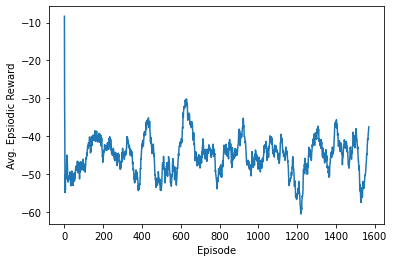

In [23]:
# Plotting graph
# Episodes versus Avg. Rewards
plt.plot(avg_reward_list)
plt.xlabel("Episode")
plt.ylabel("Avg. Epsiodic Reward")
plt.show()

## Evaluate policy

In [24]:
# Test data
t_data = DataPrep(file = const.file_path,
                num_settings = const.num_settings,
                num_sensors = const.num_sensors,
                num_units = 20,
                prev_step_units = 240,
                step = const.step[2],
                normalization_type="01")

test_df = t_data.ReadData()
test_df

,Unit,NormTime,OpSetting1,OpSetting2,OpSetting3,Sensor1,Sensor2,Sensor3,Sensor4,Sensor5,...,Sensor12,Sensor13,Sensor14,Sensor15,Sensor16,Sensor17,Sensor18,Sensor19,Sensor20,Sensor21
0,241,1.000000,0.595099,0.736342,0.0,0.238089,0.010311,0.051374,0.010265,0.293184,...,0.088637,0.001434,0.060915,0.915211,0.0,0.031915,0.000000,0.0,0.136864,0.142847
1,241,0.994536,0.999976,0.997625,1.0,0.000000,0.128061,0.287673,0.226278,0.000000,...,0.003430,0.993245,0.573673,0.384477,0.0,0.287234,0.627907,1.0,0.012036,0.008898
2,241,0.989071,0.000038,0.001188,1.0,1.000000,0.985454,0.937133,0.936451,1.000000,...,0.997714,0.993493,0.709531,0.042082,1.0,0.946809,1.000000,1.0,0.986589,0.985913
3,241,0.983607,0.833151,0.998694,1.0,0.060269,0.183392,0.326677,0.227443,0.146592,...,0.134517,0.993410,0.532670,0.344712,0.0,0.308511,0.651163,1.0,0.151994,0.153282
4,241,0.978142,0.476128,0.831354,1.0,0.626985,0.661941,0.648225,0.551313,0.507937,...,0.471915,0.993769,0.529251,0.333493,0.0,0.617021,0.864693,1.0,0.486245,0.496670
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4359,260,0.015823,0.476188,0.831354,1.0,0.626985,0.674461,0.690850,0.591580,0.507937,...,0.468918,0.996250,0.807527,0.351775,1.0,0.691489,0.864693,1.0,0.484869,0.480615
4360,260,0.012658,0.238102,0.298100,1.0,0.597937,0.647026,0.742197,0.726984,0.617180,...,0.614155,0.994596,0.997888,0.151333,1.0,0.744681,0.854123,1.0,0.613480,0.620190
4361,260,0.009494,0.595222,0.736342,0.0,0.238089,0.017952,0.089171,0.066946,0.293184,...,0.087061,0.007279,0.308771,1.000000,0.0,0.063830,0.000000,0.0,0.135144,0.137297
4362,260,0.006329,0.595203,0.738717,0.0,0.238089,0.021267,0.080147,0.087724,0.293184,...,0.088662,0.007334,0.311838,0.995586,0.0,0.074468,0.000000,0.0,0.130330,0.127092


In [21]:
len(test_df)

4364

In [23]:
# List of engine lifetimes
engine_lives = test_df.groupby(test_df['Unit']).size()
engine_lives = engine_lives.tolist()
num_engines = len(engine_lives)

print(engine_lives, num_engines)

[183, 273, 230, 128, 253, 194, 197, 234, 202, 184, 266, 135, 149, 260, 340, 163, 309, 143, 205, 316] 20


In [26]:
# Load decoder
vae = VAE(latent_dim=1,image_size=25)

##########################################
env_config = {
    "df": test_df,
    "timestep": 0,
    "obs_size": const.num_settings+const.num_sensors+1,
    "engines": num_engines,
    "engine_lives": engine_lives, 
    "decoder_model": decoder,
}

print("env_config: ", env_config)

env_config:  {'df':       Unit  NormTime  OpSetting1  OpSetting2  OpSetting3   Sensor1   Sensor2  \
0      241  1.000000    0.595099    0.736342         0.0  0.238089  0.010311   
1      241  0.994536    0.999976    0.997625         1.0  0.000000  0.128061   
2      241  0.989071    0.000038    0.001188         1.0  1.000000  0.985454   
3      241  0.983607    0.833151    0.998694         1.0  0.060269  0.183392   
4      241  0.978142    0.476128    0.831354         1.0  0.626985  0.661941   
...    ...       ...         ...         ...         ...       ...       ...   
4359   260  0.015823    0.476188    0.831354         1.0  0.626985  0.674461   
4360   260  0.012658    0.238102    0.298100         1.0  0.597937  0.647026   
4361   260  0.009494    0.595222    0.736342         0.0  0.238089  0.017952   
4362   260  0.006329    0.595203    0.738717         0.0  0.238089  0.021267   
4363   260  0.003165    0.833260    0.997625         1.0  0.060269  0.194347   

       Sensor3   Se

In [27]:
env = CMAPSSEnv(**env_config)

In [28]:
def trained_policy(state, noise_object):
    sampled_actions = tf.squeeze(target_actor(state, training=False))
    noise = noise_object()
    # Adding noise to action
    sampled_actions = sampled_actions.numpy() + noise

    # We make sure action is within bounds
    legal_action = np.clip(sampled_actions, lower_bound, upper_bound)

    return np.asarray([np.squeeze(legal_action)])

In [48]:
est_rul = []
est_sensor1 = []

for s in range(len(test_df)):
    state = tf.expand_dims(env.reset(), 0)
    ou_noise = OUActionNoise(mean=np.zeros(1), std_deviation=float(0.0) * np.ones(1))
    action = target_actor(state, training=False).numpy()[0]
    obs, _, _, _ = env.step(action)
    est_rul.append(obs[0])
    est_sensor1.append(obs[5])
    for t in range(1,engine_lives[0]):
        action = target_actor(state, training=False).numpy()[0]
        obs, _, _, _ = env.step(action)
        est_rul.append(obs[0])
        est_sensor1.append(obs[5])
        state = tf.reshape(tf.constant(obs.to_list()),[1,25])
        #print(rew, done)

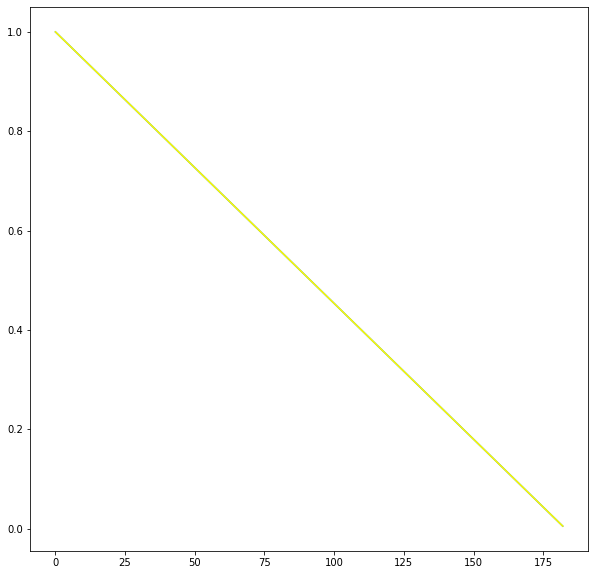

In [49]:
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (10,10)

plt.plot(test_df['NormTime'][:engine_lives[0]])
plt.plot(est_rul, color='yellow')
plt.show()

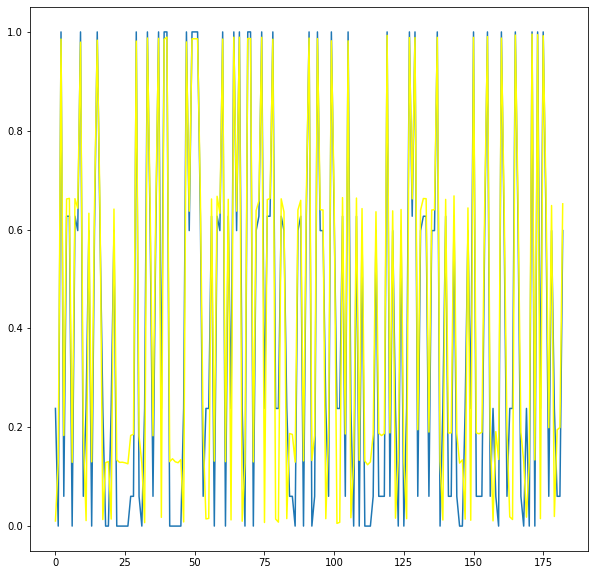

In [50]:
plt.plot(test_df['Sensor1'][:engine_lives[0]])
plt.plot(est_sensor1, color='yellow')
plt.show()